In [1]:
import os
import gc
import sys
import json
import glob
import random
from pathlib import Path
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
#use_tf_keras = True
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pathlib
import itertools
from tqdm import tqdm
#import tensorlayer as tl
from imgaug import augmenters as iaa
import imgaug as ia
from sklearn.model_selection import train_test_split

import warnings 
warnings.filterwarnings("ignore")

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
DATA_DIR = Path('/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/')
ROOT_DIR = Path('/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/')

NUM_CATS = 46 
IMAGE_SIZE = 512 

In [3]:
!git clone https://www.github.com/matterport/Mask_RCNN.git
os.chdir('Mask_RCNN')

!rm -rf .git
!rm -rf images assets

fatal: destination path 'Mask_RCNN' already exists and is not an empty directory.


In [4]:
sys.path.append(str(ROOT_DIR/'Mask_RCNN'))

# sys.path.remove(ROOT_DIR/'Mask_RCNN')
# print(sys.path)
from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log

Using TensorFlow backend.


In [5]:
!wget --quiet https://github.com/matterport/Mask_RCNN/releases/download/v2.0/mask_rcnn_coco.h5
!ls -lh mask_rcnn_coco.h5

COCO_WEIGHTS_PATH = 'mask_rcnn_coco.h5'

-rw-rw-r-- 1 ubuntu ubuntu 246M Nov 26  2017 mask_rcnn_coco.h5


In [6]:
class FashionConfig(Config):
    NAME = "fashion"
    NUM_CLASSES = NUM_CATS + 1 # +1 สำหรับคลาส background
    
    GPU_COUNT = 1
    IMAGES_PER_GPU = 4
    
    BACKBONE = 'resnet50'
    
    IMAGE_MIN_DIM = IMAGE_SIZE
    IMAGE_MAX_DIM = IMAGE_SIZE    
    IMAGE_RESIZE_MODE = 'none'
    
    RPN_ANCHOR_SCALES = (16, 32, 64, 128, 256)
    TRAIN_ROIS_PER_IMAGE = 100
    
   
    STEPS_PER_EPOCH = 5500
    VALIDATION_STEPS = 100
    
config = FashionConfig()
config.display()


Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     4
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 4
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  512
IMAGE_META_SIZE                59
IMAGE_MIN_DIM                  512
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              none
IMAGE_SHAPE                    [512 512   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE                

In [7]:
with open(DATA_DIR/"label_descriptions.json") as f:
    label_descriptions = json.load(f)

label_names = [x['name'] for x in label_descriptions['categories']]

In [8]:
segment_df = pd.read_csv(DATA_DIR/"train.csv")
segment_df['CategoryId'] = segment_df['ClassId'].str.split('_').str[0]

print("Total segments: ", len(segment_df))
segment_df.head()

Total segments:  333415


,ImageId,EncodedPixels,Height,Width,ClassId,CategoryId
0,00000663ed1ff0c4e0132b9b9ac53f6e.jpg,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,6,6
1,00000663ed1ff0c4e0132b9b9ac53f6e.jpg,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,0,0
2,00000663ed1ff0c4e0132b9b9ac53f6e.jpg,8521389 10 8526585 30 8531789 42 8537002 46 85...,5214,3676,28,28
3,00000663ed1ff0c4e0132b9b9ac53f6e.jpg,12903854 2 12909064 7 12914275 10 12919485 15 ...,5214,3676,31,31
4,00000663ed1ff0c4e0132b9b9ac53f6e.jpg,10837337 5 10842542 14 10847746 24 10852951 33...,5214,3676,32,32


In [9]:
image_df = segment_df.groupby('ImageId')['EncodedPixels', 'CategoryId'].agg(lambda x: list(x))
size_df = segment_df.groupby('ImageId')['Height', 'Width'].mean()
image_df = image_df.join(size_df, on='ImageId')

print("Total images: ", len(image_df))
image_df.head()

Total images:  45625


,EncodedPixels,CategoryId,Height,Width
ImageId,,,,
00000663ed1ff0c4e0132b9b9ac53f6e.jpg,[6068157 7 6073371 20 6078584 34 6083797 48 60...,"[6, 0, 28, 31, 32, 32, 31, 29, 4]",5214,3676
0000fe7c9191fba733c8a69cfaf962b7.jpg,[2201176 1 2203623 3 2206071 5 2208518 8 22109...,"[33, 1]",2448,2448
0002ec21ddb8477e98b2cbb87ea2e269.jpg,[2673735 2 2676734 8 2679734 13 2682733 19 268...,"[33, 10, 23, 23]",3000,1997
0002f5a0ebc162ecfb73e2c91e3b8f62.jpg,[435 132 1002 132 1569 132 2136 132 2703 132 3...,"[10, 33, 15]",567,400
0004467156e47b0eb6de4aa6479cbd15.jpg,[132663 8 133396 25 134130 41 134868 53 135611...,"[10, 33, 31, 31, 15]",750,500


In [10]:
def resize_image(image_path):
    print(image_path)
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (IMAGE_SIZE, IMAGE_SIZE), interpolation=cv2.INTER_AREA)  
    return img

In [11]:
class FashionDataset(utils.Dataset):

    def __init__(self, df):
        super().__init__(self)
        
        # Add classes
        for i, name in enumerate(label_names):
            self.add_class("fashion", i+1, name)
        
        # Add images 
        for i, row in df.iterrows():
            self.add_image("fashion", 
                           image_id=row.name, 
                           path=str(DATA_DIR/'train'/row.name), 
                           labels=row['CategoryId'],
                           annotations=row['EncodedPixels'], 
                           height=row['Height'], width=row['Width'])

    def image_reference(self, image_id):
        info = self.image_info[image_id]
        return info['path'], [label_names[int(x)] for x in info['labels']]
    
    def load_image(self, image_id):
        return resize_image(self.image_info[image_id]['path'])

    def load_mask(self, image_id):
        info = self.image_info[image_id]
                
        mask = np.zeros((IMAGE_SIZE, IMAGE_SIZE, len(info['annotations'])), dtype=np.uint8)
        labels = []
        
        for m, (annotation, label) in enumerate(zip(info['annotations'], info['labels'])):
            sub_mask = np.full(info['height']*info['width'], 0, dtype=np.uint8)
            annotation = [int(x) for x in annotation.split(' ')]
            
            for i, start_pixel in enumerate(annotation[::2]):
                sub_mask[start_pixel: start_pixel+annotation[2*i+1]] = 1

            sub_mask = sub_mask.reshape((info['height'], info['width']), order='F')
            sub_mask = cv2.resize(sub_mask, (IMAGE_SIZE, IMAGE_SIZE), interpolation=cv2.INTER_NEAREST)
            
            mask[:, :, m] = sub_mask
            labels.append(int(label)+1)
            
        return mask, np.array(labels)

('/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87ce7b82e98f5aec23e841fc94648e93.jpg', ['pants', 'sleeve', 'sleeve', 'collar', 'shirt, blouse'])
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87ce7b82e98f5aec23e841fc94648e93.jpg


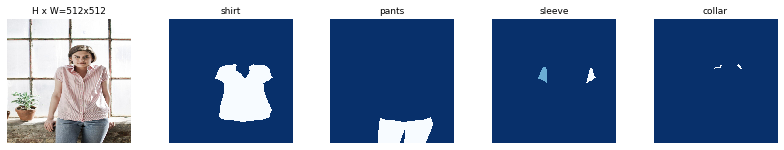

('/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/657291b0d93f40bf4d1ecbda00cea26a.jpg', ['cardigan', 'collar', 'shirt, blouse', 'sleeve', 'sleeve', 'collar'])
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/657291b0d93f40bf4d1ecbda00cea26a.jpg


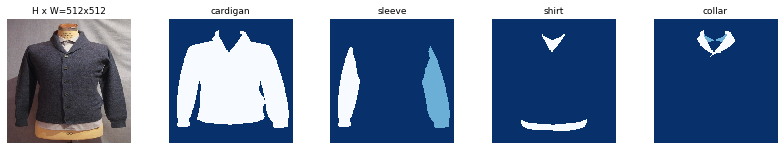

('/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36d3ca43ab37d7f4965652d7af531966.jpg', ['pants', 'top, t-shirt, sweatshirt', 'neckline'])
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36d3ca43ab37d7f4965652d7af531966.jpg


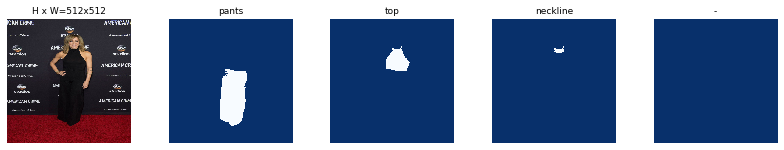

('/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50c48ee3c9d1f030c5bbfaa2e84e58dc.jpg', ['collar', 'sleeve', 'sleeve', 'shirt, blouse', 'shoe', 'shoe', 'vest', 'pants', 'belt', 'pocket'])
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50c48ee3c9d1f030c5bbfaa2e84e58dc.jpg


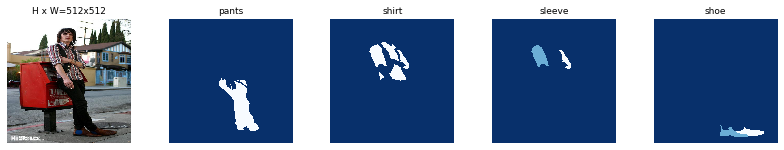

('/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5aa3372cc2ed69aa6749c293375fb770.jpg', ['sleeve', 'sleeve', 'neckline', 'top, t-shirt, sweatshirt'])
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5aa3372cc2ed69aa6749c293375fb770.jpg


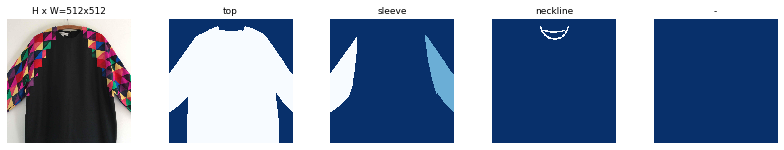

('/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17e74c5b682f690fd54ad12365ce7169.jpg', ['dress', 'neckline', 'sleeve'])
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17e74c5b682f690fd54ad12365ce7169.jpg


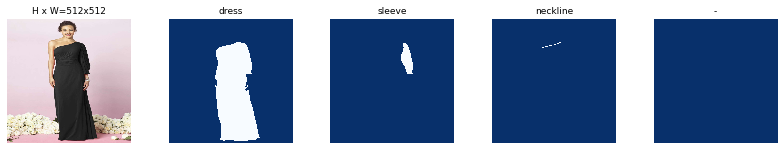

In [12]:
dataset = FashionDataset(image_df)
dataset.prepare()

for i in range(6):
    image_id = random.choice(dataset.image_ids)
    print(dataset.image_reference(image_id))
    
    image = dataset.load_image(image_id)
    mask, class_ids = dataset.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, dataset.class_names, limit=4)

In [13]:
train_df, valid_df = train_test_split(image_df, test_size=0.2, random_state=42)

train_dataset = FashionDataset(train_df)
train_dataset.prepare()

valid_dataset = FashionDataset(valid_df)
valid_dataset.prepare()

Total train images:  36500
Total train segments:  267004


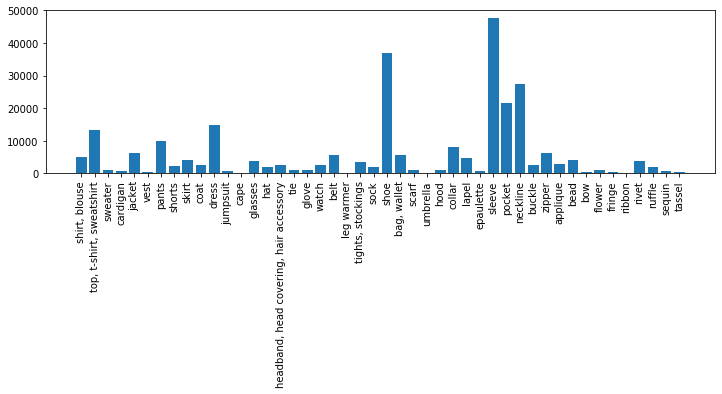

Total validation images:  9125
Total validation segments:  66411


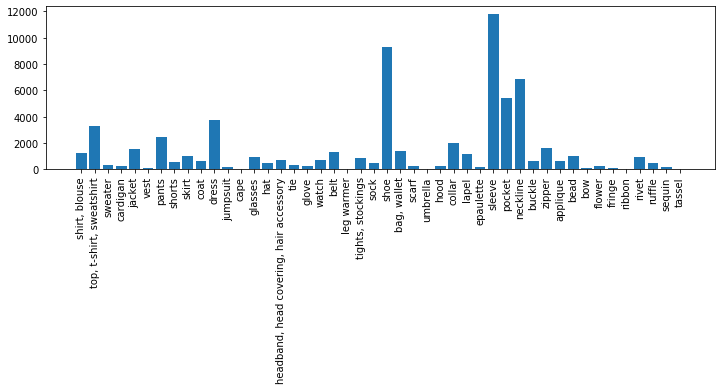

In [14]:
train_segments = np.concatenate(train_df['CategoryId'].values).astype(int)
print("Total train images: ", len(train_df))
print("Total train segments: ", len(train_segments))

plt.figure(figsize=(12, 3))
values, counts = np.unique(train_segments, return_counts=True)
plt.bar(values, counts)
plt.xticks(values, label_names, rotation='vertical')
plt.show()

valid_segments = np.concatenate(valid_df['CategoryId'].values).astype(int)
print("Total validation images: ", len(valid_df))
print("Total validation segments: ", len(valid_segments))

plt.figure(figsize=(12, 3))
values, counts = np.unique(valid_segments, return_counts=True)
plt.bar(values, counts)
plt.xticks(values, label_names, rotation='vertical')
plt.show()

In [15]:
model = modellib.MaskRCNN(mode='training', config=config, model_dir=ROOT_DIR)

model.load_weights(COCO_WEIGHTS_PATH, by_name=True, exclude=[
    'mrcnn_class_logits', 'mrcnn_bbox_fc', 'mrcnn_bbox', 'mrcnn_mask'])

Instructions for updating:
Colocations handled automatically by placer.


In [18]:
# Sometimes(0.5, ...) applies the given augmenter in 50% of all cases,
# e.g. Sometimes(0.5, GaussianBlur(0.3)) would blur roughly every second image.
#sometimes = lambda aug: iaa.Sometimes(0.5, aug)
augmentation = iaa.Sequential([
    #iaa.Crop(px=(1, 16), keep_size=True),
    iaa.Fliplr(0.5),
    iaa.Rot90(1),
    iaa.Rot90(3)
    #iaa.Crop(percent=(0, 0.1)), # random crops
    
    # Small gaussian blur with random sigma between 0 and 0.5.
    # But we only blur about 50% of all images.
    
]) 
#cv2.imwrite('new.jpg', images_aug[0])

In [18]:
%%time
model.train(train_dataset, valid_dataset,
            learning_rate=2e-3,
            epochs=1,
            layers='heads',
            augmentation=None)

history = model.keras_model.history.history


Starting at epoch 0. LR=0.002

Checkpoint Path: /home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/fashion20191226T1254/mask_rcnn_fashion_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4       

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83454ea5df5c2fde6da4976aabd39661.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a85cb033beae4e753d62f90c2b81737.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83454ea5df5c2fde6da4976aabd39661.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a85cb033beae4e753d62f90c2b81737.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a85cb033beae4e753d62f90c2b81737.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a85cb033beae4e753d62f90c2b81737.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19defa246cef47aadc23fcd4831b89db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7215b1e593daf366ca037ac9faecbde6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19defa246cef47aadc23fcd4831b89db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19defa246cef47aadc23fcd4831b89db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab634db4992cae1eed844899e4ac79f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c18c1bd07e4d4d7aeb9f7c521640b714.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c18c1bd07e4d4d7aeb9f7c521640b714.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60bfd3b1fea52c7dffae7bd7f14f9ff6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60bfd3b1fea52c7dffae7bd7f14f9ff6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bcc63dc3f725bf847de650e782b1d2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e925fc6d79add1072181715a3fa41eff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab634db4992cae1eed844899e4ac79f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bcc63dc3f725bf847de650e782b1d2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab634db4992cae1eed844899e4ac79f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bbc29b6085ccb9fbf76537dbf38eb172.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c24831e2048916d5a2e83818394389c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0394d05e6754a6b142adb8b7e8f47bc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38f2f79240f1a4426c3f0bf227e4435b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c24831e2048916d5a2e83818394389c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38f2f79240f1a4426c3f0bf227e4435b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/acd592d1cdd25d812fcc4aae6ffe87e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/260a64cf3a02456249b9222e8bad6c3f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f3bcb33facacb00df83056e8a109be6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c24831e2048916d5a2e83818394389c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e60675991ccda2d9d74ba7f6db36653b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c1cc736dbebdaafa0958d3a1e261ecf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9cc9327b29294aab041f977ef1f62380.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3cf227ce13b67d237ffef8a1ade0006.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e60675991ccda2d9d74ba7f6db36653b.jpg
   5/5500 [..............................] - ETA: 20:02:11 - loss: 5.6055 - rpn_class_loss: 0.1914 - rpn_bbox_loss: 1.1894 - mrcnn_class_loss: 2.5335 - mrcnn_bbox_loss: 0.9299 - mrcnn_mask_loss: 0.7613/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8218d547718e699da512646ce961aa8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9cc9327b29294aab041f977ef1f62380.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff4afeb5e15c75a5d38f2edcf5c60ae1.jpg
/home/ubuntu/iMaterialist_Fashi

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21905bf50a60e08e9ae275031af78cf8.jpg
  12/5500 [..............................] - ETA: 9:43:54 - loss: 4.2142 - rpn_class_loss: 0.1580 - rpn_bbox_loss: 0.8941 - mrcnn_class_loss: 1.6301 - mrcnn_bbox_loss: 0.8258 - mrcnn_mask_loss: 0.7061 /home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a4d271c1decc253f0687d837bf5aabf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b9133aaa13abddcd44786b50350ba75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a4d271c1decc253f0687d837bf5aabf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3cf298b27b7d39a4cfa982bc54fdbcf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ab81fa55eea4ff98d8055b750be918d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63ff880f334b132461ed14f70086a36c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49c538746685d9b71abce1a8b954abce.jpg
/home/ubuntu/iMaterialist_Fashi

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/043ca975160014591cf064e8fdc0ace6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63ff880f334b132461ed14f70086a36c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/707c8f958698f51e42e4f6e8b2db0e1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf6d07fdc695ee835d06aaaedef650e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faf5f006a9c7415a9d3f25e5add63924.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b9133aaa13abddcd44786b50350ba75.jpg
  18/5500 [..............................] - ETA: 7:18:16 - loss: 3.9618 - rpn_class_loss: 0.1341 - rpn_bbox_loss: 0.8566 - mrcnn_class_loss: 1.4430 - mrcnn_bbox_loss: 0.8401 - mrcnn_mask_loss: 0.6880/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf3dd44b01a78e02753bc3f7a238c086.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63ff880f334b132461ed14f70086a36c.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99b3b999c69b24c7775fdf8f8c9b056c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8937533f27ad15c66cf606f7fe2beb8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24ebe3468415ced3e455d74ce9497915.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24e4d97d80b4d4415546d4e22db14bb9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df92901339187b49657ba5fac6bb7a30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64eb842f02fef6b4fe02f6fa4d17707e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b2b1afb057293ff0263709a64d7e385.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99b3b999c69b24c7775fdf8f8c9b056c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24e4d97d80b4d4415546d4e22db14bb9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c56d45c51d6c22857b599f1e091f56a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

  32/5500 [..............................] - ETA: 5:09:23 - loss: 3.9507 - rpn_class_loss: 0.1358 - rpn_bbox_loss: 1.1999 - mrcnn_class_loss: 1.1902 - mrcnn_bbox_loss: 0.7633 - mrcnn_mask_loss: 0.6615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d961ba78a5cd0193e4ff24babe21a7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c57b5ce64754cdbe57a20e8baca178f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e698f49bcc73071afec831e2e1a21f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d961ba78a5cd0193e4ff24babe21a7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cdef5fa549695e1686bbf2714ba5326a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e698f49bcc73071afec831e2e1a21f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f2a790156ceece56027ccd1475172f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ccb2e0e887ea04c74ccde672b655f77.jpg
  33/5500 [.....................

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d45dc9e4646a31a45fea560bf45bfaec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08b66a8d4d4a17b75b1c5544cfb80e23.jpg
  41/5500 [..............................] - ETA: 4:33:28 - loss: 3.9024 - rpn_class_loss: 0.1341 - rpn_bbox_loss: 1.2203 - mrcnn_class_loss: 1.1484 - mrcnn_bbox_loss: 0.7512 - mrcnn_mask_loss: 0.6484/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76307c984817d7f5e0c84f369ef6512f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecab477c7f479d98386c20ed15ddc8ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee93704434f4aa96859be27f8b04f4ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34e13b1406bc583949ad9e7c096351fb.jpg
  42/5500 [..............................] - ETA: 4:30:19 - loss: 3.9534 - rpn_class_loss: 0.1388 - rpn_bbox_loss: 1.2680 - mrcnn_class_loss: 1.1488 - mrcnn_bbox_loss: 0.7503 - mrcnn_mask_loss: 0.6474/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/397ea5ac1a155bf9e2a7b73b6cafe0d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99417ce2febcec15057744f02bb446cb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/397ea5ac1a155bf9e2a7b73b6cafe0d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83da29f1d75c07ba2d0b753853a8c630.jpg
  49/5500 [..............................] - ETA: 4:12:07 - loss: 3.9026 - rpn_class_loss: 0.1407 - rpn_bbox_loss: 1.2941 - mrcnn_class_loss: 1.1056 - mrcnn_bbox_loss: 0.7252 - mrcnn_mask_loss: 0.6370/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83da29f1d75c07ba2d0b753853a8c630.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8becb08891aa091bfd8a42dfbc3a2251.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7bd13b3beafc3bd8a657ef608dbf3aae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d45dc9e4646a31a45fea560bf45bfaec.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/645546ac040328af53e06c2c20d27ed2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b26c2f696d0a9a3d2ac3a81f70eacb1c.jpg
  58/5500 [..............................] - ETA: 3:55:26 - loss: 3.7692 - rpn_class_loss: 0.1369 - rpn_bbox_loss: 1.2247 - mrcnn_class_loss: 1.0824 - mrcnn_bbox_loss: 0.6968 - mrcnn_mask_loss: 0.6284/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb46b2702fba4d32f9157fd7932fe96d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7ca5b6eb294ffd82a107615ce66d25f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d973c430b63a6c86359de56544b281b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/346cb105784aa7e29bed3ccbc04f2582.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7ca5b6eb294ffd82a107615ce66d25f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99417ce2febcec15057744f02bb446cb.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e45e53ebc724041dc531742716ffb4fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c0a0d89642913973b452c1d71858989.jpg
  66/5500 [..............................] - ETA: 3:44:18 - loss: 3.6385 - rpn_class_loss: 0.1311 - rpn_bbox_loss: 1.1593 - mrcnn_class_loss: 1.0553 - mrcnn_bbox_loss: 0.6741 - mrcnn_mask_loss: 0.6186/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae69cdbe50e331a3dca212902877b8d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6677654d307188d9209010f7f1752f0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa94a466d4178dcd4c762f7567c11147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6677654d307188d9209010f7f1752f0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d92386eb6f6e06311468da2683529fdb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a04f7f3c916f894a256afd16446053c2.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1df244de7a26846307981cf9f30812d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e34015149ad1d718a2341e99bc43155f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16eaea8d813fabeecce6a6319ccf1ac0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d0ea5fe3c1e266c4ef9f1bb0ca34076.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4de690423fab2cf6f379178414ca2aac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1249cd5f0dbf8a71dcb72318452655b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1df244de7a26846307981cf9f30812d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53b0833bbce3ca91615f919c813d15b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e74bb74e5f99cbd36d1a4e26a6e1f24a.jpg
  74/5500 [..............................] - ETA: 3:34:56 - loss: 3.5410 - rpn_class_loss: 0.1244 - rpn_bbox_loss: 1.1005 - mrcnn_class_

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd4778925ec4b7b5ca242b865c2679dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad0e4c429c7448635c87ae79499089de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51e5418e0fcfb6bc02524b285f9e59ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4555d4453734fe23f4aa03ad3e4ec64a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c2deef1bf207b37908cbd277ac3a6aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b922f4be101212d8e896e1a636f1d283.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7f387999b0acbc6d36ec32ecf9f2384.jpg
  83/5500 [..............................] - ETA: 3:26:24 - loss: 3.4034 - rpn_class_loss: 0.1170 - rpn_bbox_loss: 1.0461 - mrcnn_class_loss: 1.0084 - mrcnn_bbox_loss: 0.6403 - mrcnn_mask_loss: 0.5916/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/714ddac3c1707caff3698cd7a0ad50e1.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27405af0e596d6018ad4a177722f538c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3f4a218b14907c5fc9c0921913a1efc.jpg
  91/5500 [..............................] - ETA: 3:20:16 - loss: 3.3105 - rpn_class_loss: 0.1119 - rpn_bbox_loss: 1.0152 - mrcnn_class_loss: 0.9793 - mrcnn_bbox_loss: 0.6270 - mrcnn_mask_loss: 0.5772/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3b9cdfb3e9cb4339ddc3e67f78d8535.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26613e2dce17417d7bc43357472acf53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27405af0e596d6018ad4a177722f538c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d171ac9c6597c65c61e2648ba07e105.jpg
  92/5500 [..............................] - ETA: 3:19:38 - loss: 3.3020 - rpn_class_loss: 0.1115 - rpn_bbox_loss: 1.0133 - mrcnn_class_loss: 0.9759 - mrcnn_bbox_loss: 0.6253 - mrcnn_mask_loss: 0.5760/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/598f298eb2c40143ea2a247e288b8d12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3563afc34cc5e34ac4037fb2e6a5a540.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b449c771462bda550fa6c8e71aefc2e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9973cd0a4f4947ab2ca6cc1071519776.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/054cefdc3fa57128a62e29a33aef5246.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/407d83e2d27670608d919ece8acc6373.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3473ce2af77b6c84114e4a141645ab9.jpg
 105/5500 [..............................] - ETA: 3:11:34 - loss: 3.2952 - rpn_class_loss: 0.1132 - rpn_bbox_loss: 1.0321 - mrcnn_class_loss: 0.9718 - mrcnn_bbox_loss: 0.6129 - mrcnn_mask_loss: 0.5652/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0dd7b45b77c55ad3862e297b2488bb5b.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dafaecaaeea2c43eb7bd385eb8ed9990.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/598f298eb2c40143ea2a247e288b8d12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3563afc34cc5e34ac4037fb2e6a5a540.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a858394ff2e24f1e4b75584c85f09b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9973cd0a4f4947ab2ca6cc1071519776.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79d817cde26dc451dae53b5d797f7f18.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/054cefdc3fa57128a62e29a33aef5246.jpg
 113/5500 [..............................] - ETA: 3:07:30 - loss: 3.3470 - rpn_class_loss: 0.1277 - rpn_bbox_loss: 1.1081 - mrcnn_class_loss: 0.9441 - mrcnn_bbox_loss: 0.6081 - mrcnn_mask_loss: 0.5589/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85c21164cc1ce772253676b4a263dede.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8fd3ec84fcb5c4af51027e44516695e2.jpg
 119/5500 [..............................] - ETA: 3:04:45 - loss: 3.3196 - rpn_class_loss: 0.1270 - rpn_bbox_loss: 1.1108 - mrcnn_class_loss: 0.9270 - mrcnn_bbox_loss: 0.6035 - mrcnn_mask_loss: 0.5512/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ad4e45da605b03d8d0047bd11d80678.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a283f9305f71b86c9528f497a33239b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1b5fcfd2197b598cac59236b649c1a8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/664639721193c343337a27cbc25d27c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69f654741c5c4cef78e916f871e0392b.jpg
 120/5500 [..............................] - ETA: 3:04:15 - loss: 3.3152 - rpn_class_loss: 0.1266 - rpn_bbox_loss: 1.1103 - mrcnn_class_loss: 0.9259 - mrcnn_bbox_loss: 0.6026 - mrcnn_mask_loss: 0.5498/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4a0d97f03e930ac0d6c5d4f3087e2c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5651b6507acbe3bbdfb936371c82cbf3.jpg
 133/5500 [..............................] - ETA: 2:58:22 - loss: 3.2760 - rpn_class_loss: 0.1246 - rpn_bbox_loss: 1.0970 - mrcnn_class_loss: 0.9194 - mrcnn_bbox_loss: 0.5946 - mrcnn_mask_loss: 0.5404/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dafaecaaeea2c43eb7bd385eb8ed9990.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a858394ff2e24f1e4b75584c85f09b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85c21164cc1ce772253676b4a263dede.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a5982f6dc65e451736e1f504859aef7.jpg
 134/5500 [..............................] - ETA: 2:57:56 - loss: 3.2829 - rpn_class_loss: 0.1245 - rpn_bbox_loss: 1.1050 - mrcnn_class_loss: 0.9191 - mrcnn_bbox_loss: 0.5944 - mrcnn_mask_loss: 0.5399/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9aa5f070a49a19cd03c37f383fd69e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac32cdb67c6878abb04e5292704809b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6918f03ef5d492eac8afd39fe3243472.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06a0fff740985fbb5da4fcf34f980c1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a231deccfe44c638b1e162cbc8135ea4.jpg
 148/5500 [..............................] - ETA: 2:52:41 - loss: 3.3299 - rpn_class_loss: 0.1257 - rpn_bbox_loss: 1.1887 - mrcnn_class_loss: 0.9024 - mrcnn_bbox_loss: 0.5829 - mrcnn_mask_loss: 0.5302/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8527da335aa83aec3b778f01e80f597a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d97d0ca8efc2811c6820224f85b6441a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e4d2098894c760656c3390148e2c13e.jpg
/home/ubuntu/iMaterialist_Fashio

 175/5500 [..............................] - ETA: 2:44:46 - loss: 3.2981 - rpn_class_loss: 0.1251 - rpn_bbox_loss: 1.2192 - mrcnn_class_loss: 0.8768 - mrcnn_bbox_loss: 0.5635 - mrcnn_mask_loss: 0.5134/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca1d8cd5b6f285e61019a4694f95068a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc57df883086d3bb8f295a89b3a31211.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5674765897b3409c0b305d18ee93989c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/993e2558d0a23b64086b0330cf5190eb.jpg
 177/5500 [..............................] - ETA: 2:44:13 - loss: 3.3113 - rpn_class_loss: 0.1252 - rpn_bbox_loss: 1.2330 - mrcnn_class_loss: 0.8775 - mrcnn_bbox_loss: 0.5629 - mrcnn_mask_loss: 0.5126/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca1d8cd5b6f285e61019a4694f95068a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2792f8aff6d88950cd2f1a50e515fd2f.jpg
/home/ubuntu/iMaterialis

 203/5500 [>.............................] - ETA: 2:38:45 - loss: 3.2099 - rpn_class_loss: 0.1192 - rpn_bbox_loss: 1.1855 - mrcnn_class_loss: 0.8529 - mrcnn_bbox_loss: 0.5522 - mrcnn_mask_loss: 0.5002/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4837da4fade11c1d4e0a83ddac072d79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e75f78773a52bc24967d6aede30e2bec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1519dfec7c3c05bcad4679d07c0e7ff6.jpg
 204/5500 [>.............................] - ETA: 2:38:32 - loss: 3.2066 - rpn_class_loss: 0.1189 - rpn_bbox_loss: 1.1832 - mrcnn_class_loss: 0.8527 - mrcnn_bbox_loss: 0.5518 - mrcnn_mask_loss: 0.5000/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bb775481ad9718ff161c47e32d3dd49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4837da4fade11c1d4e0a83ddac072d79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e75f78773a52bc24967d6aede30e2bec.jpg
/home/ubuntu/iMaterialis

 231/5500 [>.............................] - ETA: 2:34:08 - loss: 3.0904 - rpn_class_loss: 0.1127 - rpn_bbox_loss: 1.1258 - mrcnn_class_loss: 0.8279 - mrcnn_bbox_loss: 0.5363 - mrcnn_mask_loss: 0.4877/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/374a34cb3b288b3a0e0ae8213551704e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/583772b97b553688b289070ff0bcba4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bccc403668d61cb3b7185dafac3bcc8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c33a8c831a5ee0e827e2169faa8f89a1.jpg
 232/5500 [>.............................] - ETA: 2:34:00 - loss: 3.0884 - rpn_class_loss: 0.1124 - rpn_bbox_loss: 1.1242 - mrcnn_class_loss: 0.8282 - mrcnn_bbox_loss: 0.5362 - mrcnn_mask_loss: 0.4874/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/374a34cb3b288b3a0e0ae8213551704e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/583772b97b553688b289070ff0bcba4c.jpg
/home/ubuntu/iMaterialis

 259/5500 [>.............................] - ETA: 2:30:16 - loss: 3.0005 - rpn_class_loss: 0.1084 - rpn_bbox_loss: 1.0843 - mrcnn_class_loss: 0.8081 - mrcnn_bbox_loss: 0.5228 - mrcnn_mask_loss: 0.4769/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/633499c0a8bfb358d1ea67b5577f81be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bf7ddbba3d1d5a0d0cae780f6b75223.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5ee221576dbc2bdafaec5aef3e7e7d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf2835a924fb157bd3e335683aea3c6d.jpg
 260/5500 [>.............................] - ETA: 2:30:07 - loss: 2.9979 - rpn_class_loss: 0.1084 - rpn_bbox_loss: 1.0827 - mrcnn_class_loss: 0.8077 - mrcnn_bbox_loss: 0.5224 - mrcnn_mask_loss: 0.4767/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/633499c0a8bfb358d1ea67b5577f81be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bf7ddbba3d1d5a0d0cae780f6b75223.jpg
/home/ubuntu/iMaterialis

 287/5500 [>.............................] - ETA: 2:27:08 - loss: 2.9185 - rpn_class_loss: 0.1047 - rpn_bbox_loss: 1.0526 - mrcnn_class_loss: 0.7879 - mrcnn_bbox_loss: 0.5082 - mrcnn_mask_loss: 0.4650/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c27a9a6c6eb23a7c5c5088dcd7cd4732.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a35be4f51446d64e34079e37dc0c584.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82b5174b08af8e6cf9b5ded867b19647.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/278aefac8e424d2f8098d596a4beb9dc.jpg
 288/5500 [>.............................] - ETA: 2:27:02 - loss: 2.9162 - rpn_class_loss: 0.1046 - rpn_bbox_loss: 1.0509 - mrcnn_class_loss: 0.7877 - mrcnn_bbox_loss: 0.5081 - mrcnn_mask_loss: 0.4648/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc12838cf10da67afaae0ea44254fde9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10db85b8e5c928e1181d5fd88f6a648e.jpg
/home/ubuntu/iMaterialis

 315/5500 [>.............................] - ETA: 2:24:19 - loss: 2.8603 - rpn_class_loss: 0.1022 - rpn_bbox_loss: 1.0261 - mrcnn_class_loss: 0.7763 - mrcnn_bbox_loss: 0.4991 - mrcnn_mask_loss: 0.4565/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d33d54af33388fcefd3dbace8e4cdb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8924081f01f0597f0aea006a62272e5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84f5e3bdc2bf73973e846e0b6ab3dec4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b8f118206843bee91f5dde63eba1b715.jpg
 316/5500 [>.............................] - ETA: 2:24:15 - loss: 2.8587 - rpn_class_loss: 0.1021 - rpn_bbox_loss: 1.0251 - mrcnn_class_loss: 0.7760 - mrcnn_bbox_loss: 0.4991 - mrcnn_mask_loss: 0.4564/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d9d2d04bf4f454efcd28537f48be283.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0e1f791764b97733571bdbf72c86ef7.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/acb2902a3e1213441465f24b1da5ef60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca745e7a64f1d23dab3cf24c3ea3be0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6aea61fc986f23e1abef20a8feb17f5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fd341b4593576829753d88c469f783d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82de65094559e176502fea25a88ab15e.jpg
 330/5500 [>.............................] - ETA: 2:23:04 - loss: 2.8437 - rpn_class_loss: 0.1002 - rpn_bbox_loss: 1.0219 - mrcnn_class_loss: 0.7720 - mrcnn_bbox_loss: 0.4956 - mrcnn_mask_loss: 0.4539/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf965fe1dba5a7cc9e060ebbe6bfab9f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72803b9909139d7453434ab9d42caf07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/100c39229bb9e8f6713537afa5421c66.jpg
 331/5500 [>....................

 357/5500 [>.............................] - ETA: 2:20:53 - loss: 2.8297 - rpn_class_loss: 0.0998 - rpn_bbox_loss: 1.0409 - mrcnn_class_loss: 0.7554 - mrcnn_bbox_loss: 0.4877 - mrcnn_mask_loss: 0.4459/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1834d78942d40aa91c442d088df93dba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/379b7a8d75c639089fca81bffd2714ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d74726cf624f2588b0ca8af1066cdcb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00c613d7ce33173d59b8661e2978049d.jpg
 358/5500 [>.............................] - ETA: 2:20:48 - loss: 2.8267 - rpn_class_loss: 0.0998 - rpn_bbox_loss: 1.0394 - mrcnn_class_loss: 0.7545 - mrcnn_bbox_loss: 0.4873 - mrcnn_mask_loss: 0.4456/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc2cf3d7f9e7235a25eec8c6b1faa58e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/821ec1ae5ceb050717efa0bc85355f0b.jpg
/home/ubuntu/iMaterialis

 385/5500 [=>............................] - ETA: 2:18:49 - loss: 2.7739 - rpn_class_loss: 0.0971 - rpn_bbox_loss: 1.0230 - mrcnn_class_loss: 0.7374 - mrcnn_bbox_loss: 0.4787 - mrcnn_mask_loss: 0.4377/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef4eb28f001d53889a87dbc2607b374a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2702413259dd42060e1669782d07801.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46ddf43cb3dc9180c1bccc33b61d033d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2cbb294fab9e0e17b9c366ad733cc3b2.jpg
 386/5500 [=>............................] - ETA: 2:18:44 - loss: 2.7717 - rpn_class_loss: 0.0970 - rpn_bbox_loss: 1.0214 - mrcnn_class_loss: 0.7374 - mrcnn_bbox_loss: 0.4783 - mrcnn_mask_loss: 0.4376/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f817d812725a8c25c4165f8c8cc46f90.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6d8888c804ffcc9eed89c879ea330c1.jpg
/home/ubuntu/iMaterialis

 413/5500 [=>............................] - ETA: 2:16:59 - loss: 2.7221 - rpn_class_loss: 0.0948 - rpn_bbox_loss: 1.0001 - mrcnn_class_loss: 0.7250 - mrcnn_bbox_loss: 0.4706 - mrcnn_mask_loss: 0.4316/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d580db148d7843b188022c2eb6b22ae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb5f5be395fdd9253312d39d81684b19.jpg
 414/5500 [=>............................] - ETA: 2:16:55 - loss: 2.7189 - rpn_class_loss: 0.0947 - rpn_bbox_loss: 0.9988 - mrcnn_class_loss: 0.7240 - mrcnn_bbox_loss: 0.4701 - mrcnn_mask_loss: 0.4313/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef4eb28f001d53889a87dbc2607b374a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2702413259dd42060e1669782d07801.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46ddf43cb3dc9180c1bccc33b61d033d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2cbb294fab9e0e17b9c366ad733cc3b2.jpg
/home/ubuntu/iMaterialis

 427/5500 [=>............................] - ETA: 2:16:09 - loss: 2.6996 - rpn_class_loss: 0.0934 - rpn_bbox_loss: 0.9921 - mrcnn_class_loss: 0.7182 - mrcnn_bbox_loss: 0.4668 - mrcnn_mask_loss: 0.4291/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b34e973353a70bf78422e96b254f86c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b1bf0ed5e0bf0e92516de988883e97a.jpg
 428/5500 [=>............................] - ETA: 2:16:05 - loss: 2.6975 - rpn_class_loss: 0.0934 - rpn_bbox_loss: 0.9908 - mrcnn_class_loss: 0.7178 - mrcnn_bbox_loss: 0.4665 - mrcnn_mask_loss: 0.4290/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05bfdd0865a1d97d6b90d9aadd770ea6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/669b245dda0652bd206352bad9ff33f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0cabec0bd42ef13486cc3e3a2630ba48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c10b76ea3548a294372348d4364921c.jpg
/home/ubuntu/iMaterialis

 455/5500 [=>............................] - ETA: 2:14:27 - loss: 2.6585 - rpn_class_loss: 0.0912 - rpn_bbox_loss: 0.9706 - mrcnn_class_loss: 0.7105 - mrcnn_bbox_loss: 0.4607 - mrcnn_mask_loss: 0.4255/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cd1aed2b29b9548d59d86e1289df5af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/022de341651057fc50dd76a1991bd141.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3cedce74f28516b43a911adf76a113a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03c27c47179ccf0073230f6461a50696.jpg
 456/5500 [=>............................] - ETA: 2:14:24 - loss: 2.6568 - rpn_class_loss: 0.0912 - rpn_bbox_loss: 0.9695 - mrcnn_class_loss: 0.7103 - mrcnn_bbox_loss: 0.4604 - mrcnn_mask_loss: 0.4255/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b34e973353a70bf78422e96b254f86c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b1bf0ed5e0bf0e92516de988883e97a.jpg
 457/5500 [=>...........

 483/5500 [=>............................] - ETA: 2:13:00 - loss: 2.6332 - rpn_class_loss: 0.0900 - rpn_bbox_loss: 0.9603 - mrcnn_class_loss: 0.7057 - mrcnn_bbox_loss: 0.4552 - mrcnn_mask_loss: 0.4218/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f16866c512ca721aa3ba3b2129e4b66f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/edbedef6b0492f8a417b2d25f8b559ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b5800c4c8a981d9dd91fc2d00aed373.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d97b87cb2e890188cfd331cc2b7aec78.jpg
 484/5500 [=>............................] - ETA: 2:12:57 - loss: 2.6310 - rpn_class_loss: 0.0899 - rpn_bbox_loss: 0.9593 - mrcnn_class_loss: 0.7052 - mrcnn_bbox_loss: 0.4549 - mrcnn_mask_loss: 0.4217/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbf21f3a502b80204783fdb9adbd3f0b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05ab6d272287aa77afa4c34fb97966f9.jpg
/home/ubuntu/iMaterialis

 497/5500 [=>............................] - ETA: 2:12:17 - loss: 2.6300 - rpn_class_loss: 0.0892 - rpn_bbox_loss: 0.9663 - mrcnn_class_loss: 0.7023 - mrcnn_bbox_loss: 0.4524 - mrcnn_mask_loss: 0.4198/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe7b31d5f0f5b0b20199abd27fe98f6c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2f939be88a6ee201bf18af4b2ade270.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8eb5e7790ccd243693dbcd16c267d191.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49c3aad9db64d9838d98a0c83e23dc11.jpg
 498/5500 [=>............................] - ETA: 2:12:15 - loss: 2.6295 - rpn_class_loss: 0.0892 - rpn_bbox_loss: 0.9657 - mrcnn_class_loss: 0.7025 - mrcnn_bbox_loss: 0.4524 - mrcnn_mask_loss: 0.4197/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec0d15b1d8ee0673e517c244f79cf23e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35fdcaa814169a1465e80aa0cb43dc3a.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ebb9b5f943a603b2b0831ee5f0f0d3d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5331fbf2cc474ed81e593701b25c25a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f1183be526c4bf39f48e5741b7bcb9b.jpg
 512/5500 [=>............................] - ETA: 2:11:31 - loss: 2.6206 - rpn_class_loss: 0.0885 - rpn_bbox_loss: 0.9620 - mrcnn_class_loss: 0.7002 - mrcnn_bbox_loss: 0.4511 - mrcnn_mask_loss: 0.4188/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5601a520d24c77a526f6eebe6546f2d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e8f0587c8858e9ca826e68de9bd6610.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ac0a669273b839201ee80ddda06c559.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f1183be526c4bf39f48e5741b7bcb9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5601a520d24c77a526f6eebe6546f2d8.jpg
 513/5500 [=>...................

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47661189ee141ec04b68c2ed6e8436fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29e405edb0f26185678d372167a909e0.jpg
 526/5500 [=>............................] - ETA: 2:10:49 - loss: 2.6101 - rpn_class_loss: 0.0877 - rpn_bbox_loss: 0.9580 - mrcnn_class_loss: 0.6972 - mrcnn_bbox_loss: 0.4495 - mrcnn_mask_loss: 0.4177/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebd6d367f3a2f163ad6354ff28614679.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d489b40ec4d9aa0fc3e4d8d8887935de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b744b9a581f81522ef24378c29cd91ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0579d7933b6c98e3ca32a05d02f7ed4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8d0f6c328613d1adc56205c844debc7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20151b4806384531f9513cb76057101d.jpg
 527/5500 [=>...................

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7061271e0dfb9a5e93d5b235d322dd6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06f08f2086279439a8cd0dcba51b747f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3afdf0a56f5e77c5476666792c1ece9.jpg
 540/5500 [=>............................] - ETA: 2:10:07 - loss: 2.5921 - rpn_class_loss: 0.0872 - rpn_bbox_loss: 0.9491 - mrcnn_class_loss: 0.6934 - mrcnn_bbox_loss: 0.4468 - mrcnn_mask_loss: 0.4156/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f61067a647af16d3e6d881056ea3d87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7061271e0dfb9a5e93d5b235d322dd6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06f08f2086279439a8cd0dcba51b747f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3afdf0a56f5e77c5476666792c1ece9.jpg
 541/5500 [=>............................] - ETA: 2:10:04 - loss: 2.5914 - rpn_class_loss: 0.0871 - rpn_bbox_loss: 0.9487 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b3196a8677a05a34fa3626fd016e498.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0d4f5334bb5f7745c447b3061b83d5a.jpg
 554/5500 [==>...........................] - ETA: 2:09:28 - loss: 2.5765 - rpn_class_loss: 0.0867 - rpn_bbox_loss: 0.9411 - mrcnn_class_loss: 0.6899 - mrcnn_bbox_loss: 0.4451 - mrcnn_mask_loss: 0.4137/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40d2b47ca6c936b4e760b94e8be08945.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcce0a88030c1d2caa477eefb59a7b0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a01a852a9294be5804851b4ca01722db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0855e64cb5de89cf2d4787d51212d5df.jpg
 555/5500 [==>...........................] - ETA: 2:09:26 - loss: 2.5740 - rpn_class_loss: 0.0866 - rpn_bbox_loss: 0.9400 - mrcnn_class_loss: 0.6892 - mrcnn_bbox_loss: 0.4447 - mrcnn_mask_loss: 0.4135/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61d1a5912a2f1f936d179a893b0b86f1.jpg
 568/5500 [==>...........................] - ETA: 2:08:49 - loss: 2.5712 - rpn_class_loss: 0.0869 - rpn_bbox_loss: 0.9411 - mrcnn_class_loss: 0.6883 - mrcnn_bbox_loss: 0.4428 - mrcnn_mask_loss: 0.4121/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b62e3c6e959080652fae298cd84bc606.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80f20e79e5e78a4ac9d0232f099656f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c30957c579d475311581cd4095bf71e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a07aee093c5e4c7d5ae586b830e83023.jpg
 569/5500 [==>...........................] - ETA: 2:08:47 - loss: 2.5704 - rpn_class_loss: 0.0868 - rpn_bbox_loss: 0.9408 - mrcnn_class_loss: 0.6881 - mrcnn_bbox_loss: 0.4427 - mrcnn_mask_loss: 0.4120/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77f50f4846abbf4d5f1122404fbb7140.jpg
/home/ubuntu/iMaterialis

 583/5500 [==>...........................] - ETA: 2:08:12 - loss: 2.5514 - rpn_class_loss: 0.0860 - rpn_bbox_loss: 0.9314 - mrcnn_class_loss: 0.6850 - mrcnn_bbox_loss: 0.4395 - mrcnn_mask_loss: 0.4094/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6129346d2357af05db9bd13bab0c6855.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a055ce8263102c42975353a1b87b1c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5713be6d259d27ab0369b1ec637e206.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d205af78e74c4c0f14507a1d397adfb3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0441419fc975b0227a0c5986456f41d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/450b42a51073e127badf31ab20fbacd2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0aab5a12b159ff4cd71c9612025ed1e0.jpg
 584/5500 [==>...........................] - ETA: 2:08:10 - loss: 2.5505 - rpn_class_loss: 0.0860 - rpn_bbox_loss: 0.9313 - mrcn

 610/5500 [==>...........................] - ETA: 2:07:09 - loss: 2.5372 - rpn_class_loss: 0.0859 - rpn_bbox_loss: 0.9255 - mrcnn_class_loss: 0.6816 - mrcnn_bbox_loss: 0.4372 - mrcnn_mask_loss: 0.4071/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03f5022a6fe0a02f5067db87523293ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67cda026e99aa17bfe75368c9951f0ea.jpg
 611/5500 [==>...........................] - ETA: 2:07:06 - loss: 2.5358 - rpn_class_loss: 0.0859 - rpn_bbox_loss: 0.9248 - mrcnn_class_loss: 0.6813 - mrcnn_bbox_loss: 0.4369 - mrcnn_mask_loss: 0.4070/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b2f1d85940019d759c875e4f28d409b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/872dc625bd25ec66a7374a6fb84d93d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d17900ac552a7b4b09385a9c82c2d5b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b619ea51201bff4e8371680780b7a5b8.jpg
/home/ubuntu/iMaterialis

 638/5500 [==>...........................] - ETA: 2:06:00 - loss: 2.5202 - rpn_class_loss: 0.0850 - rpn_bbox_loss: 0.9203 - mrcnn_class_loss: 0.6771 - mrcnn_bbox_loss: 0.4336 - mrcnn_mask_loss: 0.4041/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5730c79bb9531806cc202cb000b930d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b0c357baa75d048a3de82f22e99f127.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c9aee8ffe69014a7ba6724aedd3944a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7cfc57f357615b5c80074331c50eafc.jpg
 639/5500 [==>...........................] - ETA: 2:05:58 - loss: 2.5193 - rpn_class_loss: 0.0850 - rpn_bbox_loss: 0.9202 - mrcnn_class_loss: 0.6767 - mrcnn_bbox_loss: 0.4333 - mrcnn_mask_loss: 0.4040/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ce2110e3219ba62dbe2fffcd927b3f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba623c39592a4121040f1c207cbfcfef.jpg
/home/ubuntu/iMaterialis

 666/5500 [==>...........................] - ETA: 2:04:52 - loss: 2.5014 - rpn_class_loss: 0.0837 - rpn_bbox_loss: 0.9125 - mrcnn_class_loss: 0.6727 - mrcnn_bbox_loss: 0.4303 - mrcnn_mask_loss: 0.4022/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/717a4a0cfe08fedb333611722a01764d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f5d467af394cd9ad2287c737aa16258.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb8ac4f2807dfe6f19bedcdddd6be2fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c579a204a0ab614184571a34183b6a5f.jpg
 667/5500 [==>...........................] - ETA: 2:04:49 - loss: 2.5005 - rpn_class_loss: 0.0838 - rpn_bbox_loss: 0.9120 - mrcnn_class_loss: 0.6725 - mrcnn_bbox_loss: 0.4301 - mrcnn_mask_loss: 0.4022/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e59e1707800c1fade0cbfa445f4d25c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38524d6b93d9b37a18463f7a11e339c5.jpg
 668/5500 [==>..........

 694/5500 [==>...........................] - ETA: 2:03:46 - loss: 2.4885 - rpn_class_loss: 0.0832 - rpn_bbox_loss: 0.9074 - mrcnn_class_loss: 0.6698 - mrcnn_bbox_loss: 0.4277 - mrcnn_mask_loss: 0.4004/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8304bfcf9a907e6cade9bea3f1a663c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9339f614c9fb204cc11861dbec9f2940.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f38e4b94504f2a7df3afacfa014cf838.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea437dcdaf2ad052784c5d56d9302895.jpg
 695/5500 [==>...........................] - ETA: 2:03:43 - loss: 2.4902 - rpn_class_loss: 0.0836 - rpn_bbox_loss: 0.9089 - mrcnn_class_loss: 0.6699 - mrcnn_bbox_loss: 0.4276 - mrcnn_mask_loss: 0.4003/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d62fa96150d030987908174e6d13f1d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e31fc1fed4aeca621dd57f2e5751a29b.jpg
/home/ubuntu/iMaterialis

 722/5500 [==>...........................] - ETA: 2:02:44 - loss: 2.4831 - rpn_class_loss: 0.0830 - rpn_bbox_loss: 0.9130 - mrcnn_class_loss: 0.6652 - mrcnn_bbox_loss: 0.4248 - mrcnn_mask_loss: 0.3972/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8304bfcf9a907e6cade9bea3f1a663c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9339f614c9fb204cc11861dbec9f2940.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f38e4b94504f2a7df3afacfa014cf838.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea437dcdaf2ad052784c5d56d9302895.jpg
 723/5500 [==>...........................] - ETA: 2:02:42 - loss: 2.4822 - rpn_class_loss: 0.0829 - rpn_bbox_loss: 0.9124 - mrcnn_class_loss: 0.6651 - mrcnn_bbox_loss: 0.4246 - mrcnn_mask_loss: 0.3971/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05b50cd751e0b39be44411e396496c63.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f9ff094208d2d60f1458ab343acb130.jpg
/home/ubuntu/iMaterialis

 750/5500 [===>..........................] - ETA: 2:01:44 - loss: 2.4772 - rpn_class_loss: 0.0832 - rpn_bbox_loss: 0.9138 - mrcnn_class_loss: 0.6635 - mrcnn_bbox_loss: 0.4219 - mrcnn_mask_loss: 0.3948/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebbdbaba83852b5bfceff19a3f85235f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f30a8115ac9c0a281245d83312afdecb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7675064bb78a10db65bb16717f2c3fe2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b571f18312e8ab2193c3f8caa72ae8f3.jpg
 751/5500 [===>..........................] - ETA: 2:01:42 - loss: 2.4787 - rpn_class_loss: 0.0832 - rpn_bbox_loss: 0.9152 - mrcnn_class_loss: 0.6636 - mrcnn_bbox_loss: 0.4220 - mrcnn_mask_loss: 0.3947/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/067bd9c6f40ffa03f93bc8ba9ed06004.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8a9f2c0a185755c4b2fc191ed298848.jpg
/home/ubuntu/iMaterialis

 778/5500 [===>..........................] - ETA: 2:00:45 - loss: 2.4709 - rpn_class_loss: 0.0833 - rpn_bbox_loss: 0.9137 - mrcnn_class_loss: 0.6616 - mrcnn_bbox_loss: 0.4200 - mrcnn_mask_loss: 0.3924/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f63c57faf67f576a5a53b419fd6de59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60aa1cc4734027b0fcede3e068bac0f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cff6631d689ea3ecdb010b37a8db21d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5be4f0b001c7fc5d1ddc8239c3e71ce9.jpg
 779/5500 [===>..........................] - ETA: 2:00:44 - loss: 2.4702 - rpn_class_loss: 0.0833 - rpn_bbox_loss: 0.9131 - mrcnn_class_loss: 0.6615 - mrcnn_bbox_loss: 0.4199 - mrcnn_mask_loss: 0.3924/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f63c57faf67f576a5a53b419fd6de59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60aa1cc4734027b0fcede3e068bac0f4.jpg
/home/ubuntu/iMaterialis

 806/5500 [===>..........................] - ETA: 1:59:47 - loss: 2.4666 - rpn_class_loss: 0.0831 - rpn_bbox_loss: 0.9172 - mrcnn_class_loss: 0.6581 - mrcnn_bbox_loss: 0.4177 - mrcnn_mask_loss: 0.3904/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd8886eb7a6db7fa65ce59b70bf45bed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/862a2ea83952da6623b60327179f8ccd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8a095983e30d05198c08b510a4ae06de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d473d56b9d658469ea2c36cf22292154.jpg
 807/5500 [===>..........................] - ETA: 1:59:44 - loss: 2.4661 - rpn_class_loss: 0.0831 - rpn_bbox_loss: 0.9169 - mrcnn_class_loss: 0.6582 - mrcnn_bbox_loss: 0.4176 - mrcnn_mask_loss: 0.3903/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd8886eb7a6db7fa65ce59b70bf45bed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/862a2ea83952da6623b60327179f8ccd.jpg
/home/ubuntu/iMaterialis

 834/5500 [===>..........................] - ETA: 1:58:49 - loss: 2.4523 - rpn_class_loss: 0.0826 - rpn_bbox_loss: 0.9145 - mrcnn_class_loss: 0.6529 - mrcnn_bbox_loss: 0.4144 - mrcnn_mask_loss: 0.3878/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd3a7cdbefdbb8a2d1837bf4279c13b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b47b15adff6a399d17409c1e2242b0d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eec6cfce808233c7854fa44aadf1382d.jpg
 835/5500 [===>..........................] - ETA: 1:58:47 - loss: 2.4514 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.9142 - mrcnn_class_loss: 0.6526 - mrcnn_bbox_loss: 0.4144 - mrcnn_mask_loss: 0.3877/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd3a7cdbefdbb8a2d1837bf4279c13b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b47b15adff6a399d17409c1e2242b0d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eec6cfce808233c7854fa44aadf1382d.jpg
/home/ubuntu/iMaterialis

 862/5500 [===>..........................] - ETA: 1:57:51 - loss: 2.4531 - rpn_class_loss: 0.0826 - rpn_bbox_loss: 0.9207 - mrcnn_class_loss: 0.6514 - mrcnn_bbox_loss: 0.4123 - mrcnn_mask_loss: 0.3862/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f84261884f6c348ce48650346c6cd78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea83fcebfbe88f17750e18e6cd4e2153.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72e7aba96811fdf75db648f8caa4dc1c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/474423c1056051d5125cbafd3129d860.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06530abf9cb01d42a8c812630df38d8f.jpg
 863/5500 [===>..........................] - ETA: 1:57:49 - loss: 2.4524 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.9203 - mrcnn_class_loss: 0.6513 - mrcnn_bbox_loss: 0.4122 - mrcnn_mask_loss: 0.3862/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3909c3e25a886db6105a16c937c34f13.jpg
/home/ubuntu/iMaterialis

 890/5500 [===>..........................] - ETA: 1:56:54 - loss: 2.4566 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.9333 - mrcnn_class_loss: 0.6464 - mrcnn_bbox_loss: 0.4101 - mrcnn_mask_loss: 0.3843/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24bd76a9a1558b0cf51761d3cfcfe62b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5dd0edb761dfed42f636db62d18df374.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c322e8438d95d786358f48ff0fbefd7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f544226f2cbf18f0edaeb1d90d63b1d6.jpg
 891/5500 [===>..........................] - ETA: 1:56:52 - loss: 2.4565 - rpn_class_loss: 0.0826 - rpn_bbox_loss: 0.9336 - mrcnn_class_loss: 0.6461 - mrcnn_bbox_loss: 0.4100 - mrcnn_mask_loss: 0.3842/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91847fd75e5ec765bc49956b7570a6fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b323da286123e1156f3829c95c103c6f.jpg
/home/ubuntu/iMaterialis

 918/5500 [====>.........................] - ETA: 1:55:58 - loss: 2.4536 - rpn_class_loss: 0.0828 - rpn_bbox_loss: 0.9383 - mrcnn_class_loss: 0.6419 - mrcnn_bbox_loss: 0.4081 - mrcnn_mask_loss: 0.3824/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51e40873673f70ee8589dc60f787271f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c68b27ebca62d79bb95b5ce8acd0bc39.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e92d8791d3ff49e8a46111f89154c609.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0252d46373c10843d52f9183d39e811b.jpg
 919/5500 [====>.........................] - ETA: 1:55:56 - loss: 2.4536 - rpn_class_loss: 0.0828 - rpn_bbox_loss: 0.9385 - mrcnn_class_loss: 0.6419 - mrcnn_bbox_loss: 0.4080 - mrcnn_mask_loss: 0.3823/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91847fd75e5ec765bc49956b7570a6fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b323da286123e1156f3829c95c103c6f.jpg
/home/ubuntu/iMaterialis

 946/5500 [====>.........................] - ETA: 1:55:05 - loss: 2.4430 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.9323 - mrcnn_class_loss: 0.6402 - mrcnn_bbox_loss: 0.4064 - mrcnn_mask_loss: 0.3816/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7653f4471c8bfd34aa4a64c5fd494fb4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e75148a2fec20cbae47fb28a9c8478ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c72741eb86aa47476b4e6e45da2635f.jpg
 947/5500 [====>.........................] - ETA: 1:55:02 - loss: 2.4427 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.9323 - mrcnn_class_loss: 0.6402 - mrcnn_bbox_loss: 0.4062 - mrcnn_mask_loss: 0.3815/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45bdbb756562901416a4f1ffa13ca1f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/073c09066ede4bb5adb070603a7bfd33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6da2d52860530b3bdc8288a1882b16df.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc9332fa636f454a17fc9a763844fb08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af637f81e2d40cac32c16a33e38cb303.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/459d8dea58a9c6817a80163d67f726de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7c53a7b8901856c9630e4aab911a3c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bbcca12a27d033294903560235d844f7.jpg
 961/5500 [====>.........................] - ETA: 1:54:37 - loss: 2.4405 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.9318 - mrcnn_class_loss: 0.6400 - mrcnn_bbox_loss: 0.4056 - mrcnn_mask_loss: 0.3806/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99793c79afcccee3e71a471d9fd17473.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3925ccb9b43fda27216eaed64f3d56ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8ee23b284b41157bb5b9eb488cf5828.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/073c09066ede4bb5adb070603a7bfd33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da6e6f89c78fa3e5352d2af8c66f6a00.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8288693739d7e47c5b94f530ae51cc04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e08ff9d01a93fe5778c34bba1564d441.jpg
 975/5500 [====>.........................] - ETA: 1:54:12 - loss: 2.4360 - rpn_class_loss: 0.0823 - rpn_bbox_loss: 0.9295 - mrcnn_class_loss: 0.6394 - mrcnn_bbox_loss: 0.4046 - mrcnn_mask_loss: 0.3802/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0eee715bc89448ccd0d6b3471ddd86e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a52f3a2a30a8e71727bf6c617f5a818c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8fda7590c864c3e5d3a5881ad4087a2e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e317861631c11d07f6bce54926d6b4a.jpg
 976/5500 [====>................

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b6dae2ae93f45154c73eb661ec5abfa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9a8491d0d805ebf1e3b6f8a71d0b376.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffed4d2a46f54337b99357dac5783564.jpg
 989/5500 [====>.........................] - ETA: 1:53:46 - loss: 2.4318 - rpn_class_loss: 0.0823 - rpn_bbox_loss: 0.9291 - mrcnn_class_loss: 0.6374 - mrcnn_bbox_loss: 0.4036 - mrcnn_mask_loss: 0.3793/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dfa77a20a0de65a2fef1b31c6937a52.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbe59921c19e234f6dc5b3d46d8698ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bfe5da459a421620b24bbd9327ec547.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cdf37d3050f8f5e0612354d1e5480a4e.jpg
 990/5500 [====>.........................] - ETA: 1:53:44 - loss: 2.4309 - rpn_class_loss: 0.0823 - rpn_bbox_loss: 0.9287 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d2e88a0df219d955b338d8da84bf91e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49f1d853e8440fc453460fe6c9cc176a.jpg
1003/5500 [====>.........................] - ETA: 1:53:20 - loss: 2.4319 - rpn_class_loss: 0.0826 - rpn_bbox_loss: 0.9316 - mrcnn_class_loss: 0.6363 - mrcnn_bbox_loss: 0.4028 - mrcnn_mask_loss: 0.3786/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b2537967276dd1571628a56648d7056.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce8af424d79a3ec2ed98d08915339c33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5d4379255c0c31293bcb25770f7a1e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de6064f8da5f8c25c8b0b481ef63055e.jpg
1004/5500 [====>.........................] - ETA: 1:53:18 - loss: 2.4310 - rpn_class_loss: 0.0826 - rpn_bbox_loss: 0.9311 - mrcnn_class_loss: 0.6362 - mrcnn_bbox_loss: 0.4026 - mrcnn_mask_loss: 0.3785/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e08ff9d01a93fe5778c34bba1564d441.jpg
1017/5500 [====>.........................] - ETA: 1:52:54 - loss: 2.4289 - rpn_class_loss: 0.0828 - rpn_bbox_loss: 0.9331 - mrcnn_class_loss: 0.6335 - mrcnn_bbox_loss: 0.4018 - mrcnn_mask_loss: 0.3777/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/783cfb5bc3fafe3acb639008286523fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d737e4f8ac978471da74712967e1c7e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f36c6d209021488c8bf51e89c19f58fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc93bf8d09be2c14cd952d969cc0ab7a.jpg
1018/5500 [====>.........................] - ETA: 1:52:52 - loss: 2.4290 - rpn_class_loss: 0.0828 - rpn_bbox_loss: 0.9330 - mrcnn_class_loss: 0.6336 - mrcnn_bbox_loss: 0.4019 - mrcnn_mask_loss: 0.3777/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11b6b1fccaa3e164fcf274d13f592820.jpg
/home/ubuntu/iMaterialis

1045/5500 [====>.........................] - ETA: 1:52:01 - loss: 2.4117 - rpn_class_loss: 0.0822 - rpn_bbox_loss: 0.9252 - mrcnn_class_loss: 0.6285 - mrcnn_bbox_loss: 0.3997 - mrcnn_mask_loss: 0.3761/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59722a3e1fc209843fc681260da92a35.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62a83ba8962a67607454fed9ebe72075.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a98869758f4a2fcd780cb8132c6a1502.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2c86d64bd236f7ed3d702b596281b67.jpg
1046/5500 [====>.........................] - ETA: 1:52:00 - loss: 2.4112 - rpn_class_loss: 0.0822 - rpn_bbox_loss: 0.9249 - mrcnn_class_loss: 0.6284 - mrcnn_bbox_loss: 0.3997 - mrcnn_mask_loss: 0.3761/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5fab46412ece9d790cc51be913da975d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7adbb19fa5d78e8750d693848c7241af.jpg
/home/ubuntu/iMaterialis

1073/5500 [====>.........................] - ETA: 1:51:11 - loss: 2.3918 - rpn_class_loss: 0.0813 - rpn_bbox_loss: 0.9157 - mrcnn_class_loss: 0.6236 - mrcnn_bbox_loss: 0.3969 - mrcnn_mask_loss: 0.3742/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7945bf39889376dc2f885a9ff40321d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4099c5b173eb7328c65ca280e9ad43e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0fe1ebf1696b27f2007411374ca5b964.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d84adee6349b458a510ad0dbf8068ea.jpg
1074/5500 [====>.........................] - ETA: 1:51:09 - loss: 2.3916 - rpn_class_loss: 0.0813 - rpn_bbox_loss: 0.9159 - mrcnn_class_loss: 0.6234 - mrcnn_bbox_loss: 0.3969 - mrcnn_mask_loss: 0.3741/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d83c4c6410b7b06e335fbc1223a5116f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17864078f5dffbf8962012f6634d3fce.jpg
/home/ubuntu/iMaterialis

1101/5500 [=====>........................] - ETA: 1:50:21 - loss: 2.3760 - rpn_class_loss: 0.0807 - rpn_bbox_loss: 0.9079 - mrcnn_class_loss: 0.6204 - mrcnn_bbox_loss: 0.3946 - mrcnn_mask_loss: 0.3724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c5437a0502706a0e22b14ca6b1583ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e73c1865da1078058aeeb04873c3eaed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59a72b9d6907dc8305c25a7876c1f2cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e74c3ab18e015278dbf76a8d126f8a4.jpg
1102/5500 [=====>........................] - ETA: 1:50:19 - loss: 2.3759 - rpn_class_loss: 0.0807 - rpn_bbox_loss: 0.9077 - mrcnn_class_loss: 0.6204 - mrcnn_bbox_loss: 0.3946 - mrcnn_mask_loss: 0.3724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/642e7764b746bce4ab2dd1c798828e7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c5d9d23186c32779b6a38a8a41e3baf.jpg
/home/ubuntu/iMaterialis

1129/5500 [=====>........................] - ETA: 1:49:29 - loss: 2.3622 - rpn_class_loss: 0.0804 - rpn_bbox_loss: 0.9015 - mrcnn_class_loss: 0.6172 - mrcnn_bbox_loss: 0.3923 - mrcnn_mask_loss: 0.3707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b11603257d83ca9af26865d9759cff4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2813063dcf505f6ed2aed289c29b3e86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5603b9d536cbc8868ea93fe88d51881b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ab139f86137560bccdc6674e3730f4c.jpg
1130/5500 [=====>........................] - ETA: 1:49:28 - loss: 2.3614 - rpn_class_loss: 0.0804 - rpn_bbox_loss: 0.9011 - mrcnn_class_loss: 0.6170 - mrcnn_bbox_loss: 0.3922 - mrcnn_mask_loss: 0.3707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f0a2f9b51659f2bee1e4eacaec12aed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f105d4046232b7a86749f11544bab8a1.jpg
/home/ubuntu/iMaterialis

1143/5500 [=====>........................] - ETA: 1:49:06 - loss: 2.3572 - rpn_class_loss: 0.0804 - rpn_bbox_loss: 0.8982 - mrcnn_class_loss: 0.6167 - mrcnn_bbox_loss: 0.3915 - mrcnn_mask_loss: 0.3703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97be7521373e204900e5bd1b93e94052.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/687b6bf71f599da00fa72b1a6a7cb8be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5f44b64a1f5ac9b8e59f01e8177dcea0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/144d782d982804d2cb89f446a3fd1a57.jpg
1144/5500 [=====>........................] - ETA: 1:49:04 - loss: 2.3567 - rpn_class_loss: 0.0804 - rpn_bbox_loss: 0.8980 - mrcnn_class_loss: 0.6166 - mrcnn_bbox_loss: 0.3915 - mrcnn_mask_loss: 0.3702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3496611252391dedd58d49c463c3fc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57eacb3b6766fd81d69a76abe2835fca.jpg
/home/ubuntu/iMaterialis

1171/5500 [=====>........................] - ETA: 1:48:18 - loss: 2.3429 - rpn_class_loss: 0.0798 - rpn_bbox_loss: 0.8900 - mrcnn_class_loss: 0.6144 - mrcnn_bbox_loss: 0.3896 - mrcnn_mask_loss: 0.3690/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8c24fa9ef85fcf94a080472feda7895.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d31911349493026cdc2697bf3d947e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2cf116194ec09ca66f65b0df1363ba65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/226f2a263aa4d02a158e7ebd4533131c.jpg
1172/5500 [=====>........................] - ETA: 1:48:17 - loss: 2.3426 - rpn_class_loss: 0.0798 - rpn_bbox_loss: 0.8897 - mrcnn_class_loss: 0.6144 - mrcnn_bbox_loss: 0.3896 - mrcnn_mask_loss: 0.3690/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eeb26492f58a916be3a21ff36aea0960.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/095521ccdb60638810db92b07fca6905.jpg
/home/ubuntu/iMaterialis

1199/5500 [=====>........................] - ETA: 1:47:30 - loss: 2.3340 - rpn_class_loss: 0.0793 - rpn_bbox_loss: 0.8863 - mrcnn_class_loss: 0.6127 - mrcnn_bbox_loss: 0.3877 - mrcnn_mask_loss: 0.3680/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f3d592f53a91d031770575f69469002.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db5cf1bae5752de53173702d44857e2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/192667fd4f986bf37ad238cfb6905329.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55c46360a7d9f077033753bb497c245a.jpg
1200/5500 [=====>........................] - ETA: 1:47:28 - loss: 2.3337 - rpn_class_loss: 0.0793 - rpn_bbox_loss: 0.8862 - mrcnn_class_loss: 0.6125 - mrcnn_bbox_loss: 0.3876 - mrcnn_mask_loss: 0.3680/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db6569e51efb04bd37de161cb24faf82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92ce26307ec81378ed295c8f358893b8.jpg
/home/ubuntu/iMaterialis

1227/5500 [=====>........................] - ETA: 1:46:43 - loss: 2.3258 - rpn_class_loss: 0.0788 - rpn_bbox_loss: 0.8823 - mrcnn_class_loss: 0.6115 - mrcnn_bbox_loss: 0.3862 - mrcnn_mask_loss: 0.3669/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52515854ee7cd57713bd638e510cfbb8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2b938ca2f1ba468f68026bd84bf3c50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f7f2b250485ac8402a7090c3d7a252c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15a21698696b95add50bd1b0f95be1d0.jpg
1228/5500 [=====>........................] - ETA: 1:46:41 - loss: 2.3257 - rpn_class_loss: 0.0788 - rpn_bbox_loss: 0.8826 - mrcnn_class_loss: 0.6114 - mrcnn_bbox_loss: 0.3862 - mrcnn_mask_loss: 0.3668/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54f0b918c19e90219a2f7c89ee92514d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50e4691fcb507d82e7f3005f58293b66.jpg
/home/ubuntu/iMaterialis

1255/5500 [=====>........................] - ETA: 1:45:56 - loss: 2.3211 - rpn_class_loss: 0.0785 - rpn_bbox_loss: 0.8836 - mrcnn_class_loss: 0.6095 - mrcnn_bbox_loss: 0.3842 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd8893f0458cdf6afa829d76e11a64b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/735d9e7dbd5fcf4b7628ddcfc71333b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c273a5026a5d799abc411e134d92365.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/345aa8c4a57f86dcaa2fd1fd8f6b3e8d.jpg
1256/5500 [=====>........................] - ETA: 1:45:54 - loss: 2.3210 - rpn_class_loss: 0.0785 - rpn_bbox_loss: 0.8834 - mrcnn_class_loss: 0.6095 - mrcnn_bbox_loss: 0.3841 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa9d397738785b6c66a872c630948bff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95a4aabd4dde2ecf3c142e7a892e51bc.jpg
/home/ubuntu/iMaterialis

1283/5500 [=====>........................] - ETA: 1:45:09 - loss: 2.3158 - rpn_class_loss: 0.0781 - rpn_bbox_loss: 0.8822 - mrcnn_class_loss: 0.6084 - mrcnn_bbox_loss: 0.3828 - mrcnn_mask_loss: 0.3643/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d010461fdf449760861d7d5c262f954c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e98e1b0a8e9e1dbf592a1b232a7033cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09783ea1082192647d9a6ec754d4ea86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b95c84de6c3631407613da2a8fc58057.jpg
1284/5500 [======>.......................] - ETA: 1:45:08 - loss: 2.3158 - rpn_class_loss: 0.0781 - rpn_bbox_loss: 0.8822 - mrcnn_class_loss: 0.6084 - mrcnn_bbox_loss: 0.3827 - mrcnn_mask_loss: 0.3643/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af5b82d8e626f1b91565938d5153502f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abdf7335603dbabeba3920c4b89e5b4c.jpg
1285/5500 [======>......

1311/5500 [======>.......................] - ETA: 1:44:24 - loss: 2.3110 - rpn_class_loss: 0.0786 - rpn_bbox_loss: 0.8800 - mrcnn_class_loss: 0.6071 - mrcnn_bbox_loss: 0.3816 - mrcnn_mask_loss: 0.3638/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/939b46b9542a948d26fcc455c4acd1df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/537367e461cac32742611a53a295860f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1f422b5e0badd4e72b4774a41af2d3b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5bbbadf20072fd33c0dafccb5b7f9fd.jpg
1312/5500 [======>.......................] - ETA: 1:44:22 - loss: 2.3103 - rpn_class_loss: 0.0785 - rpn_bbox_loss: 0.8796 - mrcnn_class_loss: 0.6070 - mrcnn_bbox_loss: 0.3815 - mrcnn_mask_loss: 0.3637/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cd84694b59254f5e325db0928d36b7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e70562dfd25b2d8cb4383036e327f4f.jpg
/home/ubuntu/iMaterialis

1339/5500 [======>.......................] - ETA: 1:43:38 - loss: 2.3060 - rpn_class_loss: 0.0783 - rpn_bbox_loss: 0.8807 - mrcnn_class_loss: 0.6046 - mrcnn_bbox_loss: 0.3799 - mrcnn_mask_loss: 0.3626/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9587bb596a7d59e45ec44b7206a336d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcb5b4f843dcf34540100c52f51a47f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd16ced795175ea4a1ecdb369db4f253.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5c3af60d6cf7556e009c0e8c535b6be.jpg
1340/5500 [======>.......................] - ETA: 1:43:36 - loss: 2.3060 - rpn_class_loss: 0.0783 - rpn_bbox_loss: 0.8808 - mrcnn_class_loss: 0.6045 - mrcnn_bbox_loss: 0.3799 - mrcnn_mask_loss: 0.3626/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/993f6605dcc201f692bb844d95df4e2d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5ec4540fdcdc038fd8e78f069826dbb.jpg
/home/ubuntu/iMaterialis

1367/5500 [======>.......................] - ETA: 1:42:50 - loss: 2.3002 - rpn_class_loss: 0.0791 - rpn_bbox_loss: 0.8785 - mrcnn_class_loss: 0.6022 - mrcnn_bbox_loss: 0.3785 - mrcnn_mask_loss: 0.3618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/680fcf0cfead6109ecee86b98262ceda.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f1a5371db12b5a5185bd186d370f019.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23f93839eefda81a494b9ee8c18dad07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/097d37a78a395cdc2bf65c65a6dee065.jpg
1368/5500 [======>.......................] - ETA: 1:42:48 - loss: 2.2999 - rpn_class_loss: 0.0791 - rpn_bbox_loss: 0.8782 - mrcnn_class_loss: 0.6024 - mrcnn_bbox_loss: 0.3785 - mrcnn_mask_loss: 0.3618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e6d27db1620a45fb6fca073847ef5a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eed3f12729a51994a6f06f00a7e893f0.jpg
/home/ubuntu/iMaterialis

1395/5500 [======>.......................] - ETA: 1:42:03 - loss: 2.2900 - rpn_class_loss: 0.0788 - rpn_bbox_loss: 0.8740 - mrcnn_class_loss: 0.5998 - mrcnn_bbox_loss: 0.3769 - mrcnn_mask_loss: 0.3606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25d5c6ee41d0fc755b4414c23bce495b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f77fa76651e14637ca95444d4ae78b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82e901c31c9c529d808264f87cf6a184.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45eb778147830fda975edde48983b629.jpg
1396/5500 [======>.......................] - ETA: 1:42:02 - loss: 2.2899 - rpn_class_loss: 0.0788 - rpn_bbox_loss: 0.8739 - mrcnn_class_loss: 0.5997 - mrcnn_bbox_loss: 0.3768 - mrcnn_mask_loss: 0.3606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a5f1fc9a502d4246b49ea4f0d841176.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3c2c2b2c11eb29412e7d97123075cca.jpg
/home/ubuntu/iMaterialis

1423/5500 [======>.......................] - ETA: 1:41:17 - loss: 2.2824 - rpn_class_loss: 0.0785 - rpn_bbox_loss: 0.8704 - mrcnn_class_loss: 0.5982 - mrcnn_bbox_loss: 0.3755 - mrcnn_mask_loss: 0.3599/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3ccc77efdd884b9a2642a62cbdf880b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48221390fda6499a5abae1f45862e6aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94c8c58a76caf40e904c39dd013da39f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/248ffa3277ff47d3c6cbe183f406dd69.jpg
1424/5500 [======>.......................] - ETA: 1:41:15 - loss: 2.2820 - rpn_class_loss: 0.0785 - rpn_bbox_loss: 0.8702 - mrcnn_class_loss: 0.5980 - mrcnn_bbox_loss: 0.3754 - mrcnn_mask_loss: 0.3598/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e868098a473cc7fc13a1d6bf3dc37511.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c42c5ecaacd0b84a3b26cb0609675f77.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43cea9d52c72cf25b9860f07130f03ae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eed1e4abcc7500f440e0114a5d7480fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a01cdedc4e07e1649464c104bb290cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8da504d630f670fe21b9c7efebd14109.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc839ee8b3564c42dc47cc3ca1cad887.jpg
1438/5500 [======>.......................] - ETA: 1:40:53 - loss: 2.2782 - rpn_class_loss: 0.0782 - rpn_bbox_loss: 0.8686 - mrcnn_class_loss: 0.5973 - mrcnn_bbox_loss: 0.3747 - mrcnn_mask_loss: 0.3593/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50b449a5212dd6d35845db4deb7c8ec0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66675c31c5c7d314b4ff2e7556caaab8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/522fb1d7c77a1fca0426761406151f44.jpg
/home/ubuntu/iMaterialist_Fashio

1465/5500 [======>.......................] - ETA: 1:40:09 - loss: 2.2720 - rpn_class_loss: 0.0781 - rpn_bbox_loss: 0.8646 - mrcnn_class_loss: 0.5965 - mrcnn_bbox_loss: 0.3736 - mrcnn_mask_loss: 0.3591/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/852e93039a7b696829a4485a4c82a16c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4568fa84e79cdb09447992517e6d30b.jpg
1466/5500 [======>.......................] - ETA: 1:40:07 - loss: 2.2714 - rpn_class_loss: 0.0781 - rpn_bbox_loss: 0.8643 - mrcnn_class_loss: 0.5964 - mrcnn_bbox_loss: 0.3735 - mrcnn_mask_loss: 0.3591/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a686d9702561764f721fde21f8c61788.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67c791ca8fcce2d5f58929926d2bb47b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d6ece9829279748e4feaffffde06d96.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbab97fd98cf880b7863a1dd62178eb5.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/443b7ba4d46dceb645d1025c875a8f2f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f3e71d034c75e7c6dd38cd8e80b9e7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/179c012b8372d268f2c67c71c5f21c83.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6c961d126f895789bd567272296d54a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f3dada872794ae256f8bfc8a97478f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/250ead5419b07d17696418cee2d9105b.jpg
1480/5500 [=======>......................] - ETA: 1:39:44 - loss: 2.2692 - rpn_class_loss: 0.0779 - rpn_bbox_loss: 0.8637 - mrcnn_class_loss: 0.5956 - mrcnn_bbox_loss: 0.3730 - mrcnn_mask_loss: 0.3590/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f1716e82901b1ada8894ba90ede4ff4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eed1e4abcc7500f440e0114a5d7480fa.jpg
/home/ubuntu/iMaterialist_Fashio

1507/5500 [=======>......................] - ETA: 1:39:01 - loss: 2.2631 - rpn_class_loss: 0.0777 - rpn_bbox_loss: 0.8624 - mrcnn_class_loss: 0.5935 - mrcnn_bbox_loss: 0.3716 - mrcnn_mask_loss: 0.3578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfac259163714f1e82db567d014d5730.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b3233bb86816146b0ea4eb1dc486404.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c6fd92f96a670835b1a59e7f744f6af.jpg
1508/5500 [=======>......................] - ETA: 1:38:59 - loss: 2.2626 - rpn_class_loss: 0.0777 - rpn_bbox_loss: 0.8622 - mrcnn_class_loss: 0.5934 - mrcnn_bbox_loss: 0.3716 - mrcnn_mask_loss: 0.3578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b2681053544b9cb1655bed4e16a3ee7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ea51ddbfee88cc11a2b34ab09fe1488.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52c76410e6b2b67b45957372d7e57c31.jpg
/home/ubuntu/iMaterialis

1535/5500 [=======>......................] - ETA: 1:38:15 - loss: 2.2578 - rpn_class_loss: 0.0775 - rpn_bbox_loss: 0.8616 - mrcnn_class_loss: 0.5912 - mrcnn_bbox_loss: 0.3703 - mrcnn_mask_loss: 0.3572/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba6d2a28c7cb40aaf9adaffd31753ea3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36a3d097afe0d99aed30206e417c4f04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/604f09c2d775d491b0589cad58acbbc6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/256310fc3e2364914b229c0c7dd350a9.jpg
1536/5500 [=======>......................] - ETA: 1:38:14 - loss: 2.2574 - rpn_class_loss: 0.0775 - rpn_bbox_loss: 0.8613 - mrcnn_class_loss: 0.5912 - mrcnn_bbox_loss: 0.3703 - mrcnn_mask_loss: 0.3572/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dba891219d8a5d561a3fea092318d6e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f82de9e93778dae6c42b112a8b4bb246.jpg
/home/ubuntu/iMaterialis

1563/5500 [=======>......................] - ETA: 1:37:31 - loss: 2.2490 - rpn_class_loss: 0.0774 - rpn_bbox_loss: 0.8575 - mrcnn_class_loss: 0.5891 - mrcnn_bbox_loss: 0.3689 - mrcnn_mask_loss: 0.3560/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2931c0c7093eb1e10fbdf2eec352081.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/531632ced090dc044cd217881a1eeb49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db9b3c34b241179c71e0335233613695.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cde3640c5f4370cba720d20554365039.jpg
1564/5500 [=======>......................] - ETA: 1:37:29 - loss: 2.2484 - rpn_class_loss: 0.0773 - rpn_bbox_loss: 0.8572 - mrcnn_class_loss: 0.5891 - mrcnn_bbox_loss: 0.3689 - mrcnn_mask_loss: 0.3560/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fb63e49d77b4dae1f741f8422673e7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2deb35ca06b053ea0f5160b0eb73617b.jpg
/home/ubuntu/iMaterialis

1591/5500 [=======>......................] - ETA: 1:36:46 - loss: 2.2421 - rpn_class_loss: 0.0772 - rpn_bbox_loss: 0.8543 - mrcnn_class_loss: 0.5871 - mrcnn_bbox_loss: 0.3679 - mrcnn_mask_loss: 0.3556/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f61d979d7b5b0b6bdbc7a25349e32a0c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9ee748b85b4d251e7377ff7340171af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e2f56726300a7b50703581f552baf97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cdf072ad509eadaffaa82fff9ae0613.jpg
1592/5500 [=======>......................] - ETA: 1:36:44 - loss: 2.2424 - rpn_class_loss: 0.0772 - rpn_bbox_loss: 0.8547 - mrcnn_class_loss: 0.5870 - mrcnn_bbox_loss: 0.3679 - mrcnn_mask_loss: 0.3556/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3b2ac9e215c1ec241bbfef148774c12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d14f90c6a45b455b69cd9499bf2a585.jpg
/home/ubuntu/iMaterialis

1619/5500 [=======>......................] - ETA: 1:36:02 - loss: 2.2366 - rpn_class_loss: 0.0771 - rpn_bbox_loss: 0.8523 - mrcnn_class_loss: 0.5855 - mrcnn_bbox_loss: 0.3667 - mrcnn_mask_loss: 0.3549/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc7e119ccc8eea5db78cb45cfdcb11b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ca514f3aa0c3427e8b65c39e35cd4cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16d88b4e944d3fa9d4ad1164244bfa13.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61d43b680a681d565e4ce7bfc6e38502.jpg
1620/5500 [=======>......................] - ETA: 1:36:00 - loss: 2.2366 - rpn_class_loss: 0.0771 - rpn_bbox_loss: 0.8525 - mrcnn_class_loss: 0.5854 - mrcnn_bbox_loss: 0.3667 - mrcnn_mask_loss: 0.3549/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2585c78567ff99c15ca54371e31401d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd1868da63e49160cce8f18915972424.jpg
/home/ubuntu/iMaterialis

1647/5500 [=======>......................] - ETA: 1:35:17 - loss: 2.2316 - rpn_class_loss: 0.0769 - rpn_bbox_loss: 0.8522 - mrcnn_class_loss: 0.5833 - mrcnn_bbox_loss: 0.3655 - mrcnn_mask_loss: 0.3537/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbcd365a478b4d1657ea75c7fe03b9c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/752ba1eb0f56fd58c23c48ebfd69d82c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/219c27e95a5065da13dad9804d1a861a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a58ab423c7c3acd511a2e930778859d9.jpg
1648/5500 [=======>......................] - ETA: 1:35:15 - loss: 2.2312 - rpn_class_loss: 0.0769 - rpn_bbox_loss: 0.8520 - mrcnn_class_loss: 0.5832 - mrcnn_bbox_loss: 0.3655 - mrcnn_mask_loss: 0.3537/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b7c0e5efcd19079fecbdcd508e7e12b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be4efeedeac2ac9f5442f25943801f78.jpg
/home/ubuntu/iMaterialis

1675/5500 [========>.....................] - ETA: 1:34:32 - loss: 2.2241 - rpn_class_loss: 0.0766 - rpn_bbox_loss: 0.8502 - mrcnn_class_loss: 0.5809 - mrcnn_bbox_loss: 0.3640 - mrcnn_mask_loss: 0.3525/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9164e738375bc63b3e24a41704d90f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41f03a1c3d96704af7ee4067710ff615.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfa430f3a83c9073c5d3c00a5f67bc93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c26f24c6639be517fde879b762a1b2a.jpg
1676/5500 [========>.....................] - ETA: 1:34:30 - loss: 2.2238 - rpn_class_loss: 0.0765 - rpn_bbox_loss: 0.8499 - mrcnn_class_loss: 0.5809 - mrcnn_bbox_loss: 0.3640 - mrcnn_mask_loss: 0.3524/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b074db8f01ac51e8804027fe29c3b2e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0fcf2f88ac91503cdc48321710a31c0c.jpg
/home/ubuntu/iMaterialis

1703/5500 [========>.....................] - ETA: 1:33:47 - loss: 2.2211 - rpn_class_loss: 0.0764 - rpn_bbox_loss: 0.8507 - mrcnn_class_loss: 0.5795 - mrcnn_bbox_loss: 0.3628 - mrcnn_mask_loss: 0.3517/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f0547a0f0b708de817be1ddedc4651f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/793859f553cd67ebd825b0be85907099.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec2559a2a924e2446259c70813663189.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91cd95663d12af311d953137c7eb02e0.jpg
1704/5500 [========>.....................] - ETA: 1:33:46 - loss: 2.2205 - rpn_class_loss: 0.0764 - rpn_bbox_loss: 0.8504 - mrcnn_class_loss: 0.5794 - mrcnn_bbox_loss: 0.3627 - mrcnn_mask_loss: 0.3516/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ba38901738f221cfca7fcbdf7710b89.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/379e45ad2753989ec12aef8866ddc098.jpg
/home/ubuntu/iMaterialis

1731/5500 [========>.....................] - ETA: 1:33:02 - loss: 2.2203 - rpn_class_loss: 0.0765 - rpn_bbox_loss: 0.8536 - mrcnn_class_loss: 0.5778 - mrcnn_bbox_loss: 0.3615 - mrcnn_mask_loss: 0.3509/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cffeb7e31cae9433eaf75a62d685704c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/588803e34aad9594d51bdd63deb69aaf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3d4e72fdc6b92b7a68978603e8254dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fb234dce01427dbb5d2591014ce6eb2.jpg
1732/5500 [========>.....................] - ETA: 1:33:01 - loss: 2.2201 - rpn_class_loss: 0.0765 - rpn_bbox_loss: 0.8537 - mrcnn_class_loss: 0.5776 - mrcnn_bbox_loss: 0.3614 - mrcnn_mask_loss: 0.3509/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8529c47824e4dbf32ca0bbd9c76a2301.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea79f94f4d16ef4adf679d6b1e66ded5.jpg
1733/5500 [========>....

1759/5500 [========>.....................] - ETA: 1:32:17 - loss: 2.2196 - rpn_class_loss: 0.0765 - rpn_bbox_loss: 0.8551 - mrcnn_class_loss: 0.5774 - mrcnn_bbox_loss: 0.3604 - mrcnn_mask_loss: 0.3502/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/524ab86f4362785ce0b625a432cbe231.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbdd32ccd4c4a3d71ee669b316b1ea1a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fac8a6aebaa340f6ffdcc0d400de714a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e091a295e76dcc56ddec6954bf9fed83.jpg
1760/5500 [========>.....................] - ETA: 1:32:16 - loss: 2.2193 - rpn_class_loss: 0.0765 - rpn_bbox_loss: 0.8550 - mrcnn_class_loss: 0.5773 - mrcnn_bbox_loss: 0.3603 - mrcnn_mask_loss: 0.3501/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06cfd2c5525a36fd4d7b93559562a7f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d16c6b249c08ed35ec4ae9f51cddfb2c.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/063c21061a630de5f9397cf3102562f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8f1d406d478d58f8de9f82328d109b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbd045a305789efd8df275c13ac811f1.jpg
1774/5500 [========>.....................] - ETA: 1:31:54 - loss: 2.2169 - rpn_class_loss: 0.0765 - rpn_bbox_loss: 0.8544 - mrcnn_class_loss: 0.5765 - mrcnn_bbox_loss: 0.3598 - mrcnn_mask_loss: 0.3498/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e57f73855380fb3713ab3d294e9fb576.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6384d6fbfe38d3dad6f5195c760188aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3b287333db83b0d460a1790b9a1d9e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc38a7b8ce7fe53bd3c020072d5914c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16c2062ad329386b77c86da32d8d0711.jpg
/home/ubuntu/iMaterialist_Fashio

1801/5500 [========>.....................] - ETA: 1:31:11 - loss: 2.2159 - rpn_class_loss: 0.0765 - rpn_bbox_loss: 0.8544 - mrcnn_class_loss: 0.5766 - mrcnn_bbox_loss: 0.3590 - mrcnn_mask_loss: 0.3493/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbb1cc089e36e3e3c662d927957c7ae2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d073a1a83c8be53b01a05495b64c9b8c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/596aea3929f6ec645a577b43e2022587.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/757f5b93e663fb445885e5183b0c532f.jpg
1802/5500 [========>.....................] - ETA: 1:31:09 - loss: 2.2158 - rpn_class_loss: 0.0765 - rpn_bbox_loss: 0.8543 - mrcnn_class_loss: 0.5766 - mrcnn_bbox_loss: 0.3590 - mrcnn_mask_loss: 0.3493/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79b316162e338862058e91fb3d44fe4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21f4d8881eb567a4e092acd4432801b6.jpg
/home/ubuntu/iMaterialis

1829/5500 [========>.....................] - ETA: 1:30:27 - loss: 2.2125 - rpn_class_loss: 0.0764 - rpn_bbox_loss: 0.8534 - mrcnn_class_loss: 0.5758 - mrcnn_bbox_loss: 0.3583 - mrcnn_mask_loss: 0.3487/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6333ba2249df9dda1cdd9a4d945d08c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee65ab661191b8d336b7b525de160127.jpg
1830/5500 [========>.....................] - ETA: 1:30:26 - loss: 2.2123 - rpn_class_loss: 0.0764 - rpn_bbox_loss: 0.8534 - mrcnn_class_loss: 0.5757 - mrcnn_bbox_loss: 0.3582 - mrcnn_mask_loss: 0.3486/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bfc05a26d4363e8efaf38337eac0f81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f24c1d869cc26688c05220e82be20468.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/649436b06b095701c581c509aaac6b79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5818521cb2c7c0bab7de1e125b7a2c86.jpg
/home/ubuntu/iMaterialis

1844/5500 [=========>....................] - ETA: 1:30:03 - loss: 2.2115 - rpn_class_loss: 0.0763 - rpn_bbox_loss: 0.8542 - mrcnn_class_loss: 0.5751 - mrcnn_bbox_loss: 0.3577 - mrcnn_mask_loss: 0.3483/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4de2be8e7c639d5a0fc232b37a8d561f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/886e244569ad0ff94cef32a33c085c3f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b600846987599421777460969e7bcc13.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/039e26bfb2ce0a9d92e9274ddc66b0b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc28482ddeb7d2b2e767939eb1587d62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3888020a6e6e5d9489e0299200f10a4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a7d7cdeedbdfd6900c4829c9b369935.jpg
1845/5500 [=========>....................] - ETA: 1:30:02 - loss: 2.2113 - rpn_class_loss: 0.0763 - rpn_bbox_loss: 0.8539 - mrcn

1871/5500 [=========>....................] - ETA: 1:29:20 - loss: 2.2062 - rpn_class_loss: 0.0761 - rpn_bbox_loss: 0.8510 - mrcnn_class_loss: 0.5746 - mrcnn_bbox_loss: 0.3569 - mrcnn_mask_loss: 0.3476/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/770cb921a624f95748aa619571ed1812.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b6151d5d5d83fa5599a8bde2819643f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ef72436fc2c89077e62e4ca1b03cb60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8bf25311086cc738208b8e05453a2af.jpg
1872/5500 [=========>....................] - ETA: 1:29:19 - loss: 2.2058 - rpn_class_loss: 0.0761 - rpn_bbox_loss: 0.8509 - mrcnn_class_loss: 0.5745 - mrcnn_bbox_loss: 0.3568 - mrcnn_mask_loss: 0.3476/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36577c8111ac1ffd27020170e846950e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a72a71dfe683469388b1c3f9e064242c.jpg
/home/ubuntu/iMaterialis

1899/5500 [=========>....................] - ETA: 1:28:36 - loss: 2.1998 - rpn_class_loss: 0.0758 - rpn_bbox_loss: 0.8477 - mrcnn_class_loss: 0.5735 - mrcnn_bbox_loss: 0.3558 - mrcnn_mask_loss: 0.3470/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6aa27fd39cc30ccaa2a47ef8f60834c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0897fcd80b59e00cc23955bb0097fd97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/037c9f0600557ae0c00d79bbeac6ae4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a37487c0bd50065b5cb0a24998d5fd3.jpg
1900/5500 [=========>....................] - ETA: 1:28:35 - loss: 2.1993 - rpn_class_loss: 0.0758 - rpn_bbox_loss: 0.8474 - mrcnn_class_loss: 0.5734 - mrcnn_bbox_loss: 0.3558 - mrcnn_mask_loss: 0.3469/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be0ae611eb439c8a0ec0a637874e068a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53959999748786b4c80da43c237fd311.jpg
/home/ubuntu/iMaterialis

1913/5500 [=========>....................] - ETA: 1:28:14 - loss: 2.1958 - rpn_class_loss: 0.0757 - rpn_bbox_loss: 0.8453 - mrcnn_class_loss: 0.5727 - mrcnn_bbox_loss: 0.3554 - mrcnn_mask_loss: 0.3467/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/653638127fd7c3170e84c498888e2200.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e56f78f842f6463dfe457b57c57a2880.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2618ccb37e399cf80418f996b90b843.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/33b01c511bde76619a3deccf1db0126f.jpg
1914/5500 [=========>....................] - ETA: 1:28:12 - loss: 2.1959 - rpn_class_loss: 0.0757 - rpn_bbox_loss: 0.8454 - mrcnn_class_loss: 0.5727 - mrcnn_bbox_loss: 0.3554 - mrcnn_mask_loss: 0.3467/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/770cb921a624f95748aa619571ed1812.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b6151d5d5d83fa5599a8bde2819643f.jpg
/home/ubuntu/iMaterialis

1941/5500 [=========>....................] - ETA: 1:27:30 - loss: 2.1907 - rpn_class_loss: 0.0755 - rpn_bbox_loss: 0.8427 - mrcnn_class_loss: 0.5716 - mrcnn_bbox_loss: 0.3546 - mrcnn_mask_loss: 0.3461/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6aa27fd39cc30ccaa2a47ef8f60834c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0897fcd80b59e00cc23955bb0097fd97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/037c9f0600557ae0c00d79bbeac6ae4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a37487c0bd50065b5cb0a24998d5fd3.jpg
1942/5500 [=========>....................] - ETA: 1:27:29 - loss: 2.1908 - rpn_class_loss: 0.0755 - rpn_bbox_loss: 0.8431 - mrcnn_class_loss: 0.5715 - mrcnn_bbox_loss: 0.3546 - mrcnn_mask_loss: 0.3461/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfafdc3ce27e4ffc0f44cb4967ef39aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7dba283de8926828a78f901e9a7412c0.jpg
/home/ubuntu/iMaterialis

1969/5500 [=========>....................] - ETA: 1:26:46 - loss: 2.1859 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8413 - mrcnn_class_loss: 0.5699 - mrcnn_bbox_loss: 0.3537 - mrcnn_mask_loss: 0.3457/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9d8d42a841f89663843d34f284eb6fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/910d2f8d74bc02fa2fafcc60970d7cfc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4bd5b5b259209004c83afe2e662d4d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34d9cd3e6d7630e6db4e3bf7d3747325.jpg
1970/5500 [=========>....................] - ETA: 1:26:45 - loss: 2.1855 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8410 - mrcnn_class_loss: 0.5698 - mrcnn_bbox_loss: 0.3537 - mrcnn_mask_loss: 0.3456/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/653638127fd7c3170e84c498888e2200.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e56f78f842f6463dfe457b57c57a2880.jpg
/home/ubuntu/iMaterialis

1997/5500 [=========>....................] - ETA: 1:26:04 - loss: 2.1797 - rpn_class_loss: 0.0750 - rpn_bbox_loss: 0.8377 - mrcnn_class_loss: 0.5692 - mrcnn_bbox_loss: 0.3528 - mrcnn_mask_loss: 0.3450/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78e474acb7c929d8c4a5cf3529ba0bec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d6905b7c06a2ac561cd1964dca07e40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ca502acfb929b3089f34b710f3e1803.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a4d46c8f1127df84168623b5bd9b887.jpg
1998/5500 [=========>....................] - ETA: 1:26:02 - loss: 2.1796 - rpn_class_loss: 0.0750 - rpn_bbox_loss: 0.8376 - mrcnn_class_loss: 0.5692 - mrcnn_bbox_loss: 0.3528 - mrcnn_mask_loss: 0.3450/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/417970439927d9f5da0c9c15e5b576e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3468d814493ae509b6de852a3b4e500.jpg
/home/ubuntu/iMaterialis

2025/5500 [==========>...................] - ETA: 1:25:20 - loss: 2.1776 - rpn_class_loss: 0.0750 - rpn_bbox_loss: 0.8384 - mrcnn_class_loss: 0.5678 - mrcnn_bbox_loss: 0.3519 - mrcnn_mask_loss: 0.3445/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6cd4430da84112f4df013e438d3a671.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c30e9e61b67f277dda5c1acf6a450cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec758eb8c538f241de5f9d74a7483449.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef18fd7e802c9c884663b81d98b0f8d8.jpg
2026/5500 [==========>...................] - ETA: 1:25:19 - loss: 2.1773 - rpn_class_loss: 0.0750 - rpn_bbox_loss: 0.8382 - mrcnn_class_loss: 0.5677 - mrcnn_bbox_loss: 0.3519 - mrcnn_mask_loss: 0.3445/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/048b0bba9164f3f4616e3ad2f24ce765.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96c12e81609dcb8ee7de2154a8accd3f.jpg
/home/ubuntu/iMaterialis

2053/5500 [==========>...................] - ETA: 1:24:37 - loss: 2.1722 - rpn_class_loss: 0.0749 - rpn_bbox_loss: 0.8370 - mrcnn_class_loss: 0.5660 - mrcnn_bbox_loss: 0.3508 - mrcnn_mask_loss: 0.3435/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f067cede749c79dbce3969ec9e57ff51.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecb31faa839e1189bb5e894f39cc6400.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c84e55ae2253d1f90800a19860b79de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6da3530d7acd9611c0226214597c0e5b.jpg
2054/5500 [==========>...................] - ETA: 1:24:36 - loss: 2.1716 - rpn_class_loss: 0.0749 - rpn_bbox_loss: 0.8368 - mrcnn_class_loss: 0.5658 - mrcnn_bbox_loss: 0.3507 - mrcnn_mask_loss: 0.3434/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f1d436285033cecd3010b0ae7113d4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a74223011c1260e9bf00f8fcca36ab2.jpg
/home/ubuntu/iMaterialis

2081/5500 [==========>...................] - ETA: 1:23:54 - loss: 2.1714 - rpn_class_loss: 0.0753 - rpn_bbox_loss: 0.8390 - mrcnn_class_loss: 0.5644 - mrcnn_bbox_loss: 0.3497 - mrcnn_mask_loss: 0.3429/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce8b339bf311c3218d88cbd2345d95e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72a9fa5b84746adc3d54f513f4bf2eef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0c7224eddd81813291e6b54073b36fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e18f32d5e4d6fed04f8f2e8d2c17e949.jpg
2082/5500 [==========>...................] - ETA: 1:23:52 - loss: 2.1712 - rpn_class_loss: 0.0753 - rpn_bbox_loss: 0.8389 - mrcnn_class_loss: 0.5644 - mrcnn_bbox_loss: 0.3497 - mrcnn_mask_loss: 0.3429/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f14fa793b1649f5d7aaf1f37ab5c2b5f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93e7efa5ee83b0a5c024e2ba31962a90.jpg
/home/ubuntu/iMaterialis

2109/5500 [==========>...................] - ETA: 1:23:11 - loss: 2.1657 - rpn_class_loss: 0.0751 - rpn_bbox_loss: 0.8360 - mrcnn_class_loss: 0.5633 - mrcnn_bbox_loss: 0.3490 - mrcnn_mask_loss: 0.3423/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f1d436285033cecd3010b0ae7113d4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a74223011c1260e9bf00f8fcca36ab2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/700bb59e853abc823198f821392af597.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a46472cfb7ebcab5c8dd2abcbef4e83e.jpg
2110/5500 [==========>...................] - ETA: 1:23:09 - loss: 2.1663 - rpn_class_loss: 0.0751 - rpn_bbox_loss: 0.8366 - mrcnn_class_loss: 0.5633 - mrcnn_bbox_loss: 0.3490 - mrcnn_mask_loss: 0.3423/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23c3ff7834f5d636cb7bb1af701526e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1aeb1454bdf5e5a4c17f6e76337f0ca7.jpg
/home/ubuntu/iMaterialis

2137/5500 [==========>...................] - ETA: 1:22:28 - loss: 2.1652 - rpn_class_loss: 0.0757 - rpn_bbox_loss: 0.8363 - mrcnn_class_loss: 0.5626 - mrcnn_bbox_loss: 0.3485 - mrcnn_mask_loss: 0.3421/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ff4aae30b360e5786202c4305f94a76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ec67242d7c47ba95b668e03ec1dd170.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/462ca475e08ee4c478c79f3ab5173ebc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5faa597af23a6cb5d083d35cca178798.jpg
2138/5500 [==========>...................] - ETA: 1:22:26 - loss: 2.1647 - rpn_class_loss: 0.0757 - rpn_bbox_loss: 0.8361 - mrcnn_class_loss: 0.5625 - mrcnn_bbox_loss: 0.3484 - mrcnn_mask_loss: 0.3421/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f14fa793b1649f5d7aaf1f37ab5c2b5f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93e7efa5ee83b0a5c024e2ba31962a90.jpg
/home/ubuntu/iMaterialis

2165/5500 [==========>...................] - ETA: 1:21:44 - loss: 2.1596 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8343 - mrcnn_class_loss: 0.5608 - mrcnn_bbox_loss: 0.3476 - mrcnn_mask_loss: 0.3416/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce526e4923a332839c059d8abc6315d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2de12118afcf3b0856da4e768fd3f03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e50b89c97563f8ccfcf9680c25542459.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a9b88113b683e40289f169b62a931d2.jpg
2166/5500 [==========>...................] - ETA: 1:21:43 - loss: 2.1597 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8345 - mrcnn_class_loss: 0.5607 - mrcnn_bbox_loss: 0.3476 - mrcnn_mask_loss: 0.3416/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23c3ff7834f5d636cb7bb1af701526e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1aeb1454bdf5e5a4c17f6e76337f0ca7.jpg
/home/ubuntu/iMaterialis

2193/5500 [==========>...................] - ETA: 1:21:01 - loss: 2.1548 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8322 - mrcnn_class_loss: 0.5594 - mrcnn_bbox_loss: 0.3467 - mrcnn_mask_loss: 0.3411/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6eb5fb61bb403fc0703c7e756b6f8a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c2f1219f16f91c71328ef5479e8dc37.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf703a0d515dbaf5fb68a2fa7cb1c4c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/062407040c03cf85920c3d8410b1c5e5.jpg
2194/5500 [==========>...................] - ETA: 1:21:00 - loss: 2.1546 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8321 - mrcnn_class_loss: 0.5594 - mrcnn_bbox_loss: 0.3467 - mrcnn_mask_loss: 0.3411/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ff4aae30b360e5786202c4305f94a76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ec67242d7c47ba95b668e03ec1dd170.jpg
/home/ubuntu/iMaterialis

2221/5500 [===========>..................] - ETA: 1:20:18 - loss: 2.1485 - rpn_class_loss: 0.0751 - rpn_bbox_loss: 0.8293 - mrcnn_class_loss: 0.5579 - mrcnn_bbox_loss: 0.3458 - mrcnn_mask_loss: 0.3404/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce526e4923a332839c059d8abc6315d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2de12118afcf3b0856da4e768fd3f03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e50b89c97563f8ccfcf9680c25542459.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a9b88113b683e40289f169b62a931d2.jpg
2222/5500 [===========>..................] - ETA: 1:20:17 - loss: 2.1483 - rpn_class_loss: 0.0751 - rpn_bbox_loss: 0.8292 - mrcnn_class_loss: 0.5578 - mrcnn_bbox_loss: 0.3458 - mrcnn_mask_loss: 0.3404/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfebc55fa5f5510482d40c0715dcb297.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5913a4ab45bbb02e66a55b517f449a56.jpg
/home/ubuntu/iMaterialis

2249/5500 [===========>..................] - ETA: 1:19:36 - loss: 2.1430 - rpn_class_loss: 0.0748 - rpn_bbox_loss: 0.8263 - mrcnn_class_loss: 0.5567 - mrcnn_bbox_loss: 0.3452 - mrcnn_mask_loss: 0.3400/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6eb5fb61bb403fc0703c7e756b6f8a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c2f1219f16f91c71328ef5479e8dc37.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf703a0d515dbaf5fb68a2fa7cb1c4c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/062407040c03cf85920c3d8410b1c5e5.jpg
2250/5500 [===========>..................] - ETA: 1:19:34 - loss: 2.1427 - rpn_class_loss: 0.0748 - rpn_bbox_loss: 0.8261 - mrcnn_class_loss: 0.5566 - mrcnn_bbox_loss: 0.3452 - mrcnn_mask_loss: 0.3400/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7123147c48db868169b9348c36b1d8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a59013d3e5a5a504a9f59f69bcf31586.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bbd7abcde15bb1484154949904599366.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/967ffd3c8ddd2431b08e6e30d6ed9e81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9aec1b5c3961819fee8a66e1e8be8875.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f44ab34eee7b8755971d4d97f16e2342.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad4d23fa002e78eb1b8cf36a5ac67cf9.jpg
2278/5500 [===========>..................] - ETA: 1:18:52 - loss: 2.1376 - rpn_class_loss: 0.0746 - rpn_bbox_loss: 0.8235 - mrcnn_class_loss: 0.5554 - mrcnn_bbox_loss: 0.3446 - mrcnn_mask_loss: 0.3395/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41b6c2c4d312d0e3133eece8ecd920a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfea2f2afcb239d35456742e7f024f73.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddc30c7206bc453ca06c361dacaa8bb6.jpg
/home/ubuntu/iMaterialist_Fashio

2305/5500 [===========>..................] - ETA: 1:18:12 - loss: 2.1320 - rpn_class_loss: 0.0744 - rpn_bbox_loss: 0.8208 - mrcnn_class_loss: 0.5540 - mrcnn_bbox_loss: 0.3439 - mrcnn_mask_loss: 0.3389/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a18c8a224e2fa44252195a18ee287deb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/141290f02a08b604ac2230b1b85759a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79af0d122c62cc592f20d4d578e1020e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e79d689991ba2c42d2623970f9a84f1.jpg
2306/5500 [===========>..................] - ETA: 1:18:10 - loss: 2.1317 - rpn_class_loss: 0.0744 - rpn_bbox_loss: 0.8206 - mrcnn_class_loss: 0.5540 - mrcnn_bbox_loss: 0.3438 - mrcnn_mask_loss: 0.3389/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ee14cfb3d0b4ad67d325cd2eaf2ced2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ae966db8d21f971818aef654e4483f8.jpg
/home/ubuntu/iMaterialis

2333/5500 [===========>..................] - ETA: 1:17:29 - loss: 2.1264 - rpn_class_loss: 0.0742 - rpn_bbox_loss: 0.8177 - mrcnn_class_loss: 0.5530 - mrcnn_bbox_loss: 0.3431 - mrcnn_mask_loss: 0.3385/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02f0e51fa1292e3bbe15647ec420035e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12083893897c70a2def715eb40450414.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc0673378b141549f0fff795590670ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e05d2653899aed50af1eb6fce51dfb65.jpg
2334/5500 [===========>..................] - ETA: 1:17:28 - loss: 2.1263 - rpn_class_loss: 0.0742 - rpn_bbox_loss: 0.8177 - mrcnn_class_loss: 0.5529 - mrcnn_bbox_loss: 0.3431 - mrcnn_mask_loss: 0.3384/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71cdacd1fd8410a48ce0f3264c94eaf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fabf3e168372fa97589433e25c324812.jpg
/home/ubuntu/iMaterialis

2361/5500 [===========>..................] - ETA: 1:16:46 - loss: 2.1221 - rpn_class_loss: 0.0741 - rpn_bbox_loss: 0.8158 - mrcnn_class_loss: 0.5519 - mrcnn_bbox_loss: 0.3424 - mrcnn_mask_loss: 0.3380/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f0178008c59d998cf357a23157e3685.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07bd32aaa30ae87f3477d92a02757101.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cffe01d3e220b44f3bc6b64751bebb44.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f30255cb91e2cfaa6e7060ee9e81f079.jpg
2362/5500 [===========>..................] - ETA: 1:16:45 - loss: 2.1218 - rpn_class_loss: 0.0740 - rpn_bbox_loss: 0.8156 - mrcnn_class_loss: 0.5518 - mrcnn_bbox_loss: 0.3423 - mrcnn_mask_loss: 0.3380/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/adb59763509d5b16cc811a7642565da9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57181dbdea60bc308c3b1d3fbcc3045f.jpg
/home/ubuntu/iMaterialis

2389/5500 [============>.................] - ETA: 1:16:04 - loss: 2.1166 - rpn_class_loss: 0.0739 - rpn_bbox_loss: 0.8135 - mrcnn_class_loss: 0.5503 - mrcnn_bbox_loss: 0.3415 - mrcnn_mask_loss: 0.3375/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b9015ce2eb7c0d73f3f9d8e20b7b27d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b08111c2258af53991a6dd7987624aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11dca60a7d7bf6cafd1dc67c8db77a0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f20968f2bd3ef2faa24ac89cb920d371.jpg
2390/5500 [============>.................] - ETA: 1:16:02 - loss: 2.1166 - rpn_class_loss: 0.0739 - rpn_bbox_loss: 0.8135 - mrcnn_class_loss: 0.5502 - mrcnn_bbox_loss: 0.3415 - mrcnn_mask_loss: 0.3375/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/090d2f34914614606940a0ad5f214dd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/831d66ff2f6b386ae3689ef675fc47f9.jpg
2391/5500 [============>

2417/5500 [============>.................] - ETA: 1:15:21 - loss: 2.1145 - rpn_class_loss: 0.0739 - rpn_bbox_loss: 0.8138 - mrcnn_class_loss: 0.5490 - mrcnn_bbox_loss: 0.3408 - mrcnn_mask_loss: 0.3370/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7bc667b2d51d7be497eebf6d38550d65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49ffa91e04473c5da66c90e9de713736.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ded8e0792db95492d22af8d15c287bfe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc22a5c91c8ce1b96d99e79c8b2dc445.jpg
2418/5500 [============>.................] - ETA: 1:15:20 - loss: 2.1144 - rpn_class_loss: 0.0739 - rpn_bbox_loss: 0.8139 - mrcnn_class_loss: 0.5489 - mrcnn_bbox_loss: 0.3407 - mrcnn_mask_loss: 0.3370/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/006caf030e08ef6bfa6615272f83ff55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf14e4ad338da5b8f54b3b068aeef71d.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/358c761b51bb083ce82a784b2f7adcc2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38b24922fb6a49f9e9b374fe5488c885.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68bd642cc02e50e3b9688a21e941d304.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ea13afd3b3fcd3857b167863212edce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04b8f2c9056f278895f44c34a219c587.jpg
2432/5500 [============>.................] - ETA: 1:14:59 - loss: 2.1114 - rpn_class_loss: 0.0738 - rpn_bbox_loss: 0.8124 - mrcnn_class_loss: 0.5481 - mrcnn_bbox_loss: 0.3403 - mrcnn_mask_loss: 0.3368/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/006caf030e08ef6bfa6615272f83ff55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf14e4ad338da5b8f54b3b068aeef71d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e04b22c6a74edf6d22de6dfaaa47ce3.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38b24922fb6a49f9e9b374fe5488c885.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2e0d95f3c45bcd3a37fb9bd6bc6efec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ea13afd3b3fcd3857b167863212edce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc09d9c59bb844d1cbd521d813362964.jpg
2446/5500 [============>.................] - ETA: 1:14:38 - loss: 2.1102 - rpn_class_loss: 0.0737 - rpn_bbox_loss: 0.8126 - mrcnn_class_loss: 0.5474 - mrcnn_bbox_loss: 0.3399 - mrcnn_mask_loss: 0.3366/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5dce53454264c260433d86614bbc4428.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/391d878964512f1726b961de48ecabaa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77b5df89a526ed4dc55d025dfa217394.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/318c8db36ff217a023a9c4e0af018145.jpg
2447/5500 [============>........

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d0072b82bcf2b34866aff3fae0f3b19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e9ecb3423f76fff2576b25278a877d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdf17cdf93f53132267327a3616a535f.jpg
2460/5500 [============>.................] - ETA: 1:14:17 - loss: 2.1075 - rpn_class_loss: 0.0735 - rpn_bbox_loss: 0.8114 - mrcnn_class_loss: 0.5466 - mrcnn_bbox_loss: 0.3396 - mrcnn_mask_loss: 0.3364/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7981434d51cd3f4831d423d765217d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b09b47cee6487dc790c7b444d202cd47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42746e68a9fd202dc2bd68af3100375f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86e40994362593263537fc78f5adf424.jpg
2461/5500 [============>.................] - ETA: 1:14:16 - loss: 2.1076 - rpn_class_loss: 0.0735 - rpn_bbox_loss: 0.8113 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26170d017c53455988b422878ce16b83.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0115eccb4483ca6761887747c4c0f5cd.jpg
2474/5500 [============>.................] - ETA: 1:13:56 - loss: 2.1054 - rpn_class_loss: 0.0734 - rpn_bbox_loss: 0.8102 - mrcnn_class_loss: 0.5462 - mrcnn_bbox_loss: 0.3393 - mrcnn_mask_loss: 0.3363/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c58cbb8baefd98a17fcfc82697907143.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e8185cc821fa8fa41b8de4afa67981f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/978fe79c371dd9c2cf47855c41bf2639.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8dbcb431f6482c6c3a8d280453905b87.jpg
2475/5500 [============>.................] - ETA: 1:13:55 - loss: 2.1053 - rpn_class_loss: 0.0734 - rpn_bbox_loss: 0.8102 - mrcnn_class_loss: 0.5462 - mrcnn_bbox_loss: 0.3393 - mrcnn_mask_loss: 0.3363/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0115eccb4483ca6761887747c4c0f5cd.jpg
2488/5500 [============>.................] - ETA: 1:13:35 - loss: 2.1037 - rpn_class_loss: 0.0733 - rpn_bbox_loss: 0.8098 - mrcnn_class_loss: 0.5455 - mrcnn_bbox_loss: 0.3390 - mrcnn_mask_loss: 0.3361/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f165d7efcce735bdc421b991e99babde.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3907b90f484add9d2eb12bb415ea3294.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce51f04cb3d4f29d2102584b53702132.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3eb0b9e815b30447a01d8aed37e6eebc.jpg
2489/5500 [============>.................] - ETA: 1:13:34 - loss: 2.1034 - rpn_class_loss: 0.0733 - rpn_bbox_loss: 0.8096 - mrcnn_class_loss: 0.5455 - mrcnn_bbox_loss: 0.3390 - mrcnn_mask_loss: 0.3360/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0dd1fefe1dc84a4da85f21f6fb4d06d2.jpg
/home/ubuntu/iMaterialis

2502/5500 [============>.................] - ETA: 1:13:14 - loss: 2.1028 - rpn_class_loss: 0.0732 - rpn_bbox_loss: 0.8101 - mrcnn_class_loss: 0.5450 - mrcnn_bbox_loss: 0.3386 - mrcnn_mask_loss: 0.3359/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f165d7efcce735bdc421b991e99babde.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3907b90f484add9d2eb12bb415ea3294.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce51f04cb3d4f29d2102584b53702132.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3eb0b9e815b30447a01d8aed37e6eebc.jpg
2503/5500 [============>.................] - ETA: 1:13:13 - loss: 2.1025 - rpn_class_loss: 0.0732 - rpn_bbox_loss: 0.8100 - mrcnn_class_loss: 0.5449 - mrcnn_bbox_loss: 0.3385 - mrcnn_mask_loss: 0.3359/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/514a33790d906c155ce1394bb461d8d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b2341fe4e7f19c4fdd753e0bdd2d2d05.jpg
/home/ubuntu/iMaterialis

2530/5500 [============>.................] - ETA: 1:12:32 - loss: 2.0993 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.8088 - mrcnn_class_loss: 0.5440 - mrcnn_bbox_loss: 0.3380 - mrcnn_mask_loss: 0.3354/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16c655dff38ec2044b2aecf628c36520.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec3f79f28ec1bff3e9ff8ea0c29d544c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b16bd100fe20f6cf01f9e62895593b8.jpg
2531/5500 [============>.................] - ETA: 1:12:31 - loss: 2.0989 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.8086 - mrcnn_class_loss: 0.5439 - mrcnn_bbox_loss: 0.3379 - mrcnn_mask_loss: 0.3354/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8047cf1d2583599535df4fb7f80a3457.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92143dd777e572150d167cc9c1087bd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7cc0e0d280e02ac0e27d2cd891af630.jpg
/home/ubuntu/iMaterialis

2558/5500 [============>.................] - ETA: 1:11:50 - loss: 2.0978 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.8091 - mrcnn_class_loss: 0.5432 - mrcnn_bbox_loss: 0.3373 - mrcnn_mask_loss: 0.3351/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b24bef4e95e0d2f72051ee9cec33176e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c276996c7bccbce58ef63bbc2ded00f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eeb7f5e8c1612c2cd96cd309383aa485.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d89bd5b345785d82defd8957911a3d4e.jpg
2559/5500 [============>.................] - ETA: 1:11:49 - loss: 2.0975 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.8089 - mrcnn_class_loss: 0.5431 - mrcnn_bbox_loss: 0.3373 - mrcnn_mask_loss: 0.3351/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88dd8bd6e1cfd26976103135066176cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b25320f74f203c43f00520bedbd214f.jpg
/home/ubuntu/iMaterialis

2586/5500 [=============>................] - ETA: 1:11:09 - loss: 2.0960 - rpn_class_loss: 0.0733 - rpn_bbox_loss: 0.8091 - mrcnn_class_loss: 0.5421 - mrcnn_bbox_loss: 0.3367 - mrcnn_mask_loss: 0.3348/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bc5c1a340a9968668084aa68b830b9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a928d917220160dd324329ec4f76c1d9.jpg
2587/5500 [=============>................] - ETA: 1:11:07 - loss: 2.0960 - rpn_class_loss: 0.0733 - rpn_bbox_loss: 0.8092 - mrcnn_class_loss: 0.5420 - mrcnn_bbox_loss: 0.3367 - mrcnn_mask_loss: 0.3348/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c19d73a94e57afb9e6a465495dc1294.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a65ad7ee014fb2dd7e14462a05b19535.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8db65578e1d427e9558c40e7be2a9057.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffc105abc4f37e1bc139934f70c0aa96.jpg
/home/ubuntu/iMaterialis

2614/5500 [=============>................] - ETA: 1:10:26 - loss: 2.0931 - rpn_class_loss: 0.0734 - rpn_bbox_loss: 0.8075 - mrcnn_class_loss: 0.5415 - mrcnn_bbox_loss: 0.3363 - mrcnn_mask_loss: 0.3344/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d48c2cfb4298d92ac65919987859b41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/724422c35926b53f758ca4d5d44aae36.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f062871b2065f1a09224dbeed4f4374f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b149e873ef4d770884caa2ec9629ada.jpg
2615/5500 [=============>................] - ETA: 1:10:25 - loss: 2.0929 - rpn_class_loss: 0.0734 - rpn_bbox_loss: 0.8074 - mrcnn_class_loss: 0.5415 - mrcnn_bbox_loss: 0.3363 - mrcnn_mask_loss: 0.3344/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d48c2cfb4298d92ac65919987859b41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/724422c35926b53f758ca4d5d44aae36.jpg
/home/ubuntu/iMaterialis

2642/5500 [=============>................] - ETA: 1:09:44 - loss: 2.0893 - rpn_class_loss: 0.0733 - rpn_bbox_loss: 0.8059 - mrcnn_class_loss: 0.5405 - mrcnn_bbox_loss: 0.3357 - mrcnn_mask_loss: 0.3339/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4700cccfb02f00411d026d2fab8a474c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7743bc96bf06430a88e3aabe2783f348.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97fef1682a98dfbc6273c0905f4ef74d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af19ec369a15b534a9304c7989815932.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cc63673aa0e0168ce30359e492e9152.jpg
2643/5500 [=============>................] - ETA: 1:09:43 - loss: 2.0890 - rpn_class_loss: 0.0733 - rpn_bbox_loss: 0.8058 - mrcnn_class_loss: 0.5404 - mrcnn_bbox_loss: 0.3356 - mrcnn_mask_loss: 0.3339/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4700cccfb02f00411d026d2fab8a474c.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8c708db6a3d911d2324858ced24a621.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d331dca4fe746a4220ecde6bdabd45b0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1f66de63c40d24ceee26c7b996accdf.jpg
2671/5500 [=============>................] - ETA: 1:09:01 - loss: 2.0843 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.8033 - mrcnn_class_loss: 0.5395 - mrcnn_bbox_loss: 0.3350 - mrcnn_mask_loss: 0.3333/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94ca2da320471880e091fd75af1948d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc622bfdff9947a8598fc9dc4442914f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21c97e3290b58bcd3f1313c0517f4cf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12a77371e66cf04d40d3529d2333ef9e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46e50815e433d4d39facf2ef7e529b80.jpg
2672/5500 [=============>.......

2698/5500 [=============>................] - ETA: 1:08:21 - loss: 2.0798 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.8010 - mrcnn_class_loss: 0.5384 - mrcnn_bbox_loss: 0.3345 - mrcnn_mask_loss: 0.3329/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44640829a52f11141d1bb7ce8bf3811e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab8659d228937dafec577c7ea2093a54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9c294bab05e287059da087c0c94470e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe98e7f2ec02fbee771a7ea532b0bdf4.jpg
2699/5500 [=============>................] - ETA: 1:08:19 - loss: 2.0796 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.8009 - mrcnn_class_loss: 0.5384 - mrcnn_bbox_loss: 0.3345 - mrcnn_mask_loss: 0.3329/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c96ac2fce997dee64fb62a50ff222427.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecc0f3022ace6346aca62c4f822e1e9b.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b24a617a0abe070bb3b888cafe31f06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd358f777e528c893c12ca2c82df9e88.jpg
2727/5500 [=============>................] - ETA: 1:07:37 - loss: 2.0758 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7988 - mrcnn_class_loss: 0.5377 - mrcnn_bbox_loss: 0.3341 - mrcnn_mask_loss: 0.3324/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e53dcf65ec34a3182cc4d663caf3f9db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d5d5bffb0c776656d633ed606be73ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12a77371e66cf04d40d3529d2333ef9e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dd68ffe8fbb16698231e104aa5bcc16.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7978d0c7b608fa704d69bc27bb43d2b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/482c10083c79793d5760a7b3e3f1c353.jpg
/home/ubuntu/iMaterialist_Fashio

2754/5500 [==============>...............] - ETA: 1:06:57 - loss: 2.0740 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.7986 - mrcnn_class_loss: 0.5370 - mrcnn_bbox_loss: 0.3335 - mrcnn_mask_loss: 0.3321/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44640829a52f11141d1bb7ce8bf3811e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab8659d228937dafec577c7ea2093a54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9c294bab05e287059da087c0c94470e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe98e7f2ec02fbee771a7ea532b0bdf4.jpg
2755/5500 [==============>...............] - ETA: 1:06:55 - loss: 2.0748 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.7993 - mrcnn_class_loss: 0.5370 - mrcnn_bbox_loss: 0.3335 - mrcnn_mask_loss: 0.3321/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80ec04ff0dcf1ee41824f18bf86a4e62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62904c54daca780e81d5531f077d454a.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/971d5bee5d1be267d106059610fb62d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe3a8d384beefe9b6f202446abdbfc92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a5f9b1c042f6198e18de84a719802b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecd57c2963e7f54d03f122da5dbfee19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62c5ee0482df0c308a013264cf6460c3.jpg
2783/5500 [==============>...............] - ETA: 1:06:13 - loss: 2.0738 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.7992 - mrcnn_class_loss: 0.5367 - mrcnn_bbox_loss: 0.3331 - mrcnn_mask_loss: 0.3318/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58bf95d1a9752a540bcd332ae71a52bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ec7b5abf895ceb23c398ff9b5bb9564.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3be815372c241810990b639a56fe1a07.jpg
/home/ubuntu/iMaterialist_Fashio

2810/5500 [==============>...............] - ETA: 1:05:33 - loss: 2.0736 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.8000 - mrcnn_class_loss: 0.5360 - mrcnn_bbox_loss: 0.3328 - mrcnn_mask_loss: 0.3316/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d189f285cbf9a1486b194981ffa51dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ffb76f302755a58a1f42f371625f008.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0c1b70958092cd75910f4002b021bb6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9e75c1d47217b6023ebfc9b52330d95.jpg
2811/5500 [==============>...............] - ETA: 1:05:32 - loss: 2.0735 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.8000 - mrcnn_class_loss: 0.5360 - mrcnn_bbox_loss: 0.3328 - mrcnn_mask_loss: 0.3316/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfcc49f06f0b98660f2b1d800bc10117.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae6b425c0b664f99324fbdbcfe045e01.jpg
/home/ubuntu/iMaterialis

2838/5500 [==============>...............] - ETA: 1:04:51 - loss: 2.0716 - rpn_class_loss: 0.0732 - rpn_bbox_loss: 0.7991 - mrcnn_class_loss: 0.5355 - mrcnn_bbox_loss: 0.3325 - mrcnn_mask_loss: 0.3313/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45ae88ea0fd4c830aa117fc96def0afe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/309758fdd4b946573ed06a5ca5a65e1a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/601fe23246874939ef8cb5803613fcf2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7aa0e7f2a44f4e0ae473eb1f57e5be4c.jpg
2840/5500 [==============>...............] - ETA: 1:04:48 - loss: 2.0718 - rpn_class_loss: 0.0732 - rpn_bbox_loss: 0.7994 - mrcnn_class_loss: 0.5354 - mrcnn_bbox_loss: 0.3325 - mrcnn_mask_loss: 0.3313/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ced4cfa7714fafc85a4c25037d57144.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3840f4e8d4716a35e4b0e446ddf6cc67.jpg
/home/ubuntu/iMaterialis

2866/5500 [==============>...............] - ETA: 1:04:10 - loss: 2.0674 - rpn_class_loss: 0.0732 - rpn_bbox_loss: 0.7968 - mrcnn_class_loss: 0.5344 - mrcnn_bbox_loss: 0.3320 - mrcnn_mask_loss: 0.3311/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3ba01b8211f8912b535ca59c16334d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/047f2691844ccab32a9a6cf45b97e3be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f969710b2b580274a7e8eba95f9b0101.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a773eb039c89869f85657fcd523302d.jpg
2867/5500 [==============>...............] - ETA: 1:04:08 - loss: 2.0674 - rpn_class_loss: 0.0732 - rpn_bbox_loss: 0.7968 - mrcnn_class_loss: 0.5344 - mrcnn_bbox_loss: 0.3320 - mrcnn_mask_loss: 0.3311/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d189f285cbf9a1486b194981ffa51dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ffb76f302755a58a1f42f371625f008.jpg
/home/ubuntu/iMaterialis

2894/5500 [==============>...............] - ETA: 1:03:28 - loss: 2.0635 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.7953 - mrcnn_class_loss: 0.5331 - mrcnn_bbox_loss: 0.3314 - mrcnn_mask_loss: 0.3307/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ee50ee41aef4da483200714716db698.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea2d1dc5b7393104cb5157624e6eb186.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42a4b64219bbbd03ea4029e82695b831.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/496793fbbe59fd0f41c6c87935921b5f.jpg
2895/5500 [==============>...............] - ETA: 1:03:26 - loss: 2.0634 - rpn_class_loss: 0.0731 - rpn_bbox_loss: 0.7952 - mrcnn_class_loss: 0.5331 - mrcnn_bbox_loss: 0.3314 - mrcnn_mask_loss: 0.3307/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8b2fda7684d11231fdc168f8560bc1c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00a7bbade1cd8779f64cadc32ff1cd82.jpg
/home/ubuntu/iMaterialis

2922/5500 [==============>...............] - ETA: 1:02:46 - loss: 2.0622 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.7959 - mrcnn_class_loss: 0.5322 - mrcnn_bbox_loss: 0.3308 - mrcnn_mask_loss: 0.3304/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9fd244fe062fc003b522ff8bd711bcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b18b4d5a8f2b4287340bcda3a4a1229.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb6d6b38ceaa3b0a4fd235820173e5f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8a091c289de451d784735c1f96aaa7b7.jpg
2923/5500 [==============>...............] - ETA: 1:02:45 - loss: 2.0619 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.7957 - mrcnn_class_loss: 0.5321 - mrcnn_bbox_loss: 0.3308 - mrcnn_mask_loss: 0.3304/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e26fe4e8d52a65debc44991de92adb08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d2998ab27eb7db616147205c66fa7ef.jpg
/home/ubuntu/iMaterialis

2950/5500 [===============>..............] - ETA: 1:02:05 - loss: 2.0598 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.7959 - mrcnn_class_loss: 0.5309 - mrcnn_bbox_loss: 0.3302 - mrcnn_mask_loss: 0.3299/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ebb305883f50fce001b9feab7b3e853.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/867684f436cfe137461591da469eb588.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3663bc3f0c0ab4fc7951931d005f834e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c726380686d91aa85c4309ef694d864f.jpg
2951/5500 [===============>..............] - ETA: 1:02:03 - loss: 2.0595 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.7958 - mrcnn_class_loss: 0.5308 - mrcnn_bbox_loss: 0.3301 - mrcnn_mask_loss: 0.3298/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f7e70488807ee9ee5c693e1ca882d36.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2474eb8a4648c18ce191d1a5388c0ba.jpg
/home/ubuntu/iMaterialis

2978/5500 [===============>..............] - ETA: 1:01:23 - loss: 2.0583 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7963 - mrcnn_class_loss: 0.5300 - mrcnn_bbox_loss: 0.3297 - mrcnn_mask_loss: 0.3295/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2104585bd4a1240a24f6d8f9d6f9625c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e546bf3e5f9861a631459e55f7e0da8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e25860edefd6dea67c90c649d482ee73.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00bb516ba13624075b9b79a042a9546e.jpg
2979/5500 [===============>..............] - ETA: 1:01:22 - loss: 2.0583 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7963 - mrcnn_class_loss: 0.5300 - mrcnn_bbox_loss: 0.3296 - mrcnn_mask_loss: 0.3295/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a6bb77054aa50449b12a8173807f1dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5c15344880dc3a9ca63ad1340427e2a.jpg
2980/5500 [=============

3006/5500 [===============>..............] - ETA: 1:00:42 - loss: 2.0572 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7971 - mrcnn_class_loss: 0.5292 - mrcnn_bbox_loss: 0.3290 - mrcnn_mask_loss: 0.3291/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2198d98356c60498b6c2568069f3f485.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a887ab14ee75ba8e9b6ffd9f8fff8f2d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/790b3cdd07707bf069583b0ab599a8b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b904520000d70a04311dbfc7eab6498a.jpg
3007/5500 [===============>..............] - ETA: 1:00:41 - loss: 2.0570 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7970 - mrcnn_class_loss: 0.5291 - mrcnn_bbox_loss: 0.3290 - mrcnn_mask_loss: 0.3291/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9154c2c802ee7b8f0bad463746c499cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/585e5df5522a522d322702177f57d62d.jpg
/home/ubuntu/iMaterialis

3034/5500 [===============>..............] - ETA: 1:00:01 - loss: 2.0561 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7971 - mrcnn_class_loss: 0.5287 - mrcnn_bbox_loss: 0.3286 - mrcnn_mask_loss: 0.3290/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8204f31c714f7cb354336f9bb091c3f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbd2bfcaef9c73fb065245b24315c96c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c4d3a1148efdf437ea9f921fd5f9725.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec75da7bce977ab4b2d77224ad0ed08d.jpg
3035/5500 [===============>..............] - ETA: 59:59 - loss: 2.0558 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7969 - mrcnn_class_loss: 0.5287 - mrcnn_bbox_loss: 0.3285 - mrcnn_mask_loss: 0.3289  /home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a21dcbe762d6aef853491de55591648c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49dc6fcd92d02cbf2792c70b88ed4ac6.jpg
/home/ubuntu/iMaterialis

3062/5500 [===============>..............] - ETA: 59:19 - loss: 2.0569 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.7995 - mrcnn_class_loss: 0.5278 - mrcnn_bbox_loss: 0.3280 - mrcnn_mask_loss: 0.3286/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f6f355edf366c96a8cf33da91b99854.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dbf98c851a6a0d63a78dd2223f61ea0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6594109bb3d10dec5e41afcded2a18ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d5a28c2ae8b8837994f77d39077dc19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3a179c29d78f9562f657fd2908e6ae6.jpg
3063/5500 [===============>..............] - ETA: 59:18 - loss: 2.0569 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.7995 - mrcnn_class_loss: 0.5279 - mrcnn_bbox_loss: 0.3280 - mrcnn_mask_loss: 0.3286/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7748fa98c787fc9e24c6d220419f348f.jpg
/home/ubuntu/iMaterialist_Fa

3076/5500 [===============>..............] - ETA: 58:58 - loss: 2.0562 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.7992 - mrcnn_class_loss: 0.5276 - mrcnn_bbox_loss: 0.3279 - mrcnn_mask_loss: 0.3285/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2362ceaf424e9832f5047d12876124b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9696b51015baf896a1b13ff3ed28752.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fa2426f4301f2a05957c4a5e6d17c51.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1c87d26ea52638ea5e3b1ef70035e21.jpg
3077/5500 [===============>..............] - ETA: 58:57 - loss: 2.0563 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.7992 - mrcnn_class_loss: 0.5277 - mrcnn_bbox_loss: 0.3279 - mrcnn_mask_loss: 0.3285/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ccc8af59daccebfb7c5cbc47d4f96626.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0358b8e72bdfd76e1bf902567aee279b.jpg
/home/ubuntu/iMaterialist_Fa

3104/5500 [===============>..............] - ETA: 58:17 - loss: 2.0558 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.7995 - mrcnn_class_loss: 0.5274 - mrcnn_bbox_loss: 0.3276 - mrcnn_mask_loss: 0.3283/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5c11988121483f25fb5979030c97f8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a6bc25c6031d4761d6159a26bea560f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eaf0a9326b46fac24998e1d5a6e4f8f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6bb415fdc5b2a2fcaaf4015872451f47.jpg
3105/5500 [===============>..............] - ETA: 58:15 - loss: 2.0558 - rpn_class_loss: 0.0730 - rpn_bbox_loss: 0.7995 - mrcnn_class_loss: 0.5275 - mrcnn_bbox_loss: 0.3276 - mrcnn_mask_loss: 0.3283/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ea66d634ebf945d25e15f186ac403be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db9d759e88805a82b4e1c9d7017a8af4.jpg
/home/ubuntu/iMaterialist_Fa

3132/5500 [================>.............] - ETA: 57:35 - loss: 2.0543 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.7986 - mrcnn_class_loss: 0.5273 - mrcnn_bbox_loss: 0.3273 - mrcnn_mask_loss: 0.3282/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5c11988121483f25fb5979030c97f8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a6bc25c6031d4761d6159a26bea560f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eaf0a9326b46fac24998e1d5a6e4f8f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6bb415fdc5b2a2fcaaf4015872451f47.jpg
3133/5500 [================>.............] - ETA: 57:34 - loss: 2.0544 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.7987 - mrcnn_class_loss: 0.5273 - mrcnn_bbox_loss: 0.3274 - mrcnn_mask_loss: 0.3282/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df1823eb5a32323502e4763935f83ce8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68642d444cc1949d24a4d0c39b30f9fa.jpg
/home/ubuntu/iMaterialist_Fa

3160/5500 [================>.............] - ETA: 56:53 - loss: 2.0530 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7979 - mrcnn_class_loss: 0.5271 - mrcnn_bbox_loss: 0.3271 - mrcnn_mask_loss: 0.3281/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e955241b6fe2691070ea36669d3adb8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74dc9ba55a427aa3f965251f111af4b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c35c4f47347dcf536817a800101540dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82432d9094f0630008e45a2b6de5df9a.jpg
3161/5500 [================>.............] - ETA: 56:52 - loss: 2.0530 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.7978 - mrcnn_class_loss: 0.5271 - mrcnn_bbox_loss: 0.3272 - mrcnn_mask_loss: 0.3281/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df1823eb5a32323502e4763935f83ce8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68642d444cc1949d24a4d0c39b30f9fa.jpg
/home/ubuntu/iMaterialist_Fa

3188/5500 [================>.............] - ETA: 56:12 - loss: 2.0499 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.7961 - mrcnn_class_loss: 0.5265 - mrcnn_bbox_loss: 0.3269 - mrcnn_mask_loss: 0.3279/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2bbd28ce4bd300f639b45139e70f3886.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1673b2cc5a94c0640590def519f1b87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e744189c23c9f86793930b636ce821f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c47a04282e3026ce47a2915b3497daa.jpg
3189/5500 [================>.............] - ETA: 56:10 - loss: 2.0501 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.7963 - mrcnn_class_loss: 0.5265 - mrcnn_bbox_loss: 0.3269 - mrcnn_mask_loss: 0.3279/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/775f3dc2667f1d330ffdcfc922fcf2cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8515d69606cde2d3fe9d995fc3898916.jpg
/home/ubuntu/iMaterialist_Fa

3216/5500 [================>.............] - ETA: 55:31 - loss: 2.0475 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.7948 - mrcnn_class_loss: 0.5259 - mrcnn_bbox_loss: 0.3265 - mrcnn_mask_loss: 0.3276/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/775f3dc2667f1d330ffdcfc922fcf2cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8515d69606cde2d3fe9d995fc3898916.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/970ce1d7800b31c40e1c78f55bae51b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd0ef612a7edff9f2d8ff150396113fb.jpg
3218/5500 [================>.............] - ETA: 55:28 - loss: 2.0477 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.7950 - mrcnn_class_loss: 0.5260 - mrcnn_bbox_loss: 0.3265 - mrcnn_mask_loss: 0.3276/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e087f54ccf4daaeb2e9def9196298196.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e11dc0a7d914f605d1bbf468f5795f46.jpg
/home/ubuntu/iMaterialist_Fa

3244/5500 [================>.............] - ETA: 54:50 - loss: 2.0468 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.7954 - mrcnn_class_loss: 0.5252 - mrcnn_bbox_loss: 0.3263 - mrcnn_mask_loss: 0.3274/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9125f8576a3723509cad5ecd884036bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f56d6e856c4155b967891a86bf04d798.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f95a9d4000475963ad04a8b7dd1f097e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46346af9f13acfa6f9059d9c8e7474a5.jpg
3246/5500 [================>.............] - ETA: 54:47 - loss: 2.0464 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.7952 - mrcnn_class_loss: 0.5251 - mrcnn_bbox_loss: 0.3262 - mrcnn_mask_loss: 0.3273/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69fa9127793bbb124fcd73bd4d2d76e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50bca25ff446729c33ee83aa6b45285c.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50bca25ff446729c33ee83aa6b45285c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02adf0a31d12b12235673ef9f88441bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a50e1baefcca4a306093372b744d13c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8abfc7dc576515f70cfac6d4350120af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ecaf72e4d6e9b7c2ac291f2a34961dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d77a9ac8fc9f9c79bc90a1a77faa225.jpg
3273/5500 [================>.............] - ETA: 54:07 - loss: 2.0487 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.7986 - mrcnn_class_loss: 0.5246 - mrcnn_bbox_loss: 0.3258 - mrcnn_mask_loss: 0.3272/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/833e2e3a27108063cb4765b6ef430295.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba81ddb473a811805e7dfd4a0e42c908.jpg
/home/ubuntu/iMaterialist_Fashion_

3300/5500 [=================>............] - ETA: 53:27 - loss: 2.0472 - rpn_class_loss: 0.0725 - rpn_bbox_loss: 0.7983 - mrcnn_class_loss: 0.5241 - mrcnn_bbox_loss: 0.3255 - mrcnn_mask_loss: 0.3268/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/833e2e3a27108063cb4765b6ef430295.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba81ddb473a811805e7dfd4a0e42c908.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/adcf71745df32be3ff9701695a773138.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bffdf7815db401ccf179473e745ae1f5.jpg
3301/5500 [=================>............] - ETA: 53:26 - loss: 2.0471 - rpn_class_loss: 0.0725 - rpn_bbox_loss: 0.7982 - mrcnn_class_loss: 0.5241 - mrcnn_bbox_loss: 0.3255 - mrcnn_mask_loss: 0.3268/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dad34e75cf0b86d8a2de89d70a4c9a53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/172ff4901a6a10014e64beb73ec7b853.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83bbfcedd8ffa405c28ef41a48075d65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c143613d1145cd471ebb2753c4fae7b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86f4249bd370df3a3100592270a1603e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7d54d8b2dfb24ce18615fc7acdd4c5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0def0fc3d6bdaf0334a80d19c1ec4a16.jpg
3315/5500 [=================>............] - ETA: 53:05 - loss: 2.0473 - rpn_class_loss: 0.0725 - rpn_bbox_loss: 0.7993 - mrcnn_class_loss: 0.5237 - mrcnn_bbox_loss: 0.3252 - mrcnn_mask_loss: 0.3266/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3af221c0f388ddf24c1820896e5d5564.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4d0f103feadea730aa6f6890cd5378b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cef6e3f50c01136554607ad116563e47.jpg
/home/ubuntu/iMaterialist_Fashion_

3342/5500 [=================>............] - ETA: 52:25 - loss: 2.0449 - rpn_class_loss: 0.0725 - rpn_bbox_loss: 0.7984 - mrcnn_class_loss: 0.5229 - mrcnn_bbox_loss: 0.3248 - mrcnn_mask_loss: 0.3263/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3af221c0f388ddf24c1820896e5d5564.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4d0f103feadea730aa6f6890cd5378b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cef6e3f50c01136554607ad116563e47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0630d652c242a0490fac3630f36aebc2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f0d7b458568c9b3cae9eb87c7684214.jpg
3343/5500 [=================>............] - ETA: 52:24 - loss: 2.0448 - rpn_class_loss: 0.0725 - rpn_bbox_loss: 0.7983 - mrcnn_class_loss: 0.5229 - mrcnn_bbox_loss: 0.3248 - mrcnn_mask_loss: 0.3263/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e180931a3654d431612f7847bbc2648.jpg
/home/ubuntu/iMaterialist_Fa

3356/5500 [=================>............] - ETA: 52:05 - loss: 2.0433 - rpn_class_loss: 0.0724 - rpn_bbox_loss: 0.7974 - mrcnn_class_loss: 0.5226 - mrcnn_bbox_loss: 0.3246 - mrcnn_mask_loss: 0.3262/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6071de9904b601b4a58179326f0864c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/746bab68a4980d22684bbaf9167aa1e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b8a72e0141a3e5030816fd01d2299b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec5f4d2a31b8c6864a56e98fa177011c.jpg
3357/5500 [=================>............] - ETA: 52:03 - loss: 2.0430 - rpn_class_loss: 0.0724 - rpn_bbox_loss: 0.7973 - mrcnn_class_loss: 0.5225 - mrcnn_bbox_loss: 0.3246 - mrcnn_mask_loss: 0.3262/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28b7742d95019936c861266ac9e9d4c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fef550f269368a455ec1d6ef1678b5b.jpg
/home/ubuntu/iMaterialist_Fa

3384/5500 [=================>............] - ETA: 51:23 - loss: 2.0405 - rpn_class_loss: 0.0724 - rpn_bbox_loss: 0.7965 - mrcnn_class_loss: 0.5216 - mrcnn_bbox_loss: 0.3241 - mrcnn_mask_loss: 0.3259/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/affbb3a75e1b9ec19e7fd7873e9cf1b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aba548b03dbf79c2c756f186326dd942.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae27dcf353b5d73c3c30df9dbd864d5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e669bd76f5c18c48cb1c0c0d6587e750.jpg
3385/5500 [=================>............] - ETA: 51:22 - loss: 2.0403 - rpn_class_loss: 0.0724 - rpn_bbox_loss: 0.7964 - mrcnn_class_loss: 0.5216 - mrcnn_bbox_loss: 0.3241 - mrcnn_mask_loss: 0.3259/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/949c702284d2a3f4cd55a8da26d439e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f85f78b12c7b3eab04824a7e7f62dfac.jpg
/home/ubuntu/iMaterialist_Fa

3412/5500 [=================>............] - ETA: 50:42 - loss: 2.0380 - rpn_class_loss: 0.0723 - rpn_bbox_loss: 0.7958 - mrcnn_class_loss: 0.5208 - mrcnn_bbox_loss: 0.3236 - mrcnn_mask_loss: 0.3256/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92636ddc3fb2d51226a1b661e665711c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/045e1bae9fb99ba24e2715aa92cb2fed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a411f667abbbb68f42933bf1435dbf2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/122a9d7ccd853bdd93d8629360c10e2b.jpg
3413/5500 [=================>............] - ETA: 50:41 - loss: 2.0381 - rpn_class_loss: 0.0723 - rpn_bbox_loss: 0.7959 - mrcnn_class_loss: 0.5207 - mrcnn_bbox_loss: 0.3236 - mrcnn_mask_loss: 0.3255/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06c363aecc6aa90e55a07936dfd2238a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6df78458fc975fcd10af43b39508190.jpg
/home/ubuntu/iMaterialist_Fa

3440/5500 [=================>............] - ETA: 50:01 - loss: 2.0397 - rpn_class_loss: 0.0723 - rpn_bbox_loss: 0.7993 - mrcnn_class_loss: 0.5198 - mrcnn_bbox_loss: 0.3231 - mrcnn_mask_loss: 0.3252/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ea2e0b06a87ec6b89dbbf148b92603c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a804d74e4213a053343b52ccef09dfde.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54cb2186a9cbac6b32a6d3e70a8edac4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0038b70e307e3049afef01f8e0f1413.jpg
3441/5500 [=================>............] - ETA: 50:00 - loss: 2.0396 - rpn_class_loss: 0.0723 - rpn_bbox_loss: 0.7992 - mrcnn_class_loss: 0.5198 - mrcnn_bbox_loss: 0.3231 - mrcnn_mask_loss: 0.3251/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1314e13d764a467dc89fc1623640f5c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c8757db8bd11ec2aa79a893761d99e7.jpg
/home/ubuntu/iMaterialist_Fa

3468/5500 [=================>............] - ETA: 49:20 - loss: 2.0390 - rpn_class_loss: 0.0723 - rpn_bbox_loss: 0.8003 - mrcnn_class_loss: 0.5190 - mrcnn_bbox_loss: 0.3226 - mrcnn_mask_loss: 0.3248/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e84fd4f1afc59e5d068d3b0af32c1671.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd880fc16782b8e6fc139014e4672545.jpg
3469/5500 [=================>............] - ETA: 49:18 - loss: 2.0390 - rpn_class_loss: 0.0723 - rpn_bbox_loss: 0.8003 - mrcnn_class_loss: 0.5190 - mrcnn_bbox_loss: 0.3226 - mrcnn_mask_loss: 0.3248/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9482c09e2c7cf61ac888da550b1cd062.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/946a18177445351f260c46bf54783d30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96707109caf3e65dd1b61d344d0881fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68fad27385aa53c1c11227fef3af3165.jpg
/home/ubuntu/iMaterialist_Fa

3496/5500 [==================>...........] - ETA: 48:39 - loss: 2.0392 - rpn_class_loss: 0.0722 - rpn_bbox_loss: 0.8025 - mrcnn_class_loss: 0.5181 - mrcnn_bbox_loss: 0.3220 - mrcnn_mask_loss: 0.3243/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e03f551b3cf98523cadfdf8ef2cdc99c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecf895bd1eca0e0659fc0feced4cf018.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41abf469082d3e31a0c44f6d1e793b34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/710c175cb7dc6855ae5d2807a7bec120.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10f04b3b2d20d30195d123cec3024ee1.jpg
3497/5500 [==================>...........] - ETA: 48:37 - loss: 2.0391 - rpn_class_loss: 0.0722 - rpn_bbox_loss: 0.8024 - mrcnn_class_loss: 0.5182 - mrcnn_bbox_loss: 0.3220 - mrcnn_mask_loss: 0.3243/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47f593bf27566792b2ddc55b4da6a3f5.jpg
/home/ubuntu/iMaterialist_Fa

3510/5500 [==================>...........] - ETA: 48:18 - loss: 2.0388 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8028 - mrcnn_class_loss: 0.5178 - mrcnn_bbox_loss: 0.3218 - mrcnn_mask_loss: 0.3242/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc071bd8224218772eb8dfb105cedab2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54f74f523bd7ed238d0a00845d76a011.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a15f7d971c3ba1728dad9a28a75236d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4024ddbb6dce68ade67cdbb3e2e6a736.jpg
3511/5500 [==================>...........] - ETA: 48:17 - loss: 2.0387 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8028 - mrcnn_class_loss: 0.5178 - mrcnn_bbox_loss: 0.3218 - mrcnn_mask_loss: 0.3242/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69d5004beda36c9072573f16860f1f5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e0708315a14f78cf327742e73a3e37c.jpg
/home/ubuntu/iMaterialist_Fa

3538/5500 [==================>...........] - ETA: 47:37 - loss: 2.0366 - rpn_class_loss: 0.0720 - rpn_bbox_loss: 0.8023 - mrcnn_class_loss: 0.5172 - mrcnn_bbox_loss: 0.3212 - mrcnn_mask_loss: 0.3238/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69d5004beda36c9072573f16860f1f5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e0708315a14f78cf327742e73a3e37c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/637ad650612f6f661f467abc656b9bf9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5de577104df6c4932b1bb9600edce8e6.jpg
3539/5500 [==================>...........] - ETA: 47:36 - loss: 2.0366 - rpn_class_loss: 0.0720 - rpn_bbox_loss: 0.8022 - mrcnn_class_loss: 0.5173 - mrcnn_bbox_loss: 0.3212 - mrcnn_mask_loss: 0.3238/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97d36cc2dae94ac1f907112817259e93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58562f033153ed9c967cf51c766745ec.jpg
/home/ubuntu/iMaterialist_Fa

3552/5500 [==================>...........] - ETA: 47:16 - loss: 2.0385 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8047 - mrcnn_class_loss: 0.5170 - mrcnn_bbox_loss: 0.3210 - mrcnn_mask_loss: 0.3237/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c0f1e93b6187c3d3aca774ee5b035c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56a2891dc62f5348040f2ef809892934.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fefbca3dbf7d54c3ffcfd02fe99166e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12c53924ffe0f108a7d6755bb61e08e8.jpg
3553/5500 [==================>...........] - ETA: 47:15 - loss: 2.0384 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8046 - mrcnn_class_loss: 0.5170 - mrcnn_bbox_loss: 0.3211 - mrcnn_mask_loss: 0.3236/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0180c5bbfcd5a0bf843dce7ddebee9eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e1d291dffd728d6cbade68cc3e79fac.jpg
/home/ubuntu/iMaterialist_Fa

3580/5500 [==================>...........] - ETA: 46:35 - loss: 2.0375 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8050 - mrcnn_class_loss: 0.5164 - mrcnn_bbox_loss: 0.3206 - mrcnn_mask_loss: 0.3234/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8046762bd20e3f2104ff50bffaef401.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a2a7090aa067d68db00f790cbff09f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f90049554e4c89fa360e8900c5facd0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd4a9cd6bd0760a384785e7fff46901c.jpg
3581/5500 [==================>...........] - ETA: 46:34 - loss: 2.0373 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8049 - mrcnn_class_loss: 0.5164 - mrcnn_bbox_loss: 0.3206 - mrcnn_mask_loss: 0.3234/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/690a28e9e087bc3b24a38147dd76949b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b861f6394ac45fdd3c06e8c53eb5824b.jpg
/home/ubuntu/iMaterialist_Fa

3608/5500 [==================>...........] - ETA: 45:54 - loss: 2.0378 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8066 - mrcnn_class_loss: 0.5159 - mrcnn_bbox_loss: 0.3201 - mrcnn_mask_loss: 0.3230/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9dc3a634bea8e8d67ecad9b5b890f3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15d4dbffabc2f6aea592e33f4fe8554b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9b70fa639da1daaa57081fee0084461.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a74d590b58fb36be14e8d2d74e7e67c9.jpg
3609/5500 [==================>...........] - ETA: 45:53 - loss: 2.0377 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8066 - mrcnn_class_loss: 0.5160 - mrcnn_bbox_loss: 0.3201 - mrcnn_mask_loss: 0.3230/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0c47b10e0a0a0e16cd9985f99b858cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12b434ddc9c2945b609634ae35506fd8.jpg
/home/ubuntu/iMaterialist_Fa

3636/5500 [==================>...........] - ETA: 45:13 - loss: 2.0358 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8061 - mrcnn_class_loss: 0.5153 - mrcnn_bbox_loss: 0.3196 - mrcnn_mask_loss: 0.3227/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6451e5219e1815bf26876b6d1714da0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/693a75a11cd4ebc20c98584a9e2d6b81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67e805c8555b97f43e5b493c4feb082f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c8f73660744852ac7a3658de389b1e3.jpg
3637/5500 [==================>...........] - ETA: 45:12 - loss: 2.0357 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.8060 - mrcnn_class_loss: 0.5153 - mrcnn_bbox_loss: 0.3196 - mrcnn_mask_loss: 0.3227/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0c47b10e0a0a0e16cd9985f99b858cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12b434ddc9c2945b609634ae35506fd8.jpg
/home/ubuntu/iMaterialist_Fa

3664/5500 [==================>...........] - ETA: 44:32 - loss: 2.0334 - rpn_class_loss: 0.0720 - rpn_bbox_loss: 0.8053 - mrcnn_class_loss: 0.5145 - mrcnn_bbox_loss: 0.3192 - mrcnn_mask_loss: 0.3224/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16d7582a4abcfc51858a776c7353e193.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8a9e2cdb3b507b0dc1abe046efa6055.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67bbf18b1e8add681a837494e5886755.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61a5c9d7ac302626eef8ac867422b923.jpg
3665/5500 [==================>...........] - ETA: 44:31 - loss: 2.0342 - rpn_class_loss: 0.0720 - rpn_bbox_loss: 0.8059 - mrcnn_class_loss: 0.5145 - mrcnn_bbox_loss: 0.3192 - mrcnn_mask_loss: 0.3224/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6451e5219e1815bf26876b6d1714da0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/693a75a11cd4ebc20c98584a9e2d6b81.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dd2aae9c484bd20d8ab15bd3dab926a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6e335b77dc00ecd318d246d8d71f0d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e806e5c82e342fccf64f3f5786b6fec5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44e91d9551ea88c07b8d78d32e5b4238.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5caf4fd97f2158295ced47484854754.jpg
3694/5500 [===================>..........] - ETA: 43:48 - loss: 2.0325 - rpn_class_loss: 0.0720 - rpn_bbox_loss: 0.8059 - mrcnn_class_loss: 0.5139 - mrcnn_bbox_loss: 0.3187 - mrcnn_mask_loss: 0.3221/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfb53de6a597d0dfc03d3b8878785401.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/492665c84ad9cdd888c17f958114771e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62262607930b5e211c652b64f34f3738.jpg
/home/ubuntu/iMaterialist_Fashion_

3720/5500 [===================>..........] - ETA: 43:11 - loss: 2.0316 - rpn_class_loss: 0.0720 - rpn_bbox_loss: 0.8067 - mrcnn_class_loss: 0.5131 - mrcnn_bbox_loss: 0.3182 - mrcnn_mask_loss: 0.3217/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9e3af1d245647538554450bceee4392.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/37c76d2f89e66b3d72e4bbed51604379.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/371e39300bd69e309513fb4b0b90e82e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d07935473bb503b4a55f0b47e65c527.jpg
3721/5500 [===================>..........] - ETA: 43:09 - loss: 2.0314 - rpn_class_loss: 0.0719 - rpn_bbox_loss: 0.8066 - mrcnn_class_loss: 0.5130 - mrcnn_bbox_loss: 0.3182 - mrcnn_mask_loss: 0.3217/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8675cc1f9853f7455e947df162333d4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f690565ed27e899cbe79573d74bf192b.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fe0701a4f298384896797c6ce1bce36.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c82392eaaddb810c87bbc733fdfa26aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f863efc9e5c206558aba7827081c6ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08660e43ec1f1879889d96cb361d100b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/baf7c5fd02a05c2a67e15c11e47a1fb6.jpg
3736/5500 [===================>..........] - ETA: 42:47 - loss: 2.0302 - rpn_class_loss: 0.0719 - rpn_bbox_loss: 0.8062 - mrcnn_class_loss: 0.5128 - mrcnn_bbox_loss: 0.3179 - mrcnn_mask_loss: 0.3215/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/683e963acc30d8f0a17e34e5b21fa738.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10b8cb10db7d2b27e426c8a9b33e083a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a635b9a5ebc4401031bc64d21e628457.jpg
/home/ubuntu/iMaterialist_Fashion_

3762/5500 [===================>..........] - ETA: 42:09 - loss: 2.0268 - rpn_class_loss: 0.0717 - rpn_bbox_loss: 0.8046 - mrcnn_class_loss: 0.5119 - mrcnn_bbox_loss: 0.3174 - mrcnn_mask_loss: 0.3211/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39e06e9b0a71156f29f11ca861fddd2c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5675eafa482d67b7493d2bc27bc5709.jpg
3763/5500 [===================>..........] - ETA: 42:08 - loss: 2.0266 - rpn_class_loss: 0.0717 - rpn_bbox_loss: 0.8045 - mrcnn_class_loss: 0.5119 - mrcnn_bbox_loss: 0.3174 - mrcnn_mask_loss: 0.3211/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be352296c7b1b7844e60c65d77a21d95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b791a83007ec4d2021bd52a7c1863d7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b92721886978cf387d8cdf08a542717.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81763736da90f7a453d7d3e5f3281c01.jpg
3764/5500 [=================

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f69f85e3c00478adfa348efa46677f2c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52c0f3278fdb4b380aeb69b615816677.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fe0701a4f298384896797c6ce1bce36.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c11a62695dbf558fc7f5cfc00216627.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c82392eaaddb810c87bbc733fdfa26aa.jpg
3777/5500 [===================>..........] - ETA: 41:47 - loss: 2.0262 - rpn_class_loss: 0.0717 - rpn_bbox_loss: 0.8044 - mrcnn_class_loss: 0.5118 - mrcnn_bbox_loss: 0.3173 - mrcnn_mask_loss: 0.3210/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebcf6c5f871a5dc3e6e9f035bf8fba78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ace97239b1230da5ff490d6b1ca7e62f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b96000b0ca1df59d711c370f4f85d34.jpg
/home/ubuntu/iMaterialist_Fashion_

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fcaafea068b89ae278ee0098e2bcb8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bafcd6aa52201e0557b8f8295dbcc460.jpg
3805/5500 [===================>..........] - ETA: 41:06 - loss: 2.0235 - rpn_class_loss: 0.0716 - rpn_bbox_loss: 0.8032 - mrcnn_class_loss: 0.5111 - mrcnn_bbox_loss: 0.3169 - mrcnn_mask_loss: 0.3208/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc1c434866807cb371586394b7ea1598.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/245532687bc62dc95093a9e63cfa0ffe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0a7bf91a73adda397ca2df5349f1d17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0395d0c75e6eeecc16173c0015841101.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e49f656a51bad4d229868de0365f418.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b92721886978cf387d8cdf08a542717.jpg
/home/ubuntu/iMaterialist_Fashion_

3832/5500 [===================>..........] - ETA: 40:27 - loss: 2.0222 - rpn_class_loss: 0.0715 - rpn_bbox_loss: 0.8026 - mrcnn_class_loss: 0.5107 - mrcnn_bbox_loss: 0.3167 - mrcnn_mask_loss: 0.3207/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16837038c70779e38cf22a31a96a9133.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/090445b310bfb5886c59746a194528fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6f43fda692a6f25bb2c9f1620760b88.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b722e89cb13e4b1f81e43fd877d2403b.jpg
3833/5500 [===================>..........] - ETA: 40:25 - loss: 2.0219 - rpn_class_loss: 0.0715 - rpn_bbox_loss: 0.8025 - mrcnn_class_loss: 0.5107 - mrcnn_bbox_loss: 0.3166 - mrcnn_mask_loss: 0.3206/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aed0ce24b1d7febc01ccb8da602e050e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5bf2348b953413988dfa9c03bbb83ec8.jpg
/home/ubuntu/iMaterialist_Fa

3860/5500 [====================>.........] - ETA: 39:46 - loss: 2.0197 - rpn_class_loss: 0.0714 - rpn_bbox_loss: 0.8015 - mrcnn_class_loss: 0.5101 - mrcnn_bbox_loss: 0.3164 - mrcnn_mask_loss: 0.3204/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f379e2096f0e1105548ec43982000f70.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a46d2ca9fb4bd4317c129955c48fdd02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20bcb59f44925e0b03437497e223b8e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b2af32d5d2509632e1e3200ca8e8ae4.jpg
3861/5500 [====================>.........] - ETA: 39:44 - loss: 2.0198 - rpn_class_loss: 0.0714 - rpn_bbox_loss: 0.8015 - mrcnn_class_loss: 0.5101 - mrcnn_bbox_loss: 0.3164 - mrcnn_mask_loss: 0.3205/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8bca4ae08e61ce844ffab21630dd5e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c32eac5021b8887e302a72a1b6e48f64.jpg
/home/ubuntu/iMaterialist_Fa

3888/5500 [====================>.........] - ETA: 39:04 - loss: 2.0204 - rpn_class_loss: 0.0714 - rpn_bbox_loss: 0.8031 - mrcnn_class_loss: 0.5095 - mrcnn_bbox_loss: 0.3161 - mrcnn_mask_loss: 0.3203/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/204baf9cdad41d437099547a0991b114.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d062ac4491dfa91cbbcb48cc6459e498.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/176e7c65664ea7233bd449388549729a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a76c8a319f9b706e6b2feb2690e9d267.jpg
3889/5500 [====================>.........] - ETA: 39:03 - loss: 2.0203 - rpn_class_loss: 0.0714 - rpn_bbox_loss: 0.8030 - mrcnn_class_loss: 0.5095 - mrcnn_bbox_loss: 0.3161 - mrcnn_mask_loss: 0.3203/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d300a9d86a20779cad295c64b5642c6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf1146b4ea14cd9944c48a07f9d89d53.jpg
/home/ubuntu/iMaterialist_Fa

3916/5500 [====================>.........] - ETA: 38:23 - loss: 2.0213 - rpn_class_loss: 0.0714 - rpn_bbox_loss: 0.8050 - mrcnn_class_loss: 0.5090 - mrcnn_bbox_loss: 0.3158 - mrcnn_mask_loss: 0.3201/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d4fc08bb97ef69065962f947ff7e17a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b3dfa8c0946b5d7e6b36c293e6c1a06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18aa7f660ed38f5555f72bf99332b28c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/847bb221ae5b5871fd082db9663f3646.jpg
3917/5500 [====================>.........] - ETA: 38:22 - loss: 2.0216 - rpn_class_loss: 0.0714 - rpn_bbox_loss: 0.8053 - mrcnn_class_loss: 0.5091 - mrcnn_bbox_loss: 0.3157 - mrcnn_mask_loss: 0.3201/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b3438050227ed1b1a213c7c2bacc9d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5246b15b4346ebc5a727230a02d8ffb0.jpg
/home/ubuntu/iMaterialist_Fa

3944/5500 [====================>.........] - ETA: 37:42 - loss: 2.0218 - rpn_class_loss: 0.0713 - rpn_bbox_loss: 0.8069 - mrcnn_class_loss: 0.5083 - mrcnn_bbox_loss: 0.3153 - mrcnn_mask_loss: 0.3199/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39d67108355782123cd47b8cb21a5463.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/371e91f621c165734d17f0d6055702b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e93e7b20061f9d48db9c6d342aa8520.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80b8655e612afc6527d7f8c4067514a7.jpg
3945/5500 [====================>.........] - ETA: 37:41 - loss: 2.0218 - rpn_class_loss: 0.0713 - rpn_bbox_loss: 0.8071 - mrcnn_class_loss: 0.5083 - mrcnn_bbox_loss: 0.3153 - mrcnn_mask_loss: 0.3199/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/052dbb753be97800b9d945284c7d9d0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a59559c5088cad6a3e5f9a4033cd70e0.jpg
/home/ubuntu/iMaterialist_Fa

3972/5500 [====================>.........] - ETA: 37:01 - loss: 2.0203 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.8065 - mrcnn_class_loss: 0.5078 - mrcnn_bbox_loss: 0.3150 - mrcnn_mask_loss: 0.3197/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/254e593bfb630f8be1b4948fa6022caa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64237d75b8709a0558c963cba5b1925a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f8eeeccfbe5608926930b1c2ec289af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98aa5631952f967987ffaf1bc5a5d68e.jpg
3973/5500 [====================>.........] - ETA: 37:00 - loss: 2.0200 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.8064 - mrcnn_class_loss: 0.5078 - mrcnn_bbox_loss: 0.3150 - mrcnn_mask_loss: 0.3197/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78b71c578ed3d810ddc3e3dcff88ecc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5976511696516ca90bc430dc9dcd52cc.jpg
/home/ubuntu/iMaterialist_Fa

4000/5500 [====================>.........] - ETA: 36:20 - loss: 2.0176 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8056 - mrcnn_class_loss: 0.5068 - mrcnn_bbox_loss: 0.3146 - mrcnn_mask_loss: 0.3195/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3585f1e24b50dbf1e61db4c9db4acd47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dc1156df1a05674eefd5ae1d25aa987.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8935d456af816126574f2976d2ca1df6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e30484d7c2327249f75f7803aaf4a827.jpg
4001/5500 [====================>.........] - ETA: 36:19 - loss: 2.0174 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8055 - mrcnn_class_loss: 0.5068 - mrcnn_bbox_loss: 0.3146 - mrcnn_mask_loss: 0.3195/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cc7e6e4e228b2699d1c06d500babc30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43374985fae3be5d1c1049ea2381397c.jpg
/home/ubuntu/iMaterialist_Fa

4028/5500 [====================>.........] - ETA: 35:40 - loss: 2.0156 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8045 - mrcnn_class_loss: 0.5063 - mrcnn_bbox_loss: 0.3144 - mrcnn_mask_loss: 0.3194/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0949925ce3ede2cbebe4bdfddea92afc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b15b34d377e7ec4acddd266887395ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/047ef3912c57a79bce3589485074541a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7addc46175894fc8ddf168f8709108f6.jpg
4029/5500 [====================>.........] - ETA: 35:38 - loss: 2.0153 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8044 - mrcnn_class_loss: 0.5063 - mrcnn_bbox_loss: 0.3143 - mrcnn_mask_loss: 0.3193/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49eead427e7bad5a9c329fd7e21e0d4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f51382b3ad478055f39e9aeca7e948b5.jpg
/home/ubuntu/iMaterialist_Fa

4056/5500 [=====================>........] - ETA: 34:59 - loss: 2.0150 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8049 - mrcnn_class_loss: 0.5059 - mrcnn_bbox_loss: 0.3141 - mrcnn_mask_loss: 0.3192/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17651ea3e5f7ccb2cd3ea55d63672e48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b84b75aa6c971548766c7ce772cd26bb.jpg
4057/5500 [=====================>........] - ETA: 34:57 - loss: 2.0147 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8048 - mrcnn_class_loss: 0.5058 - mrcnn_bbox_loss: 0.3140 - mrcnn_mask_loss: 0.3191/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebc0705c33a17e7b3a3f946ac1b90f29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f015ad225373fcaabb87fa7f329dde40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7c9e0deb5824176d3155b6fca5f8882.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3916184febc17fc269b77f387ecf1a7d.jpg
/home/ubuntu/iMaterialist_Fa

4084/5500 [=====================>........] - ETA: 34:18 - loss: 2.0146 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8051 - mrcnn_class_loss: 0.5056 - mrcnn_bbox_loss: 0.3138 - mrcnn_mask_loss: 0.3190/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f581fea536e3cd132455839ee8f0685d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5b07965ee690cbfd4d7a96b509d9ae9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4b076358afc50d742b2120924896670.jpg
4085/5500 [=====================>........] - ETA: 34:17 - loss: 2.0146 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8051 - mrcnn_class_loss: 0.5056 - mrcnn_bbox_loss: 0.3138 - mrcnn_mask_loss: 0.3190/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e454915c86a96c27781dfa3db1ae5ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e14f0b22c9fa4f67db6fb53a913feab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0442cb8999e7afde63d85e97b46ad6b5.jpg
/home/ubuntu/iMaterialist_Fa

4112/5500 [=====================>........] - ETA: 33:37 - loss: 2.0126 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8042 - mrcnn_class_loss: 0.5052 - mrcnn_bbox_loss: 0.3135 - mrcnn_mask_loss: 0.3187/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7daa93deb51b56ab06beb7462c4a2844.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5609acaef2269325ec076fd6043f6d96.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55eb61424bd84cf0a172514893840973.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcb90e6931d6c0d25db1d46f9167d1ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f48bd7a6cc920d72d9648c0181658154.jpg
4113/5500 [=====================>........] - ETA: 33:36 - loss: 2.0126 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8042 - mrcnn_class_loss: 0.5052 - mrcnn_bbox_loss: 0.3135 - mrcnn_mask_loss: 0.3187/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0ef4b55c0ea4d7ee14368c62704be79.jpg
/home/ubuntu/iMaterialist_Fa

4126/5500 [=====================>........] - ETA: 33:17 - loss: 2.0115 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8039 - mrcnn_class_loss: 0.5049 - mrcnn_bbox_loss: 0.3133 - mrcnn_mask_loss: 0.3185/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e49ff79299e998bf908d0c9a3f668225.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/581b820b5b4172ab305d7fd85487fdcd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25a415bd9c60f1d02475b098a08369b9.jpg
4127/5500 [=====================>........] - ETA: 33:15 - loss: 2.0114 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8038 - mrcnn_class_loss: 0.5049 - mrcnn_bbox_loss: 0.3133 - mrcnn_mask_loss: 0.3185/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51a8a0a0fb01ef00dfa20f85f617ec97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98613f605bc869f4a9f12ce5724db678.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd7633bd211417620b2ef622d315a935.jpg
/home/ubuntu/iMaterialist_Fa

4154/5500 [=====================>........] - ETA: 32:36 - loss: 2.0106 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8045 - mrcnn_class_loss: 0.5041 - mrcnn_bbox_loss: 0.3128 - mrcnn_mask_loss: 0.3182/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43b9e1b7d60a06624753da07a94e01ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23aa24a17362f0ce66546d832ece8270.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/639ff9e4cb0adec8225be19c382f5bd3.jpg
4155/5500 [=====================>........] - ETA: 32:34 - loss: 2.0105 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8045 - mrcnn_class_loss: 0.5041 - mrcnn_bbox_loss: 0.3128 - mrcnn_mask_loss: 0.3182/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8af070c4485746f906d5218cf15a0535.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a149f7604a8fa25db5cf31bb95748a7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b18f16a1eaa097cabcd063fc7e57ff50.jpg
/home/ubuntu/iMaterialist_Fa

4182/5500 [=====================>........] - ETA: 31:55 - loss: 2.0112 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8065 - mrcnn_class_loss: 0.5034 - mrcnn_bbox_loss: 0.3125 - mrcnn_mask_loss: 0.3178/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0406c97932cc3cb23c6cefb17750cb3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cae1fcae5944b6f73c00649634c8f6c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d8d5a7208b66ae501e15efa1867a8e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cc3dd658060233281de3bd0269c8dac.jpg
4183/5500 [=====================>........] - ETA: 31:54 - loss: 2.0110 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8064 - mrcnn_class_loss: 0.5034 - mrcnn_bbox_loss: 0.3125 - mrcnn_mask_loss: 0.3178/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/321a8b4c7e47b36837f043c1b97198ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/536dbd0b3443ae8d285d3001ca0a4dcd.jpg
/home/ubuntu/iMaterialist_Fa

4210/5500 [=====================>........] - ETA: 31:14 - loss: 2.0115 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8082 - mrcnn_class_loss: 0.5028 - mrcnn_bbox_loss: 0.3121 - mrcnn_mask_loss: 0.3175/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79d5a837e036cbc9723e767e105c86b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b2431fc30a0bb886b83d12e737a9cb3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48dd285f07f0eac484e2fbdae2149e99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/007e66e7c2864eb3c1ef95cd3ab52687.jpg
4211/5500 [=====================>........] - ETA: 31:13 - loss: 2.0116 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8082 - mrcnn_class_loss: 0.5027 - mrcnn_bbox_loss: 0.3121 - mrcnn_mask_loss: 0.3175/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a22bd7cf4682b4c16d0b8357e2439de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe6bdd2397004cd9be166166626d42ba.jpg
/home/ubuntu/iMaterialist_Fa

4238/5500 [======================>.......] - ETA: 30:33 - loss: 2.0095 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8074 - mrcnn_class_loss: 0.5021 - mrcnn_bbox_loss: 0.3118 - mrcnn_mask_loss: 0.3173/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/877126a747e89fa7b3eea18f6ffbbc55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/362c2a9ac316da51f8a8d5f5d5bae411.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/647633929e0014f33bd126213c5e0fb9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e533713c99178e992e61361298bbc9d.jpg
4239/5500 [======================>.......] - ETA: 30:32 - loss: 2.0094 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8073 - mrcnn_class_loss: 0.5021 - mrcnn_bbox_loss: 0.3118 - mrcnn_mask_loss: 0.3172/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5e93fdd9b376329455eafd1dda72fab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e44ec032045323a28073f333d4ab7e09.jpg
/home/ubuntu/iMaterialist_Fa

4266/5500 [======================>.......] - ETA: 29:52 - loss: 2.0074 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8065 - mrcnn_class_loss: 0.5014 - mrcnn_bbox_loss: 0.3115 - mrcnn_mask_loss: 0.3171/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6dc09b8c69e3112734490003ab02804d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3105030b5dcb35b2b81abfcffe3d36ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a70b9d80b39ef97efc28302cdf13bf9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a094f76c12d4714d101566332c3032b.jpg
4267/5500 [======================>.......] - ETA: 29:51 - loss: 2.0073 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8065 - mrcnn_class_loss: 0.5014 - mrcnn_bbox_loss: 0.3115 - mrcnn_mask_loss: 0.3171/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7bebe956f4da0ee3b07aca62ab9b228.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc9334863dfd42ab37327fc443a0e9fc.jpg
/home/ubuntu/iMaterialist_Fa

4294/5500 [======================>.......] - ETA: 29:12 - loss: 2.0045 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8049 - mrcnn_class_loss: 0.5007 - mrcnn_bbox_loss: 0.3111 - mrcnn_mask_loss: 0.3169/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d573ff9243f7e431ebd2d0b171619640.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e96f5a82313e1253e758ca239c518821.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1de3b4c93062f3fd13eb0b761f9aa855.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ade007f9a5ded83d716ce25c2e8cc754.jpg
4295/5500 [======================>.......] - ETA: 29:10 - loss: 2.0044 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8049 - mrcnn_class_loss: 0.5007 - mrcnn_bbox_loss: 0.3110 - mrcnn_mask_loss: 0.3169/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7bebe956f4da0ee3b07aca62ab9b228.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc9334863dfd42ab37327fc443a0e9fc.jpg
/home/ubuntu/iMaterialist_Fa

4322/5500 [======================>.......] - ETA: 28:31 - loss: 2.0028 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8048 - mrcnn_class_loss: 0.4999 - mrcnn_bbox_loss: 0.3105 - mrcnn_mask_loss: 0.3166/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1973f69daceb628db313fc60b8c1a001.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/316f17b860a2ec468a6f1ff5625593bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c803e97e2ee405b841103325fcf68858.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f19a08aebbf4ee14f19b1164c71a82c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e83435cd81c0e43bd6af771d49a93def.jpg
4324/5500 [======================>.......] - ETA: 28:28 - loss: 2.0025 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8047 - mrcnn_class_loss: 0.4999 - mrcnn_bbox_loss: 0.3105 - mrcnn_mask_loss: 0.3166/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b35822184e029516cbf295aa1c459264.jpg
/home/ubuntu/iMaterialist_Fa

4336/5500 [======================>.......] - ETA: 28:10 - loss: 2.0016 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8043 - mrcnn_class_loss: 0.4996 - mrcnn_bbox_loss: 0.3103 - mrcnn_mask_loss: 0.3165/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5ca5fe76b50cf005bf02ed763869dc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00f3bc38909279194b31a9f04e0b5c22.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13eaeb76c3350d5731e6218dc2355578.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e1cd878a8e17946cf952a0858aa8b4b.jpg
4337/5500 [======================>.......] - ETA: 28:09 - loss: 2.0014 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8042 - mrcnn_class_loss: 0.4996 - mrcnn_bbox_loss: 0.3103 - mrcnn_mask_loss: 0.3165/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d573ff9243f7e431ebd2d0b171619640.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e96f5a82313e1253e758ca239c518821.jpg
/home/ubuntu/iMaterialist_Fa

4364/5500 [======================>.......] - ETA: 27:30 - loss: 2.0002 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8044 - mrcnn_class_loss: 0.4988 - mrcnn_bbox_loss: 0.3099 - mrcnn_mask_loss: 0.3163/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32069a0da6010252c91215b8963cd7f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2724e020e14eab509ee115085ec11583.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/086df8c880c7cbafe581b4385265d41b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a417d80040d70aa9c9e93b9269a7346.jpg
4365/5500 [======================>.......] - ETA: 27:28 - loss: 2.0003 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8045 - mrcnn_class_loss: 0.4989 - mrcnn_bbox_loss: 0.3099 - mrcnn_mask_loss: 0.3163/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7532e50ae33a1106984aeb982ba66011.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0316aa4594404b4b94241f0bee22a537.jpg
/home/ubuntu/iMaterialist_Fa

4392/5500 [======================>.......] - ETA: 26:49 - loss: 1.9988 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8042 - mrcnn_class_loss: 0.4982 - mrcnn_bbox_loss: 0.3096 - mrcnn_mask_loss: 0.3161/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a437315bb20d9857104401e2b9dffa3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/884ad5eb3812c3f74e7b22368a39a6c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6975a9e3566b1ecfbc04e787d7addfaa.jpg
4393/5500 [======================>.......] - ETA: 26:48 - loss: 1.9988 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8042 - mrcnn_class_loss: 0.4981 - mrcnn_bbox_loss: 0.3096 - mrcnn_mask_loss: 0.3161/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7532e50ae33a1106984aeb982ba66011.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0316aa4594404b4b94241f0bee22a537.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68a44b4976ec58b37eb25138a66b1598.jpg
/home/ubuntu/iMaterialist_Fa

4406/5500 [=======================>......] - ETA: 26:29 - loss: 1.9983 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8043 - mrcnn_class_loss: 0.4979 - mrcnn_bbox_loss: 0.3094 - mrcnn_mask_loss: 0.3160/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/109542fb7eddf4875b372e0e98d0ae15.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/040ff69672e735eba3a4a52ea0d516fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2001e6942412af6c1e79cc1b26a5a73b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe61bb1e7709ddb889307cd6d644bbb9.jpg
4407/5500 [=======================>......] - ETA: 26:27 - loss: 1.9981 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8042 - mrcnn_class_loss: 0.4978 - mrcnn_bbox_loss: 0.3093 - mrcnn_mask_loss: 0.3160/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3616adcd17103c9df44c3ed8b3c8893.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38a627eb0f5f4fdfb23ce58680d2f9d0.jpg
/home/ubuntu/iMaterialist_Fa

4434/5500 [=======================>......] - ETA: 25:48 - loss: 1.9983 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8053 - mrcnn_class_loss: 0.4974 - mrcnn_bbox_loss: 0.3090 - mrcnn_mask_loss: 0.3158/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afbb64b8b47728dadf71f2a3be711168.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8177fd03cba3029818b9059ce30f1012.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65e05ee2604b4cf4647c5465a5469cbc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6f8c6d7db0ccf223f68dd19ebe30fa5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6975a9e3566b1ecfbc04e787d7addfaa.jpg
4435/5500 [=======================>......] - ETA: 25:46 - loss: 1.9982 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8053 - mrcnn_class_loss: 0.4973 - mrcnn_bbox_loss: 0.3090 - mrcnn_mask_loss: 0.3158/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71ca8d951c6e42e8ce8900cf96127bd5.jpg
/home/ubuntu/iMaterialist_Fa

4448/5500 [=======================>......] - ETA: 25:28 - loss: 1.9982 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8057 - mrcnn_class_loss: 0.4970 - mrcnn_bbox_loss: 0.3089 - mrcnn_mask_loss: 0.3157/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/109542fb7eddf4875b372e0e98d0ae15.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/040ff69672e735eba3a4a52ea0d516fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2001e6942412af6c1e79cc1b26a5a73b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe61bb1e7709ddb889307cd6d644bbb9.jpg
4449/5500 [=======================>......] - ETA: 25:26 - loss: 1.9981 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8057 - mrcnn_class_loss: 0.4970 - mrcnn_bbox_loss: 0.3089 - mrcnn_mask_loss: 0.3158/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12cc4b06540afd4b6c892fb2eec7e58b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/859efe4e63bf8ed2785cbf709ed614b5.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6c35d1707961c5fd03466bab43e7f9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9feb657aeb91abdffedbbae6281c3090.jpg
4477/5500 [=======================>......] - ETA: 24:46 - loss: 1.9991 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8075 - mrcnn_class_loss: 0.4965 - mrcnn_bbox_loss: 0.3087 - mrcnn_mask_loss: 0.3156/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c169ab5e3a66188a76e8b5f5411064f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0338530ca518db2d680f76f5cbe7f0c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbcdf289bc749c83e110ba44674e048c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b958e830ebc264cb616d1c377b4261cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8bb87362b6c27055d6ceb4c3d68a558.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c55468f73d819c46005aa1fec7bc259.jpg
4478/5500 [=======================

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98a85113dc790e05feabc4b53c4b6296.jpg
4491/5500 [=======================>......] - ETA: 24:25 - loss: 2.0011 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8097 - mrcnn_class_loss: 0.4963 - mrcnn_bbox_loss: 0.3086 - mrcnn_mask_loss: 0.3156/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f51e0fa0b81d9b243b25dbb231c25b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a468a56c15b6ef9c5010065f7b87c9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/295c9a1984b5127ca31990299f5c1f11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9275fd249bbc25d8600f2190c813c04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc1cad584430981822507562677fabf4.jpg
4492/5500 [=======================>......] - ETA: 24:24 - loss: 2.0008 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8096 - mrcnn_class_loss: 0.4962 - mrcnn_bbox_loss: 0.3085 - mrcnn_mask_loss: 0.3155/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/304851a4b3b7dd7f23224ef61c295760.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12441e0055a5e4a69a96a61ad7fb3e20.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d5ad5def6abac99c27d47b8bb82768a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/047b66047105b66fc5bb993a6fdb2805.jpg
4505/5500 [=======================>......] - ETA: 24:05 - loss: 2.0012 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8103 - mrcnn_class_loss: 0.4961 - mrcnn_bbox_loss: 0.3084 - mrcnn_mask_loss: 0.3155/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88b282f52526f5740c75dad61efc6fe2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17ef5b3000da7894dae973c2a29c6200.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05e6ef19957d43524d972de6d2f41b57.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08711e66d5b7557d5271c2f568761bb0.jpg
4506/5500 [=======================

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f14b498008ecf7ec2ce8904950c4b4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fdeea3850d6ecb234755f97f475ceac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f0f24069239e90e85ede0e11944ddbb.jpg
4519/5500 [=======================>......] - ETA: 23:45 - loss: 2.0010 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8108 - mrcnn_class_loss: 0.4957 - mrcnn_bbox_loss: 0.3082 - mrcnn_mask_loss: 0.3154/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6276ab9a20bbb54cfbd3f5d4f8d89283.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e63cf7314fcc776aa94dabb143435ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c86d54665d6a8acf5c3070681b010a3.jpg
4520/5500 [=======================>......] - ETA: 23:43 - loss: 2.0009 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8107 - mrcnn_class_loss: 0.4957 - mrcnn_bbox_loss: 0.3082 - mrcnn_mask_loss: 0.3154/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f64e10a029a937092db64c95094ca92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/225672777fae7555f72e6fa3ae29d027.jpg
4533/5500 [=======================>......] - ETA: 23:24 - loss: 2.0014 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8115 - mrcnn_class_loss: 0.4955 - mrcnn_bbox_loss: 0.3081 - mrcnn_mask_loss: 0.3153/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61001237ca0979e54d32e6cdcdedd0d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/786039c30bda71f524e00f2b18a726d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15f22846cda295cc2b0a8a0ccea805a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53c7ffaa145834036041c57b9c00a186.jpg
4534/5500 [=======================>......] - ETA: 23:23 - loss: 2.0011 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8114 - mrcnn_class_loss: 0.4955 - mrcnn_bbox_loss: 0.3080 - mrcnn_mask_loss: 0.3153/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30af4094aeed75c49840b054824d8fce.jpg
4547/5500 [=======================>......] - ETA: 23:04 - loss: 2.0004 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8111 - mrcnn_class_loss: 0.4953 - mrcnn_bbox_loss: 0.3079 - mrcnn_mask_loss: 0.3152/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9e87a5ade48782fa24665687459999d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95e89d909166b68cf9dc8fa6b074bfe3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93cd8c27f9153ed397e295098696b469.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/304851a4b3b7dd7f23224ef61c295760.jpg
4548/5500 [=======================>......] - ETA: 23:03 - loss: 2.0002 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8110 - mrcnn_class_loss: 0.4952 - mrcnn_bbox_loss: 0.3079 - mrcnn_mask_loss: 0.3152/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f013972020117a49035ed6e6c8579df.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0f8bcfb7e3e27178b54bd7c395e901d.jpg
4575/5500 [=======================>......] - ETA: 22:24 - loss: 1.9995 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8106 - mrcnn_class_loss: 0.4951 - mrcnn_bbox_loss: 0.3077 - mrcnn_mask_loss: 0.3152/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81fb7622b73d394b296259d678be93ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c8527dd5e102773b91dd1b9a2532854.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/736c2319659024b58565939279af1b0c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96b379e45578a41f1f6d0940c30f0659.jpg
4576/5500 [=======================>......] - ETA: 22:22 - loss: 1.9994 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8105 - mrcnn_class_loss: 0.4951 - mrcnn_bbox_loss: 0.3077 - mrcnn_mask_loss: 0.3152/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c022b5a27b148a74879d12c1a3e837a.jpg
/home/ubuntu/iMaterialist_Fa

4589/5500 [========================>.....] - ETA: 22:03 - loss: 1.9990 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8103 - mrcnn_class_loss: 0.4951 - mrcnn_bbox_loss: 0.3077 - mrcnn_mask_loss: 0.3151/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e89810b2ec76cf2170545a0f96a696d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86a32c7ec5f4a0285d6c4c92cbbd0728.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f7c585f8d284fc922ba6c4c71fc821d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/beebb5eefca451aff2e1f031f5f88c7c.jpg
4590/5500 [========================>.....] - ETA: 22:02 - loss: 1.9989 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8103 - mrcnn_class_loss: 0.4951 - mrcnn_bbox_loss: 0.3076 - mrcnn_mask_loss: 0.3151/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebf32845d4901e4e71ef5a4594256b98.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/527aea8ab3ad761392c8ef4b3c114503.jpg
/home/ubuntu/iMaterialist_Fa

4617/5500 [========================>.....] - ETA: 21:23 - loss: 1.9985 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8102 - mrcnn_class_loss: 0.4949 - mrcnn_bbox_loss: 0.3075 - mrcnn_mask_loss: 0.3150/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45267937d05070f8f64b01a096971528.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fca3c5ee14f21af8f4f7a2ee00a10f5d.jpg
4618/5500 [========================>.....] - ETA: 21:21 - loss: 1.9987 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8103 - mrcnn_class_loss: 0.4949 - mrcnn_bbox_loss: 0.3075 - mrcnn_mask_loss: 0.3150/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a0930e15c3f11841551ea9816a281c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d5acdbd3a5cda1d1d151836da88fc7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1537ddfe9bce08353810d00289f07fd4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e62e5780079b7eab01215939be95e0f.jpg
/home/ubuntu/iMaterialist_Fa

4645/5500 [========================>.....] - ETA: 20:42 - loss: 1.9980 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8105 - mrcnn_class_loss: 0.4945 - mrcnn_bbox_loss: 0.3073 - mrcnn_mask_loss: 0.3147/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/37b664f40aa6b4ef1630859feb9cabb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24293be7f25bb0c53363cb0f51e6a4c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd40dfa95b90b37c31cc9772a8ee32e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9b84a1a21cb580c216d29bf805352f8.jpg
4646/5500 [========================>.....] - ETA: 20:40 - loss: 1.9979 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8104 - mrcnn_class_loss: 0.4945 - mrcnn_bbox_loss: 0.3072 - mrcnn_mask_loss: 0.3147/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85ac3a333be6fc1ba22f3be8863789b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/efd62f9d6b12bd45d0acec406b66ad20.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1e1a128de1e6ab6af55263bc6dab76e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1537ddfe9bce08353810d00289f07fd4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e62e5780079b7eab01215939be95e0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/489111d83ca0ffc18ef74af16bef2e22.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d8898fcb5904309c83f9c7512f49add.jpg
4660/5500 [========================>.....] - ETA: 20:20 - loss: 1.9973 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8102 - mrcnn_class_loss: 0.4944 - mrcnn_bbox_loss: 0.3071 - mrcnn_mask_loss: 0.3146/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffbe180cd34eab88ea67e7109349e2d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9520ac73ac9b2f3cd600831ad168f292.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03d801052c73ce19ff0ab9f0f3d42ff9.jpg
/home/ubuntu/iMaterialist_Fashion_

4687/5500 [========================>.....] - ETA: 19:41 - loss: 1.9960 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8097 - mrcnn_class_loss: 0.4941 - mrcnn_bbox_loss: 0.3068 - mrcnn_mask_loss: 0.3143/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c1242263bc253e12da4fd30267633cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/366ac5c9c98c9d77995c696d68eea22f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/238c423e707bcdd7cc8f876eb6d6a081.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fea4bdc5e25baac853509b563d583d3.jpg
4688/5500 [========================>.....] - ETA: 19:39 - loss: 1.9958 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8096 - mrcnn_class_loss: 0.4941 - mrcnn_bbox_loss: 0.3068 - mrcnn_mask_loss: 0.3143/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a0b34bce72b46e914ba35d5d3a973a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81cff64155f7174b7a525d15007328c7.jpg
/home/ubuntu/iMaterialist_Fa

4715/5500 [========================>.....] - ETA: 19:00 - loss: 1.9952 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.8094 - mrcnn_class_loss: 0.4940 - mrcnn_bbox_loss: 0.3065 - mrcnn_mask_loss: 0.3141/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa1100268703099575840d13ce539b17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e7ef55b91015c4922bb573d009f0179.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab431af116c1c2590fee4bd97e270863.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d35428cdecdc99354a5c14b128e0b9b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/537abdd7a659b41f61c5913490c4f52a.jpg
4716/5500 [========================>.....] - ETA: 18:59 - loss: 1.9951 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.8094 - mrcnn_class_loss: 0.4940 - mrcnn_bbox_loss: 0.3065 - mrcnn_mask_loss: 0.3141/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0db90e0c38752269c507e73468bf5762.jpg
/home/ubuntu/iMaterialist_Fa

4729/5500 [========================>.....] - ETA: 18:40 - loss: 1.9950 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.8097 - mrcnn_class_loss: 0.4938 - mrcnn_bbox_loss: 0.3064 - mrcnn_mask_loss: 0.3139/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/679abfe5f814e771b0992dc1c4d30527.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/091fc8e005d7f97a178a7ed8994444f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d1bcd06c93d4bf73375e1bf48f7e7aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/badda43d974e3b14812c7ab1a138c823.jpg
4730/5500 [========================>.....] - ETA: 18:38 - loss: 1.9948 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.8096 - mrcnn_class_loss: 0.4937 - mrcnn_bbox_loss: 0.3064 - mrcnn_mask_loss: 0.3139/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/271cb26e1c22905037c09fd76b59e236.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbc57c08f5b36f579cbc511f2c052475.jpg
/home/ubuntu/iMaterialist_Fa

4757/5500 [========================>.....] - ETA: 17:59 - loss: 1.9937 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.8091 - mrcnn_class_loss: 0.4935 - mrcnn_bbox_loss: 0.3062 - mrcnn_mask_loss: 0.3137/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d5dc3dba25b3bb21648608642439fa7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94c4ba5803eea3ca05d4244b946a7454.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d958f818457ba37ebeba820fb32d280.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a850e5ef5b7dd473608044c50f47fddf.jpg
4758/5500 [========================>.....] - ETA: 17:58 - loss: 1.9940 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.8094 - mrcnn_class_loss: 0.4935 - mrcnn_bbox_loss: 0.3062 - mrcnn_mask_loss: 0.3137/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f96015f4d924933b2706cf274e26d3c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e46a98948b3b535014272b879a692d41.jpg
/home/ubuntu/iMaterialist_Fa

4785/5500 [=========================>....] - ETA: 17:19 - loss: 1.9930 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8095 - mrcnn_class_loss: 0.4931 - mrcnn_bbox_loss: 0.3059 - mrcnn_mask_loss: 0.3134/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41fe65829eea9cc7acc7188716604f81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31350833e9508aa8fa751cd53bb0ed1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0e5ceb078a7ea4976c591620700d065.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/075e467f8244229676611c0c5e62b62a.jpg
4786/5500 [=========================>....] - ETA: 17:17 - loss: 1.9930 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8095 - mrcnn_class_loss: 0.4931 - mrcnn_bbox_loss: 0.3059 - mrcnn_mask_loss: 0.3134/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc05161b67cf780e6c48f2d0ed8a6cf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f05a94c96a8f86263364d837ba80005f.jpg
/home/ubuntu/iMaterialist_Fa

4813/5500 [=========================>....] - ETA: 16:38 - loss: 1.9908 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8081 - mrcnn_class_loss: 0.4928 - mrcnn_bbox_loss: 0.3057 - mrcnn_mask_loss: 0.3132/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25127d27a15f368c1071bdf63c8a34d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6705db9e8a89018e85bc4f638d9e66a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec518fe4b86ad39349173f866aa74a94.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39dc712949dc1d341d947588f7c441fa.jpg
4814/5500 [=========================>....] - ETA: 16:36 - loss: 1.9908 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8081 - mrcnn_class_loss: 0.4928 - mrcnn_bbox_loss: 0.3056 - mrcnn_mask_loss: 0.3132/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da88af3c2ed25c8acbe9294abaa76477.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76eb777cb4e96be060b771af3ea39ab2.jpg
/home/ubuntu/iMaterialist_Fa

4841/5500 [=========================>....] - ETA: 15:57 - loss: 1.9913 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8090 - mrcnn_class_loss: 0.4927 - mrcnn_bbox_loss: 0.3055 - mrcnn_mask_loss: 0.3130/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89bfa867e5a62175a6b4f2cab327947a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f2c16926e5184f94f06416f9bc08c0b.jpg
4842/5500 [=========================>....] - ETA: 15:56 - loss: 1.9913 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8089 - mrcnn_class_loss: 0.4927 - mrcnn_bbox_loss: 0.3055 - mrcnn_mask_loss: 0.3130/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b208be5ff35aa9b1f1d70175450bbba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0807dbfe202eca3350781658ea60d4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3b97f7b50ec954406e01b1416697af5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/400e83be50af89b0c257f562f0e6eb26.jpg
/home/ubuntu/iMaterialist_Fa

4869/5500 [=========================>....] - ETA: 15:16 - loss: 1.9886 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8075 - mrcnn_class_loss: 0.4921 - mrcnn_bbox_loss: 0.3052 - mrcnn_mask_loss: 0.3128/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c31330e0cc1b25683d37d07eb16fe512.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/639e557fce269ef8717089635e859180.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e6a7cb627ab7c80ed89e392b020ee84.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/baa0c63c800fdfd0a2220a03c72caa97.jpg
4870/5500 [=========================>....] - ETA: 15:15 - loss: 1.9888 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8076 - mrcnn_class_loss: 0.4922 - mrcnn_bbox_loss: 0.3052 - mrcnn_mask_loss: 0.3128/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db8649c5260af1ba35a0aff7b1ba2f17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5d1f0bca990eff225acb66cf6795fd8.jpg
/home/ubuntu/iMaterialist_Fa

4897/5500 [=========================>....] - ETA: 14:36 - loss: 1.9871 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8069 - mrcnn_class_loss: 0.4916 - mrcnn_bbox_loss: 0.3049 - mrcnn_mask_loss: 0.3126/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/234758aa183cbe6eea839bb2f0037900.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ec2af69578939cecd382e0af603449e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe898c53aa70813f91dc4baa99d1ede4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66c16be5e7dd135e9009ad51d488b830.jpg
4898/5500 [=========================>....] - ETA: 14:34 - loss: 1.9869 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8068 - mrcnn_class_loss: 0.4916 - mrcnn_bbox_loss: 0.3049 - mrcnn_mask_loss: 0.3126/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc10e88f4c828bdb04f9d29fca219236.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a62dd2ea001e7e6f46d1027d98683e19.jpg
/home/ubuntu/iMaterialist_Fa

4925/5500 [=========================>....] - ETA: 13:55 - loss: 1.9866 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8074 - mrcnn_class_loss: 0.4912 - mrcnn_bbox_loss: 0.3046 - mrcnn_mask_loss: 0.3124/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64601949bb3826e680d0697c30856356.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bcaf86d1726c480339cfa317fc9cd8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b538f898e61ca117aa30b30aeddbcef9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05e11e8770f6605715682ef0d32b8ad5.jpg
4926/5500 [=========================>....] - ETA: 13:54 - loss: 1.9865 - rpn_class_loss: 0.0711 - rpn_bbox_loss: 0.8073 - mrcnn_class_loss: 0.4912 - mrcnn_bbox_loss: 0.3046 - mrcnn_mask_loss: 0.3124/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8954d03420494bf3f259249078fc5362.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d36b288f7b3401f4534a65b5c2fcd04.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/652e42496ddf0edb278210bfcb22fdeb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/213a306549dbfaa481ee3f9ae174c8bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a62dd2ea001e7e6f46d1027d98683e19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40672478235be5eccbebc58adff845c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/383431be21da21aa64bb0a7fbbb05a66.jpg
4940/5500 [=========================>....] - ETA: 13:33 - loss: 1.9853 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8066 - mrcnn_class_loss: 0.4909 - mrcnn_bbox_loss: 0.3045 - mrcnn_mask_loss: 0.3123/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/234758aa183cbe6eea839bb2f0037900.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ec2af69578939cecd382e0af603449e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe898c53aa70813f91dc4baa99d1ede4.jpg
/home/ubuntu/iMaterialist_Fashion_

4967/5500 [==========================>...] - ETA: 12:54 - loss: 1.9847 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8064 - mrcnn_class_loss: 0.4907 - mrcnn_bbox_loss: 0.3043 - mrcnn_mask_loss: 0.3122/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8954d03420494bf3f259249078fc5362.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d36b288f7b3401f4534a65b5c2fcd04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/657291b0d93f40bf4d1ecbda00cea26a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/399fe045f9f870bc934dcfcbc671ce24.jpg
4968/5500 [==========================>...] - ETA: 12:52 - loss: 1.9845 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8063 - mrcnn_class_loss: 0.4907 - mrcnn_bbox_loss: 0.3043 - mrcnn_mask_loss: 0.3122/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64601949bb3826e680d0697c30856356.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bcaf86d1726c480339cfa317fc9cd8b.jpg
/home/ubuntu/iMaterialist_Fa

4995/5500 [==========================>...] - ETA: 12:13 - loss: 1.9830 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8054 - mrcnn_class_loss: 0.4905 - mrcnn_bbox_loss: 0.3041 - mrcnn_mask_loss: 0.3120/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a173f1031fb302c74db04711b45338a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5c03722f52752b51d4b75c3c1e9bcfe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59bb105316ba96b43ed56d5952ce4555.jpg
4996/5500 [==========================>...] - ETA: 12:12 - loss: 1.9837 - rpn_class_loss: 0.0710 - rpn_bbox_loss: 0.8062 - mrcnn_class_loss: 0.4904 - mrcnn_bbox_loss: 0.3041 - mrcnn_mask_loss: 0.3120/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd7261ed08fcaf6c710b237c38734b21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a7208c50a4ca0f301ee665418ec4a77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16971ca02c4db417436e1104e9fbfe0d.jpg
/home/ubuntu/iMaterialist_Fa

5023/5500 [==========================>...] - ETA: 11:33 - loss: 1.9821 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8055 - mrcnn_class_loss: 0.4900 - mrcnn_bbox_loss: 0.3039 - mrcnn_mask_loss: 0.3118/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23171a3cbdb438e004866be62d916ff1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5726bd8dbff00890a42556dc68574f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60bf7bb9805b6bf6b7188452e62fca0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60d902f1ba3a92c65bad0b19e3f38c4b.jpg
5024/5500 [==========================>...] - ETA: 11:31 - loss: 1.9821 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8055 - mrcnn_class_loss: 0.4901 - mrcnn_bbox_loss: 0.3039 - mrcnn_mask_loss: 0.3118/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d889e149ccee3861dd87dc612029aedd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55c171acd1d4c672168fbe694a7da140.jpg
/home/ubuntu/iMaterialist_Fa

5051/5500 [==========================>...] - ETA: 10:52 - loss: 1.9823 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8066 - mrcnn_class_loss: 0.4896 - mrcnn_bbox_loss: 0.3036 - mrcnn_mask_loss: 0.3116/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7d5c6f18d5b7a0b50189e2779054c01.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ef22640d5f51c7fd00199d2f9b63b3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c913d366179f1c772d88cf697811dc04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12bb0b76e37e93f3a2d6047f7c57fc20.jpg
5052/5500 [==========================>...] - ETA: 10:50 - loss: 1.9823 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8066 - mrcnn_class_loss: 0.4896 - mrcnn_bbox_loss: 0.3036 - mrcnn_mask_loss: 0.3116/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8dce6b1a5d5cce7d3252de2e486e79ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaae10ee4a6906a0980f5c15d85cd93a.jpg
/home/ubuntu/iMaterialist_Fa

5079/5500 [==========================>...] - ETA: 10:11 - loss: 1.9808 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8057 - mrcnn_class_loss: 0.4893 - mrcnn_bbox_loss: 0.3034 - mrcnn_mask_loss: 0.3115/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/358acae3954b730dab862031b2363034.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0113cde036c34a73d63c3235340caa7.jpg
5080/5500 [==========================>...] - ETA: 10:10 - loss: 1.9819 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8069 - mrcnn_class_loss: 0.4893 - mrcnn_bbox_loss: 0.3034 - mrcnn_mask_loss: 0.3115/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ba200f7add00c3c2299ccab101e2129.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/efbaba16831533340e8df0d58cad5ac7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36f3d157cae70ec6bc8a511673877f46.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02bfc391526810ddbde1a2cf4abb10af.jpg
/home/ubuntu/iMaterialist_Fa

5107/5500 [==========================>...] - ETA: 9:31 - loss: 1.9819 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8076 - mrcnn_class_loss: 0.4890 - mrcnn_bbox_loss: 0.3032 - mrcnn_mask_loss: 0.3114/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f994943b3fcc9eaf92466d97f9cbdc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d193625b962b88fd2509ec12b231085.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2e74bbb73a3a9286958022963f1b008.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ae6826080bb7139f0fcc95d96a6b9b0.jpg
5108/5500 [==========================>...] - ETA: 9:29 - loss: 1.9818 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8075 - mrcnn_class_loss: 0.4890 - mrcnn_bbox_loss: 0.3032 - mrcnn_mask_loss: 0.3114/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ae6b02f8980987a1015fc1cec17c867.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93aef15f3382a0fe1039d7f26be25bdd.jpg
/home/ubuntu/iMaterialist_Fash

5135/5500 [===========================>..] - ETA: 8:50 - loss: 1.9823 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8087 - mrcnn_class_loss: 0.4886 - mrcnn_bbox_loss: 0.3031 - mrcnn_mask_loss: 0.3113/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7240d50ef954a6391dbb416e40c79c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1cf20656c3cc8722d29f21089ce5a25a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0eed9f267ab258785844d0152d35221.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/307aba17bfc9a40b9f15453e1c613815.jpg
5136/5500 [===========================>..] - ETA: 8:48 - loss: 1.9824 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8088 - mrcnn_class_loss: 0.4885 - mrcnn_bbox_loss: 0.3031 - mrcnn_mask_loss: 0.3112/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faad9d1eb2d0e55ca25a3fc7a21829a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af4cb454b2d5e8144744370522e8dfc8.jpg
/home/ubuntu/iMaterialist_Fash

5163/5500 [===========================>..] - ETA: 8:09 - loss: 1.9806 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8080 - mrcnn_class_loss: 0.4880 - mrcnn_bbox_loss: 0.3029 - mrcnn_mask_loss: 0.3110/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc2f77975ddad825ac7030183c85202c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2af5595a474bc0bc4cb8ce03c123c737.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eed9762434e7744463990f7e0e91ef23.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d73a06cfe881de007aebd84f21c44ec8.jpg
5164/5500 [===========================>..] - ETA: 8:08 - loss: 1.9805 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8080 - mrcnn_class_loss: 0.4879 - mrcnn_bbox_loss: 0.3029 - mrcnn_mask_loss: 0.3110/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57847ccd8f2609103d22c6bda03741ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96dac1f4cf304d026097b30304596b6e.jpg
/home/ubuntu/iMaterialist_Fash

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/accd0d868570a63e88013a98d9fe6587.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7c031399476926a83e7513d74cc67db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f71ef00eb81f2a6dfb5756f50473768.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8213cbf1870e27aecec66c24bf0b387a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29da1fdd2188636fa6fe5f3b6d328c6b.jpg
5192/5500 [===========================>..] - ETA: 7:27 - loss: 1.9801 - rpn_class_loss: 0.0706 - rpn_bbox_loss: 0.8083 - mrcnn_class_loss: 0.4877 - mrcnn_bbox_loss: 0.3027 - mrcnn_mask_loss: 0.3108/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ce2c6bd5d72ecdea739a18bdbc6bfc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/134188c02c34106080772a4da1ea5b59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0fa9348ab2e9a1faad1d76de4b40773b.jpg
/home/ubuntu/iMaterialist_Fashion_2

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/310c0dec8d1474db0fc5015b9a7ff150.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ab29aaa4edb1741b075ada33c41499e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1b8f747cc3be6df9628ac189c3d6fb4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a9eb088f145f7caeb76723425d517df.jpg
5206/5500 [===========================>..] - ETA: 7:07 - loss: 1.9801 - rpn_class_loss: 0.0706 - rpn_bbox_loss: 0.8086 - mrcnn_class_loss: 0.4874 - mrcnn_bbox_loss: 0.3026 - mrcnn_mask_loss: 0.3107/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88590864e587ad5408667abd5d0a1a97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ce4f37608c4fa9317c9f3ac1f48ca75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6c7006c486a8e4f8adaa6147f4a9b55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a52265a0f67e2570f8a3bda103f02dd6.jpg
5207/5500 [========================

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5270baaad2f9de1933f0fb9e32f2ed07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3b036aafc85a958fdb0678884411ec5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f84f9768737adcfdfef24418ee5e6304.jpg
5220/5500 [===========================>..] - ETA: 6:46 - loss: 1.9801 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8091 - mrcnn_class_loss: 0.4871 - mrcnn_bbox_loss: 0.3025 - mrcnn_mask_loss: 0.3107/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab11431d2af6bc6073d572150f32e7aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71255e97be6755f29badbb15b8864542.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6774ae488b2a2eca7e1f84c7fd3060b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/805f128ff055299c66290848e2f7bf76.jpg
5221/5500 [===========================>..] - ETA: 6:45 - loss: 1.9805 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8095 - mrcnn_clas

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/accd0d868570a63e88013a98d9fe6587.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f71ef00eb81f2a6dfb5756f50473768.jpg
5234/5500 [===========================>..] - ETA: 6:26 - loss: 1.9805 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8099 - mrcnn_class_loss: 0.4869 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3106/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4524236fc412b6aff57bc38507303b1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e06de82565360e6d0967146c2e7d19b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a0d992cd81205d11dfb93ef50130edc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a7218eac8cb40a276d9d4c33b515eb5.jpg
5235/5500 [===========================>..] - ETA: 6:25 - loss: 1.9804 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8099 - mrcnn_class_loss: 0.4869 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3105/home/ubuntu/iMaterialist_Fash

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5609600f76539bed7d564e91b3eb26e.jpg
5248/5500 [===========================>..] - ETA: 6:06 - loss: 1.9812 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8109 - mrcnn_class_loss: 0.4867 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3105/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b19dbd5e715de2e4425c3c845c94d738.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63ac152b71da2492336cb81abb628261.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5722e5054b4307490e4a2dffbf4acc3.jpg
5249/5500 [===========================>..] - ETA: 6:04 - loss: 1.9818 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8114 - mrcnn_class_loss: 0.4867 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3105/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88590864e587ad5408667abd5d0a1a97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f47a5a7e87f02cade81590dd93d2fb4f.jpg
/home/ubuntu/iMaterialist_Fash

5262/5500 [===========================>..] - ETA: 5:45 - loss: 1.9824 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8122 - mrcnn_class_loss: 0.4867 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3105/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1854b86862a62cff03db9e1ebd27887c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3dbde6c368ff3533dbb50c930d5ab06b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/995d86eabc4868baba582d29e65c4994.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7d899af4d307e8249c357da1b88c6ca.jpg
5263/5500 [===========================>..] - ETA: 5:44 - loss: 1.9824 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.8121 - mrcnn_class_loss: 0.4867 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3105/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c99876543bb51d29dfc458b3163d948.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a09d86e426444e315edebb2e5b4187bd.jpg
/home/ubuntu/iMaterialist_Fash

5290/5500 [===========================>..] - ETA: 5:05 - loss: 1.9816 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8125 - mrcnn_class_loss: 0.4860 - mrcnn_bbox_loss: 0.3021 - mrcnn_mask_loss: 0.3103/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ce7df46ab997c38c4ca3cfc564d0daf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6a4a212fb466f5aa714841f0fc7f83c.jpg
5291/5500 [===========================>..] - ETA: 5:03 - loss: 1.9816 - rpn_class_loss: 0.0707 - rpn_bbox_loss: 0.8125 - mrcnn_class_loss: 0.4861 - mrcnn_bbox_loss: 0.3021 - mrcnn_mask_loss: 0.3103/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb9a13db2a78bd766d6c410898ac54c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49d8211107c9c6e6c9975ba28bf028fe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6674b7ea5ac668dd90eb43e34ec8a931.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5609600f76539bed7d564e91b3eb26e.jpg
/home/ubuntu/iMaterialist_Fash

5318/5500 [============================>.] - ETA: 4:24 - loss: 1.9817 - rpn_class_loss: 0.0706 - rpn_bbox_loss: 0.8131 - mrcnn_class_loss: 0.4859 - mrcnn_bbox_loss: 0.3019 - mrcnn_mask_loss: 0.3102/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69a6c1fd8defd77cbe62d8bccb138c81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fded3b6bbec9e314eb5315bf4d59024c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a911e0a0cc9a86687b903d64358e2eb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd57d9b511d07a453cb2f5fbec6a7c1d.jpg
5319/5500 [============================>.] - ETA: 4:22 - loss: 1.9816 - rpn_class_loss: 0.0706 - rpn_bbox_loss: 0.8131 - mrcnn_class_loss: 0.4859 - mrcnn_bbox_loss: 0.3019 - mrcnn_mask_loss: 0.3101/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/173729c1741e7efef5fe73dfa61854d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ff99344e4222047e4b21af7fb1b1cf6.jpg
/home/ubuntu/iMaterialist_Fash

5346/5500 [============================>.] - ETA: 3:43 - loss: 1.9810 - rpn_class_loss: 0.0705 - rpn_bbox_loss: 0.8127 - mrcnn_class_loss: 0.4858 - mrcnn_bbox_loss: 0.3018 - mrcnn_mask_loss: 0.3101/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a184bffbc3f317c440f310190b63c57.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99076e4bdd6bea95e8b944be3a6c11fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30b5d4023fee44baef87d8533b7178b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/737e8853cfab969ae665c723632f49db.jpg
5347/5500 [============================>.] - ETA: 3:42 - loss: 1.9809 - rpn_class_loss: 0.0705 - rpn_bbox_loss: 0.8127 - mrcnn_class_loss: 0.4858 - mrcnn_bbox_loss: 0.3018 - mrcnn_mask_loss: 0.3101/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79d9d947a7c08b51e6bade7c63a5bdf8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8bf2a64d3733d42e0267b3ae0977598.jpg
/home/ubuntu/iMaterialist_Fash

5374/5500 [============================>.] - ETA: 3:03 - loss: 1.9795 - rpn_class_loss: 0.0705 - rpn_bbox_loss: 0.8121 - mrcnn_class_loss: 0.4854 - mrcnn_bbox_loss: 0.3015 - mrcnn_mask_loss: 0.3099/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4331e5fee020d11dbe385a2f2bb050c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1a7c460d50ea9852d32fa6c91e448c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0b7c9464942b2f68da7ef7bc69a89a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb9679d5d785b85611fe39fff2d771a2.jpg
5375/5500 [============================>.] - ETA: 3:01 - loss: 1.9797 - rpn_class_loss: 0.0705 - rpn_bbox_loss: 0.8124 - mrcnn_class_loss: 0.4854 - mrcnn_bbox_loss: 0.3015 - mrcnn_mask_loss: 0.3099/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b7228eba2ed3c0c1481288f1f552083.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3368eb2a3d7216cb95716e38528f87aa.jpg
/home/ubuntu/iMaterialist_Fash

5402/5500 [============================>.] - ETA: 2:22 - loss: 1.9781 - rpn_class_loss: 0.0704 - rpn_bbox_loss: 0.8115 - mrcnn_class_loss: 0.4851 - mrcnn_bbox_loss: 0.3013 - mrcnn_mask_loss: 0.3098/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/687a3b49c58276cce29c25e771450d4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5932e3eec2f4e69127ec013378647632.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c0b90d860dd0c1237000bfa7eec499f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4c9ce9e6ae1026eb39b44b23e27cdb4.jpg
5403/5500 [============================>.] - ETA: 2:20 - loss: 1.9779 - rpn_class_loss: 0.0704 - rpn_bbox_loss: 0.8114 - mrcnn_class_loss: 0.4851 - mrcnn_bbox_loss: 0.3013 - mrcnn_mask_loss: 0.3098/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/945f6281339e4685f8cbd112ee93a743.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4b49c4d586dfc23df18df63f1f0983e.jpg
/home/ubuntu/iMaterialist_Fash

5430/5500 [============================>.] - ETA: 1:41 - loss: 1.9768 - rpn_class_loss: 0.0704 - rpn_bbox_loss: 0.8108 - mrcnn_class_loss: 0.4848 - mrcnn_bbox_loss: 0.3012 - mrcnn_mask_loss: 0.3096/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76aec8955cd9746359a708dc18875d55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0a1a5a246dee8dad178eab79b5ec77e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9311c81167f52b43091efa430453cca6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34c2b85ae428497b41843d45f7a113b9.jpg
5431/5500 [============================>.] - ETA: 1:40 - loss: 1.9766 - rpn_class_loss: 0.0704 - rpn_bbox_loss: 0.8107 - mrcnn_class_loss: 0.4848 - mrcnn_bbox_loss: 0.3012 - mrcnn_mask_loss: 0.3096/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c99c62971e8549b34672d5e942ffe55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1356d4ec3b09c20b16e7ac5b0f61a043.jpg
/home/ubuntu/iMaterialist_Fash

5458/5500 [============================>.] - ETA: 1:00 - loss: 1.9743 - rpn_class_loss: 0.0703 - rpn_bbox_loss: 0.8096 - mrcnn_class_loss: 0.4841 - mrcnn_bbox_loss: 0.3009 - mrcnn_mask_loss: 0.3094/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a836ba19761565a4e80a48638ab37ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04902e6413764119ddbda8f774646f8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d73c8b7dd0b6664a6ba69f5bd0121bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c5576292e715e3109e3841e23aa9de3.jpg
5459/5500 [============================>.] - ETA: 59s - loss: 1.9743 - rpn_class_loss: 0.0703 - rpn_bbox_loss: 0.8096 - mrcnn_class_loss: 0.4841 - mrcnn_bbox_loss: 0.3009 - mrcnn_mask_loss: 0.3094 /home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/518eea208abd9cff07283d8341ae4636.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6e3f75f2efe10758947bdc1bd6ac4e5.jpg
/home/ubuntu/iMaterialist_Fash

5486/5500 [============================>.] - ETA: 20s - loss: 1.9723 - rpn_class_loss: 0.0703 - rpn_bbox_loss: 0.8087 - mrcnn_class_loss: 0.4835 - mrcnn_bbox_loss: 0.3006 - mrcnn_mask_loss: 0.3091/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/498afc3508d5630210f7ca9826206c76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/324e0a8dcb4d74e5c5b4fdb1d1e13959.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fe4d020ac9ec851d63bd4e12b7ed9e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f56351ec90989cf16ce252dff16485a1.jpg
5487/5500 [============================>.] - ETA: 18s - loss: 1.9721 - rpn_class_loss: 0.0703 - rpn_bbox_loss: 0.8086 - mrcnn_class_loss: 0.4834 - mrcnn_bbox_loss: 0.3006 - mrcnn_mask_loss: 0.3091/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ce5b932b1e336f97916ee1ffcc15b69.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0229a819073a81ef2f08a25046eed8bd.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b26c2f696d0a9a3d2ac3a81f70eacb1c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27e9ecf4a20fc6f25b3a7891cd3e0b21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/435fd3ddacec77f6d183814e449ffd43.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87679c6ee344d2c6efd7e6f8728bdc99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9cdc715bac715c215fc35245bc663749.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/960e6bf8ff6183cc308727da999d63c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87679c6ee344d2c6efd7e6f8728bdc99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e72477104d856a04966e1815ba27835.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9cdc715bac715c215fc35245bc663749.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/960e6bf8ff6183cc308727da999d63c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de955b37c7d74d5f0c08a296ebc680a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/969ab19b692de791d185fe98b2eef836.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/477e17c06cfad82a9da14625d5f8facb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c4103999b00fd4f47de06bd15dd8ab0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e53ebea6cd7b2bf89af4a84edeb50fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c8910b4e461125d87dafe08acb0bf67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9aa66fc02b0041db017443f069f2efb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/716dc12a4bd22c4695ad1c518b91464d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/683a1ddbcb74ae48f6be525856904f35.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9520adc83be146e9907c6a9c8234958a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01b7031a82842a85255fb49dfcd0d7d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3066cb24e2456b683005ca11acb43fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93aa3d46a3ce3d8db80b358e5f0e761d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d0381e12e06b9d76ec1694addead8b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69e90671cb13c5ae634cf7a254dd8a60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b2c6e04a5abb326af3bb366a52085174.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bec8fad945511ec32b8cd9a8b2ea78c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/083f54046de31b1f3f1bc17d49f5a955.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dde21c517e864def1c5e6a61312519e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c25bb9c7a3432ba09e77e1d408cd29b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01cc61e8264afb21a6366979e24bf977.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da1ac28288ce3523d823e694b8b81c47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5378e5aa5d74a32e1f2824b719ceb7c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b533452a12cfc568a359cbc04d07269.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e92c1829090e32a682e0412727bb9e7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eeada9725f7311d99b49d0f575141dec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bc79ed2b4f8902840461d7a11b5e3aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be17e42769e4738ab8e1d6a7a9931afe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c26556bbed9b1562053c89b1472e23c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4865d5e6c693f0f1c57d480e02ad0672.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d70db8961a94c3ce4df2fb6075129cae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2169c1f0fa9cfdc754e5befdf4d7e1f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b533452a12cfc568a359cbc04d07269.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5275962891fee71f29b59a123632729f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/339de23a312beb7f906d7a88a6b94ffa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1cdc6f814e02227490f4506ad4a1433f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8231e961d875018020c1be9708cece1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e7ebe588f7eb350818b1a354bdcfbd9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09119cc6c3102d8043ff978730d5bf16.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/854c41e45c3f4d79027e87a5e154e209.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

In [ ]:
%%time
model.train(train_dataset, valid_dataset,
            learning_rate=1e-3,
            epochs=3,
            layers='all',
            augmentation=augmentation)

new_history = model.keras_model.history.history
for k in new_history: history[k] = history[k] + new_history[k]


Starting at epoch 1. LR=0.001

Checkpoint Path: /home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/fashion20191226T1254/mask_rcnn_fashion_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (Conv2D)
bn3a_branch2a          (BatchNorm)
res3a_branch2b

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d632dd6fb31f3d660488dc9bbfe5e1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/291ae88fa81d574a0b4bc823f2a4e25f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d632dd6fb31f3d660488dc9bbfe5e1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/164429be3408a6c5ca5997ed65eabaf1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d632dd6fb31f3d660488dc9bbfe5e1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d632dd6fb31f3d660488dc9bbfe5e1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/291ae88fa81d574a0b4bc823f2a4e25f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/291ae88fa81d574a0b4bc823f2a4e25f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/291ae88fa81d574a0b4bc823f2a4e25f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b8ba4f4c283aa53f0a2a41e422841ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8c209636fcd300890f3cb31b33b8df7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d283391fe27ba206dc21902e08af19b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d283391fe27ba206dc21902e08af19b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8c209636fcd300890f3cb31b33b8df7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8c209636fcd300890f3cb31b33b8df7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6a9fa4c273a02eaf2dfdca5aada158e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8c209636fcd300890f3cb31b33b8df7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62a6baab919b2331dfbde3146d704b77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6a9fa4c273a02eaf2dfdca5aada158e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62a6baab919b2331dfbde3146d704b77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0394d05e6754a6b142adb8b7e8f47bc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e09404ba9f6e5518be57bb074356d96f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/644fd00db5ed52289bdb32eda44534c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9398f088c7abe8bdeff49b5556b0e982.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38f2f79240f1a4426c3f0bf227e4435b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/439612545f3d47a9631ed7f3f7bb3ece.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/644fd00db5ed52289bdb32eda44534c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e09404ba9f6e5518be57bb074356d96f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9398f088c7abe8bdeff49b5556b0e982.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0394d05e6754a6b142adb8b7e8f47bc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76143d3b8d9b293216abf8c5b1b56361.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/314420be99f0be05231ca63594efc87a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5733b7fc06dbc12ea059f9863767c3ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e60675991ccda2d9d74ba7f6db36653b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76143d3b8d9b293216abf8c5b1b56361.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e60675991ccda2d9d74ba7f6db36653b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5733b7fc06dbc12ea059f9863767c3ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e60675991ccda2d9d74ba7f6db36653b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3cf227ce13b67d237ffef8a1ade0006.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76143d3b8d9b293216abf8c5b1b56361.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a4d271c1decc253f0687d837bf5aabf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff4afeb5e15c75a5d38f2edcf5c60ae1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8229a357a98d6a7dc2a9502ff11077c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49c538746685d9b71abce1a8b954abce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8229a357a98d6a7dc2a9502ff11077c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd07292e23fb876ab43c19d42a876382.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8229a357a98d6a7dc2a9502ff11077c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74a3839b55ddfaf487ac18457c8c6849.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd07292e23fb876ab43c19d42a876382.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3cf298b27b7d39a4cfa982bc54fdbcf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6db6f0103201448d4a0016c8dbbeef4d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63ff880f334b132461ed14f70086a36c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63ff880f334b132461ed14f70086a36c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80d012f6f14ff5e2c77fb1676282d327.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc74b1fc4095a324b1f1ca1ac322278d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42d5dbacbb3eca8bb4d5ea41fb6c2102.jpg
   5/5500 [..............................] - ETA: 29:08:28 - loss: 1.9126 - rpn_class_loss: 0.0393 - rpn_bbox_loss: 0.4961 - mrcnn_class_loss: 0.5226 - mrcnn_bbox_loss: 0.3549 - mrcnn_mask_loss: 0.4997/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71539b4efa6cdf7fc21af8f70197c76a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71539b4efa6cdf7fc21af8f70197c76a.jpg
/home/ubuntu/iMaterialist_Fashi

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f2a790156ceece56027ccd1475172f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bc67fedd01f02e7ea11de1911891d9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81744b6c72846f014b5fac9693b16d41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1575d5e4c93733ed0ab7bbbe815c296a.jpg
  16/5500 [..............................] - ETA: 11:12:56 - loss: 1.9810 - rpn_class_loss: 0.0424 - rpn_bbox_loss: 0.4818 - mrcnn_class_loss: 0.5746 - mrcnn_bbox_loss: 0.3978 - mrcnn_mask_loss: 0.4845/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73d36e29ccf4034a27beff51ada524ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3aecc673739c40129fff8451fa574c7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e085ce72f0330ac77675adbf5ec61d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81744b6c72846f014b5fac9693b16d41.jpg
/home/ubuntu/iMaterialist_Fashi

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34e13b1406bc583949ad9e7c096351fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34e13b1406bc583949ad9e7c096351fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76307c984817d7f5e0c84f369ef6512f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faa5b86d3baa0266a8be8bce7a02b7ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/192409de1ca974f3edc087b341a78453.jpg
  24/5500 [..............................] - ETA: 8:29:30 - loss: 2.0058 - rpn_class_loss: 0.0454 - rpn_bbox_loss: 0.5726 - mrcnn_class_loss: 0.5552 - mrcnn_bbox_loss: 0.3808 - mrcnn_mask_loss: 0.4517/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/192409de1ca974f3edc087b341a78453.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76ad72fb58d75edea5278d9ea6222e91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9df1d265571948d8d6405d846750dd12.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/397ea5ac1a155bf9e2a7b73b6cafe0d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83da29f1d75c07ba2d0b753853a8c630.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/397ea5ac1a155bf9e2a7b73b6cafe0d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83da29f1d75c07ba2d0b753853a8c630.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83da29f1d75c07ba2d0b753853a8c630.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d45dc9e4646a31a45fea560bf45bfaec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43c6068332bf8be5e19e8c4e6d4f8114.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8becb08891aa091bfd8a42dfbc3a2251.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa94a466d4178dcd4c762f7567c11147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8becb08891aa091bfd8a42dfbc3a2251.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

  37/5500 [..............................] - ETA: 6:34:52 - loss: 2.2229 - rpn_class_loss: 0.0557 - rpn_bbox_loss: 0.8048 - mrcnn_class_loss: 0.5699 - mrcnn_bbox_loss: 0.3600 - mrcnn_mask_loss: 0.4325/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb46b2702fba4d32f9157fd7932fe96d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed495c066a4ef9e4646169e02e915d08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26789b2428d714072196d78a9f201e4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26789b2428d714072196d78a9f201e4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/346cb105784aa7e29bed3ccbc04f2582.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75f3d5745897a5cb75ab8c30d79f29ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26789b2428d714072196d78a9f201e4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd5b5fce7cdac811931ba87d8e0b9d57.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/825fba1ada5e86bde33c80ee1dc3a570.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5421c341a035a6af9d0e28f90001424.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb911313fa0e68a78fd956a458fecd0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5421c341a035a6af9d0e28f90001424.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c6e7bd248bfa3fe2caf1e537262a4d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb911313fa0e68a78fd956a458fecd0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c6e7bd248bfa3fe2caf1e537262a4d9.jpg
  45/5500 [..............................] - ETA: 5:56:17 - loss: 2.2670 - rpn_class_loss: 0.0570 - rpn_bbox_loss: 0.8753 - mrcnn_class_loss: 0.5605 - mrcnn_bbox_loss: 0.3494 - mrcnn_mask_loss: 0.4247/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/825fba1ada5e86bde33c80ee1dc3a570.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e74bb74e5f99cbd36d1a4e26a6e1f24a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e74bb74e5f99cbd36d1a4e26a6e1f24a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53b0833bbce3ca91615f919c813d15b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a07d097938ca3af802e6eb80eba91d48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a07d097938ca3af802e6eb80eba91d48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e34015149ad1d718a2341e99bc43155f.jpg
  53/5500 [..............................] - ETA: 5:28:31 - loss: 2.3209 - rpn_class_loss: 0.0624 - rpn_bbox_loss: 0.9308 - mrcnn_class_loss: 0.5578 - mrcnn_bbox_loss: 0.3461 - mrcnn_mask_loss: 0.4239/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e34015149ad1d718a2341e99bc43155f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a07d097938ca3af802e6eb80eba91d48.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/714ddac3c1707caff3698cd7a0ad50e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/caac06ad992670d6ba93cf0e6eb76259.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad0e4c429c7448635c87ae79499089de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e229980dab1fc433f60c6ffb3d675c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51e5418e0fcfb6bc02524b285f9e59ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd4778925ec4b7b5ca242b865c2679dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b922f4be101212d8e896e1a636f1d283.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4555d4453734fe23f4aa03ad3e4ec64a.jpg
  61/5500 [..............................] - ETA: 5:08:28 - loss: 2.2588 - rpn_class_loss: 0.0645 - rpn_bbox_loss: 0.8791 - mrcnn_class_loss: 0.5455 - mrcnn_bbox_loss: 0.3447 - mrcnn_mask_loss: 0.4251/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a754600de87f6a963570cdc97333c6f0.jpg
  71/5500 [..............................] - ETA: 4:48:37 - loss: 2.2084 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.8233 - mrcnn_class_loss: 0.5482 - mrcnn_bbox_loss: 0.3459 - mrcnn_mask_loss: 0.4282/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3f4a218b14907c5fc9c0921913a1efc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26613e2dce17417d7bc43357472acf53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3b9cdfb3e9cb4339ddc3e67f78d8535.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27405af0e596d6018ad4a177722f538c.jpg
  72/5500 [..............................] - ETA: 4:46:53 - loss: 2.2018 - rpn_class_loss: 0.0624 - rpn_bbox_loss: 0.8210 - mrcnn_class_loss: 0.5449 - mrcnn_bbox_loss: 0.3460 - mrcnn_mask_loss: 0.4275/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a754600de87f6a963570cdc97333c6f0.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cc8fa7afcc30e53e069dffe6bdd3ebe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4651ed1e64880e64f141b32f87f2b628.jpg
  85/5500 [..............................] - ETA: 4:29:12 - loss: 2.1304 - rpn_class_loss: 0.0583 - rpn_bbox_loss: 0.7792 - mrcnn_class_loss: 0.5306 - mrcnn_bbox_loss: 0.3429 - mrcnn_mask_loss: 0.4196/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3473ce2af77b6c84114e4a141645ab9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fd7a3d2ea9c0daf96b11744a522857e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10d1712a3f8ba7a214f85f8538a8df4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01f4352428e683e146cce3f46000d96f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c515b483795975b557298ddb4c72c0e.jpg
  86/5500 [..............................] - ETA: 4:28:01 - loss: 2.1235 - rpn_class_loss: 0.0580 - rpn_bbox_loss: 0.7768 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abce3010c1fb44b40d006f8f1c7235ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61f2d9db6e6a9be031c4edc6b135370f.jpg
  99/5500 [..............................] - ETA: 4:14:10 - loss: 2.0928 - rpn_class_loss: 0.0576 - rpn_bbox_loss: 0.7622 - mrcnn_class_loss: 0.5213 - mrcnn_bbox_loss: 0.3391 - mrcnn_mask_loss: 0.4126/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/847775c5decdb45f4ac723b8739a4c79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1009cd7d0d9c2c9382963f865f20647c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67ebae79f757d96ad9474ac7e95440d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c7350366bc4f9de59b22d06d35cff5d.jpg
 100/5500 [..............................] - ETA: 4:13:16 - loss: 2.0926 - rpn_class_loss: 0.0579 - rpn_bbox_loss: 0.7609 - mrcnn_class_loss: 0.5223 - mrcnn_bbox_loss: 0.3389 - mrcnn_mask_loss: 0.4126/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c7350366bc4f9de59b22d06d35cff5d.jpg
 113/5500 [..............................] - ETA: 4:02:40 - loss: 2.1840 - rpn_class_loss: 0.0718 - rpn_bbox_loss: 0.8450 - mrcnn_class_loss: 0.5172 - mrcnn_bbox_loss: 0.3391 - mrcnn_mask_loss: 0.4108/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfdc7f22a0108673398f24913bfe218a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15326dcccc9a410bc1bda3e7e8a7abe9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06ead7cbefeeb9077b690dd5c4748fad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a283f9305f71b86c9528f497a33239b.jpg
 114/5500 [..............................] - ETA: 4:01:56 - loss: 2.1806 - rpn_class_loss: 0.0717 - rpn_bbox_loss: 0.8434 - mrcnn_class_loss: 0.5165 - mrcnn_bbox_loss: 0.3386 - mrcnn_mask_loss: 0.4105/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ad4e45da605b03d8d0047bd11d80678.jpg
/home/ubuntu/iMaterialis

 127/5500 [..............................] - ETA: 3:53:37 - loss: 2.1613 - rpn_class_loss: 0.0727 - rpn_bbox_loss: 0.8358 - mrcnn_class_loss: 0.5075 - mrcnn_bbox_loss: 0.3370 - mrcnn_mask_loss: 0.4082/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8527da335aa83aec3b778f01e80f597a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fc0d327e7755ffb0c70b21c9d472c07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2fa428a06013dd43041b7238bc657e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dc7f95a3beab5b401b11864ebf9ce90.jpg
 128/5500 [..............................] - ETA: 3:53:04 - loss: 2.1586 - rpn_class_loss: 0.0728 - rpn_bbox_loss: 0.8342 - mrcnn_class_loss: 0.5065 - mrcnn_bbox_loss: 0.3366 - mrcnn_mask_loss: 0.4085/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0629ee3a37cda99779abe8b0bcc8d0ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82a85ee863a0c302407013955d2288a8.jpg
/home/ubuntu/iMaterialis

 156/5500 [..............................] - ETA: 3:39:45 - loss: 2.2569 - rpn_class_loss: 0.0768 - rpn_bbox_loss: 0.9244 - mrcnn_class_loss: 0.5082 - mrcnn_bbox_loss: 0.3410 - mrcnn_mask_loss: 0.4064/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0890b6bb13702dff5bb57995d8f79655.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb3435475cd2bb63dc256eeb36108123.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d97d0ca8efc2811c6820224f85b6441a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4a0d97f03e930ac0d6c5d4f3087e2c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5651b6507acbe3bbdfb936371c82cbf3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06a0fff740985fbb5da4fcf34f980c1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a231deccfe44c638b1e162cbc8135ea4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e4d2098894c760656c3390148e2c13e.jpg
 157/5500 [.....................

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc57df883086d3bb8f295a89b3a31211.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06a0fff740985fbb5da4fcf34f980c1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5674765897b3409c0b305d18ee93989c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a231deccfe44c638b1e162cbc8135ea4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/993e2558d0a23b64086b0330cf5190eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e4d2098894c760656c3390148e2c13e.jpg
 170/5500 [..............................] - ETA: 3:34:38 - loss: 2.2454 - rpn_class_loss: 0.0784 - rpn_bbox_loss: 0.9098 - mrcnn_class_loss: 0.5093 - mrcnn_bbox_loss: 0.3427 - mrcnn_mask_loss: 0.4052/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/516fa22dbb9677807108fec82482d46f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ac7f2850c8f1f79e38457a42004d2a8.jpg
/home/ubuntu/iMaterialist_Fashio

 197/5500 [>.............................] - ETA: 3:26:38 - loss: 2.2615 - rpn_class_loss: 0.0775 - rpn_bbox_loss: 0.9214 - mrcnn_class_loss: 0.5139 - mrcnn_bbox_loss: 0.3444 - mrcnn_mask_loss: 0.4042/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/211f61327b387c78a34b48aba38befae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c594f4b60767edb278c60ac91dfd1c9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d4b18c9da931874b9ea5f98199e5648.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce10636407f116d3a31a677d86c95c46.jpg
 198/5500 [>.............................] - ETA: 3:26:23 - loss: 2.2587 - rpn_class_loss: 0.0773 - rpn_bbox_loss: 0.9192 - mrcnn_class_loss: 0.5138 - mrcnn_bbox_loss: 0.3442 - mrcnn_mask_loss: 0.4042/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5df1d1802a105355628eadf0499d21d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3401acde6f74ced52a80f6cd610cbe5.jpg
/home/ubuntu/iMaterialis

 225/5500 [>.............................] - ETA: 3:20:10 - loss: 2.1951 - rpn_class_loss: 0.0739 - rpn_bbox_loss: 0.8803 - mrcnn_class_loss: 0.5007 - mrcnn_bbox_loss: 0.3386 - mrcnn_mask_loss: 0.4016/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce43c52a8bf9b104e1f6087d3622ec99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ead08255b12a823ee7ac436530efc996.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/962f86132eb8fae3d190aa94462ba3ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a2e10efe1a460e122965acca33449a7.jpg
 226/5500 [>.............................] - ETA: 3:19:57 - loss: 2.1986 - rpn_class_loss: 0.0739 - rpn_bbox_loss: 0.8838 - mrcnn_class_loss: 0.5003 - mrcnn_bbox_loss: 0.3388 - mrcnn_mask_loss: 0.4018/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/974e3b5a58b37f61ae2f0354a483d69f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6631c3dc0e891f8c77469782a4ed6036.jpg
/home/ubuntu/iMaterialis

 253/5500 [>.............................] - ETA: 3:14:55 - loss: 2.1561 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.8575 - mrcnn_class_loss: 0.4912 - mrcnn_bbox_loss: 0.3361 - mrcnn_mask_loss: 0.3988/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84910b6fa7843f7562965f6f79a06cd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de1b3d864edbb3e36ad92ad98155ffad.jpg
 254/5500 [>.............................] - ETA: 3:14:44 - loss: 2.1555 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.8583 - mrcnn_class_loss: 0.4905 - mrcnn_bbox_loss: 0.3357 - mrcnn_mask_loss: 0.3985/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8cb67e2df5e0a1c8aab8574ad681aac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/755af324c4b52a3b110487dd1220ef90.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bedb943f8e3ccb0a6a9d5a18c71e5c5f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb827885aeecbfc80c163af14f17c611.jpg
/home/ubuntu/iMaterialis

 281/5500 [>.............................] - ETA: 3:10:30 - loss: 2.1254 - rpn_class_loss: 0.0717 - rpn_bbox_loss: 0.8436 - mrcnn_class_loss: 0.4837 - mrcnn_bbox_loss: 0.3318 - mrcnn_mask_loss: 0.3947/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/332e5fa94196a20c198810b3a497b988.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c92a427aaafe60a1a38fec4302754f63.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86128131658d137d116fdb23953fc571.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebf9e2e8b1a58a6e9c477d544586100a.jpg
 282/5500 [>.............................] - ETA: 3:10:21 - loss: 2.1282 - rpn_class_loss: 0.0718 - rpn_bbox_loss: 0.8456 - mrcnn_class_loss: 0.4842 - mrcnn_bbox_loss: 0.3318 - mrcnn_mask_loss: 0.3947/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0eecdda3a6cce8fa09474fc0ddb945d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/328e867494aadb3f9a993a0bdcb6b1a0.jpg
/home/ubuntu/iMaterialis

 309/5500 [>.............................] - ETA: 3:06:48 - loss: 2.0869 - rpn_class_loss: 0.0701 - rpn_bbox_loss: 0.8155 - mrcnn_class_loss: 0.4804 - mrcnn_bbox_loss: 0.3292 - mrcnn_mask_loss: 0.3917/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/254ae52c34f0facb92d5f01f8c44afd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bdfd0f2c31f928b1757e017e4361d4b0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca745e7a64f1d23dab3cf24c3ea3be0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6aea61fc986f23e1abef20a8feb17f5d.jpg
 310/5500 [>.............................] - ETA: 3:06:40 - loss: 2.0853 - rpn_class_loss: 0.0701 - rpn_bbox_loss: 0.8140 - mrcnn_class_loss: 0.4804 - mrcnn_bbox_loss: 0.3291 - mrcnn_mask_loss: 0.3916/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a091af56b794a17bc0e32c2771da46ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1752d768da1a654096056da4f008deae.jpg
/home/ubuntu/iMaterialis

 337/5500 [>.............................] - ETA: 3:03:34 - loss: 2.0793 - rpn_class_loss: 0.0701 - rpn_bbox_loss: 0.8166 - mrcnn_class_loss: 0.4763 - mrcnn_bbox_loss: 0.3274 - mrcnn_mask_loss: 0.3888/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41bf63c878d7e760821f436f9f20a3ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/acb2902a3e1213441465f24b1da5ef60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fd341b4593576829753d88c469f783d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82de65094559e176502fea25a88ab15e.jpg
 338/5500 [>.............................] - ETA: 3:03:27 - loss: 2.0779 - rpn_class_loss: 0.0700 - rpn_bbox_loss: 0.8153 - mrcnn_class_loss: 0.4762 - mrcnn_bbox_loss: 0.3275 - mrcnn_mask_loss: 0.3889/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d017c04b4f86799c817b047ee4c71fab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5d13843fc6451dacdd48a28117cbf49.jpg
/home/ubuntu/iMaterialis

 365/5500 [>.............................] - ETA: 3:00:38 - loss: 2.0886 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8370 - mrcnn_class_loss: 0.4689 - mrcnn_bbox_loss: 0.3248 - mrcnn_mask_loss: 0.3869/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1834d78942d40aa91c442d088df93dba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/379b7a8d75c639089fca81bffd2714ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d74726cf624f2588b0ca8af1066cdcb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00c613d7ce33173d59b8661e2978049d.jpg
 366/5500 [>.............................] - ETA: 3:00:32 - loss: 2.0877 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.8373 - mrcnn_class_loss: 0.4683 - mrcnn_bbox_loss: 0.3245 - mrcnn_mask_loss: 0.3868/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8118dddda7efaf5d39b07900e61b2384.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab3ca4b68fc74f0bd0f468d83d3f05a3.jpg
/home/ubuntu/iMaterialis

 393/5500 [=>............................] - ETA: 2:58:01 - loss: 2.0533 - rpn_class_loss: 0.0698 - rpn_bbox_loss: 0.8188 - mrcnn_class_loss: 0.4592 - mrcnn_bbox_loss: 0.3210 - mrcnn_mask_loss: 0.3844/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5acefb2a92c955cd23202df833b8dfbb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e583fcda1e2b3ba1012fea3b22d9ee85.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/674fce0bd473fe3de44e1b4187a60920.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c47c509d597b014c9406aae770d11c0.jpg
 394/5500 [=>............................] - ETA: 2:57:55 - loss: 2.0513 - rpn_class_loss: 0.0698 - rpn_bbox_loss: 0.8176 - mrcnn_class_loss: 0.4589 - mrcnn_bbox_loss: 0.3208 - mrcnn_mask_loss: 0.3843/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef4eb28f001d53889a87dbc2607b374a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2702413259dd42060e1669782d07801.jpg
/home/ubuntu/iMaterialis

 421/5500 [=>............................] - ETA: 2:55:40 - loss: 2.0274 - rpn_class_loss: 0.0681 - rpn_bbox_loss: 0.8054 - mrcnn_class_loss: 0.4541 - mrcnn_bbox_loss: 0.3176 - mrcnn_mask_loss: 0.3822/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eac131e75c200aefa66aa4255208ecc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d25b6f7c100b1879a328c2ea0c35b7b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15d1cd53154118ed5d650347d21c2bc8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb5f5be395fdd9253312d39d81684b19.jpg
 422/5500 [=>............................] - ETA: 2:55:35 - loss: 2.0255 - rpn_class_loss: 0.0680 - rpn_bbox_loss: 0.8043 - mrcnn_class_loss: 0.4538 - mrcnn_bbox_loss: 0.3173 - mrcnn_mask_loss: 0.3820/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea6df97b08a8c96a9587abe7764f9cc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21f39466a087b5dd6120653469ddd499.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b48c9dc38933b70d518a0ef396b23fa7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21f39466a087b5dd6120653469ddd499.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b6b1b93912f9f4a7b84b974a9ba1243.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b1708df37b146e94c5526842f8b4021.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05f912eda1444829262b906900580324.jpg
 436/5500 [=>............................] - ETA: 2:54:35 - loss: 2.0150 - rpn_class_loss: 0.0671 - rpn_bbox_loss: 0.7970 - mrcnn_class_loss: 0.4518 - mrcnn_bbox_loss: 0.3170 - mrcnn_mask_loss: 0.3820/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eac131e75c200aefa66aa4255208ecc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d25b6f7c100b1879a328c2ea0c35b7b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15d1cd53154118ed5d650347d21c2bc8.jpg
/home/ubuntu/iMaterialist_Fashio

 463/5500 [=>............................] - ETA: 2:52:33 - loss: 1.9922 - rpn_class_loss: 0.0661 - rpn_bbox_loss: 0.7804 - mrcnn_class_loss: 0.4498 - mrcnn_bbox_loss: 0.3144 - mrcnn_mask_loss: 0.3815/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b34e973353a70bf78422e96b254f86c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b1bf0ed5e0bf0e92516de988883e97a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc263b67a625aa962300da97bac130d0.jpg
 464/5500 [=>............................] - ETA: 2:52:32 - loss: 1.9914 - rpn_class_loss: 0.0661 - rpn_bbox_loss: 0.7797 - mrcnn_class_loss: 0.4499 - mrcnn_bbox_loss: 0.3143 - mrcnn_mask_loss: 0.3815/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c69dce2dbfb79d9266c13ab6af07a3ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce769b16496304be5ff7590dbf5213d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8fc0b424657438efc97c5bde79a4996.jpg
/home/ubuntu/iMaterialis

 491/5500 [=>............................] - ETA: 2:50:36 - loss: 1.9907 - rpn_class_loss: 0.0656 - rpn_bbox_loss: 0.7841 - mrcnn_class_loss: 0.4472 - mrcnn_bbox_loss: 0.3134 - mrcnn_mask_loss: 0.3804/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3942c045f5d979bb044476b9e38158d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03af7ac3350a0a2964ffb197375ba89f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/045a1fcfbb4ee06b25620d5d3d668c32.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/808bb5ae2cfb2765f5581e50190137f9.jpg
 492/5500 [=>............................] - ETA: 2:50:32 - loss: 1.9890 - rpn_class_loss: 0.0655 - rpn_bbox_loss: 0.7832 - mrcnn_class_loss: 0.4468 - mrcnn_bbox_loss: 0.3131 - mrcnn_mask_loss: 0.3803/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cd1aed2b29b9548d59d86e1289df5af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/022de341651057fc50dd76a1991bd141.jpg
/home/ubuntu/iMaterialis

 519/5500 [=>............................] - ETA: 2:48:41 - loss: 1.9833 - rpn_class_loss: 0.0651 - rpn_bbox_loss: 0.7798 - mrcnn_class_loss: 0.4465 - mrcnn_bbox_loss: 0.3126 - mrcnn_mask_loss: 0.3794/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c2d3b2037bd96eeb9aa3412e0a11fca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46339fc53b14ca0f4be86259a0119e0b.jpg
 520/5500 [=>............................] - ETA: 2:48:37 - loss: 1.9816 - rpn_class_loss: 0.0650 - rpn_bbox_loss: 0.7787 - mrcnn_class_loss: 0.4462 - mrcnn_bbox_loss: 0.3124 - mrcnn_mask_loss: 0.3792/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f16866c512ca721aa3ba3b2129e4b66f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/edbedef6b0492f8a417b2d25f8b559ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b5800c4c8a981d9dd91fc2d00aed373.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d97b87cb2e890188cfd331cc2b7aec78.jpg
/home/ubuntu/iMaterialis

 547/5500 [=>............................] - ETA: 2:46:55 - loss: 1.9645 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7673 - mrcnn_class_loss: 0.4442 - mrcnn_bbox_loss: 0.3107 - mrcnn_mask_loss: 0.3778/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2260e783685cac6458e184957d1d11a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a984cc24a2587c928c4f1417f5e058a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b3196a8677a05a34fa3626fd016e498.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0d4f5334bb5f7745c447b3061b83d5a.jpg
 548/5500 [=>............................] - ETA: 2:46:51 - loss: 1.9650 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7676 - mrcnn_class_loss: 0.4441 - mrcnn_bbox_loss: 0.3108 - mrcnn_mask_loss: 0.3778/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/493dbab8c3083ccb1d79f77555accf0c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7a95f37df628986cd0d1fae592c83b6.jpg
 549/5500 [=>...........

 575/5500 [==>...........................] - ETA: 2:45:15 - loss: 1.9529 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7618 - mrcnn_class_loss: 0.4406 - mrcnn_bbox_loss: 0.3093 - mrcnn_mask_loss: 0.3766/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04d78bfc345502b3ede5209bc4e76ab5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5dce81f786462d41304035cd184b582f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ba53a435a8134537cb1b4cec45d0caa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb9178af2c2c463aa7019904faf7a281.jpg
 576/5500 [==>...........................] - ETA: 2:45:11 - loss: 1.9518 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7610 - mrcnn_class_loss: 0.4404 - mrcnn_bbox_loss: 0.3093 - mrcnn_mask_loss: 0.3766/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90368135a0ae250bb4f4180ea3223253.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88c881680df2ea9f40af6a5c08848cc2.jpg
/home/ubuntu/iMaterialis

 603/5500 [==>...........................] - ETA: 2:43:41 - loss: 1.9445 - rpn_class_loss: 0.0644 - rpn_bbox_loss: 0.7556 - mrcnn_class_loss: 0.4399 - mrcnn_bbox_loss: 0.3088 - mrcnn_mask_loss: 0.3759/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f06954d944bf76d0c6440cb2b6151fad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af3741acc5b8f5adefaf6fd44a3179b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd4bbf6927a13c5289dfa509b7a4078b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/37825c9276c4649a4752cb7774f0eaff.jpg
 604/5500 [==>...........................] - ETA: 2:43:38 - loss: 1.9432 - rpn_class_loss: 0.0643 - rpn_bbox_loss: 0.7548 - mrcnn_class_loss: 0.4396 - mrcnn_bbox_loss: 0.3087 - mrcnn_mask_loss: 0.3758/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee900260b832d9ab964ee600163ffea4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7147116835d1bb56004288055ea168ff.jpg
/home/ubuntu/iMaterialis

 631/5500 [==>...........................] - ETA: 2:42:10 - loss: 1.9351 - rpn_class_loss: 0.0637 - rpn_bbox_loss: 0.7512 - mrcnn_class_loss: 0.4378 - mrcnn_bbox_loss: 0.3075 - mrcnn_mask_loss: 0.3749/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ce2110e3219ba62dbe2fffcd927b3f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0b5b3747253cfd344696affd82850a8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba623c39592a4121040f1c207cbfcfef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faff2d6261f5258a65bd0399928bd01f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38f9dd1fbaeb032100c5670425308b7d.jpg
 633/5500 [==>...........................] - ETA: 2:42:04 - loss: 1.9349 - rpn_class_loss: 0.0636 - rpn_bbox_loss: 0.7504 - mrcnn_class_loss: 0.4383 - mrcnn_bbox_loss: 0.3076 - mrcnn_mask_loss: 0.3749/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5730c79bb9531806cc202cb000b930d7.jpg
/home/ubuntu/iMaterialis

 645/5500 [==>...........................] - ETA: 2:41:27 - loss: 1.9332 - rpn_class_loss: 0.0634 - rpn_bbox_loss: 0.7481 - mrcnn_class_loss: 0.4387 - mrcnn_bbox_loss: 0.3078 - mrcnn_mask_loss: 0.3751/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d87b49d418676e1f8f6052a69081211e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ce724529e5f50cd47543a95705bf411.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46e87afc33653e8d4990afaae61eaa7e.jpg
 646/5500 [==>...........................] - ETA: 2:41:23 - loss: 1.9328 - rpn_class_loss: 0.0634 - rpn_bbox_loss: 0.7478 - mrcnn_class_loss: 0.4386 - mrcnn_bbox_loss: 0.3077 - mrcnn_mask_loss: 0.3752/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6f523775c58e24fe466176fe19e115a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0b5b3747253cfd344696affd82850a8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d4bfc2cbe6bb03c9edd7271f8ba2813.jpg
/home/ubuntu/iMaterialis

 673/5500 [==>...........................] - ETA: 2:39:59 - loss: 1.9317 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7452 - mrcnn_class_loss: 0.4403 - mrcnn_bbox_loss: 0.3077 - mrcnn_mask_loss: 0.3752/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2067c16ad0b6510903951108d14e7ded.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b53ccc2983299495a622103d42d66dc0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3fc465c726acba7e2feb1143f18798c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99cc5b641e53928e1d7232010a13f0c5.jpg
 674/5500 [==>...........................] - ETA: 2:39:56 - loss: 1.9315 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7448 - mrcnn_class_loss: 0.4404 - mrcnn_bbox_loss: 0.3077 - mrcnn_mask_loss: 0.3752/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2067c16ad0b6510903951108d14e7ded.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b53ccc2983299495a622103d42d66dc0.jpg
/home/ubuntu/iMaterialis

 701/5500 [==>...........................] - ETA: 2:38:35 - loss: 1.9273 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7425 - mrcnn_class_loss: 0.4392 - mrcnn_bbox_loss: 0.3075 - mrcnn_mask_loss: 0.3751/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/717a4a0cfe08fedb333611722a01764d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f5d467af394cd9ad2287c737aa16258.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb8ac4f2807dfe6f19bedcdddd6be2fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c579a204a0ab614184571a34183b6a5f.jpg
 702/5500 [==>...........................] - ETA: 2:38:32 - loss: 1.9263 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7418 - mrcnn_class_loss: 0.4390 - mrcnn_bbox_loss: 0.3074 - mrcnn_mask_loss: 0.3750/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8304bfcf9a907e6cade9bea3f1a663c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9339f614c9fb204cc11861dbec9f2940.jpg
/home/ubuntu/iMaterialis

 729/5500 [==>...........................] - ETA: 2:37:16 - loss: 1.9312 - rpn_class_loss: 0.0635 - rpn_bbox_loss: 0.7488 - mrcnn_class_loss: 0.4381 - mrcnn_bbox_loss: 0.3066 - mrcnn_mask_loss: 0.3742/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8304bfcf9a907e6cade9bea3f1a663c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9339f614c9fb204cc11861dbec9f2940.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f38e4b94504f2a7df3afacfa014cf838.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea437dcdaf2ad052784c5d56d9302895.jpg
 730/5500 [==>...........................] - ETA: 2:37:13 - loss: 1.9302 - rpn_class_loss: 0.0634 - rpn_bbox_loss: 0.7482 - mrcnn_class_loss: 0.4379 - mrcnn_bbox_loss: 0.3065 - mrcnn_mask_loss: 0.3741/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41d0ed825d28156efed4f67b146a584a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05fdb8e47ac728fdd287830b8ed7cde7.jpg
/home/ubuntu/iMaterialis

 757/5500 [===>..........................] - ETA: 2:36:00 - loss: 1.9364 - rpn_class_loss: 0.0638 - rpn_bbox_loss: 0.7535 - mrcnn_class_loss: 0.4385 - mrcnn_bbox_loss: 0.3068 - mrcnn_mask_loss: 0.3738/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d1628ef3486afc308eedfcb6c825a77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fa421479a7491915aab6bd1dc847cb5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28ff61b02361e2f8e63262c755a44144.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39bb5ec569bb7c096602c2ac83dad72e.jpg
 758/5500 [===>..........................] - ETA: 2:35:57 - loss: 1.9380 - rpn_class_loss: 0.0639 - rpn_bbox_loss: 0.7547 - mrcnn_class_loss: 0.4387 - mrcnn_bbox_loss: 0.3069 - mrcnn_mask_loss: 0.3739/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebbdbaba83852b5bfceff19a3f85235f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f30a8115ac9c0a281245d83312afdecb.jpg
/home/ubuntu/iMaterialis

 785/5500 [===>..........................] - ETA: 2:34:44 - loss: 1.9374 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7544 - mrcnn_class_loss: 0.4389 - mrcnn_bbox_loss: 0.3066 - mrcnn_mask_loss: 0.3733/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8fec8cd3941d886e2a7dad11a18e62fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d84445a935f38ea47b0164b987790b3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/236a6f954581a4cb5f30b02e2705e0be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f838d33e0f7123961c3b9383c70a9c3.jpg
 786/5500 [===>..........................] - ETA: 2:34:42 - loss: 1.9381 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7552 - mrcnn_class_loss: 0.4388 - mrcnn_bbox_loss: 0.3066 - mrcnn_mask_loss: 0.3733/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01693d0a97629f06afb4fc8f3228a7e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34a7569819d1dd4c9e297e818e1e41ac.jpg
/home/ubuntu/iMaterialis

 813/5500 [===>..........................] - ETA: 2:33:31 - loss: 1.9320 - rpn_class_loss: 0.0642 - rpn_bbox_loss: 0.7544 - mrcnn_class_loss: 0.4362 - mrcnn_bbox_loss: 0.3054 - mrcnn_mask_loss: 0.3717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbcb5906a82bd754e8abbbf508cc2fcd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81df17f6864a29dccb6668cf16ebd589.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00e3750febab14e30497b9a38cf1bad0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2115c610899fa19d3ab15035efc77eb7.jpg
 814/5500 [===>..........................] - ETA: 2:33:29 - loss: 1.9309 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7538 - mrcnn_class_loss: 0.4360 - mrcnn_bbox_loss: 0.3053 - mrcnn_mask_loss: 0.3717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9aa9a6b733c032b17827c17a2f7fd25a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/505bab9dae018322c5066cbb9b9e289c.jpg
/home/ubuntu/iMaterialis

 841/5500 [===>..........................] - ETA: 2:32:18 - loss: 1.9290 - rpn_class_loss: 0.0639 - rpn_bbox_loss: 0.7560 - mrcnn_class_loss: 0.4337 - mrcnn_bbox_loss: 0.3043 - mrcnn_mask_loss: 0.3712/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cc1508e0b0a8821243001b5848a7fec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75573700996228030516b5aaf79a14c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de71459d0944f4b7b4c8092d595959c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f7499d2da766dbe2f25dd65c1c4b354.jpg
 842/5500 [===>..........................] - ETA: 2:32:15 - loss: 1.9285 - rpn_class_loss: 0.0639 - rpn_bbox_loss: 0.7557 - mrcnn_class_loss: 0.4336 - mrcnn_bbox_loss: 0.3043 - mrcnn_mask_loss: 0.3711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ca4af8911140cf2f2ee5d5af079bf2a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d43dc502d352534a767f6af7cf3f1e40.jpg
/home/ubuntu/iMaterialis

 869/5500 [===>..........................] - ETA: 2:31:04 - loss: 1.9346 - rpn_class_loss: 0.0638 - rpn_bbox_loss: 0.7603 - mrcnn_class_loss: 0.4347 - mrcnn_bbox_loss: 0.3046 - mrcnn_mask_loss: 0.3712/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63959bf221124de5868cc7c4ba77fd9a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d2fb199f929182debdccc1031e5ba49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f4877b1c11e66ff799769f886916848.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c474a410e790de6f295f7357c5aa7045.jpg
 870/5500 [===>..........................] - ETA: 2:31:01 - loss: 1.9339 - rpn_class_loss: 0.0637 - rpn_bbox_loss: 0.7598 - mrcnn_class_loss: 0.4346 - mrcnn_bbox_loss: 0.3045 - mrcnn_mask_loss: 0.3712/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/253aff3bc375270a47ca51ee05aa8dda.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8cf1de3af7c123b25a0a7bd451bc047.jpg
/home/ubuntu/iMaterialis

 897/5500 [===>..........................] - ETA: 2:29:53 - loss: 1.9497 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7768 - mrcnn_class_loss: 0.4331 - mrcnn_bbox_loss: 0.3043 - mrcnn_mask_loss: 0.3709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7f501c9c18fbbeed21f39841c370166.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec9e9e9040af6e9a019abad2d4226356.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/547dc60f1fe777c22f1f57eabd01ff59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c90042a487b6b4e9c5e5675bc30afade.jpg
 898/5500 [===>..........................] - ETA: 2:29:50 - loss: 1.9491 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7767 - mrcnn_class_loss: 0.4328 - mrcnn_bbox_loss: 0.3042 - mrcnn_mask_loss: 0.3708/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f51ee756955c6d45a5a7a03355c971f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa256421f1e82159f76a7e8462335803.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6947ace08acca2d499c54f3d8bcb250.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27d72abb6fe1686080c6ea5dabe05d01.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01a9b41491629715b18739515f56e776.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d03f245fa863efb2c576545a2f4e079.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca56edc1f5b6f778adddf1b52f26d033.jpg
 912/5500 [===>..........................] - ETA: 2:29:15 - loss: 1.9528 - rpn_class_loss: 0.0651 - rpn_bbox_loss: 0.7810 - mrcnn_class_loss: 0.4318 - mrcnn_bbox_loss: 0.3043 - mrcnn_mask_loss: 0.3706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51e40873673f70ee8589dc60f787271f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c68b27ebca62d79bb95b5ce8acd0bc39.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e92d8791d3ff49e8a46111f89154c609.jpg
/home/ubuntu/iMaterialist_Fashio

 939/5500 [====>.........................] - ETA: 2:28:10 - loss: 1.9522 - rpn_class_loss: 0.0651 - rpn_bbox_loss: 0.7809 - mrcnn_class_loss: 0.4315 - mrcnn_bbox_loss: 0.3042 - mrcnn_mask_loss: 0.3705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8834cce2048ae976e9ba2df508b77df0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f163377f8764965221d01e801c5e8a7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bcf4f7c3280043d5eec58c22140f9bed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25c21e773ff09485323eb65d6c944088.jpg
 940/5500 [====>.........................] - ETA: 2:28:07 - loss: 1.9528 - rpn_class_loss: 0.0652 - rpn_bbox_loss: 0.7811 - mrcnn_class_loss: 0.4316 - mrcnn_bbox_loss: 0.3043 - mrcnn_mask_loss: 0.3705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56e4bf99b20d7e580d664c2d6dee4001.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a401fcbcfe1d444fcd25c620d8a4a5d3.jpg
/home/ubuntu/iMaterialis

 967/5500 [====>.........................] - ETA: 2:27:02 - loss: 1.9503 - rpn_class_loss: 0.0651 - rpn_bbox_loss: 0.7787 - mrcnn_class_loss: 0.4322 - mrcnn_bbox_loss: 0.3039 - mrcnn_mask_loss: 0.3705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf307a8293e116de1765a889e484694d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c91f612347d2ba3c50b039b663d19214.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b37525b45356e48b4c31165a98081481.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e6ff0a9f4f3ccff845226d796691763.jpg
 968/5500 [====>.........................] - ETA: 2:26:59 - loss: 1.9502 - rpn_class_loss: 0.0651 - rpn_bbox_loss: 0.7785 - mrcnn_class_loss: 0.4323 - mrcnn_bbox_loss: 0.3039 - mrcnn_mask_loss: 0.3704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5682ddff71f1ecf6009cba43366f883a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1435a0ea78a896cae4b7b5f997a19877.jpg
/home/ubuntu/iMaterialis

 995/5500 [====>.........................] - ETA: 2:25:54 - loss: 1.9478 - rpn_class_loss: 0.0654 - rpn_bbox_loss: 0.7775 - mrcnn_class_loss: 0.4316 - mrcnn_bbox_loss: 0.3031 - mrcnn_mask_loss: 0.3702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dfa77a20a0de65a2fef1b31c6937a52.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbe59921c19e234f6dc5b3d46d8698ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bfe5da459a421620b24bbd9327ec547.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cdf37d3050f8f5e0612354d1e5480a4e.jpg
 996/5500 [====>.........................] - ETA: 2:25:52 - loss: 1.9479 - rpn_class_loss: 0.0654 - rpn_bbox_loss: 0.7775 - mrcnn_class_loss: 0.4317 - mrcnn_bbox_loss: 0.3031 - mrcnn_mask_loss: 0.3702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfd6be79123183cb4773de6bb2ff9d14.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d477aeded9772fb36dbc241d5358e349.jpg
/home/ubuntu/iMaterialis

1023/5500 [====>.........................] - ETA: 2:24:46 - loss: 1.9446 - rpn_class_loss: 0.0658 - rpn_bbox_loss: 0.7765 - mrcnn_class_loss: 0.4298 - mrcnn_bbox_loss: 0.3027 - mrcnn_mask_loss: 0.3698/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/783cfb5bc3fafe3acb639008286523fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d737e4f8ac978471da74712967e1c7e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f36c6d209021488c8bf51e89c19f58fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc93bf8d09be2c14cd952d969cc0ab7a.jpg
1024/5500 [====>.........................] - ETA: 2:24:43 - loss: 1.9448 - rpn_class_loss: 0.0658 - rpn_bbox_loss: 0.7766 - mrcnn_class_loss: 0.4298 - mrcnn_bbox_loss: 0.3028 - mrcnn_mask_loss: 0.3698/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4438285472d432c4c9b8d384f9b6e680.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d598b7389193fc0e94e81088cc9acef2.jpg
/home/ubuntu/iMaterialis

1051/5500 [====>.........................] - ETA: 2:23:40 - loss: 1.9334 - rpn_class_loss: 0.0653 - rpn_bbox_loss: 0.7682 - mrcnn_class_loss: 0.4281 - mrcnn_bbox_loss: 0.3026 - mrcnn_mask_loss: 0.3692/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5fab46412ece9d790cc51be913da975d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7adbb19fa5d78e8750d693848c7241af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8482a1da660792e0573a4af46734f15c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26037ce9f6295faf1f8fd92370f917e0.jpg
1052/5500 [====>.........................] - ETA: 2:23:37 - loss: 1.9331 - rpn_class_loss: 0.0653 - rpn_bbox_loss: 0.7678 - mrcnn_class_loss: 0.4281 - mrcnn_bbox_loss: 0.3026 - mrcnn_mask_loss: 0.3693/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93d525fc9f934c60ed2dc7c5e75c10c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31ee5330d417f770f6424a8d3017936e.jpg
/home/ubuntu/iMaterialis

1079/5500 [====>.........................] - ETA: 2:22:34 - loss: 1.9229 - rpn_class_loss: 0.0648 - rpn_bbox_loss: 0.7609 - mrcnn_class_loss: 0.4264 - mrcnn_bbox_loss: 0.3020 - mrcnn_mask_loss: 0.3688/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d83c4c6410b7b06e335fbc1223a5116f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17864078f5dffbf8962012f6634d3fce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d37151ec9a8393bd006c962ef71c3bf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28401961e6855b619489370b3db58191.jpg
1080/5500 [====>.........................] - ETA: 2:22:32 - loss: 1.9235 - rpn_class_loss: 0.0648 - rpn_bbox_loss: 0.7615 - mrcnn_class_loss: 0.4264 - mrcnn_bbox_loss: 0.3021 - mrcnn_mask_loss: 0.3687/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a19f96d88a052fd5d6aa97d6f6b1008.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90c8ddc167ea73d2e1a57326a30e823c.jpg
/home/ubuntu/iMaterialis

1107/5500 [=====>........................] - ETA: 2:21:29 - loss: 1.9144 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7565 - mrcnn_class_loss: 0.4244 - mrcnn_bbox_loss: 0.3009 - mrcnn_mask_loss: 0.3680/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/642e7764b746bce4ab2dd1c798828e7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c5d9d23186c32779b6a38a8a41e3baf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1e15659e0a6ee5a3200efa49b73f331.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20c94e1880687beec05d4dd557caa82f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5603b9d536cbc8868ea93fe88d51881b.jpg
1108/5500 [=====>........................] - ETA: 2:21:27 - loss: 1.9146 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7566 - mrcnn_class_loss: 0.4245 - mrcnn_bbox_loss: 0.3009 - mrcnn_mask_loss: 0.3680/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/621c1ca523d6fcee5217a104dcd364b4.jpg
/home/ubuntu/iMaterialis

1121/5500 [=====>........................] - ETA: 2:20:58 - loss: 1.9113 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7540 - mrcnn_class_loss: 0.4242 - mrcnn_bbox_loss: 0.3006 - mrcnn_mask_loss: 0.3678/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b11603257d83ca9af26865d9759cff4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2813063dcf505f6ed2aed289c29b3e86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ab139f86137560bccdc6674e3730f4c.jpg
1122/5500 [=====>........................] - ETA: 2:20:55 - loss: 1.9109 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7536 - mrcnn_class_loss: 0.4242 - mrcnn_bbox_loss: 0.3005 - mrcnn_mask_loss: 0.3678/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc315bd5c0b9d4b6c6d084ef5bb28048.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a6321e4d2d4df412e9ea4a3313e053a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7e155ef6ffe6131bf5480048beb3598.jpg
/home/ubuntu/iMaterialis

1149/5500 [=====>........................] - ETA: 2:19:55 - loss: 1.9056 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7479 - mrcnn_class_loss: 0.4251 - mrcnn_bbox_loss: 0.3003 - mrcnn_mask_loss: 0.3676/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f999352aa28ddc3e3f52879ace578b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/377df67efeae5e41140d7be58d9e2fc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b892ec5752657c79e4ffcd71959d694.jpg
1150/5500 [=====>........................] - ETA: 2:19:52 - loss: 1.9054 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7477 - mrcnn_class_loss: 0.4252 - mrcnn_bbox_loss: 0.3003 - mrcnn_mask_loss: 0.3676/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17a180a00cd7bbd9d156e374af090955.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a3f34b2968cfbcfb0fe2c1415a5b427.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0db284a57a22637066c0233a80c6e62.jpg
/home/ubuntu/iMaterialis

1177/5500 [=====>........................] - ETA: 2:18:51 - loss: 1.8953 - rpn_class_loss: 0.0642 - rpn_bbox_loss: 0.7398 - mrcnn_class_loss: 0.4245 - mrcnn_bbox_loss: 0.2995 - mrcnn_mask_loss: 0.3673/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5aaab91ca5fd98aa0e62b96715c98a29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfa0ba9be4f358d603d4d8320e6ab9b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ae98f59c746524e7d69ca1174f7d8fe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70a718eea0c7fac3fba400366e924874.jpg
1178/5500 [=====>........................] - ETA: 2:18:49 - loss: 1.8947 - rpn_class_loss: 0.0642 - rpn_bbox_loss: 0.7395 - mrcnn_class_loss: 0.4243 - mrcnn_bbox_loss: 0.2994 - mrcnn_mask_loss: 0.3673/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7f7f694ec4a2a25271792acb92d50f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e9c38474e9811b4e2677d0f65e8cff2.jpg
/home/ubuntu/iMaterialis

1205/5500 [=====>........................] - ETA: 2:17:49 - loss: 1.8900 - rpn_class_loss: 0.0638 - rpn_bbox_loss: 0.7345 - mrcnn_class_loss: 0.4251 - mrcnn_bbox_loss: 0.2992 - mrcnn_mask_loss: 0.3674/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52515854ee7cd57713bd638e510cfbb8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2b938ca2f1ba468f68026bd84bf3c50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f7f2b250485ac8402a7090c3d7a252c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15a21698696b95add50bd1b0f95be1d0.jpg
1206/5500 [=====>........................] - ETA: 2:17:47 - loss: 1.8903 - rpn_class_loss: 0.0638 - rpn_bbox_loss: 0.7343 - mrcnn_class_loss: 0.4255 - mrcnn_bbox_loss: 0.2993 - mrcnn_mask_loss: 0.3674/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eeb26492f58a916be3a21ff36aea0960.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/095521ccdb60638810db92b07fca6905.jpg
/home/ubuntu/iMaterialis

1233/5500 [=====>........................] - ETA: 2:16:50 - loss: 1.8955 - rpn_class_loss: 0.0638 - rpn_bbox_loss: 0.7410 - mrcnn_class_loss: 0.4253 - mrcnn_bbox_loss: 0.2987 - mrcnn_mask_loss: 0.3668/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db6569e51efb04bd37de161cb24faf82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92ce26307ec81378ed295c8f358893b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e06fe990a725e15fe13d775e110e440d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ad8934455e2a3961eab91451852327b.jpg
1234/5500 [=====>........................] - ETA: 2:16:48 - loss: 1.8952 - rpn_class_loss: 0.0637 - rpn_bbox_loss: 0.7408 - mrcnn_class_loss: 0.4253 - mrcnn_bbox_loss: 0.2986 - mrcnn_mask_loss: 0.3668/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c364797a66bf95c757eb8cdb4e4e852e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd5aa09b5c58b24c2a00044dc352ad6a.jpg
/home/ubuntu/iMaterialis

1261/5500 [=====>........................] - ETA: 2:15:50 - loss: 1.8937 - rpn_class_loss: 0.0636 - rpn_bbox_loss: 0.7401 - mrcnn_class_loss: 0.4257 - mrcnn_bbox_loss: 0.2981 - mrcnn_mask_loss: 0.3662/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6095426919c5732904b94a95d233d427.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3205c24bcbf6b176a4c7fe3f84509d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7db5d748a9423d2cef593e6ce66dc19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e62e738631249cad24bac91e922ddc57.jpg
1262/5500 [=====>........................] - ETA: 2:15:48 - loss: 1.8935 - rpn_class_loss: 0.0636 - rpn_bbox_loss: 0.7401 - mrcnn_class_loss: 0.4258 - mrcnn_bbox_loss: 0.2980 - mrcnn_mask_loss: 0.3661/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f92435dbac2994398ea9e5973d1dfef6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f1392de41adf84869fd56f722ff4e24.jpg
/home/ubuntu/iMaterialis

1289/5500 [======>.......................] - ETA: 2:14:50 - loss: 1.8876 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7360 - mrcnn_class_loss: 0.4249 - mrcnn_bbox_loss: 0.2975 - mrcnn_mask_loss: 0.3659/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c973973f55a063798d4d0e1cf423eaf7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41dd53f526d091ebec0734550786d8d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98f800d8b04d4ca5a04a0a32b51ea74b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b82639a201d31145da1aaa99dc831fc.jpg
1290/5500 [======>.......................] - ETA: 2:14:48 - loss: 1.8876 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7358 - mrcnn_class_loss: 0.4250 - mrcnn_bbox_loss: 0.2975 - mrcnn_mask_loss: 0.3660/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40c92f7d13ca81bcfc416eb16d25810d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7edccd48ca1e688ca6fb1386e4274e7.jpg
/home/ubuntu/iMaterialis

1317/5500 [======>.......................] - ETA: 2:13:50 - loss: 1.8873 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7366 - mrcnn_class_loss: 0.4247 - mrcnn_bbox_loss: 0.2969 - mrcnn_mask_loss: 0.3659/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0729609d43fdd77bb3f6d6e49b19147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd071f8578a757dfbe8598521fd70e6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4fb1c280594554935e3e42f0d6c3566.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6089f7e7b9c47f666394eb9532173d1.jpg
1318/5500 [======>.......................] - ETA: 2:13:48 - loss: 1.8874 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7367 - mrcnn_class_loss: 0.4247 - mrcnn_bbox_loss: 0.2970 - mrcnn_mask_loss: 0.3659/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7ce431ed518a51f5b7096fe0919ba29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d633e3419dc54317de14f07c26c6711.jpg
/home/ubuntu/iMaterialis

1345/5500 [======>.......................] - ETA: 2:12:51 - loss: 1.8873 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7374 - mrcnn_class_loss: 0.4237 - mrcnn_bbox_loss: 0.2965 - mrcnn_mask_loss: 0.3657/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/856fe75aaa7eb956220727ffffdfa552.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f106dea3ef3a3adae572f99d719136f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90702667c9fda1e830ff236961ce73a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b2a185fa65d775c390b79054a2340c3.jpg
1346/5500 [======>.......................] - ETA: 2:12:49 - loss: 1.8872 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7373 - mrcnn_class_loss: 0.4236 - mrcnn_bbox_loss: 0.2965 - mrcnn_mask_loss: 0.3657/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/923e9949d35ae5499ce828631ec45df7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/299bd33c65c6f459591a33736dacfcd0.jpg
/home/ubuntu/iMaterialis

1373/5500 [======>.......................] - ETA: 2:11:50 - loss: 1.8818 - rpn_class_loss: 0.0643 - rpn_bbox_loss: 0.7339 - mrcnn_class_loss: 0.4226 - mrcnn_bbox_loss: 0.2959 - mrcnn_mask_loss: 0.3651/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f4fd1f571777fcbca0274429afa8c1c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/195d575bfb98629d432f981a6c59457a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/460f5ffa27cbb61e86494345c96b8a50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7608626cf4e8c7f052dbd24c80aa8a61.jpg
1374/5500 [======>.......................] - ETA: 2:11:48 - loss: 1.8819 - rpn_class_loss: 0.0643 - rpn_bbox_loss: 0.7340 - mrcnn_class_loss: 0.4225 - mrcnn_bbox_loss: 0.2960 - mrcnn_mask_loss: 0.3652/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d4220731cfda4177052a6b5038f79bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca3db8d4cb2d8dee8da2951a6e4a88a7.jpg
/home/ubuntu/iMaterialis

1401/5500 [======>.......................] - ETA: 2:10:49 - loss: 1.8815 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7334 - mrcnn_class_loss: 0.4229 - mrcnn_bbox_loss: 0.2961 - mrcnn_mask_loss: 0.3651/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26572ce6247cf068465f4e9ea17d9b6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f81a9511d21583e13bb899d9bd7a95af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d63284fb83db73efe3561bae155d129d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76ca61680bab77a0499699e0a0a0d31b.jpg
1402/5500 [======>.......................] - ETA: 2:10:48 - loss: 1.8815 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7335 - mrcnn_class_loss: 0.4227 - mrcnn_bbox_loss: 0.2961 - mrcnn_mask_loss: 0.3650/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec2f4353214b360383b9e85c02724630.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8a7caac6961df01b8e95e06ea4e051e.jpg
/home/ubuntu/iMaterialis

1429/5500 [======>.......................] - ETA: 2:09:51 - loss: 1.8776 - rpn_class_loss: 0.0638 - rpn_bbox_loss: 0.7314 - mrcnn_class_loss: 0.4221 - mrcnn_bbox_loss: 0.2957 - mrcnn_mask_loss: 0.3646/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9e787d044ff5f82489dedf6eb40dfad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ed6c9929e3570707a13bab7aabf5030.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43cea9d52c72cf25b9860f07130f03ae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a01cdedc4e07e1649464c104bb290cc.jpg
1430/5500 [======>.......................] - ETA: 2:09:49 - loss: 1.8782 - rpn_class_loss: 0.0638 - rpn_bbox_loss: 0.7314 - mrcnn_class_loss: 0.4224 - mrcnn_bbox_loss: 0.2958 - mrcnn_mask_loss: 0.3647/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/181a1b46c2e2d650f8a15bef3fa5306c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a4eccef8c0a4b46114458275e3b42602.jpg
/home/ubuntu/iMaterialis

1457/5500 [======>.......................] - ETA: 2:08:52 - loss: 1.8788 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7297 - mrcnn_class_loss: 0.4237 - mrcnn_bbox_loss: 0.2960 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4c925fd30f60c28b55fe9373fe58611.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5c847e295bb09c364f8ca4eba3ed5fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a08e1c761a9150c76f0564c4342e6011.jpg
1458/5500 [======>.......................] - ETA: 2:08:50 - loss: 1.8789 - rpn_class_loss: 0.0640 - rpn_bbox_loss: 0.7296 - mrcnn_class_loss: 0.4238 - mrcnn_bbox_loss: 0.2961 - mrcnn_mask_loss: 0.3654/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/443a181e0a9476e46e5c09f2dcf151ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0a06e388a03aec100cb1201935b5530.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cdad815152070251aba50978d2411a3.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eed1e4abcc7500f440e0114a5d7480fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a01444b805be9f16ca68c038d6312c27.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8da504d630f670fe21b9c7efebd14109.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc839ee8b3564c42dc47cc3ca1cad887.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a4b759282b0b2659524188877b5da1d3.jpg
1472/5500 [=======>......................] - ETA: 2:08:21 - loss: 1.8806 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7306 - mrcnn_class_loss: 0.4240 - mrcnn_bbox_loss: 0.2961 - mrcnn_mask_loss: 0.3658/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f1716e82901b1ada8894ba90ede4ff4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eed1e4abcc7500f440e0114a5d7480fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8da504d630f670fe21b9c7efebd14109.jpg
/home/ubuntu/iMaterialist_Fashio

1499/5500 [=======>......................] - ETA: 2:07:24 - loss: 1.8773 - rpn_class_loss: 0.0640 - rpn_bbox_loss: 0.7291 - mrcnn_class_loss: 0.4232 - mrcnn_bbox_loss: 0.2955 - mrcnn_mask_loss: 0.3655/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfac259163714f1e82db567d014d5730.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b3233bb86816146b0ea4eb1dc486404.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c6fd92f96a670835b1a59e7f744f6af.jpg
1500/5500 [=======>......................] - ETA: 2:07:22 - loss: 1.8769 - rpn_class_loss: 0.0639 - rpn_bbox_loss: 0.7288 - mrcnn_class_loss: 0.4232 - mrcnn_bbox_loss: 0.2955 - mrcnn_mask_loss: 0.3655/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43712788aa82d63059e5c5ae7d1c36dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64b79915eedd2415ced3cc093f7d3b19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebb2fa08f6f4548c4abe0d9086ccdcda.jpg
/home/ubuntu/iMaterialis

1527/5500 [=======>......................] - ETA: 2:06:26 - loss: 1.8757 - rpn_class_loss: 0.0637 - rpn_bbox_loss: 0.7292 - mrcnn_class_loss: 0.4220 - mrcnn_bbox_loss: 0.2953 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67a7dde90d338610f056692b775cc16f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6b7b9ddee49449c9075df617ba82ad6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7255b94def41e31fa49376d6ca67b6ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e235feb263520fa59025dbe84b83df8.jpg
1528/5500 [=======>......................] - ETA: 2:06:24 - loss: 1.8760 - rpn_class_loss: 0.0637 - rpn_bbox_loss: 0.7297 - mrcnn_class_loss: 0.4219 - mrcnn_bbox_loss: 0.2953 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67a7dde90d338610f056692b775cc16f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6b7b9ddee49449c9075df617ba82ad6.jpg
/home/ubuntu/iMaterialis

1555/5500 [=======>......................] - ETA: 2:05:28 - loss: 1.8711 - rpn_class_loss: 0.0636 - rpn_bbox_loss: 0.7262 - mrcnn_class_loss: 0.4213 - mrcnn_bbox_loss: 0.2950 - mrcnn_mask_loss: 0.3650/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2931c0c7093eb1e10fbdf2eec352081.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/531632ced090dc044cd217881a1eeb49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db9b3c34b241179c71e0335233613695.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cde3640c5f4370cba720d20554365039.jpg
1556/5500 [=======>......................] - ETA: 2:05:26 - loss: 1.8705 - rpn_class_loss: 0.0635 - rpn_bbox_loss: 0.7259 - mrcnn_class_loss: 0.4212 - mrcnn_bbox_loss: 0.2949 - mrcnn_mask_loss: 0.3650/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/434d3790dcc5bd749aab91408acafec0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b8dece33d3e38e9edafc227b059cb50.jpg
/home/ubuntu/iMaterialis

1583/5500 [=======>......................] - ETA: 2:04:30 - loss: 1.8677 - rpn_class_loss: 0.0635 - rpn_bbox_loss: 0.7228 - mrcnn_class_loss: 0.4209 - mrcnn_bbox_loss: 0.2949 - mrcnn_mask_loss: 0.3656/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57444088a12c8e4057039fa65452d40e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f67778358e8d0549c70a6d67288ffc1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87c5404688544ab9f63ea427592a8563.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8803e9140f82a0ca513da113e95b2c28.jpg
1584/5500 [=======>......................] - ETA: 2:04:28 - loss: 1.8674 - rpn_class_loss: 0.0635 - rpn_bbox_loss: 0.7226 - mrcnn_class_loss: 0.4208 - mrcnn_bbox_loss: 0.2949 - mrcnn_mask_loss: 0.3656/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f61d979d7b5b0b6bdbc7a25349e32a0c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9ee748b85b4d251e7377ff7340171af.jpg
/home/ubuntu/iMaterialis

1611/5500 [=======>......................] - ETA: 2:03:33 - loss: 1.8674 - rpn_class_loss: 0.0636 - rpn_bbox_loss: 0.7226 - mrcnn_class_loss: 0.4202 - mrcnn_bbox_loss: 0.2951 - mrcnn_mask_loss: 0.3659/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8c209f3567fe30f3f0d5d4c7e4a457d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b87b05fc381dd23047bc2d9aa4b09d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddbbc0b04006ec1e6fa3d3c4e4628b7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1da45e82ba3557ed0214efcfb8a63247.jpg
1612/5500 [=======>......................] - ETA: 2:03:31 - loss: 1.8671 - rpn_class_loss: 0.0636 - rpn_bbox_loss: 0.7223 - mrcnn_class_loss: 0.4202 - mrcnn_bbox_loss: 0.2951 - mrcnn_mask_loss: 0.3659/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc7e119ccc8eea5db78cb45cfdcb11b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ca514f3aa0c3427e8b65c39e35cd4cf.jpg
/home/ubuntu/iMaterialis

1639/5500 [=======>......................] - ETA: 2:02:36 - loss: 1.8691 - rpn_class_loss: 0.0636 - rpn_bbox_loss: 0.7244 - mrcnn_class_loss: 0.4198 - mrcnn_bbox_loss: 0.2954 - mrcnn_mask_loss: 0.3659/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85088e03a561d6d2969340085a9960ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c860a29c21eb7a599387c71d761124f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6255d81b00df5ec1026558794aa9d71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72340b7a8700034c02bae80731ff5b14.jpg
1640/5500 [=======>......................] - ETA: 2:02:34 - loss: 1.8690 - rpn_class_loss: 0.0636 - rpn_bbox_loss: 0.7244 - mrcnn_class_loss: 0.4197 - mrcnn_bbox_loss: 0.2954 - mrcnn_mask_loss: 0.3659/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbcd365a478b4d1657ea75c7fe03b9c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/752ba1eb0f56fd58c23c48ebfd69d82c.jpg
/home/ubuntu/iMaterialis

1667/5500 [========>.....................] - ETA: 2:01:39 - loss: 1.8672 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7241 - mrcnn_class_loss: 0.4187 - mrcnn_bbox_loss: 0.2954 - mrcnn_mask_loss: 0.3656/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4139c32bd4942696f7cfcba90d9195d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f13c49fa842dcb780385e6b9d0701580.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/501a33b6f08e713cc9b39c727ade4f85.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/736e6508d6c01cc05f94a913578d06ef.jpg
1668/5500 [========>.....................] - ETA: 2:01:37 - loss: 1.8680 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7250 - mrcnn_class_loss: 0.4187 - mrcnn_bbox_loss: 0.2954 - mrcnn_mask_loss: 0.3656/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9164e738375bc63b3e24a41704d90f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41f03a1c3d96704af7ee4067710ff615.jpg
/home/ubuntu/iMaterialis

1695/5500 [========>.....................] - ETA: 2:00:43 - loss: 1.8677 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7258 - mrcnn_class_loss: 0.4183 - mrcnn_bbox_loss: 0.2952 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cffeb7e31cae9433eaf75a62d685704c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/588803e34aad9594d51bdd63deb69aaf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3d4e72fdc6b92b7a68978603e8254dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b935837e16fc38716ea18ca2170257e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fb234dce01427dbb5d2591014ce6eb2.jpg
1696/5500 [========>.....................] - ETA: 2:00:41 - loss: 1.8673 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7255 - mrcnn_class_loss: 0.4182 - mrcnn_bbox_loss: 0.2952 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ba38901738f221cfca7fcbdf7710b89.jpg
/home/ubuntu/iMaterialis

1709/5500 [========>.....................] - ETA: 2:00:15 - loss: 1.8656 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7243 - mrcnn_class_loss: 0.4180 - mrcnn_bbox_loss: 0.2951 - mrcnn_mask_loss: 0.3651/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7912c4c57822ff830566155311dbfb79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/929389e66cd2bc917729b66876c51231.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e2b1006d14a5d89ee8c22b05f7ecf87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3110fae2ad7e8e3153d4784d392837f3.jpg
1710/5500 [========>.....................] - ETA: 2:00:13 - loss: 1.8654 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7241 - mrcnn_class_loss: 0.4180 - mrcnn_bbox_loss: 0.2951 - mrcnn_mask_loss: 0.3651/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c7e0b9df9472225248ba63d8aa1a00c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2538e5e8dbcd147d20b9a5bf836515d.jpg
/home/ubuntu/iMaterialis

1737/5500 [========>.....................] - ETA: 1:59:19 - loss: 1.8730 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7320 - mrcnn_class_loss: 0.4185 - mrcnn_bbox_loss: 0.2948 - mrcnn_mask_loss: 0.3648/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/130b9941e3d8cc8cad3bf3f558feb123.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af7b576413b4d1e559cecfc66b487465.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d05afd8e6c5b61e2855c09a6fc2b7f5c.jpg
1738/5500 [========>.....................] - ETA: 1:59:17 - loss: 1.8732 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7323 - mrcnn_class_loss: 0.4184 - mrcnn_bbox_loss: 0.2947 - mrcnn_mask_loss: 0.3648/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/183066c8f11e28302b5e20cddef4814a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef90aa326d38b280ae49bc5f3c180a54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fe9a6330c3da381bbdb420c9250754a.jpg
/home/ubuntu/iMaterialis

1765/5500 [========>.....................] - ETA: 1:58:21 - loss: 1.8737 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7334 - mrcnn_class_loss: 0.4184 - mrcnn_bbox_loss: 0.2944 - mrcnn_mask_loss: 0.3645/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/438d7c250d0050eeafae49362e32da44.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c48d0202dfccde0491482deefe0a2632.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd9096bc6c0c4833135d82d17b4acf5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a78956abafa66bc9f0c4288c8e16caa.jpg
1766/5500 [========>.....................] - ETA: 1:58:19 - loss: 1.8739 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7334 - mrcnn_class_loss: 0.4185 - mrcnn_bbox_loss: 0.2945 - mrcnn_mask_loss: 0.3645/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e57f73855380fb3713ab3d294e9fb576.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6384d6fbfe38d3dad6f5195c760188aa.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21f4d8881eb567a4e092acd4432801b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08c5483809741261a1a271b2261e60ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9edc9ecaa09ac54e8504e32c8a48c86b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/335dd50a5d06b48525aaf581053db9b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bccf2e618d8f5f51442037ad3c8d4fb.jpg
1794/5500 [========>.....................] - ETA: 1:57:21 - loss: 1.8737 - rpn_class_loss: 0.0631 - rpn_bbox_loss: 0.7325 - mrcnn_class_loss: 0.4193 - mrcnn_bbox_loss: 0.2944 - mrcnn_mask_loss: 0.3644/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc694750f7a138b4bf71e62741a7f989.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0d2537ba021152d402b7b14be18f4cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7beb07bb51798579c8c79f46a2dd2757.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc28482ddeb7d2b2e767939eb1587d62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2270ee2673d6dfc9b780059e15fc579f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49e6b86cf08ee6a57fe2675196877b1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9767de75e0a894c631a43e9f34af32f0.jpg
1808/5500 [========>.....................] - ETA: 1:56:52 - loss: 1.8742 - rpn_class_loss: 0.0631 - rpn_bbox_loss: 0.7332 - mrcnn_class_loss: 0.4195 - mrcnn_bbox_loss: 0.2943 - mrcnn_mask_loss: 0.3641/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5f3a011719b0182baef6ead7c644a0be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2270ee2673d6dfc9b780059e15fc579f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49e6b86cf08ee6a57fe2675196877b1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9767de75e0a894c631a43e9f34af32f0.jpg
1809/5500 [========>............

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8cd80def13c36419ef36f3355984028.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16c2062ad329386b77c86da32d8d0711.jpg
1822/5500 [========>.....................] - ETA: 1:56:24 - loss: 1.8748 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7342 - mrcnn_class_loss: 0.4192 - mrcnn_bbox_loss: 0.2942 - mrcnn_mask_loss: 0.3639/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86705a212642bbe4a3047f1db43ccaa5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b03c9e99dd6d2d02f0942acec0e8f56b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34569d8018f33280123fa2f355164798.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3827b0b8fee2e20c9d078b0b720a63a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ab3dd479f76f803c27ff5ffa9b72a50.jpg
1823/5500 [========>.....................] - ETA: 1:56:22 - loss: 1.8747 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7342 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/777439c3216a4748f1f0f47e6ecc3496.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41ec3375f440efdbb8d14a99b8edb575.jpg
1836/5500 [=========>....................] - ETA: 1:55:55 - loss: 1.8749 - rpn_class_loss: 0.0631 - rpn_bbox_loss: 0.7348 - mrcnn_class_loss: 0.4192 - mrcnn_bbox_loss: 0.2942 - mrcnn_mask_loss: 0.3637/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c32a9e71fba99cfe719e132829038d2f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5e4a34e6c7a2f6f66d37b7bf0b7d0e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/777439c3216a4748f1f0f47e6ecc3496.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41ec3375f440efdbb8d14a99b8edb575.jpg
1837/5500 [=========>....................] - ETA: 1:55:53 - loss: 1.8747 - rpn_class_loss: 0.0631 - rpn_bbox_loss: 0.7347 - mrcnn_class_loss: 0.4191 - mrcnn_bbox_loss: 0.2942 - mrcnn_mask_loss: 0.3637/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/757f5b93e663fb445885e5183b0c532f.jpg
1850/5500 [=========>....................] - ETA: 1:55:27 - loss: 1.8733 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7338 - mrcnn_class_loss: 0.4190 - mrcnn_bbox_loss: 0.2941 - mrcnn_mask_loss: 0.3634/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bfc05a26d4363e8efaf38337eac0f81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f24c1d869cc26688c05220e82be20468.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/649436b06b095701c581c509aaac6b79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5818521cb2c7c0bab7de1e125b7a2c86.jpg
1851/5500 [=========>....................] - ETA: 1:55:25 - loss: 1.8733 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7339 - mrcnn_class_loss: 0.4189 - mrcnn_bbox_loss: 0.2941 - mrcnn_mask_loss: 0.3634/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/190a3f2ce73f6744929662cde7476c09.jpg
/home/ubuntu/iMaterialis

1864/5500 [=========>....................] - ETA: 1:54:59 - loss: 1.8716 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7322 - mrcnn_class_loss: 0.4187 - mrcnn_bbox_loss: 0.2941 - mrcnn_mask_loss: 0.3636/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fabf10a6c1cd9e317412aa5a1f286b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcbbbd5edb2fa41a515522662e880ca5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/012a82d6706a883a9f346ac3820ae381.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/37544608b499e253aef59dbc875081ee.jpg
1865/5500 [=========>....................] - ETA: 1:54:57 - loss: 1.8717 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7323 - mrcnn_class_loss: 0.4188 - mrcnn_bbox_loss: 0.2941 - mrcnn_mask_loss: 0.3636/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a28a61419238a2565e6c187c3456761a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dfaf058b338e85c59473943db286f37.jpg
/home/ubuntu/iMaterialis

1892/5500 [=========>....................] - ETA: 1:54:03 - loss: 1.8681 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7293 - mrcnn_class_loss: 0.4184 - mrcnn_bbox_loss: 0.2939 - mrcnn_mask_loss: 0.3637/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30126c594b3d68ca744cceb85e7f8798.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5f90dff0e06c1b9eea4a701e3a48cab0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1b31324cf7344cf9d396ee80ab77210.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c46a8b8761ef7efe0ffc80d6464f558.jpg
1893/5500 [=========>....................] - ETA: 1:54:01 - loss: 1.8682 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7292 - mrcnn_class_loss: 0.4185 - mrcnn_bbox_loss: 0.2939 - mrcnn_mask_loss: 0.3637/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f75ab022109a087221a7d57be8a0f59b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38da7aa03610bd36ceb3bef412ce7c68.jpg
/home/ubuntu/iMaterialis

1920/5500 [=========>....................] - ETA: 1:53:07 - loss: 1.8683 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7286 - mrcnn_class_loss: 0.4190 - mrcnn_bbox_loss: 0.2939 - mrcnn_mask_loss: 0.3638/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9d95bac6f0ff1e09630e9ccc70389a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db85f5b21a07df880c2700f5ab356546.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43b59d65e50f2e230354e6aedb416edf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87b36407abdc9a6882ce6439166d7892.jpg
1921/5500 [=========>....................] - ETA: 1:53:05 - loss: 1.8683 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7286 - mrcnn_class_loss: 0.4191 - mrcnn_bbox_loss: 0.2939 - mrcnn_mask_loss: 0.3637/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/770cb921a624f95748aa619571ed1812.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b6151d5d5d83fa5599a8bde2819643f.jpg
/home/ubuntu/iMaterialis

1948/5500 [=========>....................] - ETA: 1:52:12 - loss: 1.8685 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7290 - mrcnn_class_loss: 0.4187 - mrcnn_bbox_loss: 0.2939 - mrcnn_mask_loss: 0.3639/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c21326ec69bc08072abcc8f2087084a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60362719d32991b51e84e6b19ee48efb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2d02c730ead4a55a2ff8b0d05b1e149.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8dc0d2bd28f4adccd6d9efbc641c2e0e.jpg
1949/5500 [=========>....................] - ETA: 1:52:10 - loss: 1.8684 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7290 - mrcnn_class_loss: 0.4187 - mrcnn_bbox_loss: 0.2939 - mrcnn_mask_loss: 0.3639/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6aa27fd39cc30ccaa2a47ef8f60834c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0897fcd80b59e00cc23955bb0097fd97.jpg
/home/ubuntu/iMaterialis

1976/5500 [=========>....................] - ETA: 1:51:16 - loss: 1.8653 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.7261 - mrcnn_class_loss: 0.4188 - mrcnn_bbox_loss: 0.2937 - mrcnn_mask_loss: 0.3640/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b28e2a7e49b8c2e53a80fd79f5a85bd2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d582d136ab113b28f17230d5995c7b4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26bd4df31b826915fd4ed26c9c328d9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/389e04e1fe507e172c74daaa69932179.jpg
1977/5500 [=========>....................] - ETA: 1:51:14 - loss: 1.8657 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.7264 - mrcnn_class_loss: 0.4188 - mrcnn_bbox_loss: 0.2937 - mrcnn_mask_loss: 0.3639/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9d8d42a841f89663843d34f284eb6fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/910d2f8d74bc02fa2fafcc60970d7cfc.jpg
/home/ubuntu/iMaterialis

2004/5500 [=========>....................] - ETA: 1:50:21 - loss: 1.8631 - rpn_class_loss: 0.0627 - rpn_bbox_loss: 0.7247 - mrcnn_class_loss: 0.4187 - mrcnn_bbox_loss: 0.2932 - mrcnn_mask_loss: 0.3638/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c32ad1439c63e2f2fe9e35d4a58f77fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e2aefdf8d46a508477add6b14abcdb6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5305b467cb2cd85c07e32f2d1e692c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24ed375440e70ad1c2b4563bee7cb933.jpg
2005/5500 [=========>....................] - ETA: 1:50:19 - loss: 1.8631 - rpn_class_loss: 0.0627 - rpn_bbox_loss: 0.7247 - mrcnn_class_loss: 0.4187 - mrcnn_bbox_loss: 0.2932 - mrcnn_mask_loss: 0.3638/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78e474acb7c929d8c4a5cf3529ba0bec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d6905b7c06a2ac561cd1964dca07e40.jpg
/home/ubuntu/iMaterialis

2032/5500 [==========>...................] - ETA: 1:49:26 - loss: 1.8603 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.7235 - mrcnn_class_loss: 0.4179 - mrcnn_bbox_loss: 0.2928 - mrcnn_mask_loss: 0.3635/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49f14cec1c83f9838dacc15e1993035f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04eaadc7b310fb9f4f12349e3ee098e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0e65637a1cbf034d313a88da573d84f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/442fec6ffb8ab30ea6f31cd783096f88.jpg
2033/5500 [==========>...................] - ETA: 1:49:24 - loss: 1.8604 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.7238 - mrcnn_class_loss: 0.4179 - mrcnn_bbox_loss: 0.2928 - mrcnn_mask_loss: 0.3635/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a07061bbf1782e9f2cffcb74646cacb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23805839f9a3f416f652b0720ab9e719.jpg
/home/ubuntu/iMaterialis

2060/5500 [==========>...................] - ETA: 1:48:30 - loss: 1.8589 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.7244 - mrcnn_class_loss: 0.4167 - mrcnn_bbox_loss: 0.2923 - mrcnn_mask_loss: 0.3630/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52d9552f5656dab94cddfb90fbb361fe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d2b0f6fe0ec5bb0965018514f6b1ccc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b740b7ccfa995321f32e794d4c9ed21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/092b091c3fe7838aa889ca4dd60727d4.jpg
2061/5500 [==========>...................] - ETA: 1:48:28 - loss: 1.8589 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.7244 - mrcnn_class_loss: 0.4167 - mrcnn_bbox_loss: 0.2923 - mrcnn_mask_loss: 0.3630/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/273d197f4a42c279736772e6d067c995.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d29130a7d99143cb27e3e134b23c820b.jpg
/home/ubuntu/iMaterialis

2088/5500 [==========>...................] - ETA: 1:47:35 - loss: 1.8569 - rpn_class_loss: 0.0624 - rpn_bbox_loss: 0.7228 - mrcnn_class_loss: 0.4164 - mrcnn_bbox_loss: 0.2921 - mrcnn_mask_loss: 0.3632/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/311970e7564edd7df7397fce95a9b540.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4dc7e3c7a616e8fe373792793d60b14.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/853ca5a0e99fc8cc5b928e58477d3b10.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a227a7f8dc01471e822b7fcd85f7ca17.jpg
2089/5500 [==========>...................] - ETA: 1:47:33 - loss: 1.8569 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.7228 - mrcnn_class_loss: 0.4164 - mrcnn_bbox_loss: 0.2921 - mrcnn_mask_loss: 0.3631/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6ca9e3aff3d16c3e33539e82e1b740c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f70c22600fddb7bce8f84186095c9677.jpg
2090/5500 [==========>..

2116/5500 [==========>...................] - ETA: 1:46:40 - loss: 1.8575 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7230 - mrcnn_class_loss: 0.4164 - mrcnn_bbox_loss: 0.2921 - mrcnn_mask_loss: 0.3631/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/456465206b7c54dd8ade6b8bb986d86b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f5ed6117e3b7b213f5d6a31296a20ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbfc26415a916f7b16d8ebaee4d6d8ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04d1a4425880a381e9ab8716e675a37e.jpg
2117/5500 [==========>...................] - ETA: 1:46:38 - loss: 1.8574 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7229 - mrcnn_class_loss: 0.4164 - mrcnn_bbox_loss: 0.2921 - mrcnn_mask_loss: 0.3631/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/612643b7bd70d3ee6649003a9bcbae8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8eb1212c179a8c8a9bcf678fea206d0e.jpg
/home/ubuntu/iMaterialis

2144/5500 [==========>...................] - ETA: 1:45:44 - loss: 1.8559 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7210 - mrcnn_class_loss: 0.4163 - mrcnn_bbox_loss: 0.2921 - mrcnn_mask_loss: 0.3632/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34799b4783a08de33e132fa46fc090c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ffa4322233f90624f955f25b6993dd7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b8aa53df815813bd1ecab7b5a8f51d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51bd50df5bd5f3da34c5387d143542d0.jpg
2145/5500 [==========>...................] - ETA: 1:45:42 - loss: 1.8556 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7209 - mrcnn_class_loss: 0.4162 - mrcnn_bbox_loss: 0.2921 - mrcnn_mask_loss: 0.3632/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e751cfa76911032e6af04133b8ef3f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa6dbb764c0692be6ffb4037826f9322.jpg
/home/ubuntu/iMaterialis

2172/5500 [==========>...................] - ETA: 1:44:49 - loss: 1.8541 - rpn_class_loss: 0.0631 - rpn_bbox_loss: 0.7210 - mrcnn_class_loss: 0.4152 - mrcnn_bbox_loss: 0.2917 - mrcnn_mask_loss: 0.3630/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdd7ec6d506b36f1f30f3f6e40201a34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f12a7d96a6bcae98aa68d11f93630947.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7758f93e5e30e38b900d55d1a3f9e45e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8404e14687f8009b21ef85b2f8864234.jpg
2173/5500 [==========>...................] - ETA: 1:44:47 - loss: 1.8537 - rpn_class_loss: 0.0631 - rpn_bbox_loss: 0.7208 - mrcnn_class_loss: 0.4152 - mrcnn_bbox_loss: 0.2917 - mrcnn_mask_loss: 0.3629/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca67e13ee3d8f92e9404d3a75414346b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f54a63d0506c13281931031c01aacefd.jpg
/home/ubuntu/iMaterialis

2200/5500 [===========>..................] - ETA: 1:43:54 - loss: 1.8508 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7195 - mrcnn_class_loss: 0.4145 - mrcnn_bbox_loss: 0.2913 - mrcnn_mask_loss: 0.3627/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5f081d1758e24ae43c9e662d2961f7e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aabe263e172da40ac2caf1ef8e62e851.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f35d25d3d6975b866010e9a6083f311b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91214c8dbe49d0b51f4df6318c76c7fe.jpg
2201/5500 [===========>..................] - ETA: 1:43:52 - loss: 1.8505 - rpn_class_loss: 0.0629 - rpn_bbox_loss: 0.7193 - mrcnn_class_loss: 0.4144 - mrcnn_bbox_loss: 0.2912 - mrcnn_mask_loss: 0.3626/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f266b99cf565e33c1196e83018308e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30b1d50462e8cdf47903a15b5779d989.jpg
/home/ubuntu/iMaterialis

2228/5500 [===========>..................] - ETA: 1:42:59 - loss: 1.8474 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.7171 - mrcnn_class_loss: 0.4142 - mrcnn_bbox_loss: 0.2909 - mrcnn_mask_loss: 0.3624/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d971895df8b3b12e13e3a13045372c65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f8da726dc0a6e68cbad176bb302cf84.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65939078706d62c2a2c696d995d6fe60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9df2abe0836deff2ce749494a76cec2.jpg
2229/5500 [===========>..................] - ETA: 1:42:57 - loss: 1.8472 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.7169 - mrcnn_class_loss: 0.4142 - mrcnn_bbox_loss: 0.2909 - mrcnn_mask_loss: 0.3625/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7123147c48db868169b9348c36b1d8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a59013d3e5a5a504a9f59f69bcf31586.jpg
/home/ubuntu/iMaterialis

2256/5500 [===========>..................] - ETA: 1:42:04 - loss: 1.8451 - rpn_class_loss: 0.0627 - rpn_bbox_loss: 0.7151 - mrcnn_class_loss: 0.4139 - mrcnn_bbox_loss: 0.2909 - mrcnn_mask_loss: 0.3624/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2787a7a84d2534c532a3ea2f854a2820.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8aae495cbf05681640cc945a68f17e6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4103685e877ca466a96fa9d0bed6b0e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa2af173a12354df15374ad02d715b4f.jpg
2258/5500 [===========>..................] - ETA: 1:42:00 - loss: 1.8451 - rpn_class_loss: 0.0627 - rpn_bbox_loss: 0.7153 - mrcnn_class_loss: 0.4138 - mrcnn_bbox_loss: 0.2909 - mrcnn_mask_loss: 0.3624/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d50f9ca78e7a8bc3d6dda1b905d1d67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/915ce51b76d518bfd8f285113811fb2e.jpg
/home/ubuntu/iMaterialis

2284/5500 [===========>..................] - ETA: 1:41:10 - loss: 1.8422 - rpn_class_loss: 0.0626 - rpn_bbox_loss: 0.7133 - mrcnn_class_loss: 0.4135 - mrcnn_bbox_loss: 0.2907 - mrcnn_mask_loss: 0.3621/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a18c8a224e2fa44252195a18ee287deb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/141290f02a08b604ac2230b1b85759a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79af0d122c62cc592f20d4d578e1020e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e79d689991ba2c42d2623970f9a84f1.jpg
2285/5500 [===========>..................] - ETA: 1:41:08 - loss: 1.8422 - rpn_class_loss: 0.0626 - rpn_bbox_loss: 0.7133 - mrcnn_class_loss: 0.4135 - mrcnn_bbox_loss: 0.2907 - mrcnn_mask_loss: 0.3622/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ae4886ab801cbb7690ca94cf75df17f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a48b698faa4104bd0aafa601e2442d16.jpg
/home/ubuntu/iMaterialis

2312/5500 [===========>..................] - ETA: 1:40:15 - loss: 1.8400 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.7114 - mrcnn_class_loss: 0.4135 - mrcnn_bbox_loss: 0.2906 - mrcnn_mask_loss: 0.3621/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02f0e51fa1292e3bbe15647ec420035e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12083893897c70a2def715eb40450414.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc0673378b141549f0fff795590670ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e05d2653899aed50af1eb6fce51dfb65.jpg
2313/5500 [===========>..................] - ETA: 1:40:13 - loss: 1.8400 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.7114 - mrcnn_class_loss: 0.4135 - mrcnn_bbox_loss: 0.2906 - mrcnn_mask_loss: 0.3621/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27863d98e59658144c8c938b72a3aca6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/664ff207492deca1c944bbd3e532146e.jpg
/home/ubuntu/iMaterialis

2340/5500 [===========>..................] - ETA: 1:39:20 - loss: 1.8370 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7089 - mrcnn_class_loss: 0.4133 - mrcnn_bbox_loss: 0.2904 - mrcnn_mask_loss: 0.3621/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2232a13819984fa3f926d43eb588f58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/866e9ec26c89d26e3dba587e74b9eeb7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f32bf76b6042ca1a09c8033600cdd8ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/201b7ec9f5188a7e1d259dcbb47f0c1b.jpg
2341/5500 [===========>..................] - ETA: 1:39:18 - loss: 1.8369 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7088 - mrcnn_class_loss: 0.4133 - mrcnn_bbox_loss: 0.2904 - mrcnn_mask_loss: 0.3621/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c89949d3137b836e5ad657abefaf99b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9b54a782da88c6be49ef8aff7922dd8.jpg
/home/ubuntu/iMaterialis

2368/5500 [===========>..................] - ETA: 1:38:26 - loss: 1.8331 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7065 - mrcnn_class_loss: 0.4124 - mrcnn_bbox_loss: 0.2901 - mrcnn_mask_loss: 0.3619/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13a09ef45331bf35abc869195e6cc5b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88a29c39c1e62b5d3a8d3afa2bc5d5d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/baaea9323a56beea99a7ef993db32363.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/245a2248c6fd9633d0d16e5a6f2d8f46.jpg
2369/5500 [===========>..................] - ETA: 1:38:24 - loss: 1.8331 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7065 - mrcnn_class_loss: 0.4125 - mrcnn_bbox_loss: 0.2901 - mrcnn_mask_loss: 0.3619/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92248bc5de85d2f8d7af57368112acde.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e607c655c8a4443133e8f32a9bdf6f5e.jpg
/home/ubuntu/iMaterialis

2396/5500 [============>.................] - ETA: 1:37:32 - loss: 1.8324 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7066 - mrcnn_class_loss: 0.4120 - mrcnn_bbox_loss: 0.2898 - mrcnn_mask_loss: 0.3617/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a987fc920afe1d930209b6afb29390d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bca22b88c1fed1539b24171f478ad81e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0996948f6bdc4de9ac5cbc71d3f3822.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14c7cd7405b0f3f93b843c3b56c51862.jpg
2397/5500 [============>.................] - ETA: 1:37:30 - loss: 1.8322 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7065 - mrcnn_class_loss: 0.4120 - mrcnn_bbox_loss: 0.2898 - mrcnn_mask_loss: 0.3617/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67c64408d90b1dd587b2cb4855ab3ea6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1f1c3c43d5c6b9dc1c3876e06818346.jpg
/home/ubuntu/iMaterialis

2424/5500 [============>.................] - ETA: 1:36:37 - loss: 1.8296 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7053 - mrcnn_class_loss: 0.4114 - mrcnn_bbox_loss: 0.2893 - mrcnn_mask_loss: 0.3616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49332fd11a983fe94aaf999c99dd0db6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddd839691ec13eb82fcb944cb2409833.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91d85db1861f344786333ea925765c70.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d67a6ae34603d9fe8f34f14eb5fd1e98.jpg
2425/5500 [============>.................] - ETA: 1:36:35 - loss: 1.8301 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7057 - mrcnn_class_loss: 0.4114 - mrcnn_bbox_loss: 0.2893 - mrcnn_mask_loss: 0.3616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/519dc1dc12b1fffccf151cc9bdd1adb5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d658ed3547e82b108ddee77d1acfa5d.jpg
/home/ubuntu/iMaterialis

2452/5500 [============>.................] - ETA: 1:35:43 - loss: 1.8274 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7039 - mrcnn_class_loss: 0.4110 - mrcnn_bbox_loss: 0.2890 - mrcnn_mask_loss: 0.3615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4b1b6e4b98732af1e4b650a9a198f1a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7bf82125ca3cd9235a7dc8d0969b01a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a05f3587085a017631b775bd77120bf8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9a1f16e76e3adad3ce2ed9fe0c7a03f.jpg
2453/5500 [============>.................] - ETA: 1:35:41 - loss: 1.8273 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7039 - mrcnn_class_loss: 0.4110 - mrcnn_bbox_loss: 0.2890 - mrcnn_mask_loss: 0.3615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96adccc0cbed6dcd32f3ab2d706eaa8c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1017c0fdb6c288fb7f5222d871ef28a.jpg
/home/ubuntu/iMaterialis

2480/5500 [============>.................] - ETA: 1:34:49 - loss: 1.8279 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7041 - mrcnn_class_loss: 0.4111 - mrcnn_bbox_loss: 0.2891 - mrcnn_mask_loss: 0.3616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0dd1fefe1dc84a4da85f21f6fb4d06d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/358c761b51bb083ce82a784b2f7adcc2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68bd642cc02e50e3b9688a21e941d304.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04b8f2c9056f278895f44c34a219c587.jpg
2481/5500 [============>.................] - ETA: 1:34:47 - loss: 1.8276 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7040 - mrcnn_class_loss: 0.4110 - mrcnn_bbox_loss: 0.2890 - mrcnn_mask_loss: 0.3616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d75f30d62fa205e181473274244e58e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cabbeb315645054bbdcdedc7e93a86a.jpg
/home/ubuntu/iMaterialis

2508/5500 [============>.................] - ETA: 1:33:55 - loss: 1.8247 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7024 - mrcnn_class_loss: 0.4104 - mrcnn_bbox_loss: 0.2888 - mrcnn_mask_loss: 0.3614/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16c655dff38ec2044b2aecf628c36520.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec3f79f28ec1bff3e9ff8ea0c29d544c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b16bd100fe20f6cf01f9e62895593b8.jpg
2509/5500 [============>.................] - ETA: 1:33:54 - loss: 1.8246 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7023 - mrcnn_class_loss: 0.4104 - mrcnn_bbox_loss: 0.2888 - mrcnn_mask_loss: 0.3614/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7981434d51cd3f4831d423d765217d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b09b47cee6487dc790c7b444d202cd47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/430ed0e5c9a0dfcffde1b91df6316bd6.jpg
/home/ubuntu/iMaterialis

2536/5500 [============>.................] - ETA: 1:33:01 - loss: 1.8246 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7029 - mrcnn_class_loss: 0.4102 - mrcnn_bbox_loss: 0.2886 - mrcnn_mask_loss: 0.3612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/173da5c192cb7341e2f69eba37ffc959.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/759183457184862e48b70d25636d73a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/430ed0e5c9a0dfcffde1b91df6316bd6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/942121fb68a93b9a7c8ac38bf88f3295.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e5cddc9b712f919f5652512a1ac721a.jpg
2537/5500 [============>.................] - ETA: 1:32:59 - loss: 1.8249 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7033 - mrcnn_class_loss: 0.4102 - mrcnn_bbox_loss: 0.2886 - mrcnn_mask_loss: 0.3612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3452e4218a4c3a1b72ebf9ce0cd97ea1.jpg
/home/ubuntu/iMaterialis

2550/5500 [============>.................] - ETA: 1:32:35 - loss: 1.8264 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7046 - mrcnn_class_loss: 0.4102 - mrcnn_bbox_loss: 0.2887 - mrcnn_mask_loss: 0.3612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/514a33790d906c155ce1394bb461d8d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b2341fe4e7f19c4fdd753e0bdd2d2d05.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/198245683dd1806036571087fb398bf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/322617523622a5f5707dcd9a8fb96828.jpg
2551/5500 [============>.................] - ETA: 1:32:33 - loss: 1.8263 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7045 - mrcnn_class_loss: 0.4101 - mrcnn_bbox_loss: 0.2887 - mrcnn_mask_loss: 0.3612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb39a9dab24b0abd83aadc1b6ca8decf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c79d200ebad331bf272f8f9744b17cfb.jpg
/home/ubuntu/iMaterialis

2578/5500 [=============>................] - ETA: 1:31:41 - loss: 1.8271 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7050 - mrcnn_class_loss: 0.4101 - mrcnn_bbox_loss: 0.2888 - mrcnn_mask_loss: 0.3611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7de705945dee025f5089b4f3ee4f1a65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08813004fc357b4370d10c4bd995c44e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22f6e7c701e4090f0c7fd50ad6e242f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83a24c02e4ac90623ab7eed9a9848a7c.jpg
2579/5500 [=============>................] - ETA: 1:31:39 - loss: 1.8277 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7056 - mrcnn_class_loss: 0.4101 - mrcnn_bbox_loss: 0.2888 - mrcnn_mask_loss: 0.3611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7de705945dee025f5089b4f3ee4f1a65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08813004fc357b4370d10c4bd995c44e.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffc105abc4f37e1bc139934f70c0aa96.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0ef769b6869a2a1842dcc0fc829a214.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fcbf1a2490d9531efc33322b2702912f.jpg
2593/5500 [=============>................] - ETA: 1:31:12 - loss: 1.8266 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7047 - mrcnn_class_loss: 0.4100 - mrcnn_bbox_loss: 0.2887 - mrcnn_mask_loss: 0.3610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d27d1e578602f948c3a43be6ad90ede5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6175a898d800050b93b9d0cafe8429f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5bb8b6899bb8ff5ca37534b7d985b59e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6001a519699a33e6d717ac23eab5ff5.jpg
2594/5500 [=============>................] - ETA: 1:31:10 - loss: 1.8266 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7046 - mrcn

2620/5500 [=============>................] - ETA: 1:30:20 - loss: 1.8271 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7049 - mrcnn_class_loss: 0.4101 - mrcnn_bbox_loss: 0.2887 - mrcnn_mask_loss: 0.3610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7917241661a742eca283b2aa53bbfe5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c010f298b8388c6cc48a9e76f2807b3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a08fad3d43249ab887f36e6ac574f9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a151e9ac1d70b94e1d5b7af8a090004c.jpg
2621/5500 [=============>................] - ETA: 1:30:18 - loss: 1.8271 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7050 - mrcnn_class_loss: 0.4101 - mrcnn_bbox_loss: 0.2887 - mrcnn_mask_loss: 0.3610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5749c3d154f5f6e7a4a4c3b2b685509c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cccfa353f02e7facbd75252b46a6a129.jpg
2622/5500 [=============

2648/5500 [=============>................] - ETA: 1:29:26 - loss: 1.8245 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7034 - mrcnn_class_loss: 0.4098 - mrcnn_bbox_loss: 0.2884 - mrcnn_mask_loss: 0.3608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be38c986e2802316e159ac5e872cbab8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ca072978159f9a9abe40bf4da776a91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a87326e3908df3d0dde173d13d17a822.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c15644decd489952a28a8cd21604a33b.jpg
2649/5500 [=============>................] - ETA: 1:29:24 - loss: 1.8246 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7033 - mrcnn_class_loss: 0.4098 - mrcnn_bbox_loss: 0.2884 - mrcnn_mask_loss: 0.3608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7743bc96bf06430a88e3aabe2783f348.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94ca2da320471880e091fd75af1948d9.jpg
/home/ubuntu/iMaterialis

2676/5500 [=============>................] - ETA: 1:28:32 - loss: 1.8221 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7020 - mrcnn_class_loss: 0.4094 - mrcnn_bbox_loss: 0.2882 - mrcnn_mask_loss: 0.3605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9128d884a812e47d1f0514c381ce68b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d71a6563258019e65e9d0e77b08a57f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9483811b7e7aea51da373777270755d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97518b0ea2ed2c96d098f263e8941901.jpg
2677/5500 [=============>................] - ETA: 1:28:30 - loss: 1.8219 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7018 - mrcnn_class_loss: 0.4094 - mrcnn_bbox_loss: 0.2882 - mrcnn_mask_loss: 0.3605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94ca2da320471880e091fd75af1948d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc622bfdff9947a8598fc9dc4442914f.jpg
/home/ubuntu/iMaterialis

2704/5500 [=============>................] - ETA: 1:27:38 - loss: 1.8187 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.6995 - mrcnn_class_loss: 0.4091 - mrcnn_bbox_loss: 0.2880 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c96ac2fce997dee64fb62a50ff222427.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecc0f3022ace6346aca62c4f822e1e9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5fdd50d0e6f450663b3014519f84765d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed4130245270f737e293562c5eb585f1.jpg
2705/5500 [=============>................] - ETA: 1:27:36 - loss: 1.8185 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.6994 - mrcnn_class_loss: 0.4091 - mrcnn_bbox_loss: 0.2879 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18e0fe89ce8be5388ffc577424ea0a76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/761d5ce5ff4bea867c9e0fc2651f4a41.jpg
/home/ubuntu/iMaterialis

2732/5500 [=============>................] - ETA: 1:26:45 - loss: 1.8170 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.6984 - mrcnn_class_loss: 0.4088 - mrcnn_bbox_loss: 0.2877 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e53dcf65ec34a3182cc4d663caf3f9db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d5d5bffb0c776656d633ed606be73ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dd68ffe8fbb16698231e104aa5bcc16.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7978d0c7b608fa704d69bc27bb43d2b5.jpg
2733/5500 [=============>................] - ETA: 1:26:43 - loss: 1.8168 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.6983 - mrcnn_class_loss: 0.4088 - mrcnn_bbox_loss: 0.2877 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/172159ea84984c1654a3baf298791f6c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/729af9f7694878ef6fa783f9125a0d4d.jpg
/home/ubuntu/iMaterialis

2760/5500 [==============>...............] - ETA: 1:25:51 - loss: 1.8176 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.6990 - mrcnn_class_loss: 0.4089 - mrcnn_bbox_loss: 0.2877 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80ec04ff0dcf1ee41824f18bf86a4e62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62904c54daca780e81d5531f077d454a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fb9462280bf1faf66a23b16004ef3f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a7f1d12f06e562676f0c40d7eddce73.jpg
2761/5500 [==============>...............] - ETA: 1:25:49 - loss: 1.8175 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.6988 - mrcnn_class_loss: 0.4089 - mrcnn_bbox_loss: 0.2877 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4ab4b97850147f0b2237576deb01b4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c4902c1a3c9d2f9a233517721027f20.jpg
/home/ubuntu/iMaterialis

2788/5500 [==============>...............] - ETA: 1:24:57 - loss: 1.8198 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7009 - mrcnn_class_loss: 0.4090 - mrcnn_bbox_loss: 0.2876 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58bf95d1a9752a540bcd332ae71a52bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ec7b5abf895ceb23c398ff9b5bb9564.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3be815372c241810990b639a56fe1a07.jpg
2789/5500 [==============>...............] - ETA: 1:24:55 - loss: 1.8202 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7013 - mrcnn_class_loss: 0.4089 - mrcnn_bbox_loss: 0.2876 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09ab86d74da291c36c57ed28ccd539c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/191a14e0dd9b1a140c1536f9d8de84fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dce4689471cb78f7dae08a71609bba83.jpg
/home/ubuntu/iMaterialis

2816/5500 [==============>...............] - ETA: 1:24:04 - loss: 1.8243 - rpn_class_loss: 0.0626 - rpn_bbox_loss: 0.7044 - mrcnn_class_loss: 0.4092 - mrcnn_bbox_loss: 0.2878 - mrcnn_mask_loss: 0.3604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/deffcb2ea3a95e7fbab45aa7f148381a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b45264fceab8c61bef53facfcca5de31.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08ae9da0770432374062d6867bf2a3bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78fc1aa4692a5eed1999c7ee15490ffa.jpg
2817/5500 [==============>...............] - ETA: 1:24:02 - loss: 1.8241 - rpn_class_loss: 0.0626 - rpn_bbox_loss: 0.7042 - mrcnn_class_loss: 0.4091 - mrcnn_bbox_loss: 0.2878 - mrcnn_mask_loss: 0.3604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42da33cae104a7ca13020f877b959594.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5edd70fce49e934896f4b38dd663072e.jpg
2818/5500 [=============

2844/5500 [==============>...............] - ETA: 1:23:10 - loss: 1.8234 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.7030 - mrcnn_class_loss: 0.4092 - mrcnn_bbox_loss: 0.2879 - mrcnn_mask_loss: 0.3605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71a5c08baaad47d6199ae0520d5f161f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ced4cfa7714fafc85a4c25037d57144.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb65865827dbdec1070c35f68385cc23.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6fec6ceea8599d917107aba939e7e8bb.jpg
2845/5500 [==============>...............] - ETA: 1:23:08 - loss: 1.8235 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.7029 - mrcnn_class_loss: 0.4092 - mrcnn_bbox_loss: 0.2879 - mrcnn_mask_loss: 0.3606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c49ad5cb73748216e555afaa2ed400f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af68c921c8f8675c31a17f8622a197f2.jpg
/home/ubuntu/iMaterialis

2872/5500 [==============>...............] - ETA: 1:22:17 - loss: 1.8207 - rpn_class_loss: 0.0627 - rpn_bbox_loss: 0.7006 - mrcnn_class_loss: 0.4090 - mrcnn_bbox_loss: 0.2879 - mrcnn_mask_loss: 0.3605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3ba01b8211f8912b535ca59c16334d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/047f2691844ccab32a9a6cf45b97e3be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f969710b2b580274a7e8eba95f9b0101.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a773eb039c89869f85657fcd523302d.jpg
2873/5500 [==============>...............] - ETA: 1:22:15 - loss: 1.8206 - rpn_class_loss: 0.0627 - rpn_bbox_loss: 0.7004 - mrcnn_class_loss: 0.4090 - mrcnn_bbox_loss: 0.2879 - mrcnn_mask_loss: 0.3605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7a8dab687e5f4275c32e0751ddbf068.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8781b9c882abfa1acdc7f14c447ecb77.jpg
/home/ubuntu/iMaterialis

2900/5500 [==============>...............] - ETA: 1:21:23 - loss: 1.8193 - rpn_class_loss: 0.0626 - rpn_bbox_loss: 0.6996 - mrcnn_class_loss: 0.4088 - mrcnn_bbox_loss: 0.2878 - mrcnn_mask_loss: 0.3606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0e0a5f92a20aac881fbc564ece456eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/160d74da382070d73f84cab371dcf64b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad26d815046d419a7da1113334163580.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/381b5ec357d703e2ca999f044013cf57.jpg
2901/5500 [==============>...............] - ETA: 1:21:21 - loss: 1.8190 - rpn_class_loss: 0.0626 - rpn_bbox_loss: 0.6994 - mrcnn_class_loss: 0.4087 - mrcnn_bbox_loss: 0.2877 - mrcnn_mask_loss: 0.3605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ee50ee41aef4da483200714716db698.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea2d1dc5b7393104cb5157624e6eb186.jpg
/home/ubuntu/iMaterialis

2928/5500 [==============>...............] - ETA: 1:20:30 - loss: 1.8181 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.6992 - mrcnn_class_loss: 0.4085 - mrcnn_bbox_loss: 0.2875 - mrcnn_mask_loss: 0.3604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/caeaf2beb20f8eff3d45d94e8ce962df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1447251425cdfe7975b8ecaa678decd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/373b2406451f90226b729d7621358c79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/931100a6d2ed9dbf43f6973c87ce0cb0.jpg
2929/5500 [==============>...............] - ETA: 1:20:28 - loss: 1.8178 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.6990 - mrcnn_class_loss: 0.4085 - mrcnn_bbox_loss: 0.2875 - mrcnn_mask_loss: 0.3604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9fd244fe062fc003b522ff8bd711bcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b18b4d5a8f2b4287340bcda3a4a1229.jpg
/home/ubuntu/iMaterialis

2956/5500 [===============>..............] - ETA: 1:19:37 - loss: 1.8169 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.6992 - mrcnn_class_loss: 0.4080 - mrcnn_bbox_loss: 0.2872 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2d4a937dbc0235aa22732166aa0e959.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24bf210cf8771ca542e35402f8f95775.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0dbe6ebd9c305b68efc4c7b12e4dc9da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4b702c979605c5f32de36c362557b99.jpg
2957/5500 [===============>..............] - ETA: 1:19:35 - loss: 1.8166 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.6990 - mrcnn_class_loss: 0.4079 - mrcnn_bbox_loss: 0.2872 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ebb305883f50fce001b9feab7b3e853.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/867684f436cfe137461591da469eb588.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fded4f854dfb8f95476fd427f026df2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e457dd8bcba2f3f1445165bb0629936c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/390f3a16cddf9271f82a875eaa5f7bc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e003c664f1c8bf1fe546124d2ae05cc7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d42b1a5bb4b7a80c86b4c920f2ec0163.jpg
2985/5500 [===============>..............] - ETA: 1:18:41 - loss: 1.8152 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.6980 - mrcnn_class_loss: 0.4077 - mrcnn_bbox_loss: 0.2872 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44bba8bc2fcfadb8fe7ff8f523fa126b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee69cd0e762c9cc17bafbff7c3a1d7bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ed56a355f34931d0b2af28bb77fa0c3.jpg
/home/ubuntu/iMaterialist_Fashio

3012/5500 [===============>..............] - ETA: 1:17:49 - loss: 1.8164 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.6989 - mrcnn_class_loss: 0.4077 - mrcnn_bbox_loss: 0.2872 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c3ec70682efd2d93c363f4e8b8b7da1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8fd72eac38225a2c1a7e4bcbaea79675.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d97a412abfca11637435a1a2bdb0b17a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c37736c6eba470f8dce504e7f9e004f1.jpg
3013/5500 [===============>..............] - ETA: 1:17:48 - loss: 1.8162 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.6988 - mrcnn_class_loss: 0.4077 - mrcnn_bbox_loss: 0.2872 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4118d61914327257049141f73481b4a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eda43950c1a2cac96a4bddadbb0bd071.jpg
/home/ubuntu/iMaterialis

3040/5500 [===============>..............] - ETA: 1:16:56 - loss: 1.8193 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7024 - mrcnn_class_loss: 0.4075 - mrcnn_bbox_loss: 0.2870 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69e8e3c62e3a3d623980e24206dada45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a0f47fb16d6a04875470f332e0ce9bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24889cc2a86edb1bedcb118ef494062c.jpg
3041/5500 [===============>..............] - ETA: 1:16:54 - loss: 1.8190 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7023 - mrcnn_class_loss: 0.4074 - mrcnn_bbox_loss: 0.2869 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8204f31c714f7cb354336f9bb091c3f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbd2bfcaef9c73fb065245b24315c96c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c4d3a1148efdf437ea9f921fd5f9725.jpg
/home/ubuntu/iMaterialis

3068/5500 [===============>..............] - ETA: 1:16:02 - loss: 1.8188 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7023 - mrcnn_class_loss: 0.4072 - mrcnn_bbox_loss: 0.2868 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9054b2d30ce31e90af3c5d540ad66af3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9617e9fa0995040269682d57508f8a95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc17437d94db3efd3cebd8feaf4ce1f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/feaf787ed5294af244355180288deb55.jpg
3069/5500 [===============>..............] - ETA: 1:16:00 - loss: 1.8186 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7022 - mrcnn_class_loss: 0.4071 - mrcnn_bbox_loss: 0.2867 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ccc8af59daccebfb7c5cbc47d4f96626.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0358b8e72bdfd76e1bf902567aee279b.jpg
/home/ubuntu/iMaterialis

3096/5500 [===============>..............] - ETA: 1:15:09 - loss: 1.8188 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7021 - mrcnn_class_loss: 0.4075 - mrcnn_bbox_loss: 0.2867 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b55a7588470f42d8d5e3cf799914fa89.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c47504e33bbaa6edc7cf685be6e7f8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/974233129d7d3b3f170782ead0555801.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e06851a3b66598a7a605cec924bbef4.jpg
3097/5500 [===============>..............] - ETA: 1:15:07 - loss: 1.8185 - rpn_class_loss: 0.0623 - rpn_bbox_loss: 0.7020 - mrcnn_class_loss: 0.4075 - mrcnn_bbox_loss: 0.2866 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ea66d634ebf945d25e15f186ac403be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db9d759e88805a82b4e1c9d7017a8af4.jpg
/home/ubuntu/iMaterialis

3124/5500 [================>.............] - ETA: 1:14:16 - loss: 1.8196 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7024 - mrcnn_class_loss: 0.4081 - mrcnn_bbox_loss: 0.2868 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/773d2c6ac4a03cea81235fddeedb9d05.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f43ee6b4450418ad96329b21da7358f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/838ea27048ed95edf5de81975edfc682.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bf00bd723d87c5f979ab37a92bccbe9.jpg
3125/5500 [================>.............] - ETA: 1:14:14 - loss: 1.8197 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7024 - mrcnn_class_loss: 0.4082 - mrcnn_bbox_loss: 0.2868 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98b8b57d90bf79b1778d05a5f5aed9ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b137311d0a838ff887eb2ad9cc070b45.jpg
/home/ubuntu/iMaterialis

3152/5500 [================>.............] - ETA: 1:13:23 - loss: 1.8201 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7020 - mrcnn_class_loss: 0.4086 - mrcnn_bbox_loss: 0.2870 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe802ab0d91df0af65b2a0967fede2f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf6492593d7380cb896591bac6ae3b64.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69235335cde6a5c6d26219571fcea75a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3bee2f3b3edb73f9f9a0145aa418b3a.jpg
3153/5500 [================>.............] - ETA: 1:13:21 - loss: 1.8201 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7020 - mrcnn_class_loss: 0.4087 - mrcnn_bbox_loss: 0.2870 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c781ffa04140af0e469fa56a557bbd4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06f4a7a883598398c0961d099af0364a.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63779cc22341cf3f14eac6aa49eb445c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbda485594fa19126b3d4282374a6900.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/308bf35c9420796155b7e7c2b4d4bb95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04604cf706ba38fe715d5c67ff31c7c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46faf7ac9a710cd475d6dcbf3704ce66.jpg
3181/5500 [================>.............] - ETA: 1:12:28 - loss: 1.8194 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7010 - mrcnn_class_loss: 0.4089 - mrcnn_bbox_loss: 0.2871 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2bbd28ce4bd300f639b45139e70f3886.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1673b2cc5a94c0640590def519f1b87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e744189c23c9f86793930b636ce821f5.jpg
/home/ubuntu/iMaterialist_Fashio

3208/5500 [================>.............] - ETA: 1:11:37 - loss: 1.8184 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7004 - mrcnn_class_loss: 0.4086 - mrcnn_bbox_loss: 0.2871 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdc00eac708506181cc0b3018d217b97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a501102ba57980c9386e97c9b9b74005.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c54bba52f66679274695de25105cd871.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72979a5c3af3638c6ecb514cb29d8439.jpg
3209/5500 [================>.............] - ETA: 1:11:35 - loss: 1.8183 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7003 - mrcnn_class_loss: 0.4086 - mrcnn_bbox_loss: 0.2871 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2156270352cf4c827dae3bb5f66b8c80.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47a6446e03e942a9d0cb4aafc8bb0c34.jpg
/home/ubuntu/iMaterialis

3236/5500 [================>.............] - ETA: 1:10:44 - loss: 1.8184 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7010 - mrcnn_class_loss: 0.4083 - mrcnn_bbox_loss: 0.2869 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18b16c885e07d4898cfd46b7011d63dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a576b85006848b5f2e3704a2eb86bd19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f6ff3d8d7b22db27d447a01e2f665a4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/136a1bf511a2a604612761a3f9cce7af.jpg
3237/5500 [================>.............] - ETA: 1:10:42 - loss: 1.8186 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7011 - mrcnn_class_loss: 0.4084 - mrcnn_bbox_loss: 0.2870 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62f3a9b89f909e63e147956bb9c54d1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6bb2b531f463e2c37940c29f5f785627.jpg
/home/ubuntu/iMaterialis

3264/5500 [================>.............] - ETA: 1:09:50 - loss: 1.8200 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7021 - mrcnn_class_loss: 0.4084 - mrcnn_bbox_loss: 0.2870 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8961f3e6e22afa3f606173f28e8bf206.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5cde9bc45ed207c082b90d6fda6db48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1edafbe7efa3f40fd5c5cbf0d01f5b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a5af44de42a5a5435f6839c35d415cd.jpg
3265/5500 [================>.............] - ETA: 1:09:48 - loss: 1.8199 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7020 - mrcnn_class_loss: 0.4084 - mrcnn_bbox_loss: 0.2870 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c03fcce12eaa5be4cb8e48561feaa375.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/314162eaf5970c86ba072da9a36275ab.jpg
/home/ubuntu/iMaterialis

3292/5500 [================>.............] - ETA: 1:08:57 - loss: 1.8195 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7022 - mrcnn_class_loss: 0.4080 - mrcnn_bbox_loss: 0.2869 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dad34e75cf0b86d8a2de89d70a4c9a53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/172ff4901a6a10014e64beb73ec7b853.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/780cc4a91fe175f976bf4c50d439b017.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5b98d33d02bd515ec6522639c769eaf.jpg
3293/5500 [================>.............] - ETA: 1:08:55 - loss: 1.8197 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7025 - mrcnn_class_loss: 0.4080 - mrcnn_bbox_loss: 0.2869 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6281508499f65d37f113175bd51fe42c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0838a48a7b0bfa789a5181ab0e8f4ee2.jpg
/home/ubuntu/iMaterialis

3320/5500 [=================>............] - ETA: 1:08:04 - loss: 1.8192 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7030 - mrcnn_class_loss: 0.4073 - mrcnn_bbox_loss: 0.2867 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d7900647cf935a6ba38264bf7eb4d2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8edcc36ab34848f75ed45cbd8ecb022.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a048fc3510904de1cd81e3f9c8ac6a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3dd23bd8fe812d13372fa99c068bffe5.jpg
3321/5500 [=================>............] - ETA: 1:08:02 - loss: 1.8194 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7032 - mrcnn_class_loss: 0.4073 - mrcnn_bbox_loss: 0.2867 - mrcnn_mask_loss: 0.3602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28b7742d95019936c861266ac9e9d4c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fef550f269368a455ec1d6ef1678b5b.jpg
/home/ubuntu/iMaterialis

3348/5500 [=================>............] - ETA: 1:07:11 - loss: 1.8194 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7035 - mrcnn_class_loss: 0.4071 - mrcnn_bbox_loss: 0.2866 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1cabbfc311caa2bdff813ff86c037b97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c2d5dc5967f0ef0a3b79fa424b3114c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80e6d805c7fa850e20fa0b36d847d6f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e073bd92017ae63267aea152843e985.jpg
3349/5500 [=================>............] - ETA: 1:07:09 - loss: 1.8195 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7036 - mrcnn_class_loss: 0.4071 - mrcnn_bbox_loss: 0.2866 - mrcnn_mask_loss: 0.3601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/949c702284d2a3f4cd55a8da26d439e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f85f78b12c7b3eab04824a7e7f62dfac.jpg
/home/ubuntu/iMaterialis

3376/5500 [=================>............] - ETA: 1:06:18 - loss: 1.8178 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7026 - mrcnn_class_loss: 0.4066 - mrcnn_bbox_loss: 0.2865 - mrcnn_mask_loss: 0.3599/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7b7334c2ae452ebc9fa5e40282dcb62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be0a4c79c7dc025364911afa2021d932.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53a6dd79c86e7b991a900d7d4abad6e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9dbd6535bc92258d07daff8b0d1ba91.jpg
3377/5500 [=================>............] - ETA: 1:06:16 - loss: 1.8176 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7025 - mrcnn_class_loss: 0.4066 - mrcnn_bbox_loss: 0.2865 - mrcnn_mask_loss: 0.3599/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92636ddc3fb2d51226a1b661e665711c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/045e1bae9fb99ba24e2715aa92cb2fed.jpg
/home/ubuntu/iMaterialis

3404/5500 [=================>............] - ETA: 1:05:25 - loss: 1.8165 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7023 - mrcnn_class_loss: 0.4060 - mrcnn_bbox_loss: 0.2863 - mrcnn_mask_loss: 0.3598/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7dca696cd5c77fdadb0c862310f36ac0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0053377c2a16e42c6863e0139e00793.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f701d7225a3e287bf10ce7e32ff9691e.jpg
3405/5500 [=================>............] - ETA: 1:05:23 - loss: 1.8165 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7023 - mrcnn_class_loss: 0.4060 - mrcnn_bbox_loss: 0.2863 - mrcnn_mask_loss: 0.3598/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ea2e0b06a87ec6b89dbbf148b92603c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/600fc127f6e6583900c9406529dbc392.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a804d74e4213a053343b52ccef09dfde.jpg
/home/ubuntu/iMaterialis

3432/5500 [=================>............] - ETA: 1:04:31 - loss: 1.8174 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7038 - mrcnn_class_loss: 0.4058 - mrcnn_bbox_loss: 0.2861 - mrcnn_mask_loss: 0.3596/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bc12888f3b9a8e6e1c7329df1a8d3e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ad466209b400351351c33b3ccd5e999.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea7f7100c104ce265c405f10c2e5161d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7714cb7d65dcdf87b5a254bd09dca5b5.jpg
3433/5500 [=================>............] - ETA: 1:04:30 - loss: 1.8173 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7038 - mrcnn_class_loss: 0.4057 - mrcnn_bbox_loss: 0.2861 - mrcnn_mask_loss: 0.3596/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9482c09e2c7cf61ac888da550b1cd062.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/946a18177445351f260c46bf54783d30.jpg
/home/ubuntu/iMaterialis

3460/5500 [=================>............] - ETA: 1:03:38 - loss: 1.8196 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7071 - mrcnn_class_loss: 0.4052 - mrcnn_bbox_loss: 0.2858 - mrcnn_mask_loss: 0.3593/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e03f551b3cf98523cadfdf8ef2cdc99c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecf895bd1eca0e0659fc0feced4cf018.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/710c175cb7dc6855ae5d2807a7bec120.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10f04b3b2d20d30195d123cec3024ee1.jpg
3461/5500 [=================>............] - ETA: 1:03:36 - loss: 1.8195 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7070 - mrcnn_class_loss: 0.4052 - mrcnn_bbox_loss: 0.2858 - mrcnn_mask_loss: 0.3593/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fa64bea8d0e76d037958abcbe83d07a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5df53bc5bb928fcfe0e78d59c0b971be.jpg
/home/ubuntu/iMaterialis

3488/5500 [==================>...........] - ETA: 1:02:45 - loss: 1.8214 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7100 - mrcnn_class_loss: 0.4047 - mrcnn_bbox_loss: 0.2855 - mrcnn_mask_loss: 0.3590/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38a4c540ba5d254e030386683a8219fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/138c20b4cd9096747d966d69d9139f00.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be9b18247e82a7a4c8143ca2d7d0675e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/352c5d54c60c20255cc2633b0550434b.jpg
3489/5500 [==================>...........] - ETA: 1:02:43 - loss: 1.8217 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7103 - mrcnn_class_loss: 0.4047 - mrcnn_bbox_loss: 0.2855 - mrcnn_mask_loss: 0.3590/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6212843a2f5cb6ad7ee09a1eff02b6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/662cb85fa6ce87544f40539e5e81e827.jpg
/home/ubuntu/iMaterialis

3516/5500 [==================>...........] - ETA: 1:01:52 - loss: 1.8206 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7098 - mrcnn_class_loss: 0.4045 - mrcnn_bbox_loss: 0.2853 - mrcnn_mask_loss: 0.3589/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c0f1e93b6187c3d3aca774ee5b035c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56a2891dc62f5348040f2ef809892934.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fefbca3dbf7d54c3ffcfd02fe99166e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12c53924ffe0f108a7d6755bb61e08e8.jpg
3517/5500 [==================>...........] - ETA: 1:01:51 - loss: 1.8208 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7100 - mrcnn_class_loss: 0.4045 - mrcnn_bbox_loss: 0.2853 - mrcnn_mask_loss: 0.3590/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5a373362a0b5878c057a129f77b4314.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5c7a3328ed9313f38969082193ebc58.jpg
/home/ubuntu/iMaterialis

3544/5500 [==================>...........] - ETA: 1:01:00 - loss: 1.8204 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7098 - mrcnn_class_loss: 0.4046 - mrcnn_bbox_loss: 0.2852 - mrcnn_mask_loss: 0.3589/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0180c5bbfcd5a0bf843dce7ddebee9eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e1d291dffd728d6cbade68cc3e79fac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff6390414e848f5971f107d95e04a233.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7bf9e157cf10593b5638c27b9938373.jpg
3545/5500 [==================>...........] - ETA: 1:00:58 - loss: 1.8203 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7097 - mrcnn_class_loss: 0.4045 - mrcnn_bbox_loss: 0.2852 - mrcnn_mask_loss: 0.3589/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8046762bd20e3f2104ff50bffaef401.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a2a7090aa067d68db00f790cbff09f2.jpg
/home/ubuntu/iMaterialis

3572/5500 [==================>...........] - ETA: 1:00:07 - loss: 1.8205 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7101 - mrcnn_class_loss: 0.4045 - mrcnn_bbox_loss: 0.2850 - mrcnn_mask_loss: 0.3589/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97ed398cebe0573dd7331be973b52bfe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d855775be6f967225dd279032c7d6728.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42fe4d450ce46c30a5a4bb0a4fba0828.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf275a8079b0ed68e379b558aabb273a.jpg
3573/5500 [==================>...........] - ETA: 1:00:06 - loss: 1.8204 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7100 - mrcnn_class_loss: 0.4045 - mrcnn_bbox_loss: 0.2850 - mrcnn_mask_loss: 0.3589/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c66a7cc6a4100da5fbe9392437446e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f80b5628cfc78f33a264b0a4f312d3bd.jpg
/home/ubuntu/iMaterialis

3600/5500 [==================>...........] - ETA: 59:15 - loss: 1.8245 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7142 - mrcnn_class_loss: 0.4044 - mrcnn_bbox_loss: 0.2850 - mrcnn_mask_loss: 0.3588/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c23a9fe5e3b8d1328f58f0725a462a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87d32b16ae120460d33555b4dc153609.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c29ea7d838c128494f1b0cd34b4bd6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbf3fb9b4d1ff5771d40e6dcb72879f6.jpg
3601/5500 [==================>...........] - ETA: 59:13 - loss: 1.8246 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7142 - mrcnn_class_loss: 0.4044 - mrcnn_bbox_loss: 0.2850 - mrcnn_mask_loss: 0.3588/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/690a28e9e087bc3b24a38147dd76949b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b861f6394ac45fdd3c06e8c53eb5824b.jpg
/home/ubuntu/iMaterialist_Fa

3628/5500 [==================>...........] - ETA: 58:22 - loss: 1.8238 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7138 - mrcnn_class_loss: 0.4042 - mrcnn_bbox_loss: 0.2851 - mrcnn_mask_loss: 0.3588/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0c47b10e0a0a0e16cd9985f99b858cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12b434ddc9c2945b609634ae35506fd8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab6c82eb6de90b1a4f205b2e6a602bb5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e00238cd3150fdc3b147883c4eab930.jpg
3629/5500 [==================>...........] - ETA: 58:21 - loss: 1.8237 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7137 - mrcnn_class_loss: 0.4041 - mrcnn_bbox_loss: 0.2850 - mrcnn_mask_loss: 0.3588/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/990834337bc4b70e601e08874f124f33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9fa25e807553cc55cc35601f3ccb242.jpg
/home/ubuntu/iMaterialist_Fa

3657/5500 [==================>...........] - ETA: 57:28 - loss: 1.8226 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7131 - mrcnn_class_loss: 0.4038 - mrcnn_bbox_loss: 0.2849 - mrcnn_mask_loss: 0.3588/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16d7582a4abcfc51858a776c7353e193.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71ff8017cb71aa0c676134796d7299b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8a9e2cdb3b507b0dc1abe046efa6055.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/260df1186b973c6a6cc40c4d9b89c2da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67bbf18b1e8add681a837494e5886755.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61a5c9d7ac302626eef8ac867422b923.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/564ec2e3a0c49d7f3450a4459d0e6dda.jpg
3658/5500 [==================>...........] - ETA: 57:26 - loss: 1.8225 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7129 - mrcnn_cl

3684/5500 [===================>..........] - ETA: 56:37 - loss: 1.8224 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7136 - mrcnn_class_loss: 0.4034 - mrcnn_bbox_loss: 0.2847 - mrcnn_mask_loss: 0.3587/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16d7582a4abcfc51858a776c7353e193.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8a9e2cdb3b507b0dc1abe046efa6055.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67bbf18b1e8add681a837494e5886755.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61a5c9d7ac302626eef8ac867422b923.jpg
3685/5500 [===================>..........] - ETA: 56:35 - loss: 1.8222 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7135 - mrcnn_class_loss: 0.4033 - mrcnn_bbox_loss: 0.2847 - mrcnn_mask_loss: 0.3587/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49a739fc9f923217cf3ebdc69078d1f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec7c281addddabcc6fcd7948ad0f032a.jpg
/home/ubuntu/iMaterialist_Fa

3712/5500 [===================>..........] - ETA: 55:44 - loss: 1.8248 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7163 - mrcnn_class_loss: 0.4033 - mrcnn_bbox_loss: 0.2847 - mrcnn_mask_loss: 0.3586/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49a739fc9f923217cf3ebdc69078d1f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec7c281addddabcc6fcd7948ad0f032a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27e510e520a73551fcee72e59c533003.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9d9b468442531c8dd7e9b59d95fb8f6.jpg
3713/5500 [===================>..........] - ETA: 55:43 - loss: 1.8246 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7162 - mrcnn_class_loss: 0.4032 - mrcnn_bbox_loss: 0.2846 - mrcnn_mask_loss: 0.3586/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51687e7097c56a5a44a44c175bd0cd8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9050eadf378619d552d0ba4a767f70f9.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b791a83007ec4d2021bd52a7c1863d7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5650537fae8169e08015856afef0a50b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/661a7c0626167ccb48991239e6641244.jpg
3727/5500 [===================>..........] - ETA: 55:16 - loss: 1.8233 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7153 - mrcnn_class_loss: 0.4031 - mrcnn_bbox_loss: 0.2846 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c11b3b4672a06bbc0d9f4430622a2bb7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb02b48c3d8382092dde2281394f7ad8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b664e73504cd7bfccef0d6642947235.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1991433cb329cb941ebec8db9353c53e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c78e60afcc32773a13ed02450a055116.jpg
/home/ubuntu/iMaterialist_Fashion_

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b664e73504cd7bfccef0d6642947235.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1991433cb329cb941ebec8db9353c53e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c78e60afcc32773a13ed02450a055116.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42406ad1926bddd4ec36f23c785cb3ff.jpg
3741/5500 [===================>..........] - ETA: 54:50 - loss: 1.8229 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7153 - mrcnn_class_loss: 0.4030 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3583/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13d8973e9705c2306a742a6f79eda47f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39cb49a71b07fa74b9217f2009daa5a8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52c03db3cf44c840fe35328d6d1f0e58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8f2a616eeedacc249b2f86bb7d67218.jpg
3742/5500 [===================>...

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16dc2c1d628d98768fe7c32c9dd1a9fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09d50ddeb174a386b302e1d58d3ca3ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e30200ee44ec6fefaf62cb1a2395f6e.jpg
3755/5500 [===================>..........] - ETA: 54:24 - loss: 1.8225 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7148 - mrcnn_class_loss: 0.4030 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83ae12416eaeacdee2b0e1027462dfd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15d83a106e7b1a15b872322c8acb35ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe0d63a8c7fd2ecf93fcf49ce2225059.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4759867901c9e6808b33a96e3d7947c4.jpg
3756/5500 [===================>..........] - ETA: 54:22 - loss: 1.8224 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7147 - mrcnn_cl

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe0d63a8c7fd2ecf93fcf49ce2225059.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4759867901c9e6808b33a96e3d7947c4.jpg
3769/5500 [===================>..........] - ETA: 53:57 - loss: 1.8220 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7141 - mrcnn_class_loss: 0.4033 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f01ca311f32763ef66c667011b6cd15a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86d9e4615d1225346d223700bf6b0de2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74ddbf2292c8d341f8176b4b7a6d09a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5fe8cc785121f062efa377d5a4f3aa0b.jpg
3770/5500 [===================>..........] - ETA: 53:55 - loss: 1.8219 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7140 - mrcnn_class_loss: 0.4033 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90262440d3b675e5f964808675cffb68.jpg
3783/5500 [===================>..........] - ETA: 53:31 - loss: 1.8214 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7135 - mrcnn_class_loss: 0.4034 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3583/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d497adf277d3f0acfa1e78b383f0dc7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01643fd559e2461301fcf5e6feb26b87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ce1b684d0bc29a101ac958f99119f1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5ecab77b57c58bb6f4032d29593292e.jpg
3784/5500 [===================>..........] - ETA: 53:29 - loss: 1.8212 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7134 - mrcnn_class_loss: 0.4034 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3583/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/035881e977bf0037fbe422ddca6adbe6.jpg
/home/ubuntu/iMaterialist_Fa

3797/5500 [===================>..........] - ETA: 53:05 - loss: 1.8216 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7135 - mrcnn_class_loss: 0.4035 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/239e9b9a50d0d093ed783dfb2304f8a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f818374f7dc660a9575ac71e604abce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b2e964a842d09e8fc80c9cfa212900a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76e5d0dc6b9d31798e136d8c4011f0ad.jpg
3798/5500 [===================>..........] - ETA: 53:03 - loss: 1.8214 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7134 - mrcnn_class_loss: 0.4035 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3583/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82e4d94bea1da98ffd8a8d652add55a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f41c650fa683c0f70cd984a0c8026196.jpg
/home/ubuntu/iMaterialist_Fa

3825/5500 [===================>..........] - ETA: 52:12 - loss: 1.8215 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7134 - mrcnn_class_loss: 0.4036 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78e0aed09d5f7c8d01c885b7600199c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14fb640aaf6bd9b79e230934c9f02c8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96cf8be2fa01a34de05cf6059a0f1db9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62e9fe13d385f96a7b4077275be5ffa9.jpg
3826/5500 [===================>..........] - ETA: 52:10 - loss: 1.8214 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7133 - mrcnn_class_loss: 0.4036 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7776ba61cfcae2c7440f07912d5616a8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66ce653cc14ec028072ceea1f6bb1b6c.jpg
/home/ubuntu/iMaterialist_Fa

3853/5500 [====================>.........] - ETA: 51:20 - loss: 1.8198 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7120 - mrcnn_class_loss: 0.4034 - mrcnn_bbox_loss: 0.2844 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc31918af1d121d750a1c5acc92c6215.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/975c1046b07f2eb0fc891cd01490223e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ad16c77bb46506e3004f16e4f7748f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76018501d645d028d3962a343738d35f.jpg
3854/5500 [====================>.........] - ETA: 51:18 - loss: 1.8197 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7119 - mrcnn_class_loss: 0.4034 - mrcnn_bbox_loss: 0.2844 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e46a383c6445260d88330f4ca5d2596c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcd0b4b9f151d6342f7f13d01a204242.jpg
/home/ubuntu/iMaterialist_Fa

3881/5500 [====================>.........] - ETA: 50:27 - loss: 1.8198 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7124 - mrcnn_class_loss: 0.4032 - mrcnn_bbox_loss: 0.2843 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f3b81ce6d1df58c97951ab031b737da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3aac004d7efd47ff32cbc88f27b422cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9795fe4774dbc495539ec9f28dbfd004.jpg
3882/5500 [====================>.........] - ETA: 50:25 - loss: 1.8197 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7123 - mrcnn_class_loss: 0.4031 - mrcnn_bbox_loss: 0.2843 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/208e97d2848a4325c8c5081dbbe5338b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d83990810fd0923e9c35dd181a45ee0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b745d75ae7bbecd6c3e83043bc9855c5.jpg
/home/ubuntu/iMaterialist_Fa

3909/5500 [====================>.........] - ETA: 49:34 - loss: 1.8223 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7147 - mrcnn_class_loss: 0.4032 - mrcnn_bbox_loss: 0.2844 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f532f35a2dc518880426598d1ded6d87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbdaa476c069a6ebf7b008d05a404147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23da824e38fcfcea9c6a9dd7ecb9c947.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dccb13a88ab94839c115c8791ce9987f.jpg
3910/5500 [====================>.........] - ETA: 49:32 - loss: 1.8233 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7157 - mrcnn_class_loss: 0.4031 - mrcnn_bbox_loss: 0.2844 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02dcbd23f80fb3d8f7f930e29de3e329.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92e207e58386311efc2f610860fecc91.jpg
/home/ubuntu/iMaterialist_Fa

3937/5500 [====================>.........] - ETA: 48:42 - loss: 1.8239 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7166 - mrcnn_class_loss: 0.4029 - mrcnn_bbox_loss: 0.2843 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/052dbb753be97800b9d945284c7d9d0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a59559c5088cad6a3e5f9a4033cd70e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abfea48e35ce5462063f74e2aadeda6e.jpg
3938/5500 [====================>.........] - ETA: 48:40 - loss: 1.8239 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7165 - mrcnn_class_loss: 0.4030 - mrcnn_bbox_loss: 0.2843 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a57bfd77ebbe77862b8ab4229bb0592b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a04735425d8bdfdc479d12dca56a1045.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf2c45bdf90cf31c140b48e5214e7280.jpg
/home/ubuntu/iMaterialist_Fa

3965/5500 [====================>.........] - ETA: 47:49 - loss: 1.8233 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7162 - mrcnn_class_loss: 0.4027 - mrcnn_bbox_loss: 0.2843 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78b71c578ed3d810ddc3e3dcff88ecc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5976511696516ca90bc430dc9dcd52cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45aa730c5354a140f24baf888feea42f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b43aed2fb7d31277912c95f0f329ab7.jpg
3966/5500 [====================>.........] - ETA: 47:47 - loss: 1.8231 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7161 - mrcnn_class_loss: 0.4027 - mrcnn_bbox_loss: 0.2843 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/254e593bfb630f8be1b4948fa6022caa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64237d75b8709a0558c963cba5b1925a.jpg
/home/ubuntu/iMaterialist_Fa

3993/5500 [====================>.........] - ETA: 46:57 - loss: 1.8218 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7152 - mrcnn_class_loss: 0.4025 - mrcnn_bbox_loss: 0.2842 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cc7e6e4e228b2699d1c06d500babc30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43374985fae3be5d1c1049ea2381397c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ef24e4a20f90f2aac0ffac42a6e6ed8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96f70253e5ea2605de0b8c9fc45f81e4.jpg
3994/5500 [====================>.........] - ETA: 46:55 - loss: 1.8218 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7151 - mrcnn_class_loss: 0.4025 - mrcnn_bbox_loss: 0.2842 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3585f1e24b50dbf1e61db4c9db4acd47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dc1156df1a05674eefd5ae1d25aa987.jpg
/home/ubuntu/iMaterialist_Fa

4021/5500 [====================>.........] - ETA: 46:04 - loss: 1.8198 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7136 - mrcnn_class_loss: 0.4023 - mrcnn_bbox_loss: 0.2841 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49eead427e7bad5a9c329fd7e21e0d4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f51382b3ad478055f39e9aeca7e948b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d01ab1a9cff4388b9791a72ff9bd73e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2b94cf3ed384f590a7765fe757ba477.jpg
4022/5500 [====================>.........] - ETA: 46:02 - loss: 1.8197 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7135 - mrcnn_class_loss: 0.4023 - mrcnn_bbox_loss: 0.2841 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e102fd0fe463f6eff972271e72bb563c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb911ccaec9f07516df26d6bc92622f5.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8a9d14cc201f15be3ce95bf50270207b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d05c06f2f4f5c9d95a63fb634c66aa1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/282632ac5154f9813bc14bd0e81fb7cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ccd36090286d43e16bc201cbe8c81ae0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b03e05b42e6eab4bc2258540859115c.jpg
4050/5500 [=====================>........] - ETA: 45:10 - loss: 1.8204 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7141 - mrcnn_class_loss: 0.4023 - mrcnn_bbox_loss: 0.2841 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3afca90953350e753c2939a036de77e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fb8e9647ebb8a25d6dc9ab837a36a49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc35c85912b343e40bb8c6a08aa3825b.jpg
/home/ubuntu/iMaterialist_Fashion_

4077/5500 [=====================>........] - ETA: 44:19 - loss: 1.8209 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7147 - mrcnn_class_loss: 0.4023 - mrcnn_bbox_loss: 0.2840 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbb6d44543463e7956a6c3f1b9d9c824.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/437a6c5901c4b12b1f4c88b35b6c6e6c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f1c8293c9fdb64bede226aa133df256.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fcdb9f9de44e5d6e2dee8d7075bc5849.jpg
4078/5500 [=====================>........] - ETA: 44:17 - loss: 1.8209 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7147 - mrcnn_class_loss: 0.4023 - mrcnn_bbox_loss: 0.2840 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e454915c86a96c27781dfa3db1ae5ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0442cb8999e7afde63d85e97b46ad6b5.jpg
/home/ubuntu/iMaterialist_Fa

4105/5500 [=====================>........] - ETA: 43:26 - loss: 1.8210 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7144 - mrcnn_class_loss: 0.4025 - mrcnn_bbox_loss: 0.2842 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6657b73fae7ac3bdfa316652d507240d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/efbcc11e7de46049a00c38597baba6d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b61246a7d80e8befa65a2a45be41a8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5cd9048356687f702b58d53713bdff3.jpg
4106/5500 [=====================>........] - ETA: 43:24 - loss: 1.8209 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7143 - mrcnn_class_loss: 0.4025 - mrcnn_bbox_loss: 0.2842 - mrcnn_mask_loss: 0.3585/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b26df29daa3b60aea637d4beecde1d44.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9f040386b9d1d3cb62a1bbc8fb30715.jpg
/home/ubuntu/iMaterialist_Fa

4133/5500 [=====================>........] - ETA: 42:33 - loss: 1.8206 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7143 - mrcnn_class_loss: 0.4024 - mrcnn_bbox_loss: 0.2841 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/558079f7e2a2af34c99ed644fe9d434f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6fe3cf8de12b4b0c07f102a1b317b1f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff4ebef70ece56c0fec50a37887d3ac0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/040ea596ef8107c1ac92b88ad6b217f6.jpg
4134/5500 [=====================>........] - ETA: 42:32 - loss: 1.8205 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7142 - mrcnn_class_loss: 0.4024 - mrcnn_bbox_loss: 0.2841 - mrcnn_mask_loss: 0.3584/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/803c9d77485cf0991eea29c1b605a074.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93d6c90f0041415febee787c2dc685ad.jpg
/home/ubuntu/iMaterialist_Fa

4161/5500 [=====================>........] - ETA: 41:41 - loss: 1.8199 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7144 - mrcnn_class_loss: 0.4020 - mrcnn_bbox_loss: 0.2839 - mrcnn_mask_loss: 0.3582/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e76f7f974fabb6f8d2e89fd5ee56b74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/346ac3189bd261b5d9570e0a0926a858.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b575dd38ce2151c93ee65e088403020.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0429b9e9250cb28b3feb9837ff0fc6b.jpg
4162/5500 [=====================>........] - ETA: 41:39 - loss: 1.8198 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7143 - mrcnn_class_loss: 0.4019 - mrcnn_bbox_loss: 0.2839 - mrcnn_mask_loss: 0.3582/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f047af2452ea61a199d7ac1507f0c7bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f71dbf0d2ef793f05b70b1d14574daa.jpg
/home/ubuntu/iMaterialist_Fa

4189/5500 [=====================>........] - ETA: 40:49 - loss: 1.8206 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7162 - mrcnn_class_loss: 0.4014 - mrcnn_bbox_loss: 0.2836 - mrcnn_mask_loss: 0.3579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ea1e81894b0a225b72b495f086840a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ece4db7d0483ccffb25785752792c85.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1255631d07b5e9917660614152c7f9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db48b568403448e44ab0a64293a36666.jpg
4190/5500 [=====================>........] - ETA: 40:47 - loss: 1.8205 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7161 - mrcnn_class_loss: 0.4014 - mrcnn_bbox_loss: 0.2836 - mrcnn_mask_loss: 0.3579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40afaca9b130c9c0e90df4e1f453e1c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/386de8d119b2ac9897f4109313cd4ebe.jpg
/home/ubuntu/iMaterialist_Fa

4217/5500 [======================>.......] - ETA: 39:57 - loss: 1.8213 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7172 - mrcnn_class_loss: 0.4011 - mrcnn_bbox_loss: 0.2835 - mrcnn_mask_loss: 0.3579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/768364c61bcfebcdbc80b2b4e9a298a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14a91ecd761d8aaf3e34231e73b1f3b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/798ffb5d8a04f9ae8db6b1a0d308302a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ae8e11f360384a82a7a498de8136713.jpg
4218/5500 [======================>.......] - ETA: 39:55 - loss: 1.8212 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7172 - mrcnn_class_loss: 0.4011 - mrcnn_bbox_loss: 0.2835 - mrcnn_mask_loss: 0.3579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47af27bd5db4021286e9a60281ce5912.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a693dc371016ffa57627ba515dee4ac.jpg
/home/ubuntu/iMaterialist_Fa

4245/5500 [======================>.......] - ETA: 39:05 - loss: 1.8204 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7168 - mrcnn_class_loss: 0.4008 - mrcnn_bbox_loss: 0.2835 - mrcnn_mask_loss: 0.3578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d29e1ee32ca302a8c50c347dba4493f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5385f60387145b69930a8574ae8dfcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c37986778dc791ac2189816552c662c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9727931001ecdb6bd97117448ce5b16b.jpg
4246/5500 [======================>.......] - ETA: 39:03 - loss: 1.8205 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7169 - mrcnn_class_loss: 0.4007 - mrcnn_bbox_loss: 0.2835 - mrcnn_mask_loss: 0.3578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1266f6666645cc9b7f6fdcefce6f7230.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/992c8e67d22215863dcea54de11158e4.jpg
/home/ubuntu/iMaterialist_Fa

4273/5500 [======================>.......] - ETA: 38:13 - loss: 1.8192 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7158 - mrcnn_class_loss: 0.4005 - mrcnn_bbox_loss: 0.2835 - mrcnn_mask_loss: 0.3579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1266f6666645cc9b7f6fdcefce6f7230.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/992c8e67d22215863dcea54de11158e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/202a3b0437301b7989abcc6902d49cd4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb26f33f5b32e5fe1b0262b25917cd50.jpg
4274/5500 [======================>.......] - ETA: 38:11 - loss: 1.8191 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7157 - mrcnn_class_loss: 0.4005 - mrcnn_bbox_loss: 0.2835 - mrcnn_mask_loss: 0.3579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce6d98223937ebf5df32c1f5b852901e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21004ed199b325075b129cf86e959719.jpg
/home/ubuntu/iMaterialist_Fa

4301/5500 [======================>.......] - ETA: 37:21 - loss: 1.8171 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7142 - mrcnn_class_loss: 0.4000 - mrcnn_bbox_loss: 0.2833 - mrcnn_mask_loss: 0.3580/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce6d98223937ebf5df32c1f5b852901e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76ac6be0832085c64872aafd1531282a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21004ed199b325075b129cf86e959719.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59d3b387d4339e89388c7d40be850620.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31338e0256f30659e8439ebdd538cfc6.jpg
4302/5500 [======================>.......] - ETA: 37:19 - loss: 1.8169 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7141 - mrcnn_class_loss: 0.4000 - mrcnn_bbox_loss: 0.2833 - mrcnn_mask_loss: 0.3580/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d573ff9243f7e431ebd2d0b171619640.jpg
/home/ubuntu/iMaterialist_Fa

4315/5500 [======================>.......] - ETA: 36:54 - loss: 1.8162 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7134 - mrcnn_class_loss: 0.4000 - mrcnn_bbox_loss: 0.2833 - mrcnn_mask_loss: 0.3580/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d573ff9243f7e431ebd2d0b171619640.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e96f5a82313e1253e758ca239c518821.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1de3b4c93062f3fd13eb0b761f9aa855.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ade007f9a5ded83d716ce25c2e8cc754.jpg
4316/5500 [======================>.......] - ETA: 36:53 - loss: 1.8169 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7142 - mrcnn_class_loss: 0.3999 - mrcnn_bbox_loss: 0.2833 - mrcnn_mask_loss: 0.3579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb32ed59f52fcdde877fecb549adc042.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef7c9f441acda0d03aeacbf011c431a4.jpg
/home/ubuntu/iMaterialist_Fa

4343/5500 [======================>.......] - ETA: 36:02 - loss: 1.8168 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7146 - mrcnn_class_loss: 0.3998 - mrcnn_bbox_loss: 0.2831 - mrcnn_mask_loss: 0.3578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/689923cd899354c81fb2c6e0c256f414.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e3f305d487da0dd6568cef8bf33617b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fee9ea29f695f6f590dbaf3ecc99351b.jpg
4344/5500 [======================>.......] - ETA: 36:00 - loss: 1.8170 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7147 - mrcnn_class_loss: 0.3998 - mrcnn_bbox_loss: 0.2831 - mrcnn_mask_loss: 0.3578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1973f69daceb628db313fc60b8c1a001.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe68691a2e6e5c728d134163e0e3c3df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/316f17b860a2ec468a6f1ff5625593bc.jpg
/home/ubuntu/iMaterialist_Fa

4371/5500 [======================>.......] - ETA: 35:10 - loss: 1.8154 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7137 - mrcnn_class_loss: 0.3995 - mrcnn_bbox_loss: 0.2829 - mrcnn_mask_loss: 0.3577/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0b7f31c08a8bf57d0b3c470dac44d1c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52cf5b23fa504aaa08131bbffbb2b7dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18e5facb6febbbe8bd02ba9405fa4005.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d522744258c41dd387d4a07ccfa1e7b.jpg
4372/5500 [======================>.......] - ETA: 35:08 - loss: 1.8154 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7137 - mrcnn_class_loss: 0.3995 - mrcnn_bbox_loss: 0.2829 - mrcnn_mask_loss: 0.3577/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5ca5fe76b50cf005bf02ed763869dc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00f3bc38909279194b31a9f04e0b5c22.jpg
/home/ubuntu/iMaterialist_Fa

4399/5500 [======================>.......] - ETA: 34:17 - loss: 1.8164 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7153 - mrcnn_class_loss: 0.3992 - mrcnn_bbox_loss: 0.2828 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9edd8c2434a298e128c0ddc7b14cf828.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/521d720f47fd00f58ea918d69cd3d4f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21eee80399279e1a3a2b39acd9f0f4d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19435d5857110ab15368d4f71c92b5ab.jpg
4400/5500 [=======================>......] - ETA: 34:15 - loss: 1.8166 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7155 - mrcnn_class_loss: 0.3993 - mrcnn_bbox_loss: 0.2828 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f409f9fbc9870f16ab6f2655458bb08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24ebc979bafb12aa422019f64b84eda1.jpg
/home/ubuntu/iMaterialist_Fa

4427/5500 [=======================>......] - ETA: 33:25 - loss: 1.8162 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7155 - mrcnn_class_loss: 0.3989 - mrcnn_bbox_loss: 0.2827 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ae0e1afc4d5d2c76777def016941f91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20ebf132d6f4808f64d0155235c1b6be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac2f1cbc8a551e1bb9f6bd97010b559d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/431afd5ef42f6666f2e3821dfb41b8ea.jpg
4428/5500 [=======================>......] - ETA: 33:23 - loss: 1.8164 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7157 - mrcnn_class_loss: 0.3989 - mrcnn_bbox_loss: 0.2827 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45daff47e92e9845385a7c12a40817e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e645962fb3482e0756b77b71dfbc205a.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30178d1d68b54b7c938d773558270272.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b958e830ebc264cb616d1c377b4261cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88fc0ffab962d80805e14bb2ef05cc61.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b5e64b928f60793a718c86fe3934c94.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12dfa437c30bef28be229821a3b0fe68.jpg
4442/5500 [=======================>......] - ETA: 32:57 - loss: 1.8176 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7167 - mrcnn_class_loss: 0.3990 - mrcnn_bbox_loss: 0.2827 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00ebd1d184a5592317df314924f4e857.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6aa39e1f6312afeae44f5e5b0e296874.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/049fc1c9155c58071a07a60655625776.jpg
/home/ubuntu/iMaterialist_Fashion_

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b3694aa0bd4c91392a88d8a153ff8da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24c39947fd4cd4c2626c466556528e44.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0338530ca518db2d680f76f5cbe7f0c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbcdf289bc749c83e110ba44674e048c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b958e830ebc264cb616d1c377b4261cc.jpg
4470/5500 [=======================>......] - ETA: 32:05 - loss: 1.8185 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7175 - mrcnn_class_loss: 0.3991 - mrcnn_bbox_loss: 0.2827 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88b282f52526f5740c75dad61efc6fe2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17ef5b3000da7894dae973c2a29c6200.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05e6ef19957d43524d972de6d2f41b57.jpg
/home/ubuntu/iMaterialist_Fashion_

4497/5500 [=======================>......] - ETA: 31:14 - loss: 1.8208 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7198 - mrcnn_class_loss: 0.3990 - mrcnn_bbox_loss: 0.2827 - mrcnn_mask_loss: 0.3577/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87c934663a9007b2699036660af60a28.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/789c3e5c0c6618edb0e7f6cb79f8b656.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3499121ce405980ecd77b001312f9087.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2675ff0396f902f6a4448b37195269a9.jpg
4498/5500 [=======================>......] - ETA: 31:12 - loss: 1.8214 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7204 - mrcnn_class_loss: 0.3990 - mrcnn_bbox_loss: 0.2827 - mrcnn_mask_loss: 0.3577/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c169ab5e3a66188a76e8b5f5411064f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8bb87362b6c27055d6ceb4c3d68a558.jpg
/home/ubuntu/iMaterialist_Fa

4525/5500 [=======================>......] - ETA: 30:22 - loss: 1.8222 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7217 - mrcnn_class_loss: 0.3986 - mrcnn_bbox_loss: 0.2826 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9e87a5ade48782fa24665687459999d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95e89d909166b68cf9dc8fa6b074bfe3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93cd8c27f9153ed397e295098696b469.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/304851a4b3b7dd7f23224ef61c295760.jpg
4526/5500 [=======================>......] - ETA: 30:20 - loss: 1.8221 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7216 - mrcnn_class_loss: 0.3986 - mrcnn_bbox_loss: 0.2825 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6276ab9a20bbb54cfbd3f5d4f8d89283.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e63cf7314fcc776aa94dabb143435ce.jpg
/home/ubuntu/iMaterialist_Fa

4553/5500 [=======================>......] - ETA: 29:29 - loss: 1.8204 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7205 - mrcnn_class_loss: 0.3983 - mrcnn_bbox_loss: 0.2824 - mrcnn_mask_loss: 0.3575/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9acc99adee68b2caaeb2d0f18b8bcb7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/938e7eff0bdcc18ee85252d1746423fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a0a7e98065c971805ef3f84c5ef5014.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30af4094aeed75c49840b054824d8fce.jpg
4554/5500 [=======================>......] - ETA: 29:27 - loss: 1.8203 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7204 - mrcnn_class_loss: 0.3983 - mrcnn_bbox_loss: 0.2824 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c022b5a27b148a74879d12c1a3e837a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09d6baf51ecf5909812cfab60b3f2b3a.jpg
/home/ubuntu/iMaterialist_Fa

4581/5500 [=======================>......] - ETA: 28:37 - loss: 1.8211 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7209 - mrcnn_class_loss: 0.3985 - mrcnn_bbox_loss: 0.2825 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/352fff4d4a74ef6459be5b370ca23839.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3d8771c2c286f677af72333f61ed79d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/228d93e3458046af3505f47d0bbf925c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84c386e623c5ea91d006f551381d489c.jpg
4582/5500 [=======================>......] - ETA: 28:35 - loss: 1.8210 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7208 - mrcnn_class_loss: 0.3985 - mrcnn_bbox_loss: 0.2825 - mrcnn_mask_loss: 0.3576/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be45654f09b3cd280c6f87c0cf8d997b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5ab1df352e4d09bf50e10f20cd0e533.jpg
/home/ubuntu/iMaterialist_Fa

4609/5500 [========================>.....] - ETA: 27:44 - loss: 1.8206 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7204 - mrcnn_class_loss: 0.3985 - mrcnn_bbox_loss: 0.2825 - mrcnn_mask_loss: 0.3575/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0efa8656a6e27c0ce542ddce6c6ac269.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5fb8419d36b80819a01294dbc5472aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c17cde341c6dfdb916cd85a1d550d139.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b197ceb210f810aec78bea6c23bf36a.jpg
4610/5500 [========================>.....] - ETA: 27:42 - loss: 1.8206 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7205 - mrcnn_class_loss: 0.3985 - mrcnn_bbox_loss: 0.2825 - mrcnn_mask_loss: 0.3575/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee06a89991f1c257c715cf0050f3eb26.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b5caf5437500a32bbb733f7efcf1a6c.jpg
/home/ubuntu/iMaterialist_Fa

4637/5500 [========================>.....] - ETA: 26:52 - loss: 1.8213 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7210 - mrcnn_class_loss: 0.3986 - mrcnn_bbox_loss: 0.2824 - mrcnn_mask_loss: 0.3575/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c2a2d9d08b0f205632d2d5071d8fa4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c916b657a3b7e44018ec032c7fc81122.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecd4ebe8cf16024fa4bb95ad41d62a7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5eb5a375a40f4c0155a17f521a14e0aa.jpg
4638/5500 [========================>.....] - ETA: 26:50 - loss: 1.8212 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7209 - mrcnn_class_loss: 0.3986 - mrcnn_bbox_loss: 0.2824 - mrcnn_mask_loss: 0.3575/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffbe180cd34eab88ea67e7109349e2d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9520ac73ac9b2f3cd600831ad168f292.jpg
/home/ubuntu/iMaterialist_Fa

4665/5500 [========================>.....] - ETA: 25:59 - loss: 1.8216 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7217 - mrcnn_class_loss: 0.3984 - mrcnn_bbox_loss: 0.2823 - mrcnn_mask_loss: 0.3574/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2ec3cb091874d6501aac4ec609e6e72.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1cf1a45829cfd66d10f00932e4211f88.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8126314d4c1e29f3f9656f2d60d6d916.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b77ab4b1eeaf01e727c4d4fac1592ce.jpg
4666/5500 [========================>.....] - ETA: 25:58 - loss: 1.8217 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7218 - mrcnn_class_loss: 0.3984 - mrcnn_bbox_loss: 0.2823 - mrcnn_mask_loss: 0.3574/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c1242263bc253e12da4fd30267633cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/366ac5c9c98c9d77995c696d68eea22f.jpg
/home/ubuntu/iMaterialist_Fa

4693/5500 [========================>.....] - ETA: 25:07 - loss: 1.8207 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7208 - mrcnn_class_loss: 0.3985 - mrcnn_bbox_loss: 0.2822 - mrcnn_mask_loss: 0.3574/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/271cb26e1c22905037c09fd76b59e236.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbc57c08f5b36f579cbc511f2c052475.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d26b0bd42bd7841e0fe8b3ea13649d03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2981e6fa1e2734e760f02b056cb5146.jpg
4694/5500 [========================>.....] - ETA: 25:05 - loss: 1.8207 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7208 - mrcnn_class_loss: 0.3985 - mrcnn_bbox_loss: 0.2822 - mrcnn_mask_loss: 0.3574/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa1100268703099575840d13ce539b17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e7ef55b91015c4922bb573d009f0179.jpg
/home/ubuntu/iMaterialist_Fa

4721/5500 [========================>.....] - ETA: 24:15 - loss: 1.8202 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7206 - mrcnn_class_loss: 0.3984 - mrcnn_bbox_loss: 0.2820 - mrcnn_mask_loss: 0.3573/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f96015f4d924933b2706cf274e26d3c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e46a98948b3b535014272b879a692d41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfb56be3eed3cfd37c0207c6aaa99b94.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65a3b56c0fb027e39aba2c9b7bd222bf.jpg
4722/5500 [========================>.....] - ETA: 24:13 - loss: 1.8201 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7205 - mrcnn_class_loss: 0.3984 - mrcnn_bbox_loss: 0.2820 - mrcnn_mask_loss: 0.3573/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b2bf7a264b8b6659e8e784825e9cd70.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1cac5860cdc8c255a7d126d6f29b181.jpg
/home/ubuntu/iMaterialist_Fa

4749/5500 [========================>.....] - ETA: 23:22 - loss: 1.8212 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7221 - mrcnn_class_loss: 0.3982 - mrcnn_bbox_loss: 0.2819 - mrcnn_mask_loss: 0.3571/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc05161b67cf780e6c48f2d0ed8a6cf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f05a94c96a8f86263364d837ba80005f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3d1ac52e90beeb4fb235e93fbe30fa5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e43bf56452cc0d692db2bf2c6718ba7.jpg
4750/5500 [========================>.....] - ETA: 23:20 - loss: 1.8211 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7220 - mrcnn_class_loss: 0.3982 - mrcnn_bbox_loss: 0.2819 - mrcnn_mask_loss: 0.3571/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0272586e10208b14db79674d3cbbb014.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1378e698e9142e5473f233afbe711815.jpg
/home/ubuntu/iMaterialist_Fa

4777/5500 [=========================>....] - ETA: 22:30 - loss: 1.8198 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7213 - mrcnn_class_loss: 0.3980 - mrcnn_bbox_loss: 0.2817 - mrcnn_mask_loss: 0.3570/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8eb380299f7a9c499048367bb755d894.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd8c6a7b7f1fcea95d8431b749818086.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/714423896b80cd55b39276920a784121.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/233badf765a9f24f14569e16f259995a.jpg
4778/5500 [=========================>....] - ETA: 22:28 - loss: 1.8198 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7212 - mrcnn_class_loss: 0.3981 - mrcnn_bbox_loss: 0.2817 - mrcnn_mask_loss: 0.3570/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3c946bfd4dd207aa6aa4194dd9f1b82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70a9b066b796288db75a5a34d0721720.jpg
/home/ubuntu/iMaterialist_Fa

4805/5500 [=========================>....] - ETA: 21:37 - loss: 1.8203 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7219 - mrcnn_class_loss: 0.3981 - mrcnn_bbox_loss: 0.2817 - mrcnn_mask_loss: 0.3569/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7e613d27a26cd415bcffa78d7acad9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4210d250f38b86a5df0ec8985cbd1a21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29ac764cdca3ba5bad0ff148ca2c9ff6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae40d4f1de509541b4476caf512cb7fd.jpg
4806/5500 [=========================>....] - ETA: 21:36 - loss: 1.8203 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7218 - mrcnn_class_loss: 0.3981 - mrcnn_bbox_loss: 0.2817 - mrcnn_mask_loss: 0.3569/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/386595d2a658728bc6cd4204b57a363e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d4832f1fbf272c512bd172346467772.jpg
/home/ubuntu/iMaterialist_Fa

4833/5500 [=========================>....] - ETA: 20:45 - loss: 1.8197 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7214 - mrcnn_class_loss: 0.3981 - mrcnn_bbox_loss: 0.2816 - mrcnn_mask_loss: 0.3568/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c2c108f3d6dd0152adadb30d59b9312.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4720e0251e205c69ecebe86cb8713eb8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d994904aaec72399c79634b27ea6b0ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6b07c5c24f0224f14e6b02524a27597.jpg
4834/5500 [=========================>....] - ETA: 20:43 - loss: 1.8196 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7214 - mrcnn_class_loss: 0.3980 - mrcnn_bbox_loss: 0.2816 - mrcnn_mask_loss: 0.3568/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7e613d27a26cd415bcffa78d7acad9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4210d250f38b86a5df0ec8985cbd1a21.jpg
/home/ubuntu/iMaterialist_Fa

4861/5500 [=========================>....] - ETA: 19:53 - loss: 1.8197 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7218 - mrcnn_class_loss: 0.3979 - mrcnn_bbox_loss: 0.2815 - mrcnn_mask_loss: 0.3567/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfb463f02608e0ee7665c1ab450439c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e4a13e288c52f9b1d2479abd5a598ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b3bb8a2dd44ec4f94c231a7eee33a71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bd2bec968a8161f7673a32c2f125a2b.jpg
4862/5500 [=========================>....] - ETA: 19:51 - loss: 1.8197 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7218 - mrcnn_class_loss: 0.3979 - mrcnn_bbox_loss: 0.2815 - mrcnn_mask_loss: 0.3568/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07224b418160d254da9bef7c16fcfa52.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a4b91605b9aead35619386b45d59768.jpg
/home/ubuntu/iMaterialist_Fa

4889/5500 [=========================>....] - ETA: 19:00 - loss: 1.8186 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7212 - mrcnn_class_loss: 0.3977 - mrcnn_bbox_loss: 0.2813 - mrcnn_mask_loss: 0.3567/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db8649c5260af1ba35a0aff7b1ba2f17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5d1f0bca990eff225acb66cf6795fd8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/231107cb423dc6efaea7f306c7696451.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/157a08eb902b3f0ad898ebee94c1e079.jpg
4890/5500 [=========================>....] - ETA: 18:58 - loss: 1.8185 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7211 - mrcnn_class_loss: 0.3976 - mrcnn_bbox_loss: 0.2813 - mrcnn_mask_loss: 0.3567/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8083f112b4b555cc9a94459dbe85276f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb388d1492873d53dea39e5768a4ed57.jpg
/home/ubuntu/iMaterialist_Fa

4917/5500 [=========================>....] - ETA: 18:08 - loss: 1.8175 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7211 - mrcnn_class_loss: 0.3971 - mrcnn_bbox_loss: 0.2811 - mrcnn_mask_loss: 0.3565/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc10e88f4c828bdb04f9d29fca219236.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a62dd2ea001e7e6f46d1027d98683e19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40672478235be5eccbebc58adff845c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/383431be21da21aa64bb0a7fbbb05a66.jpg
4918/5500 [=========================>....] - ETA: 18:06 - loss: 1.8174 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7210 - mrcnn_class_loss: 0.3971 - mrcnn_bbox_loss: 0.2810 - mrcnn_mask_loss: 0.3565/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8666c3dfd5ed7447d372d526b6af58af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05066a615dd5fb32b255f8f5df40f0ca.jpg
/home/ubuntu/iMaterialist_Fa

4945/5500 [=========================>....] - ETA: 17:16 - loss: 1.8165 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7206 - mrcnn_class_loss: 0.3968 - mrcnn_bbox_loss: 0.2810 - mrcnn_mask_loss: 0.3565/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8954d03420494bf3f259249078fc5362.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d36b288f7b3401f4534a65b5c2fcd04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/657291b0d93f40bf4d1ecbda00cea26a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/399fe045f9f870bc934dcfcbc671ce24.jpg
4946/5500 [=========================>....] - ETA: 17:14 - loss: 1.8168 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7207 - mrcnn_class_loss: 0.3969 - mrcnn_bbox_loss: 0.2810 - mrcnn_mask_loss: 0.3565/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/baea1ea307b2df4851eac18c0d394708.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bdc6e5b89842ccc2fc8d8b4441c70699.jpg
/home/ubuntu/iMaterialist_Fa

4973/5500 [==========================>...] - ETA: 16:23 - loss: 1.8165 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7203 - mrcnn_class_loss: 0.3969 - mrcnn_bbox_loss: 0.2810 - mrcnn_mask_loss: 0.3566/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad6b8374305aa327cc283c1d5cc373e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6e283b00d6f5543fe2f7018d3ee5b6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6623e59f824a8de6189f2775c362864.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a9b404eb560d13022b39a1b2cb13636.jpg
4974/5500 [==========================>...] - ETA: 16:21 - loss: 1.8163 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7201 - mrcnn_class_loss: 0.3969 - mrcnn_bbox_loss: 0.2810 - mrcnn_mask_loss: 0.3565/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a173f1031fb302c74db04711b45338a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5c03722f52752b51d4b75c3c1e9bcfe.jpg
/home/ubuntu/iMaterialist_Fa

5001/5500 [==========================>...] - ETA: 15:31 - loss: 1.8146 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7191 - mrcnn_class_loss: 0.3966 - mrcnn_bbox_loss: 0.2808 - mrcnn_mask_loss: 0.3564/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb8fd8aeb8a6aa2a6cd3682a85b9e3ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d819170a623919c1d6e852afde77313f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/731dc4c16250352f1eab667536f8e701.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44ee9176cd095a7053f574f2f1f8ec7c.jpg
5002/5500 [==========================>...] - ETA: 15:29 - loss: 1.8144 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7191 - mrcnn_class_loss: 0.3966 - mrcnn_bbox_loss: 0.2808 - mrcnn_mask_loss: 0.3564/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23171a3cbdb438e004866be62d916ff1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5726bd8dbff00890a42556dc68574f6.jpg
/home/ubuntu/iMaterialist_Fa

5029/5500 [==========================>...] - ETA: 14:38 - loss: 1.8141 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7194 - mrcnn_class_loss: 0.3963 - mrcnn_bbox_loss: 0.2806 - mrcnn_mask_loss: 0.3562/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/873696c5a1a60ec96780ecb149a4eeaa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3cecb027b3fa0efead86fdc087e7ae98.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2eb49c89706ac44678d06229593e17b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea848124e68f4936d70ceb607e4c17aa.jpg
5030/5500 [==========================>...] - ETA: 14:37 - loss: 1.8144 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7197 - mrcnn_class_loss: 0.3962 - mrcnn_bbox_loss: 0.2806 - mrcnn_mask_loss: 0.3562/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8dce6b1a5d5cce7d3252de2e486e79ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaae10ee4a6906a0980f5c15d85cd93a.jpg
/home/ubuntu/iMaterialist_Fa

5057/5500 [==========================>...] - ETA: 13:46 - loss: 1.8140 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7196 - mrcnn_class_loss: 0.3960 - mrcnn_bbox_loss: 0.2805 - mrcnn_mask_loss: 0.3562/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0192ac7a76e8557a7eea5cffe3e4dae8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86bffe01d102f936cf346e54ebc993fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3b9c7026ab52c860ce7fac2f8d62a82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32df78fb1b204b74b074a60e3a22709a.jpg
5058/5500 [==========================>...] - ETA: 13:44 - loss: 1.8140 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7196 - mrcnn_class_loss: 0.3960 - mrcnn_bbox_loss: 0.2805 - mrcnn_mask_loss: 0.3562/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ba200f7add00c3c2299ccab101e2129.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36f3d157cae70ec6bc8a511673877f46.jpg
/home/ubuntu/iMaterialist_Fa

5085/5500 [==========================>...] - ETA: 12:54 - loss: 1.8124 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7187 - mrcnn_class_loss: 0.3957 - mrcnn_bbox_loss: 0.2803 - mrcnn_mask_loss: 0.3561/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52f8ec65038899281fa0a44c7f1f38a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d00fb37254c90ad9141d193d175a1a75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17fe96906f83d3588311f6f625fce5f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05527bba1360e632cb5c7c736de6c6b5.jpg
5086/5500 [==========================>...] - ETA: 12:52 - loss: 1.8122 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7187 - mrcnn_class_loss: 0.3957 - mrcnn_bbox_loss: 0.2803 - mrcnn_mask_loss: 0.3561/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f994943b3fcc9eaf92466d97f9cbdc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d193625b962b88fd2509ec12b231085.jpg
/home/ubuntu/iMaterialist_Fa

5113/5500 [==========================>...] - ETA: 12:02 - loss: 1.8146 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7215 - mrcnn_class_loss: 0.3953 - mrcnn_bbox_loss: 0.2801 - mrcnn_mask_loss: 0.3561/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01af2d39ef96b67041bae4ea86af8306.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c95a8daded2ae471de7a41d7fbb588e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a34726ec2e1842cc1b9ba790836402c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/976d5e391dda2f65eeb16eab3fb0affc.jpg
5114/5500 [==========================>...] - ETA: 12:00 - loss: 1.8147 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7216 - mrcnn_class_loss: 0.3953 - mrcnn_bbox_loss: 0.2801 - mrcnn_mask_loss: 0.3561/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faad9d1eb2d0e55ca25a3fc7a21829a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af4cb454b2d5e8144744370522e8dfc8.jpg
/home/ubuntu/iMaterialist_Fa

5141/5500 [===========================>..] - ETA: 11:09 - loss: 1.8149 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7219 - mrcnn_class_loss: 0.3951 - mrcnn_bbox_loss: 0.2801 - mrcnn_mask_loss: 0.3562/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a2a0ba8012f757de6fa0e4ded15b03d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a27d1dd414f44e79cff09f7519358431.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/efb44faf0a33ece278276872259b0569.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62c70a07cd778a3010d752c4f1a1bb8c.jpg
5142/5500 [===========================>..] - ETA: 11:07 - loss: 1.8148 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7218 - mrcnn_class_loss: 0.3951 - mrcnn_bbox_loss: 0.2801 - mrcnn_mask_loss: 0.3562/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57847ccd8f2609103d22c6bda03741ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96dac1f4cf304d026097b30304596b6e.jpg
/home/ubuntu/iMaterialist_Fa

5169/5500 [===========================>..] - ETA: 10:17 - loss: 1.8129 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7208 - mrcnn_class_loss: 0.3947 - mrcnn_bbox_loss: 0.2799 - mrcnn_mask_loss: 0.3560/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0be8d0e14127cfe5d68e92275e01556d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ab29aaa4edb1741b075ada33c41499e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1b8f747cc3be6df9628ac189c3d6fb4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a9eb088f145f7caeb76723425d517df.jpg
5170/5500 [===========================>..] - ETA: 10:15 - loss: 1.8127 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7207 - mrcnn_class_loss: 0.3946 - mrcnn_bbox_loss: 0.2799 - mrcnn_mask_loss: 0.3560/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ce2c6bd5d72ecdea739a18bdbc6bfc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/134188c02c34106080772a4da1ea5b59.jpg
/home/ubuntu/iMaterialist_Fa

5197/5500 [===========================>..] - ETA: 9:25 - loss: 1.8120 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7206 - mrcnn_class_loss: 0.3944 - mrcnn_bbox_loss: 0.2797 - mrcnn_mask_loss: 0.3559/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab11431d2af6bc6073d572150f32e7aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71255e97be6755f29badbb15b8864542.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6774ae488b2a2eca7e1f84c7fd3060b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/805f128ff055299c66290848e2f7bf76.jpg
5198/5500 [===========================>..] - ETA: 9:23 - loss: 1.8120 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7206 - mrcnn_class_loss: 0.3944 - mrcnn_bbox_loss: 0.2797 - mrcnn_mask_loss: 0.3559/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc3ea74cc21f8a94acf5bca66651463f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cdbd7c49cd8947990521d8109878b154.jpg
/home/ubuntu/iMaterialist_Fash

5225/5500 [===========================>..] - ETA: 8:33 - loss: 1.8138 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7223 - mrcnn_class_loss: 0.3944 - mrcnn_bbox_loss: 0.2797 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88590864e587ad5408667abd5d0a1a97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ce4f37608c4fa9317c9f3ac1f48ca75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6c7006c486a8e4f8adaa6147f4a9b55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a52265a0f67e2570f8a3bda103f02dd6.jpg
5226/5500 [===========================>..] - ETA: 8:31 - loss: 1.8138 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7222 - mrcnn_class_loss: 0.3944 - mrcnn_bbox_loss: 0.2797 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdd536599a530daff849dfb8291dbced.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74386977a46402f7e55702f5bdfa396a.jpg
/home/ubuntu/iMaterialist_Fash

5253/5500 [===========================>..] - ETA: 7:40 - loss: 1.8140 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7230 - mrcnn_class_loss: 0.3939 - mrcnn_bbox_loss: 0.2796 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4524236fc412b6aff57bc38507303b1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e06de82565360e6d0967146c2e7d19b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a0d992cd81205d11dfb93ef50130edc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a7218eac8cb40a276d9d4c33b515eb5.jpg
5254/5500 [===========================>..] - ETA: 7:38 - loss: 1.8140 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7230 - mrcnn_class_loss: 0.3939 - mrcnn_bbox_loss: 0.2796 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ab6db4bb643878c339606f14a4e0ae9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7958510e24d1b92c533d0da0d843f83d.jpg
/home/ubuntu/iMaterialist_Fash

5281/5500 [===========================>..] - ETA: 6:48 - loss: 1.8147 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7240 - mrcnn_class_loss: 0.3937 - mrcnn_bbox_loss: 0.2795 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1854b86862a62cff03db9e1ebd27887c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3dbde6c368ff3533dbb50c930d5ab06b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/995d86eabc4868baba582d29e65c4994.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7d899af4d307e8249c357da1b88c6ca.jpg
5282/5500 [===========================>..] - ETA: 6:46 - loss: 1.8148 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7241 - mrcnn_class_loss: 0.3938 - mrcnn_bbox_loss: 0.2795 - mrcnn_mask_loss: 0.3557/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27c62273ba52177d1a85d2534553ff0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a97d0c08cc77a52518e61294e5667184.jpg
/home/ubuntu/iMaterialist_Fash

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3dbde6c368ff3533dbb50c930d5ab06b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/995d86eabc4868baba582d29e65c4994.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7d899af4d307e8249c357da1b88c6ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/232c253db952750792436ceea0da9037.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44183aba0db04cb93a05222c93426ffc.jpg
5296/5500 [===========================>..] - ETA: 6:20 - loss: 1.8143 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7238 - mrcnn_class_loss: 0.3937 - mrcnn_bbox_loss: 0.2795 - mrcnn_mask_loss: 0.3557/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27c62273ba52177d1a85d2534553ff0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a97d0c08cc77a52518e61294e5667184.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e096d7524b86901cfe4ac3097a074cb6.jpg
/home/ubuntu/iMaterialist_Fashion_2

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/232c253db952750792436ceea0da9037.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44183aba0db04cb93a05222c93426ffc.jpg
5310/5500 [===========================>..] - ETA: 5:54 - loss: 1.8133 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7232 - mrcnn_class_loss: 0.3935 - mrcnn_bbox_loss: 0.2794 - mrcnn_mask_loss: 0.3557/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27c62273ba52177d1a85d2534553ff0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a97d0c08cc77a52518e61294e5667184.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e096d7524b86901cfe4ac3097a074cb6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2310dec78cb0e9c0a21831ff4c54ef06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/232c253db952750792436ceea0da9037.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44183aba0db04cb93a05222c93426ffc.jpg
5311/5500 [========================

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ff99344e4222047e4b21af7fb1b1cf6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1455b7e17c35ed73637e4997fcd9d1ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cc29da557dd6e77eed30b52e5f0f690.jpg
5324/5500 [============================>.] - ETA: 5:28 - loss: 1.8133 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7233 - mrcnn_class_loss: 0.3934 - mrcnn_bbox_loss: 0.2794 - mrcnn_mask_loss: 0.3557/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff0dbc383dfd54bed44ec0583cbba777.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cac4d2968395074fa62e0dc9fa24a164.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a88a873b950543fa75d52251d2b29a53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e87164d54a22fed5850fd91815d74b62.jpg
5325/5500 [============================>.] - ETA: 5:26 - loss: 1.8133 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7233 - mrcnn_clas

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1455b7e17c35ed73637e4997fcd9d1ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cc29da557dd6e77eed30b52e5f0f690.jpg
5338/5500 [============================>.] - ETA: 5:02 - loss: 1.8139 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7237 - mrcnn_class_loss: 0.3935 - mrcnn_bbox_loss: 0.2795 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff0dbc383dfd54bed44ec0583cbba777.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cac4d2968395074fa62e0dc9fa24a164.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a88a873b950543fa75d52251d2b29a53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e87164d54a22fed5850fd91815d74b62.jpg
5339/5500 [============================>.] - ETA: 5:00 - loss: 1.8138 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7237 - mrcnn_class_loss: 0.3934 - mrcnn_bbox_loss: 0.2794 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fash

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9902bcfc23e7e81f41c148cbefcf38e6.jpg
5352/5500 [============================>.] - ETA: 4:36 - loss: 1.8140 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7237 - mrcnn_class_loss: 0.3935 - mrcnn_bbox_loss: 0.2795 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1008fa3f133996949e02a81d7dee7b7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cde75324e48c951a7250a86e4a77744d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49c5f59e87427a159e66b0b7a6f4a40d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f30b7d5162f0473e90b842455e185a3.jpg
5353/5500 [============================>.] - ETA: 4:34 - loss: 1.8138 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7237 - mrcnn_class_loss: 0.3934 - mrcnn_bbox_loss: 0.2795 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1008fa3f133996949e02a81d7dee7b7e.jpg
/home/ubuntu/iMaterialist_Fash

5366/5500 [============================>.] - ETA: 4:09 - loss: 1.8132 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7232 - mrcnn_class_loss: 0.3934 - mrcnn_bbox_loss: 0.2794 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1008fa3f133996949e02a81d7dee7b7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cde75324e48c951a7250a86e4a77744d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49c5f59e87427a159e66b0b7a6f4a40d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f30b7d5162f0473e90b842455e185a3.jpg
5367/5500 [============================>.] - ETA: 4:08 - loss: 1.8132 - rpn_class_loss: 0.0615 - rpn_bbox_loss: 0.7232 - mrcnn_class_loss: 0.3933 - mrcnn_bbox_loss: 0.2794 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16e3b7d016687afee37b66baf0d1a626.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bc46ad3de43f446659f347cccff0905.jpg
/home/ubuntu/iMaterialist_Fash

5394/5500 [============================>.] - ETA: 3:17 - loss: 1.8120 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7224 - mrcnn_class_loss: 0.3932 - mrcnn_bbox_loss: 0.2793 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16e3b7d016687afee37b66baf0d1a626.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bc46ad3de43f446659f347cccff0905.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4424ab564dc772179671940ce31f9508.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1782877f67e7818bde3711846fda6bf.jpg
5395/5500 [============================>.] - ETA: 3:15 - loss: 1.8122 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7226 - mrcnn_class_loss: 0.3931 - mrcnn_bbox_loss: 0.2793 - mrcnn_mask_loss: 0.3558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26dc6592b4d1d4c4c3905fcd9d3465cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42dc483fa3742844e2c335b1aae8b6c4.jpg
/home/ubuntu/iMaterialist_Fash

5422/5500 [============================>.] - ETA: 2:25 - loss: 1.8111 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7219 - mrcnn_class_loss: 0.3930 - mrcnn_bbox_loss: 0.2792 - mrcnn_mask_loss: 0.3557/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26dc6592b4d1d4c4c3905fcd9d3465cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42dc483fa3742844e2c335b1aae8b6c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/573a3d4413671b2c986bdf24125594ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/373e00c6019305ab02bae15e93350509.jpg
5423/5500 [============================>.] - ETA: 2:23 - loss: 1.8112 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7219 - mrcnn_class_loss: 0.3930 - mrcnn_bbox_loss: 0.2792 - mrcnn_mask_loss: 0.3557/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af028706cb08fb956be6e97c9f01f977.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbc136d827f3303d0cd3871c1866c18e.jpg
/home/ubuntu/iMaterialist_Fash

5450/5500 [============================>.] - ETA: 1:33 - loss: 1.8099 - rpn_class_loss: 0.0613 - rpn_bbox_loss: 0.7212 - mrcnn_class_loss: 0.3928 - mrcnn_bbox_loss: 0.2790 - mrcnn_mask_loss: 0.3556/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af028706cb08fb956be6e97c9f01f977.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbc136d827f3303d0cd3871c1866c18e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5a2101798541999da092554ae125295.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/291940c1647af72adf4a0bf5918aaed5.jpg
5451/5500 [============================>.] - ETA: 1:31 - loss: 1.8097 - rpn_class_loss: 0.0613 - rpn_bbox_loss: 0.7211 - mrcnn_class_loss: 0.3927 - mrcnn_bbox_loss: 0.2790 - mrcnn_mask_loss: 0.3556/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15ca22450baed478318c21d96d780337.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5331b9c08c7efb941f50f4af6c2d3c59.jpg
/home/ubuntu/iMaterialist_Fash

5478/5500 [============================>.] - ETA: 41s - loss: 1.8083 - rpn_class_loss: 0.0613 - rpn_bbox_loss: 0.7203 - mrcnn_class_loss: 0.3923 - mrcnn_bbox_loss: 0.2789 - mrcnn_mask_loss: 0.3554/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8227a51f811c3c5b755ac17740b1a650.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d28e2870cdd78f5fe550478cea1c7004.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a19925c9ede787a41f0c6ade8f753a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c254542b51c5fc7bd8ffdc340282b48d.jpg
5479/5500 [============================>.] - ETA: 39s - loss: 1.8083 - rpn_class_loss: 0.0613 - rpn_bbox_loss: 0.7203 - mrcnn_class_loss: 0.3923 - mrcnn_bbox_loss: 0.2789 - mrcnn_mask_loss: 0.3554/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9414f4f855779b94755eba415eea4224.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bcb1fba534de84fb4b8862ebe39d68d1.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27e9ecf4a20fc6f25b3a7891cd3e0b21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed495c066a4ef9e4646169e02e915d08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/328fb65859aca0db2c9ef88e08a4dd70.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/435fd3ddacec77f6d183814e449ffd43.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0f9ac3020283b244664c6feed91e69f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c3a0e83b216fe509687dc608d504f64.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b71d0d7d14c248a87675e88741351d2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54fe8181605a005b5b5ef931c37fd89c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a48538b6023cca931796441776c1511.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16f55e821c2226d766c142c2e9ae9899.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16f55e821c2226d766c142c2e9ae9899.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7873017b028e3d00278a9d84245ad5ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96720026031c0904f61a9cda5c762c5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c4103999b00fd4f47de06bd15dd8ab0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4644a0675795e029d80cb851e0a0e82a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c8910b4e461125d87dafe08acb0bf67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36cf1a1c521b56e77c4688a6aa3176e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4dea4e62bf2999531d5715bc0a904395.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47cbe3ead1617a9971dccc438a8e8884.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7050337500155c45dfabad23c4ccc77a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dde21c517e864def1c5e6a61312519e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3adfce433736bf2f0ffe33b013d7a75c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01b7031a82842a85255fb49dfcd0d7d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c25bb9c7a3432ba09e77e1d408cd29b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93aa3d46a3ce3d8db80b358e5f0e761d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1efa3a548d908ec5b1275dbdf4255062.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e5f09ef111b23c2c1f1557d9b6b905e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebe75fa48273ca2e8234402b9469c488.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96720026031c0904f61a9cda5c762c5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4644a0675795e029d80cb851e0a0e82a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc28a188a01e82bcbfbf2de861536499.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afac7a0a78c5469097b59629def6d0c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/473b48cfb6814558940a688063aaf402.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b684a18f40e259fc848a4c8130af282.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da1ac28288ce3523d823e694b8b81c47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5378e5aa5d74a32e1f2824b719ceb7c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b533452a12cfc568a359cbc04d07269.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebe75fa48273ca2e8234402b9469c488.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bc79ed2b4f8902840461d7a11b5e3aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f593d4dd13cedbe1549ef868671434e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/854c41e45c3f4d79027e87a5e154e209.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/339de23a312beb7f906d7a88a6b94ffa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d4c3b38d89b04916e9005f60d21c581.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8231e961d875018020c1be9708cece1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bcb2a79b41b9fccba71a87466037cae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e7ebe588f7eb350818b1a354bdcfbd9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a789d0fb9114beb20540fac5a4765fbe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b654f63a7f731d086944a23b89f3c61.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81f78b977bd350ebf3d46e6ec4efce0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afdb12416b1319511b6c40499316a008.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9534875cd5bfaa8e99cb0377a2b26420.jpg
  11/5500 [..............................] - ETA: 2:48:37 - loss: 1.5313 - rpn_class_loss: 0.0526 - rpn_bbox_loss: 0.6232 - mrcnn_class_loss: 0.2925 - mrcnn_bbox_loss: 0.2501 - mrcnn_mask_loss: 0.3128/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d843b08c44097733737d0f7aa3b1de7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1671625343c27e4e17323e0f0671616b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07f900eefadefadddd23d156069730b0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/543e7a2049eaa5230469633c2f4066d9.jpg
  12/5500 [..............................] - ETA: 2:48:09 - loss: 1.5136 - rpn_class_loss: 0.0533 - rpn_bbox_loss: 0.6154 - mrcnn_class_loss: 0.2904 - mrcnn_bbox_loss: 0.2450 - mrcnn_mask_loss: 0.3094/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3345a141b8984046e68eb313ba459dbb.jpg
/home/ubuntu/iMaterialis

  25/5500 [..............................] - ETA: 2:47:24 - loss: 1.6883 - rpn_class_loss: 0.0585 - rpn_bbox_loss: 0.7469 - mrcnn_class_loss: 0.3181 - mrcnn_bbox_loss: 0.2554 - mrcnn_mask_loss: 0.3093/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3345a141b8984046e68eb313ba459dbb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40be5d64e251d44e09fa8a2b923a9d9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd1ac00db154709906a896afa25ece2c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22bc05abd309a1c9540c6e8421ef571e.jpg
  26/5500 [..............................] - ETA: 2:47:19 - loss: 1.6835 - rpn_class_loss: 0.0570 - rpn_bbox_loss: 0.7349 - mrcnn_class_loss: 0.3214 - mrcnn_bbox_loss: 0.2585 - mrcnn_mask_loss: 0.3117/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d843b08c44097733737d0f7aa3b1de7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1671625343c27e4e17323e0f0671616b.jpg
/home/ubuntu/iMaterialis

  53/5500 [..............................] - ETA: 2:47:29 - loss: 1.6978 - rpn_class_loss: 0.0505 - rpn_bbox_loss: 0.6842 - mrcnn_class_loss: 0.3584 - mrcnn_bbox_loss: 0.2727 - mrcnn_mask_loss: 0.3319/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e82e0ea9c5668bb6e5955ea3fd16af86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea6889743396e74e7d3ff2bc98b189f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2fe8d71814945eeeabb1886240bedaf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47c530f08b38d8b447389554e14eb013.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cec9ba50bdfcefe9a17c6b32beabec7a.jpg
  54/5500 [..............................] - ETA: 2:47:37 - loss: 1.6906 - rpn_class_loss: 0.0502 - rpn_bbox_loss: 0.6804 - mrcnn_class_loss: 0.3561 - mrcnn_bbox_loss: 0.2719 - mrcnn_mask_loss: 0.3320/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c80144edf50d876366e9986fb40ea47.jpg
/home/ubuntu/iMaterialis

  67/5500 [..............................] - ETA: 2:47:40 - loss: 1.6473 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6527 - mrcnn_class_loss: 0.3485 - mrcnn_bbox_loss: 0.2674 - mrcnn_mask_loss: 0.3312/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2be0d3aaf6b0302c5d6bb839337423d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a5390e3b427700e40bdc3c58afbef2a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14ea0012048b6015f659f6c171bc28cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/972d20b269ed5e3b509a158349d845f7.jpg
  68/5500 [..............................] - ETA: 2:47:36 - loss: 1.6380 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6478 - mrcnn_class_loss: 0.3458 - mrcnn_bbox_loss: 0.2660 - mrcnn_mask_loss: 0.3310/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e82e0ea9c5668bb6e5955ea3fd16af86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea6889743396e74e7d3ff2bc98b189f0.jpg
/home/ubuntu/iMaterialis

  95/5500 [..............................] - ETA: 2:46:42 - loss: 1.6732 - rpn_class_loss: 0.0514 - rpn_bbox_loss: 0.7068 - mrcnn_class_loss: 0.3326 - mrcnn_bbox_loss: 0.2575 - mrcnn_mask_loss: 0.3249/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c47549a3867ab1d1f8c47125fe99053.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fef7f887c41ce69ce198374fe4b93995.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaaa25cd1c98f024d13baabf4081ab50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57d84dd6a2820a71f916871eb9d13532.jpg
  96/5500 [..............................] - ETA: 2:46:37 - loss: 1.6706 - rpn_class_loss: 0.0511 - rpn_bbox_loss: 0.7027 - mrcnn_class_loss: 0.3331 - mrcnn_bbox_loss: 0.2578 - mrcnn_mask_loss: 0.3259/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b70489ae557feb25daf32a41fcc40f40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b81929dd21f60c624be30d279332b8d.jpg
/home/ubuntu/iMaterialis

 123/5500 [..............................] - ETA: 2:45:19 - loss: 1.6510 - rpn_class_loss: 0.0503 - rpn_bbox_loss: 0.6669 - mrcnn_class_loss: 0.3461 - mrcnn_bbox_loss: 0.2602 - mrcnn_mask_loss: 0.3275/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1e4054170e768c145025ab4eb624d06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a27c2a519c9a0ab57e5b901e3dcd3df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/642f9206c465579aeb066711b3f42155.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af68169d8e9747d167a7472cda331361.jpg
 124/5500 [..............................] - ETA: 2:45:18 - loss: 1.6504 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6650 - mrcnn_class_loss: 0.3469 - mrcnn_bbox_loss: 0.2602 - mrcnn_mask_loss: 0.3277/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/928da76ccb2bb4f89beb6c2873f6e86d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91638598f035e8bfff118ca79b556664.jpg
/home/ubuntu/iMaterialis

 151/5500 [..............................] - ETA: 2:44:26 - loss: 1.6827 - rpn_class_loss: 0.0563 - rpn_bbox_loss: 0.6691 - mrcnn_class_loss: 0.3638 - mrcnn_bbox_loss: 0.2612 - mrcnn_mask_loss: 0.3323/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfd391a92a418e174f58fc09de39c22c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/618bcb36438c3cc932db38c6b6d78c1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59ea42dcd783e7cbfd38ac45d5e5131a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b57205e16d8d80ac593a09e0765a2fc.jpg
 152/5500 [..............................] - ETA: 2:44:23 - loss: 1.6843 - rpn_class_loss: 0.0562 - rpn_bbox_loss: 0.6702 - mrcnn_class_loss: 0.3642 - mrcnn_bbox_loss: 0.2612 - mrcnn_mask_loss: 0.3323/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f8b9952bec8907ffca058b2d38a7e7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fcf90b141450f270541c272960bd223e.jpg
/home/ubuntu/iMaterialis

 179/5500 [..............................] - ETA: 2:43:21 - loss: 1.7039 - rpn_class_loss: 0.0583 - rpn_bbox_loss: 0.6720 - mrcnn_class_loss: 0.3730 - mrcnn_bbox_loss: 0.2650 - mrcnn_mask_loss: 0.3354/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f738e88d8fa4cc024a8073847a568dad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3167663860aa2562cfe29b06400e5ec5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d59ca960c8beaad8c654237c4fe0c41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b1888dddbd6af553f7556b4dceac22b.jpg
 180/5500 [..............................] - ETA: 2:43:18 - loss: 1.7024 - rpn_class_loss: 0.0583 - rpn_bbox_loss: 0.6703 - mrcnn_class_loss: 0.3731 - mrcnn_bbox_loss: 0.2651 - mrcnn_mask_loss: 0.3355/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16fc6f79a04bed59865f3709b4b80d65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb79c167ae1865394b6536b1594517d8.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3568c8cda165fccc4292b301955fb700.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bdda24a39525d7dfb00b860783ffb355.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddf609dd63da4c0d9d1742a08433f1c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25d84ce932b655ee2804be7e6bc8c736.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dccf841a1a36a92bfec886e40ee5739d.jpg
 208/5500 [>.............................] - ETA: 2:42:16 - loss: 1.7053 - rpn_class_loss: 0.0573 - rpn_bbox_loss: 0.6619 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2671 - mrcnn_mask_loss: 0.3375/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9af2566619628c57ddcca463dc76668.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ed720eac3d061c8ff2a31bb3b420f61.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f114871c3b2fd9a0e4cddcf766d4f2f7.jpg
/home/ubuntu/iMaterialist_Fashio

 235/5500 [>.............................] - ETA: 2:41:18 - loss: 1.7092 - rpn_class_loss: 0.0571 - rpn_bbox_loss: 0.6660 - mrcnn_class_loss: 0.3786 - mrcnn_bbox_loss: 0.2683 - mrcnn_mask_loss: 0.3391/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66cc364d866c221b98cecf0f11d8863d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec4823cbf346deddc97ea18df7e8f2d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df64520eaf031dab64fef495f913ba91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a07e909aef11a1d9777901a0867fa44c.jpg
 236/5500 [>.............................] - ETA: 2:41:16 - loss: 1.7113 - rpn_class_loss: 0.0574 - rpn_bbox_loss: 0.6680 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2682 - mrcnn_mask_loss: 0.3392/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f87ecf18d1c49bb6a13b2c87321d5ab9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a209a778132a21d685b2090101372324.jpg
/home/ubuntu/iMaterialis

 263/5500 [>.............................] - ETA: 2:40:16 - loss: 1.7087 - rpn_class_loss: 0.0562 - rpn_bbox_loss: 0.6694 - mrcnn_class_loss: 0.3750 - mrcnn_bbox_loss: 0.2678 - mrcnn_mask_loss: 0.3403/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df194b1d9bbbe16a91e2852cafa60469.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/efbabd4dbe886d88050553fa7f845e7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78df22db671c6f3c200a57bd8f628603.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5744028a4e807cb272508afdd279f348.jpg
 264/5500 [>.............................] - ETA: 2:40:14 - loss: 1.7071 - rpn_class_loss: 0.0561 - rpn_bbox_loss: 0.6679 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2678 - mrcnn_mask_loss: 0.3405/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e55be12edf92c66da358618a48e9fc2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f55002e314eec239a01152248e70faa.jpg
/home/ubuntu/iMaterialis

 291/5500 [>.............................] - ETA: 2:39:23 - loss: 1.6956 - rpn_class_loss: 0.0549 - rpn_bbox_loss: 0.6588 - mrcnn_class_loss: 0.3755 - mrcnn_bbox_loss: 0.2665 - mrcnn_mask_loss: 0.3400/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9708640764e6a9b838090658cdaff57.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3271c11d25dbc6f7a21b0482ed8bd625.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2cacfa725d474076ae3f7af3b60f4b4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e4d6f305be9de45912dd6e0b5f886fd.jpg
 293/5500 [>.............................] - ETA: 2:39:18 - loss: 1.6946 - rpn_class_loss: 0.0547 - rpn_bbox_loss: 0.6565 - mrcnn_class_loss: 0.3765 - mrcnn_bbox_loss: 0.2666 - mrcnn_mask_loss: 0.3402/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc28a89401e4c373ae453d6d68401ba8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/927b6ba6981a32ee6983a02fab875a8c.jpg
/home/ubuntu/iMaterialis

 319/5500 [>.............................] - ETA: 2:38:30 - loss: 1.6956 - rpn_class_loss: 0.0546 - rpn_bbox_loss: 0.6581 - mrcnn_class_loss: 0.3762 - mrcnn_bbox_loss: 0.2654 - mrcnn_mask_loss: 0.3413/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72e69b05788b5c0f54a582c5fc00bdd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43c2a9cb43fc2cfb96794b422077216d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7db2f7f73e2d00f4236e866e7a1d3c9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f50238c6721caa983df9656eef22236b.jpg
 320/5500 [>.............................] - ETA: 2:38:27 - loss: 1.6981 - rpn_class_loss: 0.0547 - rpn_bbox_loss: 0.6607 - mrcnn_class_loss: 0.3761 - mrcnn_bbox_loss: 0.2652 - mrcnn_mask_loss: 0.3413/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b748aa28a64ba6a41c1ad75a0e15f94.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f5b40ab91992e2c95b66f504def1bd5.jpg
/home/ubuntu/iMaterialis

 347/5500 [>.............................] - ETA: 2:37:39 - loss: 1.7159 - rpn_class_loss: 0.0547 - rpn_bbox_loss: 0.6745 - mrcnn_class_loss: 0.3781 - mrcnn_bbox_loss: 0.2661 - mrcnn_mask_loss: 0.3426/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49c372a72f48774659da5e2df8fd3842.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef3357e45491e19cc88637fe339c3aa1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eff8fab25885cd391f5c5ace9c41fcc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d995578c8267892e88982b4b7504de1.jpg
 348/5500 [>.............................] - ETA: 2:37:37 - loss: 1.7164 - rpn_class_loss: 0.0547 - rpn_bbox_loss: 0.6748 - mrcnn_class_loss: 0.3783 - mrcnn_bbox_loss: 0.2660 - mrcnn_mask_loss: 0.3426/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01984124b1af253b42c6e12c050458db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59118ddd59f325a2238adfaa386cc237.jpg
/home/ubuntu/iMaterialis

 375/5500 [=>............................] - ETA: 2:36:48 - loss: 1.7216 - rpn_class_loss: 0.0555 - rpn_bbox_loss: 0.6788 - mrcnn_class_loss: 0.3787 - mrcnn_bbox_loss: 0.2649 - mrcnn_mask_loss: 0.3437/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52ebc8ab6df67d7f075252e12e288bde.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df29dc76579201a4f209bdcc22a77d1a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ab7f017666edfe1acd9f28d2bf22d2d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9901eb69fc1ee75d24752e910c182462.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c828bb4e1eec99a7f4cceebcf153e2f2.jpg
 376/5500 [=>............................] - ETA: 2:36:47 - loss: 1.7196 - rpn_class_loss: 0.0554 - rpn_bbox_loss: 0.6777 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2646 - mrcnn_mask_loss: 0.3434/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/255e3fd4c393d943e81047ca4589d12f.jpg
/home/ubuntu/iMaterialis

 389/5500 [=>............................] - ETA: 2:36:23 - loss: 1.7154 - rpn_class_loss: 0.0548 - rpn_bbox_loss: 0.6708 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2647 - mrcnn_mask_loss: 0.3452/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2edc036e5b8c25d80dbb267657036906.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d78c905a829dd46459a057b7e0d8ef74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/799c49e922fe663ece940764d1025ea1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e91ca1f337f9894fdca39910a9d0f9da.jpg
 390/5500 [=>............................] - ETA: 2:36:21 - loss: 1.7162 - rpn_class_loss: 0.0549 - rpn_bbox_loss: 0.6711 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2648 - mrcnn_mask_loss: 0.3453/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee1277dc6ff36c9f5af0d3f336fe901e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d05ca22da5c5207556f9ce81ed7ab14e.jpg
/home/ubuntu/iMaterialis

 417/5500 [=>............................] - ETA: 2:35:30 - loss: 1.7084 - rpn_class_loss: 0.0541 - rpn_bbox_loss: 0.6634 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2649 - mrcnn_mask_loss: 0.3460/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9142bc2a3aa6985438881061a6be6744.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f49c10ca18e47baf889180a7c5b5fe87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7af43daad18f229e335abc9cf320063.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8f48dc4fd335593d947a678a6888f8f.jpg
 418/5500 [=>............................] - ETA: 2:35:28 - loss: 1.7079 - rpn_class_loss: 0.0541 - rpn_bbox_loss: 0.6634 - mrcnn_class_loss: 0.3797 - mrcnn_bbox_loss: 0.2648 - mrcnn_mask_loss: 0.3459/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd2ab248757322b0c54d68204f420fab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/387517d489970354647587aa54b505cf.jpg
/home/ubuntu/iMaterialis

 445/5500 [=>............................] - ETA: 2:34:35 - loss: 1.7022 - rpn_class_loss: 0.0533 - rpn_bbox_loss: 0.6588 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2653 - mrcnn_mask_loss: 0.3447/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b2a74640db118a6163751e42cce41e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd6a9981e6c1ada44d6f30397e848c55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71cac497d82fca58c22a9e0d10d45559.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/474ebf2ebe6d214645d78f4f5894f8f4.jpg
 446/5500 [=>............................] - ETA: 2:34:34 - loss: 1.7022 - rpn_class_loss: 0.0533 - rpn_bbox_loss: 0.6585 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2654 - mrcnn_mask_loss: 0.3448/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d79f802ea02e2cbe3788a06f99280b97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1f26f9079eb558e195d8316a4c93ece.jpg
/home/ubuntu/iMaterialis

 473/5500 [=>............................] - ETA: 2:33:48 - loss: 1.7183 - rpn_class_loss: 0.0550 - rpn_bbox_loss: 0.6649 - mrcnn_class_loss: 0.3844 - mrcnn_bbox_loss: 0.2681 - mrcnn_mask_loss: 0.3460/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3fbd7d51429c5bf258e2afb8534ddcc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cb50e40a7dc0c4d007fe168d338b2c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19d90bf9899cfc1d57bbbedcb3e2d352.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13ba3ab7e342e64cf913b41d61e5f450.jpg
 474/5500 [=>............................] - ETA: 2:33:46 - loss: 1.7187 - rpn_class_loss: 0.0550 - rpn_bbox_loss: 0.6652 - mrcnn_class_loss: 0.3844 - mrcnn_bbox_loss: 0.2681 - mrcnn_mask_loss: 0.3461/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b24a5f11e01f6c693fda2ae0c7e4b8b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c65e5def84260428e87deb0f8152d83.jpg
/home/ubuntu/iMaterialis

 487/5500 [=>............................] - ETA: 2:33:23 - loss: 1.7190 - rpn_class_loss: 0.0551 - rpn_bbox_loss: 0.6634 - mrcnn_class_loss: 0.3844 - mrcnn_bbox_loss: 0.2693 - mrcnn_mask_loss: 0.3469/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3ec4db19232b02d24c294d897dfdacb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/323b169609119be0bb6fac185e1ad38f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c24e4f507ac631301fd352a9e9065b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/436ce286b9520cec054f77284c3549b9.jpg
 488/5500 [=>............................] - ETA: 2:33:21 - loss: 1.7183 - rpn_class_loss: 0.0550 - rpn_bbox_loss: 0.6629 - mrcnn_class_loss: 0.3842 - mrcnn_bbox_loss: 0.2694 - mrcnn_mask_loss: 0.3468/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67a8fff0ed513c097427d16f7f080cb9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8381b71d61719aa9d931ad3eb226e360.jpg
/home/ubuntu/iMaterialis

 515/5500 [=>............................] - ETA: 2:32:31 - loss: 1.7126 - rpn_class_loss: 0.0543 - rpn_bbox_loss: 0.6603 - mrcnn_class_loss: 0.3830 - mrcnn_bbox_loss: 0.2692 - mrcnn_mask_loss: 0.3458/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3e24ccea7fb47341af424f04ef0bfd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad25504f8fce67d58bedc8040ed9cf9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b89d601a2bfc9141f9960dd2947de0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59e176af8a78bc1179aa61e3ebd0c74c.jpg
 516/5500 [=>............................] - ETA: 2:32:29 - loss: 1.7130 - rpn_class_loss: 0.0543 - rpn_bbox_loss: 0.6600 - mrcnn_class_loss: 0.3835 - mrcnn_bbox_loss: 0.2694 - mrcnn_mask_loss: 0.3458/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bd70b4c7f8936220fbc76069cb2fb7d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f4f50e4a0a6634213609b9175f4ab12.jpg
/home/ubuntu/iMaterialis

 543/5500 [=>............................] - ETA: 2:31:38 - loss: 1.7105 - rpn_class_loss: 0.0539 - rpn_bbox_loss: 0.6577 - mrcnn_class_loss: 0.3845 - mrcnn_bbox_loss: 0.2695 - mrcnn_mask_loss: 0.3450/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/045d00413845a25f20aa0dc650bb477e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e1851e908162f3fbd5bd0ffaccdb127.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97455d061daf2adc91cbe7f8abeaecfc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a7a3bef9ffc63708098ab6fe98a40d8.jpg
 544/5500 [=>............................] - ETA: 2:31:37 - loss: 1.7101 - rpn_class_loss: 0.0538 - rpn_bbox_loss: 0.6574 - mrcnn_class_loss: 0.3843 - mrcnn_bbox_loss: 0.2695 - mrcnn_mask_loss: 0.3450/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af867c8a3517f3203890f130c0833b8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70ba38aacc4a5e133c2a1b7bfb24cc3d.jpg
/home/ubuntu/iMaterialis

In [19]:
%%time
model.train(train_dataset, valid_dataset,
            learning_rate=1e-3,
            epochs=3,
            layers='all',
            augmentation=augmentation)

new_history = model.keras_model.history.history
for k in new_history: history[k] = history[k] + new_history[k]


Starting at epoch 0. LR=0.001

Checkpoint Path: /home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/fashion20191227T1556/mask_rcnn_fashion_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (Conv2D)
bn3a_branch2a          (BatchNorm)
res3a_branch2b

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5783bbd6b2931a65d908390485cb94bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8e212b9abacfbebf7443d8095fbb25d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4e622794b2460b093a397839871436d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5783bbd6b2931a65d908390485cb94bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8e212b9abacfbebf7443d8095fbb25d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5783bbd6b2931a65d908390485cb94bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c8aef1cc6d2b399cf8e51cc58d955d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8e212b9abacfbebf7443d8095fbb25d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5783bbd6b2931a65d908390485cb94bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4e622794b2460b093a397839871436d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91eef557a2d1019968db8bc0d5e6f4d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90c65d0f6e67b0e908c6ad7a983e7147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e21defd99ffe5052fde0daa900eec3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45834cef5e546cc85e55e4d997302eca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a56699d9d9a75032a527c5b8dc0e5238.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2e8926e5f03e920ad094e6953cde64f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90c65d0f6e67b0e908c6ad7a983e7147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91eef557a2d1019968db8bc0d5e6f4d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c73b17b3dd2f25861da06e65facff380.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45834cef5e546cc85e55e4d997302eca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a17dbcdefeb7b451365644f32bfde984.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5f986250779f3cb54aff4e66f07df3d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/183066c8f11e28302b5e20cddef4814a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/183066c8f11e28302b5e20cddef4814a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/becff5ddacfbfb911e2cae6bdc1846f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/becff5ddacfbfb911e2cae6bdc1846f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f72679347c88f87f71931ca44948f0ff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/becff5ddacfbfb911e2cae6bdc1846f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f72679347c88f87f71931ca44948f0ff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a17dbcdefeb7b451365644f32bfde984.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe170161029d0f70ddd0e9e8a680096a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a0fcc29e384f48a13bea3f1780190db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fde7dc7600d9e17c07bb129dcd67d833.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a6bf455e617147a75d40c5432c1f3ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe170161029d0f70ddd0e9e8a680096a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0faacf5944b9e2e6296e5ba6ac1a7bd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9df1d265571948d8d6405d846750dd12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3656389a6856a455f2431d819fe02691.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c107a9a5589b36ae83ef0ab959bbb3a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fde7dc7600d9e17c07bb129dcd67d833.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a8a8cfa627efc8633074b1dd51e3ba4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbde78b19c0c776fadfc592f08e89a0c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5baec5ffce0816559024bc177b83c6a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f57bcfa140a5911f46719fd54bde1d3d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcb98075a5478ef3eef505dc859a8c5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcb98075a5478ef3eef505dc859a8c5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e260bd5baaaa58327e441286d60a8f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fab6092b4aed3311077f2cd02d73decd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c5d9368f117755d9c114f8e2919a2b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f57bcfa140a5911f46719fd54bde1d3d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a95749d87ea0bc20ad6d0acb8607e93e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39948573e2a2f102396b3c0a0ed6cf3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5352d63e771ad73f5587970cad64ba0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00a4ba6f18cc6c5d618b5f0993785210.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39948573e2a2f102396b3c0a0ed6cf3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39948573e2a2f102396b3c0a0ed6cf3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddec8f58a4b0651c76ec4aa45f0ef583.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e39481c05c0acebe906513369b70ea6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b303fec00b46919e289472c5cb41799e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00a4ba6f18cc6c5d618b5f0993785210.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/085742f6852572164b4f7753fc745ada.jpg
   3/5500 [..............................] - ETA: 57:54:55 - loss: 8.2757 - rpn_class_loss: 0.2442 - rpn_bbox_loss: 1.2746 - mrcnn_class_loss: 4.6968 - mrcnn_bbox_loss: 1.2752 - mrcnn_mask_loss: 0.7848/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c5043b34f4121012b6ecddcffed055f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c5043b34f4121012b6ecddcffed055f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c5043b34f4121012b6ecddcffed055f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bca8e66afefe591e0255f5865b4f7ad5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b36fd07c1d753f38916e23523275e89.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b36fd07c1d753f38916e23523275e89.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/085742f6852572164b4f7753fc745ada.jpg
/home/ubuntu/iMaterialist_Fashi

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57fad668f7138fa97cb3a2ba149bd2d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f36e9a430ed789db63b36bb88149e534.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa27404dba9e148b6349c8bbe9a3c0d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab2e83ab07ad0f25c048614d5a3f14a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e65abbfab336030bdb1d349571dabb7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72d014fe1fd96b31c46c7f53e7a083a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a4fc55e878e5dac2a124ff0099ae38c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b42c56e786adc1804b5f362d54d70c8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7ab11c0bd821a9a14de3950d74a68fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd93d0047d379a74054e204e69ff2486.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89e71a07a6941a02a6a11e9315de6fc9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce5af9696ac092bebae2236ef46efb08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/651758bcfc95c3f00d7b50878e7b8d66.jpg
  28/5500 [..............................] - ETA: 8:57:43 - loss: 4.5381 - rpn_class_loss: 0.1789 - rpn_bbox_loss: 1.1190 - mrcnn_class_loss: 1.5615 - mrcnn_bbox_loss: 0.8922 - mrcnn_mask_loss: 0.7865/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57729863ad5286d30c4107a17251fce8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d2098e6251b58e6f0f40b04185731b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b80a140943f8ec555890f73b913e6061.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae170456ffc6cad4d65ed2fd227ec49d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3086fbc479c8ff1c107b746b3529567a.jpg
  29/5500 [.....................

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc99e04369dc0f4c071031bc5e9b9761.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c00c6f5d6fd890919061327dff18e937.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/189c57b5a9f8d2f0d539660837288e14.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/070f5d7d48469f205f662265fec21732.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1cefe901b1557f03839bc48436468157.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96db731660e131aa46fa225a1658f4a4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17f2f39c9a776eebf39d35182ebab95d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ade007f9a5ded83d716ce25c2e8cc754.jpg
  44/5500 [..............................] - ETA: 6:47:16 - loss: 4.1760 - rpn_class_loss: 0.1622 - rpn_bbox_loss: 1.0886 - mrcnn_class_loss: 1.3072 - mrcnn_bbox_loss: 0.8622 - mrcnn_mask_loss: 0.7559/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f4d516132e99a76196f9fe9e819cd0fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b65e37f431dba2e20e8c1ce571578c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b65e37f431dba2e20e8c1ce571578c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0a47eba989f8b62ccec9efe1b00811e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e31fc1fed4aeca621dd57f2e5751a29b.jpg
  49/5500 [..............................] - ETA: 6:23:46 - loss: 4.1243 - rpn_class_loss: 0.1578 - rpn_bbox_loss: 1.1155 - mrcnn_class_loss: 1.2557 - mrcnn_bbox_loss: 0.8463 - mrcnn_mask_loss: 0.7490/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0a47eba989f8b62ccec9efe1b00811e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0790ec9dca33506943c2b00f34eaf74d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0790ec9dca33506943c2b00f34eaf74d.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/190e640fe26ea970ddb87859952b940b.jpg
  70/5500 [..............................] - ETA: 5:20:08 - loss: 3.9514 - rpn_class_loss: 0.1438 - rpn_bbox_loss: 1.0726 - mrcnn_class_loss: 1.2107 - mrcnn_bbox_loss: 0.7938 - mrcnn_mask_loss: 0.7305/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/463394a18d6e503c8ce77445ded8dd9f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7604b335b49b0bf1c2435aa7e50b7b2.jpg
  71/5500 [..............................] - ETA: 5:17:56 - loss: 3.9381 - rpn_class_loss: 0.1433 - rpn_bbox_loss: 1.0652 - mrcnn_class_loss: 1.2081 - mrcnn_bbox_loss: 0.7918 - mrcnn_mask_loss: 0.7297/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15a024b266114267834c16b88f69be3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ff0c5f4245b102b404e98b8c946fdcd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/755b37051fc24be68509b68815ef4868.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c469f73e5b1cedcde697edbe780cb37.jpg
  98/5500 [..............................] - ETA: 4:35:54 - loss: 3.6806 - rpn_class_loss: 0.1250 - rpn_bbox_loss: 0.9623 - mrcnn_class_loss: 1.1295 - mrcnn_bbox_loss: 0.7476 - mrcnn_mask_loss: 0.7162/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/090226016789ef35c5c42559c02f0cee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44afc3435b0830f91ae8bee5299f390d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13cb831ac3c1f9839b1b0a9dd6bbf883.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bff5e64ca81a76c95fab83f4d6a15b03.jpg
  99/5500 [..............................] - ETA: 4:34:48 - loss: 3.6762 - rpn_class_loss: 0.1245 - rpn_bbox_loss: 0.9590 - mrcnn_class_loss: 1.1306 - mrcnn_bbox_loss: 0.7461 - mrcnn_mask_loss: 0.7160/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/906875b199f20314a8db6fc2c9b779c6.jpg
/home/ubuntu/iMaterialis

 112/5500 [..............................] - ETA: 4:21:58 - loss: 3.6245 - rpn_class_loss: 0.1237 - rpn_bbox_loss: 0.9710 - mrcnn_class_loss: 1.0933 - mrcnn_bbox_loss: 0.7230 - mrcnn_mask_loss: 0.7135/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63851f5533503ec8266ef7429c27b3cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b95483c6e3b673310e96d3149f3fef2c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e40b140864df1cc8c79c0adee09df636.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/148332f513274ac7954438e39ebc1091.jpg
 113/5500 [..............................] - ETA: 4:21:06 - loss: 3.6207 - rpn_class_loss: 0.1234 - rpn_bbox_loss: 0.9692 - mrcnn_class_loss: 1.0933 - mrcnn_bbox_loss: 0.7219 - mrcnn_mask_loss: 0.7128/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9327da1f4de57ddf5a3ed3238f563fbf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7c9887fdac19ca4bfdb8e35d640bc7e.jpg
/home/ubuntu/iMaterialis

 140/5500 [..............................] - ETA: 4:02:09 - loss: 3.4719 - rpn_class_loss: 0.1163 - rpn_bbox_loss: 0.9438 - mrcnn_class_loss: 1.0247 - mrcnn_bbox_loss: 0.6850 - mrcnn_mask_loss: 0.7021/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f38867edfba179deba2f1844d55a185.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9522fadc4b3a93fd5330ba9633a1c987.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65c618b51f895e4f40c147fe42876a74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/637d5b53ceef08d8c23ed80b329c45e8.jpg
 141/5500 [..............................] - ETA: 4:01:35 - loss: 3.4652 - rpn_class_loss: 0.1164 - rpn_bbox_loss: 0.9426 - mrcnn_class_loss: 1.0216 - mrcnn_bbox_loss: 0.6832 - mrcnn_mask_loss: 0.7015/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c0abbc26ed240543bda90c046e4092a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b9bbfcec086869e57a0c4f41a14a809.jpg
/home/ubuntu/iMaterialis

 168/5500 [..............................] - ETA: 3:48:35 - loss: 3.3254 - rpn_class_loss: 0.1083 - rpn_bbox_loss: 0.9016 - mrcnn_class_loss: 0.9807 - mrcnn_bbox_loss: 0.6496 - mrcnn_mask_loss: 0.6853/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/989ecb8381c2ecfe9515eb788142684a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2bc039488442f6bb8db535d666fae91d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfaf138d29e62734a7a437710380eca9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d19f57b6e339fdd72dce88231ee991ec.jpg
 169/5500 [..............................] - ETA: 3:48:10 - loss: 3.3207 - rpn_class_loss: 0.1080 - rpn_bbox_loss: 0.9005 - mrcnn_class_loss: 0.9786 - mrcnn_bbox_loss: 0.6492 - mrcnn_mask_loss: 0.6844/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2724e020e14eab509ee115085ec11583.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1cb0ded3d92d4d416695d6c4cf22946b.jpg
/home/ubuntu/iMaterialis

 196/5500 [>.............................] - ETA: 3:38:48 - loss: 3.2636 - rpn_class_loss: 0.1032 - rpn_bbox_loss: 0.9072 - mrcnn_class_loss: 0.9551 - mrcnn_bbox_loss: 0.6283 - mrcnn_mask_loss: 0.6698/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf7121d0a699822acbe5973757c6ba7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4470da310517af3ef916278602dc961c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e021f528ba4fe7511f7ea46d694b09c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/444b3fc253bb029376fcad7e994fedbe.jpg
 197/5500 [>.............................] - ETA: 3:38:31 - loss: 3.2588 - rpn_class_loss: 0.1029 - rpn_bbox_loss: 0.9058 - mrcnn_class_loss: 0.9533 - mrcnn_bbox_loss: 0.6275 - mrcnn_mask_loss: 0.6693/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be0ae611eb439c8a0ec0a637874e068a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d573ff9243f7e431ebd2d0b171619640.jpg
/home/ubuntu/iMaterialis

 224/5500 [>.............................] - ETA: 3:31:10 - loss: 3.1963 - rpn_class_loss: 0.1038 - rpn_bbox_loss: 0.9010 - mrcnn_class_loss: 0.9224 - mrcnn_bbox_loss: 0.6103 - mrcnn_mask_loss: 0.6587/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7146c03d9f094f2ef8653f76cb959b51.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5b07965ee690cbfd4d7a96b509d9ae9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c918c99696498b1d5faadf7cb76e7ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c3f06e32727dcf22b7f5bb4c6a28f68.jpg
 226/5500 [>.............................] - ETA: 3:30:41 - loss: 3.1874 - rpn_class_loss: 0.1034 - rpn_bbox_loss: 0.8979 - mrcnn_class_loss: 0.9195 - mrcnn_bbox_loss: 0.6086 - mrcnn_mask_loss: 0.6580/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f892abb8fbbadbafae5489c7f255f7bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ded3ec32950afb26835e4e289463d00.jpg
/home/ubuntu/iMaterialis

 252/5500 [>.............................] - ETA: 3:24:57 - loss: 3.1718 - rpn_class_loss: 0.1055 - rpn_bbox_loss: 0.9420 - mrcnn_class_loss: 0.8902 - mrcnn_bbox_loss: 0.5905 - mrcnn_mask_loss: 0.6436/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd5c894f3c05ee271b8dec25c91ec8e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2eb83391fc5a9ef3337e1ece34bc6b67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60fdf8c95953dfb915445fcc5712da3d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/495191221abb158fcdeebca003b5b7ac.jpg
 253/5500 [>.............................] - ETA: 3:24:46 - loss: 3.1712 - rpn_class_loss: 0.1055 - rpn_bbox_loss: 0.9420 - mrcnn_class_loss: 0.8899 - mrcnn_bbox_loss: 0.5904 - mrcnn_mask_loss: 0.6435/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2104585bd4a1240a24f6d8f9d6f9625c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e9786c1d3e6ffed8e69b3487c6a4bfb.jpg
/home/ubuntu/iMaterialis

 280/5500 [>.............................] - ETA: 3:19:59 - loss: 3.1751 - rpn_class_loss: 0.1070 - rpn_bbox_loss: 1.0014 - mrcnn_class_loss: 0.8614 - mrcnn_bbox_loss: 0.5738 - mrcnn_mask_loss: 0.6314/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9f1c1dbbaa9c98def3bb2eca6d1da71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/884ad5eb3812c3f74e7b22368a39a6c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3361d905e1255f3c79583a0ab0ec0379.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ace05109364a8379daa343bfd582be8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01596c303a8f0d81b0afad1618df6a1f.jpg
 281/5500 [>.............................] - ETA: 3:19:51 - loss: 3.1712 - rpn_class_loss: 0.1069 - rpn_bbox_loss: 1.0000 - mrcnn_class_loss: 0.8604 - mrcnn_bbox_loss: 0.5730 - mrcnn_mask_loss: 0.6309/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfc2af1d453c7413952fe2cb944c1997.jpg
/home/ubuntu/iMaterialis

 294/5500 [>.............................] - ETA: 3:17:44 - loss: 3.1344 - rpn_class_loss: 0.1066 - rpn_bbox_loss: 0.9886 - mrcnn_class_loss: 0.8498 - mrcnn_bbox_loss: 0.5648 - mrcnn_mask_loss: 0.6246/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f5ed6117e3b7b213f5d6a31296a20ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48f7309c7d7c392533cd3f226ba871bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8435d0709236bac86694b7cadfa76d26.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90ac5c670351d366c68c308a117daa02.jpg
 295/5500 [>.............................] - ETA: 3:17:34 - loss: 3.1313 - rpn_class_loss: 0.1066 - rpn_bbox_loss: 0.9875 - mrcnn_class_loss: 0.8490 - mrcnn_bbox_loss: 0.5641 - mrcnn_mask_loss: 0.6241/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea437dcdaf2ad052784c5d56d9302895.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9341aecfb3840b8d17725c1930f92cb7.jpg
/home/ubuntu/iMaterialis

 322/5500 [>.............................] - ETA: 3:13:47 - loss: 3.0614 - rpn_class_loss: 0.1030 - rpn_bbox_loss: 0.9650 - mrcnn_class_loss: 0.8294 - mrcnn_bbox_loss: 0.5525 - mrcnn_mask_loss: 0.6115/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8db17b85016e2942a5ad7d78e0a2cb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2eaab0eb994ed1a19bd43244600a2fdc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78a0e41d47e2cadd5e61dca16bd663ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02041cc24ec7e8519945e3a90f806634.jpg
 323/5500 [>.............................] - ETA: 3:13:39 - loss: 3.0570 - rpn_class_loss: 0.1028 - rpn_bbox_loss: 0.9631 - mrcnn_class_loss: 0.8284 - mrcnn_bbox_loss: 0.5518 - mrcnn_mask_loss: 0.6108/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a065a66578efd573c66998f81565f220.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a426f946df071888fac848d465021598.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/430883b14ad850c26ab9cdbb1e6e7a2c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03bca82381d69df96f72ea2a39a3c43f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1d7118f9146e5e22f0460d9859a21b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70188228eacc794d48f2bcc18903f0df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ea2a117781ab95bf53f7539d8e7c81a.jpg
 351/5500 [>.............................] - ETA: 3:10:19 - loss: 3.0010 - rpn_class_loss: 0.1026 - rpn_bbox_loss: 0.9575 - mrcnn_class_loss: 0.8058 - mrcnn_bbox_loss: 0.5374 - mrcnn_mask_loss: 0.5977/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebac4c4ed6e6ff001e8727c891d15c9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f4eafef3e7f3bdd05c32b6216672c8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5272a5117a99a296226628ee2f8953c.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ecc856792cf1a8a4f9796c6274420a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/072e983b467de35b17ee43df557b8d8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3faf2ee9aa0c24afa460425fe3ea333.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81d36802985d05c1932f565c18f51b92.jpg
 365/5500 [>.............................] - ETA: 3:08:41 - loss: 2.9752 - rpn_class_loss: 0.1017 - rpn_bbox_loss: 0.9536 - mrcnn_class_loss: 0.7971 - mrcnn_bbox_loss: 0.5312 - mrcnn_mask_loss: 0.5916/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7645d7ce503290dc417eb1f8b030bfe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f83ca87898eb8b9a33ed6c53e309132.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d16e3ebd0af128118d94c127be6930bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54958db5e0bc17b8474bc70445014d52.jpg
 366/5500 [>....................

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7208034b58533c1cdc8b6e16a04eb0f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ec926bb78350ec6e5eb73584175d83a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84aa76686256c081b7e784748a1f7dc3.jpg
 379/5500 [=>............................] - ETA: 3:07:11 - loss: 2.9648 - rpn_class_loss: 0.1009 - rpn_bbox_loss: 0.9607 - mrcnn_class_loss: 0.7906 - mrcnn_bbox_loss: 0.5270 - mrcnn_mask_loss: 0.5855/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c645c69da5662df1bfd28ceebe94903.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7208034b58533c1cdc8b6e16a04eb0f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ec926bb78350ec6e5eb73584175d83a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84aa76686256c081b7e784748a1f7dc3.jpg
 380/5500 [=>............................] - ETA: 3:07:05 - loss: 2.9619 - rpn_class_loss: 0.1008 - rpn_bbox_loss: 0.9593 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f55dc46526a32eeec78659e8e831b22.jpg
 393/5500 [=>............................] - ETA: 3:05:44 - loss: 2.9530 - rpn_class_loss: 0.1005 - rpn_bbox_loss: 0.9641 - mrcnn_class_loss: 0.7847 - mrcnn_bbox_loss: 0.5226 - mrcnn_mask_loss: 0.5811/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c645c69da5662df1bfd28ceebe94903.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7208034b58533c1cdc8b6e16a04eb0f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/174fc94af115fff5c90fe9f3d15f607a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ec926bb78350ec6e5eb73584175d83a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84aa76686256c081b7e784748a1f7dc3.jpg
 394/5500 [=>............................] - ETA: 3:05:38 - loss: 2.9502 - rpn_class_loss: 0.1003 - rpn_bbox_loss: 0.9628 - mrcnn_class_loss: 0.7839 - mrcnn_bbox_loss: 0.5222 - mrcnn_mask_loss: 0.5809/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6fc67080c657d4bead609ee7e3194627.jpg
 407/5500 [=>............................] - ETA: 3:04:24 - loss: 2.9374 - rpn_class_loss: 0.0997 - rpn_bbox_loss: 0.9670 - mrcnn_class_loss: 0.7768 - mrcnn_bbox_loss: 0.5176 - mrcnn_mask_loss: 0.5764/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0cc9b3f0823bf6530f7740e634c9d1fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4df8f8896ebee43a417f41c41fc54d4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2d5d25ff62ef48331c529bf26e170d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ed2d23c919ba846ca361089af48a036.jpg
 408/5500 [=>............................] - ETA: 3:04:18 - loss: 2.9393 - rpn_class_loss: 0.0998 - rpn_bbox_loss: 0.9705 - mrcnn_class_loss: 0.7761 - mrcnn_bbox_loss: 0.5170 - mrcnn_mask_loss: 0.5759/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4e0c0a4703e1d0937d0fb9ed592adc4.jpg
/home/ubuntu/iMaterialis

 421/5500 [=>............................] - ETA: 3:03:08 - loss: 2.9292 - rpn_class_loss: 0.0998 - rpn_bbox_loss: 0.9741 - mrcnn_class_loss: 0.7704 - mrcnn_bbox_loss: 0.5131 - mrcnn_mask_loss: 0.5718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a4b82c8ddeb41aa142c1f56fbf8c09f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c95f23e44484d237d77b1441cb4f4209.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64a3ccaf1d55d07ba51fdebeef7c1021.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95ab73e10fe9a0ed4e8cb8912a55e882.jpg
 422/5500 [=>............................] - ETA: 3:03:03 - loss: 2.9280 - rpn_class_loss: 0.0997 - rpn_bbox_loss: 0.9738 - mrcnn_class_loss: 0.7699 - mrcnn_bbox_loss: 0.5130 - mrcnn_mask_loss: 0.5716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7124a70ef496bca2dfea413218dfe16f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27030431afab1ca5fddadf90908030f2.jpg
/home/ubuntu/iMaterialis

 449/5500 [=>............................] - ETA: 3:00:42 - loss: 2.8987 - rpn_class_loss: 0.0988 - rpn_bbox_loss: 0.9679 - mrcnn_class_loss: 0.7620 - mrcnn_bbox_loss: 0.5057 - mrcnn_mask_loss: 0.5644/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1fe9a3f11024df5250c58f6b3aeea30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dfbc6efdc5686e28d66f4400bde79ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd8886eb7a6db7fa65ce59b70bf45bed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00e27e83cbe3a46985927cca8ea3709a.jpg
 450/5500 [=>............................] - ETA: 3:00:38 - loss: 2.8969 - rpn_class_loss: 0.0987 - rpn_bbox_loss: 0.9673 - mrcnn_class_loss: 0.7613 - mrcnn_bbox_loss: 0.5055 - mrcnn_mask_loss: 0.5640/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62a6573ee501ce2542bef44aa9f2dabd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2a57569c02ef0d67152b82f5f05e5b4.jpg
/home/ubuntu/iMaterialis

 477/5500 [=>............................] - ETA: 2:58:28 - loss: 2.8578 - rpn_class_loss: 0.0961 - rpn_bbox_loss: 0.9471 - mrcnn_class_loss: 0.7566 - mrcnn_bbox_loss: 0.4999 - mrcnn_mask_loss: 0.5581/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08e1ad09d4dcbf760612867cea4e0560.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5a9617194ea8eae50813c639b7b12c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1a4ff9704c2a628631765052e5e2025.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a238555bee43ce748334280bc0476f3.jpg
 478/5500 [=>............................] - ETA: 2:58:24 - loss: 2.8565 - rpn_class_loss: 0.0961 - rpn_bbox_loss: 0.9465 - mrcnn_class_loss: 0.7564 - mrcnn_bbox_loss: 0.4996 - mrcnn_mask_loss: 0.5578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70c750879b8ae34e70ec15f6324d2f14.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c68ba2935a6d2b95e9616a7461d1f3bb.jpg
/home/ubuntu/iMaterialis

 505/5500 [=>............................] - ETA: 2:56:24 - loss: 2.8182 - rpn_class_loss: 0.0938 - rpn_bbox_loss: 0.9237 - mrcnn_class_loss: 0.7528 - mrcnn_bbox_loss: 0.4950 - mrcnn_mask_loss: 0.5528/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73a28d6fed443570ecc94b3b3726bacd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4d0f103feadea730aa6f6890cd5378b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ec6f167263d88dc46018d5a3b418ed7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e5e456826c88706df0d107bed168d39.jpg
 506/5500 [=>............................] - ETA: 2:56:19 - loss: 2.8199 - rpn_class_loss: 0.0940 - rpn_bbox_loss: 0.9257 - mrcnn_class_loss: 0.7528 - mrcnn_bbox_loss: 0.4949 - mrcnn_mask_loss: 0.5524/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6ce26f03018b31f63fab0b1c899d1d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d83725fffeb6cfb3e4cc0442d1137020.jpg
/home/ubuntu/iMaterialis

 534/5500 [=>............................] - ETA: 2:54:23 - loss: 2.8275 - rpn_class_loss: 0.0940 - rpn_bbox_loss: 0.9551 - mrcnn_class_loss: 0.7443 - mrcnn_bbox_loss: 0.4896 - mrcnn_mask_loss: 0.5446/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c8291902f102c5619e973452754b39d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9f706658db46f9ce194ecbca5986c3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a74d590b58fb36be14e8d2d74e7e67c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d189550a5a6fc4ae2800988bf271c5a6.jpg
 535/5500 [=>............................] - ETA: 2:54:19 - loss: 2.8269 - rpn_class_loss: 0.0940 - rpn_bbox_loss: 0.9547 - mrcnn_class_loss: 0.7444 - mrcnn_bbox_loss: 0.4896 - mrcnn_mask_loss: 0.5443/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c54c489a98e8eaea8d237d0dc14116c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/640980ddd4dfe5fa1b2680a7555e3fb2.jpg
/home/ubuntu/iMaterialis

 561/5500 [==>...........................] - ETA: 2:52:36 - loss: 2.7997 - rpn_class_loss: 0.0939 - rpn_bbox_loss: 0.9527 - mrcnn_class_loss: 0.7340 - mrcnn_bbox_loss: 0.4832 - mrcnn_mask_loss: 0.5358/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73ad63468f023768959a994b488feb43.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1d9957360a4c32e6aaf7b493df49129.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ca6353bcf802550af1c6a2a88a4d300.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/644f822ca9c767c8138881c3ea72f15b.jpg
 562/5500 [==>...........................] - ETA: 2:52:31 - loss: 2.8009 - rpn_class_loss: 0.0939 - rpn_bbox_loss: 0.9543 - mrcnn_class_loss: 0.7339 - mrcnn_bbox_loss: 0.4831 - mrcnn_mask_loss: 0.5357/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f34e3a1ac26b799da5e7b2b87c7f140.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/764a8f25837da54279f512f8bbc10478.jpg
/home/ubuntu/iMaterialis

 589/5500 [==>...........................] - ETA: 2:50:45 - loss: 2.7755 - rpn_class_loss: 0.0930 - rpn_bbox_loss: 0.9496 - mrcnn_class_loss: 0.7257 - mrcnn_bbox_loss: 0.4778 - mrcnn_mask_loss: 0.5295/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5cb0e0a6b94bd0a9e444c7f5698a005.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50976504c07c6d1bcd0715295951b094.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b019eb7e0dec4a1179e0ad9d8999cfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46e50ef964158432b448cf530dbb6dd3.jpg
 590/5500 [==>...........................] - ETA: 2:50:41 - loss: 2.7756 - rpn_class_loss: 0.0930 - rpn_bbox_loss: 0.9491 - mrcnn_class_loss: 0.7262 - mrcnn_bbox_loss: 0.4778 - mrcnn_mask_loss: 0.5295/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32275ec979c6584371be5da6c70df974.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b24a617a0abe070bb3b888cafe31f06.jpg
/home/ubuntu/iMaterialis

 617/5500 [==>...........................] - ETA: 2:49:00 - loss: 2.7548 - rpn_class_loss: 0.0923 - rpn_bbox_loss: 0.9415 - mrcnn_class_loss: 0.7224 - mrcnn_bbox_loss: 0.4740 - mrcnn_mask_loss: 0.5246/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/790b3cdd07707bf069583b0ab599a8b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1eb3ed5ea1deb6ec1ab56573373684d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e6ff0a9f4f3ccff845226d796691763.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d42e60f7df22bb031a51c9be017632c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c461704d92742125ecac867af99be9fb.jpg
 618/5500 [==>...........................] - ETA: 2:48:56 - loss: 2.7547 - rpn_class_loss: 0.0924 - rpn_bbox_loss: 0.9421 - mrcnn_class_loss: 0.7220 - mrcnn_bbox_loss: 0.4738 - mrcnn_mask_loss: 0.5244/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d7e72e5b8150bd5e2eefeb7b9b4ab0d.jpg
/home/ubuntu/iMaterialis

 631/5500 [==>...........................] - ETA: 2:48:12 - loss: 2.7434 - rpn_class_loss: 0.0921 - rpn_bbox_loss: 0.9390 - mrcnn_class_loss: 0.7189 - mrcnn_bbox_loss: 0.4713 - mrcnn_mask_loss: 0.5220/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72ca6bbd62bf73934544a658ae0b7587.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7650fce7ecd7ed96f3a5cecc5e087ae9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/777498237a6edc888bb788d11bf8b17b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/026f81f30d9ec9ba6944322bebd8a471.jpg
 632/5500 [==>...........................] - ETA: 2:48:08 - loss: 2.7419 - rpn_class_loss: 0.0920 - rpn_bbox_loss: 0.9383 - mrcnn_class_loss: 0.7186 - mrcnn_bbox_loss: 0.4710 - mrcnn_mask_loss: 0.5220/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10293c7b2af562d46305a5617c78082f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9937147f8266c96c74ea9c58deab924.jpg
/home/ubuntu/iMaterialis

 659/5500 [==>...........................] - ETA: 2:46:35 - loss: 2.7274 - rpn_class_loss: 0.0919 - rpn_bbox_loss: 0.9423 - mrcnn_class_loss: 0.7113 - mrcnn_bbox_loss: 0.4658 - mrcnn_mask_loss: 0.5162/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86bcdc0999b7e2aec4dbc4b3725628a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e12e515d6d1b1b757c315c3847aa310.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4edb93c62eb361dbb6d9293a2554057.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11efb3d6d4fd25023d0fd5902c06bee6.jpg
 660/5500 [==>...........................] - ETA: 2:46:32 - loss: 2.7259 - rpn_class_loss: 0.0918 - rpn_bbox_loss: 0.9415 - mrcnn_class_loss: 0.7110 - mrcnn_bbox_loss: 0.4656 - mrcnn_mask_loss: 0.5159/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/497886f3f68cf91b0b606606a1e29c81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f0f623665b447a76da31cde6f0cbf41.jpg
/home/ubuntu/iMaterialis

 687/5500 [==>...........................] - ETA: 2:45:01 - loss: 2.7016 - rpn_class_loss: 0.0905 - rpn_bbox_loss: 0.9312 - mrcnn_class_loss: 0.7065 - mrcnn_bbox_loss: 0.4624 - mrcnn_mask_loss: 0.5110/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0358b8e72bdfd76e1bf902567aee279b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/992dc6f19f321fefb029767daa665079.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b025b9be3efcbd51800e87e08642fe2c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/401850525c9a8e1d74d45af15beee437.jpg
 688/5500 [==>...........................] - ETA: 2:44:58 - loss: 2.7005 - rpn_class_loss: 0.0904 - rpn_bbox_loss: 0.9306 - mrcnn_class_loss: 0.7064 - mrcnn_bbox_loss: 0.4623 - mrcnn_mask_loss: 0.5108/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b749213e838f10ad5543e173d408399.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/768018c65d0f882c3105c39a5b13afc0.jpg
/home/ubuntu/iMaterialis

 715/5500 [==>...........................] - ETA: 2:43:31 - loss: 2.6725 - rpn_class_loss: 0.0891 - rpn_bbox_loss: 0.9174 - mrcnn_class_loss: 0.7019 - mrcnn_bbox_loss: 0.4584 - mrcnn_mask_loss: 0.5057/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48a28b17c696a65dcdff522f13aa6d91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3044e58d34822e047d6fbd5b9cc299c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04fe45665fdcea7f4ea3731e54affb5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5bf528615f82ed54b1eb3bd83eb58e24.jpg
 716/5500 [==>...........................] - ETA: 2:43:28 - loss: 2.6710 - rpn_class_loss: 0.0890 - rpn_bbox_loss: 0.9167 - mrcnn_class_loss: 0.7017 - mrcnn_bbox_loss: 0.4582 - mrcnn_mask_loss: 0.5055/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d00fb37254c90ad9141d193d175a1a75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9479cf76a55dae97eeb2012af04a3aa2.jpg
/home/ubuntu/iMaterialis

 743/5500 [===>..........................] - ETA: 2:42:04 - loss: 2.6402 - rpn_class_loss: 0.0878 - rpn_bbox_loss: 0.9027 - mrcnn_class_loss: 0.6959 - mrcnn_bbox_loss: 0.4539 - mrcnn_mask_loss: 0.4999/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9cd5b479497f637cc64c80a8317f697b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/303a80234c13cf3e281d1a14f9fafcdf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f4688d574f3f48357eee7955529a4e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60092c87b1fb076de084aca0d9fbe580.jpg
 744/5500 [===>..........................] - ETA: 2:42:01 - loss: 2.6393 - rpn_class_loss: 0.0878 - rpn_bbox_loss: 0.9021 - mrcnn_class_loss: 0.6959 - mrcnn_bbox_loss: 0.4538 - mrcnn_mask_loss: 0.4997/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4c1148eb862b0a75e5762f5d5ef75bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3a782299db638313bc78a42fe799566.jpg
/home/ubuntu/iMaterialis

 771/5500 [===>..........................] - ETA: 2:40:43 - loss: 2.6119 - rpn_class_loss: 0.0865 - rpn_bbox_loss: 0.8894 - mrcnn_class_loss: 0.6914 - mrcnn_bbox_loss: 0.4499 - mrcnn_mask_loss: 0.4947/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f4d6e71fbffc3e891e5009fef2c8bf6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a649f250498cbc66ec491a5f75ba098.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e053d1198c7b9b90d95e954cf0558486.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9eb070d240bbcfd02c1adae8e854bed6.jpg
 772/5500 [===>..........................] - ETA: 2:40:40 - loss: 2.6112 - rpn_class_loss: 0.0865 - rpn_bbox_loss: 0.8892 - mrcnn_class_loss: 0.6912 - mrcnn_bbox_loss: 0.4498 - mrcnn_mask_loss: 0.4946/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3fcebf22c75640466428ce1f7ab170f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ece516f11f22e3a974f9fa6c01a26da2.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/805e246cd7bcf4845cdbf2c3c5868584.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f71d428a0c3fba15c4f0c900b4d5a72c.jpg
 787/5500 [===>..........................] - ETA: 2:40:02 - loss: 2.5994 - rpn_class_loss: 0.0859 - rpn_bbox_loss: 0.8827 - mrcnn_class_loss: 0.6901 - mrcnn_bbox_loss: 0.4481 - mrcnn_mask_loss: 0.4926/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f48abfffe24a134a2605d63c095d5601.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05209b98d00a84a9b0b862be3a69f493.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcf26c6b6044ceb59f606e641dd6e2c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7001207fa232a669eceacbdf69bb987d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab82f3716d906381d5b532a3fe663c5f.jpg
 788/5500 [===>..........................] - ETA: 2:39:59 - loss: 2.5983 - rpn_class_loss: 0.0858 - rpn_bbox_loss: 0.8822 - mrcn

 813/5500 [===>..........................] - ETA: 2:38:50 - loss: 2.5819 - rpn_class_loss: 0.0852 - rpn_bbox_loss: 0.8780 - mrcnn_class_loss: 0.6853 - mrcnn_bbox_loss: 0.4448 - mrcnn_mask_loss: 0.4885/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31efcfe3c183a93518cd40f462661570.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70fb81bd326fca2099954a671c1b0441.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed6dc55bf9c49ebce8c9faefc9cac69f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d365d0c16910bedfa3b65f273ae8b1d5.jpg
 814/5500 [===>..........................] - ETA: 2:38:47 - loss: 2.5808 - rpn_class_loss: 0.0852 - rpn_bbox_loss: 0.8776 - mrcnn_class_loss: 0.6850 - mrcnn_bbox_loss: 0.4446 - mrcnn_mask_loss: 0.4884/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/310540150acf9925098d1ca229bce9ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0a7860df99c1d98f5f3db8341495046.jpg
/home/ubuntu/iMaterialis

 841/5500 [===>..........................] - ETA: 2:37:29 - loss: 2.5603 - rpn_class_loss: 0.0847 - rpn_bbox_loss: 0.8708 - mrcnn_class_loss: 0.6798 - mrcnn_bbox_loss: 0.4410 - mrcnn_mask_loss: 0.4841/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/310540150acf9925098d1ca229bce9ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0a7860df99c1d98f5f3db8341495046.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00d790fec7d066b0b94f0cd08bd148a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a7680c3adbbaa140b34f0113c31b619.jpg
 842/5500 [===>..........................] - ETA: 2:37:26 - loss: 2.5590 - rpn_class_loss: 0.0847 - rpn_bbox_loss: 0.8703 - mrcnn_class_loss: 0.6794 - mrcnn_bbox_loss: 0.4408 - mrcnn_mask_loss: 0.4838/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7401599d1f6f448193c4fc00012aa132.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea07625a9be1569c4eb4939379f9298d.jpg
/home/ubuntu/iMaterialis

 869/5500 [===>..........................] - ETA: 2:36:10 - loss: 2.5450 - rpn_class_loss: 0.0838 - rpn_bbox_loss: 0.8707 - mrcnn_class_loss: 0.6738 - mrcnn_bbox_loss: 0.4374 - mrcnn_mask_loss: 0.4792/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7401599d1f6f448193c4fc00012aa132.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea07625a9be1569c4eb4939379f9298d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85a671bdcf819473f4975f9cbb03f69f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95f6077cde1b6e195fbdf8c1781a27d8.jpg
 870/5500 [===>..........................] - ETA: 2:36:07 - loss: 2.5444 - rpn_class_loss: 0.0838 - rpn_bbox_loss: 0.8704 - mrcnn_class_loss: 0.6738 - mrcnn_bbox_loss: 0.4374 - mrcnn_mask_loss: 0.4791/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64089c9656e1b70610c46d7660ec3abe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/319f200414b66ac3236a74cdd569ecbb.jpg
/home/ubuntu/iMaterialis

 897/5500 [===>..........................] - ETA: 2:34:53 - loss: 2.5380 - rpn_class_loss: 0.0833 - rpn_bbox_loss: 0.8725 - mrcnn_class_loss: 0.6716 - mrcnn_bbox_loss: 0.4351 - mrcnn_mask_loss: 0.4755/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64089c9656e1b70610c46d7660ec3abe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/319f200414b66ac3236a74cdd569ecbb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/219982a475e6953fc2818dd358b41809.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e6e98b0279eef761a64dbaac7559e3e.jpg
 898/5500 [===>..........................] - ETA: 2:34:50 - loss: 2.5371 - rpn_class_loss: 0.0833 - rpn_bbox_loss: 0.8720 - mrcnn_class_loss: 0.6714 - mrcnn_bbox_loss: 0.4350 - mrcnn_mask_loss: 0.4754/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e7506597071f9d1a923d44f22a8639e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15e7430e40b137b42e1b521393d2c9d1.jpg
/home/ubuntu/iMaterialis

 925/5500 [====>.........................] - ETA: 2:33:38 - loss: 2.5296 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.8740 - mrcnn_class_loss: 0.6691 - mrcnn_bbox_loss: 0.4321 - mrcnn_mask_loss: 0.4719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e7506597071f9d1a923d44f22a8639e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15e7430e40b137b42e1b521393d2c9d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7f5914539586b7f8b26c32f884a6969.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9fd244fe062fc003b522ff8bd711bcb.jpg
 926/5500 [====>.........................] - ETA: 2:33:36 - loss: 2.5328 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.8775 - mrcnn_class_loss: 0.6689 - mrcnn_bbox_loss: 0.4320 - mrcnn_mask_loss: 0.4718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1649b6e31fb31bc622419e999ecf0dc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51a0b9e218612af5a1811feece28eed4.jpg
/home/ubuntu/iMaterialis

 953/5500 [====>.........................] - ETA: 2:32:27 - loss: 2.5313 - rpn_class_loss: 0.0821 - rpn_bbox_loss: 0.8877 - mrcnn_class_loss: 0.6648 - mrcnn_bbox_loss: 0.4285 - mrcnn_mask_loss: 0.4682/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1649b6e31fb31bc622419e999ecf0dc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51a0b9e218612af5a1811feece28eed4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b6c53a7e5fad99d7780138d25456df5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/330e457b88f1dcfa6e39ac03e4077e52.jpg
 954/5500 [====>.........................] - ETA: 2:32:24 - loss: 2.5300 - rpn_class_loss: 0.0821 - rpn_bbox_loss: 0.8872 - mrcnn_class_loss: 0.6644 - mrcnn_bbox_loss: 0.4283 - mrcnn_mask_loss: 0.4680/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca0ff96592bd01f72694244d9410f6dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c4e045a3ae46da73e6eec03bb84d258.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c56ff25aba8f8be91894650f29fddb09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2068c73fb0d361fc7d224e4fcd9583b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3c946bfd4dd207aa6aa4194dd9f1b82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52221ef3b81d3b0e4cf7c213bee90afe.jpg
 968/5500 [====>.........................] - ETA: 2:31:49 - loss: 2.5291 - rpn_class_loss: 0.0825 - rpn_bbox_loss: 0.8905 - mrcnn_class_loss: 0.6626 - mrcnn_bbox_loss: 0.4270 - mrcnn_mask_loss: 0.4665/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e709d487f03950e2d5e6e920c8b28b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b7f8b2eff49c23154e34c4cfb032d1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5da9d016cf6453eab6ccb325aa1ed6e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3adfb5a7c763acdd31c5c5d967128262.jpg
/home/ubuntu/iMaterialist_Fashio

 995/5500 [====>.........................] - ETA: 2:30:40 - loss: 2.5155 - rpn_class_loss: 0.0822 - rpn_bbox_loss: 0.8860 - mrcnn_class_loss: 0.6591 - mrcnn_bbox_loss: 0.4244 - mrcnn_mask_loss: 0.4637/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89707a57e98d7838cafb05471114b013.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c56ff25aba8f8be91894650f29fddb09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2068c73fb0d361fc7d224e4fcd9583b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3c946bfd4dd207aa6aa4194dd9f1b82.jpg
 996/5500 [====>.........................] - ETA: 2:30:38 - loss: 2.5147 - rpn_class_loss: 0.0822 - rpn_bbox_loss: 0.8856 - mrcnn_class_loss: 0.6588 - mrcnn_bbox_loss: 0.4244 - mrcnn_mask_loss: 0.4636/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7714ad8242b99c466eacc755e62453fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/240d656e60c8a73af0698a37e2c1736f.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d135d5b51817701140a1c1fcc17aa8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7776b4d68697d0958befbc44626b601.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58614673eb185bc7c527c375dcfaf31d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65a509c933f46b38457f7fc43c6b17e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df9684d18f01bc2f1731831b8176d670.jpg
1024/5500 [====>.........................] - ETA: 2:29:28 - loss: 2.4978 - rpn_class_loss: 0.0817 - rpn_bbox_loss: 0.8811 - mrcnn_class_loss: 0.6533 - mrcnn_bbox_loss: 0.4215 - mrcnn_mask_loss: 0.4601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17b8d8ed20acbca74750b2e725c3a480.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11186a43539015f55996a6f92042b46e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f29a5c2be04419d6bdd7e1812f6f2ac7.jpg
/home/ubuntu/iMaterialist_Fashio

1051/5500 [====>.........................] - ETA: 2:28:21 - loss: 2.4787 - rpn_class_loss: 0.0808 - rpn_bbox_loss: 0.8728 - mrcnn_class_loss: 0.6497 - mrcnn_bbox_loss: 0.4185 - mrcnn_mask_loss: 0.4570/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/634b31362121ffed92db107b75131147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2560c94d007c360b92f4382fb67b39ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac703ce9231d36b991f337765b567bbd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28f2afa3dc9e7308b09e06f430ed3a6a.jpg
1052/5500 [====>.........................] - ETA: 2:28:19 - loss: 2.4781 - rpn_class_loss: 0.0807 - rpn_bbox_loss: 0.8723 - mrcnn_class_loss: 0.6497 - mrcnn_bbox_loss: 0.4184 - mrcnn_mask_loss: 0.4569/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d25b09bf5c9639effab89f1265a401d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/359bb0b9ddde752ed6bea7c774a3d385.jpg
1053/5500 [====>........

1079/5500 [====>.........................] - ETA: 2:27:14 - loss: 2.4669 - rpn_class_loss: 0.0802 - rpn_bbox_loss: 0.8687 - mrcnn_class_loss: 0.6475 - mrcnn_bbox_loss: 0.4161 - mrcnn_mask_loss: 0.4544/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6f897253bca6a3373eb97b82ba44d01.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26d1d697206beeffacf12f1ed77374da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/861ddd2ef36f503c63bf2183d7ea0e23.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d64b3e5a8540b7dd5af9b5ce0905740.jpg
1080/5500 [====>.........................] - ETA: 2:27:11 - loss: 2.4669 - rpn_class_loss: 0.0802 - rpn_bbox_loss: 0.8688 - mrcnn_class_loss: 0.6475 - mrcnn_bbox_loss: 0.4161 - mrcnn_mask_loss: 0.4543/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4298657c90e0fec8278bf823ef76f784.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1e899fba95a95cd8a9ca9d4b95973ac.jpg
/home/ubuntu/iMaterialis

1107/5500 [=====>........................] - ETA: 2:26:05 - loss: 2.4586 - rpn_class_loss: 0.0800 - rpn_bbox_loss: 0.8680 - mrcnn_class_loss: 0.6447 - mrcnn_bbox_loss: 0.4142 - mrcnn_mask_loss: 0.4517/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6f897253bca6a3373eb97b82ba44d01.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26d1d697206beeffacf12f1ed77374da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/861ddd2ef36f503c63bf2183d7ea0e23.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d64b3e5a8540b7dd5af9b5ce0905740.jpg
1108/5500 [=====>........................] - ETA: 2:26:03 - loss: 2.4586 - rpn_class_loss: 0.0799 - rpn_bbox_loss: 0.8680 - mrcnn_class_loss: 0.6448 - mrcnn_bbox_loss: 0.4142 - mrcnn_mask_loss: 0.4517/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8064f42c535a746f2b861ebb90243fea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1732c9bb6aaacef1321ef574d6a4379.jpg
/home/ubuntu/iMaterialis

1135/5500 [=====>........................] - ETA: 2:24:59 - loss: 2.4453 - rpn_class_loss: 0.0793 - rpn_bbox_loss: 0.8621 - mrcnn_class_loss: 0.6417 - mrcnn_bbox_loss: 0.4128 - mrcnn_mask_loss: 0.4495/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf23d4e324dd35ec1c1eba65bb097ac4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ae7b704e16f9446f035822c98d9e9e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8dfb1fc964a7bfa9b0bf32ce9e242d3f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ad152c45911731b40104eb30e94f1b0.jpg
1136/5500 [=====>........................] - ETA: 2:24:56 - loss: 2.4453 - rpn_class_loss: 0.0793 - rpn_bbox_loss: 0.8620 - mrcnn_class_loss: 0.6418 - mrcnn_bbox_loss: 0.4127 - mrcnn_mask_loss: 0.4495/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faeade0252ffcb3d51c4d34e4250c211.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ebd125c5cf7a783ef5c1e1680c1670c.jpg
/home/ubuntu/iMaterialis

1163/5500 [=====>........................] - ETA: 2:23:53 - loss: 2.4286 - rpn_class_loss: 0.0785 - rpn_bbox_loss: 0.8539 - mrcnn_class_loss: 0.6381 - mrcnn_bbox_loss: 0.4107 - mrcnn_mask_loss: 0.4474/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e48d52de2e248afffbc469e24b1c18da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a016ca006d2adf978756749a504d23cb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/37953e12693093179880ca2af1f7145f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/485d702033609e89d92c75144dbcbd4d.jpg
1164/5500 [=====>........................] - ETA: 2:23:50 - loss: 2.4294 - rpn_class_loss: 0.0785 - rpn_bbox_loss: 0.8544 - mrcnn_class_loss: 0.6383 - mrcnn_bbox_loss: 0.4107 - mrcnn_mask_loss: 0.4474/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5ac6d2003623ac8fc99944fc8df069d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82d97a006c7c62c05369144a04bccc40.jpg
/home/ubuntu/iMaterialis

1191/5500 [=====>........................] - ETA: 2:22:47 - loss: 2.4174 - rpn_class_loss: 0.0780 - rpn_bbox_loss: 0.8508 - mrcnn_class_loss: 0.6349 - mrcnn_bbox_loss: 0.4086 - mrcnn_mask_loss: 0.4450/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3220fdd3fc95646d1e4a2dda7a18ca1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26170d017c53455988b422878ce16b83.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45c323b17ae040d36f6e35568c23d794.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/834e1369e2ed9461208395889b13a3d7.jpg
1192/5500 [=====>........................] - ETA: 2:22:44 - loss: 2.4175 - rpn_class_loss: 0.0780 - rpn_bbox_loss: 0.8512 - mrcnn_class_loss: 0.6349 - mrcnn_bbox_loss: 0.4085 - mrcnn_mask_loss: 0.4449/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8efbfcd4ca765e4cc43fb0e6a54cd317.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1c6b21124e64cb9b93c7b92e8bd6d35.jpg
/home/ubuntu/iMaterialis

1219/5500 [=====>........................] - ETA: 2:21:40 - loss: 2.4049 - rpn_class_loss: 0.0775 - rpn_bbox_loss: 0.8471 - mrcnn_class_loss: 0.6318 - mrcnn_bbox_loss: 0.4063 - mrcnn_mask_loss: 0.4422/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00689c9d05028aad72aa2a9dfccbd491.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76844ac274a83af60d2951e72fc89696.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11ee29e6ce5e948683375d8ae96a5c1a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/726734d59069d4077f69ccfde6629791.jpg
1220/5500 [=====>........................] - ETA: 2:21:37 - loss: 2.4082 - rpn_class_loss: 0.0777 - rpn_bbox_loss: 0.8507 - mrcnn_class_loss: 0.6315 - mrcnn_bbox_loss: 0.4062 - mrcnn_mask_loss: 0.4421/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/368571b8c2552d9d94b5a5bdd5359d50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6afb4ab55b79294342b704d08913afe0.jpg
/home/ubuntu/iMaterialis

1247/5500 [=====>........................] - ETA: 2:20:34 - loss: 2.4099 - rpn_class_loss: 0.0784 - rpn_bbox_loss: 0.8592 - mrcnn_class_loss: 0.6284 - mrcnn_bbox_loss: 0.4043 - mrcnn_mask_loss: 0.4397/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e1851e908162f3fbd5bd0ffaccdb127.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce71deb81fffafc1adf9e02e30a4ed17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0daaf1a03c6a6a3caaadf95f0f799b4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/627aabac6422dd5abacc5e16e0e865ec.jpg
1248/5500 [=====>........................] - ETA: 2:20:31 - loss: 2.4101 - rpn_class_loss: 0.0784 - rpn_bbox_loss: 0.8593 - mrcnn_class_loss: 0.6285 - mrcnn_bbox_loss: 0.4043 - mrcnn_mask_loss: 0.4396/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76f17a92423ff9097ace924976eadab2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c96a0442720033e7e747d63ee57dedb.jpg
/home/ubuntu/iMaterialis

1275/5500 [=====>........................] - ETA: 2:19:29 - loss: 2.3998 - rpn_class_loss: 0.0783 - rpn_bbox_loss: 0.8571 - mrcnn_class_loss: 0.6250 - mrcnn_bbox_loss: 0.4023 - mrcnn_mask_loss: 0.4371/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f7269759d828ed042e5a8f740b210ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45bdbb756562901416a4f1ffa13ca1f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1181b455162cc1ff16cacbe064f02749.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b26a72f1c81793139ad386d65abc1020.jpg
1276/5500 [=====>........................] - ETA: 2:19:26 - loss: 2.3993 - rpn_class_loss: 0.0782 - rpn_bbox_loss: 0.8568 - mrcnn_class_loss: 0.6250 - mrcnn_bbox_loss: 0.4023 - mrcnn_mask_loss: 0.4370/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed2d29d41ceaf0486fecfde92200be86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17de909c8c669476aa81ec366c809bcb.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c9ca0a5198dd03c445979670b4f4441.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81af6ad5b7a91ebd16906f0269c02796.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b44d15ba9717da61073b91633cec90d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fdfd68d68148bb1d09b587929222913.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0380a052b707d45348f7588e02f367c9.jpg
1290/5500 [======>.......................] - ETA: 2:18:55 - loss: 2.3914 - rpn_class_loss: 0.0778 - rpn_bbox_loss: 0.8531 - mrcnn_class_loss: 0.6232 - mrcnn_bbox_loss: 0.4013 - mrcnn_mask_loss: 0.4358/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a7aaa4ee619f1963696b8497bcacc27.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60370a3a635cf95525f26cddada1873e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f33e0b2a328f6d8b0d1bd2a71a51c16f.jpg
/home/ubuntu/iMaterialist_Fashio

1317/5500 [======>.......................] - ETA: 2:17:52 - loss: 2.3802 - rpn_class_loss: 0.0775 - rpn_bbox_loss: 0.8488 - mrcnn_class_loss: 0.6204 - mrcnn_bbox_loss: 0.3996 - mrcnn_mask_loss: 0.4338/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0efae8bd3783555b773337ec5d5f164e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6c90157aec82ff17945b4bb7c715aa8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b730beed45357468e817aff29d9d8d4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4497f86bbd7b0f02d8d95575f18c1df3.jpg
1318/5500 [======>.......................] - ETA: 2:17:50 - loss: 2.3797 - rpn_class_loss: 0.0775 - rpn_bbox_loss: 0.8485 - mrcnn_class_loss: 0.6205 - mrcnn_bbox_loss: 0.3995 - mrcnn_mask_loss: 0.4338/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a32e498d2258e4b285ed06c886b5868.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b85d5db51b813fa84e3a5afcc793480.jpg
/home/ubuntu/iMaterialis

1345/5500 [======>.......................] - ETA: 2:16:49 - loss: 2.3671 - rpn_class_loss: 0.0770 - rpn_bbox_loss: 0.8445 - mrcnn_class_loss: 0.6170 - mrcnn_bbox_loss: 0.3974 - mrcnn_mask_loss: 0.4311/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5842dfa52cf7e32e6b8be5ea9b9e423a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2eab9a4625b525bac74fd4101bdfffc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0b13c925624f05e5b53a4ccd9e8116d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2c40e9df96bce92d32d914785ef7b1a.jpg
1346/5500 [======>.......................] - ETA: 2:16:47 - loss: 2.3665 - rpn_class_loss: 0.0770 - rpn_bbox_loss: 0.8442 - mrcnn_class_loss: 0.6169 - mrcnn_bbox_loss: 0.3973 - mrcnn_mask_loss: 0.4311/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a4af9b1cc00450eaff63730c96363a75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb1658800a0bf29e4ec605b646b35116.jpg
/home/ubuntu/iMaterialis

1373/5500 [======>.......................] - ETA: 2:15:48 - loss: 2.3517 - rpn_class_loss: 0.0763 - rpn_bbox_loss: 0.8389 - mrcnn_class_loss: 0.6129 - mrcnn_bbox_loss: 0.3948 - mrcnn_mask_loss: 0.4287/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0baff3abb718dcbeb3789a79d2cf60f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8417310813e9b4781705b22d7b02267e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c377c87282e897b61047f64fd8be67c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30cac464048931fa07c5377ddb4f5c91.jpg
1374/5500 [======>.......................] - ETA: 2:15:46 - loss: 2.3513 - rpn_class_loss: 0.0763 - rpn_bbox_loss: 0.8386 - mrcnn_class_loss: 0.6130 - mrcnn_bbox_loss: 0.3948 - mrcnn_mask_loss: 0.4286/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0baff3abb718dcbeb3789a79d2cf60f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c377c87282e897b61047f64fd8be67c.jpg
/home/ubuntu/iMaterialis

1388/5500 [======>.......................] - ETA: 2:15:14 - loss: 2.3473 - rpn_class_loss: 0.0762 - rpn_bbox_loss: 0.8377 - mrcnn_class_loss: 0.6121 - mrcnn_bbox_loss: 0.3938 - mrcnn_mask_loss: 0.4275/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bc318aa3f12c592002742e34077b79f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4f7aecda284d934c762fd7ba39bf8d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/159f2d1af9168c1e20ac4cce08ab7d3b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8218d547718e699da512646ce961aa8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49b351dfc0c27c3583a4e20b0251a7ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8750ff7359b38c32b6beed51261a412d.jpg
1389/5500 [======>.......................] - ETA: 2:15:12 - loss: 2.3470 - rpn_class_loss: 0.0761 - rpn_bbox_loss: 0.8376 - mrcnn_class_loss: 0.6121 - mrcnn_bbox_loss: 0.3937 - mrcnn_mask_loss: 0.4274/home/ubuntu/iMaterialis

1415/5500 [======>.......................] - ETA: 2:14:14 - loss: 2.3400 - rpn_class_loss: 0.0758 - rpn_bbox_loss: 0.8347 - mrcnn_class_loss: 0.6112 - mrcnn_bbox_loss: 0.3924 - mrcnn_mask_loss: 0.4258/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/098d747338de7fabc928f49bcdbb22f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96c23501cd41f2822637018ff7b5cd82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/800fd8e137f67eb434922d7f7a0b3baf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b257c8b852416df20e46055ff3c53411.jpg
1416/5500 [======>.......................] - ETA: 2:14:12 - loss: 2.3393 - rpn_class_loss: 0.0758 - rpn_bbox_loss: 0.8344 - mrcnn_class_loss: 0.6110 - mrcnn_bbox_loss: 0.3924 - mrcnn_mask_loss: 0.4257/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbd7fd878d18efcbdb35d350767edbfe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2efa2cc665306a9e5684080373333912.jpg
/home/ubuntu/iMaterialis

1443/5500 [======>.......................] - ETA: 2:13:12 - loss: 2.3301 - rpn_class_loss: 0.0756 - rpn_bbox_loss: 0.8309 - mrcnn_class_loss: 0.6088 - mrcnn_bbox_loss: 0.3909 - mrcnn_mask_loss: 0.4240/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49637356898c6202630cf95445d44f1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06be88288ff65f00926e8d8c6f80550e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4cda0c4953fff50aecab2a80052c43c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62c416526ee923a0d45c7e3e84fdb54f.jpg
1444/5500 [======>.......................] - ETA: 2:13:09 - loss: 2.3297 - rpn_class_loss: 0.0756 - rpn_bbox_loss: 0.8306 - mrcnn_class_loss: 0.6087 - mrcnn_bbox_loss: 0.3908 - mrcnn_mask_loss: 0.4240/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34da129f12f75b10f41b0ff7d1dd5275.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f62bfdeb0e10e7a9a2f516930e6bbd7.jpg
/home/ubuntu/iMaterialis

1471/5500 [=======>......................] - ETA: 2:12:09 - loss: 2.3187 - rpn_class_loss: 0.0751 - rpn_bbox_loss: 0.8266 - mrcnn_class_loss: 0.6062 - mrcnn_bbox_loss: 0.3890 - mrcnn_mask_loss: 0.4218/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0054737990fed012b57ec4160544e6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4aad0632bb9db949ccfce7e73cd99c28.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16a24cae1c6913e135ecbc00b40a88d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/327a5f73b4192c5f94dd929cdf82600c.jpg
1472/5500 [=======>......................] - ETA: 2:12:07 - loss: 2.3180 - rpn_class_loss: 0.0751 - rpn_bbox_loss: 0.8263 - mrcnn_class_loss: 0.6060 - mrcnn_bbox_loss: 0.3889 - mrcnn_mask_loss: 0.4218/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c613472f76c97c530f32aeaf998c9fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f78203802ca20824c902cdd4a82fa0b2.jpg
/home/ubuntu/iMaterialis

1499/5500 [=======>......................] - ETA: 2:11:07 - loss: 2.3152 - rpn_class_loss: 0.0755 - rpn_bbox_loss: 0.8290 - mrcnn_class_loss: 0.6037 - mrcnn_bbox_loss: 0.3874 - mrcnn_mask_loss: 0.4196/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5453df008cb3d158f8a604b9b76b59f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9e12786e8cf924cf1a0b6934c3e6ee0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/332e5fa94196a20c198810b3a497b988.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/746434b8c8639741659741433ffc2409.jpg
1500/5500 [=======>......................] - ETA: 2:11:05 - loss: 2.3145 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8287 - mrcnn_class_loss: 0.6036 - mrcnn_bbox_loss: 0.3873 - mrcnn_mask_loss: 0.4195/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16971ca02c4db417436e1104e9fbfe0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/316f17b860a2ec468a6f1ff5625593bc.jpg
/home/ubuntu/iMaterialis

1527/5500 [=======>......................] - ETA: 2:10:07 - loss: 2.3052 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8265 - mrcnn_class_loss: 0.6005 - mrcnn_bbox_loss: 0.3853 - mrcnn_mask_loss: 0.4175/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5513d76b5436cd3506d4d78a6795aaf9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97c334bec0c4ff15d8f633679248de51.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5eefcf23bfb112c17dbc3a359ae3513e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0240cc43dd388256a2562c1088dee6a3.jpg
1528/5500 [=======>......................] - ETA: 2:10:05 - loss: 2.3047 - rpn_class_loss: 0.0754 - rpn_bbox_loss: 0.8264 - mrcnn_class_loss: 0.6003 - mrcnn_bbox_loss: 0.3852 - mrcnn_mask_loss: 0.4175/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a425485af5a0965baf380f43c9c7993e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4edbd250ad6d9243633c6b0bea9cd238.jpg
/home/ubuntu/iMaterialis

1555/5500 [=======>......................] - ETA: 2:09:07 - loss: 2.2983 - rpn_class_loss: 0.0751 - rpn_bbox_loss: 0.8253 - mrcnn_class_loss: 0.5980 - mrcnn_bbox_loss: 0.3840 - mrcnn_mask_loss: 0.4159/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/366c3997efe10ac9355fdc824bf67eed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d00f6500346a365dd468283c2e438cf9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32cb88e8a5c66af4192e4882ac666563.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1e523a381db968d73cdc6e5ba6f980b.jpg
1556/5500 [=======>......................] - ETA: 2:09:05 - loss: 2.2978 - rpn_class_loss: 0.0751 - rpn_bbox_loss: 0.8251 - mrcnn_class_loss: 0.5978 - mrcnn_bbox_loss: 0.3839 - mrcnn_mask_loss: 0.4158/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00f3bc38909279194b31a9f04e0b5c22.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f6753705b0b3b324d360fa52495c848.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0826bab79a621eaa6afd873cbe41c174.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75773790bc887a8a09a5c48ad3267803.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12baec7f4ad25be3a4fb603eacd9944f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cefe3c9541a871a23e4d1a7707aa0d2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e32f952af1ffdf3a1fe15caeaee1a696.jpg
1584/5500 [=======>......................] - ETA: 2:08:05 - loss: 2.2890 - rpn_class_loss: 0.0745 - rpn_bbox_loss: 0.8214 - mrcnn_class_loss: 0.5960 - mrcnn_bbox_loss: 0.3829 - mrcnn_mask_loss: 0.4142/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0b5c996bee55848113212b22c1c4bf8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff3cae8c55408c7ed67ef1daf9751319.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9284bcf38f3d5dfdac882d3236f077d0.jpg
/home/ubuntu/iMaterialist_Fashio

1611/5500 [=======>......................] - ETA: 2:07:07 - loss: 2.2842 - rpn_class_loss: 0.0741 - rpn_bbox_loss: 0.8198 - mrcnn_class_loss: 0.5950 - mrcnn_bbox_loss: 0.3821 - mrcnn_mask_loss: 0.4132/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e54e0ebd118c8d9a7c3fb86eff0acdb5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16816cfa6aefa9b7129f30186e30edac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07617a993f4ebb2ed1671de1e3615648.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db6a9e52c98a5e79347e496dd1836423.jpg
1612/5500 [=======>......................] - ETA: 2:07:05 - loss: 2.2839 - rpn_class_loss: 0.0741 - rpn_bbox_loss: 0.8197 - mrcnn_class_loss: 0.5950 - mrcnn_bbox_loss: 0.3820 - mrcnn_mask_loss: 0.4131/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/316feab8562a3a0d3a1a73d5f142b281.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7dbdec9cd88afe8a552268a40eb44e0.jpg
1613/5500 [=======>.....

1639/5500 [=======>......................] - ETA: 2:06:07 - loss: 2.2742 - rpn_class_loss: 0.0735 - rpn_bbox_loss: 0.8147 - mrcnn_class_loss: 0.5935 - mrcnn_bbox_loss: 0.3810 - mrcnn_mask_loss: 0.4116/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4c11b1b8f7ef25d577d36d5f9faf4d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49455ee603a83502a8e9771a01669eb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f671b08dbaabce1bbc41b938ec4878b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab0c0cf5ae59ce1efc7cacb6df6572a3.jpg
1640/5500 [=======>......................] - ETA: 2:06:05 - loss: 2.2738 - rpn_class_loss: 0.0735 - rpn_bbox_loss: 0.8145 - mrcnn_class_loss: 0.5933 - mrcnn_bbox_loss: 0.3809 - mrcnn_mask_loss: 0.4115/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35be85cac2fbe54666a8b4b42c84c026.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5f256d1ea32f47cb5bc15d128ff14d37.jpg
/home/ubuntu/iMaterialis

1667/5500 [========>.....................] - ETA: 2:05:08 - loss: 2.2619 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.8084 - mrcnn_class_loss: 0.5913 - mrcnn_bbox_loss: 0.3794 - mrcnn_mask_loss: 0.4099/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b803c8bba2efd6a01a18ac4474e6b001.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ac41b12c39570211e2c7fd1bc78441a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dad153abdb9dca72b67665e99ce95ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/984b08a54afcb1d9422d821e1808e372.jpg
1668/5500 [========>.....................] - ETA: 2:05:06 - loss: 2.2612 - rpn_class_loss: 0.0729 - rpn_bbox_loss: 0.8080 - mrcnn_class_loss: 0.5911 - mrcnn_bbox_loss: 0.3793 - mrcnn_mask_loss: 0.4098/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/178869483bf6c2a46d30b895bd596c67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e83435cd81c0e43bd6af771d49a93def.jpg
/home/ubuntu/iMaterialis

1695/5500 [========>.....................] - ETA: 2:04:08 - loss: 2.2523 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.8032 - mrcnn_class_loss: 0.5900 - mrcnn_bbox_loss: 0.3783 - mrcnn_mask_loss: 0.4083/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cf150c13e2b839e8ff880f5a3d03fde.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ad223993b8a7b2c71f6155705457152.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed4130245270f737e293562c5eb585f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8fba326782c9693cc06a23ba05733aa3.jpg
1696/5500 [========>.....................] - ETA: 2:04:06 - loss: 2.2520 - rpn_class_loss: 0.0726 - rpn_bbox_loss: 0.8031 - mrcnn_class_loss: 0.5899 - mrcnn_bbox_loss: 0.3782 - mrcnn_mask_loss: 0.4082/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3517e7742f886eeddc12730fe95e5288.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f634fac40f7c27abc1980cb761231b2.jpg
/home/ubuntu/iMaterialis

1723/5500 [========>.....................] - ETA: 2:03:09 - loss: 2.2469 - rpn_class_loss: 0.0725 - rpn_bbox_loss: 0.8017 - mrcnn_class_loss: 0.5888 - mrcnn_bbox_loss: 0.3772 - mrcnn_mask_loss: 0.4067/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7432db20a3070b75fa4fac131a5eb443.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a73f2a5c0ec55a114d97c41baaa37038.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/001a66b16b12f12dc45e2bba40e04683.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bf02c1c37432271449d5acb48347d0b.jpg
1724/5500 [========>.....................] - ETA: 2:03:07 - loss: 2.2477 - rpn_class_loss: 0.0725 - rpn_bbox_loss: 0.8025 - mrcnn_class_loss: 0.5888 - mrcnn_bbox_loss: 0.3771 - mrcnn_mask_loss: 0.4067/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fd5250e91301ada61c57ca7a73e8ae8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f758611c3105d83d9878eb1cc483f5c.jpg
/home/ubuntu/iMaterialis

1751/5500 [========>.....................] - ETA: 2:02:10 - loss: 2.2424 - rpn_class_loss: 0.0722 - rpn_bbox_loss: 0.8009 - mrcnn_class_loss: 0.5878 - mrcnn_bbox_loss: 0.3761 - mrcnn_mask_loss: 0.4054/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17f635743ebc05ff87f981388e5b75a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fb5724a95caba7aa8fac9d8db07bf68.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e76d81a2157b3f180602fbe975577f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/057380c7412acccfcc43f73c137efd66.jpg
1752/5500 [========>.....................] - ETA: 2:02:08 - loss: 2.2421 - rpn_class_loss: 0.0722 - rpn_bbox_loss: 0.8008 - mrcnn_class_loss: 0.5877 - mrcnn_bbox_loss: 0.3760 - mrcnn_mask_loss: 0.4053/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49f152738851b9be19b63c08386aa39b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f085fa9af77a20cbd8bb6d99f19e4a3.jpg
/home/ubuntu/iMaterialis

1779/5500 [========>.....................] - ETA: 2:01:11 - loss: 2.2361 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.7988 - mrcnn_class_loss: 0.5860 - mrcnn_bbox_loss: 0.3749 - mrcnn_mask_loss: 0.4043/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ec0f0d5fbeed47e5b789227f0028751.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee8fe856d7000bc86976bcd2b879b3aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5dd2b32b265a424ff049bdc705868cc9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1186ca8d51f819ee47ccda75217872f.jpg
1780/5500 [========>.....................] - ETA: 2:01:09 - loss: 2.2359 - rpn_class_loss: 0.0721 - rpn_bbox_loss: 0.7987 - mrcnn_class_loss: 0.5859 - mrcnn_bbox_loss: 0.3748 - mrcnn_mask_loss: 0.4043/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e34128179badf8d2aaf9de71b40df2e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ac1b2543e38825d9c99062b6ffd6245.jpg
/home/ubuntu/iMaterialis

1807/5500 [========>.....................] - ETA: 2:00:12 - loss: 2.2268 - rpn_class_loss: 0.0717 - rpn_bbox_loss: 0.7939 - mrcnn_class_loss: 0.5847 - mrcnn_bbox_loss: 0.3735 - mrcnn_mask_loss: 0.4032/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7b4bdfc9943cf1eb16327a1613551d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e89810b2ec76cf2170545a0f96a696d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d189c5a73d8e9c44376f17ba6590ea5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2ebcb8590d8d740b5c7e52681623e54.jpg
1808/5500 [========>.....................] - ETA: 2:00:10 - loss: 2.2267 - rpn_class_loss: 0.0717 - rpn_bbox_loss: 0.7937 - mrcnn_class_loss: 0.5847 - mrcnn_bbox_loss: 0.3735 - mrcnn_mask_loss: 0.4031/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6eadaa6366742c84e23f98c143b7a72.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6db7545d7c2afc77678f6d1b59632466.jpg
/home/ubuntu/iMaterialis

1835/5500 [=========>....................] - ETA: 1:59:14 - loss: 2.2183 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.7889 - mrcnn_class_loss: 0.5837 - mrcnn_bbox_loss: 0.3724 - mrcnn_mask_loss: 0.4020/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1a46f4e0f0009eb06057ebff0ce84b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/33e506747c2347719a8680489da73b45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/388adbf070c043cb29b46be9ed5e5a4d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2702413259dd42060e1669782d07801.jpg
1836/5500 [=========>....................] - ETA: 1:59:12 - loss: 2.2181 - rpn_class_loss: 0.0712 - rpn_bbox_loss: 0.7888 - mrcnn_class_loss: 0.5838 - mrcnn_bbox_loss: 0.3724 - mrcnn_mask_loss: 0.4020/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88143ab9bea0cf880f565db1ec006022.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c4ae9712ef2e7aa57766f037bced179.jpg
/home/ubuntu/iMaterialis

1863/5500 [=========>....................] - ETA: 1:58:15 - loss: 2.2085 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.7839 - mrcnn_class_loss: 0.5821 - mrcnn_bbox_loss: 0.3712 - mrcnn_mask_loss: 0.4005/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98550f3bc529f07041fda7bda5147f2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cdf8b35a72c9c42a0699c19ee1f0ed89.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/139301930d7c658dde8d9aa7a1b6c21e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58c09179bc473aff0c41538dd7bf7095.jpg
1864/5500 [=========>....................] - ETA: 1:58:13 - loss: 2.2080 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.7837 - mrcnn_class_loss: 0.5820 - mrcnn_bbox_loss: 0.3711 - mrcnn_mask_loss: 0.4004/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dce5b873e9ec9801f0bb38cb2263c1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f6d3ea892174fc8a0a8d8c29068341d.jpg
/home/ubuntu/iMaterialis

1891/5500 [=========>....................] - ETA: 1:57:17 - loss: 2.2054 - rpn_class_loss: 0.0705 - rpn_bbox_loss: 0.7858 - mrcnn_class_loss: 0.5803 - mrcnn_bbox_loss: 0.3699 - mrcnn_mask_loss: 0.3989/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/319f5314f386325bad2412b575086d03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea12064fde2accfcbe75cfb83b5ea09c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3995c3b551c9051559d1ba4a81e54db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d94adff739f1bea63f99c35d6478c107.jpg
1892/5500 [=========>....................] - ETA: 1:57:15 - loss: 2.2053 - rpn_class_loss: 0.0705 - rpn_bbox_loss: 0.7857 - mrcnn_class_loss: 0.5803 - mrcnn_bbox_loss: 0.3698 - mrcnn_mask_loss: 0.3989/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c03b126e7d5ad149081f30c3d725b88.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc86d1215a20d85e58c038d212eaba7c.jpg
/home/ubuntu/iMaterialis

1919/5500 [=========>....................] - ETA: 1:56:20 - loss: 2.1998 - rpn_class_loss: 0.0703 - rpn_bbox_loss: 0.7860 - mrcnn_class_loss: 0.5778 - mrcnn_bbox_loss: 0.3684 - mrcnn_mask_loss: 0.3973/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b537dd31c9ceb9759321606a5fc42b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/455911d3aeb704116ddc499fd05ffe9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae5883c717feac498efe2fc00fc1cf8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/779a967f0cfc82f6b91c5dc4e2a00c75.jpg
1920/5500 [=========>....................] - ETA: 1:56:18 - loss: 2.1998 - rpn_class_loss: 0.0703 - rpn_bbox_loss: 0.7859 - mrcnn_class_loss: 0.5778 - mrcnn_bbox_loss: 0.3684 - mrcnn_mask_loss: 0.3973/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1f26f9079eb558e195d8316a4c93ece.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab7397077d6b7df612408b3ae680517f.jpg
/home/ubuntu/iMaterialis

1947/5500 [=========>....................] - ETA: 1:55:23 - loss: 2.1931 - rpn_class_loss: 0.0699 - rpn_bbox_loss: 0.7831 - mrcnn_class_loss: 0.5765 - mrcnn_bbox_loss: 0.3674 - mrcnn_mask_loss: 0.3961/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b9bb2d8b4fb5a24000d58b9f3046800.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc90f5ba835c158907c9c191d97ac713.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d641d20cb8e6c7c4ecd570dbfd65c5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d473d56b9d658469ea2c36cf22292154.jpg
1948/5500 [=========>....................] - ETA: 1:55:21 - loss: 2.1927 - rpn_class_loss: 0.0699 - rpn_bbox_loss: 0.7830 - mrcnn_class_loss: 0.5765 - mrcnn_bbox_loss: 0.3674 - mrcnn_mask_loss: 0.3961/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5308a3b9e13d7f1ef74d3021137610d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9c91995589d5d58db199b7488a81e22.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b322fbc627eda82c9898926a066b524e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f114dbe93ba0abe6a76db7fbf826929a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8af2784e7c6683d99d1c672d844929c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2efa0c5ef92aba2c62b9c91ac25ecb03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec366037d7416be3f574f23f7e0fb3ef.jpg
1976/5500 [=========>....................] - ETA: 1:54:24 - loss: 2.1886 - rpn_class_loss: 0.0694 - rpn_bbox_loss: 0.7832 - mrcnn_class_loss: 0.5749 - mrcnn_bbox_loss: 0.3662 - mrcnn_mask_loss: 0.3949/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56a642686b739b66a6d48907bf946215.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df3a2fa9378e6081ff57f04ac322c3db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a88a873b950543fa75d52251d2b29a53.jpg
/home/ubuntu/iMaterialist_Fashio

2003/5500 [=========>....................] - ETA: 1:53:29 - loss: 2.1855 - rpn_class_loss: 0.0694 - rpn_bbox_loss: 0.7831 - mrcnn_class_loss: 0.5739 - mrcnn_bbox_loss: 0.3653 - mrcnn_mask_loss: 0.3938/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd68e0d71b805c44a1a7b9a2dfb2124b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/926b42a6b2b9508c3e3d71aa70149a76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26b22858cf9fcc25e83f12f6245570d4.jpg
2004/5500 [=========>....................] - ETA: 1:53:27 - loss: 2.1857 - rpn_class_loss: 0.0694 - rpn_bbox_loss: 0.7831 - mrcnn_class_loss: 0.5740 - mrcnn_bbox_loss: 0.3653 - mrcnn_mask_loss: 0.3938/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d527c83d5d882e61bd202ea325099ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7170b237cadb93c396b083be8106b389.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30a8cfec5a573def663743d43b195c67.jpg
/home/ubuntu/iMaterialis

2031/5500 [==========>...................] - ETA: 1:52:32 - loss: 2.1794 - rpn_class_loss: 0.0692 - rpn_bbox_loss: 0.7802 - mrcnn_class_loss: 0.5725 - mrcnn_bbox_loss: 0.3644 - mrcnn_mask_loss: 0.3930/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c4fd572ecc9c9fa58fa1bc200801c7f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e812c1ee9cfdb7c0b38ccc1ff9d3d1fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3311a439b32f4de0983443b82de7e567.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79367b6db5d700127137a8ab0a494526.jpg
2032/5500 [==========>...................] - ETA: 1:52:30 - loss: 2.1794 - rpn_class_loss: 0.0692 - rpn_bbox_loss: 0.7802 - mrcnn_class_loss: 0.5726 - mrcnn_bbox_loss: 0.3644 - mrcnn_mask_loss: 0.3930/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6920b5d9edff96a26314ba28f6b4648.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5dfbd801ecd1059a7f5c87c108988cc.jpg
/home/ubuntu/iMaterialis

2059/5500 [==========>...................] - ETA: 1:51:35 - loss: 2.1693 - rpn_class_loss: 0.0689 - rpn_bbox_loss: 0.7754 - mrcnn_class_loss: 0.5703 - mrcnn_bbox_loss: 0.3629 - mrcnn_mask_loss: 0.3918/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/114c251327259bbf0f1416fd2e0feb34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/512d798fdd84c2a0626ac0d0f45ab70e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b43ce00f837fde2a3c399eba3976c624.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a66705522040c9877e5f0e2156dc4f61.jpg
2060/5500 [==========>...................] - ETA: 1:51:33 - loss: 2.1691 - rpn_class_loss: 0.0688 - rpn_bbox_loss: 0.7753 - mrcnn_class_loss: 0.5703 - mrcnn_bbox_loss: 0.3628 - mrcnn_mask_loss: 0.3918/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2876ca25daa1016ac94558a6ac94cdcc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/379181b32c73a5ebc2f0b10028519491.jpg
/home/ubuntu/iMaterialis

2087/5500 [==========>...................] - ETA: 1:50:38 - loss: 2.1592 - rpn_class_loss: 0.0684 - rpn_bbox_loss: 0.7706 - mrcnn_class_loss: 0.5681 - mrcnn_bbox_loss: 0.3615 - mrcnn_mask_loss: 0.3906/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f024ad96a1222fe4b6dd56ddad1b831.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eebcec31909a43812f2334fb37807008.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/828dee3b054ab79e47418988d168f72c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1626751fa19f11ccfd774cd41a1c0450.jpg
2088/5500 [==========>...................] - ETA: 1:50:36 - loss: 2.1592 - rpn_class_loss: 0.0684 - rpn_bbox_loss: 0.7705 - mrcnn_class_loss: 0.5681 - mrcnn_bbox_loss: 0.3615 - mrcnn_mask_loss: 0.3906/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bed5f2c5e7cc3e9db560bfa8e88dc329.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5a75e6404b2c9078a8b0ce7dfb61c0f.jpg
/home/ubuntu/iMaterialis

2115/5500 [==========>...................] - ETA: 1:49:41 - loss: 2.1525 - rpn_class_loss: 0.0681 - rpn_bbox_loss: 0.7672 - mrcnn_class_loss: 0.5669 - mrcnn_bbox_loss: 0.3606 - mrcnn_mask_loss: 0.3896/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e94deeebf5cf2f3ebb0d8c52e64d087b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5db276e947b4b57dc04670da7101a664.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3adbfe595b3f7ea35ff1158bba42e849.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b48a1982581e223b669a62b467bbcfa.jpg
2116/5500 [==========>...................] - ETA: 1:49:39 - loss: 2.1519 - rpn_class_loss: 0.0681 - rpn_bbox_loss: 0.7670 - mrcnn_class_loss: 0.5668 - mrcnn_bbox_loss: 0.3606 - mrcnn_mask_loss: 0.3895/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5292b43c61799f8c9f1394dbfbf2ea22.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cd6bfd8f38ae14751cc4ef49cd5510a.jpg
2117/5500 [==========>..

2143/5500 [==========>...................] - ETA: 1:48:45 - loss: 2.1477 - rpn_class_loss: 0.0679 - rpn_bbox_loss: 0.7652 - mrcnn_class_loss: 0.5660 - mrcnn_bbox_loss: 0.3598 - mrcnn_mask_loss: 0.3889/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bd79d2bf530131510a145f9684f0f03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/33184e3f52741f2b547a131719ee6340.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d50d7a63c3b31604bbb74bd3ab666f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9496f2cc777fd7c9ffe5624f8bb27246.jpg
2144/5500 [==========>...................] - ETA: 1:48:43 - loss: 2.1473 - rpn_class_loss: 0.0679 - rpn_bbox_loss: 0.7650 - mrcnn_class_loss: 0.5658 - mrcnn_bbox_loss: 0.3597 - mrcnn_mask_loss: 0.3888/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b34b13ba48d7e12f06ca79e6273f9b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4de15769ac8d8e72234625198cb7a8b8.jpg
/home/ubuntu/iMaterialis

2171/5500 [==========>...................] - ETA: 1:47:48 - loss: 2.1411 - rpn_class_loss: 0.0677 - rpn_bbox_loss: 0.7635 - mrcnn_class_loss: 0.5640 - mrcnn_bbox_loss: 0.3586 - mrcnn_mask_loss: 0.3874/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd044712414e4939262c710666735869.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c494ce2fd1fcccb646b81166ec6f62c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b2c667828bbde9faa03f6e8820519342.jpg
2172/5500 [==========>...................] - ETA: 1:47:46 - loss: 2.1404 - rpn_class_loss: 0.0676 - rpn_bbox_loss: 0.7632 - mrcnn_class_loss: 0.5638 - mrcnn_bbox_loss: 0.3585 - mrcnn_mask_loss: 0.3873/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/400f56815742517410f3e3f422932ef1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec9eba05328040e50e8174abfa5c5056.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8025f1e7b858906a07002b1be15639db.jpg
/home/ubuntu/iMaterialis

2199/5500 [==========>...................] - ETA: 1:46:51 - loss: 2.1330 - rpn_class_loss: 0.0673 - rpn_bbox_loss: 0.7601 - mrcnn_class_loss: 0.5620 - mrcnn_bbox_loss: 0.3575 - mrcnn_mask_loss: 0.3860/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/848536821086791e9dc3cf912f1aa7cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7552c3d599c84dd9cc1c7a7b807e9a5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8025f1e7b858906a07002b1be15639db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/860c5db48961789a716e4ed1b59ab0f7.jpg
2200/5500 [===========>..................] - ETA: 1:46:49 - loss: 2.1326 - rpn_class_loss: 0.0672 - rpn_bbox_loss: 0.7599 - mrcnn_class_loss: 0.5620 - mrcnn_bbox_loss: 0.3575 - mrcnn_mask_loss: 0.3860/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31bacc7c23cfaed8041e80d250e7eb0b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f26ba89689e8311b326bfe8dd6c8559a.jpg
/home/ubuntu/iMaterialis

2213/5500 [===========>..................] - ETA: 1:46:22 - loss: 2.1352 - rpn_class_loss: 0.0673 - rpn_bbox_loss: 0.7647 - mrcnn_class_loss: 0.5609 - mrcnn_bbox_loss: 0.3570 - mrcnn_mask_loss: 0.3853/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d4341ae54fc73e9dedb132cf609bebd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8eb380299f7a9c499048367bb755d894.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/025200ad487f2930aaf09e04c18f2f12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ee9da9f7f610c6463099a47c59fabe0.jpg
2214/5500 [===========>..................] - ETA: 1:46:20 - loss: 2.1350 - rpn_class_loss: 0.0673 - rpn_bbox_loss: 0.7645 - mrcnn_class_loss: 0.5609 - mrcnn_bbox_loss: 0.3570 - mrcnn_mask_loss: 0.3853/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2cf36b3fb86e13e55debfc9a8fb9d85.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca1827ba6f12285ea26ab758622ac5a8.jpg
/home/ubuntu/iMaterialis

2241/5500 [===========>..................] - ETA: 1:45:26 - loss: 2.1296 - rpn_class_loss: 0.0670 - rpn_bbox_loss: 0.7631 - mrcnn_class_loss: 0.5591 - mrcnn_bbox_loss: 0.3561 - mrcnn_mask_loss: 0.3843/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9142bc2a3aa6985438881061a6be6744.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1cdab6bce123bc6f33519a8c758f28e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f366b004da37c8a0ab7c32c6a13622d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0af88c4cee20449adf24418dd22dfa9f.jpg
2242/5500 [===========>..................] - ETA: 1:45:24 - loss: 2.1291 - rpn_class_loss: 0.0670 - rpn_bbox_loss: 0.7629 - mrcnn_class_loss: 0.5590 - mrcnn_bbox_loss: 0.3560 - mrcnn_mask_loss: 0.3842/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f3e77ec1e056120971acf79c8633d2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b5780023814341a919d915decdc0099.jpg
/home/ubuntu/iMaterialis

2269/5500 [===========>..................] - ETA: 1:44:29 - loss: 2.1205 - rpn_class_loss: 0.0668 - rpn_bbox_loss: 0.7590 - mrcnn_class_loss: 0.5570 - mrcnn_bbox_loss: 0.3549 - mrcnn_mask_loss: 0.3829/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2cedceb066182103e82da88d9f970feb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ce4762169e99d290b4dcf436cf1f648.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fffce943ad54395abde12e4bfb152a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f12b175b6edbfd7e4f02409c39b7d69.jpg
2270/5500 [===========>..................] - ETA: 1:44:27 - loss: 2.1204 - rpn_class_loss: 0.0668 - rpn_bbox_loss: 0.7589 - mrcnn_class_loss: 0.5569 - mrcnn_bbox_loss: 0.3549 - mrcnn_mask_loss: 0.3829/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ac5e92b05de689f62cc9002044483ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dab8a99f75a9ad5bafd982464ba3bce2.jpg
/home/ubuntu/iMaterialis

2297/5500 [===========>..................] - ETA: 1:43:32 - loss: 2.1182 - rpn_class_loss: 0.0669 - rpn_bbox_loss: 0.7604 - mrcnn_class_loss: 0.5552 - mrcnn_bbox_loss: 0.3538 - mrcnn_mask_loss: 0.3819/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9686949fbb63add53e1c08a11d6e940.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ba5c587ccaaa7d0123f2189163f85f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ec9e7738f1bae7f7049314124c8cf08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/199410f2f68eb3ee7016b3dda588d24d.jpg
2298/5500 [===========>..................] - ETA: 1:43:30 - loss: 2.1188 - rpn_class_loss: 0.0670 - rpn_bbox_loss: 0.7611 - mrcnn_class_loss: 0.5551 - mrcnn_bbox_loss: 0.3538 - mrcnn_mask_loss: 0.3819/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/886bf74258436e1f8257fc35e93026a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc540ef1b484b236323b14816b72d72b.jpg
/home/ubuntu/iMaterialis

2326/5500 [===========>..................] - ETA: 1:42:33 - loss: 2.1212 - rpn_class_loss: 0.0670 - rpn_bbox_loss: 0.7654 - mrcnn_class_loss: 0.5545 - mrcnn_bbox_loss: 0.3531 - mrcnn_mask_loss: 0.3811/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a677a553507fb5680dbcefac50330b8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/adeb3009357bd43e22e10e2f5de30814.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e1662fe31e65382a6e33d2abf45ec55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12857227e153378d85ef21849e64d65b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f7867f66a9a57efd488cb9c3cb1ad11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba6fb1ed1327d4a15e31863aa4eff374.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d7241949147138031a5c791e2eae4b9.jpg
2327/5500 [===========>..................] - ETA: 1:42:31 - loss: 2.1214 - rpn_class_loss: 0.0670 - rpn_bbox_loss: 0.7655 - mrcn

2353/5500 [===========>..................] - ETA: 1:41:38 - loss: 2.1183 - rpn_class_loss: 0.0670 - rpn_bbox_loss: 0.7654 - mrcnn_class_loss: 0.5534 - mrcnn_bbox_loss: 0.3522 - mrcnn_mask_loss: 0.3803/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f95a45742bdb2754a9e19022be81bac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69a6c7194fbb853588a3a3d0423906b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ac59e603b3953da8460c0d086eb1cff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30b95bc21de045a5f0198f701179cfa0.jpg
2354/5500 [===========>..................] - ETA: 1:41:36 - loss: 2.1179 - rpn_class_loss: 0.0670 - rpn_bbox_loss: 0.7652 - mrcnn_class_loss: 0.5534 - mrcnn_bbox_loss: 0.3521 - mrcnn_mask_loss: 0.3802/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85f5d2d845f056a1af9837a12c7e6e35.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b109f4b0f0fbe6eac1acbb3a14b11a58.jpg
/home/ubuntu/iMaterialis

2381/5500 [===========>..................] - ETA: 1:40:42 - loss: 2.1186 - rpn_class_loss: 0.0669 - rpn_bbox_loss: 0.7684 - mrcnn_class_loss: 0.5524 - mrcnn_bbox_loss: 0.3513 - mrcnn_mask_loss: 0.3794/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/713bd1ac8a0d70815432617cf1817681.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d82d074d9c3eca952b5df5ab1d139872.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a8eed3df917a86ccaaf0c390d02e23f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69f654741c5c4cef78e916f871e0392b.jpg
2382/5500 [===========>..................] - ETA: 1:40:40 - loss: 2.1188 - rpn_class_loss: 0.0669 - rpn_bbox_loss: 0.7689 - mrcnn_class_loss: 0.5523 - mrcnn_bbox_loss: 0.3513 - mrcnn_mask_loss: 0.3794/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5fed4b76183f95e727be4739840ceaf3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2868010cd69c9f6fc39fbd6400b7f29.jpg
/home/ubuntu/iMaterialis

2409/5500 [============>.................] - ETA: 1:39:46 - loss: 2.1140 - rpn_class_loss: 0.0667 - rpn_bbox_loss: 0.7677 - mrcnn_class_loss: 0.5508 - mrcnn_bbox_loss: 0.3504 - mrcnn_mask_loss: 0.3784/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/887053a74703f3dba704dc0ab2bbaad6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d953b8428818528b1fbda1583e606ff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48457fe8826a2a877f6ded87866fbcfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00211c06b1fe730097dde122cd4d3f8c.jpg
2410/5500 [============>.................] - ETA: 1:39:44 - loss: 2.1137 - rpn_class_loss: 0.0667 - rpn_bbox_loss: 0.7675 - mrcnn_class_loss: 0.5508 - mrcnn_bbox_loss: 0.3503 - mrcnn_mask_loss: 0.3784/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ee8b37812e4c4bff1cf71aeccf09345.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bf132391db0dac511015746b2e6fabb.jpg
/home/ubuntu/iMaterialis

2437/5500 [============>.................] - ETA: 1:38:50 - loss: 2.1093 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7667 - mrcnn_class_loss: 0.5492 - mrcnn_bbox_loss: 0.3494 - mrcnn_mask_loss: 0.3776/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfa3027b976f2efc518060ef8a7f0dca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fdff83d64d23b4810b5db1bbb00c2a4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a04c60430c721f847f497cc6410a3c9a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03a7bf6745e0a71d140e009b1ab82f32.jpg
2438/5500 [============>.................] - ETA: 1:38:48 - loss: 2.1089 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7664 - mrcnn_class_loss: 0.5492 - mrcnn_bbox_loss: 0.3493 - mrcnn_mask_loss: 0.3775/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/110d67e8025430d1d69860b65e3a41b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19547038693fe84d95d9b791c6531d21.jpg
/home/ubuntu/iMaterialis

2465/5500 [============>.................] - ETA: 1:37:54 - loss: 2.1070 - rpn_class_loss: 0.0663 - rpn_bbox_loss: 0.7675 - mrcnn_class_loss: 0.5480 - mrcnn_bbox_loss: 0.3485 - mrcnn_mask_loss: 0.3767/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/829841b47571b20abe23f9a022688c87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d781762fd595c3b090eaaecbfc2a8a8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/070bcaef8d021f3199bd383949e66a96.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42dc483fa3742844e2c335b1aae8b6c4.jpg
2466/5500 [============>.................] - ETA: 1:37:52 - loss: 2.1074 - rpn_class_loss: 0.0663 - rpn_bbox_loss: 0.7680 - mrcnn_class_loss: 0.5480 - mrcnn_bbox_loss: 0.3484 - mrcnn_mask_loss: 0.3767/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/436ce286b9520cec054f77284c3549b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c533b33c7440add9f6e872ee34cae61c.jpg
/home/ubuntu/iMaterialis

2493/5500 [============>.................] - ETA: 1:36:58 - loss: 2.1054 - rpn_class_loss: 0.0662 - rpn_bbox_loss: 0.7694 - mrcnn_class_loss: 0.5464 - mrcnn_bbox_loss: 0.3474 - mrcnn_mask_loss: 0.3760/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4841ac84ecd196b374c3998ff84df4b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b059d19b7d1819814de9cc53fb26fc41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0a2eb17683b2e662be055247a5ca0c6.jpg
2494/5500 [============>.................] - ETA: 1:36:56 - loss: 2.1057 - rpn_class_loss: 0.0662 - rpn_bbox_loss: 0.7697 - mrcnn_class_loss: 0.5465 - mrcnn_bbox_loss: 0.3474 - mrcnn_mask_loss: 0.3760/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d435b982e5025697920e3118da520c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b22364b4a1b822d0b363c72cbd1b72fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6bf3682de9a53e0354cac33f47c623be.jpg
/home/ubuntu/iMaterialis

2521/5500 [============>.................] - ETA: 1:36:02 - loss: 2.1105 - rpn_class_loss: 0.0667 - rpn_bbox_loss: 0.7768 - mrcnn_class_loss: 0.5452 - mrcnn_bbox_loss: 0.3466 - mrcnn_mask_loss: 0.3752/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8fe657d6b9518ea87780b441751d72d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c868cac6204b80a406f0fc11117f234d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/249d00f8bdc0bac7bb278d4a9e1daf7f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faf4656821ccd5eccc82b87c51ae924d.jpg
2522/5500 [============>.................] - ETA: 1:36:00 - loss: 2.1121 - rpn_class_loss: 0.0667 - rpn_bbox_loss: 0.7785 - mrcnn_class_loss: 0.5451 - mrcnn_bbox_loss: 0.3465 - mrcnn_mask_loss: 0.3752/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3fbe464b4fa7426229536e9e54311ff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b00064adcbe130da38f50c1a3cd3fefc.jpg
/home/ubuntu/iMaterialis

2549/5500 [============>.................] - ETA: 1:35:06 - loss: 2.1072 - rpn_class_loss: 0.0665 - rpn_bbox_loss: 0.7771 - mrcnn_class_loss: 0.5434 - mrcnn_bbox_loss: 0.3458 - mrcnn_mask_loss: 0.3744/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20726f6de97f6656573f03c3b8c7fca5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85f4cdcbc44c1561ea6eda74c4277289.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a4b3400c2aedb4ad9f36be9e9e49f9cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/460f8507039b49f6bfadaf06d5870f9f.jpg
2550/5500 [============>.................] - ETA: 1:35:04 - loss: 2.1068 - rpn_class_loss: 0.0665 - rpn_bbox_loss: 0.7768 - mrcnn_class_loss: 0.5434 - mrcnn_bbox_loss: 0.3457 - mrcnn_mask_loss: 0.3743/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ae9618806775ac380a6f3dbe930941a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bed9205520408485ce08b7313721217c.jpg
/home/ubuntu/iMaterialis

2577/5500 [=============>................] - ETA: 1:34:10 - loss: 2.1040 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7772 - mrcnn_class_loss: 0.5419 - mrcnn_bbox_loss: 0.3450 - mrcnn_mask_loss: 0.3735/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75b910be2a45e8b5f1bf88a9c83d67e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38624731591d9369072366eff5f7be47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e91fec0a6c0a507b0151aca0a096e4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6914f7307a88f7a3a0bae9bca877c5ad.jpg
2578/5500 [=============>................] - ETA: 1:34:08 - loss: 2.1038 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7771 - mrcnn_class_loss: 0.5418 - mrcnn_bbox_loss: 0.3450 - mrcnn_mask_loss: 0.3735/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/adbb3bbbfdb6e4403dec1d9d544f3597.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cffe01d3e220b44f3bc6b64751bebb44.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f778929daddd782672e98e915a2a0986.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3df79fded80d835938ad3c7e447a6d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/550624a10768c3e4572a3706bf347a0e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb7b446466b35be2c5cdee03e50ee032.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/adc93d986d4adf3ccea18a55e351f09b.jpg
2592/5500 [=============>................] - ETA: 1:33:40 - loss: 2.1013 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7762 - mrcnn_class_loss: 0.5412 - mrcnn_bbox_loss: 0.3445 - mrcnn_mask_loss: 0.3730/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14a91ecd761d8aaf3e34231e73b1f3b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e080df67959856a07ffaaccf4f372eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea543e50459ae22f9345377ab46da3a0.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ac72862294e29d0dcbf3c854e5f44da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f933a531097d2f30cc133fa92b7b637.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c18cf249ced79125bf13cc1e32d03000.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/180f7739e037ce4d8bc70219c5cf46f2.jpg
2606/5500 [=============>................] - ETA: 1:33:12 - loss: 2.1004 - rpn_class_loss: 0.0663 - rpn_bbox_loss: 0.7763 - mrcnn_class_loss: 0.5409 - mrcnn_bbox_loss: 0.3442 - mrcnn_mask_loss: 0.3727/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fbcb21fe7699869efc44e637ac35afa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ac72862294e29d0dcbf3c854e5f44da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f933a531097d2f30cc133fa92b7b637.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c18cf249ced79125bf13cc1e32d03000.jpg
2607/5500 [=============>.......

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fca3856bb0123fd137ea30b78689c663.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a65307ebba81f86776c51f774fd5351f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d9b5444600e6d2583324ae8df458b80.jpg
2620/5500 [=============>................] - ETA: 1:32:44 - loss: 2.1056 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7823 - mrcnn_class_loss: 0.5408 - mrcnn_bbox_loss: 0.3439 - mrcnn_mask_loss: 0.3723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db26dc360a6a6ff87ca01ea9a03df9d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d7900647cf935a6ba38264bf7eb4d2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f336955b873af119d5d6a5887118b6e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/915c31edba49c87be6ae14aa7394c6bb.jpg
2621/5500 [=============>................] - ETA: 1:32:42 - loss: 2.1066 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7833 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e9ac494ee0916aae03090662b4be59c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/484bb6bb7f2dad5ca9e73c9a7339cf0a.jpg
2634/5500 [=============>................] - ETA: 1:32:16 - loss: 2.1084 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7867 - mrcnn_class_loss: 0.5401 - mrcnn_bbox_loss: 0.3433 - mrcnn_mask_loss: 0.3718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/879378496f529e3f397e16b89eff27b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45855bea30a972c9a3fa8e81564cf8f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec0ccacc9a8488b6ee8e64d929314df0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/630b55dc7e95fd6ba309d4226bb7d256.jpg
2635/5500 [=============>................] - ETA: 1:32:14 - loss: 2.1083 - rpn_class_loss: 0.0664 - rpn_bbox_loss: 0.7866 - mrcnn_class_loss: 0.5402 - mrcnn_bbox_loss: 0.3433 - mrcnn_mask_loss: 0.3718/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee60cd4673000f0a46b25d781200f5a6.jpg
2662/5500 [=============>................] - ETA: 1:31:21 - loss: 2.1061 - rpn_class_loss: 0.0663 - rpn_bbox_loss: 0.7868 - mrcnn_class_loss: 0.5392 - mrcnn_bbox_loss: 0.3426 - mrcnn_mask_loss: 0.3711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec203b28215e24b25f4bedd1b250d3e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/022e29e5ca03800c46ceb3294acc4172.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86759329dc7c5631043fa0fb20f4bc5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee60cd4673000f0a46b25d781200f5a6.jpg
2663/5500 [=============>................] - ETA: 1:31:19 - loss: 2.1059 - rpn_class_loss: 0.0663 - rpn_bbox_loss: 0.7867 - mrcnn_class_loss: 0.5392 - mrcnn_bbox_loss: 0.3426 - mrcnn_mask_loss: 0.3711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30219933d088e39b71a04ef8ef689b6a.jpg
/home/ubuntu/iMaterialis

2676/5500 [=============>................] - ETA: 1:30:54 - loss: 2.1048 - rpn_class_loss: 0.0662 - rpn_bbox_loss: 0.7865 - mrcnn_class_loss: 0.5389 - mrcnn_bbox_loss: 0.3424 - mrcnn_mask_loss: 0.3708/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7aedf019809c649853ca61b6c340c254.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d46a0406ff658c80928b3faf4c722394.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f66af3b39258912634d69a7522c8a0b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3271c11d25dbc6f7a21b0482ed8bd625.jpg
2677/5500 [=============>................] - ETA: 1:30:52 - loss: 2.1047 - rpn_class_loss: 0.0662 - rpn_bbox_loss: 0.7864 - mrcnn_class_loss: 0.5389 - mrcnn_bbox_loss: 0.3424 - mrcnn_mask_loss: 0.3708/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/298a4207db62e6f60ac558446db7a7a4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b239168144fa38a4e1f47dd606755372.jpg
/home/ubuntu/iMaterialis

2704/5500 [=============>................] - ETA: 1:29:59 - loss: 2.1007 - rpn_class_loss: 0.0660 - rpn_bbox_loss: 0.7846 - mrcnn_class_loss: 0.5383 - mrcnn_bbox_loss: 0.3418 - mrcnn_mask_loss: 0.3700/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bc4fe6214b6b4a456ca9f0d8d7c0194.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ed810c7daf11aa9d4a83f53ceb8106f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a72fc7745819b4b9997ea5a900799f82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f73758c81f593f24789235b2377edb0a.jpg
2705/5500 [=============>................] - ETA: 1:29:57 - loss: 2.1005 - rpn_class_loss: 0.0660 - rpn_bbox_loss: 0.7844 - mrcnn_class_loss: 0.5383 - mrcnn_bbox_loss: 0.3417 - mrcnn_mask_loss: 0.3700/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f41287f105479cd0c38db6b820caa1a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af1af74e86f61932e94c24c4a83f83ca.jpg
/home/ubuntu/iMaterialis

2732/5500 [=============>................] - ETA: 1:29:03 - loss: 2.0995 - rpn_class_loss: 0.0659 - rpn_bbox_loss: 0.7855 - mrcnn_class_loss: 0.5376 - mrcnn_bbox_loss: 0.3411 - mrcnn_mask_loss: 0.3695/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15f7707134efa5e010d10e0873479746.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b606034f2511c9acede24ac27fbfea9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1311fc36bf19ab5b46af544ed9be542b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f040d5a742204ab894513a3103fcbcb2.jpg
2733/5500 [=============>................] - ETA: 1:29:01 - loss: 2.0995 - rpn_class_loss: 0.0659 - rpn_bbox_loss: 0.7854 - mrcnn_class_loss: 0.5376 - mrcnn_bbox_loss: 0.3411 - mrcnn_mask_loss: 0.3695/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/659eeab162f8c5e2a23eed57b2a5e53d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fcdb9f9de44e5d6e2dee8d7075bc5849.jpg
2734/5500 [=============

2760/5500 [==============>...............] - ETA: 1:28:08 - loss: 2.0985 - rpn_class_loss: 0.0658 - rpn_bbox_loss: 0.7870 - mrcnn_class_loss: 0.5367 - mrcnn_bbox_loss: 0.3403 - mrcnn_mask_loss: 0.3688/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5b0d2b6f4595d4c1d93f73c43a6b011.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50de7a6bc7434808cafc8d8815c7d289.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93965150d33a1a45fd50411b8bd993fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/baa0c63c800fdfd0a2220a03c72caa97.jpg
2761/5500 [==============>...............] - ETA: 1:28:06 - loss: 2.0991 - rpn_class_loss: 0.0658 - rpn_bbox_loss: 0.7877 - mrcnn_class_loss: 0.5367 - mrcnn_bbox_loss: 0.3402 - mrcnn_mask_loss: 0.3687/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/126c850934d8aaf6c9f64e7fd94165ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c55a835ccfac9cea378d99cdcf6ba341.jpg
/home/ubuntu/iMaterialis

2788/5500 [==============>...............] - ETA: 1:27:13 - loss: 2.0933 - rpn_class_loss: 0.0655 - rpn_bbox_loss: 0.7854 - mrcnn_class_loss: 0.5351 - mrcnn_bbox_loss: 0.3394 - mrcnn_mask_loss: 0.3678/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c632e650c12ab1b77caa02edcab3c94f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/159b7dfa9ad3d6b33e895320dadc1e39.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f25985a1b66341d9057d5fe89a5976e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3baee41297b38893d4ca8ff8cae9185c.jpg
2789/5500 [==============>...............] - ETA: 1:27:11 - loss: 2.0930 - rpn_class_loss: 0.0655 - rpn_bbox_loss: 0.7854 - mrcnn_class_loss: 0.5350 - mrcnn_bbox_loss: 0.3393 - mrcnn_mask_loss: 0.3678/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c8cd9fe876e089c7a9a4dd5e6eeaa2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2b7c10411d664bbdc6d0e313712741c.jpg
2790/5500 [=============

2816/5500 [==============>...............] - ETA: 1:26:18 - loss: 2.0892 - rpn_class_loss: 0.0653 - rpn_bbox_loss: 0.7834 - mrcnn_class_loss: 0.5347 - mrcnn_bbox_loss: 0.3387 - mrcnn_mask_loss: 0.3671/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a767a251ceebcfabe46ae7d23b17fd9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e92bd7e17702d43bdde891e9f4ff56a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e66d46106e1b24e0a8160b3615394d33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2bc18d937effa344634407d38ee491d.jpg
2817/5500 [==============>...............] - ETA: 1:26:16 - loss: 2.0892 - rpn_class_loss: 0.0653 - rpn_bbox_loss: 0.7833 - mrcnn_class_loss: 0.5348 - mrcnn_bbox_loss: 0.3387 - mrcnn_mask_loss: 0.3671/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b4698c5ee7c3e42e090fc787a102ce9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9024bc877f546a7095106faf1d092be.jpg
/home/ubuntu/iMaterialis

2844/5500 [==============>...............] - ETA: 1:25:23 - loss: 2.0870 - rpn_class_loss: 0.0651 - rpn_bbox_loss: 0.7825 - mrcnn_class_loss: 0.5345 - mrcnn_bbox_loss: 0.3383 - mrcnn_mask_loss: 0.3667/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/278eead7f9b9bf00e6f52e0bae015282.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60ff22949497f80cecdd387b0a00c02d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f42d20fc31381b290c5e18ff10c84db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23775abe97e8047cf59541eaec3e9f3c.jpg
2845/5500 [==============>...............] - ETA: 1:25:21 - loss: 2.0870 - rpn_class_loss: 0.0651 - rpn_bbox_loss: 0.7826 - mrcnn_class_loss: 0.5344 - mrcnn_bbox_loss: 0.3383 - mrcnn_mask_loss: 0.3667/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1efcb7994eaccb4964d8a51ab1ad34e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/169668e4efb1623c4615f028c6b5c712.jpg
/home/ubuntu/iMaterialis

2872/5500 [==============>...............] - ETA: 1:24:28 - loss: 2.0859 - rpn_class_loss: 0.0649 - rpn_bbox_loss: 0.7819 - mrcnn_class_loss: 0.5348 - mrcnn_bbox_loss: 0.3381 - mrcnn_mask_loss: 0.3662/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ea5411b6979fa75b49249e9b459cf38.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98870bd934f2ba4e47c26c28f31b4b97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a5984eaae3bf231887ee9761482ea4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5531b6e744949fccadc7d821580447c4.jpg
2873/5500 [==============>...............] - ETA: 1:24:26 - loss: 2.0857 - rpn_class_loss: 0.0649 - rpn_bbox_loss: 0.7817 - mrcnn_class_loss: 0.5348 - mrcnn_bbox_loss: 0.3381 - mrcnn_mask_loss: 0.3662/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce28ca8e920281ad76db3da169300885.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd9fdd166c2ded8418af569387e7b5b7.jpg
/home/ubuntu/iMaterialis

2900/5500 [==============>...............] - ETA: 1:23:33 - loss: 2.0857 - rpn_class_loss: 0.0650 - rpn_bbox_loss: 0.7834 - mrcnn_class_loss: 0.5342 - mrcnn_bbox_loss: 0.3376 - mrcnn_mask_loss: 0.3656/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13dad2c6ed6c15b6ae0381fe139e682a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ae06261d59c79094bf1ade598eaca6f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec0bb2f1cf5bb7e545c3970b323ed29b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b125631143d6c3c1a59ae94afa72819e.jpg
2901/5500 [==============>...............] - ETA: 1:23:31 - loss: 2.0856 - rpn_class_loss: 0.0650 - rpn_bbox_loss: 0.7834 - mrcnn_class_loss: 0.5341 - mrcnn_bbox_loss: 0.3376 - mrcnn_mask_loss: 0.3656/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2d9265d50c4e48e1ca54607bed9069c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a04936b8e10cd6d2994d2e7ae0ac8070.jpg
/home/ubuntu/iMaterialis

2928/5500 [==============>...............] - ETA: 1:22:38 - loss: 2.0854 - rpn_class_loss: 0.0649 - rpn_bbox_loss: 0.7842 - mrcnn_class_loss: 0.5339 - mrcnn_bbox_loss: 0.3371 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d31c1f32bccbc7d40fd9921d1013b6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/248404df7ae38fd77cd1126d3f5232b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3602308d5894f1a6ee0632a98321ca3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/200a2b14bb2a586840dbbffb38c6849b.jpg
2929/5500 [==============>...............] - ETA: 1:22:36 - loss: 2.0854 - rpn_class_loss: 0.0649 - rpn_bbox_loss: 0.7842 - mrcnn_class_loss: 0.5339 - mrcnn_bbox_loss: 0.3371 - mrcnn_mask_loss: 0.3653/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1312aa634ac984c3a0df22394bf4356.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c0a92402a4982a00973c73e70a155f8.jpg
/home/ubuntu/iMaterialis

2956/5500 [===============>..............] - ETA: 1:21:43 - loss: 2.0814 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7821 - mrcnn_class_loss: 0.5334 - mrcnn_bbox_loss: 0.3365 - mrcnn_mask_loss: 0.3647/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/536266b3dce8e0415fd54355c093f674.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5de97c8eec3b39cd06d1fc463b80e521.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b6216e04e3d49252c889669b0877c8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a48b76dc8dcfaf6639a9e86e3f80e6ad.jpg
2957/5500 [===============>..............] - ETA: 1:21:41 - loss: 2.0814 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7822 - mrcnn_class_loss: 0.5334 - mrcnn_bbox_loss: 0.3365 - mrcnn_mask_loss: 0.3647/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a47421bca38a1e4bd1f69854b37f9ea6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/910ef8d8aee0782ba8a23f641364a3d9.jpg
/home/ubuntu/iMaterialis

2984/5500 [===============>..............] - ETA: 1:20:48 - loss: 2.0777 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7805 - mrcnn_class_loss: 0.5327 - mrcnn_bbox_loss: 0.3358 - mrcnn_mask_loss: 0.3640/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb490db42eef132e060236073f8f1f7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73a8732bcb5ef8e0afc35a6966ba7ad7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7ea70e9fc541651a2011a0b8cf56b79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5720fb05afabd68b0192c6e496d3352e.jpg
2985/5500 [===============>..............] - ETA: 1:20:46 - loss: 2.0776 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7806 - mrcnn_class_loss: 0.5326 - mrcnn_bbox_loss: 0.3358 - mrcnn_mask_loss: 0.3640/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f24d7de25fc49617a08c1a5104ff359b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e706cc778de753910d4aa4b44aba733.jpg
/home/ubuntu/iMaterialis

3012/5500 [===============>..............] - ETA: 1:19:53 - loss: 2.0749 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7805 - mrcnn_class_loss: 0.5316 - mrcnn_bbox_loss: 0.3350 - mrcnn_mask_loss: 0.3633/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ef807cc468369e2a0c27a147cdf6419.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/154836f1de88bc8683d738da1d1ae5ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/994b9d16008676d273433b118a986fb2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b7209c35532d5792a5b4a9fbf7d9971.jpg
3013/5500 [===============>..............] - ETA: 1:19:51 - loss: 2.0747 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7804 - mrcnn_class_loss: 0.5315 - mrcnn_bbox_loss: 0.3349 - mrcnn_mask_loss: 0.3632/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b22a09f6b91fcd9c286064757ffdfb53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/719c101e496adf9ebd761f8eb65dbb75.jpg
/home/ubuntu/iMaterialis

3040/5500 [===============>..............] - ETA: 1:18:58 - loss: 2.0756 - rpn_class_loss: 0.0648 - rpn_bbox_loss: 0.7838 - mrcnn_class_loss: 0.5306 - mrcnn_bbox_loss: 0.3341 - mrcnn_mask_loss: 0.3624/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f96c7576a7418dca2715d875ca6cb3e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ff65e76bbffd7c644e566e0dc293516.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31be0e93f3e4abb15bc3cce49b9dbb76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7498dd4e5a45368e913f137a4318f4c2.jpg
3041/5500 [===============>..............] - ETA: 1:18:56 - loss: 2.0756 - rpn_class_loss: 0.0648 - rpn_bbox_loss: 0.7838 - mrcnn_class_loss: 0.5306 - mrcnn_bbox_loss: 0.3340 - mrcnn_mask_loss: 0.3624/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5b2902f1875ffcded20744e568c88f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/872827ef035949ec5af68d4a5c2b4462.jpg
/home/ubuntu/iMaterialis

3068/5500 [===============>..............] - ETA: 1:18:04 - loss: 2.0726 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7826 - mrcnn_class_loss: 0.5299 - mrcnn_bbox_loss: 0.3336 - mrcnn_mask_loss: 0.3618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b943d2dc7a3f80cbdfe0a5326142d004.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03d8936a7c7d161f33829610804486c8.jpg
3069/5500 [===============>..............] - ETA: 1:18:02 - loss: 2.0723 - rpn_class_loss: 0.0647 - rpn_bbox_loss: 0.7824 - mrcnn_class_loss: 0.5298 - mrcnn_bbox_loss: 0.3335 - mrcnn_mask_loss: 0.3618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b943d2dc7a3f80cbdfe0a5326142d004.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03d8936a7c7d161f33829610804486c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/648a390cb72f3dbc0f0429724881fa56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14268790b943b8ad6436e7cd418135a3.jpg
3070/5500 [=============

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7510161712a83b13111113bcb4ae9a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bae1cba39a5f9beeb9f00884d9d7a3f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/146395bf7185a5b8dc57d1093ceca3ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/386de8d119b2ac9897f4109313cd4ebe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4b0bd48aa57d467782eefd0f2268292.jpg
3098/5500 [===============>..............] - ETA: 1:17:05 - loss: 2.0695 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 0.7824 - mrcnn_class_loss: 0.5286 - mrcnn_bbox_loss: 0.3328 - mrcnn_mask_loss: 0.3610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/971662c3162c9f0ca2c694bbf1868403.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abf13c648f9b9709c14b980f00e74862.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a8e0324ff3080fb844eb6878f2e5ea6.jpg
/home/ubuntu/iMaterialist_Fashio

3124/5500 [================>.............] - ETA: 1:16:15 - loss: 2.0677 - rpn_class_loss: 0.0645 - rpn_bbox_loss: 0.7829 - mrcnn_class_loss: 0.5278 - mrcnn_bbox_loss: 0.3322 - mrcnn_mask_loss: 0.3604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32ff6161e042c711984017afa26d5684.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df693c35d1e9b5a1d3f2d9a96faf9dbf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fdc5a77325d6983dcce91f766336acc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dff6580d85aadd967836193e5836428e.jpg
3125/5500 [================>.............] - ETA: 1:16:13 - loss: 2.0674 - rpn_class_loss: 0.0645 - rpn_bbox_loss: 0.7827 - mrcnn_class_loss: 0.5277 - mrcnn_bbox_loss: 0.3322 - mrcnn_mask_loss: 0.3603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/515984390a90c8a3b411b7a4fa9f9964.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/154511d742c2e01898ffd939d642e355.jpg
/home/ubuntu/iMaterialis

3152/5500 [================>.............] - ETA: 1:15:20 - loss: 2.0630 - rpn_class_loss: 0.0643 - rpn_bbox_loss: 0.7809 - mrcnn_class_loss: 0.5268 - mrcnn_bbox_loss: 0.3314 - mrcnn_mask_loss: 0.3596/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1a29edd5fc4300f38d80d2cb653ee68.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f0ae3aa3d2fcef8e043da69be0d9b51.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34897af59d5de29a8ed9ef5070fc07b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/813b77f8505e2189ba05e58851e8765a.jpg
3153/5500 [================>.............] - ETA: 1:15:18 - loss: 2.0631 - rpn_class_loss: 0.0643 - rpn_bbox_loss: 0.7810 - mrcnn_class_loss: 0.5268 - mrcnn_bbox_loss: 0.3314 - mrcnn_mask_loss: 0.3596/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2488f3cd6376a42618a34e7819335836.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75e319ef115832ca76a144cb14db4aac.jpg
/home/ubuntu/iMaterialis

3180/5500 [================>.............] - ETA: 1:14:26 - loss: 2.0628 - rpn_class_loss: 0.0642 - rpn_bbox_loss: 0.7824 - mrcnn_class_loss: 0.5264 - mrcnn_bbox_loss: 0.3308 - mrcnn_mask_loss: 0.3591/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b48724aa513384a4d2336d88032bda71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8cb67e2df5e0a1c8aab8574ad681aac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c971fb9bf02a861ba1b4496279ce40b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01a4d4feb172d8120b753d66d6e5b9e8.jpg
3181/5500 [================>.............] - ETA: 1:14:24 - loss: 2.0626 - rpn_class_loss: 0.0642 - rpn_bbox_loss: 0.7823 - mrcnn_class_loss: 0.5263 - mrcnn_bbox_loss: 0.3308 - mrcnn_mask_loss: 0.3590/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6673f000bca933612330ab8b30251c5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d4cc062bd87c510874214bc19e362ec.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6af099b6387fa82f74130590ad63e8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b823d249c2cebb82a27db172b49a2dee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a63195624d0ac3e2469dfc6cff6fee64.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ccc4038c54752470938027a53776fd7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e44b0d34af294f34c77a9d938662cb3.jpg
3195/5500 [================>.............] - ETA: 1:13:57 - loss: 2.0645 - rpn_class_loss: 0.0642 - rpn_bbox_loss: 0.7850 - mrcnn_class_loss: 0.5260 - mrcnn_bbox_loss: 0.3305 - mrcnn_mask_loss: 0.3588/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f213614c9889b55ea09dd527a4964948.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/905d92b4d3948d3471567d88d6b8bd29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7b6b6c8f1df1e606064f069fbe02822.jpg
/home/ubuntu/iMaterialist_Fashio

3222/5500 [================>.............] - ETA: 1:13:04 - loss: 2.0656 - rpn_class_loss: 0.0642 - rpn_bbox_loss: 0.7877 - mrcnn_class_loss: 0.5255 - mrcnn_bbox_loss: 0.3300 - mrcnn_mask_loss: 0.3583/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f82e65d4ffb412abd484df73f5b6023f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bca95abcf4c2571ee31d0b7957579376.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6551fb7f4bdb00c653d55ede354337ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c774d0749e5c3df7e497b8a8e990368.jpg
3223/5500 [================>.............] - ETA: 1:13:02 - loss: 2.0654 - rpn_class_loss: 0.0642 - rpn_bbox_loss: 0.7876 - mrcnn_class_loss: 0.5254 - mrcnn_bbox_loss: 0.3300 - mrcnn_mask_loss: 0.3582/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2f81bf455ef9124cfd04ab9bb0c1699.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f87b3dfb67eb393fd36c4664d07a45f.jpg
/home/ubuntu/iMaterialis

3250/5500 [================>.............] - ETA: 1:12:10 - loss: 2.0640 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7871 - mrcnn_class_loss: 0.5254 - mrcnn_bbox_loss: 0.3296 - mrcnn_mask_loss: 0.3578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7f4700571d380c01dea70e419f9fd2d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2260a95fcbfda856d2cb5b065669371a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2c4c945966c71220b0fb76c2625e9d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d60d7b380f235c17a4c6a1d99f61ae4.jpg
3251/5500 [================>.............] - ETA: 1:12:08 - loss: 2.0640 - rpn_class_loss: 0.0641 - rpn_bbox_loss: 0.7873 - mrcnn_class_loss: 0.5254 - mrcnn_bbox_loss: 0.3296 - mrcnn_mask_loss: 0.3578/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0facc33d60ce951bcd59f9fcda4eae9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0f2d841a36a90f3e166c83b7e28bcb1.jpg
/home/ubuntu/iMaterialis

3278/5500 [================>.............] - ETA: 1:11:15 - loss: 2.0594 - rpn_class_loss: 0.0639 - rpn_bbox_loss: 0.7853 - mrcnn_class_loss: 0.5241 - mrcnn_bbox_loss: 0.3289 - mrcnn_mask_loss: 0.3571/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/810b7070f23c8e377983ad1e6656f514.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c4f5ea5b9ec1af18fc8f31865362803.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49150cd9e9a044acbe3c05bbe75d4557.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06c0c38c3f6e5b61196ec1afa7f04268.jpg
3279/5500 [================>.............] - ETA: 1:11:13 - loss: 2.0594 - rpn_class_loss: 0.0640 - rpn_bbox_loss: 0.7854 - mrcnn_class_loss: 0.5241 - mrcnn_bbox_loss: 0.3289 - mrcnn_mask_loss: 0.3570/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f543f9d63f3caf812049461fe8e82f66.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d46006e76fdad5ab92b7af3d0db5a27.jpg
/home/ubuntu/iMaterialis

3306/5500 [=================>............] - ETA: 1:10:20 - loss: 2.0564 - rpn_class_loss: 0.0639 - rpn_bbox_loss: 0.7844 - mrcnn_class_loss: 0.5232 - mrcnn_bbox_loss: 0.3284 - mrcnn_mask_loss: 0.3565/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b2c02d92187afb31947f6d511c8864bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7486ea23e15db961402eed1c39c3c65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/821d3f97f7aee86ada68018d1331037c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1ef081e366aedbf0716e6f2ad464af8.jpg
3307/5500 [=================>............] - ETA: 1:10:18 - loss: 2.0566 - rpn_class_loss: 0.0639 - rpn_bbox_loss: 0.7848 - mrcnn_class_loss: 0.5231 - mrcnn_bbox_loss: 0.3284 - mrcnn_mask_loss: 0.3565/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81ebe1d1133f2f9a0dacdeac9617117b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a8c8e352f0bcb8e513293ae5a33a3ff.jpg
/home/ubuntu/iMaterialis

3334/5500 [=================>............] - ETA: 1:09:26 - loss: 2.0542 - rpn_class_loss: 0.0637 - rpn_bbox_loss: 0.7835 - mrcnn_class_loss: 0.5230 - mrcnn_bbox_loss: 0.3279 - mrcnn_mask_loss: 0.3561/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ddf58260c366ff7a78e64cd8769e411.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47fbabd63daa73057fee40c57314c7cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b8899bbc7c25e6bf05acb31e76e1a786.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f118dd583e60c636f57778db0386f675.jpg
3335/5500 [=================>............] - ETA: 1:09:24 - loss: 2.0539 - rpn_class_loss: 0.0637 - rpn_bbox_loss: 0.7834 - mrcnn_class_loss: 0.5229 - mrcnn_bbox_loss: 0.3279 - mrcnn_mask_loss: 0.3560/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3a92bb922d036c6c8e31a4bcdad8162.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a063599182605a1db5e8db4787cf880a.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/399a497962a214fec9e152f8e652a08c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7122defa0a07fcc9ac4d48c9fcbb73a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d4ca7ad721f36a5f156595f8289cc6c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf90923190ae55391d75ba2ffc34e2c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1feb792a73710a5058e4fb43d2d9b401.jpg
3363/5500 [=================>............] - ETA: 1:08:29 - loss: 2.0499 - rpn_class_loss: 0.0635 - rpn_bbox_loss: 0.7821 - mrcnn_class_loss: 0.5217 - mrcnn_bbox_loss: 0.3272 - mrcnn_mask_loss: 0.3554/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c9b4c8a2ca2b48d9e8fd28a063067cb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43e23c475a015c7c15d6e5f96e36be62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9aad35cc4bf73c85e9dd404234df5f77.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18f76caac30fc3f5a4b51b6f36459960.jpg
3377/5500 [=================>............] - ETA: 1:08:02 - loss: 2.0476 - rpn_class_loss: 0.0633 - rpn_bbox_loss: 0.7813 - mrcnn_class_loss: 0.5211 - mrcnn_bbox_loss: 0.3268 - mrcnn_mask_loss: 0.3551/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ce126064b2697f9abca97b4d73a535e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82f9ee6e3acd8fe69137fd5bf5f7e015.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd7f9ca77e4fa68097f72fb433aedb83.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7fa459700a59e1468ccffae7d19a384.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/909f4dd9d17a05b0271419cf40cc6cf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe8b53f3ced96ba678f268d084288eba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18f76caac30fc3f5a4b51b6f36459960.jpg
3378/5500 [=================>...

3391/5500 [=================>............] - ETA: 1:07:35 - loss: 2.0450 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7799 - mrcnn_class_loss: 0.5206 - mrcnn_bbox_loss: 0.3265 - mrcnn_mask_loss: 0.3548/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/147a06c2ec2235195e6a0635ea661ffc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9713c38f25e7dfd1633c815b15546ce3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0366fd4463e7f00fc3bd2fd13240242f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7fa459700a59e1468ccffae7d19a384.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f46ed3656b5433a0aa1f8d990599220.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/909f4dd9d17a05b0271419cf40cc6cf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18f76caac30fc3f5a4b51b6f36459960.jpg
3392/5500 [=================>............] - ETA: 1:07:33 - loss: 2.0449 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7798 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f857aa9e4619b5f6467d0df7df18aa56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8ad552325f219b3b648b55c66d8f7d3.jpg
3405/5500 [=================>............] - ETA: 1:07:08 - loss: 2.0431 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7794 - mrcnn_class_loss: 0.5200 - mrcnn_bbox_loss: 0.3261 - mrcnn_mask_loss: 0.3545/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3cedce74f28516b43a911adf76a113a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22b493251e489a600342e33fbe9c0854.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d85c36154cf921e1574c83f9efd98e8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d5a8723ba404cde9bb1bbdfb492c307.jpg
3406/5500 [=================>............] - ETA: 1:07:06 - loss: 2.0434 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7797 - mrcnn_class_loss: 0.5200 - mrcnn_bbox_loss: 0.3261 - mrcnn_mask_loss: 0.3544/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49c076d6eab3433a640a9e0b48d71813.jpg
3419/5500 [=================>............] - ETA: 1:06:41 - loss: 2.0409 - rpn_class_loss: 0.0631 - rpn_bbox_loss: 0.7788 - mrcnn_class_loss: 0.5192 - mrcnn_bbox_loss: 0.3258 - mrcnn_mask_loss: 0.3541/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e80d339f5d9765b0eba4bc11d966ebfa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1aabb4dc18bb6fb8b4466f4186aab2e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f857aa9e4619b5f6467d0df7df18aa56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8ad552325f219b3b648b55c66d8f7d3.jpg
3420/5500 [=================>............] - ETA: 1:06:39 - loss: 2.0407 - rpn_class_loss: 0.0631 - rpn_bbox_loss: 0.7787 - mrcnn_class_loss: 0.5191 - mrcnn_bbox_loss: 0.3257 - mrcnn_mask_loss: 0.3540/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/097441c0e397ee2631de9a80f8a316ed.jpg
/home/ubuntu/iMaterialis

3433/5500 [=================>............] - ETA: 1:06:13 - loss: 2.0388 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7780 - mrcnn_class_loss: 0.5186 - mrcnn_bbox_loss: 0.3254 - mrcnn_mask_loss: 0.3537/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c71c1c806ccd3d95be2e68938748f5ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b66fd403ea324a7bd4dbbcbdbbc5a64.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5da026e71d64cb130b86aea12e66fcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/582cac4bfcb8a74adee62b7a248c3195.jpg
3434/5500 [=================>............] - ETA: 1:06:11 - loss: 2.0388 - rpn_class_loss: 0.0630 - rpn_bbox_loss: 0.7780 - mrcnn_class_loss: 0.5187 - mrcnn_bbox_loss: 0.3254 - mrcnn_mask_loss: 0.3537/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fa421479a7491915aab6bd1dc847cb5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94f52733930091949c96f10ac5aba0d7.jpg
/home/ubuntu/iMaterialis

3461/5500 [=================>............] - ETA: 1:05:19 - loss: 2.0344 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.7761 - mrcnn_class_loss: 0.5177 - mrcnn_bbox_loss: 0.3248 - mrcnn_mask_loss: 0.3530/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08ab90d16e91ba03a945d93f33d4f7ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60c542df955ca2bc7433a10075417b12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34c9cfdc8bdf05cf1be40fd578336a87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c7908b89625f7c65c8b5a7808d6866a.jpg
3462/5500 [=================>............] - ETA: 1:05:17 - loss: 2.0345 - rpn_class_loss: 0.0628 - rpn_bbox_loss: 0.7762 - mrcnn_class_loss: 0.5176 - mrcnn_bbox_loss: 0.3248 - mrcnn_mask_loss: 0.3530/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5bd83bd00d5d52904e07513c04333567.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/861084108c398d5bf20b0ad0f45e47e1.jpg
/home/ubuntu/iMaterialis

3489/5500 [==================>...........] - ETA: 1:04:25 - loss: 2.0331 - rpn_class_loss: 0.0627 - rpn_bbox_loss: 0.7766 - mrcnn_class_loss: 0.5169 - mrcnn_bbox_loss: 0.3245 - mrcnn_mask_loss: 0.3524/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/414c2224363354b5a84a23a7c4327fff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bccc403668d61cb3b7185dafac3bcc8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34ed189ba23831d1365983dfbf984200.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/800524b16b86d5c15429c713cd67d3e7.jpg
3490/5500 [==================>...........] - ETA: 1:04:23 - loss: 2.0329 - rpn_class_loss: 0.0627 - rpn_bbox_loss: 0.7765 - mrcnn_class_loss: 0.5169 - mrcnn_bbox_loss: 0.3245 - mrcnn_mask_loss: 0.3524/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2089659f6e8a94136de7959e48a1dda.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d105d4631f6f9a9c2012d1ac0b5b64b7.jpg
/home/ubuntu/iMaterialis

3517/5500 [==================>...........] - ETA: 1:03:30 - loss: 2.0292 - rpn_class_loss: 0.0625 - rpn_bbox_loss: 0.7751 - mrcnn_class_loss: 0.5159 - mrcnn_bbox_loss: 0.3239 - mrcnn_mask_loss: 0.3518/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86b8d2882481b153926c07b1baef2f7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/260063eca4fc8a5b0ffafc7914de6e95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/562ad02437014034a0158da4250db764.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73209a49d3a4720ae5815176d2ca0df4.jpg
3518/5500 [==================>...........] - ETA: 1:03:29 - loss: 2.0290 - rpn_class_loss: 0.0626 - rpn_bbox_loss: 0.7749 - mrcnn_class_loss: 0.5159 - mrcnn_bbox_loss: 0.3239 - mrcnn_mask_loss: 0.3517/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83a24c02e4ac90623ab7eed9a9848a7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c215fa5e3d31eec5cbdd4be86b8a08b7.jpg
/home/ubuntu/iMaterialis

3545/5500 [==================>...........] - ETA: 1:02:36 - loss: 2.0257 - rpn_class_loss: 0.0624 - rpn_bbox_loss: 0.7735 - mrcnn_class_loss: 0.5152 - mrcnn_bbox_loss: 0.3233 - mrcnn_mask_loss: 0.3513/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3cc829b8728a3fd73b4f889cd16bedd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f97b6a338c35cf301aa5278382225d2a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5ae7eccf7cdc77fb21e7d8df56d1d6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3aebc6aa19ad05031ae254fdbbf6a1af.jpg
3546/5500 [==================>...........] - ETA: 1:02:34 - loss: 2.0260 - rpn_class_loss: 0.0624 - rpn_bbox_loss: 0.7738 - mrcnn_class_loss: 0.5152 - mrcnn_bbox_loss: 0.3233 - mrcnn_mask_loss: 0.3513/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e704ccc08f8b1fc79f309626df85b87e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/648b2be1b3c5497128118f7c4b7b5271.jpg
/home/ubuntu/iMaterialis

3573/5500 [==================>...........] - ETA: 1:01:42 - loss: 2.0232 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7721 - mrcnn_class_loss: 0.5149 - mrcnn_bbox_loss: 0.3230 - mrcnn_mask_loss: 0.3510/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8d3da54efa943aaf6048b57c6dadd09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5505858257a1b52bb8816a59a58399ff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1adca61b78cb9cc2481849bdf9788c73.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59a50021ca782c5397e9f298cca8c4b8.jpg
3574/5500 [==================>...........] - ETA: 1:01:40 - loss: 2.0230 - rpn_class_loss: 0.0622 - rpn_bbox_loss: 0.7720 - mrcnn_class_loss: 0.5148 - mrcnn_bbox_loss: 0.3230 - mrcnn_mask_loss: 0.3509/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2293e1e1cbd62af27223c06758d8c319.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eeb7f67e90538378adee64337a15f872.jpg
/home/ubuntu/iMaterialis

3601/5500 [==================>...........] - ETA: 1:00:47 - loss: 2.0201 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7704 - mrcnn_class_loss: 0.5143 - mrcnn_bbox_loss: 0.3227 - mrcnn_mask_loss: 0.3505/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07a08aff48e8335c8188ee681e3e35bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c386a375aa9ce368476a886a5218446.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0e7a342cb0badfb1178fb489e0178b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aab118314175579a8d6705bbb39cb33b.jpg
3602/5500 [==================>...........] - ETA: 1:00:45 - loss: 2.0198 - rpn_class_loss: 0.0621 - rpn_bbox_loss: 0.7703 - mrcnn_class_loss: 0.5143 - mrcnn_bbox_loss: 0.3227 - mrcnn_mask_loss: 0.3505/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1865aa66bbd77f94159cc1c9b6f1b425.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f7548c72178ae955a7e2f665ec8a9b9.jpg
/home/ubuntu/iMaterialis

3629/5500 [==================>...........] - ETA: 59:53 - loss: 2.0179 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7698 - mrcnn_class_loss: 0.5135 - mrcnn_bbox_loss: 0.3224 - mrcnn_mask_loss: 0.3501/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6384d6fbfe38d3dad6f5195c760188aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5e85342bc89f76c30cd4964eb5553c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7d1f4094e75d4009a8193dbbc03b47d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ad72626cbdeadc351bae7e511599d39.jpg
3630/5500 [==================>...........] - ETA: 59:51 - loss: 2.0179 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7698 - mrcnn_class_loss: 0.5136 - mrcnn_bbox_loss: 0.3224 - mrcnn_mask_loss: 0.3501/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cc8b7daf2bad5553e70399817396d6d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c18b67adc9f86dc1518ff6e922a5adf3.jpg
/home/ubuntu/iMaterialist_Fa

3657/5500 [==================>...........] - ETA: 58:59 - loss: 2.0147 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7680 - mrcnn_class_loss: 0.5129 - mrcnn_bbox_loss: 0.3220 - mrcnn_mask_loss: 0.3498/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49e2bbd6d34099b175d97141f98c74aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a208fc98c6019729f873c582b0f6679.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/438c9eff80792436fb21f71a76c7671a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afefec0f5763262152b5fd04993b1c68.jpg
3658/5500 [==================>...........] - ETA: 58:57 - loss: 2.0146 - rpn_class_loss: 0.0620 - rpn_bbox_loss: 0.7680 - mrcnn_class_loss: 0.5129 - mrcnn_bbox_loss: 0.3220 - mrcnn_mask_loss: 0.3498/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c1e190d9087a350116e5220ead2725c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac1af2957fa0ff9f64670a7bc0ce6ed6.jpg
/home/ubuntu/iMaterialist_Fa

3685/5500 [===================>..........] - ETA: 58:04 - loss: 2.0121 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7667 - mrcnn_class_loss: 0.5124 - mrcnn_bbox_loss: 0.3217 - mrcnn_mask_loss: 0.3494/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66cc364d866c221b98cecf0f11d8863d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/100fc9869446a7000d7ac4af42dc1de8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0407ef69ced79ccdacbc1d44a0772ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e298e382e063e5b4add7799f535bf6a.jpg
3686/5500 [===================>..........] - ETA: 58:02 - loss: 2.0120 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7666 - mrcnn_class_loss: 0.5124 - mrcnn_bbox_loss: 0.3217 - mrcnn_mask_loss: 0.3494/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fea41aae952cee5fb973153fe32aa5b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69c46ba28d859f01fed32ae0e45b8a1a.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40f0ef4b78ec49b04c4d3f7bd8ad3635.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07acd85ea7a4559005ee1b4c6c9d9c15.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/835b358333edc0fdf6d2210bf13307ae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73ddd48b7e994580322882b5cfcba976.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/977563749b2ce8e2e2278834aabb049f.jpg
3700/5500 [===================>..........] - ETA: 57:35 - loss: 2.0111 - rpn_class_loss: 0.0619 - rpn_bbox_loss: 0.7665 - mrcnn_class_loss: 0.5120 - mrcnn_bbox_loss: 0.3214 - mrcnn_mask_loss: 0.3492/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b861f6394ac45fdd3c06e8c53eb5824b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03608c8dac0e545a2c9e8ff39dca3dfd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6742fe0d07b63cf35b1febbe4fa6e199.jpg
/home/ubuntu/iMaterialist_Fashion_

3727/5500 [===================>..........] - ETA: 56:43 - loss: 2.0072 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7642 - mrcnn_class_loss: 0.5114 - mrcnn_bbox_loss: 0.3210 - mrcnn_mask_loss: 0.3488/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a97568be169c4d1f6667486699c56375.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7dc6d65964dde0591c9de0f8a9bc5279.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9702f30261515e0ef538881f1415c306.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/173729c1741e7efef5fe73dfa61854d9.jpg
3728/5500 [===================>..........] - ETA: 56:41 - loss: 2.0069 - rpn_class_loss: 0.0618 - rpn_bbox_loss: 0.7641 - mrcnn_class_loss: 0.5113 - mrcnn_bbox_loss: 0.3210 - mrcnn_mask_loss: 0.3488/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75ab0de0d47b83a25efcbf4b965ec5e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9653c91f95a99eea79d8f015d44c1039.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/825ee01db7443662f4b9574e966278c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a22bd7cf4682b4c16d0b8357e2439de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5821a93e98b2650c0e7a7cf99fa7578d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ab139f86137560bccdc6674e3730f4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/617e6d47a78b7990c8b8f0963979594f.jpg
3742/5500 [===================>..........] - ETA: 56:14 - loss: 2.0050 - rpn_class_loss: 0.0617 - rpn_bbox_loss: 0.7630 - mrcnn_class_loss: 0.5111 - mrcnn_bbox_loss: 0.3207 - mrcnn_mask_loss: 0.3485/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6261bdbe7189d7d4a260efb68733bdb7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6317eedafbe2ed357df381de9bacfae8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dce7576517cd861c7b67ebb910e8849f.jpg
/home/ubuntu/iMaterialist_Fashion_

3769/5500 [===================>..........] - ETA: 55:22 - loss: 2.0016 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7612 - mrcnn_class_loss: 0.5104 - mrcnn_bbox_loss: 0.3202 - mrcnn_mask_loss: 0.3481/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01a1da32a53c1d0c8ceb64461f01b5dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51a8a0a0fb01ef00dfa20f85f617ec97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/797ec4f131d1ed3ebe0590387d7a559e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a94cd142ecb9caf3fb4bfe3c2151f0e.jpg
3770/5500 [===================>..........] - ETA: 55:20 - loss: 2.0014 - rpn_class_loss: 0.0616 - rpn_bbox_loss: 0.7611 - mrcnn_class_loss: 0.5104 - mrcnn_bbox_loss: 0.3202 - mrcnn_mask_loss: 0.3481/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2f57c87b44ad115fb500095b95a6ba9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78c522c9bb3e8e714132c39a18ca9e40.jpg
/home/ubuntu/iMaterialist_Fa

3797/5500 [===================>..........] - ETA: 54:28 - loss: 1.9969 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7592 - mrcnn_class_loss: 0.5092 - mrcnn_bbox_loss: 0.3195 - mrcnn_mask_loss: 0.3475/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2f57c87b44ad115fb500095b95a6ba9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78c522c9bb3e8e714132c39a18ca9e40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df33236b18ef0e346e1628cd47e5dbcf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3fb0e629e6fc52ceee49c6d4f7ad306.jpg
3798/5500 [===================>..........] - ETA: 54:26 - loss: 1.9971 - rpn_class_loss: 0.0614 - rpn_bbox_loss: 0.7596 - mrcnn_class_loss: 0.5092 - mrcnn_bbox_loss: 0.3195 - mrcnn_mask_loss: 0.3475/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce5e24fc94a1a8a914c5bde263ae1fd9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f77695115dd9a221c2239aece214b49e.jpg
/home/ubuntu/iMaterialist_Fa

3825/5500 [===================>..........] - ETA: 53:33 - loss: 1.9938 - rpn_class_loss: 0.0612 - rpn_bbox_loss: 0.7587 - mrcnn_class_loss: 0.5080 - mrcnn_bbox_loss: 0.3189 - mrcnn_mask_loss: 0.3469/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce5e24fc94a1a8a914c5bde263ae1fd9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f77695115dd9a221c2239aece214b49e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29f1bff7d81cb379d3fc00414e52f147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/928b93ee4538d17596aaa63eceb78aea.jpg
3826/5500 [===================>..........] - ETA: 53:31 - loss: 1.9940 - rpn_class_loss: 0.0613 - rpn_bbox_loss: 0.7590 - mrcnn_class_loss: 0.5080 - mrcnn_bbox_loss: 0.3189 - mrcnn_mask_loss: 0.3469/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49986d7c548a65a68a918fd0267b1d31.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd16d98f20cc8c909a925bd5095658ba.jpg
/home/ubuntu/iMaterialist_Fa

3853/5500 [====================>.........] - ETA: 52:39 - loss: 1.9916 - rpn_class_loss: 0.0612 - rpn_bbox_loss: 0.7587 - mrcnn_class_loss: 0.5070 - mrcnn_bbox_loss: 0.3183 - mrcnn_mask_loss: 0.3464/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49986d7c548a65a68a918fd0267b1d31.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd16d98f20cc8c909a925bd5095658ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ae5689d44b2dd66ec7f373f26fc8eea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91f373e32d621280435822898b448df5.jpg
3854/5500 [====================>.........] - ETA: 52:37 - loss: 1.9916 - rpn_class_loss: 0.0612 - rpn_bbox_loss: 0.7588 - mrcnn_class_loss: 0.5070 - mrcnn_bbox_loss: 0.3182 - mrcnn_mask_loss: 0.3464/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e693c7b22dcb4ccee8560755abdeedb6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d235f892d5e483115c98643311e04263.jpg
/home/ubuntu/iMaterialist_Fa

3881/5500 [====================>.........] - ETA: 51:45 - loss: 1.9885 - rpn_class_loss: 0.0613 - rpn_bbox_loss: 0.7576 - mrcnn_class_loss: 0.5061 - mrcnn_bbox_loss: 0.3176 - mrcnn_mask_loss: 0.3459/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a388ac99af10cef0765cfa6707c45c8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3ea7116b427d27a6690a93716608449.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3a528007409c39af0923e7df58b7f4e.jpg
3882/5500 [====================>.........] - ETA: 51:43 - loss: 1.9883 - rpn_class_loss: 0.0613 - rpn_bbox_loss: 0.7574 - mrcnn_class_loss: 0.5061 - mrcnn_bbox_loss: 0.3176 - mrcnn_mask_loss: 0.3459/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/469cb6c1b23c8a8310db5993516559c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93e985aa6a311b7fd80cc01e766896d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08d550a3aa25b2939eb61df0440d43a1.jpg
/home/ubuntu/iMaterialist_Fa

3909/5500 [====================>.........] - ETA: 50:51 - loss: 1.9846 - rpn_class_loss: 0.0612 - rpn_bbox_loss: 0.7557 - mrcnn_class_loss: 0.5053 - mrcnn_bbox_loss: 0.3171 - mrcnn_mask_loss: 0.3453/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/469cb6c1b23c8a8310db5993516559c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08d550a3aa25b2939eb61df0440d43a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cfd1ddf5ef48837d87338816529ece8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/606fba83abc0aa45c45b09412478c382.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eddb842278b372b5570938f66e17ded4.jpg
3910/5500 [====================>.........] - ETA: 50:49 - loss: 1.9844 - rpn_class_loss: 0.0612 - rpn_bbox_loss: 0.7556 - mrcnn_class_loss: 0.5052 - mrcnn_bbox_loss: 0.3171 - mrcnn_mask_loss: 0.3453/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2253e518a3910f6fe01c6a5529e0c45c.jpg
/home/ubuntu/iMaterialist_Fa

3923/5500 [====================>.........] - ETA: 50:24 - loss: 1.9826 - rpn_class_loss: 0.0612 - rpn_bbox_loss: 0.7547 - mrcnn_class_loss: 0.5048 - mrcnn_bbox_loss: 0.3168 - mrcnn_mask_loss: 0.3451/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc959ae870609ab4bda3ac34a11926d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1816db7aaf543ca8e4a14c15145e5ca8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d8a0a2a04ba869788e3aa65e420f1df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74145248c163a255c7ee22c1121cf84d.jpg
3924/5500 [====================>.........] - ETA: 50:22 - loss: 1.9827 - rpn_class_loss: 0.0612 - rpn_bbox_loss: 0.7548 - mrcnn_class_loss: 0.5048 - mrcnn_bbox_loss: 0.3168 - mrcnn_mask_loss: 0.3450/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d201f65837469677da649514f6fb4f89.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d059d0ccb90b461184eb5ef4549f6fb.jpg
/home/ubuntu/iMaterialist_Fa

3951/5500 [====================>.........] - ETA: 49:30 - loss: 1.9794 - rpn_class_loss: 0.0610 - rpn_bbox_loss: 0.7527 - mrcnn_class_loss: 0.5045 - mrcnn_bbox_loss: 0.3165 - mrcnn_mask_loss: 0.3447/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee310e4ee40d0b379021327ce055f3cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f903217736a6a9a729a98b231338a98.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d02a85a23473efa381b3cc2bb3e50d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c37e62d23a646fe363fa4dc9515d353c.jpg
3952/5500 [====================>.........] - ETA: 49:28 - loss: 1.9792 - rpn_class_loss: 0.0610 - rpn_bbox_loss: 0.7527 - mrcnn_class_loss: 0.5044 - mrcnn_bbox_loss: 0.3164 - mrcnn_mask_loss: 0.3446/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67a04933de5c5eaf84b95278b920fcac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddb8088837a11dd6e2f8bf3eb573c7aa.jpg
/home/ubuntu/iMaterialist_Fa

3979/5500 [====================>.........] - ETA: 48:36 - loss: 1.9777 - rpn_class_loss: 0.0611 - rpn_bbox_loss: 0.7518 - mrcnn_class_loss: 0.5042 - mrcnn_bbox_loss: 0.3161 - mrcnn_mask_loss: 0.3444/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02e0e61e9828870674129227de56e45c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/727c5264acf3032bd7f544de96fdd5a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af15948a1e3a1113c94f65ef3df65714.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6485c39e95efdb1ef308e1b2f23bbaa7.jpg
3980/5500 [====================>.........] - ETA: 48:34 - loss: 1.9776 - rpn_class_loss: 0.0611 - rpn_bbox_loss: 0.7519 - mrcnn_class_loss: 0.5042 - mrcnn_bbox_loss: 0.3161 - mrcnn_mask_loss: 0.3443/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f552f45db831fab7d71e4f9f29cc5ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd57fac70859b70df77873e320b5bb50.jpg
/home/ubuntu/iMaterialist_Fa

4007/5500 [====================>.........] - ETA: 47:42 - loss: 1.9744 - rpn_class_loss: 0.0610 - rpn_bbox_loss: 0.7501 - mrcnn_class_loss: 0.5037 - mrcnn_bbox_loss: 0.3157 - mrcnn_mask_loss: 0.3439/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40cb8bf3d85a96c2f4e541aa522039e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/727944f22a23817e738cd2763600a248.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7acdbf34fc7f409ec751ea6379aff11c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6d1a3f9e656024a37795ba4e8c80213.jpg
4008/5500 [====================>.........] - ETA: 47:40 - loss: 1.9743 - rpn_class_loss: 0.0610 - rpn_bbox_loss: 0.7501 - mrcnn_class_loss: 0.5037 - mrcnn_bbox_loss: 0.3157 - mrcnn_mask_loss: 0.3438/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/683eb10d5093684b6d557c460416b6cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57a270aeb2307395358c919a1499f123.jpg
/home/ubuntu/iMaterialist_Fa

4035/5500 [=====================>........] - ETA: 46:48 - loss: 1.9717 - rpn_class_loss: 0.0609 - rpn_bbox_loss: 0.7492 - mrcnn_class_loss: 0.5031 - mrcnn_bbox_loss: 0.3152 - mrcnn_mask_loss: 0.3432/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43ec72ec3836f73f3f3f00186d0db581.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8292ea57d669be771662b6482b9d37d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b6a1a54c5d9e00cb290b467d8394ee8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b196283b4ac6de6dfcdadd8def71198a.jpg
4036/5500 [=====================>........] - ETA: 46:46 - loss: 1.9716 - rpn_class_loss: 0.0609 - rpn_bbox_loss: 0.7491 - mrcnn_class_loss: 0.5031 - mrcnn_bbox_loss: 0.3152 - mrcnn_mask_loss: 0.3432/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9befea7a79f1994a080e8961a80d083.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96394fef436204fd83d30bc98e2de507.jpg
/home/ubuntu/iMaterialist_Fa

4063/5500 [=====================>........] - ETA: 45:54 - loss: 1.9697 - rpn_class_loss: 0.0609 - rpn_bbox_loss: 0.7484 - mrcnn_class_loss: 0.5027 - mrcnn_bbox_loss: 0.3149 - mrcnn_mask_loss: 0.3428/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/133147187e545079a4de52102a13ed8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc8f08f73631b2babab8da19ff7fc313.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bdb424f285a187279775e6a18624091.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f24debf52ecd9fc8af160d3acef45786.jpg
4064/5500 [=====================>........] - ETA: 45:52 - loss: 1.9696 - rpn_class_loss: 0.0609 - rpn_bbox_loss: 0.7483 - mrcnn_class_loss: 0.5027 - mrcnn_bbox_loss: 0.3149 - mrcnn_mask_loss: 0.3428/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c89cbc891b33ffd9e03d3ae4a435048.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b82644c0313a1c13f8b3d3efec9073b5.jpg
/home/ubuntu/iMaterialist_Fa

4091/5500 [=====================>........] - ETA: 45:00 - loss: 1.9666 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7467 - mrcnn_class_loss: 0.5022 - mrcnn_bbox_loss: 0.3145 - mrcnn_mask_loss: 0.3423/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0505724c9334891258f5ba6b146c21c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43a9731c035753daa18ebefb6960a2be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0aaf3d6cf59b0a7b609370c0b7d962a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fcf1c4904cb6a15618204d4f06be8599.jpg
4092/5500 [=====================>........] - ETA: 44:58 - loss: 1.9666 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7467 - mrcnn_class_loss: 0.5023 - mrcnn_bbox_loss: 0.3145 - mrcnn_mask_loss: 0.3423/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3679f6d59c1c0efd3480eb65926a34df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64680efbbf2aa4be000f24a8a90e647f.jpg
/home/ubuntu/iMaterialist_Fa

4119/5500 [=====================>........] - ETA: 44:06 - loss: 1.9638 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7454 - mrcnn_class_loss: 0.5017 - mrcnn_bbox_loss: 0.3140 - mrcnn_mask_loss: 0.3419/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49207f44b619d56bb1336fe905e5ae10.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c68104edb268d382914d859eb1f852f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57dffe3d4e1e27983a5ab77e421a60fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96ac15c85a4100f6d6591aa94240370d.jpg
4120/5500 [=====================>........] - ETA: 44:04 - loss: 1.9640 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7455 - mrcnn_class_loss: 0.5018 - mrcnn_bbox_loss: 0.3140 - mrcnn_mask_loss: 0.3419/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49207f44b619d56bb1336fe905e5ae10.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c68104edb268d382914d859eb1f852f9.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c68104edb268d382914d859eb1f852f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57dffe3d4e1e27983a5ab77e421a60fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6b7b2871a7b6035f3d67cfc207a669c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96ac15c85a4100f6d6591aa94240370d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05ed997f5c8e4f455e3bcaa04c5cac75.jpg
4134/5500 [=====================>........] - ETA: 43:37 - loss: 1.9628 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7450 - mrcnn_class_loss: 0.5015 - mrcnn_bbox_loss: 0.3138 - mrcnn_mask_loss: 0.3416/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d196b627acae6f6691b781e8e8fe1d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5833765c90cc86d7731cecf900ea81f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b17b7aa38ad69c4d665085004b5a08be.jpg
/home/ubuntu/iMaterialist_Fashion_

4161/5500 [=====================>........] - ETA: 42:45 - loss: 1.9641 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7473 - mrcnn_class_loss: 0.5012 - mrcnn_bbox_loss: 0.3134 - mrcnn_mask_loss: 0.3414/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b290bba94c82c43126edb5c4a10df18.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/baed011e7efd166590bc4570b1193a81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/915c749b75d1cd1c880b35575420c8e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bab4b1271c2933027a87959d7824e5f6.jpg
4162/5500 [=====================>........] - ETA: 42:44 - loss: 1.9642 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7475 - mrcnn_class_loss: 0.5012 - mrcnn_bbox_loss: 0.3134 - mrcnn_mask_loss: 0.3414/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1667a426ae0a29f5f245aa143cd1519.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0cad081fe50880527c09d2dd933113b.jpg
/home/ubuntu/iMaterialist_Fa

4189/5500 [=====================>........] - ETA: 41:52 - loss: 1.9640 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7489 - mrcnn_class_loss: 0.5003 - mrcnn_bbox_loss: 0.3129 - mrcnn_mask_loss: 0.3409/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a34cf15845e3deb56da804887f29784.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1393a44fd6913b5541ba6ea4b4f9db09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae52bd43c5ef8170efb8bef7932d0da4.jpg
4190/5500 [=====================>........] - ETA: 41:50 - loss: 1.9637 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7489 - mrcnn_class_loss: 0.5002 - mrcnn_bbox_loss: 0.3129 - mrcnn_mask_loss: 0.3409/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97b15ea1e94cd63f56de6c46dc5c9c99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a278c6f01d9f4f921f1906cf7483c126.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10629d8ee28ea53e6325f0ca9b4598cd.jpg
/home/ubuntu/iMaterialist_Fa

4217/5500 [======================>.......] - ETA: 40:58 - loss: 1.9628 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7491 - mrcnn_class_loss: 0.4999 - mrcnn_bbox_loss: 0.3125 - mrcnn_mask_loss: 0.3405/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f259801f8afe740a3044d7ba6f64b95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0cabecef81c01d7160f4f9092ca25a4d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3ed20b7bc3912814f7beb4ac70fce28.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3c2e7a933070a01664ab30462b4c351.jpg
4218/5500 [======================>.......] - ETA: 40:56 - loss: 1.9627 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7490 - mrcnn_class_loss: 0.4999 - mrcnn_bbox_loss: 0.3125 - mrcnn_mask_loss: 0.3405/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/889d62e24f63983de71b8b2fa31df898.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c8527dd5e102773b91dd1b9a2532854.jpg
/home/ubuntu/iMaterialist_Fa

4245/5500 [======================>.......] - ETA: 40:04 - loss: 1.9612 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7486 - mrcnn_class_loss: 0.4995 - mrcnn_bbox_loss: 0.3121 - mrcnn_mask_loss: 0.3402/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65cb5cb2db91b6dd6117acbe5cf2ae1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/679a4191476a8f3865164d53687deed5.jpg
4246/5500 [======================>.......] - ETA: 40:02 - loss: 1.9612 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7486 - mrcnn_class_loss: 0.4995 - mrcnn_bbox_loss: 0.3121 - mrcnn_mask_loss: 0.3402/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea5cf0822457cec4f63b7f9d83ea5f34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/666c3a177692f9b02d9524736d429abd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2efe795499ba1f3224aa90aca4ec6f9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/095eb9aff31ec831a57be33a39099e38.jpg
/home/ubuntu/iMaterialist_Fa

4273/5500 [======================>.......] - ETA: 39:10 - loss: 1.9591 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7477 - mrcnn_class_loss: 0.4989 - mrcnn_bbox_loss: 0.3118 - mrcnn_mask_loss: 0.3399/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2c84ac0b0e5e8f011cd67edf819a0f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ec33b1b1ee5e90d24b929258456ea42.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9869a4ac803f23cf43be41e2f2716e53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfc3aac2398426e240ac64998d100cdf.jpg
4274/5500 [======================>.......] - ETA: 39:08 - loss: 1.9589 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7476 - mrcnn_class_loss: 0.4989 - mrcnn_bbox_loss: 0.3118 - mrcnn_mask_loss: 0.3399/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2c84ac0b0e5e8f011cd67edf819a0f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ec33b1b1ee5e90d24b929258456ea42.jpg
/home/ubuntu/iMaterialist_Fa

4301/5500 [======================>.......] - ETA: 38:16 - loss: 1.9572 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7471 - mrcnn_class_loss: 0.4983 - mrcnn_bbox_loss: 0.3114 - mrcnn_mask_loss: 0.3396/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9bd44609a914f7aabd3a901d457b1e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13ccf7a1e6e7df16649f7262de1b45d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85088e03a561d6d2969340085a9960ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd30361c2b4bc4bd7bcdd80bd4218eee.jpg
4302/5500 [======================>.......] - ETA: 38:14 - loss: 1.9570 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7470 - mrcnn_class_loss: 0.4983 - mrcnn_bbox_loss: 0.3114 - mrcnn_mask_loss: 0.3395/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9bd44609a914f7aabd3a901d457b1e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13ccf7a1e6e7df16649f7262de1b45d5.jpg
/home/ubuntu/iMaterialist_Fa

4329/5500 [======================>.......] - ETA: 37:22 - loss: 1.9552 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7464 - mrcnn_class_loss: 0.4978 - mrcnn_bbox_loss: 0.3110 - mrcnn_mask_loss: 0.3392/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4287c16e3a9b75d743723aba405cc066.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ebb305883f50fce001b9feab7b3e853.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e75ed6adfe797f6f25a85305c5fbbfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c594f4b60767edb278c60ac91dfd1c9d.jpg
4331/5500 [======================>.......] - ETA: 37:19 - loss: 1.9549 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7462 - mrcnn_class_loss: 0.4978 - mrcnn_bbox_loss: 0.3110 - mrcnn_mask_loss: 0.3392/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a698a1df968461b1e64e736e5314fbaf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a4d927984ea1d19b26bd3ca44d4a595.jpg
/home/ubuntu/iMaterialist_Fa

4357/5500 [======================>.......] - ETA: 36:29 - loss: 1.9545 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7465 - mrcnn_class_loss: 0.4975 - mrcnn_bbox_loss: 0.3108 - mrcnn_mask_loss: 0.3389/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fed6ab59c0ab7b0d8ed9a6f0b0060a8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12e57ddf0ea3bc5f48426eafd7ee8c2a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9aa5f070a49a19cd03c37f383fd69e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d8898fcb5904309c83f9c7512f49add.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/364a3ce4dd14033f024d52b42105aef8.jpg
4358/5500 [======================>.......] - ETA: 36:27 - loss: 1.9548 - rpn_class_loss: 0.0608 - rpn_bbox_loss: 0.7467 - mrcnn_class_loss: 0.4976 - mrcnn_bbox_loss: 0.3108 - mrcnn_mask_loss: 0.3389/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3030b0ad9301bb6153c70b8547c95678.jpg
/home/ubuntu/iMaterialist_Fa

4371/5500 [======================>.......] - ETA: 36:02 - loss: 1.9543 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7467 - mrcnn_class_loss: 0.4974 - mrcnn_bbox_loss: 0.3107 - mrcnn_mask_loss: 0.3388/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2184f5a583c19802066aaa81b5d6e75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d91783659cdfeeb2493e0cfc49b23407.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65cfa3121052f7bbb01ec271115c680b.jpg
4372/5500 [======================>.......] - ETA: 36:00 - loss: 1.9542 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7467 - mrcnn_class_loss: 0.4974 - mrcnn_bbox_loss: 0.3106 - mrcnn_mask_loss: 0.3388/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71daa31e93a01636809f28d50728e1e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d797c3ee694636e234d2e1258b813ea0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d833e8a50edb53ccb54ad02ca0ecb0f.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/159fb5092121e61d0c310c93ed8f0661.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0b2ab74fc3d640aaebc742530a29a03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ea4175ace14ecf967863c8f4581003c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64fdc7de2630acf6d4e7cf28347a1bd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85469576f408c612064296e41ffc0979.jpg
4386/5500 [======================>.......] - ETA: 35:33 - loss: 1.9530 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7461 - mrcnn_class_loss: 0.4971 - mrcnn_bbox_loss: 0.3105 - mrcnn_mask_loss: 0.3387/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69ee86f19ea0819cec434976b83eed02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/153646403fe8b4585394de2310c6f802.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0335a1942e83438b3a7b3f1fe0783b9c.jpg
/home/ubuntu/iMaterialist_Fashion_

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77093a416fddbd43f039126b02755860.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c4f310d42e773c156156f6fdc5a029a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e48c7075be41dc7b09dab6f6e37bc415.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7da09bd7883ab51ee4d82270de9abb9e.jpg
4400/5500 [=======================>......] - ETA: 35:06 - loss: 1.9525 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7464 - mrcnn_class_loss: 0.4967 - mrcnn_bbox_loss: 0.3102 - mrcnn_mask_loss: 0.3385/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3598fa7b40356f9af427428e50482e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67221d3dc0e1217305af11e9494521d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cd4ac5e24fe8b534e496c9c9319b499.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a437985f7639c5e788d25811ec8bd35.jpg
4401/5500 [=======================

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7cbcde3d9a67c8e979cba12fd3a780c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32ca7b631476ab1e2c82e17a6f976ae0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf3a327c10d18e957602938381247eda.jpg
4414/5500 [=======================>......] - ETA: 34:39 - loss: 1.9510 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7459 - mrcnn_class_loss: 0.4962 - mrcnn_bbox_loss: 0.3099 - mrcnn_mask_loss: 0.3383/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf9f82a1ade2dc2ea6953388ca53cb84.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/400069822140abfa9296137574b9139a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d1b8c167f62963fcaaf9509e20607d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8ace90dbcfa19b0ef6ebae42872687e.jpg
4415/5500 [=======================>......] - ETA: 34:37 - loss: 1.9509 - rpn_class_loss: 0.0607 - rpn_bbox_loss: 0.7458 - mrcnn_cl

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e178a07491463aaa9eba675c3a96cc66.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d995578c8267892e88982b4b7504de1.jpg
4428/5500 [=======================>......] - ETA: 34:12 - loss: 1.9501 - rpn_class_loss: 0.0606 - rpn_bbox_loss: 0.7458 - mrcnn_class_loss: 0.4958 - mrcnn_bbox_loss: 0.3097 - mrcnn_mask_loss: 0.3381/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/165eab7912ab36f5f63bece6f9c78ad2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81cff64155f7174b7a525d15007328c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7dd91a1958826f155dc1a3104984fde8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3c69597ecc33c0eb4f7b3d0f30cfb1a.jpg
4429/5500 [=======================>......] - ETA: 34:10 - loss: 1.9499 - rpn_class_loss: 0.0606 - rpn_bbox_loss: 0.7457 - mrcnn_class_loss: 0.4957 - mrcnn_bbox_loss: 0.3096 - mrcnn_mask_loss: 0.3381/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80c3c92328d7d8aa65fdca5dce203b06.jpg
4443/5500 [=======================>......] - ETA: 33:43 - loss: 1.9486 - rpn_class_loss: 0.0606 - rpn_bbox_loss: 0.7453 - mrcnn_class_loss: 0.4954 - mrcnn_bbox_loss: 0.3095 - mrcnn_mask_loss: 0.3378/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10425875bd8b2176150a27e6f27e1bec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71457b0b020a102ac2ad2e14052ebf60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec4ed6c5f59cd751b1d4a8cbd5ef9730.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9afe835d8f39dd4d38cf2a691d022ded.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85a3b66c48d0fc83326e6b882c15810a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b8b8cf1430ed52047ce108f25700e81d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80c3c92328d7d8aa65fdca5dce203b06.jpg
4444/5500 [=======================

4456/5500 [=======================>......] - ETA: 33:18 - loss: 1.9477 - rpn_class_loss: 0.0606 - rpn_bbox_loss: 0.7451 - mrcnn_class_loss: 0.4951 - mrcnn_bbox_loss: 0.3093 - mrcnn_mask_loss: 0.3376/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7db96be07b0bf0e22e9c89018d1cbf8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b124adfd492e9c2ec5cfbb8f35c6329.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bfb1911d289bf5d404b25d86d5d56a1d.jpg
4457/5500 [=======================>......] - ETA: 33:16 - loss: 1.9482 - rpn_class_loss: 0.0606 - rpn_bbox_loss: 0.7456 - mrcnn_class_loss: 0.4951 - mrcnn_bbox_loss: 0.3093 - mrcnn_mask_loss: 0.3376/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c135fb990e8b755598cc0cfd3e56e4fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d56d14165bb7a3851fcbafa36df1b6de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf71354ab72dc6aaa6af52f303123ebb.jpg
/home/ubuntu/iMaterialist_Fa

4484/5500 [=======================>......] - ETA: 32:25 - loss: 1.9475 - rpn_class_loss: 0.0606 - rpn_bbox_loss: 0.7455 - mrcnn_class_loss: 0.4949 - mrcnn_bbox_loss: 0.3091 - mrcnn_mask_loss: 0.3374/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1296314a1b16790eda76df1bf48e762.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9adb80ff825c3bf4c51abd3b1720af65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b97dab85f9037517f758185e1849cb67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87b6796fcfb5b44f8f92aab19786d335.jpg
4485/5500 [=======================>......] - ETA: 32:23 - loss: 1.9473 - rpn_class_loss: 0.0606 - rpn_bbox_loss: 0.7454 - mrcnn_class_loss: 0.4948 - mrcnn_bbox_loss: 0.3091 - mrcnn_mask_loss: 0.3374/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41eef5f90d08eaade625dbc93305db25.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f51d86fe82a87c44f485fac1272e0cbb.jpg
/home/ubuntu/iMaterialist_Fa

4512/5500 [=======================>......] - ETA: 31:31 - loss: 1.9462 - rpn_class_loss: 0.0605 - rpn_bbox_loss: 0.7458 - mrcnn_class_loss: 0.4942 - mrcnn_bbox_loss: 0.3087 - mrcnn_mask_loss: 0.3370/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e366eb1f96f0b7cbc1c2b7e0d4604e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4afd23880bcece21bee24c1f26ccb64e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26102f5564be308018dddbe73a6d7438.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cdfe7a5cb8c9490aa6a573f00df4650.jpg
4513/5500 [=======================>......] - ETA: 31:29 - loss: 1.9461 - rpn_class_loss: 0.0605 - rpn_bbox_loss: 0.7457 - mrcnn_class_loss: 0.4941 - mrcnn_bbox_loss: 0.3087 - mrcnn_mask_loss: 0.3370/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd85d4e070a7c2a1f2c48df0001f979f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b47e840b182739a63ec18e4610632c7.jpg
/home/ubuntu/iMaterialist_Fa

4540/5500 [=======================>......] - ETA: 30:37 - loss: 1.9451 - rpn_class_loss: 0.0605 - rpn_bbox_loss: 0.7458 - mrcnn_class_loss: 0.4936 - mrcnn_bbox_loss: 0.3084 - mrcnn_mask_loss: 0.3368/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2409a1a8710e39477a4fc900e19c09e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa333b731ebe75746d8e7641738ddd91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90e6e4b666051c6349d2a99bb408d9b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69907bd7ff7e6d28d13e1357a0a15f60.jpg
4541/5500 [=======================>......] - ETA: 30:35 - loss: 1.9450 - rpn_class_loss: 0.0606 - rpn_bbox_loss: 0.7458 - mrcnn_class_loss: 0.4936 - mrcnn_bbox_loss: 0.3083 - mrcnn_mask_loss: 0.3368/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc6b618feabd15638daefc06f40d4a8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/312837e4e589babd96d862fffbfb532f.jpg
/home/ubuntu/iMaterialist_Fa

4568/5500 [=======================>......] - ETA: 29:43 - loss: 1.9441 - rpn_class_loss: 0.0605 - rpn_bbox_loss: 0.7455 - mrcnn_class_loss: 0.4935 - mrcnn_bbox_loss: 0.3081 - mrcnn_mask_loss: 0.3365/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8f87f8c214612d6cfa0e16b73015dd8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92f97ea426fe620b3cf2248186d8592e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2121330506d189b737fc4372cb555d66.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e2b8cb09adb74ec932df1822c0d1b2e.jpg
4569/5500 [=======================>......] - ETA: 29:41 - loss: 1.9440 - rpn_class_loss: 0.0605 - rpn_bbox_loss: 0.7454 - mrcnn_class_loss: 0.4934 - mrcnn_bbox_loss: 0.3081 - mrcnn_mask_loss: 0.3365/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15009bb6ad13fb544f208cea8003b580.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc2936d1ca46fc04aaabd520ae16fc77.jpg
/home/ubuntu/iMaterialist_Fa

4596/5500 [========================>.....] - ETA: 28:49 - loss: 1.9433 - rpn_class_loss: 0.0604 - rpn_bbox_loss: 0.7460 - mrcnn_class_loss: 0.4929 - mrcnn_bbox_loss: 0.3078 - mrcnn_mask_loss: 0.3361/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ac7efd1ad8118ee133836b74ab67689.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/173c167cfeeee1eaf622c61b15b70d33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f52dcd2ad5bd99199bc0653c8b88ae9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8204aa46d0dd9426afdd969f0ef13e20.jpg
4597/5500 [========================>.....] - ETA: 28:47 - loss: 1.9435 - rpn_class_loss: 0.0604 - rpn_bbox_loss: 0.7464 - mrcnn_class_loss: 0.4928 - mrcnn_bbox_loss: 0.3078 - mrcnn_mask_loss: 0.3360/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3b06ab2465ca77b5a66811b5120bb59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aeb202eecf65ad4195795c4da7c182aa.jpg
/home/ubuntu/iMaterialist_Fa

4624/5500 [========================>.....] - ETA: 27:56 - loss: 1.9397 - rpn_class_loss: 0.0603 - rpn_bbox_loss: 0.7445 - mrcnn_class_loss: 0.4920 - mrcnn_bbox_loss: 0.3074 - mrcnn_mask_loss: 0.3355/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e7a08183fecd4b11c298da52236f6e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df75d22dd46c8ec1c8304169bb8c837a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b63bff0c47aaba353c55371caa26c643.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b3541146ef5a0c2b8163dd73dbc5003.jpg
4625/5500 [========================>.....] - ETA: 27:54 - loss: 1.9394 - rpn_class_loss: 0.0603 - rpn_bbox_loss: 0.7444 - mrcnn_class_loss: 0.4920 - mrcnn_bbox_loss: 0.3073 - mrcnn_mask_loss: 0.3355/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b1c16fc68cc751c91b78841e15ab167.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8db05c9aae4680eb26f6b5722f68b1b.jpg
/home/ubuntu/iMaterialist_Fa

4652/5500 [========================>.....] - ETA: 27:02 - loss: 1.9366 - rpn_class_loss: 0.0601 - rpn_bbox_loss: 0.7428 - mrcnn_class_loss: 0.4916 - mrcnn_bbox_loss: 0.3071 - mrcnn_mask_loss: 0.3350/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e60f3876c40ed2c2cf6b009f1ae90c98.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51699fa0287b3ed44291d70c74dfb075.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9c24504b2c966b4f8bf3a64d2767e1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbdd32ccd4c4a3d71ee669b316b1ea1a.jpg
4653/5500 [========================>.....] - ETA: 27:00 - loss: 1.9365 - rpn_class_loss: 0.0601 - rpn_bbox_loss: 0.7427 - mrcnn_class_loss: 0.4916 - mrcnn_bbox_loss: 0.3071 - mrcnn_mask_loss: 0.3350/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9169a67ac75f876a85d4e9138afcd082.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64eff2c74af82be1429fead719641ccc.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3161d88529311df1b663424a69b1edb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55105a3c0aad54b47a4060f855c8b4e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/213c755978246c2e9ea3fac8af5a04ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/949cb9a703e3ae6989045af32c0107b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c135d57904f701e47e586a364814ab02.jpg
4681/5500 [========================>.....] - ETA: 26:06 - loss: 1.9335 - rpn_class_loss: 0.0600 - rpn_bbox_loss: 0.7411 - mrcnn_class_loss: 0.4911 - mrcnn_bbox_loss: 0.3067 - mrcnn_mask_loss: 0.3346/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cf7de875e953aeaa748b5a21c15e77a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/161fac02be64021e422f4bb28f8556f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2461846522c179fc197169ca1e6f83c.jpg
/home/ubuntu/iMaterialist_Fashion_

4708/5500 [========================>.....] - ETA: 25:15 - loss: 1.9309 - rpn_class_loss: 0.0599 - rpn_bbox_loss: 0.7395 - mrcnn_class_loss: 0.4908 - mrcnn_bbox_loss: 0.3063 - mrcnn_mask_loss: 0.3344/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0bdff60fa376e3010e623cc1e8eb698.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7786bcbc7ee998ef36c6521e003bfeb9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bccdad9fc6af1596157ebc30016d0577.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e5e6d737722a78bb305abd206d29a6a.jpg
4709/5500 [========================>.....] - ETA: 25:13 - loss: 1.9307 - rpn_class_loss: 0.0599 - rpn_bbox_loss: 0.7394 - mrcnn_class_loss: 0.4908 - mrcnn_bbox_loss: 0.3063 - mrcnn_mask_loss: 0.3343/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b3438050227ed1b1a213c7c2bacc9d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b95a79e57f4d3ea6673650415ab717b9.jpg
/home/ubuntu/iMaterialist_Fa

4736/5500 [========================>.....] - ETA: 24:21 - loss: 1.9300 - rpn_class_loss: 0.0598 - rpn_bbox_loss: 0.7392 - mrcnn_class_loss: 0.4908 - mrcnn_bbox_loss: 0.3060 - mrcnn_mask_loss: 0.3341/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/896990ecd3fc56a3b17252656098bff4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a6c532551235de2637750dc5107ddc6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/061be54a4b8c0ea8c95083937fe59697.jpg
4737/5500 [========================>.....] - ETA: 24:19 - loss: 1.9298 - rpn_class_loss: 0.0598 - rpn_bbox_loss: 0.7391 - mrcnn_class_loss: 0.4908 - mrcnn_bbox_loss: 0.3060 - mrcnn_mask_loss: 0.3341/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec6a38dac6844c366e7715c5640bdce6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/732a6c184873f71698774398ed4c39d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6cef2343ef247183f6247e4c6ac6595.jpg
/home/ubuntu/iMaterialist_Fa

4750/5500 [========================>.....] - ETA: 23:54 - loss: 1.9305 - rpn_class_loss: 0.0598 - rpn_bbox_loss: 0.7402 - mrcnn_class_loss: 0.4907 - mrcnn_bbox_loss: 0.3058 - mrcnn_mask_loss: 0.3340/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92636ddc3fb2d51226a1b661e665711c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5dd0237cdf8246251946c4d8d54f1c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/434376dc2c14246ec2e9e0ee908f2924.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9707606fba49de3b526bb4e2e02dbf2b.jpg
4751/5500 [========================>.....] - ETA: 23:52 - loss: 1.9304 - rpn_class_loss: 0.0598 - rpn_bbox_loss: 0.7401 - mrcnn_class_loss: 0.4907 - mrcnn_bbox_loss: 0.3058 - mrcnn_mask_loss: 0.3340/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a46f6e177382945a609b8329ae93870.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0337ae27949221d44583740d5a0b1a8c.jpg
/home/ubuntu/iMaterialist_Fa

4778/5500 [=========================>....] - ETA: 23:01 - loss: 1.9277 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7388 - mrcnn_class_loss: 0.4902 - mrcnn_bbox_loss: 0.3054 - mrcnn_mask_loss: 0.3336/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af1138887d2e459c2b1a736c95a1e122.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ad50c9489450a7dcf555324a1ba90b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e876d1920778101cae1c7f5fbf990bf.jpg
4779/5500 [=========================>....] - ETA: 22:59 - loss: 1.9276 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7387 - mrcnn_class_loss: 0.4902 - mrcnn_bbox_loss: 0.3054 - mrcnn_mask_loss: 0.3336/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af1138887d2e459c2b1a736c95a1e122.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ad50c9489450a7dcf555324a1ba90b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e876d1920778101cae1c7f5fbf990bf.jpg
/home/ubuntu/iMaterialist_Fa

4806/5500 [=========================>....] - ETA: 22:07 - loss: 1.9274 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7395 - mrcnn_class_loss: 0.4897 - mrcnn_bbox_loss: 0.3051 - mrcnn_mask_loss: 0.3334/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/855199bc1a072be8bb29c954657a8e1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/349f8103347306b73e59cd2e4ddf3bba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d4a004808bf6d5122da08346ab95ef6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/368c28692f49a20dc4a3d4f25e923c49.jpg
4807/5500 [=========================>....] - ETA: 22:05 - loss: 1.9274 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7396 - mrcnn_class_loss: 0.4897 - mrcnn_bbox_loss: 0.3050 - mrcnn_mask_loss: 0.3334/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75638b6c3a9e676bc3d0d8be84f347f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0036f906cb15e240f113184b5eed8c69.jpg
/home/ubuntu/iMaterialist_Fa

4834/5500 [=========================>....] - ETA: 21:13 - loss: 1.9277 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7409 - mrcnn_class_loss: 0.4891 - mrcnn_bbox_loss: 0.3048 - mrcnn_mask_loss: 0.3332/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/454f951256db733a2550a843e7045315.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/024cebe952873154a18cde3aaec7a1c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/607c0450bcfa469130265d94fa2a36a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23669c118c912400874aef39f6b06bb0.jpg
4835/5500 [=========================>....] - ETA: 21:11 - loss: 1.9276 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7408 - mrcnn_class_loss: 0.4891 - mrcnn_bbox_loss: 0.3048 - mrcnn_mask_loss: 0.3331/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9574470bce14817f5736aff7667f5372.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39760148c350d2266bb53157f68809aa.jpg
/home/ubuntu/iMaterialist_Fa

4862/5500 [=========================>....] - ETA: 20:20 - loss: 1.9276 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7421 - mrcnn_class_loss: 0.4886 - mrcnn_bbox_loss: 0.3045 - mrcnn_mask_loss: 0.3328/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed766fb9e828ead3d8dd03e4c90a4aa0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/950cb2ce4ab78464a94b6c668b152e58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb911313fa0e68a78fd956a458fecd0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3fea5d56e62657ef827671bd9afe944.jpg
4863/5500 [=========================>....] - ETA: 20:18 - loss: 1.9276 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7421 - mrcnn_class_loss: 0.4886 - mrcnn_bbox_loss: 0.3045 - mrcnn_mask_loss: 0.3328/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e19ac778f4b579ca48d6c8fea69b7e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c0d2e2364ef131e0dab6b7e58c6914f.jpg
/home/ubuntu/iMaterialist_Fa

4890/5500 [=========================>....] - ETA: 19:26 - loss: 1.9285 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7437 - mrcnn_class_loss: 0.4883 - mrcnn_bbox_loss: 0.3042 - mrcnn_mask_loss: 0.3325/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af3741acc5b8f5adefaf6fd44a3179b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1a91b936569c876232c3b9061b0c689.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97c16e242432b6b8ada5d582b3775e8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da3a2a3484419b5cfbebffaf8212d2ff.jpg
4891/5500 [=========================>....] - ETA: 19:24 - loss: 1.9283 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7437 - mrcnn_class_loss: 0.4883 - mrcnn_bbox_loss: 0.3042 - mrcnn_mask_loss: 0.3324/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8296923c574b5b4022e76087e134fe34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5339596d29e65c4ebe645832ab5e819.jpg
/home/ubuntu/iMaterialist_Fa

4918/5500 [=========================>....] - ETA: 18:32 - loss: 1.9274 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7441 - mrcnn_class_loss: 0.4875 - mrcnn_bbox_loss: 0.3039 - mrcnn_mask_loss: 0.3322/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79d9d947a7c08b51e6bade7c63a5bdf8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46abad9bc1c9756d65cde62062ea9ead.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21f7bcb374ca2031070b9e5dd96040d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27d72abb6fe1686080c6ea5dabe05d01.jpg
4919/5500 [=========================>....] - ETA: 18:31 - loss: 1.9274 - rpn_class_loss: 0.0597 - rpn_bbox_loss: 0.7442 - mrcnn_class_loss: 0.4875 - mrcnn_bbox_loss: 0.3039 - mrcnn_mask_loss: 0.3322/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9363869b17c84fd5c964a9313729a981.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00df4e94fea28af045f51846858a2e3e.jpg
/home/ubuntu/iMaterialist_Fa

4946/5500 [=========================>....] - ETA: 17:39 - loss: 1.9257 - rpn_class_loss: 0.0596 - rpn_bbox_loss: 0.7434 - mrcnn_class_loss: 0.4871 - mrcnn_bbox_loss: 0.3036 - mrcnn_mask_loss: 0.3319/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7425ea7ad7415f38909a80a848a0c96.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73b75853c4b7ee85b529ec1f24a60d19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26ff0d2e5f71c877a17d6f9420dc4b88.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5932e3eec2f4e69127ec013378647632.jpg
4947/5500 [=========================>....] - ETA: 17:37 - loss: 1.9257 - rpn_class_loss: 0.0596 - rpn_bbox_loss: 0.7434 - mrcnn_class_loss: 0.4871 - mrcnn_bbox_loss: 0.3036 - mrcnn_mask_loss: 0.3320/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bbb9420b61a4258e00a496a2f663140.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4b8802ba4e48876fb2eb0a5e8887ab4.jpg
/home/ubuntu/iMaterialist_Fa

4974/5500 [==========================>...] - ETA: 16:45 - loss: 1.9243 - rpn_class_loss: 0.0596 - rpn_bbox_loss: 0.7428 - mrcnn_class_loss: 0.4867 - mrcnn_bbox_loss: 0.3034 - mrcnn_mask_loss: 0.3317/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e2c2bed33e7771c38bd30662971553a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44d3f14df54eb67273d2182a4e2549f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ade309760d9e2e231c273205cc998fb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2774379611dfb9eae4e0aaa37c871c4.jpg
4975/5500 [==========================>...] - ETA: 16:43 - loss: 1.9242 - rpn_class_loss: 0.0595 - rpn_bbox_loss: 0.7428 - mrcnn_class_loss: 0.4867 - mrcnn_bbox_loss: 0.3034 - mrcnn_mask_loss: 0.3317/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae805dd5db851a13323d1a5c0e4d0eaf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f59c897dc47ddf8594fd1a7f67a9a12.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29f48ae208d686fb50ccf648df895406.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dee183b0163950fc297ae87cb6d211f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0acd2d68fa221a208c78bcb3c2242abc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/add4a77ae391d1eb4b0304851379bc27.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5ed66c098b1840d24ed48f438bc5760.jpg
4989/5500 [==========================>...] - ETA: 16:17 - loss: 1.9241 - rpn_class_loss: 0.0595 - rpn_bbox_loss: 0.7431 - mrcnn_class_loss: 0.4865 - mrcnn_bbox_loss: 0.3034 - mrcnn_mask_loss: 0.3316/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfff7622aa804d699162a22fa8c82089.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/571f8c9f11b790999bf207e09c222cbe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9795fe4774dbc495539ec9f28dbfd004.jpg
/home/ubuntu/iMaterialist_Fashion_

5016/5500 [==========================>...] - ETA: 15:25 - loss: 1.9215 - rpn_class_loss: 0.0594 - rpn_bbox_loss: 0.7419 - mrcnn_class_loss: 0.4859 - mrcnn_bbox_loss: 0.3030 - mrcnn_mask_loss: 0.3312/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b29552f02bd5c0974701c995abe4e14f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/747db5b11e4d1df9ebef65e4a3370eb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bfc05a26d4363e8efaf38337eac0f81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a557d7ea7f10247e1482ecb79c080a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7f5ede6d7185c022cd65b6b2e6abfc0.jpg
5017/5500 [==========================>...] - ETA: 15:23 - loss: 1.9215 - rpn_class_loss: 0.0594 - rpn_bbox_loss: 0.7419 - mrcnn_class_loss: 0.4859 - mrcnn_bbox_loss: 0.3030 - mrcnn_mask_loss: 0.3312/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b29552f02bd5c0974701c995abe4e14f.jpg
/home/ubuntu/iMaterialist_Fa

5030/5500 [==========================>...] - ETA: 14:58 - loss: 1.9198 - rpn_class_loss: 0.0593 - rpn_bbox_loss: 0.7408 - mrcnn_class_loss: 0.4858 - mrcnn_bbox_loss: 0.3029 - mrcnn_mask_loss: 0.3310/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20d0dbd80b1e767e92dbf3c6cd05ffc9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f3dc08f04cf3c12804207741948ba6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab10a83366e60996c430d9f43a35f0f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82accd67f56903110303f6b441d7c6fe.jpg
5031/5500 [==========================>...] - ETA: 14:56 - loss: 1.9197 - rpn_class_loss: 0.0593 - rpn_bbox_loss: 0.7407 - mrcnn_class_loss: 0.4858 - mrcnn_bbox_loss: 0.3029 - mrcnn_mask_loss: 0.3310/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab66f6282d4b2407e501ea113c8e5ea1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7a4a3801f6838098e0d1efd2e460264.jpg
/home/ubuntu/iMaterialist_Fa

5058/5500 [==========================>...] - ETA: 14:05 - loss: 1.9171 - rpn_class_loss: 0.0592 - rpn_bbox_loss: 0.7390 - mrcnn_class_loss: 0.4856 - mrcnn_bbox_loss: 0.3026 - mrcnn_mask_loss: 0.3307/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f0f1b5ba1cec53a066b61abec4031d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe422b922f585acb7f6cdba51b86d9de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/566b28dfc4efbafa5c485b04b83a750c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e9eb1ff728f7e5bb5cc90ada34318ec.jpg
5059/5500 [==========================>...] - ETA: 14:03 - loss: 1.9172 - rpn_class_loss: 0.0592 - rpn_bbox_loss: 0.7390 - mrcnn_class_loss: 0.4856 - mrcnn_bbox_loss: 0.3026 - mrcnn_mask_loss: 0.3307/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3468d814493ae509b6de852a3b4e500.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bdc8e3e74ff8c4279e23aa97a0465ece.jpg
/home/ubuntu/iMaterialist_Fa

5086/5500 [==========================>...] - ETA: 13:11 - loss: 1.9146 - rpn_class_loss: 0.0591 - rpn_bbox_loss: 0.7374 - mrcnn_class_loss: 0.4852 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3305/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/566a2bf39b35cc64a44ef585a8ab8c0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97d321ff60387f801ff22234cc9729e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e31d40f2dbca0bd75f7413bd22717859.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74eb0e5e712480b60bb690a8236c0255.jpg
5087/5500 [==========================>...] - ETA: 13:09 - loss: 1.9146 - rpn_class_loss: 0.0591 - rpn_bbox_loss: 0.7374 - mrcnn_class_loss: 0.4852 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3305/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3fbc6b435b80ec51b9890511290a2732.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ea84e774e74921cd6c57cc4eceed997.jpg
/home/ubuntu/iMaterialist_Fa

5114/5500 [==========================>...] - ETA: 12:17 - loss: 1.9128 - rpn_class_loss: 0.0590 - rpn_bbox_loss: 0.7364 - mrcnn_class_loss: 0.4850 - mrcnn_bbox_loss: 0.3021 - mrcnn_mask_loss: 0.3302/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3194652dc58bdbac5d523567f92fdec9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44070a9bddac674cba83379b957a1900.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef2c7b9c0d12f251b6ef46dd97100f15.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df986799a432a9b4ff787ba9ffebd3d4.jpg
5115/5500 [==========================>...] - ETA: 12:15 - loss: 1.9127 - rpn_class_loss: 0.0590 - rpn_bbox_loss: 0.7363 - mrcnn_class_loss: 0.4850 - mrcnn_bbox_loss: 0.3021 - mrcnn_mask_loss: 0.3302/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1704b33582888d6a03c1a06d0088c5c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93d525fc9f934c60ed2dc7c5e75c10c5.jpg
/home/ubuntu/iMaterialist_Fa

5142/5500 [===========================>..] - ETA: 11:24 - loss: 1.9160 - rpn_class_loss: 0.0590 - rpn_bbox_loss: 0.7400 - mrcnn_class_loss: 0.4851 - mrcnn_bbox_loss: 0.3020 - mrcnn_mask_loss: 0.3299/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d7c7a977fc13b8341b67db0a306ff6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd2268af5eafa750a7e5a3a521ff7fdd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a94e2832628cdb750f752de26815a11f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaaa25cd1c98f024d13baabf4081ab50.jpg
5143/5500 [===========================>..] - ETA: 11:22 - loss: 1.9160 - rpn_class_loss: 0.0590 - rpn_bbox_loss: 0.7400 - mrcnn_class_loss: 0.4851 - mrcnn_bbox_loss: 0.3020 - mrcnn_mask_loss: 0.3299/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e801269fcc187a09be5f1adb2b92d15d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4d2041ee6e2f9a20ff39168fe997492.jpg
/home/ubuntu/iMaterialist_Fa

5170/5500 [===========================>..] - ETA: 10:30 - loss: 1.9138 - rpn_class_loss: 0.0589 - rpn_bbox_loss: 0.7384 - mrcnn_class_loss: 0.4850 - mrcnn_bbox_loss: 0.3018 - mrcnn_mask_loss: 0.3297/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd3212847db8cd7c3bd80f93100bfa49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce769b16496304be5ff7590dbf5213d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72d5e893e135ab502ff4611cec39eca3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e267f685825512f5be3005479478fa7e.jpg
5171/5500 [===========================>..] - ETA: 10:28 - loss: 1.9136 - rpn_class_loss: 0.0588 - rpn_bbox_loss: 0.7383 - mrcnn_class_loss: 0.4850 - mrcnn_bbox_loss: 0.3018 - mrcnn_mask_loss: 0.3297/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/476b50a9fe078259cffc5f79984f8f60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11e5f70279f7b79b99fdfe30cd892319.jpg
/home/ubuntu/iMaterialist_Fa

5198/5500 [===========================>..] - ETA: 9:37 - loss: 1.9141 - rpn_class_loss: 0.0589 - rpn_bbox_loss: 0.7393 - mrcnn_class_loss: 0.4848 - mrcnn_bbox_loss: 0.3016 - mrcnn_mask_loss: 0.3295/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dca6c618483fff37fccbcf999c2db7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78b5623577facb29246b9c85c8f472e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/868cea49d6c359261136296460a386c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5f94f78bf9c6ee278c73b9d8b7fc3841.jpg
5199/5500 [===========================>..] - ETA: 9:35 - loss: 1.9140 - rpn_class_loss: 0.0589 - rpn_bbox_loss: 0.7392 - mrcnn_class_loss: 0.4848 - mrcnn_bbox_loss: 0.3016 - mrcnn_mask_loss: 0.3295/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ccfe2d6d60d1dc17230b682400c8999e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b52d4858dc57e1e5907398df61e2380f.jpg
/home/ubuntu/iMaterialist_Fash

5226/5500 [===========================>..] - ETA: 8:43 - loss: 1.9125 - rpn_class_loss: 0.0588 - rpn_bbox_loss: 0.7383 - mrcnn_class_loss: 0.4847 - mrcnn_bbox_loss: 0.3013 - mrcnn_mask_loss: 0.3293/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f33cf9e01fb72fc6dce190f37c65c2dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd8d349f39a51d9e5b1765234f330f95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/169b345431540df4d1696c326528ec73.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9782da5e6cdbaacb13fa0665ad07907e.jpg
5227/5500 [===========================>..] - ETA: 8:41 - loss: 1.9124 - rpn_class_loss: 0.0588 - rpn_bbox_loss: 0.7382 - mrcnn_class_loss: 0.4847 - mrcnn_bbox_loss: 0.3013 - mrcnn_mask_loss: 0.3293/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/edb07349886ef1137f2e00b768c6f729.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd5465fbb4cb97bd3a0f50b70be594f4.jpg
/home/ubuntu/iMaterialist_Fash

5255/5500 [===========================>..] - ETA: 7:48 - loss: 1.9104 - rpn_class_loss: 0.0587 - rpn_bbox_loss: 0.7371 - mrcnn_class_loss: 0.4844 - mrcnn_bbox_loss: 0.3010 - mrcnn_mask_loss: 0.3290/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9c48c9e97fde335f251c290dce32d8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a98584f7b89a341cf10140d64145440.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20cdddec27b4fff43af41563bd83f1ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c616a886302a5dde8fa38729ae71b143.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cab8ea9eb56df4b6ea2c46e6aac4660.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/052df600fd34412bd77556ecd56f13e3.jpg
5256/5500 [===========================>..] - ETA: 7:46 - loss: 1.9104 - rpn_class_loss: 0.0587 - rpn_bbox_loss: 0.7373 - mrcnn_class_loss: 0.4844 - mrcnn_bbox_loss: 0.3010 - mrcnn_mask_loss: 0.3290/home/ubuntu/iMaterialist_Fash

5282/5500 [===========================>..] - ETA: 6:56 - loss: 1.9090 - rpn_class_loss: 0.0587 - rpn_bbox_loss: 0.7366 - mrcnn_class_loss: 0.4841 - mrcnn_bbox_loss: 0.3008 - mrcnn_mask_loss: 0.3288/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9708640764e6a9b838090658cdaff57.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fc4bc8be3b03f534f783c09b447ad65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc6142bfa79a660c998eb726b688937f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb20c4f1a037b6fcdf52edc574da7042.jpg
5283/5500 [===========================>..] - ETA: 6:54 - loss: 1.9088 - rpn_class_loss: 0.0586 - rpn_bbox_loss: 0.7366 - mrcnn_class_loss: 0.4841 - mrcnn_bbox_loss: 0.3008 - mrcnn_mask_loss: 0.3287/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90b6e0772220e2fb177b886e4e33c2b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ed38cb0da33c243e3a82f9916ea4322.jpg
/home/ubuntu/iMaterialist_Fash

5310/5500 [===========================>..] - ETA: 6:03 - loss: 1.9096 - rpn_class_loss: 0.0586 - rpn_bbox_loss: 0.7374 - mrcnn_class_loss: 0.4843 - mrcnn_bbox_loss: 0.3007 - mrcnn_mask_loss: 0.3286/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d121674ebd3ecfd561821fa9f83ac831.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06cc9f3225fcd4efb238a39915bc3a65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc6dc34446a81041ee9cc55338470001.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f852395c4993ae902ad608951013c67.jpg
5311/5500 [===========================>..] - ETA: 6:01 - loss: 1.9098 - rpn_class_loss: 0.0586 - rpn_bbox_loss: 0.7376 - mrcnn_class_loss: 0.4843 - mrcnn_bbox_loss: 0.3007 - mrcnn_mask_loss: 0.3286/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65939078706d62c2a2c696d995d6fe60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/edb7db1fcb69296415e2f32cd5cac1ba.jpg
/home/ubuntu/iMaterialist_Fash

5338/5500 [============================>.] - ETA: 5:09 - loss: 1.9076 - rpn_class_loss: 0.0585 - rpn_bbox_loss: 0.7363 - mrcnn_class_loss: 0.4839 - mrcnn_bbox_loss: 0.3004 - mrcnn_mask_loss: 0.3285/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91946d77e52edbc5ab302eca87f7b5ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77a3b835f8becfae4a04e766b4464a6f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf0923264d6569050e6459413f4dbd31.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5edda810e082883ac58b34325d9f9fa4.jpg
5339/5500 [============================>.] - ETA: 5:07 - loss: 1.9075 - rpn_class_loss: 0.0585 - rpn_bbox_loss: 0.7362 - mrcnn_class_loss: 0.4839 - mrcnn_bbox_loss: 0.3004 - mrcnn_mask_loss: 0.3285/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6ee38e123e33b9422c6cb27367bbd86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/637d43c7a8717d1a7ca39f0d7b2d857d.jpg
/home/ubuntu/iMaterialist_Fash

5366/5500 [============================>.] - ETA: 4:16 - loss: 1.9047 - rpn_class_loss: 0.0583 - rpn_bbox_loss: 0.7345 - mrcnn_class_loss: 0.4836 - mrcnn_bbox_loss: 0.3000 - mrcnn_mask_loss: 0.3282/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed4ad062613ce86d5a5da7d3842d1314.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b168b5bd15acf5a992a98ac61879697.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f51fa89e5c8a40659d72c01587ba0f90.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca93b8cb8d2c7ac37fe887af9217ccab.jpg
5367/5500 [============================>.] - ETA: 4:14 - loss: 1.9046 - rpn_class_loss: 0.0583 - rpn_bbox_loss: 0.7344 - mrcnn_class_loss: 0.4836 - mrcnn_bbox_loss: 0.3000 - mrcnn_mask_loss: 0.3282/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b2cee6e7b77fe35d8217df831ab452a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2216fd69dccbf72dd5ca83523be9f49e.jpg
/home/ubuntu/iMaterialist_Fash

5394/5500 [============================>.] - ETA: 3:22 - loss: 1.9027 - rpn_class_loss: 0.0582 - rpn_bbox_loss: 0.7336 - mrcnn_class_loss: 0.4831 - mrcnn_bbox_loss: 0.2996 - mrcnn_mask_loss: 0.3280/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2d34421524e3383a096590683621e01.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/495a2fd63b694efcd01462a1673a7395.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21cfdfc99e765818b4dddc513e52e823.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b589a54aed8b194a770dff49b8bd79b.jpg
5395/5500 [============================>.] - ETA: 3:20 - loss: 1.9025 - rpn_class_loss: 0.0582 - rpn_bbox_loss: 0.7336 - mrcnn_class_loss: 0.4831 - mrcnn_bbox_loss: 0.2996 - mrcnn_mask_loss: 0.3280/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22bcb6cdba6910be290035ad21a86334.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d473e584eac6f2dabb68a3800c03e313.jpg
/home/ubuntu/iMaterialist_Fash

5422/5500 [============================>.] - ETA: 2:29 - loss: 1.9022 - rpn_class_loss: 0.0581 - rpn_bbox_loss: 0.7336 - mrcnn_class_loss: 0.4830 - mrcnn_bbox_loss: 0.2995 - mrcnn_mask_loss: 0.3279/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c84b870dab63541511d83e75f6d62e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cc88c0e07bc77262d341d2e14f20715.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2659fa0b8b77ef8b7e526b49da762d3a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ad5d10ce72e2f215155d2f5699047d5.jpg
5423/5500 [============================>.] - ETA: 2:27 - loss: 1.9021 - rpn_class_loss: 0.0581 - rpn_bbox_loss: 0.7335 - mrcnn_class_loss: 0.4830 - mrcnn_bbox_loss: 0.2995 - mrcnn_mask_loss: 0.3279/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6068fa99f399013d061803aad11bce2f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d33eb48d98baddc7e5caf6e205ddf5b.jpg
/home/ubuntu/iMaterialist_Fash

5450/5500 [============================>.] - ETA: 1:35 - loss: 1.9005 - rpn_class_loss: 0.0580 - rpn_bbox_loss: 0.7323 - mrcnn_class_loss: 0.4830 - mrcnn_bbox_loss: 0.2994 - mrcnn_mask_loss: 0.3278/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed5407af3187519799514fea10844230.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb2c0ef1bc31b58ae929e1467275aeb9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbb347aa408fb9e6cd9e3b5094a61179.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b94d8b4a5df869667de13be6d2f4671.jpg
5451/5500 [============================>.] - ETA: 1:33 - loss: 1.9005 - rpn_class_loss: 0.0580 - rpn_bbox_loss: 0.7323 - mrcnn_class_loss: 0.4830 - mrcnn_bbox_loss: 0.2994 - mrcnn_mask_loss: 0.3278/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f18cea075552894c20e3ef1080b4f1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a764667bcf2b4725ba9cbb40c2ec5e3.jpg
/home/ubuntu/iMaterialist_Fash

5478/5500 [============================>.] - ETA: 42s - loss: 1.8986 - rpn_class_loss: 0.0579 - rpn_bbox_loss: 0.7310 - mrcnn_class_loss: 0.4829 - mrcnn_bbox_loss: 0.2993 - mrcnn_mask_loss: 0.3276/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/116afa2219731eab5837257467c9906c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f8b6e261cfed20119b5c7353513a18c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1645f613a1c0703fdca1d426318e72f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9067686794ac17ee6c29656a94e2d956.jpg
5479/5500 [============================>.] - ETA: 40s - loss: 1.8985 - rpn_class_loss: 0.0579 - rpn_bbox_loss: 0.7309 - mrcnn_class_loss: 0.4829 - mrcnn_bbox_loss: 0.2993 - mrcnn_mask_loss: 0.3276/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/adbd4eb12fafd51e24e26333206452cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b5310c9420024e074d5701d1ea47ce6.jpg
/home/ubuntu/iMaterialist_Fashio

5492/5500 [============================>.] - ETA: 15s - loss: 1.8988 - rpn_class_loss: 0.0580 - rpn_bbox_loss: 0.7316 - mrcnn_class_loss: 0.4827 - mrcnn_bbox_loss: 0.2991 - mrcnn_mask_loss: 0.3274/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05d7fef2d3a34045a9e67c265aab4c71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ea8cb1aa504bc854ef40f707e445655.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5efdff0bc39ecc7c0cb6d70f033f3a7.jpg
5493/5500 [============================>.] - ETA: 13s - loss: 1.8987 - rpn_class_loss: 0.0580 - rpn_bbox_loss: 0.7315 - mrcnn_class_loss: 0.4827 - mrcnn_bbox_loss: 0.2991 - mrcnn_mask_loss: 0.3274/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da61287fe1ff5ef9be1a555fed33749b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/669a82d2d9ccd3d1c89b91dff9c67812.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/611012a5b36fd4e563c1391192e6dd55.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9e8af0a1f6b1a70f7fe3bd4b0d2a8fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/651758bcfc95c3f00d7b50878e7b8d66.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b80a140943f8ec555890f73b913e6061.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57729863ad5286d30c4107a17251fce8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d2098e6251b58e6f0f40b04185731b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b80a140943f8ec555890f73b913e6061.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87e683e7c4e07e1d32f49ca55b96e488.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3da94226f915f3b3b5211ebd9668d48d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88d43c8f2db5cabbac081cb0ec58e407.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f61e55b85f8afa008f06afd0f385da9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b1decb433705019c66afbf810374065.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2aa160207df1892bfce8b7d5e20c2814.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3330de5f3361a248c93f556d6129cec4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/086737965133d37355778b8a9b7eecfd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8972843042626d90ca9e61b78c0654f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e2b713607949fb17286fb3e8a884f8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a801ae02bac9a08d945274609c38b8b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7773ecf2cd646284b2fde7de946d9779.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/333c8ce6a88f16b250946d1c41e2fbda.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce42e97266ff6ae5d8f871e3ecd2da92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4469f2a6067e4b5da88ec0274ba30219.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/905223b67bdfe19a573ab774a892cc04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b3c822d8f3f15746f78fa8e7064bba1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5978bf160fded07432d6990d260059f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91e55722f0c56907b930ad72378f4beb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bceec461602831df7f7406c6a36f2df6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b39aa5f2d2e26e499da8521a7e1ec1dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38e1e2ea1b7fa8a52ea30a90977baa79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25fa4b31729c1a2f57f50bc78ce8087d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91e55722f0c56907b930ad72378f4beb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a834cf12e69240cf0fdd9ac675822c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82cdf602afe62f8b517a7739cc5cd604.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3c0deb63a1b9c14fe7ba96e1dc85071.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c43f3457221d0b8c5feb49fe22c958a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef9d1e62f887332ead78135fa439a32b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07fba8d94c8b1d4c1ff1a5eb079dbd21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bcbaa00e04eee58dd0226ba4fb5a7ce5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d139738e1e72a11e91805e283cb3adb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a834cf12e69240cf0fdd9ac675822c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82cdf602afe62f8b517a7739cc5cd604.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8c03490329b6a3e42572e5bae012dd6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92d82d9796a77ab69b7ef5b0a51e2c45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7bfef23a4bfbad3caeda187e2fbc4e2e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abf1b3c0daaf4acf63cd2069de36fd84.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/663fad7d5dd0a23154dcc99e120a8a7f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ceb6aff2e09e36f28d9f31e6b8f6643c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d950c118372197b1ab80d3c9a6958422.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4aa7d55aa1fb31bd1bf9aadc591b20e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bfe683cc013acbdc4667e3cba54149c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/457bb442ccf6a9e00d15087502ad42d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1068874e2907a138e01461e1a662724f.jpg
  11/5500 [..............................] - ETA: 2:51:30 - loss: 1.4327 - rpn_class_loss: 0.0386 - rpn_bbox_loss: 0.5404 - mrcnn_class_loss: 0.3827 - mrcnn_bbox_loss: 0.2483 - mrcnn_mask_loss: 0.2227/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da61287fe1ff5ef9be1a555fed33749b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/669a82d2d9ccd3d1c89b91dff9c67812.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e0a8d7856e67b71242944c9bac38136.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c28922be1689a2d02bbd06e9ab4e758.jpg
  13/5500 [..............................] - ETA: 2:51:16 - loss: 1.4317 - rpn_class_loss: 0.0423 - rpn_bbox_loss: 0.5293 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2482 - mrcnn_mask_loss: 0.2315/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd9d22e41c3e1cbc7de066b579dfd963.jpg
/home/ubuntu/iMaterialis

  25/5500 [..............................] - ETA: 2:51:12 - loss: 1.6109 - rpn_class_loss: 0.0497 - rpn_bbox_loss: 0.6261 - mrcnn_class_loss: 0.4119 - mrcnn_bbox_loss: 0.2623 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/374260bbe6c93f43b866c2032c00c688.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73f547ca87e0ea369a4f1dc8c39d67a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90fda644758093b97c6ec32102aaa3e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5311da576c35ca0091cc95606f0b1cf0.jpg
  26/5500 [..............................] - ETA: 2:51:02 - loss: 1.6760 - rpn_class_loss: 0.0510 - rpn_bbox_loss: 0.6769 - mrcnn_class_loss: 0.4208 - mrcnn_bbox_loss: 0.2640 - mrcnn_mask_loss: 0.2633/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b21cde9e84bb3cb45076079a3a6061d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f03ca60ed941c83bb01813889b475d64.jpg
/home/ubuntu/iMaterialis

  53/5500 [..............................] - ETA: 2:50:32 - loss: 1.6048 - rpn_class_loss: 0.0511 - rpn_bbox_loss: 0.6218 - mrcnn_class_loss: 0.4031 - mrcnn_bbox_loss: 0.2565 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/474aba3dddb4386efd92910f83dc8b1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cbe52fb4e040a8dc7bc67d29e1611cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0049efd51c5af1d0ef72144a2cf611dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/745423c844ea0e85964cd1c94271660d.jpg
  54/5500 [..............................] - ETA: 2:50:32 - loss: 1.5883 - rpn_class_loss: 0.0505 - rpn_bbox_loss: 0.6139 - mrcnn_class_loss: 0.3984 - mrcnn_bbox_loss: 0.2543 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ea47fe627541a70185bef9988ff5624.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f14a999fdb4a3e1c0699e8860bc87ea.jpg
/home/ubuntu/iMaterialis

  81/5500 [..............................] - ETA: 2:49:59 - loss: 1.5417 - rpn_class_loss: 0.0503 - rpn_bbox_loss: 0.5635 - mrcnn_class_loss: 0.4011 - mrcnn_bbox_loss: 0.2510 - mrcnn_mask_loss: 0.2758/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ace62ef920cff892d71d61aff8d1b1a4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10fcc50987c6fad7233aa92a8480f756.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5dc27511de935237b8ac157a377ae590.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfcc49f06f0b98660f2b1d800bc10117.jpg
  82/5500 [..............................] - ETA: 2:49:59 - loss: 1.5359 - rpn_class_loss: 0.0500 - rpn_bbox_loss: 0.5599 - mrcnn_class_loss: 0.4004 - mrcnn_bbox_loss: 0.2499 - mrcnn_mask_loss: 0.2756/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e18be33530beee486dc4d60b1488a474.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc0b41208f93d6a9122318fabb5d0742.jpg
/home/ubuntu/iMaterialis

 109/5500 [..............................] - ETA: 2:49:13 - loss: 1.5120 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.5313 - mrcnn_class_loss: 0.4103 - mrcnn_bbox_loss: 0.2494 - mrcnn_mask_loss: 0.2756/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7b2c9f56b6fb168dcef535e285263d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d5afd67f56239fa4c92668d4529561f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6303681ca15d6f9b7d617b8b4a5b5344.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0aa0e20ce3dc61a32c040f3fe08c980a.jpg
 110/5500 [..............................] - ETA: 2:49:09 - loss: 1.5128 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.5312 - mrcnn_class_loss: 0.4107 - mrcnn_bbox_loss: 0.2499 - mrcnn_mask_loss: 0.2755/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de12477c9b655cec432d027a18b8f49c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1af69c934e38c8c2d1437cd614e334e3.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1af69c934e38c8c2d1437cd614e334e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b5ea6e6747464457f8dbf036dd063c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a924cd4a1793281f3f04c9d3776c456a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/332d84c80b000620234479307e5c799c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf94751bf55593822ef2f3e5b533c9a4.jpg
 124/5500 [..............................] - ETA: 2:48:50 - loss: 1.5202 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.5400 - mrcnn_class_loss: 0.4112 - mrcnn_bbox_loss: 0.2490 - mrcnn_mask_loss: 0.2748/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebb1e9b53cd9ce45f3e8e6eee71528b0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e2147c30981555c0941e55b1e05eaa3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66ed957a6511614b8deccd0591fe976d.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d59fffc21da5b1488c8e6d8b0125c54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e728d1256df5148ef25a35640314a612.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2571b0b6f2e396d2d6e89b2de8942a34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e170e605b61e57556087c1933c04724e.jpg
 152/5500 [..............................] - ETA: 2:48:09 - loss: 1.5796 - rpn_class_loss: 0.0469 - rpn_bbox_loss: 0.5941 - mrcnn_class_loss: 0.4125 - mrcnn_bbox_loss: 0.2500 - mrcnn_mask_loss: 0.2761/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d9c553963601fbb799d29ba892f3935.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaddcffa9fbb1034b3a04a10895a3d5f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/531cba5f96ee21b31774e8020760decf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1207631d8292b300a961556caf4353a9.jpg
/home/ubuntu/iMaterialist_Fashio

 179/5500 [..............................] - ETA: 2:47:29 - loss: 1.6357 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6393 - mrcnn_class_loss: 0.4165 - mrcnn_bbox_loss: 0.2514 - mrcnn_mask_loss: 0.2798/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/005380bd939eb68085af3f804d387824.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11e3b192c8f97d1d9f2ce0c84f910e4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7ed7aed8f80114ad2a9ab9d0460e092.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/33ee5107934d9b379fe35de1ff687ad6.jpg
 180/5500 [..............................] - ETA: 2:47:27 - loss: 1.6391 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6398 - mrcnn_class_loss: 0.4179 - mrcnn_bbox_loss: 0.2521 - mrcnn_mask_loss: 0.2804/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de32e401d5535a9bb5f35a5ea6d886ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72803b9909139d7453434ab9d42caf07.jpg
/home/ubuntu/iMaterialis

 207/5500 [>.............................] - ETA: 2:46:31 - loss: 1.6288 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6346 - mrcnn_class_loss: 0.4143 - mrcnn_bbox_loss: 0.2506 - mrcnn_mask_loss: 0.2815/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57ee16b7de0261496d610ba3afcab225.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6657b73fae7ac3bdfa316652d507240d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab649730940e8989f8d3e134924d565b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c672704939db5fbf592a503389e69633.jpg
 208/5500 [>.............................] - ETA: 2:46:29 - loss: 1.6268 - rpn_class_loss: 0.0477 - rpn_bbox_loss: 0.6335 - mrcnn_class_loss: 0.4137 - mrcnn_bbox_loss: 0.2505 - mrcnn_mask_loss: 0.2814/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ccc4a8055582193a79452fdc3ad6fae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8f1c80f4e8a9608c4f886adcda08fad.jpg
/home/ubuntu/iMaterialis

 235/5500 [>.............................] - ETA: 2:45:45 - loss: 1.6040 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6253 - mrcnn_class_loss: 0.4075 - mrcnn_bbox_loss: 0.2469 - mrcnn_mask_loss: 0.2785/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3180ea99dde30f0e4a6195b96fbf6921.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7a64a2b76ca01c98f098f91df4d16cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7e1fd97ec2039941ab74217cede3821.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e3f6b22a073f57ef328f7c918fa9845.jpg
 236/5500 [>.............................] - ETA: 2:45:42 - loss: 1.6027 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6238 - mrcnn_class_loss: 0.4078 - mrcnn_bbox_loss: 0.2468 - mrcnn_mask_loss: 0.2785/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe9d63c5c1361d14cce3e4e8719285da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60c28aa936eb99003f0f366d86c16a62.jpg
/home/ubuntu/iMaterialis

 263/5500 [>.............................] - ETA: 2:44:56 - loss: 1.5871 - rpn_class_loss: 0.0445 - rpn_bbox_loss: 0.6146 - mrcnn_class_loss: 0.4052 - mrcnn_bbox_loss: 0.2456 - mrcnn_mask_loss: 0.2771/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/669b3e647f5aa230d3f094ef23c900f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a20df8031197e419f0746297788c4b16.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19ccc5554744169dd6eebb97678dadf3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99bc728f9f8f9caccbb8ec88806325c6.jpg
 264/5500 [>.............................] - ETA: 2:44:55 - loss: 1.5872 - rpn_class_loss: 0.0445 - rpn_bbox_loss: 0.6141 - mrcnn_class_loss: 0.4057 - mrcnn_bbox_loss: 0.2458 - mrcnn_mask_loss: 0.2772/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f532f35a2dc518880426598d1ded6d87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d887ad70a42f58349a75437b12517b51.jpg
/home/ubuntu/iMaterialis

 291/5500 [>.............................] - ETA: 2:44:05 - loss: 1.5657 - rpn_class_loss: 0.0431 - rpn_bbox_loss: 0.5914 - mrcnn_class_loss: 0.4087 - mrcnn_bbox_loss: 0.2455 - mrcnn_mask_loss: 0.2769/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0cabed33e99ef03fcf827ac80a57f3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/477304f42fd54a45342977260c9346da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/446fef5f2ac22721683a34fc286bb98a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4377f0c1fa65c9117c900965d7b77de1.jpg
 292/5500 [>.............................] - ETA: 2:44:03 - loss: 1.5642 - rpn_class_loss: 0.0430 - rpn_bbox_loss: 0.5904 - mrcnn_class_loss: 0.4083 - mrcnn_bbox_loss: 0.2455 - mrcnn_mask_loss: 0.2771/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1eba2304738d6102cb4e35cc97915103.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a3e52fdfb901274accad6825c897499.jpg
/home/ubuntu/iMaterialis

 319/5500 [>.............................] - ETA: 2:43:16 - loss: 1.5853 - rpn_class_loss: 0.0466 - rpn_bbox_loss: 0.6053 - mrcnn_class_loss: 0.4090 - mrcnn_bbox_loss: 0.2456 - mrcnn_mask_loss: 0.2788/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a7071d716d4c105e6c88ade755e29d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c482009acd984e7c5ca41801c6110c5b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54ac5846ab4cfb62449603d013fd710f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/215631b4a0609666c8f537acc685bb9b.jpg
 320/5500 [>.............................] - ETA: 2:43:14 - loss: 1.5857 - rpn_class_loss: 0.0466 - rpn_bbox_loss: 0.6053 - mrcnn_class_loss: 0.4090 - mrcnn_bbox_loss: 0.2459 - mrcnn_mask_loss: 0.2789/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f211f4e687cdf24ed1bb3d13d957ff63.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b58cb9a93ebf0a0165c267b77945799e.jpg
/home/ubuntu/iMaterialis

 347/5500 [>.............................] - ETA: 2:42:19 - loss: 1.6047 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6285 - mrcnn_class_loss: 0.4048 - mrcnn_bbox_loss: 0.2460 - mrcnn_mask_loss: 0.2780/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be818865b80459d28f22059a79c28e11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c0e112995f3cb4511abd07ab1b547e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ae6b02f8980987a1015fc1cec17c867.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f841b3f36db8a238cd69c7833b3d472.jpg
 348/5500 [>.............................] - ETA: 2:42:16 - loss: 1.6078 - rpn_class_loss: 0.0475 - rpn_bbox_loss: 0.6308 - mrcnn_class_loss: 0.4052 - mrcnn_bbox_loss: 0.2462 - mrcnn_mask_loss: 0.2781/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3def73f6c127188d8dcd5c2552018e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d199e1b371e882a26fd087e0672e4fe6.jpg
/home/ubuntu/iMaterialis

 375/5500 [=>............................] - ETA: 2:41:24 - loss: 1.6268 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6573 - mrcnn_class_loss: 0.4008 - mrcnn_bbox_loss: 0.2444 - mrcnn_mask_loss: 0.2770/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9df2abe0836deff2ce749494a76cec2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4af3ed5e33c73aaa3bd58ce7add1f923.jpg
 376/5500 [=>............................] - ETA: 2:41:21 - loss: 1.6250 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6563 - mrcnn_class_loss: 0.4004 - mrcnn_bbox_loss: 0.2442 - mrcnn_mask_loss: 0.2769/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af60296f4342dad053603c59b818f797.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68db40b53172750320989dfd28129760.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/531deaca7e8be87fb2e7627232d59b48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b40659ad4e3da194853f26fd7398a8ab.jpg
/home/ubuntu/iMaterialis

 403/5500 [=>............................] - ETA: 2:40:35 - loss: 1.6427 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6760 - mrcnn_class_loss: 0.3993 - mrcnn_bbox_loss: 0.2437 - mrcnn_mask_loss: 0.2762/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c92a68efd496013c86209cc4d6efd1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d32c4880df99a4ac02557942db83dc76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8853d7659f44d013ae851cdb7f603d1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6885d5dd91e9a28386886edc0a71d661.jpg
 404/5500 [=>............................] - ETA: 2:40:33 - loss: 1.6472 - rpn_class_loss: 0.0477 - rpn_bbox_loss: 0.6791 - mrcnn_class_loss: 0.3999 - mrcnn_bbox_loss: 0.2439 - mrcnn_mask_loss: 0.2764/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8a63e46207099cfbc45d6db95e810774.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27628c40b8b626c2bde0d3ea3318d064.jpg
/home/ubuntu/iMaterialis

 431/5500 [=>............................] - ETA: 2:39:39 - loss: 1.6526 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6818 - mrcnn_class_loss: 0.4016 - mrcnn_bbox_loss: 0.2443 - mrcnn_mask_loss: 0.2768/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0619b2e7315b7c0de0baec351f889f25.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/818f307682e6cf6c57b37258b6401f2f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76a1dc101bc7deecf832811643c338a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db4d5c2fecea7315571c0d3f80af709f.jpg
 432/5500 [=>............................] - ETA: 2:39:37 - loss: 1.6521 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6814 - mrcnn_class_loss: 0.4017 - mrcnn_bbox_loss: 0.2442 - mrcnn_mask_loss: 0.2767/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9ddf27947cb58322edbe2eff0ffe956.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc7f298daaef6c52880b8986cc7b523b.jpg
/home/ubuntu/iMaterialis

 459/5500 [=>............................] - ETA: 2:38:43 - loss: 1.6418 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6702 - mrcnn_class_loss: 0.4021 - mrcnn_bbox_loss: 0.2448 - mrcnn_mask_loss: 0.2768/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83bd85f0384e1c63a48ab077892ec64f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cd9494cfce7b4f4de9f6c57007ec17f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/753ee51187adb004a0d5e49733bf5537.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f8f2059034b87aba346910ffb7df300.jpg
 460/5500 [=>............................] - ETA: 2:38:41 - loss: 1.6418 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6700 - mrcnn_class_loss: 0.4021 - mrcnn_bbox_loss: 0.2448 - mrcnn_mask_loss: 0.2770/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/125e22e3c6230673f0d6e73358a67ef7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d591c003f53ca92105a68d8b8912acdc.jpg
/home/ubuntu/iMaterialis

 487/5500 [=>............................] - ETA: 2:37:50 - loss: 1.6615 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6803 - mrcnn_class_loss: 0.4077 - mrcnn_bbox_loss: 0.2460 - mrcnn_mask_loss: 0.2781/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29a6fe4e7dd59288d69325da1e344f59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27c757a6cab1a6295bd31fa51017df08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bfd8a25631fe5d6ef3534219cd9c5a93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f57b16711597d1da4c6c22c57af8a35a.jpg
 488/5500 [=>............................] - ETA: 2:37:48 - loss: 1.6661 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6848 - mrcnn_class_loss: 0.4078 - mrcnn_bbox_loss: 0.2460 - mrcnn_mask_loss: 0.2779/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c94ceefd7f14b6183665fa3228f127d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3dd2cde6785d3755c43dd93156486c42.jpg
/home/ubuntu/iMaterialis

 501/5500 [=>............................] - ETA: 2:37:25 - loss: 1.6867 - rpn_class_loss: 0.0511 - rpn_bbox_loss: 0.7027 - mrcnn_class_loss: 0.4086 - mrcnn_bbox_loss: 0.2463 - mrcnn_mask_loss: 0.2780/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dccf841a1a36a92bfec886e40ee5739d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d93140d382739455a8cdf500f883da1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f5b26054ac4342f43f77c5e1357b71e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/416f4b279cfb0ed443371d1006fd0ce7.jpg
 502/5500 [=>............................] - ETA: 2:37:23 - loss: 1.6877 - rpn_class_loss: 0.0511 - rpn_bbox_loss: 0.7033 - mrcnn_class_loss: 0.4088 - mrcnn_bbox_loss: 0.2464 - mrcnn_mask_loss: 0.2781/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1baf4fff7747e24fcdf3980c74fd762.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ecb189c6d816c6ddcffba959163f7cd.jpg
/home/ubuntu/iMaterialis

 529/5500 [=>............................] - ETA: 2:36:33 - loss: 1.7025 - rpn_class_loss: 0.0524 - rpn_bbox_loss: 0.7204 - mrcnn_class_loss: 0.4066 - mrcnn_bbox_loss: 0.2459 - mrcnn_mask_loss: 0.2772/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1ae2961a5e4b4d64bd8aac330a06fff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c7f05ada2268e6597f720866dce07e6.jpg
 530/5500 [=>............................] - ETA: 2:36:31 - loss: 1.7066 - rpn_class_loss: 0.0528 - rpn_bbox_loss: 0.7243 - mrcnn_class_loss: 0.4065 - mrcnn_bbox_loss: 0.2458 - mrcnn_mask_loss: 0.2772/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7652c7a6757793e849c1c3ed52027706.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68e4b24ea9e58a82b487f5dbf62fa8a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/856acd2f2cbe81d76e5a6119bc6e6501.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98146ddcd7836b90c841aa91b360df19.jpg
/home/ubuntu/iMaterialis

 557/5500 [==>...........................] - ETA: 2:35:39 - loss: 1.6971 - rpn_class_loss: 0.0525 - rpn_bbox_loss: 0.7193 - mrcnn_class_loss: 0.4035 - mrcnn_bbox_loss: 0.2452 - mrcnn_mask_loss: 0.2767/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08716e81196c23e45c1e4bbc1b9df11a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce641ff7d2e65bdee5366de864d6beec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5331fbf2cc474ed81e593701b25c25a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93e7efa5ee83b0a5c024e2ba31962a90.jpg
 558/5500 [==>...........................] - ETA: 2:35:37 - loss: 1.6966 - rpn_class_loss: 0.0525 - rpn_bbox_loss: 0.7186 - mrcnn_class_loss: 0.4037 - mrcnn_bbox_loss: 0.2451 - mrcnn_mask_loss: 0.2767/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af7b576413b4d1e559cecfc66b487465.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b745d75ae7bbecd6c3e83043bc9855c5.jpg
/home/ubuntu/iMaterialis

 585/5500 [==>...........................] - ETA: 2:34:44 - loss: 1.6897 - rpn_class_loss: 0.0522 - rpn_bbox_loss: 0.7116 - mrcnn_class_loss: 0.4034 - mrcnn_bbox_loss: 0.2454 - mrcnn_mask_loss: 0.2771/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28d70bae94e32e58d16435b2e073c00c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd4bd8ef2369bfc031cb3cc9af65573b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f81a9511d21583e13bb899d9bd7a95af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0cd56eba657d2541fdc5da9b5e6de8f9.jpg
 586/5500 [==>...........................] - ETA: 2:34:42 - loss: 1.6891 - rpn_class_loss: 0.0522 - rpn_bbox_loss: 0.7111 - mrcnn_class_loss: 0.4033 - mrcnn_bbox_loss: 0.2454 - mrcnn_mask_loss: 0.2771/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d92abc154de2007963ec1dd7a96eb5e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0cde96dc58ba59b878f4d8edebf98daa.jpg
/home/ubuntu/iMaterialis

 613/5500 [==>...........................] - ETA: 2:33:48 - loss: 1.6749 - rpn_class_loss: 0.0518 - rpn_bbox_loss: 0.7021 - mrcnn_class_loss: 0.4005 - mrcnn_bbox_loss: 0.2439 - mrcnn_mask_loss: 0.2765/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac24804ce4798b5e0d99d91fdbc71abd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77c501a74aead7a6d496729a4cdf2e4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30bac22b619838a8cd2d65bd37efbea8.jpg
 614/5500 [==>...........................] - ETA: 2:33:46 - loss: 1.6734 - rpn_class_loss: 0.0518 - rpn_bbox_loss: 0.7014 - mrcnn_class_loss: 0.4002 - mrcnn_bbox_loss: 0.2437 - mrcnn_mask_loss: 0.2764/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ba22f9d63f89146e59718e1dd37e71b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/644932395c823fbd1f333e3fb7fcf859.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7f7d5156e3cefcb37cc4aa0f6a295cf.jpg
/home/ubuntu/iMaterialis

 641/5500 [==>...........................] - ETA: 2:32:56 - loss: 1.6653 - rpn_class_loss: 0.0515 - rpn_bbox_loss: 0.6956 - mrcnn_class_loss: 0.3988 - mrcnn_bbox_loss: 0.2431 - mrcnn_mask_loss: 0.2763/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/098fb5c3c9b8a06cdbc4476c1d5c1526.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/deba54a27a323d6705ce4029687b2986.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0f3106fb2b4a56c274c9d5beb207178.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a62a903229f5e3296d70f25d695a7e1e.jpg
 642/5500 [==>...........................] - ETA: 2:32:54 - loss: 1.6641 - rpn_class_loss: 0.0514 - rpn_bbox_loss: 0.6949 - mrcnn_class_loss: 0.3986 - mrcnn_bbox_loss: 0.2429 - mrcnn_mask_loss: 0.2763/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebd95e36013d39931e76820c7975419e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/439a30f3a2ee89962ec4cbf66e7ad38d.jpg
/home/ubuntu/iMaterialis

 669/5500 [==>...........................] - ETA: 2:32:01 - loss: 1.6792 - rpn_class_loss: 0.0521 - rpn_bbox_loss: 0.7104 - mrcnn_class_loss: 0.3984 - mrcnn_bbox_loss: 0.2425 - mrcnn_mask_loss: 0.2759/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3b5d7087c13d66e9d3a8610bf467e4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8387809516c3ca70619776bf2f885a4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7652b0e6b96b4007d7d5904efce36c13.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4e3768871e0e09c29433581c4142105.jpg
 670/5500 [==>...........................] - ETA: 2:31:59 - loss: 1.6792 - rpn_class_loss: 0.0521 - rpn_bbox_loss: 0.7104 - mrcnn_class_loss: 0.3983 - mrcnn_bbox_loss: 0.2424 - mrcnn_mask_loss: 0.2759/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/010d5b4c929ca118cbd72ac56656ed2a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0b8b097b635dd19603a5f934eb6659a.jpg
/home/ubuntu/iMaterialis

 697/5500 [==>...........................] - ETA: 2:31:07 - loss: 1.6679 - rpn_class_loss: 0.0517 - rpn_bbox_loss: 0.7027 - mrcnn_class_loss: 0.3962 - mrcnn_bbox_loss: 0.2418 - mrcnn_mask_loss: 0.2755/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b404d1589167634a6a333e3d581b5914.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4addfd387eff9514d9b8deeee284ef24.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a7858a9c142c3242d4190af127231ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac8b7ba8bc37bb9f815252cd295a2c42.jpg
 698/5500 [==>...........................] - ETA: 2:31:05 - loss: 1.6671 - rpn_class_loss: 0.0517 - rpn_bbox_loss: 0.7021 - mrcnn_class_loss: 0.3961 - mrcnn_bbox_loss: 0.2417 - mrcnn_mask_loss: 0.2754/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ab918a9aef510f03f1f216a039dc9ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0f6b0d503809394c7acdab6cd253576.jpg
/home/ubuntu/iMaterialis

 725/5500 [==>...........................] - ETA: 2:30:14 - loss: 1.6639 - rpn_class_loss: 0.0511 - rpn_bbox_loss: 0.6987 - mrcnn_class_loss: 0.3963 - mrcnn_bbox_loss: 0.2418 - mrcnn_mask_loss: 0.2759/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e01aa9b1b4840a253b926130a2dd4f99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c1a7c3bc5376eefcddc352cb2586b5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f132fd90d822b6004d6d7ad8256165fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/815f2e3d8dd5df17b6fb890f6a3d1b97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f99d11e12a1458fea492cafb572729cc.jpg
 726/5500 [==>...........................] - ETA: 2:30:12 - loss: 1.6651 - rpn_class_loss: 0.0512 - rpn_bbox_loss: 0.6997 - mrcnn_class_loss: 0.3964 - mrcnn_bbox_loss: 0.2419 - mrcnn_mask_loss: 0.2759/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cde90c8845bfba11782ed0ca1a953035.jpg
/home/ubuntu/iMaterialis

 739/5500 [===>..........................] - ETA: 2:29:48 - loss: 1.6649 - rpn_class_loss: 0.0509 - rpn_bbox_loss: 0.6980 - mrcnn_class_loss: 0.3973 - mrcnn_bbox_loss: 0.2423 - mrcnn_mask_loss: 0.2765/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c2878e3661918fe97d811b0f0d80d34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/079642c98d8c3d6caace93270ab18777.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8aa57594d95e83cc0389d9d2e72d617a.jpg
 740/5500 [===>..........................] - ETA: 2:29:46 - loss: 1.6664 - rpn_class_loss: 0.0508 - rpn_bbox_loss: 0.6994 - mrcnn_class_loss: 0.3972 - mrcnn_bbox_loss: 0.2423 - mrcnn_mask_loss: 0.2766/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0e7a3926bad85c648b8dabc557b008b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f9ca26bf7cf3243b0a6c32ebf2f2ed0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2507d4594363742a1653b41dc1c4aa98.jpg
/home/ubuntu/iMaterialis

 767/5500 [===>..........................] - ETA: 2:28:57 - loss: 1.6638 - rpn_class_loss: 0.0505 - rpn_bbox_loss: 0.6967 - mrcnn_class_loss: 0.3973 - mrcnn_bbox_loss: 0.2423 - mrcnn_mask_loss: 0.2769/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7061271e0dfb9a5e93d5b235d322dd6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/766a7fd77049ffcf2235ff3b8ec3f4a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52cdbce4b72f1adbe01c6f8b3ee3da19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c228975a0ad8b4a50702b93281471acc.jpg
 768/5500 [===>..........................] - ETA: 2:28:55 - loss: 1.6633 - rpn_class_loss: 0.0505 - rpn_bbox_loss: 0.6964 - mrcnn_class_loss: 0.3973 - mrcnn_bbox_loss: 0.2423 - mrcnn_mask_loss: 0.2769/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d282a70d90386c7ed66f8656416c09dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2dca8acfaf50d58c90d6b3930730bef.jpg
/home/ubuntu/iMaterialis

 795/5500 [===>..........................] - ETA: 2:28:03 - loss: 1.6527 - rpn_class_loss: 0.0507 - rpn_bbox_loss: 0.6876 - mrcnn_class_loss: 0.3958 - mrcnn_bbox_loss: 0.2418 - mrcnn_mask_loss: 0.2768/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b91fd1beeb5734af404644a78386625b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/999a4e971294b4f74701f6849a05a421.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb1432a372e8f7fba1a9a90540a49f2f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6db091ef386ac83f671b6fe33410f48f.jpg
 796/5500 [===>..........................] - ETA: 2:28:01 - loss: 1.6520 - rpn_class_loss: 0.0507 - rpn_bbox_loss: 0.6872 - mrcnn_class_loss: 0.3956 - mrcnn_bbox_loss: 0.2417 - mrcnn_mask_loss: 0.2768/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b5f971928971bfde957325084232623.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9c7da652c258f5207edd62ec1e0a596.jpg
/home/ubuntu/iMaterialis

 823/5500 [===>..........................] - ETA: 2:27:10 - loss: 1.6368 - rpn_class_loss: 0.0501 - rpn_bbox_loss: 0.6758 - mrcnn_class_loss: 0.3938 - mrcnn_bbox_loss: 0.2407 - mrcnn_mask_loss: 0.2764/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f206c0f45d67c300d118f5522e7b59a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e3380a8ad82bdc45771a8679aec8a70.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d390baa695d466e576e7329e8c0e3e85.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb61755f0c2afaafdd9aa36f7632cbe5.jpg
 824/5500 [===>..........................] - ETA: 2:27:08 - loss: 1.6365 - rpn_class_loss: 0.0501 - rpn_bbox_loss: 0.6755 - mrcnn_class_loss: 0.3938 - mrcnn_bbox_loss: 0.2407 - mrcnn_mask_loss: 0.2764/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f49cbda7d6c418aa68c47ac16678be9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af67936b84d6c65a9469a615c581c44d.jpg
/home/ubuntu/iMaterialis

 851/5500 [===>..........................] - ETA: 2:26:19 - loss: 1.6305 - rpn_class_loss: 0.0496 - rpn_bbox_loss: 0.6718 - mrcnn_class_loss: 0.3931 - mrcnn_bbox_loss: 0.2401 - mrcnn_mask_loss: 0.2759/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/785bf39b8c8f507f093a35aacfc8e75d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03430afdd3e5a3398224cbe3e10c5a33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68f86acb635067bf7ed20c220a136fd8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39ffc297d501b24455262a721d9745f3.jpg
 852/5500 [===>..........................] - ETA: 2:26:17 - loss: 1.6295 - rpn_class_loss: 0.0496 - rpn_bbox_loss: 0.6712 - mrcnn_class_loss: 0.3929 - mrcnn_bbox_loss: 0.2400 - mrcnn_mask_loss: 0.2758/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32767d4a83178b500c07967edffd9943.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4192f7ff87c0415c862d6acb29b82389.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c93d18e448359bc929e328f7c21dceb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d6d4b0d3a678759fc5e01843361d8a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35f0cd519c18e2880fb243739b722c89.jpg
 866/5500 [===>..........................] - ETA: 2:25:50 - loss: 1.6237 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6670 - mrcnn_class_loss: 0.3922 - mrcnn_bbox_loss: 0.2396 - mrcnn_mask_loss: 0.2755/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52fd50047d3a05adfc321419cf413f3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7db2c59392d4ddcec3bc2154b5223ead.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77a42dfcd3d4c6142cfaf968f13a0080.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0fe3b6261567841890e68a75c183315.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0113b0f57bd44c31590a41227b522503.jpg
/home/ubuntu/iMaterialist_Fashio

 893/5500 [===>..........................] - ETA: 2:24:58 - loss: 1.6212 - rpn_class_loss: 0.0497 - rpn_bbox_loss: 0.6651 - mrcnn_class_loss: 0.3915 - mrcnn_bbox_loss: 0.2393 - mrcnn_mask_loss: 0.2757/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f37dd1cd37f08bdcc5b59ad97da67e57.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7dd7e762563441eb40bd939b8f4cb57.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69235335cde6a5c6d26219571fcea75a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6252a231e443e3b05c295acf756e2f60.jpg
 894/5500 [===>..........................] - ETA: 2:24:56 - loss: 1.6226 - rpn_class_loss: 0.0497 - rpn_bbox_loss: 0.6659 - mrcnn_class_loss: 0.3918 - mrcnn_bbox_loss: 0.2394 - mrcnn_mask_loss: 0.2758/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52fd50047d3a05adfc321419cf413f3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7db2c59392d4ddcec3bc2154b5223ead.jpg
/home/ubuntu/iMaterialis

 921/5500 [====>.........................] - ETA: 2:24:05 - loss: 1.6337 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6776 - mrcnn_class_loss: 0.3906 - mrcnn_bbox_loss: 0.2391 - mrcnn_mask_loss: 0.2758/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fb466261152210b809374aac57353fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0456e13dc51e04db445b96731d87fb8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76d13a7b3e90de19c7f6b9ae593d0421.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f95a9d4000475963ad04a8b7dd1f097e.jpg
 922/5500 [====>.........................] - ETA: 2:24:03 - loss: 1.6335 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6775 - mrcnn_class_loss: 0.3906 - mrcnn_bbox_loss: 0.2391 - mrcnn_mask_loss: 0.2758/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8f0b2d1d5230b6d0253b489d6593f30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45bfc7122b94c75a3599d9443b74c43b.jpg
/home/ubuntu/iMaterialis

 949/5500 [====>.........................] - ETA: 2:23:12 - loss: 1.6351 - rpn_class_loss: 0.0514 - rpn_bbox_loss: 0.6814 - mrcnn_class_loss: 0.3879 - mrcnn_bbox_loss: 0.2389 - mrcnn_mask_loss: 0.2755/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e9ee88bd7fa86f21fce4d398be77a8c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cdfa0cf2f44c8c176a4c65773fa3e5e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa4528610f8bf66b458bde0f42c6d3b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a659ba3878b35d53fd6128950d02011.jpg
 950/5500 [====>.........................] - ETA: 2:23:10 - loss: 1.6342 - rpn_class_loss: 0.0513 - rpn_bbox_loss: 0.6808 - mrcnn_class_loss: 0.3876 - mrcnn_bbox_loss: 0.2389 - mrcnn_mask_loss: 0.2755/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c5f90c881466a227b4315d6c0059b15.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45b97a6c938fc858f4d63407d45e2121.jpg
/home/ubuntu/iMaterialis

 977/5500 [====>.........................] - ETA: 2:22:18 - loss: 1.6366 - rpn_class_loss: 0.0517 - rpn_bbox_loss: 0.6851 - mrcnn_class_loss: 0.3853 - mrcnn_bbox_loss: 0.2388 - mrcnn_mask_loss: 0.2756/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c27b077f8d5f85b183ead605c8c0294.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2eb63524f9130c9bd0f36fb02e833023.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ef4f647f80ad7a5e951983f0801b198.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3590c9be20b897fed85f455d6117068b.jpg
 978/5500 [====>.........................] - ETA: 2:22:16 - loss: 1.6366 - rpn_class_loss: 0.0517 - rpn_bbox_loss: 0.6852 - mrcnn_class_loss: 0.3853 - mrcnn_bbox_loss: 0.2388 - mrcnn_mask_loss: 0.2756/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72454dc0292eaac6380b90b0976ce990.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1782877f67e7818bde3711846fda6bf.jpg
/home/ubuntu/iMaterialis

1005/5500 [====>.........................] - ETA: 2:21:26 - loss: 1.6339 - rpn_class_loss: 0.0516 - rpn_bbox_loss: 0.6838 - mrcnn_class_loss: 0.3840 - mrcnn_bbox_loss: 0.2388 - mrcnn_mask_loss: 0.2757/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f55002e314eec239a01152248e70faa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4642a135f5715c53d04ff4e74668f029.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1e3bb43b5e551ad7a4018774e52205d.jpg
1006/5500 [====>.........................] - ETA: 2:21:24 - loss: 1.6335 - rpn_class_loss: 0.0516 - rpn_bbox_loss: 0.6835 - mrcnn_class_loss: 0.3840 - mrcnn_bbox_loss: 0.2387 - mrcnn_mask_loss: 0.2757/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f55002e314eec239a01152248e70faa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4642a135f5715c53d04ff4e74668f029.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1e3bb43b5e551ad7a4018774e52205d.jpg
/home/ubuntu/iMaterialis

1033/5500 [====>.........................] - ETA: 2:20:33 - loss: 1.6273 - rpn_class_loss: 0.0514 - rpn_bbox_loss: 0.6792 - mrcnn_class_loss: 0.3832 - mrcnn_bbox_loss: 0.2382 - mrcnn_mask_loss: 0.2753/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f563a9845691a3ebd365e2d640208e4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c852c3a1b209dc18d972ead781bfb1a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38cccf60fba09a6d02accdb1b7389ea0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d99f1e7990463d4cd91907ee34103447.jpg
1034/5500 [====>.........................] - ETA: 2:20:31 - loss: 1.6267 - rpn_class_loss: 0.0513 - rpn_bbox_loss: 0.6789 - mrcnn_class_loss: 0.3831 - mrcnn_bbox_loss: 0.2381 - mrcnn_mask_loss: 0.2753/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0c9637aee1210d685d0252ee10e3a9e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ed5c548033c5b6b1da7dcbefdf80653.jpg
/home/ubuntu/iMaterialis

1061/5500 [====>.........................] - ETA: 2:19:40 - loss: 1.6287 - rpn_class_loss: 0.0511 - rpn_bbox_loss: 0.6838 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2376 - mrcnn_mask_loss: 0.2748/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28a9d0777484ae4a8473174ecb239f78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/826d9b3438fefe09c958547ac91054e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/186c95a803219e982073d035f4939bcd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bb7be95880aa84654d953b482e80872.jpg
1062/5500 [====>.........................] - ETA: 2:19:38 - loss: 1.6293 - rpn_class_loss: 0.0511 - rpn_bbox_loss: 0.6844 - mrcnn_class_loss: 0.3814 - mrcnn_bbox_loss: 0.2376 - mrcnn_mask_loss: 0.2748/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ab7cd8d88eb2d2eea3f2c7625cc1e31.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2330afea9614c3e6ce5b64bc8bc1cd6.jpg
/home/ubuntu/iMaterialis

1089/5500 [====>.........................] - ETA: 2:18:45 - loss: 1.6243 - rpn_class_loss: 0.0507 - rpn_bbox_loss: 0.6818 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2374 - mrcnn_mask_loss: 0.2742/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41aacb39e1faf0a97661f0e47d55c4bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90925f68d6d6f50f6db5bd339ec09bf4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/524ab86f4362785ce0b625a432cbe231.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6dbc033b7e13247fa8de4b8ad7ced6d3.jpg
1090/5500 [====>.........................] - ETA: 2:18:44 - loss: 1.6244 - rpn_class_loss: 0.0507 - rpn_bbox_loss: 0.6818 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2374 - mrcnn_mask_loss: 0.2742/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff4ee441959276cee003489e10030787.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b960581ecdc5f5da980976262db66710.jpg
/home/ubuntu/iMaterialis

1117/5500 [=====>........................] - ETA: 2:17:52 - loss: 1.6234 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6825 - mrcnn_class_loss: 0.3789 - mrcnn_bbox_loss: 0.2373 - mrcnn_mask_loss: 0.2741/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb05984d030111a0ba00c918ff09f246.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96c44a49938b7d6a62eb229d63fcb58d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8bec52fe1e2811563c68b38cfae1fd7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d60ce1ed23bbfac72d1ec4d22949bdb1.jpg
1118/5500 [=====>........................] - ETA: 2:17:50 - loss: 1.6232 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6822 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2373 - mrcnn_mask_loss: 0.2740/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11b1dc71cdf270179938efb0c3e63848.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7e97296d1536e24432058a7b1d73698.jpg
/home/ubuntu/iMaterialis

1145/5500 [=====>........................] - ETA: 2:16:58 - loss: 1.6189 - rpn_class_loss: 0.0502 - rpn_bbox_loss: 0.6787 - mrcnn_class_loss: 0.3791 - mrcnn_bbox_loss: 0.2372 - mrcnn_mask_loss: 0.2737/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5722e5054b4307490e4a2dffbf4acc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa64e8f43f6f82033bdd00764cf422e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99bf5d5b7867adde9188a19facfbccb8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d63588b04208389790e905df92f9ca5.jpg
1146/5500 [=====>........................] - ETA: 2:16:56 - loss: 1.6200 - rpn_class_loss: 0.0504 - rpn_bbox_loss: 0.6795 - mrcnn_class_loss: 0.3792 - mrcnn_bbox_loss: 0.2373 - mrcnn_mask_loss: 0.2737/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9bb5bd6a4ca4bb88730608d85736c75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc709f77759a1bb290cf71fba7dcd316.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/263605d2d44750d131b3b8ae21664545.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ad0fd86f2f3e108b6bd46025b5eee9a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51fb5106c0c30fc86e45cf9f33e8bf69.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82f9e7ff8d8803ddc8884bda66f066e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0f5c66e5ad37c44dcd5d4f658fd9bb3.jpg
1174/5500 [=====>........................] - ETA: 2:16:03 - loss: 1.6372 - rpn_class_loss: 0.0508 - rpn_bbox_loss: 0.6942 - mrcnn_class_loss: 0.3807 - mrcnn_bbox_loss: 0.2376 - mrcnn_mask_loss: 0.2740/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c93a67e1350ff821bb9a28cb69715f4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5466bb447555feb233e750131abd9ee1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44acd4b248957783540f24d6cf2b98e4.jpg
/home/ubuntu/iMaterialist_Fashio

1201/5500 [=====>........................] - ETA: 2:15:12 - loss: 1.6503 - rpn_class_loss: 0.0510 - rpn_bbox_loss: 0.7059 - mrcnn_class_loss: 0.3811 - mrcnn_bbox_loss: 0.2381 - mrcnn_mask_loss: 0.2743/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f057952eb4eb0b2a2191e31684a7133a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4dae0fd2ad740d21c38806e18ee1bc05.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/347963739ab10d681b6bb6cad079fdca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/640d7b9a82cc84ef277c26033ddc615e.jpg
1202/5500 [=====>........................] - ETA: 2:15:10 - loss: 1.6500 - rpn_class_loss: 0.0510 - rpn_bbox_loss: 0.7056 - mrcnn_class_loss: 0.3811 - mrcnn_bbox_loss: 0.2381 - mrcnn_mask_loss: 0.2743/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e381ae7145518afed4dcf721da7037bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b8751a46b5e4689daf0b60e17126ef0b.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5e88399a4f1557d45cd9e964ddd66ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af6e1f6e9e9a3c9a311edb542cffc023.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/685c82462984abadfcb3f9bc1549b9e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c8a8e2732329f5bb89222e9d4924c9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5f2fb747eab3ec656600218990fc1cbc.jpg
1230/5500 [=====>........................] - ETA: 2:14:17 - loss: 1.6448 - rpn_class_loss: 0.0508 - rpn_bbox_loss: 0.7004 - mrcnn_class_loss: 0.3809 - mrcnn_bbox_loss: 0.2382 - mrcnn_mask_loss: 0.2745/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cafb29f50e4d7312bccca0dfd8429162.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec8ba9e30ab570db99c521c4d75e877a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b008b13676a6a4e979e4c5a461e9dd0f.jpg
/home/ubuntu/iMaterialist_Fashio

1257/5500 [=====>........................] - ETA: 2:13:28 - loss: 1.6372 - rpn_class_loss: 0.0505 - rpn_bbox_loss: 0.6936 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2382 - mrcnn_mask_loss: 0.2746/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45f3080b810fcedf2259f6f4785e406d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d01124b1226512b0f882d10ef4454dd9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9d994bb93135028d58896cc477bb72d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f596a52e9bcf0c53dbfc7bad98db050.jpg
1258/5500 [=====>........................] - ETA: 2:13:26 - loss: 1.6379 - rpn_class_loss: 0.0505 - rpn_bbox_loss: 0.6937 - mrcnn_class_loss: 0.3807 - mrcnn_bbox_loss: 0.2382 - mrcnn_mask_loss: 0.2747/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a342b5003498052c02976079ac52f1c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9176b10b30ffc439434371277f7cf03.jpg
/home/ubuntu/iMaterialis

1285/5500 [======>.......................] - ETA: 2:12:34 - loss: 1.6328 - rpn_class_loss: 0.0503 - rpn_bbox_loss: 0.6896 - mrcnn_class_loss: 0.3803 - mrcnn_bbox_loss: 0.2379 - mrcnn_mask_loss: 0.2748/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/482c10083c79793d5760a7b3e3f1c353.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c0ea92c8f86e5c7004dd65bdc825959.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47aec97382bc7ca1e48bc4910b2760d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/831ba25cfc0cb47c911fe3c17966346e.jpg
1286/5500 [======>.......................] - ETA: 2:12:32 - loss: 1.6325 - rpn_class_loss: 0.0503 - rpn_bbox_loss: 0.6895 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2378 - mrcnn_mask_loss: 0.2747/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec4f3a4fceac2b83221995baa3ce6138.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/364a5ccc124e4a313421d1287b5af3a7.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/364a5ccc124e4a313421d1287b5af3a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a65ad7ee014fb2dd7e14462a05b19535.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f9d8db3d45fd9e6bb8bc3f64b5c477b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/465a9a34edf524f7300db3b314c681ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abc6bfb85001175e8d9b1b651cd1fdc8.jpg
1300/5500 [======>.......................] - ETA: 2:12:06 - loss: 1.6295 - rpn_class_loss: 0.0501 - rpn_bbox_loss: 0.6875 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2375 - mrcnn_mask_loss: 0.2745/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/046d76f23b81e6c71983919b4e16e94c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/310c0dec8d1474db0fc5015b9a7ff150.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b44d3485a4c9caf6eb58913d4fbe9cc4.jpg
/home/ubuntu/iMaterialist_Fashio

1327/5500 [======>.......................] - ETA: 2:11:16 - loss: 1.6259 - rpn_class_loss: 0.0498 - rpn_bbox_loss: 0.6851 - mrcnn_class_loss: 0.3797 - mrcnn_bbox_loss: 0.2370 - mrcnn_mask_loss: 0.2743/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/514f436756e423ad4522d982fd3df42a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c1cc9f19089230dc6816f9c408d2e22.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18c60c63450b8e10db2e12a87f4ae661.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53a8275bb3b0e417e980fbe38b811f6e.jpg
1328/5500 [======>.......................] - ETA: 2:11:14 - loss: 1.6256 - rpn_class_loss: 0.0498 - rpn_bbox_loss: 0.6849 - mrcnn_class_loss: 0.3797 - mrcnn_bbox_loss: 0.2370 - mrcnn_mask_loss: 0.2743/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e1d7f08563dc06465135b15e8287ac5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2f23f869b09d556cf3777a2c340d911.jpg
/home/ubuntu/iMaterialis

1355/5500 [======>.......................] - ETA: 2:10:23 - loss: 1.6223 - rpn_class_loss: 0.0496 - rpn_bbox_loss: 0.6825 - mrcnn_class_loss: 0.3792 - mrcnn_bbox_loss: 0.2367 - mrcnn_mask_loss: 0.2742/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcfdc6e0a64215c60e7cd722c24ab031.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f195e741b7a391d26d0d97483ce9ce13.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53823ce058c85eda6c35759fd89bf3ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e180931a3654d431612f7847bbc2648.jpg
1356/5500 [======>.......................] - ETA: 2:10:21 - loss: 1.6218 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6822 - mrcnn_class_loss: 0.3791 - mrcnn_bbox_loss: 0.2367 - mrcnn_mask_loss: 0.2742/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/481d27e617b3da49afcca60980bd50f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eda7a8c97f96962f6c6522de18f485da.jpg
/home/ubuntu/iMaterialis

1383/5500 [======>.......................] - ETA: 2:09:30 - loss: 1.6151 - rpn_class_loss: 0.0492 - rpn_bbox_loss: 0.6779 - mrcnn_class_loss: 0.3782 - mrcnn_bbox_loss: 0.2361 - mrcnn_mask_loss: 0.2737/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29ec4cbe4493cdc4d7bf07e9830aa2d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3afd780cfc08f41e174b10c8ef5996e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30fa80bc75241bcdb3c8ad8c110252dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a871104342db5ab32ac0bd045922878b.jpg
1384/5500 [======>.......................] - ETA: 2:09:28 - loss: 1.6151 - rpn_class_loss: 0.0492 - rpn_bbox_loss: 0.6777 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2361 - mrcnn_mask_loss: 0.2737/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e03ab0a14ee61e4b140cc152e196ee0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec44aba051f118cac7e9ce0f31d1b8e6.jpg
/home/ubuntu/iMaterialis

1411/5500 [======>.......................] - ETA: 2:08:36 - loss: 1.6134 - rpn_class_loss: 0.0505 - rpn_bbox_loss: 0.6742 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2360 - mrcnn_mask_loss: 0.2736/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a98d1b81535ea462be904ac15f2113b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b5d54949c19a701101e9ea2a53bee5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34339b537b6384e7d09110231ac9619a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3760aebd4e63a4915ddb3a6941297f7.jpg
1412/5500 [======>.......................] - ETA: 2:08:34 - loss: 1.6136 - rpn_class_loss: 0.0505 - rpn_bbox_loss: 0.6743 - mrcnn_class_loss: 0.3791 - mrcnn_bbox_loss: 0.2361 - mrcnn_mask_loss: 0.2736/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61a5a8a9cc0412f9692cea0154dbdffd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/953a05fbf1daed5997be310f5eb911d9.jpg
/home/ubuntu/iMaterialis

1439/5500 [======>.......................] - ETA: 2:07:44 - loss: 1.6125 - rpn_class_loss: 0.0508 - rpn_bbox_loss: 0.6756 - mrcnn_class_loss: 0.3773 - mrcnn_bbox_loss: 0.2357 - mrcnn_mask_loss: 0.2732/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0002ec21ddb8477e98b2cbb87ea2e269.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2da50cf0af349bc68d850244066ffc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b1e8bd9e3da3822a07973f2fecefb63.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1218e9afdb920abbc96cf6c110f57728.jpg
1440/5500 [======>.......................] - ETA: 2:07:42 - loss: 1.6122 - rpn_class_loss: 0.0507 - rpn_bbox_loss: 0.6753 - mrcnn_class_loss: 0.3772 - mrcnn_bbox_loss: 0.2356 - mrcnn_mask_loss: 0.2732/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fceb7f46f69278bb828a4a2545a450e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a755909fecdc9769a9c4f1115eb2ec0.jpg
/home/ubuntu/iMaterialis

1467/5500 [=======>......................] - ETA: 2:06:51 - loss: 1.6104 - rpn_class_loss: 0.0508 - rpn_bbox_loss: 0.6747 - mrcnn_class_loss: 0.3764 - mrcnn_bbox_loss: 0.2354 - mrcnn_mask_loss: 0.2731/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/649f7292ad956f9d37755371fe1f1b15.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5739889f81e1964d552df8edd741a516.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7e61ccaa8e948e7af12bcef5130a403.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a7d02569e426c516001d470b17eaeeb.jpg
1468/5500 [=======>......................] - ETA: 2:06:49 - loss: 1.6101 - rpn_class_loss: 0.0508 - rpn_bbox_loss: 0.6744 - mrcnn_class_loss: 0.3764 - mrcnn_bbox_loss: 0.2354 - mrcnn_mask_loss: 0.2731/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da2892ab4ae5a567da448f8be05ba8dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66406980af0a89793c6b5b9ddf5ec07f.jpg
/home/ubuntu/iMaterialis

1495/5500 [=======>......................] - ETA: 2:05:59 - loss: 1.6048 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6711 - mrcnn_class_loss: 0.3754 - mrcnn_bbox_loss: 0.2349 - mrcnn_mask_loss: 0.2728/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f30e09841d27cf93ae92d8af26160105.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e232e2614c0a7f81ab02f18a2dff0d92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c8ed3fad8df0032fd8bb3047f69fa34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e9b4f681fd7617673cdf394915dadb3.jpg
1496/5500 [=======>......................] - ETA: 2:05:57 - loss: 1.6043 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6708 - mrcnn_class_loss: 0.3753 - mrcnn_bbox_loss: 0.2349 - mrcnn_mask_loss: 0.2728/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d7812e2ce80e1b439e6a4936e6006e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba69d287d823efb0db675e2baa5cc391.jpg
/home/ubuntu/iMaterialis

1523/5500 [=======>......................] - ETA: 2:05:07 - loss: 1.6043 - rpn_class_loss: 0.0508 - rpn_bbox_loss: 0.6719 - mrcnn_class_loss: 0.3746 - mrcnn_bbox_loss: 0.2344 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e44ec032045323a28073f333d4ab7e09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36d606dfd32b57ecce2be115336a30d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8273c85f5879c18099987cf298f80f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf5438adcd28ad11afa28a47b99c5842.jpg
1524/5500 [=======>......................] - ETA: 2:05:05 - loss: 1.6043 - rpn_class_loss: 0.0508 - rpn_bbox_loss: 0.6717 - mrcnn_class_loss: 0.3747 - mrcnn_bbox_loss: 0.2344 - mrcnn_mask_loss: 0.2726/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bb91202234b98e9c798e92437c17fae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3385fe9849ab055fe7f8465e557ae6c5.jpg
/home/ubuntu/iMaterialis

1551/5500 [=======>......................] - ETA: 2:04:14 - loss: 1.6057 - rpn_class_loss: 0.0509 - rpn_bbox_loss: 0.6726 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2345 - mrcnn_mask_loss: 0.2729/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7bd4c66532f81b8d24312f0dd60a6db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99a71582db5be9516be3a3b383fc5096.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93ea69667d825f4ad5925cd129b20507.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59e811f44170cd2875e1d28707e178be.jpg
1552/5500 [=======>......................] - ETA: 2:04:13 - loss: 1.6056 - rpn_class_loss: 0.0509 - rpn_bbox_loss: 0.6724 - mrcnn_class_loss: 0.3749 - mrcnn_bbox_loss: 0.2345 - mrcnn_mask_loss: 0.2729/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1362a6c6be311bd454fb887f8ef61808.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb79c167ae1865394b6536b1594517d8.jpg
/home/ubuntu/iMaterialis

1579/5500 [=======>......................] - ETA: 2:03:22 - loss: 1.5994 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6676 - mrcnn_class_loss: 0.3744 - mrcnn_bbox_loss: 0.2342 - mrcnn_mask_loss: 0.2726/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d499c9d3f0d008e54c7eb6e85c33e22.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/515fd4d8d9c599852a39584c75301b78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f19f007e342f40ca86dd5dd0cc66284.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc0c12673b1966b6d7abdf24a00657b2.jpg
1580/5500 [=======>......................] - ETA: 2:03:20 - loss: 1.5991 - rpn_class_loss: 0.0506 - rpn_bbox_loss: 0.6674 - mrcnn_class_loss: 0.3744 - mrcnn_bbox_loss: 0.2342 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f9c264b2d05bcaa2c2b558f2169b59a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42c073caaecda930b34f3af421d7c0c6.jpg
/home/ubuntu/iMaterialis

1607/5500 [=======>......................] - ETA: 2:02:30 - loss: 1.5957 - rpn_class_loss: 0.0504 - rpn_bbox_loss: 0.6642 - mrcnn_class_loss: 0.3747 - mrcnn_bbox_loss: 0.2340 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b91d99fe014333cf8b77a70393bc4c82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e2e9c1a700165a0d939de543ce615b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69833abf14a8793736cba64f2c40d2dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00416e3e6e860ba44984dec14c6d8d4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d6a2007f38512ac5b3f80f4f12440df.jpg
1608/5500 [=======>......................] - ETA: 2:02:28 - loss: 1.5954 - rpn_class_loss: 0.0504 - rpn_bbox_loss: 0.6640 - mrcnn_class_loss: 0.3747 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2549dfd580a92ff91f0dff4e670e7bef.jpg
/home/ubuntu/iMaterialis

1621/5500 [=======>......................] - ETA: 2:02:04 - loss: 1.5938 - rpn_class_loss: 0.0502 - rpn_bbox_loss: 0.6626 - mrcnn_class_loss: 0.3747 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/682b2c5cfa2ff4353dd442d3f3508feb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b0f0b580ba8f9b8741ef19a79aebafa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66cc7c18c9152254a683985c65ec15e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f30324b2dda51babfa0d38add49d6de.jpg
1622/5500 [=======>......................] - ETA: 2:02:02 - loss: 1.5938 - rpn_class_loss: 0.0502 - rpn_bbox_loss: 0.6625 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc5a29927a7e412e50b0c3a2da512e7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aeee65a347d84877ac803a5c14f77dca.jpg
/home/ubuntu/iMaterialis

1649/5500 [=======>......................] - ETA: 2:01:11 - loss: 1.5895 - rpn_class_loss: 0.0499 - rpn_bbox_loss: 0.6601 - mrcnn_class_loss: 0.3739 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af96ba6a48017c173d968707bc573d7d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/378210f19c1a3f3903b3657011ff2345.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/505606795d443281311296ae84d8f1ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b1f0ac0a015f5d5d65fbbb6fb92ee64.jpg
1650/5500 [========>.....................] - ETA: 2:01:09 - loss: 1.5896 - rpn_class_loss: 0.0499 - rpn_bbox_loss: 0.6601 - mrcnn_class_loss: 0.3740 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/297e8643ba7952812f602000bf22dccf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10b00ca3331bc1ade6232a48285b124a.jpg
/home/ubuntu/iMaterialis

1677/5500 [========>.....................] - ETA: 2:00:18 - loss: 1.5927 - rpn_class_loss: 0.0498 - rpn_bbox_loss: 0.6625 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2335 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd003ca763bc710f293573b703efe2a4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93a6ea9f4f35c9d3cf2d48c689d8be62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90f0c04720e4bb558146e44008300112.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20e1adc7a353714d306009c1457a3f0a.jpg
1678/5500 [========>.....................] - ETA: 2:00:16 - loss: 1.5925 - rpn_class_loss: 0.0498 - rpn_bbox_loss: 0.6623 - mrcnn_class_loss: 0.3749 - mrcnn_bbox_loss: 0.2335 - mrcnn_mask_loss: 0.2720/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84f498ca13bce24e630ab1d5485c6f12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af2470d64ed507b4b45b0ea768ffc051.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9176c06710bc17553f2654fce7d9bc0e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1627d399dc7d7b33a40a25c0a8c7f358.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19bca4360b8c53896337bc6ad1791c85.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67c791ca8fcce2d5f58929926d2bb47b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e455d2c4da86f7169264116c19ba807.jpg
1706/5500 [========>.....................] - ETA: 1:59:24 - loss: 1.5944 - rpn_class_loss: 0.0500 - rpn_bbox_loss: 0.6629 - mrcnn_class_loss: 0.3759 - mrcnn_bbox_loss: 0.2334 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19d5072357e2408f5c572aad28e5bd3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9472b3344c25bcec306233638ce1a8ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a5793ac38b1e947829b9552ab5d8758.jpg
/home/ubuntu/iMaterialist_Fashio

1733/5500 [========>.....................] - ETA: 1:58:35 - loss: 1.5930 - rpn_class_loss: 0.0498 - rpn_bbox_loss: 0.6610 - mrcnn_class_loss: 0.3762 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2727/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47302602c0d2e346cf3f1167701fc323.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b4d9f68a4f5f2764f3ad113654dda08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0048f6c47de85cc4dc263912bd0ff6f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27c54c8c2e392b7de0422e37b6ed7d48.jpg
1734/5500 [========>.....................] - ETA: 1:58:33 - loss: 1.5930 - rpn_class_loss: 0.0498 - rpn_bbox_loss: 0.6609 - mrcnn_class_loss: 0.3763 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2727/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a230a698d857e860151ef3eb8bc42cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad0ed246c1448e87740725c7afe54804.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b4d9f68a4f5f2764f3ad113654dda08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0048f6c47de85cc4dc263912bd0ff6f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27c54c8c2e392b7de0422e37b6ed7d48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a65b3cf272f772123b315689da33f3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15840e3cdd1245f42624d4cd40a5614f.jpg
1748/5500 [========>.....................] - ETA: 1:58:07 - loss: 1.5927 - rpn_class_loss: 0.0497 - rpn_bbox_loss: 0.6602 - mrcnn_class_loss: 0.3765 - mrcnn_bbox_loss: 0.2334 - mrcnn_mask_loss: 0.2730/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2f3dac6d8e4261e1075a9f008ae3aca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/378685661307584701b8a9e58e061773.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96db6ad68d3d41e0023a0f91cb4db5b6.jpg
/home/ubuntu/iMaterialist_Fashio

1775/5500 [========>.....................] - ETA: 1:57:16 - loss: 1.5917 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6581 - mrcnn_class_loss: 0.3775 - mrcnn_bbox_loss: 0.2334 - mrcnn_mask_loss: 0.2731/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2f3dac6d8e4261e1075a9f008ae3aca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/378685661307584701b8a9e58e061773.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96db6ad68d3d41e0023a0f91cb4db5b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e68466fba9270088f0b40914022aac6.jpg
1776/5500 [========>.....................] - ETA: 1:57:14 - loss: 1.5914 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6579 - mrcnn_class_loss: 0.3774 - mrcnn_bbox_loss: 0.2334 - mrcnn_mask_loss: 0.2731/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36577c8111ac1ffd27020170e846950e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d057510b44e3037e34344c88e2fa266a.jpg
/home/ubuntu/iMaterialis

1803/5500 [========>.....................] - ETA: 1:56:23 - loss: 1.5884 - rpn_class_loss: 0.0494 - rpn_bbox_loss: 0.6560 - mrcnn_class_loss: 0.3769 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2729/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36577c8111ac1ffd27020170e846950e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d057510b44e3037e34344c88e2fa266a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/556cc91db57163dd10043c8b685c5de4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac67c34c1c27e1d09be2b97b228f4d78.jpg
1804/5500 [========>.....................] - ETA: 1:56:21 - loss: 1.5883 - rpn_class_loss: 0.0494 - rpn_bbox_loss: 0.6560 - mrcnn_class_loss: 0.3768 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2729/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7391059c3f5b0ecc726889d3cc3d487.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/037a5ae6d642325e5f80690253caf74d.jpg
/home/ubuntu/iMaterialis

1831/5500 [========>.....................] - ETA: 1:55:30 - loss: 1.5866 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6538 - mrcnn_class_loss: 0.3771 - mrcnn_bbox_loss: 0.2334 - mrcnn_mask_loss: 0.2728/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7391059c3f5b0ecc726889d3cc3d487.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/037a5ae6d642325e5f80690253caf74d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1e42b0e3688728bc3a0f125e406c5de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a514c5abf096ef1286301f3d545a0d5.jpg
1832/5500 [========>.....................] - ETA: 1:55:28 - loss: 1.5862 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6536 - mrcnn_class_loss: 0.3771 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2727/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11ccedca614ad1c55a775f582bd2109f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/706ec80909489e8743a4aed6f8fea72f.jpg
/home/ubuntu/iMaterialis

1859/5500 [=========>....................] - ETA: 1:54:36 - loss: 1.5848 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6515 - mrcnn_class_loss: 0.3779 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11ccedca614ad1c55a775f582bd2109f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/706ec80909489e8743a4aed6f8fea72f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0cc6419302b785bfe134d121aef66569.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc97da54a988369cdc00dd513881e669.jpg
1860/5500 [=========>....................] - ETA: 1:54:34 - loss: 1.5845 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6513 - mrcnn_class_loss: 0.3779 - mrcnn_bbox_loss: 0.2332 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/587de1b8034dd4fa5d082b6a684a8bba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5aa262a85b447399c7ce2368aa4d4f4e.jpg
/home/ubuntu/iMaterialis

1887/5500 [=========>....................] - ETA: 1:53:43 - loss: 1.5802 - rpn_class_loss: 0.0493 - rpn_bbox_loss: 0.6476 - mrcnn_class_loss: 0.3781 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/587de1b8034dd4fa5d082b6a684a8bba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5aa262a85b447399c7ce2368aa4d4f4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0474493891bdf11d18f820ba8a5acbe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00793030df744f726d7978d88fcedc53.jpg
1889/5500 [=========>....................] - ETA: 1:53:39 - loss: 1.5797 - rpn_class_loss: 0.0493 - rpn_bbox_loss: 0.6473 - mrcnn_class_loss: 0.3781 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4543fd2346e21e456d9e42f0c9519649.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c59f31861086f4a8a9232ea2f0683ee3.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3338c4483cad6cc21524235643ebdcc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/547014efdd62db7345d3f9f5cf97bbd7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/daa4980d797a3e75a5cd0edd53045a9a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/495150973fe3a5c03f13a1cba5bebfa0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1cd367235411175fd717d648c418c66.jpg
1902/5500 [=========>....................] - ETA: 1:53:15 - loss: 1.5794 - rpn_class_loss: 0.0492 - rpn_bbox_loss: 0.6467 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d27c33b64e31b62cc4ebab669562ddfc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85aa54b09dcb3bd82d01365541a75add.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cd915361f0298528ca41fb2ba5ba33a.jpg
/home/ubuntu/iMaterialist_Fashio

1929/5500 [=========>....................] - ETA: 1:52:24 - loss: 1.5769 - rpn_class_loss: 0.0491 - rpn_bbox_loss: 0.6456 - mrcnn_class_loss: 0.3781 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3e4822368fbf8ca2f673a8b9b2fad5b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f9d3d581e7aa362ce8144b2a13f3655.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/203c5bf510942a65674090e763dc28da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61de387a502b8aa0712eb6f3cab3c30d.jpg
1930/5500 [=========>....................] - ETA: 1:52:22 - loss: 1.5766 - rpn_class_loss: 0.0491 - rpn_bbox_loss: 0.6454 - mrcnn_class_loss: 0.3780 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16e44e93c63e7b11294b781009def94a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc97fa2a6368f84336dd2e1dc3da7679.jpg
/home/ubuntu/iMaterialis

1957/5500 [=========>....................] - ETA: 1:51:31 - loss: 1.5718 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6423 - mrcnn_class_loss: 0.3775 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2712/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1398ce0f319b3e9aab70681e47ee04bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31aca30ce8818e55c3b0a81b882bfb40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94b1f8d5e9a14ba2653f6e6eda17caac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/071570fa749ff982f82dc6f78b9030ca.jpg
1958/5500 [=========>....................] - ETA: 1:51:29 - loss: 1.5718 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6423 - mrcnn_class_loss: 0.3775 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2712/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6828cf3a95db2f959fb1c5d149d02657.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/552762c97588841d7e041344c350bd2d.jpg
/home/ubuntu/iMaterialis

1985/5500 [=========>....................] - ETA: 1:50:38 - loss: 1.5700 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6417 - mrcnn_class_loss: 0.3767 - mrcnn_bbox_loss: 0.2317 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb88b217c722bbf590c93b41b1f44198.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17864078f5dffbf8962012f6634d3fce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80b1dcc3caff5cb0b333a16aa0b36756.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/487fe5d1b54b72fe140ceddead92e91c.jpg
1986/5500 [=========>....................] - ETA: 1:50:37 - loss: 1.5699 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6416 - mrcnn_class_loss: 0.3767 - mrcnn_bbox_loss: 0.2318 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e87dec966c95c4d1488718e003294bb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6ed6e37de44a09f48c4f9f872b38690.jpg
/home/ubuntu/iMaterialis

2013/5500 [=========>....................] - ETA: 1:49:46 - loss: 1.5652 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6384 - mrcnn_class_loss: 0.3757 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e1aa1a303b5d692011b756ed4a8d393.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0fb68010fd86b85b1a2fb530ed900dfd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a18bebdfc29660a2dfe8910b9fae3b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c64b0773307ad2628b5fe9bdd8337dab.jpg
2014/5500 [=========>....................] - ETA: 1:49:44 - loss: 1.5648 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6382 - mrcnn_class_loss: 0.3756 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/731a2a2d476e4790a69ca2b3e35e8b74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af776e656783eda9d594344b5ed24eab.jpg
/home/ubuntu/iMaterialis

2041/5500 [==========>...................] - ETA: 1:48:54 - loss: 1.5637 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6370 - mrcnn_class_loss: 0.3756 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b209ac82a63d906a68562fac1550b55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4734fe4228db73f92f2774f583322242.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bf58c72ed715defbf5d7df0c8a94655.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92c476ac2ea667a575f4e506241f7cda.jpg
2042/5500 [==========>...................] - ETA: 1:48:52 - loss: 1.5636 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6368 - mrcnn_class_loss: 0.3756 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/022ebbbecb8e58a7f2f73597b2b74285.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf5ce7844739065e2c4b4049f0d1737f.jpg
/home/ubuntu/iMaterialis

2069/5500 [==========>...................] - ETA: 1:48:00 - loss: 1.5625 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6367 - mrcnn_class_loss: 0.3753 - mrcnn_bbox_loss: 0.2314 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9454386eae079b3e23da8c9e8a72014.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94812ca71265eaf3fb3cd7a6c6055899.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48a6eebbad23e6488b8cafb121db3747.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc3969288396392727931f24ccad7b6f.jpg
2070/5500 [==========>...................] - ETA: 1:47:59 - loss: 1.5621 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6365 - mrcnn_class_loss: 0.3752 - mrcnn_bbox_loss: 0.2314 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecce24209605597a334755c209a66422.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bd4eeea4adf514044cdad451c8795a1.jpg
/home/ubuntu/iMaterialis

2097/5500 [==========>...................] - ETA: 1:47:07 - loss: 1.5574 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6329 - mrcnn_class_loss: 0.3749 - mrcnn_bbox_loss: 0.2311 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02c654835d3300441b2b15117578dfda.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e5e5708db8440dbaf4874fba587fcf8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a96930129abb54e1951958f3437cc4e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/daeb26ac9cdae0dda70c5cb749a4187c.jpg
2098/5500 [==========>...................] - ETA: 1:47:05 - loss: 1.5571 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6327 - mrcnn_class_loss: 0.3749 - mrcnn_bbox_loss: 0.2311 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08a6072cff32f3e79dce1ece22317e0e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/767843797e05cc6ee95db4a6722f8aaa.jpg
/home/ubuntu/iMaterialis

2125/5500 [==========>...................] - ETA: 1:46:15 - loss: 1.5544 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6305 - mrcnn_class_loss: 0.3749 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7313f1ab7162129c6e3fb7b6ce2d02da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17223df3df1019211c908515d9ebde53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a66b99d7f3c373279b71f8f3975e7ed7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90750807262692484149cb5ef2ebab34.jpg
2126/5500 [==========>...................] - ETA: 1:46:13 - loss: 1.5540 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6303 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85f0fdaa46f999af2eef62a38b7d1b81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17dee09421539a7c1d9cc002c3d7b24a.jpg
/home/ubuntu/iMaterialis

2153/5500 [==========>...................] - ETA: 1:45:22 - loss: 1.5517 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6279 - mrcnn_class_loss: 0.3750 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58d3d7c164fd28e5723d516d4a4f5d0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/867b39e400ffa45087e5f6cd5ce48627.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/143d63af78970b1b3297ac0bac4a0cf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/597d3e8b9c725d9e47d95dbeb50572f3.jpg
2154/5500 [==========>...................] - ETA: 1:45:20 - loss: 1.5518 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6279 - mrcnn_class_loss: 0.3750 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/079f679445c53bf072b359c5e0539180.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c5e628d4a4737266f45863aa1a01f26.jpg
/home/ubuntu/iMaterialis

2181/5500 [==========>...................] - ETA: 1:44:29 - loss: 1.5492 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6252 - mrcnn_class_loss: 0.3751 - mrcnn_bbox_loss: 0.2308 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c6fe34f3f51ece26a8331f6f0a539eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4d170427517bd3fc5bcaa9f9be5600a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f203468e15e65892becfcad6f78829ae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cb73e9e92649c058f0108b91b35db00.jpg
2182/5500 [==========>...................] - ETA: 1:44:27 - loss: 1.5495 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6254 - mrcnn_class_loss: 0.3751 - mrcnn_bbox_loss: 0.2308 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/621fdddc63935ec7ab25a8a5e7fca806.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/efada6c96289be65aea817cabe7efeca.jpg
/home/ubuntu/iMaterialis

2209/5500 [===========>..................] - ETA: 1:43:35 - loss: 1.5508 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6273 - mrcnn_class_loss: 0.3747 - mrcnn_bbox_loss: 0.2308 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f43ee6b4450418ad96329b21da7358f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7701077cc9fb0452813f3b988c1cd0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fff36676cdac2dd8d057783f0e9f24cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3d57b44c4dd0c7af146bae077f0d17b.jpg
2210/5500 [===========>..................] - ETA: 1:43:33 - loss: 1.5507 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6274 - mrcnn_class_loss: 0.3747 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f8b2ae249b5f2c7a0ce006577086df8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe283748fe758d813847b7cdfb295452.jpg
/home/ubuntu/iMaterialis

2237/5500 [===========>..................] - ETA: 1:42:42 - loss: 1.5491 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6267 - mrcnn_class_loss: 0.3738 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4888fee4e8a368601c9e3116463b456e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36daab7c3b8433f206e2d1de9182b5b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2bd3999e14aef367cf2264427266ea30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/386595d2a658728bc6cd4204b57a363e.jpg
2238/5500 [===========>..................] - ETA: 1:42:40 - loss: 1.5496 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6271 - mrcnn_class_loss: 0.3739 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d74726cf624f2588b0ca8af1066cdcb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be9307a77f374e1aea540c737e369c49.jpg
/home/ubuntu/iMaterialis

2265/5500 [===========>..................] - ETA: 1:41:49 - loss: 1.5517 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6292 - mrcnn_class_loss: 0.3737 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f24dfb54ff828f053f73c246b29bf8a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c30d12677dbc981e65014e9e29dbf3da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e04737c6fc869f3cce927611a911a1e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/045341223e47f831c2e36ed863def9bd.jpg
2266/5500 [===========>..................] - ETA: 1:41:47 - loss: 1.5519 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6294 - mrcnn_class_loss: 0.3737 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f03f09dc920412e23ffca0ab2c821998.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd0ebd9a69dac68a7c3fb41e35cc2f94.jpg
/home/ubuntu/iMaterialis

2293/5500 [===========>..................] - ETA: 1:40:56 - loss: 1.5551 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6329 - mrcnn_class_loss: 0.3733 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be0a4c79c7dc025364911afa2021d932.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/090d42ab16d9cdb9d6c82e11aaa1bb53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8857509430100480c054766122bf38be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73c78ce76ff238d3bc6903b556316bb8.jpg
2294/5500 [===========>..................] - ETA: 1:40:54 - loss: 1.5553 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6331 - mrcnn_class_loss: 0.3733 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c55920c586c36e58cb8bad205a701da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b5d43e2c916984f90bbb3a04470a6c7.jpg
/home/ubuntu/iMaterialis

2321/5500 [===========>..................] - ETA: 1:40:03 - loss: 1.5574 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6345 - mrcnn_class_loss: 0.3736 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d89c1c5abaf335f3bbe0fdb7e4470ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e23ffb3c93694de3b953c97744abe92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76ad72fb58d75edea5278d9ea6222e91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0b7fbb26e816afd198ba98650e89572.jpg
2322/5500 [===========>..................] - ETA: 1:40:01 - loss: 1.5572 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6343 - mrcnn_class_loss: 0.3736 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fa0742a4574d767f00b3309e4492a15.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad37f799987aeb470a7b0045e09308c9.jpg
/home/ubuntu/iMaterialis

2349/5500 [===========>..................] - ETA: 1:39:10 - loss: 1.5589 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6361 - mrcnn_class_loss: 0.3733 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad6aa07cfa4dc39b8b4d7b7c044e271c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/798bedc91845c2c3918d4a0597c706e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/089862b49a3c69c36d8ee640782d1af3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6aa6dbee5576290fa785f8d96787ad2e.jpg
2350/5500 [===========>..................] - ETA: 1:39:08 - loss: 1.5586 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6359 - mrcnn_class_loss: 0.3733 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8aa09cbf12ae914172776f010ae8a7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e71a6977ac836cdd43ea92edfd636c5a.jpg
/home/ubuntu/iMaterialis

2377/5500 [===========>..................] - ETA: 1:38:17 - loss: 1.5585 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6354 - mrcnn_class_loss: 0.3735 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2708/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/831186cb8613d77fd84d3b7dc1407fe1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be7d4a0d98f49b2394f86739aa64d1c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e67fe039c0815e19faf5b8249913fb0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4eb5f4d9ad83e5fb62bfb35abe7f3c6.jpg
2378/5500 [===========>..................] - ETA: 1:38:15 - loss: 1.5585 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6354 - mrcnn_class_loss: 0.3735 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2708/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a0d3f0368e6a4f3badf4422f22a1634.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e9ece6252d221859b6b97778e04ad53.jpg
/home/ubuntu/iMaterialis

2405/5500 [============>.................] - ETA: 1:37:23 - loss: 1.5624 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6395 - mrcnn_class_loss: 0.3731 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d8bbb10273758d823b2935daa93267e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/285250ca365e0d1c0a376d2fa0bc0c66.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac743ab44a36a4067fd320c091ae56de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7dc2cc6e2c97050747ada59952f18e1f.jpg
2406/5500 [============>.................] - ETA: 1:37:21 - loss: 1.5626 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6395 - mrcnn_class_loss: 0.3732 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20151b4806384531f9513cb76057101d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39509d6acea74ccf19b32d5bd1c68e7d.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/285250ca365e0d1c0a376d2fa0bc0c66.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a268ae9775fe5442a9c93fae90f86432.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac743ab44a36a4067fd320c091ae56de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9682d8aea4522ee0d4a6165b5147af65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7dc2cc6e2c97050747ada59952f18e1f.jpg
2420/5500 [============>.................] - ETA: 1:36:54 - loss: 1.5637 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6404 - mrcnn_class_loss: 0.3733 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2708/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91a765e3b8a8d1fbc94265828372bdb6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39e6e40416dfd4a9ab4b3d11db6cc95d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36edf62d7354902110c68ca1cc069139.jpg
/home/ubuntu/iMaterialist_Fashio

2447/5500 [============>.................] - ETA: 1:36:03 - loss: 1.5626 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6392 - mrcnn_class_loss: 0.3734 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d99c61696e63bc7299741e693fc8b11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51417fbfb7a6af10b694d5f2c8f6b538.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c90d0a42dc62b749a49ca985c1771eea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/036bd49777800d964da64a10bd724efa.jpg
2448/5500 [============>.................] - ETA: 1:36:01 - loss: 1.5622 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6390 - mrcnn_class_loss: 0.3733 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bbbef1006aa3f7ba61f1c68ab77fc8e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6dc55870df53353f7a3ec982c940251.jpg
/home/ubuntu/iMaterialis

2475/5500 [============>.................] - ETA: 1:35:09 - loss: 1.5600 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6368 - mrcnn_class_loss: 0.3734 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe632bf22671aac3a358ab6ae73ae31a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/464d22b63a23415d1c50891b998cffd8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a95b4ba92154dc5199a57f25419d5c44.jpg
2476/5500 [============>.................] - ETA: 1:35:08 - loss: 1.5597 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6367 - mrcnn_class_loss: 0.3734 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf9d5d8368503e8491145f2ecbe05d74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d63b6670fb974333353887fd38270d45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/695eaa1f762ea46fa9ac03434117caeb.jpg
/home/ubuntu/iMaterialis

2503/5500 [============>.................] - ETA: 1:34:16 - loss: 1.5593 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6363 - mrcnn_class_loss: 0.3734 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/606d0cda25cab9505636690867afb4a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78290608903bf2c6e28f1692095fbed9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83945bb0ce844666b9cbae94882c6b3f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2618ccb37e399cf80418f996b90b843.jpg
2504/5500 [============>.................] - ETA: 1:34:15 - loss: 1.5595 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6363 - mrcnn_class_loss: 0.3734 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8cd3d9016c733f59171f95331667687.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb0447cd83ebfab0306b2058da4da0e2.jpg
/home/ubuntu/iMaterialis

2531/5500 [============>.................] - ETA: 1:33:23 - loss: 1.5614 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6369 - mrcnn_class_loss: 0.3743 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11c1a1b130574edaa351cb0a4d688c0b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef8e1fc50af23459d2824af2b04772d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d1701fa288c27b42817ebed4e6f9d93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c78281c4d3448558960b84168ccbac1.jpg
2532/5500 [============>.................] - ETA: 1:33:21 - loss: 1.5614 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6368 - mrcnn_class_loss: 0.3743 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7714cb7d65dcdf87b5a254bd09dca5b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52b7d3a8b2abd5ed27a63a9ab1516f0c.jpg
/home/ubuntu/iMaterialis

2559/5500 [============>.................] - ETA: 1:32:30 - loss: 1.5602 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6357 - mrcnn_class_loss: 0.3742 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/240998abbac878ce554738321c57c5fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e274d3de59e2c03458e810ccfcb2463.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da01f7f1adb2e1830fcb64ee8f325917.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e49be392f927e384d21808c55877561.jpg
2560/5500 [============>.................] - ETA: 1:32:28 - loss: 1.5599 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6355 - mrcnn_class_loss: 0.3741 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fb19b1e0129a70457a12ec315e75b99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb1cc8d3749af56c5ded09b11b3a9862.jpg
/home/ubuntu/iMaterialis

2587/5500 [=============>................] - ETA: 1:31:37 - loss: 1.5573 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6333 - mrcnn_class_loss: 0.3740 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/352065857031c689290d3fd3f966330f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1ec20e53e90135586ef604faf57f8bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf138be795610dee6bd2e20baedceb00.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d6f560c1fe83e4f9cb4108da1006be3.jpg
2588/5500 [=============>................] - ETA: 1:31:36 - loss: 1.5571 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6331 - mrcnn_class_loss: 0.3740 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a46d2ca9fb4bd4317c129955c48fdd02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd70c436a0e472021b1de3c671ccf7ca.jpg
/home/ubuntu/iMaterialis

2615/5500 [=============>................] - ETA: 1:30:45 - loss: 1.5624 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6379 - mrcnn_class_loss: 0.3742 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44db0f2a8e9269acfdbac4b1aebaf22d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/087d03485acc3b0f6e644c94c501b458.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ebc95ab9aefe3e293d3ef6d603ff200.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0e0a5f92a20aac881fbc564ece456eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5232865579ff7c84b5aec7854ea644b0.jpg
2616/5500 [=============>................] - ETA: 1:30:43 - loss: 1.5624 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6380 - mrcnn_class_loss: 0.3741 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2712/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/970ce1d7800b31c40e1c78f55bae51b9.jpg
/home/ubuntu/iMaterialis

2629/5500 [=============>................] - ETA: 1:30:18 - loss: 1.5635 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6387 - mrcnn_class_loss: 0.3742 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/701c5e077e11fa4dc7c87ca5d8249cec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f525b54a2158422a36ee50044d99fbc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b7028a2759374c3068dc736ec1747f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9967252f34d2ceae13d138f12d03dfb6.jpg
2630/5500 [=============>................] - ETA: 1:30:17 - loss: 1.5639 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6389 - mrcnn_class_loss: 0.3742 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44db0f2a8e9269acfdbac4b1aebaf22d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ebc95ab9aefe3e293d3ef6d603ff200.jpg
/home/ubuntu/iMaterialis

2657/5500 [=============>................] - ETA: 1:29:26 - loss: 1.5647 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6385 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2314 - mrcnn_mask_loss: 0.2716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88521c3253f8c2cadec8a968a5dd7d71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/169df3b6e28dab262b2f368149807e02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dde658e5ae48b7dbc64f1873888b2f24.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8df63cbb25ccb6aa98a3116ac5ee1f4.jpg
2658/5500 [=============>................] - ETA: 1:29:24 - loss: 1.5651 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6387 - mrcnn_class_loss: 0.3749 - mrcnn_bbox_loss: 0.2314 - mrcnn_mask_loss: 0.2716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c266ddc92be9b5020d3ff34b926d6b4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/949c702284d2a3f4cd55a8da26d439e5.jpg
/home/ubuntu/iMaterialis

2685/5500 [=============>................] - ETA: 1:28:32 - loss: 1.5627 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6365 - mrcnn_class_loss: 0.3749 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6931c335f6fabb07e039329636af579.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b79659f8ff1ebeebcca987a3bdc46d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc8107bd1a5aca814b4900b4acffbbbf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1bf1e054f3d7fec1f7d0cbc761b39e5.jpg
2686/5500 [=============>................] - ETA: 1:28:30 - loss: 1.5626 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6364 - mrcnn_class_loss: 0.3750 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/021af4001512419103e1b00d2d743878.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d8db06696e90d0935307d63dde1ec50.jpg
/home/ubuntu/iMaterialis

2713/5500 [=============>................] - ETA: 1:27:39 - loss: 1.5620 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6344 - mrcnn_class_loss: 0.3761 - mrcnn_bbox_loss: 0.2318 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/435d5c3c0684fc0450c044d08fcf46e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/726f4e25a7fb1c96702e3614161961c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea6df97b08a8c96a9587abe7764f9cc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f7eecc40c5a266857ec4d3ecaa7be9f.jpg
2714/5500 [=============>................] - ETA: 1:27:37 - loss: 1.5619 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6344 - mrcnn_class_loss: 0.3761 - mrcnn_bbox_loss: 0.2318 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90298b2edbe92dc014debc4950c546c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa240ba26093f615fd21c8d59cb691e2.jpg
/home/ubuntu/iMaterialis

2741/5500 [=============>................] - ETA: 1:26:46 - loss: 1.5633 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6358 - mrcnn_class_loss: 0.3760 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/036f89ed4fb4c9a4a2bee1515dc2cc5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a440509c4f15ab30631d7c3206c740ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d346235995889edb92c2e9c7a9706702.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36f0f839b7ab4e20f2ffab0b07a0815c.jpg
2742/5500 [=============>................] - ETA: 1:26:44 - loss: 1.5631 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6356 - mrcnn_class_loss: 0.3760 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/debf305eba2a5afa1b08938455b67742.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09d7df05ce03c5193d0fe40867dcbc92.jpg
/home/ubuntu/iMaterialis

2769/5500 [==============>...............] - ETA: 1:25:53 - loss: 1.5644 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6370 - mrcnn_class_loss: 0.3759 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6afd920c048bf0315f52491f96cabe3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/018292591c27c115655193cbbc8b0963.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5903398e14c48b627423bae00ff1c564.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd9d4f023703918d87ccdb28a2340481.jpg
2770/5500 [==============>...............] - ETA: 1:25:51 - loss: 1.5644 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6370 - mrcnn_class_loss: 0.3759 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45d0c5f0199d26b56a871de2309df769.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/649d44ddb32da1548212e4125b7bc00f.jpg
/home/ubuntu/iMaterialis

2797/5500 [==============>...............] - ETA: 1:25:00 - loss: 1.5628 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6354 - mrcnn_class_loss: 0.3757 - mrcnn_bbox_loss: 0.2320 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8447631bc00c8f2467b1a20ee6bfa78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51eb51949dab90419452f3f1aff9dbf9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b3234c52f3c3db74e21bd24a229d47a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d18638b6e6722ce1154db7dc869ae20.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/875d40c511b1ed87d29e419f72b9d3ad.jpg
2798/5500 [==============>...............] - ETA: 1:24:58 - loss: 1.5630 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6356 - mrcnn_class_loss: 0.3757 - mrcnn_bbox_loss: 0.2320 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2e383c06ffefee8b9fb91e683c2bdd9.jpg
/home/ubuntu/iMaterialis

2811/5500 [==============>...............] - ETA: 1:24:34 - loss: 1.5631 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6353 - mrcnn_class_loss: 0.3759 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.2715/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b3f36cad20ecff1c2d96b7e53fc458e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/496bb108494b31b81a2407901cf163e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5728db9bfad6a469f160b6393ba5e732.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1caf8b1220e2b936da1a300e3287b4e.jpg
2812/5500 [==============>...............] - ETA: 1:24:32 - loss: 1.5630 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6352 - mrcnn_class_loss: 0.3758 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.2715/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8447631bc00c8f2467b1a20ee6bfa78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b3234c52f3c3db74e21bd24a229d47a.jpg
/home/ubuntu/iMaterialis

2839/5500 [==============>...............] - ETA: 1:23:41 - loss: 1.5648 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6366 - mrcnn_class_loss: 0.3759 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22f9251db92a94e9a7aadb2dad837ec9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e486b7e61db25247c6f4ba8ff67f2d04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c1840b181fafeb111dad7700edcd24f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0eda305c1faa283b31573bb885b7f170.jpg
2840/5500 [==============>...............] - ETA: 1:23:39 - loss: 1.5647 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6366 - mrcnn_class_loss: 0.3759 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a0a1013848202d826f6ba725e968c0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7017027282c396ccd400b083652fb9d2.jpg
/home/ubuntu/iMaterialis

2867/5500 [==============>...............] - ETA: 1:22:48 - loss: 1.5630 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6354 - mrcnn_class_loss: 0.3756 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9aec1b5c3961819fee8a66e1e8be8875.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce8de0200cab030150c066c4ac9464c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec956aa14d2ce699cd27e003a3edf127.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b42b6eb5d97577aa7205327f2f519c5.jpg
2868/5500 [==============>...............] - ETA: 1:22:47 - loss: 1.5629 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6353 - mrcnn_class_loss: 0.3755 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/071c0334025c8184decd59c5cb20b6bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d530e66b5c3af823db87340173cb1e1f.jpg
/home/ubuntu/iMaterialis

2895/5500 [==============>...............] - ETA: 1:21:55 - loss: 1.5645 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6368 - mrcnn_class_loss: 0.3753 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d98c0cde512e9ba05e8ca4134626c6f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6272bd1a151d67af2ca9ca75cecaab24.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e64164725884c838997c0b123e0fe2c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eebd67e28f811ad93ce45d7a22c9a280.jpg
2896/5500 [==============>...............] - ETA: 1:21:53 - loss: 1.5646 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6368 - mrcnn_class_loss: 0.3754 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2716/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b7cf86dbbca896266974262380f2682.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6d87ba855d7a03aef2a842b714f0613.jpg
/home/ubuntu/iMaterialis

2923/5500 [==============>...............] - ETA: 1:21:02 - loss: 1.5658 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6366 - mrcnn_class_loss: 0.3761 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97cff2d1c3423bc7a254acec15926561.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0be3fcaa8de4be3f6bb5e36bcaa8b573.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5041972311d276ed363a49cbc7e5477.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faf27f9511974b5ef529ba718677c5f4.jpg
2924/5500 [==============>...............] - ETA: 1:21:00 - loss: 1.5658 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6365 - mrcnn_class_loss: 0.3761 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2720/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b3dde170b72caacec947652c0566243.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab9fcab359bc5027280c4e3f3695989d.jpg
/home/ubuntu/iMaterialis

2951/5500 [===============>..............] - ETA: 1:20:10 - loss: 1.5665 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6359 - mrcnn_class_loss: 0.3770 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65d56a42228d9ccff3e5750d164ec3ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dab6d4a381002898330fe8a855d5190.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f51c8f26ec2a8819b18f7af682a813c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e48c19f7387af128aba8160a546c1ef.jpg
2952/5500 [===============>..............] - ETA: 1:20:08 - loss: 1.5664 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6358 - mrcnn_class_loss: 0.3770 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2e48193da6f20710167aa4e21b98f6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57d3d2a003cb3d23a84f916805b8d43d.jpg
/home/ubuntu/iMaterialis

2979/5500 [===============>..............] - ETA: 1:19:16 - loss: 1.5663 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6358 - mrcnn_class_loss: 0.3772 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.2720/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6309f64fdd8c1c5240af8565d04d5bfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b1f0dc1a7e4e60912e841e00bd02b77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22e8fb74ca64c03b523abf57f9f53026.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c28fd18f4f11a2ce888a80a9f2e9922.jpg
2980/5500 [===============>..............] - ETA: 1:19:14 - loss: 1.5663 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6358 - mrcnn_class_loss: 0.3772 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.2720/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8f3cece2af31f12678fea21aadc2353.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c27746a041f49a5a8f554312816cb84.jpg
/home/ubuntu/iMaterialis

3007/5500 [===============>..............] - ETA: 1:18:23 - loss: 1.5660 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6357 - mrcnn_class_loss: 0.3771 - mrcnn_bbox_loss: 0.2330 - mrcnn_mask_loss: 0.2718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da3e97dab704833747ca4b85dada9716.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ef11ccb83eef258d4c05cd61d042235.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5928a478ba886466a36bf9df27bf566f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f72aa22bbe5de3b26a8ae6f8cd3facf.jpg
3008/5500 [===============>..............] - ETA: 1:18:22 - loss: 1.5661 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6358 - mrcnn_class_loss: 0.3771 - mrcnn_bbox_loss: 0.2330 - mrcnn_mask_loss: 0.2718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/992120d4415a0a62aabd0a8a7a2db6b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4ad0422700d01e8c60e00b3664558b1.jpg
/home/ubuntu/iMaterialis

3035/5500 [===============>..............] - ETA: 1:17:31 - loss: 1.5678 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6373 - mrcnn_class_loss: 0.3773 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.2717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/676da1d5bba0c763157a9c76dbd9343f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8d02db22396c50d796d43ea9e4993a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d2a6ead3ca90ecb0659be51fee8bc07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b577bf9cee4da72c2ba09f71d20a06c3.jpg
3036/5500 [===============>..............] - ETA: 1:17:29 - loss: 1.5677 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6372 - mrcnn_class_loss: 0.3772 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.2717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bde8a2d56d56c11c6e1805b020ae0b81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03be29c1df8fe81ab16536ed5fc9da17.jpg
/home/ubuntu/iMaterialis

3063/5500 [===============>..............] - ETA: 1:16:38 - loss: 1.5666 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6356 - mrcnn_class_loss: 0.3775 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f55deb0d18263824d1cef3e9ab9f1785.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ec91ff088c5d81e4a29df2060e28d3b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93b3ef96eaaa96d75bda19045d9be528.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6efa5fa58a07b4b8546487abde84753.jpg
3064/5500 [===============>..............] - ETA: 1:16:36 - loss: 1.5666 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6356 - mrcnn_class_loss: 0.3776 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3ef88e05f214dedab4290432e6b059e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/169bdc425038f4804eddcbc8323345c7.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e7d492036bd8072bf698801f02bbb5f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4bb9ccf1b55c9e2a98a23e1cf10223b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/acfeaf3a440c0b95811f20368c11fbc8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bb982adaab50a29970afb065ed71e97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/206d4f08092496f8057044f797187217.jpg
3092/5500 [===============>..............] - ETA: 1:15:43 - loss: 1.5673 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6353 - mrcnn_class_loss: 0.3782 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25d84ce932b655ee2804be7e6bc8c736.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad7bfa0ba856a378f0c84873df0a7af2.jpg
3093/5500 [===============>..............] - ETA: 1:15:41 - loss: 1.5676 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6353 - mrcn

3119/5500 [================>.............] - ETA: 1:14:52 - loss: 1.5689 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6361 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2335 - mrcnn_mask_loss: 0.2719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63496473ed7dda6a41f30e7530229037.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6e2149c05dbe5b083698ea5579bf636.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/174c4a1acde8ea95d52626f529396a40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0039366c35ed742e5bfc6a278b699720.jpg
3120/5500 [================>.............] - ETA: 1:14:50 - loss: 1.5689 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6361 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2336 - mrcnn_mask_loss: 0.2719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a0d992cd81205d11dfb93ef50130edc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a969c4d9c3cc103ce98b329da0ea57a4.jpg
/home/ubuntu/iMaterialis

3147/5500 [================>.............] - ETA: 1:13:59 - loss: 1.5678 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6349 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2337 - mrcnn_mask_loss: 0.2719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68e9b71a0d576fb4c0c4395fce8609a8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9360a67da8a55aaeda6f3697dd059b95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a40062ecfa4c69f2435f08e88ab0e09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/925179d0a50e8c8bc52ad6376448907b.jpg
3148/5500 [================>.............] - ETA: 1:13:57 - loss: 1.5691 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6360 - mrcnn_class_loss: 0.3786 - mrcnn_bbox_loss: 0.2337 - mrcnn_mask_loss: 0.2719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a401fcbcfe1d444fcd25c620d8a4a5d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf510bff043766575d81cf6830136b08.jpg
/home/ubuntu/iMaterialis

3175/5500 [================>.............] - ETA: 1:13:06 - loss: 1.5716 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6389 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2336 - mrcnn_mask_loss: 0.2718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38b6f018a8895a95b971644bb3c8b833.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e556cc1c0e88d4b7c0cbe88331b493ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a65c1252e1648869c84b1922f830d8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0692ece69f717ac91db04136eea0807b.jpg
3176/5500 [================>.............] - ETA: 1:13:04 - loss: 1.5715 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6388 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2336 - mrcnn_mask_loss: 0.2718/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61fcbb4cf5f9d8471c6c97c205a3ee25.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/462f931b19c4ae0ab075be75a2349cc8.jpg
/home/ubuntu/iMaterialis

3203/5500 [================>.............] - ETA: 1:12:13 - loss: 1.5736 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6399 - mrcnn_class_loss: 0.3789 - mrcnn_bbox_loss: 0.2337 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4dc7e3c7a616e8fe373792793d60b14.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/37d89aed03878e1c0651056d55e7a71e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/606cb1db7c6477200e1b3e7051a0506b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdfc5d73210e52e70f9c1b337c7a7423.jpg
3204/5500 [================>.............] - ETA: 1:12:11 - loss: 1.5739 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6399 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f43d9edcfb534e1ab5a67c4d22f47424.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d0d0070b0fb770e92a48463aa638366.jpg
/home/ubuntu/iMaterialis

3231/5500 [================>.............] - ETA: 1:11:20 - loss: 1.5742 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6397 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/934eccc26d9ed77fa229127051b0caf4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25cd83d361be6f84effe5addb8815b3d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa650a05b7e6e709f4b627fc11a948ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7abbb44b6e8cb74a28c45ebe150fd07.jpg
3232/5500 [================>.............] - ETA: 1:11:18 - loss: 1.5743 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6397 - mrcnn_class_loss: 0.3795 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1daeaedae1fb7e9d39f25ef77717d16.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b8f118206843bee91f5dde63eba1b715.jpg
/home/ubuntu/iMaterialis

3259/5500 [================>.............] - ETA: 1:10:28 - loss: 1.5736 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6385 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2340 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d3c4b9657f354912b8e06723f5d00ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc23480ef061b48c2939c713ef7c9741.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e387bdc716e42d90ab1f3bc3b158f7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3bb5ac1cd3a6c2f175cf6b6bd8a8b47.jpg
3260/5500 [================>.............] - ETA: 1:10:26 - loss: 1.5735 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6385 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2340 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e9ceb22a55ecac6ab88258e645f9dc8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df1c65eb4d76aba731c1b531898725b5.jpg
/home/ubuntu/iMaterialis

3287/5500 [================>.............] - ETA: 1:09:35 - loss: 1.5730 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6379 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2340 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f690565ed27e899cbe79573d74bf192b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc33dbe02513a5f81ea5b7c2be5d8fb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5fdd3d165628d49b28b8a4539d0b0efd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc38a7b8ce7fe53bd3c020072d5914c8.jpg
3288/5500 [================>.............] - ETA: 1:09:33 - loss: 1.5738 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6386 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2340 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eaeaf9c045d7d3234c6a663f2b5dd737.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1193142ec55bf35bb943443d3ee2af77.jpg
/home/ubuntu/iMaterialis

3315/5500 [=================>............] - ETA: 1:08:42 - loss: 1.5764 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6410 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2d7865ce5095702384d899ac787d91b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1cb3315e73f62820622ee94c2ea3912.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6abc36e5b929afcc947141a1a7f7a4d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c488571aee59afad0f6dd3be1e345a1a.jpg
3316/5500 [=================>............] - ETA: 1:08:40 - loss: 1.5766 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6412 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c68dc0a346a0aa285ec865c51421650.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9276588c5036e95a0c0b63f2ff932ffb.jpg
/home/ubuntu/iMaterialis

3343/5500 [=================>............] - ETA: 1:07:49 - loss: 1.5790 - rpn_class_loss: 0.0491 - rpn_bbox_loss: 0.6431 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f379ca12e1aa320afc400fb76fb2c470.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9320969d954baf5c674cffc077406a77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38a627eb0f5f4fdfb23ce58680d2f9d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87de1333d15e7b955fc9eb0dbc003810.jpg
3344/5500 [=================>............] - ETA: 1:07:48 - loss: 1.5791 - rpn_class_loss: 0.0491 - rpn_bbox_loss: 0.6431 - mrcnn_class_loss: 0.3805 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b4f7c187025d244ed03d555a463082b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b9649a1dbc25d21372416eff8506b29.jpg
/home/ubuntu/iMaterialis

3371/5500 [=================>............] - ETA: 1:06:57 - loss: 1.5790 - rpn_class_loss: 0.0491 - rpn_bbox_loss: 0.6432 - mrcnn_class_loss: 0.3803 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ef8f1c299bd08b678a7bcdbf60c6914.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/430a272a884a79abcb62bfb89db8187d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49fb4cf87ed31e2d0ac6932716427537.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a36afb4195be71053545f080d2cf9db2.jpg
3372/5500 [=================>............] - ETA: 1:06:55 - loss: 1.5789 - rpn_class_loss: 0.0491 - rpn_bbox_loss: 0.6431 - mrcnn_class_loss: 0.3803 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2725/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b8adaa2082b342051d372b498e25d236.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cc8d10bd9a3e6d5c39621408767d1d2.jpg
/home/ubuntu/iMaterialis

3399/5500 [=================>............] - ETA: 1:06:04 - loss: 1.5783 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6430 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/077c8ead3a7cffc5c4263cd9b497c379.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3fe68ecb824fa1242718dd4688fa1363.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcce5d609651db7d3546af9e1d691b9e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdf0163d7dbd9e31cdbf1d5d5849bcf6.jpg
3400/5500 [=================>............] - ETA: 1:06:02 - loss: 1.5785 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6431 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09ba4204d9333477e1988e9a149e2194.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/220c51d837035efc248adcccb81bbc41.jpg
/home/ubuntu/iMaterialis

3427/5500 [=================>............] - ETA: 1:05:11 - loss: 1.5784 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6430 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5a35e1cdf532f8f9552076e08e76649.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cf87f5940cc64d9cc5f08a15d6ec017.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e047d383a331c6ae7676910b31b7d4c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d004c8c27ba0d0ffc7a8eab30612db19.jpg
3428/5500 [=================>............] - ETA: 1:05:09 - loss: 1.5784 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6429 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40ae3d4b06235b8f6992ba9aecd28657.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c12b5552503160b688df95d3e27c6415.jpg
/home/ubuntu/iMaterialis

3455/5500 [=================>............] - ETA: 1:04:18 - loss: 1.5768 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6417 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2ced6d3195da5b37f99bdcc3abb4a3f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af867c8a3517f3203890f130c0833b8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7970d4a1ea9bcd39eefb5b7afb07c0cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/248b69bf463edd7ab9872d9f9d80fb08.jpg
3456/5500 [=================>............] - ETA: 1:04:16 - loss: 1.5767 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6417 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/336cdb2497945061c066130e7faa1737.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cf4fc46526b8d2ca2fd5e92c4dd1b6e.jpg
3457/5500 [=============

3483/5500 [=================>............] - ETA: 1:03:25 - loss: 1.5748 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6395 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af671e35202aff552739327104bba5ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9368a72a6e41bd473f14a8dbd9e1a05.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd14454c3e815b6deb780e40080a502e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6c1029cef9bebc8946dca4544a027eb.jpg
3484/5500 [==================>...........] - ETA: 1:03:24 - loss: 1.5747 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6394 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b15f49df2579ede198412e9b2870ea9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b16cffb2901b110fb1483178298bd7c0.jpg
/home/ubuntu/iMaterialis

3511/5500 [==================>...........] - ETA: 1:02:33 - loss: 1.5737 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6384 - mrcnn_class_loss: 0.3805 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1a43679a6171eb36ac05a4aaf7b6518.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2cc9297eb3c9f9c254f3d6194dc71ff1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59d008ed06c172f8c0756d642b99351c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d96960cbcc118b304747268049ab3d1.jpg
3512/5500 [==================>...........] - ETA: 1:02:31 - loss: 1.5739 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6385 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8210573bb9469972a806e55cf2bc3509.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1973f69daceb628db313fc60b8c1a001.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abf36d705e5370228f98e66aa2d7b996.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0b67b49b39dae93a4a4de628a1903b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a96b2ad9266bed8c38db587d6ad257a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7867ad9a4df1ed38ab8fd6308934734f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2b4349b724ed1ef7ee5cdb64cf2b889.jpg
3526/5500 [==================>...........] - ETA: 1:02:05 - loss: 1.5741 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6389 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e67ee2b9c93bd9d93c49f3da5068b77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d6a4dec26f7ea1d0408e00caf657ebb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/601d2e72d358bb431ec711f3adaeff45.jpg
/home/ubuntu/iMaterialist_Fashio

3553/5500 [==================>...........] - ETA: 1:01:14 - loss: 1.5756 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6401 - mrcnn_class_loss: 0.3809 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a2209cc260988743905a802c7a1f4c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c31e49a5b484e67d8962752c3e375e2f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d8940437f2142de262cd39f7dd7d513.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c532ae894d99686ad55c3c221f78bfb.jpg
3554/5500 [==================>...........] - ETA: 1:01:12 - loss: 1.5755 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6400 - mrcnn_class_loss: 0.3809 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a00734e0b4ca75baec854a9f7a18dcb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd940fe99af5824cba8bac0a8dcda42d.jpg
/home/ubuntu/iMaterialis

3581/5500 [==================>...........] - ETA: 1:00:21 - loss: 1.5770 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6413 - mrcnn_class_loss: 0.3811 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2720/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3557be798d3eae44f49a4f3669e80980.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab1947ffcdd6f3716b1222a8db278a5b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f460ff206de40fe928e2c359a9c3cb71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06277a86ea283e03e3e8e1d5ae7143e9.jpg
3582/5500 [==================>...........] - ETA: 1:00:19 - loss: 1.5769 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6412 - mrcnn_class_loss: 0.3811 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2720/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e1b21eae46e468ccb7962c9c4d1065f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/777d413b112727e5fd7596c64e66af7f.jpg
/home/ubuntu/iMaterialis

3609/5500 [==================>...........] - ETA: 59:28 - loss: 1.5784 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6423 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/758022e7ef2d1cabe7155463d36775f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be45654f09b3cd280c6f87c0cf8d997b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64998a4a4663c6ff9e4ed95e9ac1e050.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5f0ed6d29d9f994550632d8df27315df.jpg
3610/5500 [==================>...........] - ETA: 59:26 - loss: 1.5783 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6422 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de5cd68e0e6cab37a9dd66f55cf2e707.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c4ae95d6e0f4d4821d6d0d92f1aee23.jpg
/home/ubuntu/iMaterialist_Fa

3637/5500 [==================>...........] - ETA: 58:35 - loss: 1.5794 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6426 - mrcnn_class_loss: 0.3818 - mrcnn_bbox_loss: 0.2341 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a11df7c6f407faa6c7858f080a4b9d70.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80e0e59a2fe2c498c092c96aa72d009d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/377df67efeae5e41140d7be58d9e2fc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ac2e9f337dfd229edbb86c9b62dd139.jpg
3638/5500 [==================>...........] - ETA: 58:33 - loss: 1.5794 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6426 - mrcnn_class_loss: 0.3818 - mrcnn_bbox_loss: 0.2341 - mrcnn_mask_loss: 0.2723/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0dcc42e5b9f860ec460dce9e45780dcd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/716b23bf253d92c31a9d214bf6105aa7.jpg
/home/ubuntu/iMaterialist_Fa

3665/5500 [==================>...........] - ETA: 57:43 - loss: 1.5798 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6430 - mrcnn_class_loss: 0.3817 - mrcnn_bbox_loss: 0.2341 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a969be8544c87a65c147105a984af2f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bcbefd4c9125a5e3581674e4445c15a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3546e0a7528b7699cf31d9a491263154.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd16e2d0ec9aacffc6943d5efde36d94.jpg
3666/5500 [==================>...........] - ETA: 57:41 - loss: 1.5797 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6429 - mrcnn_class_loss: 0.3817 - mrcnn_bbox_loss: 0.2341 - mrcnn_mask_loss: 0.2724/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dac386f228c5df6130bd3af935b71f16.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f409d897107c87dc7e75b86695612b94.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f3857f55b26d56d978d81b105bc7c87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74be2185cde82cc14b7d4af3e085dd77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/41fe5773c01fba07f4874132431bf158.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/896da56bb4a2e3d152f51c3eb3193f3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96aaa1d8fe6a1f084455223923cd4b46.jpg
3694/5500 [===================>..........] - ETA: 56:48 - loss: 1.5809 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6449 - mrcnn_class_loss: 0.3814 - mrcnn_bbox_loss: 0.2339 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e86098fa764651a6f0efc669321b2550.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed0b80d5b8a1a6cd023555b1695c5037.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0192ac7a76e8557a7eea5cffe3e4dae8.jpg
/home/ubuntu/iMaterialist_Fashion_

3721/5500 [===================>..........] - ETA: 55:57 - loss: 1.5825 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6460 - mrcnn_class_loss: 0.3816 - mrcnn_bbox_loss: 0.2341 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c82d95a11c13d5ee60a851519ec1b2d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db2d66d8c60e04c44ed7fefedfcf925b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ca869554ddcf9bb90e8b1bc1714cd1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e8eff118e0be297e0cde77227c839b6.jpg
3722/5500 [===================>..........] - ETA: 55:55 - loss: 1.5824 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6459 - mrcnn_class_loss: 0.3817 - mrcnn_bbox_loss: 0.2341 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/413d83d50879bd27cdfd71561cb9a91e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbc5c6672c4816ab28fdbd7bb42940e6.jpg
/home/ubuntu/iMaterialist_Fa

3749/5500 [===================>..........] - ETA: 55:04 - loss: 1.5825 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6455 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2342 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55a98c691c8f9f7834b4578c34452eac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/413bc0e7aba1364ebe89ab9cfefedb09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e57e783a7cbdd0f7fe3b88cc20cc782.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a2b3e6933be3b7e9c16cad35c57ec63.jpg
3750/5500 [===================>..........] - ETA: 55:02 - loss: 1.5825 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6455 - mrcnn_class_loss: 0.3820 - mrcnn_bbox_loss: 0.2342 - mrcnn_mask_loss: 0.2722/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b744816cd484c75b8004a2f67c9f8b50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb7f6175ec35ff5dfe7e9c17ce8549da.jpg
/home/ubuntu/iMaterialist_Fa

3777/5500 [===================>..........] - ETA: 54:11 - loss: 1.5811 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6444 - mrcnn_class_loss: 0.3820 - mrcnn_bbox_loss: 0.2340 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0dd1b2cfba7e2939590e0c95dfd6d126.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91fb0545b3002431e0ed2a59225aa0db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ecda46e6472ae7231df3758e0c6e14f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e663968017179c4ec7bb3d209f57f41.jpg
3778/5500 [===================>..........] - ETA: 54:09 - loss: 1.5810 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6443 - mrcnn_class_loss: 0.3820 - mrcnn_bbox_loss: 0.2340 - mrcnn_mask_loss: 0.2721/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0ea95898f63532e56e3aba442d19890.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad38cb9604f036cec3dffbc06d1453a4.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c22ecef09a97a42d41ae7df7ef3c267b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1de7630392e2cb5e1a1e9f21ade30069.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/343c342dbdb63e03d3c4577a48a80a22.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c51e03da7d734f7137ddd4c3f32e872.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb386bff72e3a42d2e20a3dad83cd37a.jpg
3793/5500 [===================>..........] - ETA: 53:41 - loss: 1.5814 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6450 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.2720/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abf789a9de656278ba7c3f2b1eeee974.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8926b27a05540674f65a22672a673ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2dc25685c97c4643448c6d68a14a7b0.jpg
/home/ubuntu/iMaterialist_Fashion_

3819/5500 [===================>..........] - ETA: 52:52 - loss: 1.5833 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6467 - mrcnn_class_loss: 0.3822 - mrcnn_bbox_loss: 0.2337 - mrcnn_mask_loss: 0.2720/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3845bfe2bce2393a95f93d32974cd794.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2b9a4b1e80e7b83ab153937aaa4e4d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cde25117729459a7e534cfdc7836d08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa256421f1e82159f76a7e8462335803.jpg
3820/5500 [===================>..........] - ETA: 52:50 - loss: 1.5832 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6467 - mrcnn_class_loss: 0.3822 - mrcnn_bbox_loss: 0.2337 - mrcnn_mask_loss: 0.2719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ee6c957150c32f9bd70da879fe2269f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3a0e8825a9b058d17de36f300e1de83.jpg
/home/ubuntu/iMaterialist_Fa

3847/5500 [===================>..........] - ETA: 51:59 - loss: 1.5829 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6467 - mrcnn_class_loss: 0.3821 - mrcnn_bbox_loss: 0.2335 - mrcnn_mask_loss: 0.2719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a726e10b044d77acf79309a682e3226b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/679c027372a758d1c28d99f73fc736f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61548d27677b2cb7cf3ad8bc1c437527.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e51e28fcc113025800b3cd600e8a8cc.jpg
3848/5500 [===================>..........] - ETA: 51:57 - loss: 1.5831 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6469 - mrcnn_class_loss: 0.3821 - mrcnn_bbox_loss: 0.2336 - mrcnn_mask_loss: 0.2719/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bffc4e4b5c10a913dda58b0d74280d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7b364befcbe1ac333c62373b1481383.jpg
/home/ubuntu/iMaterialist_Fa

3875/5500 [====================>.........] - ETA: 51:06 - loss: 1.5821 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6466 - mrcnn_class_loss: 0.3817 - mrcnn_bbox_loss: 0.2335 - mrcnn_mask_loss: 0.2717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/167d9981348b9d4d991136f6a34e2d40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/577bf67322ddf0de77e0c799bee82a62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77a18c6cff49afce1bc5206739750437.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16c4809c3f9c386dd1cd64a80da1e245.jpg
3876/5500 [====================>.........] - ETA: 51:04 - loss: 1.5822 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6467 - mrcnn_class_loss: 0.3817 - mrcnn_bbox_loss: 0.2334 - mrcnn_mask_loss: 0.2717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/931c79aca2edabfe1e49d1c71cb5d4bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1be75cab0da7f9c7fe7ac03e43c23989.jpg
/home/ubuntu/iMaterialist_Fa

3903/5500 [====================>.........] - ETA: 50:13 - loss: 1.5830 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6478 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2334 - mrcnn_mask_loss: 0.2717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97cebadb16bc378be0c87666c48ba5da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8813142634a4937a55ef35f0a3acc898.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3b97f7b50ec954406e01b1416697af5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2f9c4f10f0451cfdea3747c718ca06f.jpg
3904/5500 [====================>.........] - ETA: 50:11 - loss: 1.5829 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6477 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2334 - mrcnn_mask_loss: 0.2717/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e3ac6b5bb9f7f6091d7b6dc882e3c8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e78c1868336c12543a6f97d17f7a6631.jpg
/home/ubuntu/iMaterialist_Fa

3931/5500 [====================>.........] - ETA: 49:20 - loss: 1.5839 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6491 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2715/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17a8112470373adb8b191f6e89d8590c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48f6f5a4b35d82319777c6cb58fa632b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71f402a66ce4d672adacf6de886bce00.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/057a0aefdd95e9e1d02420517a11de3d.jpg
3932/5500 [====================>.........] - ETA: 49:18 - loss: 1.5838 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6490 - mrcnn_class_loss: 0.3812 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.2715/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aad8e18e205bddaa05ceddda16a0ac91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32dcaf8b8bbf21648b9f77db5cfa4f3e.jpg
/home/ubuntu/iMaterialist_Fa

3959/5500 [====================>.........] - ETA: 48:27 - loss: 1.5924 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6576 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.2715/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/278e271b9bd27908112870e62410318f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72e5514453c646752d171e4b91cc5bf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6bb4db99b7ca48daa02d701becdd1ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51d52943f6795e7d8f8c464041bb93ee.jpg
3960/5500 [====================>.........] - ETA: 48:25 - loss: 1.5923 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6575 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.2715/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ac3720c327c9e83a9c36c8df66bb297.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7190b7b054bfa6ff819ea880a96dd040.jpg
/home/ubuntu/iMaterialist_Fa

3987/5500 [====================>.........] - ETA: 47:34 - loss: 1.5920 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6574 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2330 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c56d5c7919080389d63276a0b4c2053.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e124c1fab314ed76fbdf542f8907ce58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5416d839c5de1a54559b3a03a0990930.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68e7ac18ed94ddf4c65beefe6978ab7e.jpg
3988/5500 [====================>.........] - ETA: 47:33 - loss: 1.5918 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6573 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2330 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/735a8831d9e6302f142097e2e1be12ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f6f7c2050717228eea35670653dbb09.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02dcbd23f80fb3d8f7f930e29de3e329.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c0e640cb139e5af968c71085aa91e45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2ab14790ec13974c7ba473c5cfc33c5.jpg
4016/5500 [====================>.........] - ETA: 46:40 - loss: 1.5936 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6595 - mrcnn_class_loss: 0.3810 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/249009371619b2ff2ce55a821c927f4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d02f491710717a0ac01b8e9702c7bfe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25daca92785ed7ca6ad3b74f139968b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e10f95933361647a5d1b42618cb77e56.jpg
4017/5500 [====================>.........] - ETA: 46:38 - loss: 1.5934 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6594 - mrcnn_cl

4043/5500 [=====================>........] - ETA: 45:49 - loss: 1.5937 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6598 - mrcnn_class_loss: 0.3810 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f169d6e7c8b1f2059bb284ccb2cc7f92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec09d89338b80455bbfeb6f034534f64.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abc778ec4fbf9130ebb3c6f294a0f63d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e52b36a6563a4ea9b33e2da1ed7a9e1a.jpg
4044/5500 [=====================>........] - ETA: 45:47 - loss: 1.5935 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6597 - mrcnn_class_loss: 0.3810 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76d8b789b5275085e423a627b4c0e0a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e1e3a4895d10080792ec4ff2b7acf21.jpg
/home/ubuntu/iMaterialist_Fa

4071/5500 [=====================>........] - ETA: 44:56 - loss: 1.5923 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6584 - mrcnn_class_loss: 0.3809 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3050264e5208e8f4797ec3391fd19cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb6c9f400d6e0b918570d946a5ca2a4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f24c1d869cc26688c05220e82be20468.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87b74f2a907cb4cd37bb831ee860521c.jpg
4072/5500 [=====================>........] - ETA: 44:54 - loss: 1.5922 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6583 - mrcnn_class_loss: 0.3809 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/daaa3a1fc0895acd7c519f48ed6c11d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f679507e8ac12c2ec6ee6da27ee7ee08.jpg
/home/ubuntu/iMaterialist_Fa

4099/5500 [=====================>........] - ETA: 44:03 - loss: 1.5941 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6600 - mrcnn_class_loss: 0.3807 - mrcnn_bbox_loss: 0.2330 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0311183fbc672c633fc258563db8920e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bae3cc1f5e808e9e8ab24498bb142bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c371f588a762e79a34aebf46bbaa8a65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43daa7a58034610b8c6840f16a9e66ea.jpg
4100/5500 [=====================>........] - ETA: 44:02 - loss: 1.5940 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6599 - mrcnn_class_loss: 0.3807 - mrcnn_bbox_loss: 0.2330 - mrcnn_mask_loss: 0.2713/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08aad5043e1a2f1c0ac32bf7029e3cc9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d560fcd0b2b8201b9acca8dfbc028c1.jpg
/home/ubuntu/iMaterialist_Fa

4127/5500 [=====================>........] - ETA: 43:11 - loss: 1.5938 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6599 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2330 - mrcnn_mask_loss: 0.2712/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8b3f8adf34adb4e2a0dc168e24e6b42.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/964c41d1ec670ca793cf34d79fc0b706.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a9c32619e566f32feab5e28ec24cd50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/569cd46ccfbb3691574e7e5281f2eb93.jpg
4128/5500 [=====================>........] - ETA: 43:09 - loss: 1.5937 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6599 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2330 - mrcnn_mask_loss: 0.2712/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4768f64b45b420963c7edae93fd34dfd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88e6ec32b261ff4299cda3e0024b88ef.jpg
/home/ubuntu/iMaterialist_Fa

4155/5500 [=====================>........] - ETA: 42:18 - loss: 1.5919 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6584 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd731c4a6892ecee8aceca3ec614fc51.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/467796a1d8e0518a6eacba13fccf264f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d8b75ce472dbebd41ca8527f0a292f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f670b0a6f89f0397435dc6edf09b22f.jpg
4156/5500 [=====================>........] - ETA: 42:16 - loss: 1.5917 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6583 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a28386ee7c2f6a645f656938c7145d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a61e6bca95befeee9cae5b623b1cbab1.jpg
/home/ubuntu/iMaterialist_Fa

4183/5500 [=====================>........] - ETA: 41:25 - loss: 1.5912 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6578 - mrcnn_class_loss: 0.3807 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5aaab91ca5fd98aa0e62b96715c98a29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a18931ed846335b8c579697ecf4f91b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0e0de8eaba4c843df75e3b00ae1c677.jpg
4184/5500 [=====================>........] - ETA: 41:23 - loss: 1.5916 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6582 - mrcnn_class_loss: 0.3807 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78789f63e72f84b4aad3a3dfda4fda05.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71719eefa00cd12a7edf0cfbadcda07e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70bbb6ba80b59d4aecc20fa8ee9b09e0.jpg
/home/ubuntu/iMaterialist_Fa

4212/5500 [=====================>........] - ETA: 40:30 - loss: 1.5910 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6571 - mrcnn_class_loss: 0.3809 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6013914647ce3320f7ced7412951514c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9209da2d294c3903c22152cfe8977e8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e025e08796330824378b4a74e5bd3c86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/353f7857d1041d5e03f28a91d5a603fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c0924ae976ff2ff2394a30182964b33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d39a7074c5c2f3b4b3738348e9d0aed.jpg
4213/5500 [=====================>........] - ETA: 40:28 - loss: 1.5911 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6572 - mrcnn_class_loss: 0.3809 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1a168d27daac1da3571fcbcce7c1ebd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b66b18f0fae5ddbe37099a8b7de11431.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b36f16951ca6b27569fc92f22d36247.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b820778117bb1beb827d4887cd60de31.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfc70c8b7a72d2d70829704ae22d6272.jpg
4226/5500 [======================>.......] - ETA: 40:04 - loss: 1.5908 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6569 - mrcnn_class_loss: 0.3810 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c019ab15fbe8a01de883094e6bef4ac5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c023f6e90957806e894b636dfd433b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b063bf11e56d48d0a6e82bb91ead6a11.jpg
/home/ubuntu/iMaterialist_Fashion_

4253/5500 [======================>.......] - ETA: 39:13 - loss: 1.5894 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6560 - mrcnn_class_loss: 0.3807 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/263ad598ebae8491028e20d295f41c73.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5940c3c3daa37f5f586a513d881fefab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24b639c8b9575f387c8029901c404aae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9018c751f03fb38af9800ae882e022c4.jpg
4254/5500 [======================>.......] - ETA: 39:11 - loss: 1.5893 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6559 - mrcnn_class_loss: 0.3807 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2710/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32d88229a724654650e1b5301d8f1cb8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e04e03129ec22c9012ac986ac171d44.jpg
/home/ubuntu/iMaterialist_Fa

4281/5500 [======================>.......] - ETA: 38:20 - loss: 1.5869 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6539 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/990f7618fb70051c710c36e2576455b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbd045a305789efd8df275c13ac811f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d10017b9818d2cd750fff01cbb64afdb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bb780bbe63c43833af6c2b11913588e.jpg
4282/5500 [======================>.......] - ETA: 38:18 - loss: 1.5867 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6538 - mrcnn_class_loss: 0.3803 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b737bc99e8d257f517a7be8ee1dd38b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d472259f25050dc7feca2c865c27b28.jpg
/home/ubuntu/iMaterialist_Fa

4309/5500 [======================>.......] - ETA: 37:27 - loss: 1.5855 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6527 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a924f0fe4a3cc82ac39e5e580dbd60f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b840bedade834a63372d82746b641d5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c254542b51c5fc7bd8ffdc340282b48d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/492e244eae85bbca34c00c0d5f615cec.jpg
4310/5500 [======================>.......] - ETA: 37:25 - loss: 1.5854 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6526 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c48b301948938459516a99e412b9067.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ae378c2c61e0c70852b0cdd703ad2d8.jpg
/home/ubuntu/iMaterialist_Fa

4337/5500 [======================>.......] - ETA: 36:34 - loss: 1.5836 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6511 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4a0718437b41551f30386961002937f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59e176af8a78bc1179aa61e3ebd0c74c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fbbb991b62f5338a7470778d8653912.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/373bc0e6d4478adfbe0baffe29f53efd.jpg
4338/5500 [======================>.......] - ETA: 36:33 - loss: 1.5835 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6510 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2711/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1c7539045274c3e1397c0b0b219bb25.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a01cd0c7614d87d54393e7c01bfc7697.jpg
/home/ubuntu/iMaterialist_Fa

4365/5500 [======================>.......] - ETA: 35:42 - loss: 1.5823 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6502 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8127a2612f059001518f54f1945fd5c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/869a90e20e9db776e3836bcdff03538a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e88b166413fe918e5ea7823975cfc969.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ce5b46337fb164f15dd8fdd34c991a9.jpg
4366/5500 [======================>.......] - ETA: 35:40 - loss: 1.5821 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6501 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c78a713807c4f4ee92dc9fce6c659ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/513fca098e8ca180ed14310d7abb76b2.jpg
/home/ubuntu/iMaterialist_Fa

4393/5500 [======================>.......] - ETA: 34:49 - loss: 1.5812 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6492 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/734c77f023dd9792484c81ad7961b837.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a928d917220160dd324329ec4f76c1d9.jpg
4394/5500 [======================>.......] - ETA: 34:47 - loss: 1.5811 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6491 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2709/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/291672b803a0e72b11db5f49bbd2c106.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c68b27ebca62d79bb95b5ce8acd0bc39.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/884cc899ccf5194d23a91bd3c80874cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e684ba7d66e417ddabbb4066389780c1.jpg
/home/ubuntu/iMaterialist_Fa

4421/5500 [=======================>......] - ETA: 33:56 - loss: 1.5799 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6483 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59121785c35d49718234eef18053b68c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73de9da69ac69f1e9ffdfa12dce3b96a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/441e268693172c1fcbc164e68c840df2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bcf9bbf2542e0f050f44184e2f9d91cf.jpg
4422/5500 [=======================>......] - ETA: 33:54 - loss: 1.5798 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6482 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9edd83f2c6dde68fd6adec4b277154bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a7405ef74f2aa2e91daa615ae358f27.jpg
/home/ubuntu/iMaterialist_Fa

4449/5500 [=======================>......] - ETA: 33:03 - loss: 1.5785 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6472 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55323075fbca22768935b392e8333a34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3fe36c709e07ad9c725d2ed33a138fc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83d57b6543d030f947a7a9127eba2e75.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/125391a8dab51a4b70e2b1fc3260599b.jpg
4450/5500 [=======================>......] - ETA: 33:01 - loss: 1.5784 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6471 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/024ba5990daaf495339e4b5dc7310d67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a147f3a5438a9d5dbd21a32f20e20b87.jpg
/home/ubuntu/iMaterialist_Fa

4477/5500 [=======================>......] - ETA: 32:10 - loss: 1.5779 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6468 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/429390db912f80ff937a336eb393ece2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f54b4a6119fda37c9afbd32614c4d1ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb0fc17cfcf17f0c2dd24246789d68e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8911ab7485136368ae90e6202228d5e7.jpg
4478/5500 [=======================>......] - ETA: 32:08 - loss: 1.5778 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6468 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36cf9ddd858729a06f06266fd06af51e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e513e23d300b2b9531d811f886309aa8.jpg
/home/ubuntu/iMaterialist_Fa

4505/5500 [=======================>......] - ETA: 31:17 - loss: 1.5780 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6471 - mrcnn_class_loss: 0.3797 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83bbfcedd8ffa405c28ef41a48075d65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16dc2c1d628d98768fe7c32c9dd1a9fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/825417e2278006220b240610f7ccc815.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf8eee35d7e679a1e564591b9afc2926.jpg
4506/5500 [=======================>......] - ETA: 31:15 - loss: 1.5784 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6475 - mrcnn_class_loss: 0.3797 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d02a0314c1260087aabf2dda18728c3b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2ca4f83c5ba0c8c6f8dab163a70ef7a.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfa93298c69572eec99827fab9f87130.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96834c4f6cc3a2211aa4e48fc6c2867c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/506af0f7514bf57e8f3ad0c1d57321e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b12f30dbca76f21c4b365e3b5d9fc56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df52a33bde9c9c43929bac020bab8e80.jpg
4534/5500 [=======================>......] - ETA: 30:22 - loss: 1.5781 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6470 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/934226845d1304862306d97d904bef91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/001b385ce6556a41698fe91297fe2306.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e31d1b03317c1db988927a1d6d53ff3d.jpg
/home/ubuntu/iMaterialist_Fashion_

4561/5500 [=======================>......] - ETA: 29:31 - loss: 1.5776 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6459 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/caff91fd71a6dda5c8694eade99e68dd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7c7d87b6ea7464a1e2e28f05b5fcc40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06bda271c76e82039bb31b880272c304.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb0f8cb54c3bc6b56b1167d8cc8324d8.jpg
4562/5500 [=======================>......] - ETA: 29:30 - loss: 1.5775 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6458 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0813364ca92e52963e28d962e8493c9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0065e8a9202794fe86c932275bf85366.jpg
4563/5500 [=================

4589/5500 [========================>.....] - ETA: 28:39 - loss: 1.5770 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6456 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e06bfd6aefe9f9de71572ba12275b077.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/372c60f6747b9d275b52e8b126f539b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0453d6bb322505ef9f649c927486ef78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3977d7fa002d9324ff6d9d043ed24697.jpg
4590/5500 [========================>.....] - ETA: 28:37 - loss: 1.5772 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6457 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd592faecad57b9d3f2e31e5f2880f45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/761657c39e3e57ec71502af9f6fb4ec5.jpg
/home/ubuntu/iMaterialist_Fa

4617/5500 [========================>.....] - ETA: 27:46 - loss: 1.5768 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6455 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e25ce34fb1f500400375358271b814a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/521d720f47fd00f58ea918d69cd3d4f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35e66fefa0c2fa24a57cb0e6cf3124ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95ced36792856bd89fd4e5adae3353b8.jpg
4618/5500 [========================>.....] - ETA: 27:44 - loss: 1.5767 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6454 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb27f80a7e934fe2975f5925e311942b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/022a380b568cbb515f30933e984590c6.jpg
/home/ubuntu/iMaterialist_Fa

4645/5500 [========================>.....] - ETA: 26:53 - loss: 1.5768 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6458 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/257da5b2d621a784aa28210368f520a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc1dda5b8b9a8ff91bbdd73215d5ed8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4887e9606d70f931a199771852f555a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bfe354a71c0d4070161665412db614dd.jpg
4646/5500 [========================>.....] - ETA: 26:51 - loss: 1.5774 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6464 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15d4dbffabc2f6aea592e33f4fe8554b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43e8aa6477e89b93ff57a6644fb82416.jpg
/home/ubuntu/iMaterialist_Fa

4673/5500 [========================>.....] - ETA: 26:00 - loss: 1.5770 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6461 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f6541dbcbb3aebbd3da7fe26e535af5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/024124aa7f3c9baa0e2c2241700919f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7009b641d8331f4abb7544c4633b1721.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20a2eb7a8d567776af7a27468a612806.jpg
4674/5500 [========================>.....] - ETA: 25:58 - loss: 1.5769 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6460 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4269fce69e235ff5045eca8c55a76a12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a44f494491b782b3e42dcd62d8d8fde2.jpg
/home/ubuntu/iMaterialist_Fa

4701/5500 [========================>.....] - ETA: 25:07 - loss: 1.5765 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6454 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa7df9f9b5e0f2db57c061343df5bc1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f8b9952bec8907ffca058b2d38a7e7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e75d174e6e8f68630fc314eb4bb4e2b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26cb4569bf016a16f308ea3804cfeada.jpg
4702/5500 [========================>.....] - ETA: 25:06 - loss: 1.5764 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6453 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86b50d0f39ac46cdf31c3b10bcf81142.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24ffddfe479a91af8dece8489bdf5245.jpg
/home/ubuntu/iMaterialist_Fa

4729/5500 [========================>.....] - ETA: 24:15 - loss: 1.5764 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6449 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39887010f8667b5d0fb85648b2fa4b06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d27d1e578602f948c3a43be6ad90ede5.jpg
4730/5500 [========================>.....] - ETA: 24:13 - loss: 1.5763 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6449 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a6d73cdc661d1f549365b03fc0bfbd5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be01c5d9380cbc79c7a4b50b648d2070.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3901fed465c2bf744cfaa42367f4bb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c150f8e024712ed0f22326acdcb98a1b.jpg
/home/ubuntu/iMaterialist_Fa

4757/5500 [========================>.....] - ETA: 23:22 - loss: 1.5751 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6438 - mrcnn_class_loss: 0.3803 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fea2e38fe6ffad97cd33ae44ef86bfd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/181d3546d933e9f02c75b1ebd9456d70.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5126e3921657ca89b23dbab9fae47fad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1f1974e322d04dc0f1d5395d4cd71e6.jpg
4758/5500 [========================>.....] - ETA: 23:20 - loss: 1.5749 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6437 - mrcnn_class_loss: 0.3803 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5202e0cd152379c0d22d70ca24192ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/376daccce160ec8b02ac75f4dc2c7a4e.jpg
/home/ubuntu/iMaterialist_Fa

4785/5500 [=========================>....] - ETA: 22:29 - loss: 1.5747 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6432 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3045c901c4c91d7564a3407d351d1b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb2a8b268676619d5f61cfe1aadb548e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f4074542ac519f660949083aa611709.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02595027881256f41fc1a9acbf4ef6c9.jpg
4786/5500 [=========================>....] - ETA: 22:27 - loss: 1.5746 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6431 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f01d83fd3ff7c9522e484ccd8c0cb210.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8841e3fb4bdf4886f07ae96e59760cf.jpg
/home/ubuntu/iMaterialist_Fa

4813/5500 [=========================>....] - ETA: 21:36 - loss: 1.5753 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6440 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec7c6094ff08b4ccd63650028ba72460.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b21b45507272695ea242ad78d56afd42.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3c155a65cc4faf0506e8beee1684476.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94f8ed8e4f2ff4662c720a3e160dee09.jpg
4814/5500 [=========================>....] - ETA: 21:34 - loss: 1.5754 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6439 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec7c6094ff08b4ccd63650028ba72460.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b21b45507272695ea242ad78d56afd42.jpg
/home/ubuntu/iMaterialist_Fa

4841/5500 [=========================>....] - ETA: 20:43 - loss: 1.5751 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6437 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2502ec3cd5a8e0df56bfcf9f1be090a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9af38005801f76f93aad0e156c07a1b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/758895e297454df2e2d753156de76101.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b704b9b22cd03bddfde4bc5fc33580b6.jpg
4842/5500 [=========================>....] - ETA: 20:41 - loss: 1.5754 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6439 - mrcnn_class_loss: 0.3799 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c3be63a6861243ea1993baf06b8c90f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c9f20d1f7ad8a1875038b9ee6a0ebaa.jpg
/home/ubuntu/iMaterialist_Fa

4869/5500 [=========================>....] - ETA: 19:50 - loss: 1.5765 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6451 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7b97394144ba7800e839fe722a0171b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ce45d0bcc2793ebbc56524f370ab7e6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a49cf4e55876d63f59f63100f5590c63.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bfcba88a525eaa29a3696f8c1452ec2.jpg
4870/5500 [=========================>....] - ETA: 19:49 - loss: 1.5765 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6451 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f154a7250871f85fbc4a0fc04d6a34c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d82f920f0b42d88e4be8c36677b64d9.jpg
/home/ubuntu/iMaterialist_Fa

4897/5500 [=========================>....] - ETA: 18:58 - loss: 1.5765 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6454 - mrcnn_class_loss: 0.3795 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8943387d3b77cf7a9585cff175e3619.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/658d345c1771449e19b1a7d691f13d69.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8cb30e3080e1da18ac59f114f64e7c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d517e8809021ef28b57371eeedc88e0.jpg
4898/5500 [=========================>....] - ETA: 18:56 - loss: 1.5766 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6454 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2707/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2c2bf9a0f6a06d26536678a506ce1bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8daa2fa9ddcdb97773daaa105eac34fa.jpg
/home/ubuntu/iMaterialist_Fa

4925/5500 [=========================>....] - ETA: 18:05 - loss: 1.5796 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6484 - mrcnn_class_loss: 0.3793 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea45862ee9e6efacc15969da585f7e1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e12a103ddb41143e32aceb024fd66fb3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3594d2f530affb574f6927b7311204e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d261913e22ce80ebe6d5db31dc19d455.jpg
4926/5500 [=========================>....] - ETA: 18:03 - loss: 1.5796 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6483 - mrcnn_class_loss: 0.3793 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cec4efd9aa49f34978ee9273c9b757ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/964e8ae0aae441158061c3351eae4ae2.jpg
/home/ubuntu/iMaterialist_Fa

4953/5500 [==========================>...] - ETA: 17:12 - loss: 1.5792 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6478 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f404a7bd6acf408bec85e9e841a5c49d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ca95c329ba98bee8b2e1768a351cb9e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85bed9eaaffa0673694d657af8a6beb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a9d21d3757225d69a8575c2f1108d65.jpg
4954/5500 [==========================>...] - ETA: 17:10 - loss: 1.5792 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6478 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0c47b10e0a0a0e16cd9985f99b858cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e19589812acc7ca1f025b39376278b23.jpg
/home/ubuntu/iMaterialist_Fa

4981/5500 [==========================>...] - ETA: 16:19 - loss: 1.5796 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6482 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56fb590796e16861dea1aaf5c250560a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d046b06bf28b01bae7050473bf54dfd2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3cdcff0b3fbe7eec5953b6dd5c3b500c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/112a45a7d48171fe6c656253351ad16e.jpg
4982/5500 [==========================>...] - ETA: 16:17 - loss: 1.5795 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6482 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38a3a60bb377f1a2043058fec25b3100.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72f52491ac1801effb7f747674886e4c.jpg
/home/ubuntu/iMaterialist_Fa

5009/5500 [==========================>...] - ETA: 15:26 - loss: 1.5794 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6482 - mrcnn_class_loss: 0.3795 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fce8b37086136e0d4ed6c259f645d599.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4fb1c280594554935e3e42f0d6c3566.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e28c85c33009dd3402eec04a9724b528.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4b49c4d586dfc23df18df63f1f0983e.jpg
5010/5500 [==========================>...] - ETA: 15:24 - loss: 1.5795 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6483 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/016a83339dc3c46f1cebd59e5d50afda.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cff8bf6a29e41605408e5b5246c36836.jpg
/home/ubuntu/iMaterialist_Fa

5037/5500 [==========================>...] - ETA: 14:33 - loss: 1.5797 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6484 - mrcnn_class_loss: 0.3795 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cef970d2622e66b62fa0ee820bab0cec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd7261ed08fcaf6c710b237c38734b21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dad11fa3fec0944b5a58d15508036fd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d065f6e3628ad51c070dada9c96db39f.jpg
5038/5500 [==========================>...] - ETA: 14:31 - loss: 1.5797 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6484 - mrcnn_class_loss: 0.3795 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.2706/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c8027af424342bc400e35794865d1ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cc8e05405fa3b0f1ef1c728396318ae.jpg
/home/ubuntu/iMaterialist_Fa

5065/5500 [==========================>...] - ETA: 13:41 - loss: 1.5778 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6467 - mrcnn_class_loss: 0.3796 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98cf316e27f1a431878ad572df8ecd7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f78b75f262266d1ba005cf8465492f9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cf1006e9b946a36ef55d16c35b4aa7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2f676ff5d5479d51a129f9ab7a6f02d.jpg
5066/5500 [==========================>...] - ETA: 13:39 - loss: 1.5779 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6468 - mrcnn_class_loss: 0.3796 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/009d97dd51ba0843c9a74bdabb5b537c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/996ecfb0f00799fe7bfe4c521b19a1a0.jpg
/home/ubuntu/iMaterialist_Fa

5093/5500 [==========================>...] - ETA: 12:48 - loss: 1.5781 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6471 - mrcnn_class_loss: 0.3796 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f691db6fafba6ac1bcc48248a7a1469.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa5fd1575c5628b5e309ab3206928f67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80950c7508dc828c68b3c5d771556030.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9100f1a573fd324b672829666e299e15.jpg
5094/5500 [==========================>...] - ETA: 12:46 - loss: 1.5790 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6480 - mrcnn_class_loss: 0.3797 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30311473ab942e6c93d956a44900d14f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6800293b403e0fe022ff2536b18bd91f.jpg
/home/ubuntu/iMaterialist_Fa

5121/5500 [==========================>...] - ETA: 11:55 - loss: 1.5813 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6501 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4490698cc88bd6c6f0397ba160d3bc6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95669e9b6569e50e34f19ad5e931fc34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ced4cfa7714fafc85a4c25037d57144.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d50859de81fae4aeff8b0ede37914e79.jpg
5122/5500 [==========================>...] - ETA: 11:53 - loss: 1.5815 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6502 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.2705/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f8d4e8ff82e7d1dd62a2eb5f4d5f0df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a0cf770568fcc2f4e464b132c00e92b.jpg
/home/ubuntu/iMaterialist_Fa

5149/5500 [===========================>..] - ETA: 11:02 - loss: 1.5822 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6513 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79c9e328be22dd0edd9ba64016198210.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a07e17f6e50e38e9e02cd8052b490c39.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15719bb6f6e2ea6fc6fddb885ff1a59c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85fe7b5a0ae14917c5a027a6ae382322.jpg
5150/5500 [===========================>..] - ETA: 11:00 - loss: 1.5821 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6512 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2324 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5d6da3a0d5b0fecf32486beb8129901.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4771bb658903395ae74fe1bd9c65b4f5.jpg
/home/ubuntu/iMaterialist_Fa

5177/5500 [===========================>..] - ETA: 10:09 - loss: 1.5817 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6513 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2323 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06f8874ce4fabedaa44210e0f14466f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be52da2a21e7981571687cb45b5d9685.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/934c2e14220bddd6023dc4c944f36ecc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e86ce6690946fd17440626781b39151.jpg
5178/5500 [===========================>..] - ETA: 10:07 - loss: 1.5817 - rpn_class_loss: 0.0487 - rpn_bbox_loss: 0.6513 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2323 - mrcnn_mask_loss: 0.2704/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d32d14e02596550f925ff4c7151da975.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d60f940fb6ed33d969efb2c98708f4a1.jpg
/home/ubuntu/iMaterialist_Fa

5205/5500 [===========================>..] - ETA: 9:16 - loss: 1.5812 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6509 - mrcnn_class_loss: 0.3791 - mrcnn_bbox_loss: 0.2323 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e10697de7b36d7c1a5d3bd561a2f70e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c442d31c332e3e9ea9b516ce8bed2bf6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef54c3e039920f14fc0a14e8ff1c8f2c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/220b2384b66f7fb941843d4045e3cc4c.jpg
5206/5500 [===========================>..] - ETA: 9:14 - loss: 1.5812 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6509 - mrcnn_class_loss: 0.3791 - mrcnn_bbox_loss: 0.2323 - mrcnn_mask_loss: 0.2703/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46afb66139b3669c2d5f9d11281167de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0747268135d0373cc05abbf5b3376aa3.jpg
/home/ubuntu/iMaterialist_Fash

5233/5500 [===========================>..] - ETA: 8:24 - loss: 1.5805 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6505 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e546c4b6b4217bf5560d2e4c8b3079c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e26ad2ea7b5d9212233dcd3ba028ec3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f1f565580a36763baaa917083c3be41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c789c6710f702d0c8d880115a9311c30.jpg
5234/5500 [===========================>..] - ETA: 8:22 - loss: 1.5803 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6504 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f50926a996167d5a55ea0e3260627572.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89b1a92c945fa62cc2a47797f0e1095c.jpg
/home/ubuntu/iMaterialist_Fash

5261/5500 [===========================>..] - ETA: 7:31 - loss: 1.5805 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6508 - mrcnn_class_loss: 0.3789 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4064aeaa70069497d674e4556414a88f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/493f0a5f4e4ed5bdce05aae433c43522.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/feaf787ed5294af244355180288deb55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f1d436285033cecd3010b0ae7113d4e.jpg
5262/5500 [===========================>..] - ETA: 7:29 - loss: 1.5805 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6508 - mrcnn_class_loss: 0.3789 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b48d6547eaa4700fa24a6596b1c9603b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46e50815e433d4d39facf2ef7e529b80.jpg
/home/ubuntu/iMaterialist_Fash

5289/5500 [===========================>..] - ETA: 6:38 - loss: 1.5830 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6530 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdb3e435658ab94b026b4fa1084b7c9f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85f070fe691e1c85a924a432eeff8099.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ce14c0fb469ffb8c4b061883a0854d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24f53279facada7b3de43e17e99d2012.jpg
5290/5500 [===========================>..] - ETA: 6:36 - loss: 1.5829 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6530 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.2702/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c81e056908491eef33893de2c3f21532.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d7f40af56f44c83404389cdd5e9f57e.jpg
/home/ubuntu/iMaterialist_Fash

5317/5500 [============================>.] - ETA: 5:45 - loss: 1.5824 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6530 - mrcnn_class_loss: 0.3786 - mrcnn_bbox_loss: 0.2321 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83fd470c9933373925480f9a033fd0cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd710b17ac91446c22554bf4aa39540e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/909d780ba5795af65e2adb1f30164dcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a96b7c778460f7eb57ad253397919d2.jpg
5318/5500 [============================>.] - ETA: 5:43 - loss: 1.5825 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6530 - mrcnn_class_loss: 0.3787 - mrcnn_bbox_loss: 0.2321 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83fd470c9933373925480f9a033fd0cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd710b17ac91446c22554bf4aa39540e.jpg
/home/ubuntu/iMaterialist_Fash

5345/5500 [============================>.] - ETA: 4:52 - loss: 1.5807 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6515 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2320 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81cf90419f0d60786c38cf4ea09ab9ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ea1d3fb2c6ddd18bc119b984d7f293f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91da93129f8fc08f9867a193a828cc11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/227f6681b68a9e0f80b8c096285b1fcc.jpg
5346/5500 [============================>.] - ETA: 4:50 - loss: 1.5805 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6514 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/663763c9bd8e7cf510fe183686b19818.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ccabd7fae4635aac0edc54c6ea041c5.jpg
/home/ubuntu/iMaterialist_Fash

5373/5500 [============================>.] - ETA: 3:59 - loss: 1.5814 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6521 - mrcnn_class_loss: 0.3786 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/deac14b225b97aea244ab94cc27d19e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0429b9e9250cb28b3feb9837ff0fc6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09b6a4730d9d7356d62f42b5d0e29c06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95eeee79af7c1b6464adc105301cb98d.jpg
5374/5500 [============================>.] - ETA: 3:57 - loss: 1.5815 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6522 - mrcnn_class_loss: 0.3786 - mrcnn_bbox_loss: 0.2319 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c447bec80fcce1f4d252ca8cb13156bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1623b23425d8e7d38a9508afd4f15ee.jpg
/home/ubuntu/iMaterialist_Fash

5401/5500 [============================>.] - ETA: 3:06 - loss: 1.5843 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6553 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2318 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae1a89734bf254570d7dbd8ebf7ae275.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe74f7c34a192bfbeda77d76ea7b37fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c51f126690239100c897e49e19e9bb86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64237d75b8709a0558c963cba5b1925a.jpg
5402/5500 [============================>.] - ETA: 3:04 - loss: 1.5843 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6552 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2318 - mrcnn_mask_loss: 0.2701/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b19c2a5ee67fc81ce8ebe7066f7a128.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e48b20de18dd9a4c923f270cb73e38b4.jpg
/home/ubuntu/iMaterialist_Fash

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9eb2a2d49d55cfd40fe2a05ee9be64f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e6d27db1620a45fb6fca073847ef5a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9177ae4467eadd819218ca4515bc22ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b6abf619c9ffbdb5a26e030d6c6e7b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13fc2949aaff40e7c9e95c906b02f0f2.jpg
5430/5500 [============================>.] - ETA: 2:12 - loss: 1.5846 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6558 - mrcnn_class_loss: 0.3783 - mrcnn_bbox_loss: 0.2317 - mrcnn_mask_loss: 0.2700/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39358f7c9b8c2ac108c9ca9bbca3a305.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2add4ecd9b48828548449eacd7368b3f.jpg
5431/5500 [============================>.] - ETA: 2:10 - loss: 1.5845 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6557 - mrcnn_clas

5457/5500 [============================>.] - ETA: 1:21 - loss: 1.5847 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6565 - mrcnn_class_loss: 0.3780 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2698/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2911755275e8bd948efa6e7f81efdda9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0130366b3bfa91d83c0ddee7152860ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ff46c574d5004855b48be942aadf56e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9902bcfc23e7e81f41c148cbefcf38e6.jpg
5458/5500 [============================>.] - ETA: 1:19 - loss: 1.5853 - rpn_class_loss: 0.0489 - rpn_bbox_loss: 0.6571 - mrcnn_class_loss: 0.3779 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2698/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81744b6c72846f014b5fac9693b16d41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e599c4412fb1ef922740a6ebdbfe4a3.jpg
/home/ubuntu/iMaterialist_Fash

5485/5500 [============================>.] - ETA: 28s - loss: 1.5867 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6584 - mrcnn_class_loss: 0.3781 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2698/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bbc29b6085ccb9fbf76537dbf38eb172.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5ff1b8c323cf50fc395e5614585391a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b40dfff536c06de7c9f6e0a1c96d15c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0ad4ee21bd41fee9dd91a40f190a340.jpg
5486/5500 [============================>.] - ETA: 26s - loss: 1.5870 - rpn_class_loss: 0.0490 - rpn_bbox_loss: 0.6586 - mrcnn_class_loss: 0.3781 - mrcnn_bbox_loss: 0.2315 - mrcnn_mask_loss: 0.2698/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7c0cd843e74dc29c9a7ee2d9e969d0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0856ba7fc6614b953232b228ea1baf48.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f322a1ba542cb5fbbb80ead66bf48b4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/628a597f6fe5959fe8833989c97cb473.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a26adb4115083d67708b73a13ca1bc88.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57362dadd7fefe8139ec339e6f69a983.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a61cdba5b6790d486a1af878651cfc3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b468b741689d1ebe4edf822da4a0a227.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/268818dd46e346d2ee1e679d6bc05890.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ff935fe2157a765c66107ec2cb9473c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1802c8aae4dac5ca0808b26099ebf521.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af74dfc86963900cacba1348844383d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/379059d2f058033489bc9760ca6ad064.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6129970e06c927eb7e3f6587c3173af8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/443c1a89ebac3b7baa0186220f1f799a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/379059d2f058033489bc9760ca6ad064.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c1ea0a859e36b8d1dcf253113866336.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f3a1b9635a8beade6cda5bfbf8294ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9be4b5bb4fd49dd1eb71b00a0894434.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/942d8c9c30ff8cb645802475333fd158.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f2be05e6343deba2e4666f64d449f59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c5fa86ca670d0ae6dbca2063ce27274.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de523c444ed3448b1b80ae8482bf7f8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9be4b5bb4fd49dd1eb71b00a0894434.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f2be05e6343deba2e4666f64d449f59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c5fa86ca670d0ae6dbca2063ce27274.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a68ff97395c8190a9c5d4b29a37948c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bcb6c3e8c190249f4e1eae3632506206.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39ef7065a6a4dec1b0759a1f32c8df0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba0142cd2c3b98577e6373629795891a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08d8f9750c00f0bba7dfd99aab134ff4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef657c579313472c4a732c12f40bbb0a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d5b7a885cbcf008fdd4eca5fd2c9fc8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de523c444ed3448b1b80ae8482bf7f8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eeada9725f7311d99b49d0f575141dec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b656edccda0698963d8dd413adad4098.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2f0fce6529c8402e975e037e3ab0095.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30cbd8159db445a06c31cf634210b136.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9883aa642aacc4e0505b856b5ba4cbf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9b0d264da0b01760fa0480f53321ead.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8e841f14725254dd1de228d3b648d43.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb93170cb8865c753bb3aa5ef8371c83.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdac4a043089fbde678e31bfa754eb59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1394fe03c9575d4c3f26e750ddf7dd3f.jpg
   4/5500 [..............................] - ETA: 2:50:50 - loss: 1.7354 - rpn_class_loss: 0.0657 - rpn_bbox_loss: 0.8717 - mrcnn_class_loss: 0.3579 - mrcnn_bbox_loss: 0.1987 - mrcnn_mask_loss: 0.2413/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/911eac0db1f9678e885199ff78109784.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f41d5194aee937289dfc710b57cd10b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a63114d107a452aea2a731ae7f20e1a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac80ad3fcffd5a2bc101ee5ded6c184c.jpg
   5/5500 [..............................] - ETA: 2:50:24 - loss: 1.5551 - rpn_class_loss: 0.0581 - rpn_bbox_loss: 0.7341 - mrcnn_class_loss: 0.3317 - mrcnn_bbox_loss: 0.1923 - mrcnn_mask_loss: 0.2389/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf45bd947d0b38d2eb0bf7e1c36dca30.jpg
  18/5500 [..............................] - ETA: 2:53:40 - loss: 2.0969 - rpn_class_loss: 0.0804 - rpn_bbox_loss: 1.0804 - mrcnn_class_loss: 0.4359 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2693/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb899aa6434893d6ed4d4f62d021e715.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0efaf01b65e136465d60b72c6cce3a6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/975ef934c20c0517195ecd53cc8667af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b8e6e20224bda883cf173fb652af0775.jpg
  19/5500 [..............................] - ETA: 2:53:34 - loss: 2.1018 - rpn_class_loss: 0.0796 - rpn_bbox_loss: 1.0996 - mrcnn_class_loss: 0.4253 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2689/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/efa87f126a6b260eb9714663247c0693.jpg
/home/ubuntu/iMaterialis

  32/5500 [..............................] - ETA: 2:52:09 - loss: 1.9612 - rpn_class_loss: 0.0708 - rpn_bbox_loss: 0.9643 - mrcnn_class_loss: 0.4055 - mrcnn_bbox_loss: 0.2397 - mrcnn_mask_loss: 0.2810/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50f5298f2b3962fdf672e359bce605f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f756128dba5ebaf3674b6bc68e8e31c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a7d3dd8213ade738348e9df1539d4b6.jpg
  33/5500 [..............................] - ETA: 2:52:05 - loss: 1.9454 - rpn_class_loss: 0.0709 - rpn_bbox_loss: 0.9547 - mrcnn_class_loss: 0.4010 - mrcnn_bbox_loss: 0.2399 - mrcnn_mask_loss: 0.2790/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bfe1ccaac5a9684bc7b164677486ff4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ce5af64694609ac83050e972ea149ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa73fd59f258470dda0ff5da5f7e3e41.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8ba0c50d975bbc976bb1f5d273bc946.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a22e377a7ac95ada8cb274bee1aba858.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55152785dbc51d40d128d19dc040e73a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0683db033b7041f9fd74e269b9febe30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/345d17c2798e33e29b1f7497dbf60176.jpg
  47/5500 [..............................] - ETA: 2:51:23 - loss: 1.7360 - rpn_class_loss: 0.0632 - rpn_bbox_loss: 0.7781 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2430 - mrcnn_mask_loss: 0.2714/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20c94e1880687beec05d4dd557caa82f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/217ce2997b464ebaa4ffa1382f85b1a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8ba0c50d975bbc976bb1f5d273bc946.jpg
/home/ubuntu/iMaterialist_Fashio

  74/5500 [..............................] - ETA: 2:50:35 - loss: 1.6016 - rpn_class_loss: 0.0546 - rpn_bbox_loss: 0.6939 - mrcnn_class_loss: 0.3633 - mrcnn_bbox_loss: 0.2271 - mrcnn_mask_loss: 0.2627/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da5bce1a954765828688bf1a6eae2b1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67e0c240be82b1a83f91906eaa22ea18.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e9b4b9658988ba43b08145fb78b4d93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/618bcb36438c3cc932db38c6b6d78c1f.jpg
  75/5500 [..............................] - ETA: 2:50:30 - loss: 1.5962 - rpn_class_loss: 0.0542 - rpn_bbox_loss: 0.6891 - mrcnn_class_loss: 0.3636 - mrcnn_bbox_loss: 0.2270 - mrcnn_mask_loss: 0.2623/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c2c1c41abb903b2bdbfaf9d85d79997.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fe4d020ac9ec851d63bd4e12b7ed9e3.jpg
/home/ubuntu/iMaterialis

 102/5500 [..............................] - ETA: 2:49:34 - loss: 1.5244 - rpn_class_loss: 0.0492 - rpn_bbox_loss: 0.6277 - mrcnn_class_loss: 0.3641 - mrcnn_bbox_loss: 0.2218 - mrcnn_mask_loss: 0.2616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d39e1da52794bfa57d5e9cbe3146a128.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d6905b7c06a2ac561cd1964dca07e40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/997cfd05fb5a6ca9b19317796c0ac78d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2ec3cb091874d6501aac4ec609e6e72.jpg
 103/5500 [..............................] - ETA: 2:49:35 - loss: 1.5235 - rpn_class_loss: 0.0492 - rpn_bbox_loss: 0.6251 - mrcnn_class_loss: 0.3651 - mrcnn_bbox_loss: 0.2217 - mrcnn_mask_loss: 0.2623/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8b476c49de87f12aefab53912b8824e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e6f3aa5659f390625e42e08995f1c02.jpg
/home/ubuntu/iMaterialis

 130/5500 [..............................] - ETA: 2:48:37 - loss: 1.5633 - rpn_class_loss: 0.0501 - rpn_bbox_loss: 0.6737 - mrcnn_class_loss: 0.3651 - mrcnn_bbox_loss: 0.2183 - mrcnn_mask_loss: 0.2561/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78e3375da26b4e4c5b63d95e7eb0579b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54dee4c0020c4b8422b1aa2be9f05654.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c6896895a8436c812113ed60ad2a33c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4eb393e2b91887a2cde0f23c6c6c549f.jpg
 131/5500 [..............................] - ETA: 2:48:34 - loss: 1.5578 - rpn_class_loss: 0.0499 - rpn_bbox_loss: 0.6707 - mrcnn_class_loss: 0.3638 - mrcnn_bbox_loss: 0.2178 - mrcnn_mask_loss: 0.2555/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2968478c1a7ae62788e01cfe1f06770f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53df14bc70055c83dc654e6a78917e3f.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53df14bc70055c83dc654e6a78917e3f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14dd0fa7705d06d96d3646cf2c2b2ac3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71d029877b9362b7c1ac418b80e9c59e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58e6ef63fbf84615690ab6d574754b43.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4dcea3cc102612a9346c939b571ac312.jpg
 145/5500 [..............................] - ETA: 2:48:04 - loss: 1.5869 - rpn_class_loss: 0.0503 - rpn_bbox_loss: 0.6801 - mrcnn_class_loss: 0.3788 - mrcnn_bbox_loss: 0.2216 - mrcnn_mask_loss: 0.2561/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bfe65de5775a64bef6b4577fbba145f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a24ff3c9ea26742bf6d8c2e0604e4762.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65a874b8dc8b77801b7dd7c7c86012ed.jpg
/home/ubuntu/iMaterialist_Fashio

 172/5500 [..............................] - ETA: 2:47:16 - loss: 1.5930 - rpn_class_loss: 0.0522 - rpn_bbox_loss: 0.6831 - mrcnn_class_loss: 0.3793 - mrcnn_bbox_loss: 0.2231 - mrcnn_mask_loss: 0.2552/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/613c3ec6431758ea92abf02fb004610e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/228887603570d42fc17a2b4290e55c4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b1ee746c504dd7aea98ff965600660b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c00c8cdc4674ba28121fb691d818b2ba.jpg
 173/5500 [..............................] - ETA: 2:47:16 - loss: 1.5946 - rpn_class_loss: 0.0524 - rpn_bbox_loss: 0.6846 - mrcnn_class_loss: 0.3793 - mrcnn_bbox_loss: 0.2231 - mrcnn_mask_loss: 0.2552/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ef8facb34b5d0f7ba12d8d57b183253.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84f1333321c7c79e70de94c0acae7a7b.jpg
/home/ubuntu/iMaterialis

 200/5500 [>.............................] - ETA: 2:46:20 - loss: 1.5512 - rpn_class_loss: 0.0526 - rpn_bbox_loss: 0.6476 - mrcnn_class_loss: 0.3718 - mrcnn_bbox_loss: 0.2239 - mrcnn_mask_loss: 0.2553/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a2da3388f6a09b370f57aa8de7241e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46bb9d1474034488dbfdade654899397.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b52b801ee10a3b4ee6fad1d420844754.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7325b9ec811712018cb91886706e3a6b.jpg
 201/5500 [>.............................] - ETA: 2:46:20 - loss: 1.5520 - rpn_class_loss: 0.0525 - rpn_bbox_loss: 0.6478 - mrcnn_class_loss: 0.3722 - mrcnn_bbox_loss: 0.2243 - mrcnn_mask_loss: 0.2553/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5830fed64f3bd4a076748315a7083512.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4866780d52fc0424586401ab83ea6f71.jpg
/home/ubuntu/iMaterialis

 228/5500 [>.............................] - ETA: 2:45:30 - loss: 1.5199 - rpn_class_loss: 0.0503 - rpn_bbox_loss: 0.6204 - mrcnn_class_loss: 0.3704 - mrcnn_bbox_loss: 0.2230 - mrcnn_mask_loss: 0.2558/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a170844e0dde91bfaf0b2f96d43be90.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eaaae965584dd6587b6ad7ff7e672939.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd8f967fd15b0135205bc5a241c74bf7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bceeffde1a11c74d3f5e767e91fa122.jpg
 229/5500 [>.............................] - ETA: 2:45:30 - loss: 1.5186 - rpn_class_loss: 0.0502 - rpn_bbox_loss: 0.6194 - mrcnn_class_loss: 0.3703 - mrcnn_bbox_loss: 0.2228 - mrcnn_mask_loss: 0.2559/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af5fae7055f69efdc540250d0ea50cfd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ea82dce268820be83020fdb3e2e5353.jpg
/home/ubuntu/iMaterialis

 256/5500 [>.............................] - ETA: 2:44:43 - loss: 1.5105 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6166 - mrcnn_class_loss: 0.3678 - mrcnn_bbox_loss: 0.2224 - mrcnn_mask_loss: 0.2553/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9f53d72c58ca05773703936e2be2b07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6faf76c76bb641032b6502e900a3f553.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90f4365b9a5b17756cd85575cf6da0fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15e54e305bc38af7109dd2ec99778b1b.jpg
 257/5500 [>.............................] - ETA: 2:44:41 - loss: 1.5124 - rpn_class_loss: 0.0486 - rpn_bbox_loss: 0.6179 - mrcnn_class_loss: 0.3679 - mrcnn_bbox_loss: 0.2226 - mrcnn_mask_loss: 0.2552/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49791b7142e2c4bd14ac18caed6fb4aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f1f90d52d56515ffb480c0e744178f3.jpg
/home/ubuntu/iMaterialis

 284/5500 [>.............................] - ETA: 2:43:48 - loss: 1.5071 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6127 - mrcnn_class_loss: 0.3681 - mrcnn_bbox_loss: 0.2220 - mrcnn_mask_loss: 0.2563/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dff6fa295c339aa903d9ef8d531e58e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb6657f4da779cf43db3feab13e54cbd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7ecb2bb1c034ae25efff939ad3d5a99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f145ffd8e9d8cdc70870147e363e588c.jpg
 285/5500 [>.............................] - ETA: 2:43:47 - loss: 1.5063 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6129 - mrcnn_class_loss: 0.3676 - mrcnn_bbox_loss: 0.2218 - mrcnn_mask_loss: 0.2561/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4633cb10e9071f20e17b0a6fc199599.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35607565e28338a7eb46f2f5cef01090.jpg
/home/ubuntu/iMaterialis

 312/5500 [>.............................] - ETA: 2:42:52 - loss: 1.5117 - rpn_class_loss: 0.0483 - rpn_bbox_loss: 0.6193 - mrcnn_class_loss: 0.3660 - mrcnn_bbox_loss: 0.2211 - mrcnn_mask_loss: 0.2569/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91760de85df7e8fb48a209b98740f190.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3fd4b0d6e6f38f205a71403edb1c5a29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24c09ca3b9445059490d5cfafe174171.jpg
 313/5500 [>.............................] - ETA: 2:42:50 - loss: 1.5140 - rpn_class_loss: 0.0484 - rpn_bbox_loss: 0.6211 - mrcnn_class_loss: 0.3663 - mrcnn_bbox_loss: 0.2213 - mrcnn_mask_loss: 0.2570/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e8769b4833e5d05798a3dfdf0a021c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53e4ac8fbd1647540ef922d283e313ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a402b70507f38ab56722fe905091313.jpg
/home/ubuntu/iMaterialis

 340/5500 [>.............................] - ETA: 2:41:59 - loss: 1.5060 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6156 - mrcnn_class_loss: 0.3648 - mrcnn_bbox_loss: 0.2207 - mrcnn_mask_loss: 0.2569/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25564f5f6cbf0fa8a6f323f515028c4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b34297cda7a976924dc59c6c08d514a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ce047a65987909ce0ee1130c1659bfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49ede66d5dd4f2844b96629c6724514e.jpg
 341/5500 [>.............................] - ETA: 2:41:56 - loss: 1.5041 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6150 - mrcnn_class_loss: 0.3641 - mrcnn_bbox_loss: 0.2204 - mrcnn_mask_loss: 0.2566/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a33bef22c3db41ecca89acdd10e7a9af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf9e04fa297d28035d87152e4a8156f8.jpg
/home/ubuntu/iMaterialis

 368/5500 [=>............................] - ETA: 2:41:11 - loss: 1.5196 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6270 - mrcnn_class_loss: 0.3654 - mrcnn_bbox_loss: 0.2212 - mrcnn_mask_loss: 0.2582/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4b076358afc50d742b2120924896670.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6bd4a2f3b8ad54410d03e7ddbe22841.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28ca8eae9a860e363b6ea703d3399673.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2da48e318d3eb4bc68c33e88e4453538.jpg
 369/5500 [=>............................] - ETA: 2:41:09 - loss: 1.5182 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6261 - mrcnn_class_loss: 0.3651 - mrcnn_bbox_loss: 0.2211 - mrcnn_mask_loss: 0.2581/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56fe497b7337e33b782b119de2179a13.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27318eb770a390d5fd212a7c85b16b01.jpg
/home/ubuntu/iMaterialis

 396/5500 [=>............................] - ETA: 2:40:20 - loss: 1.5175 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6240 - mrcnn_class_loss: 0.3662 - mrcnn_bbox_loss: 0.2206 - mrcnn_mask_loss: 0.2590/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/951523ef9e7e10dfa38f8d25d5301090.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a23736a25a59c226518cbd79d7878318.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a73e3668ff2df729c41f006104df0faa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc44cb92239b4e801246f4e04d3d8967.jpg
 397/5500 [=>............................] - ETA: 2:40:18 - loss: 1.5164 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 0.6236 - mrcnn_class_loss: 0.3657 - mrcnn_bbox_loss: 0.2204 - mrcnn_mask_loss: 0.2589/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eff48acf8b80f1754da5b983cc4bbe91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad209f05951b7569391ec564b7f4414e.jpg
/home/ubuntu/iMaterialis

 424/5500 [=>............................] - ETA: 2:39:31 - loss: 1.5026 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6140 - mrcnn_class_loss: 0.3627 - mrcnn_bbox_loss: 0.2203 - mrcnn_mask_loss: 0.2582/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5410e206748d160b1656297fb04ed9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8879f0fe836d05e8bcbcddbcd25acb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dedecb4fab4302a06c0d710a36d87e12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c4cc5e6fe6ed7ddc0f74c95ebdd9e27.jpg
 425/5500 [=>............................] - ETA: 2:39:28 - loss: 1.5013 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6132 - mrcnn_class_loss: 0.3625 - mrcnn_bbox_loss: 0.2202 - mrcnn_mask_loss: 0.2581/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb5eec536b15e6bd1159995d19669961.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/362cda9ebd7ce3ae9a7bf38a1ea7ce8e.jpg
/home/ubuntu/iMaterialis

 452/5500 [=>............................] - ETA: 2:38:42 - loss: 1.5080 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6225 - mrcnn_class_loss: 0.3602 - mrcnn_bbox_loss: 0.2191 - mrcnn_mask_loss: 0.2579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f4be1840eaf9c4aac55e8cacf21261f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7a7b63a8c1150abab6f7007e4e4e290.jpg
 453/5500 [=>............................] - ETA: 2:38:40 - loss: 1.5114 - rpn_class_loss: 0.0485 - rpn_bbox_loss: 0.6251 - mrcnn_class_loss: 0.3605 - mrcnn_bbox_loss: 0.2194 - mrcnn_mask_loss: 0.2579/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02cc3d7cf83d7a6d39b73a73ec4214b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8393e39695fd28419f03b44d8dd2f95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd3efa56dd3a9540fed57beef3cfc633.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/877c605608285e931e3652a654a339dc.jpg
/home/ubuntu/iMaterialis

 480/5500 [=>............................] - ETA: 2:37:48 - loss: 1.5354 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6436 - mrcnn_class_loss: 0.3621 - mrcnn_bbox_loss: 0.2207 - mrcnn_mask_loss: 0.2595/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/edf77d20318aabff2ac8dd6460f3c0fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c57b8eac59830004932ab937cff16f29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1db22b18a9e5d9d95074db1585e3b381.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfdb5255d4e1178e91673f1b411a602e.jpg
 482/5500 [=>............................] - ETA: 2:37:44 - loss: 1.5336 - rpn_class_loss: 0.0494 - rpn_bbox_loss: 0.6428 - mrcnn_class_loss: 0.3617 - mrcnn_bbox_loss: 0.2205 - mrcnn_mask_loss: 0.2593/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/edf77d20318aabff2ac8dd6460f3c0fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c57b8eac59830004932ab937cff16f29.jpg
/home/ubuntu/iMaterialis

 508/5500 [=>............................] - ETA: 2:36:57 - loss: 1.5552 - rpn_class_loss: 0.0502 - rpn_bbox_loss: 0.6609 - mrcnn_class_loss: 0.3630 - mrcnn_bbox_loss: 0.2215 - mrcnn_mask_loss: 0.2597/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3477921f17f496840ec3ab0517f73ca5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f76996fe0311e633e6bed7504e3c2d4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72e53209d4d983117222210e18f5127d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d05cbb9163468a764263e1d83857ef3.jpg
 509/5500 [=>............................] - ETA: 2:36:55 - loss: 1.5559 - rpn_class_loss: 0.0502 - rpn_bbox_loss: 0.6609 - mrcnn_class_loss: 0.3633 - mrcnn_bbox_loss: 0.2217 - mrcnn_mask_loss: 0.2598/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b175ce1d57c1f3b00281cf79359b11a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed600a7588ee7703e3d587ad0f093574.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6f0e75ff9099e7cac303c928bd4b074.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9d2ecc4fe2dac5b3af74147d1d1ec18.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8bca4ae08e61ce844ffab21630dd5e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/229358cc1598521e37be4c113ff5b9df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/daeb36032c0640b5d7b791181ccfe882.jpg
 523/5500 [=>............................] - ETA: 2:36:28 - loss: 1.5602 - rpn_class_loss: 0.0500 - rpn_bbox_loss: 0.6626 - mrcnn_class_loss: 0.3643 - mrcnn_bbox_loss: 0.2228 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9bad93000c8cb37f7dafe07dd5a9c90.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd3d271fe0ce44fe49f42886c322513f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9302a64eae6501c522812785c6fcf250.jpg
/home/ubuntu/iMaterialist_Fashio

 550/5500 [==>...........................] - ETA: 2:35:37 - loss: 1.5722 - rpn_class_loss: 0.0501 - rpn_bbox_loss: 0.6712 - mrcnn_class_loss: 0.3653 - mrcnn_bbox_loss: 0.2244 - mrcnn_mask_loss: 0.2614/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0903a59da50b453c85d2b1c7ada8c199.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b842b60e0df0e31c7359c219e47c61f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d5b94d519a3d6de86d6b53a10503809.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6f6f451eba2cb70e91ad3c093df3438.jpg
 551/5500 [==>...........................] - ETA: 2:35:35 - loss: 1.5715 - rpn_class_loss: 0.0501 - rpn_bbox_loss: 0.6706 - mrcnn_class_loss: 0.3651 - mrcnn_bbox_loss: 0.2245 - mrcnn_mask_loss: 0.2613/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92f06e38e1fa3e706c7a5b3de929fa7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f85b81c3e58e87ff203f04352797ec48.jpg
/home/ubuntu/iMaterialis

 578/5500 [==>...........................] - ETA: 2:34:43 - loss: 1.5970 - rpn_class_loss: 0.0500 - rpn_bbox_loss: 0.6964 - mrcnn_class_loss: 0.3649 - mrcnn_bbox_loss: 0.2245 - mrcnn_mask_loss: 0.2612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e66b4fbf4bf72615f2756c7aced0c29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c343555083f34c048cc666e241ac4609.jpg
 579/5500 [==>...........................] - ETA: 2:34:41 - loss: 1.5970 - rpn_class_loss: 0.0500 - rpn_bbox_loss: 0.6961 - mrcnn_class_loss: 0.3651 - mrcnn_bbox_loss: 0.2247 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f1c8293c9fdb64bede226aa133df256.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d2a4b5e7e728ca894fc802289f43994.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af5b82d8e626f1b91565938d5153502f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ced54b52896f0845680d3236d4f8a03d.jpg
/home/ubuntu/iMaterialis

 606/5500 [==>...........................] - ETA: 2:33:49 - loss: 1.5969 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6906 - mrcnn_class_loss: 0.3688 - mrcnn_bbox_loss: 0.2260 - mrcnn_mask_loss: 0.2619/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f03b6819262c1aae7b167391ab2cc6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb3b117cf90ce8c5b151870ef0b4f45e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4d0bcfd4beefc4f584e790f053b31527.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a3bfa9630f6ae70c1176a0d9d54b0c7.jpg
 607/5500 [==>...........................] - ETA: 2:33:47 - loss: 1.5965 - rpn_class_loss: 0.0495 - rpn_bbox_loss: 0.6902 - mrcnn_class_loss: 0.3688 - mrcnn_bbox_loss: 0.2261 - mrcnn_mask_loss: 0.2619/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/892ea066f44741a58388b9890b6317db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/075dc87a0cd67996c000b100c5aa0eb3.jpg
/home/ubuntu/iMaterialis

 634/5500 [==>...........................] - ETA: 2:32:59 - loss: 1.5957 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6899 - mrcnn_class_loss: 0.3692 - mrcnn_bbox_loss: 0.2259 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fcf42aaad901494206be7b16c6c05ea6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26c0bd5190f9bf160a0b79c408840e11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f102fb7760c279467720ddde772e620.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af1f07b849f49dff7e150fe4f5c13aec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4585a0fe4aabf368564ec2b402e54d3b.jpg
 635/5500 [==>...........................] - ETA: 2:32:58 - loss: 1.5946 - rpn_class_loss: 0.0488 - rpn_bbox_loss: 0.6892 - mrcnn_class_loss: 0.3690 - mrcnn_bbox_loss: 0.2258 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd3e924fe0f2565cafd0dd0d79b473da.jpg
/home/ubuntu/iMaterialis

 648/5500 [==>...........................] - ETA: 2:32:35 - loss: 1.5875 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6826 - mrcnn_class_loss: 0.3693 - mrcnn_bbox_loss: 0.2259 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/130e69523f766127f601dde0b433f15e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fe0866d28e8fc9c832a940a1a63203e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e728e81c09654d93e6762aeb7662c35a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0fd5ccf7ebafd87546e37be0c95fd253.jpg
 649/5500 [==>...........................] - ETA: 2:32:33 - loss: 1.5864 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6818 - mrcnn_class_loss: 0.3692 - mrcnn_bbox_loss: 0.2258 - mrcnn_mask_loss: 0.2614/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/716a61c4a09d7ddcd8bbf2aa419c0665.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08918f49bcf616b9a24f1e67be75eae1.jpg
/home/ubuntu/iMaterialis

 676/5500 [==>...........................] - ETA: 2:31:44 - loss: 1.5892 - rpn_class_loss: 0.0480 - rpn_bbox_loss: 0.6833 - mrcnn_class_loss: 0.3701 - mrcnn_bbox_loss: 0.2265 - mrcnn_mask_loss: 0.2613/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2d5ba143be192a9644dec749689821b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f37c350511e6a7c29f389b1725d3d883.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c45e9cc332226f9c16379c26f3a97eff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a42afd4a009d5da6774a9fa24be67700.jpg
 677/5500 [==>...........................] - ETA: 2:31:42 - loss: 1.5896 - rpn_class_loss: 0.0481 - rpn_bbox_loss: 0.6835 - mrcnn_class_loss: 0.3701 - mrcnn_bbox_loss: 0.2265 - mrcnn_mask_loss: 0.2613/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2dbce5ef040aedacae18762816718639.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71c2f526fb1b8c69e0b6bd402f3f656b.jpg
/home/ubuntu/iMaterialis

 704/5500 [==>...........................] - ETA: 2:30:48 - loss: 1.5815 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6782 - mrcnn_class_loss: 0.3694 - mrcnn_bbox_loss: 0.2262 - mrcnn_mask_loss: 0.2601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/723262ab230b2892a1fc4d1f35ded883.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a132f746ac7cb9ccc4287d955b5b6adc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36a755b55a7d1dab9535d97e03cae860.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8617b2102bb25fbb0a93fb7f11e6397c.jpg
 705/5500 [==>...........................] - ETA: 2:30:46 - loss: 1.5813 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6780 - mrcnn_class_loss: 0.3694 - mrcnn_bbox_loss: 0.2262 - mrcnn_mask_loss: 0.2601/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea8135dbef2b906d1ac6d9c5bf9a2a4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0d4c8437230f8283d05c52c3bd1e649.jpg
/home/ubuntu/iMaterialis

 732/5500 [==>...........................] - ETA: 2:29:58 - loss: 1.5710 - rpn_class_loss: 0.0466 - rpn_bbox_loss: 0.6693 - mrcnn_class_loss: 0.3693 - mrcnn_bbox_loss: 0.2262 - mrcnn_mask_loss: 0.2595/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b657a9036ea2a227a0a23e41f8ac3585.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0cca6e2ab2a3f2cd3414ef959ae3252.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f780a173c6cb6f736891d33d7c9298cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7351d4972bff277c2bacf648828161b7.jpg
 733/5500 [==>...........................] - ETA: 2:29:56 - loss: 1.5700 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6687 - mrcnn_class_loss: 0.3692 - mrcnn_bbox_loss: 0.2261 - mrcnn_mask_loss: 0.2594/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a65e9ad050b4e1df3633173ff075f71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d72e1553f6ed2f3cd59da4076c23552.jpg
/home/ubuntu/iMaterialis

 760/5500 [===>..........................] - ETA: 2:29:05 - loss: 1.5694 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6645 - mrcnn_class_loss: 0.3721 - mrcnn_bbox_loss: 0.2268 - mrcnn_mask_loss: 0.2596/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/534ff24aeace6928b54b22d705da0441.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6dc2960267cd800b1757943d0e9c893c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b5e64b928f60793a718c86fe3934c94.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdac4bd207fb4ebf22a2b71eb5c8ecc2.jpg
 761/5500 [===>..........................] - ETA: 2:29:03 - loss: 1.5692 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6642 - mrcnn_class_loss: 0.3722 - mrcnn_bbox_loss: 0.2268 - mrcnn_mask_loss: 0.2596/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b16763ded2158761a4fb7f8d0fd76267.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a86365835a9b64a097ed05555f927bc0.jpg
/home/ubuntu/iMaterialis

 788/5500 [===>..........................] - ETA: 2:28:12 - loss: 1.5797 - rpn_class_loss: 0.0469 - rpn_bbox_loss: 0.6719 - mrcnn_class_loss: 0.3735 - mrcnn_bbox_loss: 0.2273 - mrcnn_mask_loss: 0.2602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f4fe1ba40065807edb72c03485dff3d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28377b0c0e82d27e944e8e0f7c639f97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fccf9663a970db01d11ebd97c18f3b0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/655b0cff4642f754e0d861d389ebf98f.jpg
 789/5500 [===>..........................] - ETA: 2:28:10 - loss: 1.5794 - rpn_class_loss: 0.0469 - rpn_bbox_loss: 0.6716 - mrcnn_class_loss: 0.3736 - mrcnn_bbox_loss: 0.2272 - mrcnn_mask_loss: 0.2602/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13204acd8aa81fa96cf5db8e9bc3131d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f96d6bd93e24adf3e820fee28a13d600.jpg
/home/ubuntu/iMaterialis

 816/5500 [===>..........................] - ETA: 2:27:26 - loss: 1.5796 - rpn_class_loss: 0.0468 - rpn_bbox_loss: 0.6732 - mrcnn_class_loss: 0.3730 - mrcnn_bbox_loss: 0.2266 - mrcnn_mask_loss: 0.2600/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7e18429cf0f1d8dc4053a5d31411606.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15afc28d43fdf0d8a2b18f6c4d175223.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db4dce2fb209ea8f30b77104f26d2110.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e61264ddc660ac79e9189c675ff96fff.jpg
 817/5500 [===>..........................] - ETA: 2:27:24 - loss: 1.5790 - rpn_class_loss: 0.0468 - rpn_bbox_loss: 0.6726 - mrcnn_class_loss: 0.3731 - mrcnn_bbox_loss: 0.2265 - mrcnn_mask_loss: 0.2600/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da1336ed0bb16d82db209044153ecd46.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2cb54d866e333be8d9019989a32b38e5.jpg
/home/ubuntu/iMaterialis

 844/5500 [===>..........................] - ETA: 2:26:33 - loss: 1.5900 - rpn_class_loss: 0.0471 - rpn_bbox_loss: 0.6820 - mrcnn_class_loss: 0.3743 - mrcnn_bbox_loss: 0.2268 - mrcnn_mask_loss: 0.2599/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8857df993c3b13104f2f3915fc0e190.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4070c17e8395135772f09aceec63005.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40578027fc5c68e20ec12d413e6ded20.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff42165c1c025a99db8fd3fbf47b9e8d.jpg
 845/5500 [===>..........................] - ETA: 2:26:31 - loss: 1.5916 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6835 - mrcnn_class_loss: 0.3742 - mrcnn_bbox_loss: 0.2268 - mrcnn_mask_loss: 0.2600/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0adf10894b5676a6afedf0b642e4e3ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2ddb4a7f6edeee2ede3d962f35a816d.jpg
/home/ubuntu/iMaterialis

 872/5500 [===>..........................] - ETA: 2:25:40 - loss: 1.6036 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6939 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2269 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bb30c71a5f5b63c6086472212858522.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43987ef35fae6169090e210fc7969cba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/81a270269decc7fca76b894c8e16bb58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f42ce58eaa61c10c35f16639cf07ed2a.jpg
 873/5500 [===>..........................] - ETA: 2:25:38 - loss: 1.6044 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6947 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2270 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e73c1865da1078058aeeb04873c3eaed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf37de77bbc99a456d560905a6d4f59e.jpg
/home/ubuntu/iMaterialis

 900/5500 [===>..........................] - ETA: 2:24:46 - loss: 1.6035 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6919 - mrcnn_class_loss: 0.3760 - mrcnn_bbox_loss: 0.2277 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c28dac68e265d16d964a6828c8b19c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12ed3fb9114262795ef53a9824201900.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ca072978159f9a9abe40bf4da776a91.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f79da2d02595af72e33674b9754c674b.jpg
 901/5500 [===>..........................] - ETA: 2:24:44 - loss: 1.6030 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6915 - mrcnn_class_loss: 0.3760 - mrcnn_bbox_loss: 0.2277 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/982a095f2992231dffda02bc6ef97fec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3a115508ac64db8e4fc1b1563e2aac0.jpg
/home/ubuntu/iMaterialis

 928/5500 [====>.........................] - ETA: 2:23:54 - loss: 1.6100 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6976 - mrcnn_class_loss: 0.3760 - mrcnn_bbox_loss: 0.2274 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38f9dd1fbaeb032100c5670425308b7d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b8bca2fc3a8867234b1ab47d03b0997.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/456315f9ceadf94ba0a0cde375536f03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/319f6b6c967846a10c7c18d716aa5f87.jpg
 929/5500 [====>.........................] - ETA: 2:23:52 - loss: 1.6097 - rpn_class_loss: 0.0482 - rpn_bbox_loss: 0.6972 - mrcnn_class_loss: 0.3761 - mrcnn_bbox_loss: 0.2275 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34ce532961b2913a9f293f07e40e55fe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c29dc0008dc54ad38175590844900083.jpg
/home/ubuntu/iMaterialis

 956/5500 [====>.........................] - ETA: 2:22:57 - loss: 1.6009 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6898 - mrcnn_class_loss: 0.3746 - mrcnn_bbox_loss: 0.2276 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30c3f8c9fb52f75569a58650b113547c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8685328ce93f07f4941f1e0cb4e4d89.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca61fa974cc8306f69367c125e51c665.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83fa363a71cd94053f40877f4c936992.jpg
 957/5500 [====>.........................] - ETA: 2:22:55 - loss: 1.6014 - rpn_class_loss: 0.0479 - rpn_bbox_loss: 0.6900 - mrcnn_class_loss: 0.3748 - mrcnn_bbox_loss: 0.2276 - mrcnn_mask_loss: 0.2612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2d5bb35a449ae7e9feb314f2d6764f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/290d2bf007da2602729e64c2e5f34a07.jpg
/home/ubuntu/iMaterialis

 984/5500 [====>.........................] - ETA: 2:22:03 - loss: 1.5911 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6819 - mrcnn_class_loss: 0.3739 - mrcnn_bbox_loss: 0.2269 - mrcnn_mask_loss: 0.2612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf40928593978ca8298ad7284c214931.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35f1d5086a3eb123c8c06b2fa4f94ad2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3840a93ebbd2ad4497c7e8efd871ba39.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ced0c18d5a68749ea6d5dfabafd87dc9.jpg
 985/5500 [====>.........................] - ETA: 2:22:01 - loss: 1.5907 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6815 - mrcnn_class_loss: 0.3740 - mrcnn_bbox_loss: 0.2269 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6058dfa76381e93e3e7436d60b78005f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02d4e9e647356fce7b2b067d55970c30.jpg
/home/ubuntu/iMaterialis

1012/5500 [====>.........................] - ETA: 2:21:10 - loss: 1.5876 - rpn_class_loss: 0.0469 - rpn_bbox_loss: 0.6809 - mrcnn_class_loss: 0.3730 - mrcnn_bbox_loss: 0.2264 - mrcnn_mask_loss: 0.2603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eee7136c7e75db34ae6f431877b6b0e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/970949809f22fc0c25a18a538d5fdead.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1500de7ff61142ca43d6be2ef2cce6f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38967c5c555247b06276a0302f72be1e.jpg
1013/5500 [====>.........................] - ETA: 2:21:08 - loss: 1.5872 - rpn_class_loss: 0.0469 - rpn_bbox_loss: 0.6807 - mrcnn_class_loss: 0.3729 - mrcnn_bbox_loss: 0.2264 - mrcnn_mask_loss: 0.2603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aae8f29ee4e9d6ba86e80b0b6345136f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6ba2f781bd35ce63e01f774948de028.jpg
/home/ubuntu/iMaterialis

1040/5500 [====>.........................] - ETA: 2:20:17 - loss: 1.5962 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6880 - mrcnn_class_loss: 0.3737 - mrcnn_bbox_loss: 0.2269 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/038017d4fb473d8d5128dca301e7f3c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9dee233141479c28e74ba27034443ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8df8304dc8f465ff84b030d3d80652b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1017c0fdb6c288fb7f5222d871ef28a.jpg
1041/5500 [====>.........................] - ETA: 2:20:15 - loss: 1.5975 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6890 - mrcnn_class_loss: 0.3737 - mrcnn_bbox_loss: 0.2270 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/910097e05c5af2cf6eda582c535583cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2bd800795275d03c8494dd7b2502f006.jpg
/home/ubuntu/iMaterialis

1068/5500 [====>.........................] - ETA: 2:19:24 - loss: 1.6084 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6994 - mrcnn_class_loss: 0.3734 - mrcnn_bbox_loss: 0.2276 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d96510d9d753b237cf33381d03a572da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e102fd0fe463f6eff972271e72bb563c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35ab717888578a4b59ae6c0d0b3de4e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d55d9c7dc515578478f92d8ad841c086.jpg
1069/5500 [====>.........................] - ETA: 2:19:22 - loss: 1.6097 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.7006 - mrcnn_class_loss: 0.3734 - mrcnn_bbox_loss: 0.2276 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac7e01716010c0c83c25612851391bd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68e64b9e55c276584550cd2a3771862b.jpg
/home/ubuntu/iMaterialis

1096/5500 [====>.........................] - ETA: 2:18:29 - loss: 1.6095 - rpn_class_loss: 0.0477 - rpn_bbox_loss: 0.6982 - mrcnn_class_loss: 0.3742 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3209a4a0b79bd70b7f23eee9f4fb0179.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c187a2323fab2dec098d0b015695a838.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0661c8705bb3bfda67b59841e8e86662.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c117da2541232ccb881e9ea39b385e9f.jpg
1097/5500 [====>.........................] - ETA: 2:18:27 - loss: 1.6093 - rpn_class_loss: 0.0477 - rpn_bbox_loss: 0.6980 - mrcnn_class_loss: 0.3742 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8238529ef77dbb4262af3d01d9ba731.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03c4c4d82e62af4a55c8bb551d3d610a.jpg
/home/ubuntu/iMaterialis

1124/5500 [=====>........................] - ETA: 2:17:37 - loss: 1.6019 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6915 - mrcnn_class_loss: 0.3740 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b02f84a6dbc3a28aebf3ea7271df127e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/956a08e7d6a2fd59c9f419494236fc54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b0eddc0d11eff59c21092d9acd742a92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f609a2048047b4cea37248f23f10f0e7.jpg
1125/5500 [=====>........................] - ETA: 2:17:35 - loss: 1.6015 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6912 - mrcnn_class_loss: 0.3739 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77263866ed3c25e2a0479a61db926501.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec72feca7377e17acbf1f3abdfbc6a3c.jpg
/home/ubuntu/iMaterialis

1152/5500 [=====>........................] - ETA: 2:16:44 - loss: 1.6015 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6930 - mrcnn_class_loss: 0.3725 - mrcnn_bbox_loss: 0.2279 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6ddd4b5d3f6fd0f381a2f222f5b9a23.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f87b6da37656aef1c82f6841cdfd216a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bed48acfd8f2d0cda57efa28a18d385a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08a29758ecb141a52a28e709b485ac3d.jpg
1153/5500 [=====>........................] - ETA: 2:16:42 - loss: 1.6017 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6930 - mrcnn_class_loss: 0.3727 - mrcnn_bbox_loss: 0.2279 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51c9dae535e4bb608f569b2f6efe8ada.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e265b918cc04e8c96be09d3b7c7e158.jpg
/home/ubuntu/iMaterialis

1180/5500 [=====>........................] - ETA: 2:15:55 - loss: 1.5977 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6894 - mrcnn_class_loss: 0.3721 - mrcnn_bbox_loss: 0.2276 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7d9b8475ce159d0dabfac8f3b1a9b8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69f8899827551e45f27bb7fc6cbfd595.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7ac30d2112358a3621989d5904db7186.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d13fb266098864bfcd62bba0b63da6b.jpg
1181/5500 [=====>........................] - ETA: 2:15:53 - loss: 1.5980 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6896 - mrcnn_class_loss: 0.3722 - mrcnn_bbox_loss: 0.2276 - mrcnn_mask_loss: 0.2612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae6cae000cf1df5381100b983e786332.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc18da3cf17f1c45ac24fea592b02859.jpg
/home/ubuntu/iMaterialis

1208/5500 [=====>........................] - ETA: 2:15:02 - loss: 1.6021 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6910 - mrcnn_class_loss: 0.3739 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2617/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6f8ad46265e522136e510b5df535329.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9e787d044ff5f82489dedf6eb40dfad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22978382b23641ea3c140ee846b036ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/149d7cc50a06737026ccf07584e53732.jpg
1209/5500 [=====>........................] - ETA: 2:15:00 - loss: 1.6019 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6907 - mrcnn_class_loss: 0.3740 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2617/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a074d55034d86850b590899ffdc61b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6fadd6063d415307f0d6df81cacf699d.jpg
/home/ubuntu/iMaterialis

1236/5500 [=====>........................] - ETA: 2:14:11 - loss: 1.6055 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6907 - mrcnn_class_loss: 0.3761 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2622/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5f15fde94650b49c19b1108e7baacaa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6f43fda692a6f25bb2c9f1620760b88.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/660fdd694e827b716de91918b0eaebeb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a1dc9e27c4a806c5b26a539a90d9a82.jpg
1237/5500 [=====>........................] - ETA: 2:14:09 - loss: 1.6052 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6904 - mrcnn_class_loss: 0.3761 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2622/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fab0404e9bf6ecfe437d72eae974b92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ba432757420a066e1982f92327d38c1.jpg
/home/ubuntu/iMaterialis

1264/5500 [=====>........................] - ETA: 2:13:19 - loss: 1.6119 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6940 - mrcnn_class_loss: 0.3774 - mrcnn_bbox_loss: 0.2299 - mrcnn_mask_loss: 0.2631/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9c66e3d4418b996fa6d2b5166434ee0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b92469f9f5121df17c42e3d31a5db21c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/442454416d6eed7bcd4f364fd464e863.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34f0ecea8878019cf9f3508c74230a6b.jpg
1265/5500 [=====>........................] - ETA: 2:13:17 - loss: 1.6118 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6938 - mrcnn_class_loss: 0.3775 - mrcnn_bbox_loss: 0.2299 - mrcnn_mask_loss: 0.2632/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc850468007609bdc455c1dd54113dba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2f939be88a6ee201bf18af4b2ade270.jpg
/home/ubuntu/iMaterialis

1292/5500 [======>.......................] - ETA: 2:12:27 - loss: 1.6107 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6931 - mrcnn_class_loss: 0.3773 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.2632/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ae3df3f35da0c19a6278a369418dac9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4c165d97c450387de827ce0831d4494.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/171dd2df17a32127170988ac030212c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d3327828cb71b774b67848a33fced63.jpg
1293/5500 [======>.......................] - ETA: 2:12:25 - loss: 1.6108 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6930 - mrcnn_class_loss: 0.3773 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.2632/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2306011691f2dc540ffd4a6ece916176.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de2b6646783f825b8735d5d91e50d6a6.jpg
/home/ubuntu/iMaterialis

1320/5500 [======>.......................] - ETA: 2:11:35 - loss: 1.6106 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6913 - mrcnn_class_loss: 0.3787 - mrcnn_bbox_loss: 0.2302 - mrcnn_mask_loss: 0.2630/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50d3134ebb362e2f28adae9daac3907f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bcf11d0b221f3cf698bdae4a0a02d31.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b8b28c21226e7cc1d5dad40331e65ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b79660cb27097e97ed5f7132da94aca9.jpg
1321/5500 [======>.......................] - ETA: 2:11:33 - loss: 1.6106 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6910 - mrcnn_class_loss: 0.3789 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2630/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/905fe73d984388140cdc46746a5afea1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44375fb997e2b64ed5df2df04b1b4304.jpg
/home/ubuntu/iMaterialis

1348/5500 [======>.......................] - ETA: 2:10:42 - loss: 1.6055 - rpn_class_loss: 0.0471 - rpn_bbox_loss: 0.6862 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2628/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eea93ac48030aa8aee12457b12f84bb8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f701653e4cac2fc6e5a3fb9baa3591e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86f68b3b8e08802f3dddbd54630a7da2.jpg
1349/5500 [======>.......................] - ETA: 2:10:40 - loss: 1.6052 - rpn_class_loss: 0.0471 - rpn_bbox_loss: 0.6860 - mrcnn_class_loss: 0.3789 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2628/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a339bc9f356a4bd0ed4c7cc887366db7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b5c2b68528034dffe0faf06cee1ec12.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93d074b7998624fbacfdc747fc7de0c8.jpg
/home/ubuntu/iMaterialis

1376/5500 [======>.......................] - ETA: 2:09:49 - loss: 1.6124 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6923 - mrcnn_class_loss: 0.3798 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2625/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/240bd5a7392db4766204f5a84655fb8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5ad9ce3b52f616d1d738096182a203b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d73404a23268028d9b575c0270547709.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd516cfd1a5e95fbcc04b0cb40a27d9a.jpg
1377/5500 [======>.......................] - ETA: 2:09:47 - loss: 1.6127 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6925 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2625/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/309b35273883187d2ef2b63faeec976d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bee4132936654dd04ec43d2245fab553.jpg
/home/ubuntu/iMaterialis

1404/5500 [======>.......................] - ETA: 2:08:55 - loss: 1.6127 - rpn_class_loss: 0.0475 - rpn_bbox_loss: 0.6930 - mrcnn_class_loss: 0.3792 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2622/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f0d6dfc6f1823529aebae5514a03a01.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddb996d554209906e76e0af964f5ce97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/830bcb8333457f5701d17314f06619e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f998dd0192180d98295114bb425912bb.jpg
1405/5500 [======>.......................] - ETA: 2:08:53 - loss: 1.6119 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6926 - mrcnn_class_loss: 0.3791 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2621/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87dfdce36b90cd4f7fccba7a2e50d5ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/412b63d3dc50621df897eee0ae6b32a1.jpg
/home/ubuntu/iMaterialis

1432/5500 [======>.......................] - ETA: 2:08:01 - loss: 1.6116 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6924 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2308 - mrcnn_mask_loss: 0.2619/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fc22cc9e960202c2d7895cc82c7f77e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b53b16df154e07ea9d33b9b39bbf107.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b7653d1967fd92c195a0b5242ce1db2.jpg
1433/5500 [======>.......................] - ETA: 2:07:59 - loss: 1.6116 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6924 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2620/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf55365cf7b5850efe1c9bd4bdbbb4ff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db9aef4a8c521cd6cdf376dfc7eacff7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ecdae6f762c6aff93310de1308324b3.jpg
/home/ubuntu/iMaterialis

1460/5500 [======>.......................] - ETA: 2:07:08 - loss: 1.6129 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6933 - mrcnn_class_loss: 0.3792 - mrcnn_bbox_loss: 0.2308 - mrcnn_mask_loss: 0.2623/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b26d35b66778dd1f50fe032c558dc140.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6bba4cca75c1c8ff622a46341e246447.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b4499548b60d37144b5d59467004a8b.jpg
1461/5500 [======>.......................] - ETA: 2:07:06 - loss: 1.6143 - rpn_class_loss: 0.0473 - rpn_bbox_loss: 0.6946 - mrcnn_class_loss: 0.3793 - mrcnn_bbox_loss: 0.2308 - mrcnn_mask_loss: 0.2623/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/796887c2e679a102ca767f02df5e6111.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5452dd27645378ba14722d886b02f1b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c3a305443a99ad109585507fd307bbe.jpg
/home/ubuntu/iMaterialis

1488/5500 [=======>......................] - ETA: 2:06:15 - loss: 1.6185 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6971 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2628/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0a83e4b3ba96f7917b5adb2de2ae80a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eae231328b7cfa5758d630e0efdc22c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7f2f7c13731fd57ecdf1dceecdbf5c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/655caa1be5ebaf8c505b58b12f95d99a.jpg
1489/5500 [=======>......................] - ETA: 2:06:13 - loss: 1.6185 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6970 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2310 - mrcnn_mask_loss: 0.2629/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f627490d7770e822b0646ecc26314049.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3d3c656103627924c25dee78ea1126c.jpg
/home/ubuntu/iMaterialis

1516/5500 [=======>......................] - ETA: 2:05:21 - loss: 1.6199 - rpn_class_loss: 0.0475 - rpn_bbox_loss: 0.6971 - mrcnn_class_loss: 0.3808 - mrcnn_bbox_loss: 0.2317 - mrcnn_mask_loss: 0.2628/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c37083d7921505a8b91d0851b7e4785e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22c264953bf2ec54727276a724ac95a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9f980ed64ce37bdaa282f3c8e7a64f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e0d356f8f6c1989d1725273a123b3a1.jpg
1517/5500 [=======>......................] - ETA: 2:05:19 - loss: 1.6197 - rpn_class_loss: 0.0475 - rpn_bbox_loss: 0.6969 - mrcnn_class_loss: 0.3809 - mrcnn_bbox_loss: 0.2316 - mrcnn_mask_loss: 0.2628/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bed58b2a8f0d82620536095e82e072f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da92b01a0fafdb83295133c1e3fd9188.jpg
/home/ubuntu/iMaterialis

1544/5500 [=======>......................] - ETA: 2:04:28 - loss: 1.6148 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6922 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2312 - mrcnn_mask_loss: 0.2628/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4c9ce9e6ae1026eb39b44b23e27cdb4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08c4521e6b03763c7d5080f8d4356bf3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de839e44320be3f3076902d54383996f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5d816292fd49547c764e82146563e1e.jpg
1545/5500 [=======>......................] - ETA: 2:04:26 - loss: 1.6144 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6919 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2312 - mrcnn_mask_loss: 0.2628/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82e03da55fd7eaa44558d5ec882ec9b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c5020d72677a63920129e7c4160a044.jpg
/home/ubuntu/iMaterialis

1572/5500 [=======>......................] - ETA: 2:03:36 - loss: 1.6083 - rpn_class_loss: 0.0468 - rpn_bbox_loss: 0.6873 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2311 - mrcnn_mask_loss: 0.2626/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/272e456d3d2053109f8a82019f8e0082.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99c4013952bdd30a3c5196b761695ff6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9779e107b244cdd177fa234d9248a1e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90de3239297627c5647d0f9b2c7f1857.jpg
1573/5500 [=======>......................] - ETA: 2:03:34 - loss: 1.6087 - rpn_class_loss: 0.0468 - rpn_bbox_loss: 0.6876 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2311 - mrcnn_mask_loss: 0.2626/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/272e456d3d2053109f8a82019f8e0082.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99c4013952bdd30a3c5196b761695ff6.jpg
/home/ubuntu/iMaterialis

1600/5500 [=======>......................] - ETA: 2:02:43 - loss: 1.6125 - rpn_class_loss: 0.0471 - rpn_bbox_loss: 0.6909 - mrcnn_class_loss: 0.3810 - mrcnn_bbox_loss: 0.2311 - mrcnn_mask_loss: 0.2622/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5a17c5bcf3e4fc14bb5696161d7cc29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f667c053b25307a6441eea50040d05a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1a14fadb28fc4a02a585bd712c5c70d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/362f7feac7855753d7bfdf44986fc61c.jpg
1601/5500 [=======>......................] - ETA: 2:02:41 - loss: 1.6124 - rpn_class_loss: 0.0471 - rpn_bbox_loss: 0.6908 - mrcnn_class_loss: 0.3812 - mrcnn_bbox_loss: 0.2311 - mrcnn_mask_loss: 0.2622/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5a17c5bcf3e4fc14bb5696161d7cc29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f667c053b25307a6441eea50040d05a.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54dc6da6ee453c7404f62d89c59b769c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/109952ccc5aa57115d0d48e89c8e4cba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb7967ec45df17fadffae1e9b84a1c03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/beebb5eefca451aff2e1f031f5f88c7c.jpg
1615/5500 [=======>......................] - ETA: 2:02:15 - loss: 1.6112 - rpn_class_loss: 0.0471 - rpn_bbox_loss: 0.6908 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2619/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf8a2e870bd48867ea9a33d8e34981b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd5b0636115cf3216829fe2fcb1834f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc84e39e5b65b9e207accbe78381114e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52d22bd0feee5373ea2fc777d1de9dd0.jpg
1616/5500 [=======>.............

1642/5500 [=======>......................] - ETA: 2:01:25 - loss: 1.6061 - rpn_class_loss: 0.0470 - rpn_bbox_loss: 0.6879 - mrcnn_class_loss: 0.3796 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2613/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/553a25d88568fe7eae14474ceb830c4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e04931f1751890bd71ccf15644ed4b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a80821a8d6752a237f57060df792432.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/810845d4d998619d07fb37728084c469.jpg
1643/5500 [=======>......................] - ETA: 2:01:23 - loss: 1.6062 - rpn_class_loss: 0.0469 - rpn_bbox_loss: 0.6878 - mrcnn_class_loss: 0.3796 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2614/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa3053fb58cb73f3b5b3572ba786df24.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fcb36e8df239c922ceec41079d1748f.jpg
/home/ubuntu/iMaterialis

1670/5500 [========>.....................] - ETA: 2:00:32 - loss: 1.6073 - rpn_class_loss: 0.0468 - rpn_bbox_loss: 0.6881 - mrcnn_class_loss: 0.3805 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5dd271cd3d99d5595bdb74d3e9ee7178.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87c0734ceeef955e1f8cd371cee435e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a46472cfb7ebcab5c8dd2abcbef4e83e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30ed00ab2a677377daaba19145a6233e.jpg
1671/5500 [========>.....................] - ETA: 2:00:30 - loss: 1.6067 - rpn_class_loss: 0.0468 - rpn_bbox_loss: 0.6878 - mrcnn_class_loss: 0.3803 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e4829c22c316726ba7f521986e86302.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f85f50fa7508c112afbceffd1536e76f.jpg
/home/ubuntu/iMaterialis

1698/5500 [========>.....................] - ETA: 1:59:39 - loss: 1.6086 - rpn_class_loss: 0.0470 - rpn_bbox_loss: 0.6874 - mrcnn_class_loss: 0.3820 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2617/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d6bf5ab50bbb3d898dca9731e3a003b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0e5ceb078a7ea4976c591620700d065.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/37516f25c58df8fb671545037a1474e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b216537c7777046b5b57953e4f0e03a9.jpg
1699/5500 [========>.....................] - ETA: 1:59:37 - loss: 1.6088 - rpn_class_loss: 0.0471 - rpn_bbox_loss: 0.6876 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/647ab20220464a0e3127e965238ef3a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89f0c71b028502efe2a3c0a3cbabbe35.jpg
/home/ubuntu/iMaterialis

1726/5500 [========>.....................] - ETA: 1:58:46 - loss: 1.6097 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6884 - mrcnn_class_loss: 0.3817 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2617/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2db2bba18354d781e2d689cfbdaeabcd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6da2d52860530b3bdc8288a1882b16df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3538583856387f254ab5b881b452f56b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8f2e86d548b50a215e9cb660e35fccf9.jpg
1728/5500 [========>.....................] - ETA: 1:58:42 - loss: 1.6093 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6880 - mrcnn_class_loss: 0.3816 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2617/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58d1bc53d4efb3e62191cdd74567c199.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25ef24038815cba48f5beeff1565222c.jpg
/home/ubuntu/iMaterialis

1754/5500 [========>.....................] - ETA: 1:57:53 - loss: 1.6114 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6902 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a5ecd575479b804a7ce8858986f69ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ad4e45da605b03d8d0047bd11d80678.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/154d13c58174bf0b4ce1a2cdc44975f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b71ac155c67e3d2871fefb19009174b3.jpg
1755/5500 [========>.....................] - ETA: 1:57:51 - loss: 1.6115 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6901 - mrcnn_class_loss: 0.3816 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e410de5d233c91312ff90a45a879cb20.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9ed7a2796402ea837f7e60bd784add2.jpg
/home/ubuntu/iMaterialis

1782/5500 [========>.....................] - ETA: 1:57:00 - loss: 1.6115 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6902 - mrcnn_class_loss: 0.3812 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91c4869c4bae0e64ac7f7266406cf19f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58aaa8103d960a8be238014ed8408942.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18ff92f7a98bad6103b3c46d94dd1ae2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8fbf1670242f0fadeb3e95f1775766b2.jpg
1783/5500 [========>.....................] - ETA: 1:56:58 - loss: 1.6113 - rpn_class_loss: 0.0476 - rpn_bbox_loss: 0.6901 - mrcnn_class_loss: 0.3812 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e09a5d804d6529dc64b8fc57555385d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/201f0fd735f1fcdef1c0546411ec395b.jpg
/home/ubuntu/iMaterialis

1810/5500 [========>.....................] - ETA: 1:56:08 - loss: 1.6098 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6898 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce39ddcedbf024f47babd3e6551ecdfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9c2e0e927824ec9bf511d28f973207c.jpg
1811/5500 [========>.....................] - ETA: 1:56:06 - loss: 1.6097 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6896 - mrcnn_class_loss: 0.3805 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ee26db7e4b37c2e34205f5701fe1c5c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd2ba2d63336b7df9cbd42d399002f6f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44218e6dbc83431ebbf6b079cc0b1902.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b37f12ea16edd5bda4b346b1f6de5c2.jpg
/home/ubuntu/iMaterialis

1838/5500 [=========>....................] - ETA: 1:55:15 - loss: 1.6083 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6877 - mrcnn_class_loss: 0.3810 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2440110a209543c23d55583c8696a93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffcb51833edc2ef9eec8fc9afb329601.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a4445f827f962d1841db34903f326d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69ca5d55a66dd6eeb3aec8cdfd88411d.jpg
1839/5500 [=========>....................] - ETA: 1:55:13 - loss: 1.6080 - rpn_class_loss: 0.0474 - rpn_bbox_loss: 0.6875 - mrcnn_class_loss: 0.3810 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2618/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a415982b6177b0d30fbceadeaab3c07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cce397c491c12874e38aeb6b90df2d53.jpg
/home/ubuntu/iMaterialis

1866/5500 [=========>....................] - ETA: 1:54:22 - loss: 1.6050 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6845 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec7c281addddabcc6fcd7948ad0f032a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f36325d562e53d9f771d71326e2b69f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8aaa473e343f3342fccf60f1efab6185.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b799fb88271a257d6fb330da6d4dd829.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba8c1156fcdcaf1c710edcbfc3ec4502.jpg
1867/5500 [=========>....................] - ETA: 1:54:20 - loss: 1.6050 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6845 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2302 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18333030c8831fc5d9aa7e2408f386f6.jpg
/home/ubuntu/iMaterialis

1880/5500 [=========>....................] - ETA: 1:53:56 - loss: 1.6046 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6836 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63779cc22341cf3f14eac6aa49eb445c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65369bc5078b11d57904e73cea4a86da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fb9b67800b423b106507e2338f65652.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/104cc6c7cdc9d2041571f3f9d1d369fb.jpg
1881/5500 [=========>....................] - ETA: 1:53:54 - loss: 1.6044 - rpn_class_loss: 0.0472 - rpn_bbox_loss: 0.6834 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2303 - mrcnn_mask_loss: 0.2616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d998dc42042757859b9fe07f4809619.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83fc743033f8abf5e5759e9dfa8e80b1.jpg
/home/ubuntu/iMaterialis

1908/5500 [=========>....................] - ETA: 1:53:03 - loss: 1.6050 - rpn_class_loss: 0.0470 - rpn_bbox_loss: 0.6827 - mrcnn_class_loss: 0.3829 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e70b8f25678acd91acf4df90adacaa0b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ef0fd29b9c6d174226d27f19c8fe98d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e247fffe7356324274f09ce88a15ae5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc535c78b9a5abad3c66c760d00c3c5e.jpg
1909/5500 [=========>....................] - ETA: 1:53:01 - loss: 1.6050 - rpn_class_loss: 0.0470 - rpn_bbox_loss: 0.6827 - mrcnn_class_loss: 0.3829 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2616/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1aa12ee362851952e49a22e014cd1b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/054ac15edbd66f4ad7cf547dd5660ba0.jpg
/home/ubuntu/iMaterialis

1936/5500 [=========>....................] - ETA: 1:52:09 - loss: 1.6028 - rpn_class_loss: 0.0469 - rpn_bbox_loss: 0.6797 - mrcnn_class_loss: 0.3838 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92d7f9a786aae67e809b1e031ae5c1e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/887fa82e1726bd83c641148546af33fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/120cfd9390dafe85c2287e6677dfc201.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a6d6428a31701e5e6f3ef3acc6fe600.jpg
1937/5500 [=========>....................] - ETA: 1:52:07 - loss: 1.6027 - rpn_class_loss: 0.0469 - rpn_bbox_loss: 0.6796 - mrcnn_class_loss: 0.3838 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef087cb8183fb76e3531b4d5eb6a39c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06ce98624c1d695f9c6eeaa8151bb049.jpg
/home/ubuntu/iMaterialis

1964/5500 [=========>....................] - ETA: 1:51:16 - loss: 1.6037 - rpn_class_loss: 0.0467 - rpn_bbox_loss: 0.6801 - mrcnn_class_loss: 0.3841 - mrcnn_bbox_loss: 0.2313 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d62dab549299f0c9790faf48a46f9eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9abb732d1d14b933068d1fbd1e083c09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e9046b38039f6ae7c1dac7f13635c83.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8bfe8632430986873ef3f306c1e2967.jpg
1965/5500 [=========>....................] - ETA: 1:51:14 - loss: 1.6035 - rpn_class_loss: 0.0467 - rpn_bbox_loss: 0.6799 - mrcnn_class_loss: 0.3841 - mrcnn_bbox_loss: 0.2313 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef109667527f7ef30525a2f2a3492382.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8af2153ec9ec56adc53624c0efbf7043.jpg
/home/ubuntu/iMaterialis

1992/5500 [=========>....................] - ETA: 1:50:23 - loss: 1.5996 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6773 - mrcnn_class_loss: 0.3833 - mrcnn_bbox_loss: 0.2310 - mrcnn_mask_loss: 0.2614/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbfd7044e77dd4cce404666e14885379.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c579a204a0ab614184571a34183b6a5f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b1708df37b146e94c5526842f8b4021.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1092ef3bd60a4e2e803707855881382f.jpg
1993/5500 [=========>....................] - ETA: 1:50:21 - loss: 1.5995 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6772 - mrcnn_class_loss: 0.3833 - mrcnn_bbox_loss: 0.2310 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69273fdd7f970a47b7e33a71f14ce7d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34e13b1406bc583949ad9e7c096351fb.jpg
/home/ubuntu/iMaterialis

2020/5500 [==========>...................] - ETA: 1:49:30 - loss: 1.6000 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6780 - mrcnn_class_loss: 0.3831 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2615/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbb8e85b909892baac2668960ece625b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffb1f382a83916396f2d2d5d549cacb8.jpg
2021/5500 [==========>...................] - ETA: 1:49:29 - loss: 1.5997 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6778 - mrcnn_class_loss: 0.3831 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.2614/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e0171e41b3769eb17ed32f663963ab9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec7752c4445664d6a594779d0cba33a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed67f7e0d92830684684e04a05f1c724.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/982c29a0a1716cebb155d7298e471dda.jpg
/home/ubuntu/iMaterialis

2048/5500 [==========>...................] - ETA: 1:48:38 - loss: 1.5997 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6788 - mrcnn_class_loss: 0.3826 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a344b1d787c0ffdf54720d93213bf55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fbf6b0223a0ba1882ae84f6c676d083.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f390228fbda8f3dfeab40786f0acf6c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4f0a1608cbcfa9d93b49d52c1990c6c.jpg
2049/5500 [==========>...................] - ETA: 1:48:36 - loss: 1.5996 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6787 - mrcnn_class_loss: 0.3826 - mrcnn_bbox_loss: 0.2307 - mrcnn_mask_loss: 0.2613/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c36892c97b85d35b7a7b43b4fa050b0c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbce9140ae8459118d4cd1347e9bcf63.jpg
2050/5500 [==========>..

2076/5500 [==========>...................] - ETA: 1:47:45 - loss: 1.5954 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6756 - mrcnn_class_loss: 0.3822 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/172b6887a87867c3cb531a410e5ee7b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb39360684963148738c48829bb19220.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/912ad1d1bb8da7167a611a8081fc55f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e0fc73184878d8e3e42ba4d95d4d118.jpg
2077/5500 [==========>...................] - ETA: 1:47:43 - loss: 1.5952 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6755 - mrcnn_class_loss: 0.3821 - mrcnn_bbox_loss: 0.2304 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c55d39ed533680f637b29c8a468cebf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92248bc5de85d2f8d7af57368112acde.jpg
/home/ubuntu/iMaterialis

2104/5500 [==========>...................] - ETA: 1:46:52 - loss: 1.5947 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6758 - mrcnn_class_loss: 0.3816 - mrcnn_bbox_loss: 0.2301 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c594c76c5e7838620425e339a27b38c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/295867d42bc37bf4df0834af5167a3cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9617e9fa0995040269682d57508f8a95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c3c57f3adb8e28fd139b72cc6e68858.jpg
2105/5500 [==========>...................] - ETA: 1:46:50 - loss: 1.5946 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6756 - mrcnn_class_loss: 0.3816 - mrcnn_bbox_loss: 0.2301 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/972ca6dbb1dafbcf59fb7013b404a560.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a233a6d0aaab0131b78bf93e35e3c88.jpg
/home/ubuntu/iMaterialis

2132/5500 [==========>...................] - ETA: 1:45:58 - loss: 1.5922 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6737 - mrcnn_class_loss: 0.3812 - mrcnn_bbox_loss: 0.2300 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c838d9bdbfd8132a2514bf0ef1045457.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8dd96e6d1b6afccfd54cc7f4eabb6a24.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9cf64dd60e3a1f137d8d1a2b703a2bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/808cbe872f3d1dc20f8fb3f340bb7dce.jpg
2133/5500 [==========>...................] - ETA: 1:45:57 - loss: 1.5920 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6736 - mrcnn_class_loss: 0.3812 - mrcnn_bbox_loss: 0.2300 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b2b6b456dba72c2e5de226dc4e4e27e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18443f37c93eeb380853f496bc6d9321.jpg
/home/ubuntu/iMaterialis

2160/5500 [==========>...................] - ETA: 1:45:06 - loss: 1.5923 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6736 - mrcnn_class_loss: 0.3815 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e3d0b9212376a8f1c6efefe1efaed53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abc65301c420c45cf6360f621f78d343.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/689923cd899354c81fb2c6e0c256f414.jpg
2161/5500 [==========>...................] - ETA: 1:45:04 - loss: 1.5922 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6735 - mrcnn_class_loss: 0.3816 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e90a8f977cdc0a09795028bbcdd6754.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ce08b832d9f9d6a47574dea14804f96.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1055c60788d072217ac0c3269c0ad55a.jpg
/home/ubuntu/iMaterialis

2188/5500 [==========>...................] - ETA: 1:44:12 - loss: 1.5928 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6746 - mrcnn_class_loss: 0.3814 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8fca83af5050b80b4298430be2c4feb5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ed3c79894519b4d659489febe0ea691.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4001bc439411c5baf9aed5852678d933.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03ebb3b4c195415126834c89f8da55b5.jpg
2189/5500 [==========>...................] - ETA: 1:44:10 - loss: 1.5924 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6744 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/995a31d5d691430f2608ddab8b065dd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f699ab3d6d9933ae6f573218347ab61d.jpg
/home/ubuntu/iMaterialis

2216/5500 [===========>..................] - ETA: 1:43:20 - loss: 1.5916 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6737 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2296 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b71e00a7baf796da97aa0cc0b34fd35.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e57f93b3ddbf646f18b93250602dae48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6175a898d800050b93b9d0cafe8429f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f69459f653bf0a475f7003c64ad87484.jpg
2217/5500 [===========>..................] - ETA: 1:43:18 - loss: 1.5914 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6735 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2296 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f3a551fad9b9e14bb8908e7ef18f9fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/582db2ac26b747b405bdffd09397a4f6.jpg
/home/ubuntu/iMaterialis

2244/5500 [===========>..................] - ETA: 1:42:27 - loss: 1.5901 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6724 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2296 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abfb6f2b3ec3ff6b7449af399b9a9a07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36df2995ee6fccca204e0321cdc1e884.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73e8eb2ad52b8a4c28416da845a56bac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22fa6e8e1d71efb04b8b8a47373ac924.jpg
2245/5500 [===========>..................] - ETA: 1:42:25 - loss: 1.5904 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6726 - mrcnn_class_loss: 0.3813 - mrcnn_bbox_loss: 0.2296 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/629d564339190884ecd2b36c9c490c85.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99313a38c6df93802d1a1b1f22fec28f.jpg
/home/ubuntu/iMaterialis

2272/5500 [===========>..................] - ETA: 1:41:34 - loss: 1.5915 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6725 - mrcnn_class_loss: 0.3822 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97b9491255bf4ca4720ee8b6052080d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a01cdedc4e07e1649464c104bb290cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83d5fa3904227dc03ae3e9d5c2d71921.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac7d95ac72d9667fd560525e01ec48fd.jpg
2273/5500 [===========>..................] - ETA: 1:41:32 - loss: 1.5913 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6724 - mrcnn_class_loss: 0.3822 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e3fb7ce772c98784c9f49d8cde242be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62f3ce08cf4f9dde0a3eff0fd7c055d4.jpg
/home/ubuntu/iMaterialis

2300/5500 [===========>..................] - ETA: 1:40:40 - loss: 1.5895 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6713 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fab59dda8cbb54951ccdf0f63bb5a51.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/991ac50b1dbd14e8e8a5897a7ec200d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c959eb1f91e9cda06c7305ce53bd032f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0c2a0f59224989751207e64540e4a87.jpg
2301/5500 [===========>..................] - ETA: 1:40:38 - loss: 1.5894 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6712 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/355265a04df9a7ef1c4e0ce765849cbd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/261a911072c04c5a972f1e83fd6e0973.jpg
/home/ubuntu/iMaterialis

2328/5500 [===========>..................] - ETA: 1:39:47 - loss: 1.5892 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6705 - mrcnn_class_loss: 0.3821 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08843fe6d7125a4a9daf5ed0f0770810.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7057de93318762dbc6ce1aff80df4e41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/497975da2b37214508e9840a45d326e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82f6da39445102a90c27ddcee62345bf.jpg
2329/5500 [===========>..................] - ETA: 1:39:45 - loss: 1.5896 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6710 - mrcnn_class_loss: 0.3821 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa7aa486e40056ea732f5b0e1c008920.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/307aba17bfc9a40b9f15453e1c613815.jpg
/home/ubuntu/iMaterialis

2356/5500 [===========>..................] - ETA: 1:38:55 - loss: 1.5872 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6691 - mrcnn_class_loss: 0.3818 - mrcnn_bbox_loss: 0.2296 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/245a2248c6fd9633d0d16e5a6f2d8f46.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff4a604b77dd80041077232c792808ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9823afea1cd3d54295754a3cd90b45ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93d971bf4f48d677fde18a66a473e3d8.jpg
2357/5500 [===========>..................] - ETA: 1:38:53 - loss: 1.5877 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6695 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2296 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47094cc7b6dc5bc6e193d2c9b7f3f851.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/679a04f0d57cf007f183c424a66e3194.jpg
/home/ubuntu/iMaterialis

2384/5500 [============>.................] - ETA: 1:38:02 - loss: 1.5897 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6710 - mrcnn_class_loss: 0.3820 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/189e602ca53422576da9b544c087238a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/225cb4887ff1708db8399a41c7873213.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf20d9c6b13b47f7144b33c0a147f470.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6ad9142688aa5cc51291860fd96b0e8.jpg
2385/5500 [============>.................] - ETA: 1:38:00 - loss: 1.5896 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6709 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12dc9f3092f2e09dffdadbf2c04f7785.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1c3ecd9fb270b0b862159dde8c786bc.jpg
/home/ubuntu/iMaterialis

2412/5500 [============>.................] - ETA: 1:37:09 - loss: 1.5914 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6728 - mrcnn_class_loss: 0.3818 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20bcb59f44925e0b03437497e223b8e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49dc99cffdc1b8783e6acd421af2863e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8a66bc2fe4f1b0beae1ee961bf6f7ed2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/696825d383073a4cac79edb4c5149aa9.jpg
2414/5500 [============>.................] - ETA: 1:37:05 - loss: 1.5913 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6726 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20bcb59f44925e0b03437497e223b8e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1afbe30a2196e9249c1cfc46eb045ba4.jpg
/home/ubuntu/iMaterialis

2440/5500 [============>.................] - ETA: 1:36:16 - loss: 1.5913 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6723 - mrcnn_class_loss: 0.3821 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b911a9fde3cb77a61e8882e7cf78fb4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12ba7b274069c155391618ac6b794aa5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2f78f897ad0a224175515bbde549e2e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be085bab1512b9f7d25a4a1bf86b0709.jpg
2441/5500 [============>.................] - ETA: 1:36:14 - loss: 1.5911 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6722 - mrcnn_class_loss: 0.3820 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e551eb31411a3cc59e9554597af49481.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb68c196769f2dc5274ea868ba77cb86.jpg
/home/ubuntu/iMaterialis

2468/5500 [============>.................] - ETA: 1:35:23 - loss: 1.5893 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6716 - mrcnn_class_loss: 0.3810 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69b2f33e65f93334cad86b3236495814.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31803512c53d32a96b9ede5fa8837689.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59d3b387d4339e89388c7d40be850620.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b65461dc5da6afdce21592b6c0e3721.jpg
2469/5500 [============>.................] - ETA: 1:35:21 - loss: 1.5893 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6715 - mrcnn_class_loss: 0.3811 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a858097897710a178f91f3af0c7ed2a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4171b74a659be0e809fcc5d658039ec.jpg
/home/ubuntu/iMaterialis

2496/5500 [============>.................] - ETA: 1:34:30 - loss: 1.5870 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6701 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64601949bb3826e680d0697c30856356.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31b841aa6eb26e3e6bec927076bee75d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f92d107cf17679f4e0f7be1ab495bac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ce0c670af35a8f271afb4882aac4263.jpg
2497/5500 [============>.................] - ETA: 1:34:28 - loss: 1.5870 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6701 - mrcnn_class_loss: 0.3806 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8faf0a59bbb933300eb5201510cd5250.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/851efecd9bfca2c1ee6e1e801503fea2.jpg
/home/ubuntu/iMaterialis

2524/5500 [============>.................] - ETA: 1:33:37 - loss: 1.5865 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6695 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/456465206b7c54dd8ade6b8bb986d86b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/539ea5508a8562963f16b7620a6c4f2d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1da965b945c533b974ecd30e864d6ee5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd0b109107aafe85adc4e10855a38508.jpg
2525/5500 [============>.................] - ETA: 1:33:35 - loss: 1.5864 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6695 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2aa034e4072584171581a92dff1f58d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e4af0828d6950a4aab8ab712cb096ec.jpg
/home/ubuntu/iMaterialis

2552/5500 [============>.................] - ETA: 1:32:44 - loss: 1.5828 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6676 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79cca08baf66290df0c23b480f09553e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70f22a2e2f3b722416e501ce619deb18.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b9c4026e15572e25835cbef5a6d5cf92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0684400e3ded525cd7b1fd5d9812ea1.jpg
2553/5500 [============>.................] - ETA: 1:32:42 - loss: 1.5829 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6675 - mrcnn_class_loss: 0.3795 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bcc63dc3f725bf847de650e782b1d2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95dcd37217339b56caaac226b05e0f20.jpg
/home/ubuntu/iMaterialis

2580/5500 [=============>................] - ETA: 1:31:51 - loss: 1.5813 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6657 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a55b3d0c4cd635cf8ad188890c04bf43.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5ee26f4c58273a8f4a8e36c3a8a545e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6ad14a64ceeefdeead4531c6e57f3f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb40ae7abb5611abcda1a11ecf37e10a.jpg
2581/5500 [=============>................] - ETA: 1:31:50 - loss: 1.5815 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6658 - mrcnn_class_loss: 0.3795 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d0354a7386d789ebded057139b2abe3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d12fb12f301777c0f5038521399a262.jpg
/home/ubuntu/iMaterialis

2608/5500 [=============>................] - ETA: 1:30:58 - loss: 1.5788 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6635 - mrcnn_class_loss: 0.3793 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf64661e6c856ebc821d567f10655d1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc5041cea17ceeb33f3ef0598f7943cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b91af0aecec31ddbc563873649e65c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fed990a29e4270431f268dc766b5795b.jpg
2609/5500 [=============>................] - ETA: 1:30:56 - loss: 1.5788 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6634 - mrcnn_class_loss: 0.3794 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c92c6f9cacc35b102f317531736720e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14affb9cc3f666d7936ddbfeb5827bf6.jpg
/home/ubuntu/iMaterialis

2636/5500 [=============>................] - ETA: 1:30:05 - loss: 1.5793 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6644 - mrcnn_class_loss: 0.3791 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78400ac53a4f23deeafd84a164d8a100.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4734796aac051fbdc6753a7d354724dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8a54c8cb808d2a0d5ce2fd89e989d8c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/297fe21363d49e3c24b2bce5ea600a75.jpg
2637/5500 [=============>................] - ETA: 1:30:03 - loss: 1.5790 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6642 - mrcnn_class_loss: 0.3790 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0adcdff298216bb055c4ee0150e1a94.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5bfefcac8c759c355f6bc26050dd73a6.jpg
/home/ubuntu/iMaterialis

2664/5500 [=============>................] - ETA: 1:29:12 - loss: 1.5788 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6645 - mrcnn_class_loss: 0.3789 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b1ca2a0ca8f1201baac6bd95461b496.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b58425fde605e183d8239b094209afe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac57dc61e96d80dbbd3c6288d3dad69d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68e6b46a3b79b648b7eb35fbf8f1fc76.jpg
2665/5500 [=============>................] - ETA: 1:29:10 - loss: 1.5801 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6658 - mrcnn_class_loss: 0.3788 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8529e05f0cbe8305c1b80f87a486d6ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ce8cb736961256c2a7120e05e924eec.jpg
/home/ubuntu/iMaterialis

2692/5500 [=============>................] - ETA: 1:28:18 - loss: 1.5807 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6672 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38fee7fc9b159361991db2e4641322a8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59962f5a006f1c63ff30b55f9d9a8fc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0490156c44e67b58203c658595327f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/198276555365a94dd1562647b89d46c5.jpg
2693/5500 [=============>................] - ETA: 1:28:16 - loss: 1.5808 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6673 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aff8a133b33ebc5037d0267d615c4e97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a6e74ffbbb59a17701a4fe7c29eb04f5.jpg
/home/ubuntu/iMaterialis

2720/5500 [=============>................] - ETA: 1:27:25 - loss: 1.5792 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6655 - mrcnn_class_loss: 0.3786 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff3da5bf7ca9e19c1f46b648e7baefdc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cfba2386e5f72e0479f72af44c33ab5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ff7ec20871557430a8a2cc820393e30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7a2dd4ede83aae95cf26bccefff8b17.jpg
2721/5500 [=============>................] - ETA: 1:27:23 - loss: 1.5789 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6653 - mrcnn_class_loss: 0.3786 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2b6f4c422c687834d3d479a1f76858b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3c33a2cca4ef5216b2c5da4b70525c3.jpg
/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3c33a2cca4ef5216b2c5da4b70525c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9891f3fa77e142fcade686f776091a0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ff151aaf5f7c0c3e5b4fea318dbe677.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/231e6ad5408938ab7097f58f836227a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58dcaf2dbf113fca174224e4db21ce00.jpg
2735/5500 [=============>................] - ETA: 1:26:57 - loss: 1.5785 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6649 - mrcnn_class_loss: 0.3787 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/495c676bf219cae9803d412837075d74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af95a525234bcc373a350e04999903af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1086b08b6b0a428206563ffc809924f.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/506384065789d26b7536672e60514b6a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ff151aaf5f7c0c3e5b4fea318dbe677.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/231e6ad5408938ab7097f58f836227a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1752d768da1a654096056da4f008deae.jpg
2749/5500 [=============>................] - ETA: 1:26:30 - loss: 1.5772 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6637 - mrcnn_class_loss: 0.3786 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b0fa743580af2b998cbb2426b59bf06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c69a11e4ae1a5b9570c3a942b4257411.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7eed68ad50a6310049763014305c023.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5c3af60d6cf7556e009c0e8c535b6be.jpg
2750/5500 [==============>......

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25053fd7fb1e6218b851d90529a000c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3f8891f70a3d9403e9ae4f52848830c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed0590024f5fe63e2dca696949cd4a3b.jpg
2763/5500 [==============>...............] - ETA: 1:26:04 - loss: 1.5757 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6624 - mrcnn_class_loss: 0.3787 - mrcnn_bbox_loss: 0.2281 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b0fa743580af2b998cbb2426b59bf06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c69a11e4ae1a5b9570c3a942b4257411.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7eed68ad50a6310049763014305c023.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5c3af60d6cf7556e009c0e8c535b6be.jpg
2764/5500 [==============>...............] - ETA: 1:26:02 - loss: 1.5756 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6623 - mrcn

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fabae7f8e225bde96c2968377c1a0592.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07742c1e8e0468f9eb90bfa823c39dd6.jpg
2777/5500 [==============>...............] - ETA: 1:25:37 - loss: 1.5770 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6640 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2280 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8e72f4d9d2aeb925a2c94fabbb6cc46.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb3fa3918ad431da2bcd7d49ff236cf3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/305a8e927ea9d0eebf8dfa669c7b891d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91f254725b2acfbe2ea77cd12a4485a5.jpg
2778/5500 [==============>...............] - ETA: 1:25:35 - loss: 1.5780 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6649 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2281 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialis

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ca1b0e49f6f82b4ee2cce4dadb7c32a.jpg
2791/5500 [==============>...............] - ETA: 1:25:11 - loss: 1.5790 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6656 - mrcnn_class_loss: 0.3785 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8e72f4d9d2aeb925a2c94fabbb6cc46.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb3fa3918ad431da2bcd7d49ff236cf3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/305a8e927ea9d0eebf8dfa669c7b891d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91f254725b2acfbe2ea77cd12a4485a5.jpg
2792/5500 [==============>...............] - ETA: 1:25:09 - loss: 1.5789 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6655 - mrcnn_class_loss: 0.3784 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee18067f73f8397e3544b117247f125c.jpg
/home/ubuntu/iMaterialis

2805/5500 [==============>...............] - ETA: 1:24:45 - loss: 1.5783 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6646 - mrcnn_class_loss: 0.3787 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfad63b43de866f6f40640fe08e9f556.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c55ea519d229b1d3055b06a3d6f04e58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2aca065591d35d382cf848b86247c550.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffdbdf257e78831714149add1d3d2a53.jpg
2807/5500 [==============>...............] - ETA: 1:24:41 - loss: 1.5783 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6646 - mrcnn_class_loss: 0.3788 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bfab8db7ff18a5cc4f41fac5e69194c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9656a44ea8c03ecf472ec1ddb5578ca2.jpg
/home/ubuntu/iMaterialis

2833/5500 [==============>...............] - ETA: 1:23:52 - loss: 1.5777 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6628 - mrcnn_class_loss: 0.3797 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b113c7c37eb5044295659b5d9e309df0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/740f6a4a0ae0d2c84b403dddc17b49ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e266b03551ce70c1bf4ee01d447c88b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e650ddc05c56d5c153d91a7d3ce1dd45.jpg
2834/5500 [==============>...............] - ETA: 1:23:50 - loss: 1.5777 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6628 - mrcnn_class_loss: 0.3797 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/241bbfce1587963d941f3a77a1d24939.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65d60ca88828b9171331b2bf4bad1db5.jpg
/home/ubuntu/iMaterialis

2861/5500 [==============>...............] - ETA: 1:23:00 - loss: 1.5927 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6757 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2613/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b2edf1950f4e32e9a53c304821894a40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/623f64f399ecb60fa8418c6a8a92a7bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/466e5c7877b8edbd863481f08a9cdfed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5a96c97d03f75b1e39125e36139258c.jpg
2862/5500 [==============>...............] - ETA: 1:22:58 - loss: 1.5930 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 0.6759 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2614/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa216b8d1fae7d283aea9cc5349162dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3d1641902df5be81c219b3c73be5ecb.jpg
/home/ubuntu/iMaterialis

2889/5500 [==============>...............] - ETA: 1:22:07 - loss: 1.5906 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6742 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7dd642ef602e3e4591e305cf9123cfd6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d1e805cf25f9757172ba64e1cc69ee9f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a42b107d7c8dc3683f05bdf96620db86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/072762d335b07a06b9e1cc3c660157dc.jpg
2890/5500 [==============>...............] - ETA: 1:22:05 - loss: 1.5905 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6740 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2613/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0118bf2682ea34328273569ec4f170d3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1828e8802fe61fa1549ba57eb5f8b60c.jpg
/home/ubuntu/iMaterialis

2917/5500 [==============>...............] - ETA: 1:21:14 - loss: 1.5873 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6714 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6864bbcb08a448acbad2db8e0b5fcc97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aeafeb66a4ed6fb98083bcbf7c725259.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a996092eaa7da8ff94ead20cc0221ba7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7a091da4ced2bcbcec2b1d65bec8bc6.jpg
2918/5500 [==============>...............] - ETA: 1:21:12 - loss: 1.5870 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6713 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e36858aff3c7a7f67dc701ae0fa4926.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57702aacc82929b3f64aea791461da10.jpg
/home/ubuntu/iMaterialis

2945/5500 [===============>..............] - ETA: 1:20:21 - loss: 1.5853 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6692 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05ae8810737b04a66316e1be94dcbb99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a9d6862456e78e8875c3b1da3212665.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/265ef3af8d735b81ad8c9d4a337c89c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9de002ba2f9ba0d47bb27e7f90da83c7.jpg
2946/5500 [===============>..............] - ETA: 1:20:19 - loss: 1.5853 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6692 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af97b6a82e393a5c2dabf4c00e3a9802.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62b10d8284039f4aeae0ad434e6302a7.jpg
/home/ubuntu/iMaterialis

2973/5500 [===============>..............] - ETA: 1:19:28 - loss: 1.5832 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6677 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/122a9d7ccd853bdd93d8629360c10e2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74a83b06cc75377d7c1c4dddcbde42ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab379d3830c18858cecdcc9fa6fdff47.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a9f00d110e15615e6a21b65717e02fe.jpg
2974/5500 [===============>..............] - ETA: 1:19:26 - loss: 1.5830 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6676 - mrcnn_class_loss: 0.3801 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5923126c63dce6e5fd969a02fffac056.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90904fcd8061661547f98cf5b3e072b1.jpg
/home/ubuntu/iMaterialis

3001/5500 [===============>..............] - ETA: 1:18:35 - loss: 1.5832 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6678 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7d4220731cfda4177052a6b5038f79bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/98c0ac954bd1eeaed997751982da542a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bc12888f3b9a8e6e1c7329df1a8d3e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/477c623d088167d31a23d44cae2f0f42.jpg
3002/5500 [===============>..............] - ETA: 1:18:33 - loss: 1.5832 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6678 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/844eb7805e9e86599a3ed87be98b9d16.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3cbd1caaf1de395fb5067b1a1325533b.jpg
/home/ubuntu/iMaterialis

3029/5500 [===============>..............] - ETA: 1:17:42 - loss: 1.5861 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6712 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2281 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5275cec7411eb0be24478c204f7d1721.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2899194f84fb66d763d5d7ae397a3aab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58c097516af3ef2efa5fc533c363ff4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b701b03ab54b50196dba14ff6d1a58c2.jpg
3030/5500 [===============>..............] - ETA: 1:17:40 - loss: 1.5861 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6712 - mrcnn_class_loss: 0.3800 - mrcnn_bbox_loss: 0.2281 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c133f85767a7ded60be7aed8557e9372.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c528725f73cb925b23a19eac6a00eac1.jpg
/home/ubuntu/iMaterialis

3057/5500 [===============>..............] - ETA: 1:16:50 - loss: 1.5856 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6703 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/277e3b05e266779f4ef2a597b37a485c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ef98163273441b7c01f9668f4d87547.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3431e00984d8e07b858a76b9061c50c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/824b33de2a9ad36bf916f7d48d6a04d9.jpg
3058/5500 [===============>..............] - ETA: 1:16:48 - loss: 1.5861 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6706 - mrcnn_class_loss: 0.3805 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/317a6a4c691b8cf096c3d18e0d80c26b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3c2c2b2c11eb29412e7d97123075cca.jpg
/home/ubuntu/iMaterialis

3085/5500 [===============>..............] - ETA: 1:15:57 - loss: 1.5862 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6711 - mrcnn_class_loss: 0.3802 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c2e0148a896f578d89292cfb120e3c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2592fa256318fc564547aaedc4ad907a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d305cabf9eb34d99d9e96dd754ec127.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9024e50afc2bea18fa52ee41e75c0b40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cc9467feb5a09b36fba230f0d2420f6.jpg
3086/5500 [===============>..............] - ETA: 1:15:55 - loss: 1.5865 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6713 - mrcnn_class_loss: 0.3803 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c2e0148a896f578d89292cfb120e3c1.jpg
/home/ubuntu/iMaterialis

3099/5500 [===============>..............] - ETA: 1:15:30 - loss: 1.5862 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6710 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2281 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcbc5e22306d2682d436245ec178724f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cef0e51351a0877f046c74c0fe15d0b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8df8f3550ddc83ce46918184861a9f9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/28c192b1a3e7ae47c71128fd34c2c915.jpg
3100/5500 [===============>..............] - ETA: 1:15:29 - loss: 1.5862 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6709 - mrcnn_class_loss: 0.3804 - mrcnn_bbox_loss: 0.2281 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ba7d8717c62872d33ab17246c799d9a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08f62c73e02539388425e672bc607727.jpg
/home/ubuntu/iMaterialis

3127/5500 [================>.............] - ETA: 1:14:38 - loss: 1.5909 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6739 - mrcnn_class_loss: 0.3817 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b20b7ed70adad4966a694f1131bbef74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d64bd9e275997794e07b1398eba2213.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa1207c6a5d603dc9af422c6744e0b8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/074704361a212736ff4f86367a3b6df9.jpg
3128/5500 [================>.............] - ETA: 1:14:36 - loss: 1.5911 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6740 - mrcnn_class_loss: 0.3817 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c456a24a0a3a5bdfc210de70b0a7fa53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b202c3974e8be134eee59fbc79e7b3c.jpg
/home/ubuntu/iMaterialis

3155/5500 [================>.............] - ETA: 1:13:45 - loss: 1.5903 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6730 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9cd0b7b50a435b140693d37575af7fd1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0a4a4c9ccc4e35eb3b2578315be4151.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e7472ac0f7006a8b071465ffa4236bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/786039c30bda71f524e00f2b18a726d9.jpg
3156/5500 [================>.............] - ETA: 1:13:43 - loss: 1.5903 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6730 - mrcnn_class_loss: 0.3819 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebf48e6aacea992ab929afddde65a3b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7d80a8eb6d6d0b6a4a9fa316e58914b.jpg
/home/ubuntu/iMaterialis

3183/5500 [================>.............] - ETA: 1:12:52 - loss: 1.5921 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6743 - mrcnn_class_loss: 0.3821 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfab23a52db473aef3aae1f1e5a503fa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2bfbd8e1a3b0808cf3851c9e2c852abb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ef81b0cb7a4d4c2d6ab016b0a7f5e02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f52b4f2a068060589e1670e7c3eedc29.jpg
3184/5500 [================>.............] - ETA: 1:12:50 - loss: 1.5920 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6742 - mrcnn_class_loss: 0.3821 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb679e504a1b563fe62e1fa6111ed8a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5312a27a95a6ecca3e8a2282900a6f3.jpg
/home/ubuntu/iMaterialis

3211/5500 [================>.............] - ETA: 1:11:59 - loss: 1.5928 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6746 - mrcnn_class_loss: 0.3823 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/218451b2ec56568ceb9e0b316a6d9e7c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f4647104a170db3d2d70ab06425467d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06d15383680c15cc9b9600cceded4d25.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afc1649318e1a3c87a18e76a46c749f7.jpg
3212/5500 [================>.............] - ETA: 1:11:57 - loss: 1.5928 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6746 - mrcnn_class_loss: 0.3823 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bbd23b75fc91dffe67976d4dad8b9f8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b04b67c8bf56ecb23bd34571a3d19c25.jpg
/home/ubuntu/iMaterialis

3239/5500 [================>.............] - ETA: 1:11:06 - loss: 1.5949 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6754 - mrcnn_class_loss: 0.3834 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c917ad8a0f5e7f4c9e4785db240d5b63.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46cad93926befb07892c684dbc35cd35.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13889bb056bff7ed00ec87c595a0d5be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b37fc0ce2f16fd114e98bcd9ad0b6691.jpg
3240/5500 [================>.............] - ETA: 1:11:04 - loss: 1.5951 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6755 - mrcnn_class_loss: 0.3834 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9767de75e0a894c631a43e9f34af32f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/928d533b0e59577301c9edd179265081.jpg
/home/ubuntu/iMaterialis

3267/5500 [================>.............] - ETA: 1:10:14 - loss: 1.5929 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6736 - mrcnn_class_loss: 0.3834 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbca3b6fb927da89615dcc4d43fb4e05.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ce72c64cc52f5d04d4d5f3b4a42ed04.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/876923427106a5ee77dd2de64e85ca24.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb02b48c3d8382092dde2281394f7ad8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cafd65576bfec31686489eb5a411b63e.jpg
3268/5500 [================>.............] - ETA: 1:10:12 - loss: 1.5927 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6735 - mrcnn_class_loss: 0.3834 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e552928764239f6de89b36b5614d33ef.jpg
/home/ubuntu/iMaterialis

3281/5500 [================>.............] - ETA: 1:09:47 - loss: 1.5909 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6721 - mrcnn_class_loss: 0.3832 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd18e080cedf82d2f9a2da7b6121cbe2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/246a25a2ce79821016514e7c035ab682.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b2c40d78f0c5035a310d6912b0b422a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/920715e6f11402ffa655e56b7c50920c.jpg
3282/5500 [================>.............] - ETA: 1:09:45 - loss: 1.5909 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6721 - mrcnn_class_loss: 0.3833 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd18e080cedf82d2f9a2da7b6121cbe2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/246a25a2ce79821016514e7c035ab682.jpg
/home/ubuntu/iMaterialis

3309/5500 [=================>............] - ETA: 1:08:54 - loss: 1.5896 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6708 - mrcnn_class_loss: 0.3833 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa068c5e8fe813fbb1d90b5a0744e172.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ece1ebb97d9df857ed4773a63e8bd734.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39f3e77c7891b7fa7268c4e549523203.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/558b78b3dc8dc35f8f475b854354cad9.jpg
3310/5500 [=================>............] - ETA: 1:08:52 - loss: 1.5897 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6708 - mrcnn_class_loss: 0.3834 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa068c5e8fe813fbb1d90b5a0744e172.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ece1ebb97d9df857ed4773a63e8bd734.jpg
/home/ubuntu/iMaterialis

3337/5500 [=================>............] - ETA: 1:08:02 - loss: 1.5904 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6716 - mrcnn_class_loss: 0.3834 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97e593355bbd847bf552802f90f18544.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/027c0ad5eca53fc2570012428623b0f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49b7a84a22bc2d2fac645b4eae409b4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cb4e7f8749a86e7bb18e5508c70e4ec.jpg
3338/5500 [=================>............] - ETA: 1:08:00 - loss: 1.5904 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6715 - mrcnn_class_loss: 0.3834 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97e593355bbd847bf552802f90f18544.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/027c0ad5eca53fc2570012428623b0f9.jpg
/home/ubuntu/iMaterialis

3365/5500 [=================>............] - ETA: 1:07:09 - loss: 1.5908 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6716 - mrcnn_class_loss: 0.3838 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a267de9ece9cf10aa717f2785fa9bb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bbba07e019ed38263ec977fc6c0a776.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c28f504c707c667ddbbfdbfc0a208534.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f14861197568fd42d5a3a8f39a8970b9.jpg
3366/5500 [=================>............] - ETA: 1:07:07 - loss: 1.5914 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6721 - mrcnn_class_loss: 0.3839 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a267de9ece9cf10aa717f2785fa9bb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bbba07e019ed38263ec977fc6c0a776.jpg
/home/ubuntu/iMaterialis

3393/5500 [=================>............] - ETA: 1:06:16 - loss: 1.5943 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6742 - mrcnn_class_loss: 0.3844 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/175671efa55274586ce37879f0f4200e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e476e49da2d1103668bde327db04bb0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/59d6a8a3cee11da19264987d50f474d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee06a89991f1c257c715cf0050f3eb26.jpg
3394/5500 [=================>............] - ETA: 1:06:14 - loss: 1.5943 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6741 - mrcnn_class_loss: 0.3844 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/175671efa55274586ce37879f0f4200e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e476e49da2d1103668bde327db04bb0.jpg
/home/ubuntu/iMaterialis

3421/5500 [=================>............] - ETA: 1:05:23 - loss: 1.5911 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6713 - mrcnn_class_loss: 0.3845 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0893d66a1ca488da4b198c2f4219d72.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c94ad927f7e39a4a2e776ecdcf571399.jpg
3422/5500 [=================>............] - ETA: 1:05:21 - loss: 1.5911 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6713 - mrcnn_class_loss: 0.3846 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0893d66a1ca488da4b198c2f4219d72.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/565d55a569824eb3d624de9e5795e6a4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66b95dba5557cb973c60cca90fdbb438.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c94ad927f7e39a4a2e776ecdcf571399.jpg
3423/5500 [=============

3449/5500 [=================>............] - ETA: 1:04:31 - loss: 1.5958 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6745 - mrcnn_class_loss: 0.3854 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f1cd26257adca43b8c2dbf905bd0595.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6be181b83d0a1ac629ef9a4ec14df5f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95675e073cd27d6ba3833b94c00d5720.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f78f7e3224a55d1c05b2d936698756e.jpg
3450/5500 [=================>............] - ETA: 1:04:29 - loss: 1.5957 - rpn_class_loss: 0.0464 - rpn_bbox_loss: 0.6745 - mrcnn_class_loss: 0.3854 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f1cd26257adca43b8c2dbf905bd0595.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6be181b83d0a1ac629ef9a4ec14df5f1.jpg
/home/ubuntu/iMaterialis

3477/5500 [=================>............] - ETA: 1:03:38 - loss: 1.5946 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6739 - mrcnn_class_loss: 0.3853 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f72c99d3e27ebb4c3f21f11f38fbb56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f8eeeccfbe5608926930b1c2ec289af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e37579743e5c974386d6cd0e914503cf.jpg
3478/5500 [=================>............] - ETA: 1:03:36 - loss: 1.5950 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6742 - mrcnn_class_loss: 0.3854 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f72c99d3e27ebb4c3f21f11f38fbb56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f8eeeccfbe5608926930b1c2ec289af.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e37579743e5c974386d6cd0e914503cf.jpg
/home/ubuntu/iMaterialis

3505/5500 [==================>...........] - ETA: 1:02:45 - loss: 1.5949 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6738 - mrcnn_class_loss: 0.3858 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac396e42858a89dbb4452cc75e151fbe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d052f9216e1ea83416cc2847b7a88d4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed2663b36277a4053ce22a0e8d16f365.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1eb4825e1324cce8f443eb29eb555241.jpg
3506/5500 [==================>...........] - ETA: 1:02:43 - loss: 1.5948 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6736 - mrcnn_class_loss: 0.3858 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/248c26db1b0c118b6749592619e94f25.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfac77e675638ab2487dffeac77cda7a.jpg
/home/ubuntu/iMaterialis

3533/5500 [==================>...........] - ETA: 1:01:52 - loss: 1.5982 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6767 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3101ce56de4cd1e245afb5e531878e95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f1084c078800b27437b805154e7303e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17265dbfe35b8507b6e88740388dae56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/391f679a7250cbf96c7b173c0c6679da.jpg
3534/5500 [==================>...........] - ETA: 1:01:51 - loss: 1.5981 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6767 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9f1a4e77186109012d90fa17bfdcb40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f4b11f35fdf074f6957e9d843dc09bb.jpg
/home/ubuntu/iMaterialis

3561/5500 [==================>...........] - ETA: 1:00:59 - loss: 1.6003 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6781 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/502f498304e04c0839066ef949894bcf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e9a79d37b7edd84048fc4013548dc32.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/075e467f8244229676611c0c5e62b62a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1267084d201777c0f95278bd0d6fb52b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aae4f4f644f5cc1a62c303c6894a2a4e.jpg
3562/5500 [==================>...........] - ETA: 1:00:58 - loss: 1.6011 - rpn_class_loss: 0.0463 - rpn_bbox_loss: 0.6789 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c304f51cdae17fc3c25b7648acaeb3b6.jpg
/home/ubuntu/iMaterialis

3575/5500 [==================>...........] - ETA: 1:00:33 - loss: 1.6003 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6781 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea4ea64ef512f58530fbe93383318424.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a0aaa0fae66dccc91b78be6356f28200.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3be26d258f808fb88c99372793680bb9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e82de4ac63a7a643f7b0b34ff311e61.jpg
3576/5500 [==================>...........] - ETA: 1:00:31 - loss: 1.6003 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6780 - mrcnn_class_loss: 0.3866 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3971ad6dfa5588041a1969d4d9e83260.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a67c99a63d08904e33c771aec72ef16f.jpg
/home/ubuntu/iMaterialis

3603/5500 [==================>...........] - ETA: 59:40 - loss: 1.6031 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6804 - mrcnn_class_loss: 0.3869 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/519f74ec516cbc071a23bd0a5be2b69c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f386cd37c748614ee619bed857176d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fee35bc1ae80841d1c6f78123f909152.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17ffa464a4cb5afac96bab7cc11ee9f7.jpg
3604/5500 [==================>...........] - ETA: 59:38 - loss: 1.6032 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6804 - mrcnn_class_loss: 0.3869 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0134bd7a3394ec8730f08297d8544c1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/664683c288c2a057ee3bbb7c3f9f1a0c.jpg
/home/ubuntu/iMaterialist_Fa

3631/5500 [==================>...........] - ETA: 58:47 - loss: 1.6027 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6797 - mrcnn_class_loss: 0.3869 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6626c68c2fb5c80f6f154f0d79a5835d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94d2ffae30e315e029232c982811a18a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eca4fb27b4a680485a5db4418acd3987.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3ea320f32e9e7ac433adc2fd7c70002a.jpg
3632/5500 [==================>...........] - ETA: 58:45 - loss: 1.6025 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6796 - mrcnn_class_loss: 0.3869 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51e306e68102ed670f734d9f227f16e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d277fc79a2fbcbf3a2877a5740d65df6.jpg
/home/ubuntu/iMaterialist_Fa

3659/5500 [==================>...........] - ETA: 57:54 - loss: 1.5998 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6774 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/057c7dca9ed72b9b7cfa4aba21001d37.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24eb250bc571f3274d41c8fb3ed872b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cd4f7de2692638847746496c3278182.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e6388682b975e9a60bf450e772148e14.jpg
3660/5500 [==================>...........] - ETA: 57:52 - loss: 1.5997 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6773 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/104918c793a7fd5d100958cdd8d54297.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25d75e373c7a36cbf22a85e57a01ae23.jpg
/home/ubuntu/iMaterialist_Fa

3687/5500 [===================>..........] - ETA: 57:01 - loss: 1.6027 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6804 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/369259b4402270944cc66c2466450c96.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f994943b3fcc9eaf92466d97f9cbdc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e626ceca1a8fcbf9a4d5d2b3ce35f45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08e5fa056dc3e9160f49b1b86b6e81d3.jpg
3688/5500 [===================>..........] - ETA: 56:59 - loss: 1.6028 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6803 - mrcnn_class_loss: 0.3864 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afd87af9a2d02c450be3e54fafb4c150.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf32e74aacd779318c07c1e5f174fa00.jpg
/home/ubuntu/iMaterialist_Fa

3715/5500 [===================>..........] - ETA: 56:08 - loss: 1.6018 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6795 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30412f1d2fbff217f3ebb011ed4bd217.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f3cc42d0f7f0c88df740d3f3be719ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1aeb1454bdf5e5a4c17f6e76337f0ca7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ee825f485eb82a28d84c83a0ecb75fb.jpg
3716/5500 [===================>..........] - ETA: 56:07 - loss: 1.6017 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6795 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/467799bc064af39a9814d95869ed8521.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8352361d96e18bd23f966fd2725bcc8c.jpg
/home/ubuntu/iMaterialist_Fa

3743/5500 [===================>..........] - ETA: 55:15 - loss: 1.6023 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6798 - mrcnn_class_loss: 0.3864 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d507f0f515b266183138d86f95cd978.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e43f096a904c28187876807f11c1ade.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2689c6173dd27a55a16b19385fe044a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef8eb6a325d482a88e1a78c4a3fead81.jpg
3744/5500 [===================>..........] - ETA: 55:14 - loss: 1.6028 - rpn_class_loss: 0.0462 - rpn_bbox_loss: 0.6803 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b3b6c5be044f284b3d9a15032544d59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1fd514da2db67c36b37fec9068630737.jpg
/home/ubuntu/iMaterialist_Fa

3771/5500 [===================>..........] - ETA: 54:23 - loss: 1.6012 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6790 - mrcnn_class_loss: 0.3862 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01e013a29e7484d1fa4bbc3589e00036.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c5873091db231708be62abe781189359.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6bd8f6a42a87c6648dd17eb0fa350b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac3b80d7cb38c1742d8d37065717b273.jpg
3772/5500 [===================>..........] - ETA: 54:21 - loss: 1.6010 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6788 - mrcnn_class_loss: 0.3862 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2612/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a7f7ae7237023be64494fb10cd44bad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5de077658d1858e959e6eedf9493966e.jpg
/home/ubuntu/iMaterialist_Fa

3799/5500 [===================>..........] - ETA: 53:30 - loss: 1.6050 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6824 - mrcnn_class_loss: 0.3866 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9ca51c60028f00b2102d4d951bbfeaa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f781a7aa1d93f5ab761b829ff6d4507.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a93a716700689102a2ed386c26115364.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76cd6bb02167b5de34f1e00b8a8ffbf3.jpg
3800/5500 [===================>..........] - ETA: 53:28 - loss: 1.6055 - rpn_class_loss: 0.0461 - rpn_bbox_loss: 0.6829 - mrcnn_class_loss: 0.3867 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d4832f1fbf272c512bd172346467772.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df221563790f2776b567e22d41195c51.jpg
/home/ubuntu/iMaterialist_Fa

3827/5500 [===================>..........] - ETA: 52:37 - loss: 1.6044 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6822 - mrcnn_class_loss: 0.3866 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64b79915eedd2415ced3cc093f7d3b19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ab369e219c08d16e6a3dc56d45fa7f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b57c93558d340c64eeb6bd46945d531f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e792ea10967e86607f5737df1a8a7ab3.jpg
3828/5500 [===================>..........] - ETA: 52:35 - loss: 1.6042 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6821 - mrcnn_class_loss: 0.3866 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b23194c8e4da76a3bbd050b7f47f0c08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1532c30f42f0c96c247abe99253a92b.jpg
/home/ubuntu/iMaterialist_Fa

3855/5500 [====================>.........] - ETA: 51:44 - loss: 1.6043 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6825 - mrcnn_class_loss: 0.3864 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/869a25e2874d300386aa2082b38fab59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9486ad3c850ef34faa7528817acdc674.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/087adda739d01dd2031b5296832d34df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b8aa53df815813bd1ecab7b5a8f51d7.jpg
3856/5500 [====================>.........] - ETA: 51:43 - loss: 1.6042 - rpn_class_loss: 0.0460 - rpn_bbox_loss: 0.6824 - mrcnn_class_loss: 0.3864 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/869a25e2874d300386aa2082b38fab59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9486ad3c850ef34faa7528817acdc674.jpg
/home/ubuntu/iMaterialist_Fa

3883/5500 [====================>.........] - ETA: 50:52 - loss: 1.6014 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6800 - mrcnn_class_loss: 0.3862 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ad152db453a26194ac53216dd9f0d60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b3c44d9e123c83f2cb4b93f5fc9fff5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d83c6d57e1b9d105690571c1ed165a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3abc2b405621d5415cb3a35206d8d5b5.jpg
3884/5500 [====================>.........] - ETA: 50:50 - loss: 1.6013 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6800 - mrcnn_class_loss: 0.3862 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b862aeb93e23a571aa267bfa7de89ee2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6136d9a685ce14701ea954d587fa6ed.jpg
/home/ubuntu/iMaterialist_Fa

3911/5500 [====================>.........] - ETA: 49:59 - loss: 1.6056 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6845 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1f1733cadc6c31c388ffadb06a26560.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdaca17d83492fbfc59e650925a7d2d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e25860edefd6dea67c90c649d482ee73.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d38aea53c4faa3daf5fbaed39366d81d.jpg
3912/5500 [====================>.........] - ETA: 49:57 - loss: 1.6060 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6848 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aea355c5e6e0e0ac843409903e5b0fdd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c07f971cf744850478dc558bd142c555.jpg
/home/ubuntu/iMaterialist_Fa

3939/5500 [====================>.........] - ETA: 49:06 - loss: 1.6051 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6836 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7aae42c6984ad40442237fe4748cbb28.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69a9b253f799d9636cd9a9a75139f3d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f294bc3c7d17431514b75717780ebed9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a6f1fc3d92aaa8f55d35dc66c16929e.jpg
3940/5500 [====================>.........] - ETA: 49:04 - loss: 1.6050 - rpn_class_loss: 0.0459 - rpn_bbox_loss: 0.6835 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7aae42c6984ad40442237fe4748cbb28.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69a9b253f799d9636cd9a9a75139f3d2.jpg
/home/ubuntu/iMaterialist_Fa

3967/5500 [====================>.........] - ETA: 48:14 - loss: 1.6046 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6831 - mrcnn_class_loss: 0.3864 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ef35b4f1cc3d170401f9648870ed116.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fe4f057a44d74630cb484efc09a119d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a3da4e574fc961a7f3ab5df49ccdbf4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18844eb4a800e73d6acc4271aa0cb8c6.jpg
3968/5500 [====================>.........] - ETA: 48:12 - loss: 1.6045 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6830 - mrcnn_class_loss: 0.3864 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ef35b4f1cc3d170401f9648870ed116.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fe4f057a44d74630cb484efc09a119d.jpg
/home/ubuntu/iMaterialist_Fa

3995/5500 [====================>.........] - ETA: 47:21 - loss: 1.6030 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6819 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb5cceab8d245a65715f4c2ad05b8711.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae6592d84073e18fb710b5a98a29de02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/532b9a22e53fc758e939ed798d88e86b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/beb5b05c29d76c8af2f1462399e9945c.jpg
3996/5500 [====================>.........] - ETA: 47:19 - loss: 1.6029 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6818 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb5cceab8d245a65715f4c2ad05b8711.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae6592d84073e18fb710b5a98a29de02.jpg
/home/ubuntu/iMaterialist_Fa

4023/5500 [====================>.........] - ETA: 46:28 - loss: 1.6017 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6804 - mrcnn_class_loss: 0.3862 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dc1e2da739d264a8336efcbe33ec501.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60b1dfa6dfd59220f22651618d90276f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fbade955c85817c9c614fde9c70652c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d1127a4f75c0b195d2c72238b60d64a.jpg
4024/5500 [====================>.........] - ETA: 46:26 - loss: 1.6016 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6804 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1dc1e2da739d264a8336efcbe33ec501.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60b1dfa6dfd59220f22651618d90276f.jpg
/home/ubuntu/iMaterialist_Fa

4051/5500 [=====================>........] - ETA: 45:35 - loss: 1.6032 - rpn_class_loss: 0.0458 - rpn_bbox_loss: 0.6817 - mrcnn_class_loss: 0.3862 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4004cf75cdb6372d606f2b5813b21704.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da0e093dd75260623017e896edc41f0e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70728c7a3e56e4007a41b360787ce14f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5dc8a6c2a7f3d01165b743829404b5fe.jpg
4052/5500 [=====================>........] - ETA: 45:33 - loss: 1.6030 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6816 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4004cf75cdb6372d606f2b5813b21704.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da0e093dd75260623017e896edc41f0e.jpg
/home/ubuntu/iMaterialist_Fa

4079/5500 [=====================>........] - ETA: 44:42 - loss: 1.6013 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6802 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26894fe9fb8adccc1c31cbdb292a94d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c422e7c376d62c6837723e6a76a7597.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1b67f7a568c4b1035f0684f70a84354.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8106c64bd1a222586ea6ef3d0f0ee40.jpg
4080/5500 [=====================>........] - ETA: 44:40 - loss: 1.6013 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6802 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26894fe9fb8adccc1c31cbdb292a94d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c422e7c376d62c6837723e6a76a7597.jpg
/home/ubuntu/iMaterialist_Fa

4107/5500 [=====================>........] - ETA: 43:49 - loss: 1.6016 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6800 - mrcnn_class_loss: 0.3867 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10eef9bf12471b7cffa2e24b3d52a50a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c58b6a4d36b20af1c13a863bea416dfa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c8a77743be3f27fe120bea153d0c9a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f496bbf4f0463d77ca5f165ae809a637.jpg
4108/5500 [=====================>........] - ETA: 43:47 - loss: 1.6017 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6800 - mrcnn_class_loss: 0.3867 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10eef9bf12471b7cffa2e24b3d52a50a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c58b6a4d36b20af1c13a863bea416dfa.jpg
/home/ubuntu/iMaterialist_Fa

4135/5500 [=====================>........] - ETA: 42:56 - loss: 1.6044 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6830 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21d2ee88b99e53b97767f333818f5017.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e84d3e3c6463c078ae42d17178d0221.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/668cc186bde6cd50dd5eba12de20e08d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ca3d24fd0764b4f5dfdcd2199889c665.jpg
4136/5500 [=====================>........] - ETA: 42:54 - loss: 1.6045 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6831 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21d2ee88b99e53b97767f333818f5017.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e84d3e3c6463c078ae42d17178d0221.jpg
/home/ubuntu/iMaterialist_Fa

4163/5500 [=====================>........] - ETA: 42:03 - loss: 1.6041 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6828 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6658740914a1dd552c19714844fd6eb7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9a9763120b93345646e940efff7b0c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7b467841268b9a54ce5a5d38776c5d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e81259e4a5cd1d4cc8277e37c3843b0e.jpg
4164/5500 [=====================>........] - ETA: 42:01 - loss: 1.6040 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6827 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e590174a4592bf7a5aff7642c8ebcdc4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a88a4c3c258b0b3f68fd9f581b8b4d3c.jpg
/home/ubuntu/iMaterialist_Fa

4191/5500 [=====================>........] - ETA: 41:11 - loss: 1.6040 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6822 - mrcnn_class_loss: 0.3868 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7801390b6c664671d688432c008c2e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db300905b22466ba41e0c848a2f59e2d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f99da6f434503f19ff7a4a1d268099e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a94a38178e7c238cf4d275599c95ac95.jpg
4192/5500 [=====================>........] - ETA: 41:09 - loss: 1.6039 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6822 - mrcnn_class_loss: 0.3868 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d003e6015825c5f5c473ca66c3ad05f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3e6ba8a461f5ed72c3fe64c5d74deb4.jpg
/home/ubuntu/iMaterialist_Fa

4219/5500 [======================>.......] - ETA: 40:18 - loss: 1.6033 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6815 - mrcnn_class_loss: 0.3867 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/39c9c2c83d171de90c12f14554c4936d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82c0e5048559231e1c65dedca770ad86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e29c35631d3347307c6120bdc6f4030a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c36bbfd00eced4ecfb93b5850a946f9b.jpg
4220/5500 [======================>.......] - ETA: 40:16 - loss: 1.6033 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6814 - mrcnn_class_loss: 0.3868 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1c11e390ddf099e94531460cd05b2a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55054fc0cbf33c0ceb06aeef828dc4a4.jpg
4221/5500 [=================

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f114871c3b2fd9a0e4cddcf766d4f2f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78b21dc61b37ba99d5c0a9fabb01880b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1cfa09d7e9d85ea2c87f809008cdc48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00fa60d510f4ba187c06a37a96b58d26.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bc5315e3bd529481bd3caa727725010.jpg
4248/5500 [======================>.......] - ETA: 39:23 - loss: 1.6021 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6803 - mrcnn_class_loss: 0.3867 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6c5f1b065dc1a4efbb6030a4a78e7b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/107ba00021f7528637115e707ccc5a92.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cc0f9770c8cc9094230021653e0b9c2.jpg
/home/ubuntu/iMaterialist_Fashion_

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56f2f6a3c344dd5cf8d71aefd2310bdb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f95143e4ae1515b8bf5c2d813aa36bbc.jpg
4262/5500 [======================>.......] - ETA: 38:57 - loss: 1.6016 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6801 - mrcnn_class_loss: 0.3866 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d803f4fd60cc1ed30cc9430f0160979b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f95143e4ae1515b8bf5c2d813aa36bbc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e0f00d99d80ad9a4b196a503ee22c0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4271e466cd3587c1ec6e1e3f5b6fcdcf.jpg
4263/5500 [======================>.......] - ETA: 38:55 - loss: 1.6014 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6800 - mrcnn_class_loss: 0.3866 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a419bcb508ed268029a12a09008f0c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b4eac4fb87e406ceb9d6155d914db8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68dc60f731350d8f6bccf1c313445406.jpg
4276/5500 [======================>.......] - ETA: 38:30 - loss: 1.6005 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6794 - mrcnn_class_loss: 0.3864 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3fdd1d88f2c41bcaca8b79002f4487e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27909eb371854e0cdb4eb4b8e512b57d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b34f2771860409334da676d5944f6f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/875706b2acdba774fcfad6290b298b2e.jpg
4277/5500 [======================>.......] - ETA: 38:28 - loss: 1.6003 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6794 - mrcnn_cl

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1004bb75159febc8ddfb9333b036a73.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91d318a1501ee700539e634cb758a30d.jpg
4291/5500 [======================>.......] - ETA: 38:02 - loss: 1.6007 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6801 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a6604565a75d0227fb5cffd3f3125e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ffd7077c30443a0d3f1cb1e0588bf41c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79bcfed2cd4d1896916cd1744f28103b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cc6c879d3b07e5680238cb132cec7ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77819eaacd2fcd99551040e244827133.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15f8b3e2191c95c5fb738b11713b5adb.jpg
/home/ubuntu/iMaterialist_Fashion_

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a735f7133a94aaa09162845e51654af3.jpg
4304/5500 [======================>.......] - ETA: 37:37 - loss: 1.6006 - rpn_class_loss: 0.0454 - rpn_bbox_loss: 0.6799 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ae0a7b2e88613eba19a0a8318ae8812.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e84b453dce649c6d4c673644b26b73d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a69b56a52792f184ff55bf14fed72e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e9627dfb67ec3452f72ff1ccc6405d61.jpg
4305/5500 [======================>.......] - ETA: 37:35 - loss: 1.6005 - rpn_class_loss: 0.0454 - rpn_bbox_loss: 0.6799 - mrcnn_class_loss: 0.3862 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/492ccfb95a79dfa17a0eec4f2afa42c4.jpg
/home/ubuntu/iMaterialist_Fa

4318/5500 [======================>.......] - ETA: 37:11 - loss: 1.6012 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6804 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/625dc25872bd2370f2404cc357a3cd4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff55cc0458b1df60f9b3002073128ec1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad1c0b2ba1924b57aaca1455b177fee3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0467f29638ad9ddd9de4d043d6f9e9cd.jpg
4319/5500 [======================>.......] - ETA: 37:09 - loss: 1.6011 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6803 - mrcnn_class_loss: 0.3863 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5eb022f65ebff4235ecbb107c13a013.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3de234d8a08f8ac3b6c07e4687be901.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4908d50426b133cef6bb564add9855cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a29eb8a7317ed7d3c06091d7775dc30.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2463f9eb431d504928a544c4b3ae6bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc263b9d246e44ba7179201229df29ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11eec3bc11d6058cc9862708be8b4473.jpg
4333/5500 [======================>.......] - ETA: 36:42 - loss: 1.6024 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6819 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7001d21fbc5486cb8c82d09ac795b0b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe3c7cd5311129a40d2d6ba55e7038e8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8bea6236bef9aa3ca30871a1a9622d6.jpg
/home/ubuntu/iMaterialist_Fashion_

4360/5500 [======================>.......] - ETA: 35:51 - loss: 1.6020 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6819 - mrcnn_class_loss: 0.3857 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bcb15c1a5cd53eb2f5918ed13dbf051.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26eaca880fa2f95eafc24962a5e1f0bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f049e90fbfbd736e1ca3136b083da40.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49ed000db905674940346bcd648e2126.jpg
4361/5500 [======================>.......] - ETA: 35:49 - loss: 1.6020 - rpn_class_loss: 0.0457 - rpn_bbox_loss: 0.6819 - mrcnn_class_loss: 0.3856 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bf6fdb03038610e1e6fb4d24dda913f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/00dd74358479062e8fb2bfc3ba22bbcb.jpg
/home/ubuntu/iMaterialist_Fa

4388/5500 [======================>.......] - ETA: 34:59 - loss: 1.6006 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6809 - mrcnn_class_loss: 0.3855 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e18d757bcc84c6578505adbb71a96179.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e1128e77abd57acb3d4575daac46717.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaa14b2fb55ee28b1eb2323f455ad484.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/657264989e408cf5305826e2e512a89c.jpg
4389/5500 [======================>.......] - ETA: 34:57 - loss: 1.6005 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6809 - mrcnn_class_loss: 0.3855 - mrcnn_bbox_loss: 0.2282 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9b2d29c3e20507193f255cd8ada8bed3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f8bb38542576a1950f6336af6ad5d25.jpg
/home/ubuntu/iMaterialist_Fa

4416/5500 [=======================>......] - ETA: 34:06 - loss: 1.6000 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6797 - mrcnn_class_loss: 0.3860 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a7d5aeb49a0c886f90be619b6ba9d4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/875d070088e06d96eac8d7f34aa5c0f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0dbc4b9797e4968e997f9d90ab798cd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2de4be08939a88fa857d74e8c12fc34.jpg
4417/5500 [=======================>......] - ETA: 34:04 - loss: 1.5999 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6796 - mrcnn_class_loss: 0.3860 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d92c08341e006bb68ab31d0e71760ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef80f2459d5aea326570c2fc94fc95fd.jpg
/home/ubuntu/iMaterialist_Fa

4444/5500 [=======================>......] - ETA: 33:13 - loss: 1.5995 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6790 - mrcnn_class_loss: 0.3860 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67b3a2b40337a0a063c727b11d21d56d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2aa13c89f3c78350292c0a8558b3923a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31a3b434c5bdce6b87865a6737925707.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61ee291585a706b41d50d72ceca0ce6c.jpg
4445/5500 [=======================>......] - ETA: 33:11 - loss: 1.5995 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6789 - mrcnn_class_loss: 0.3860 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a46a22e2054f886339d0a54af670a341.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3251c5132238afe676428f05b22d0d78.jpg
/home/ubuntu/iMaterialist_Fa

4472/5500 [=======================>......] - ETA: 32:20 - loss: 1.6005 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6796 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29f4db9987d02accdc0c10e1d697d452.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ab29aaa4edb1741b075ada33c41499e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ef6767cfe223e81b33b6c7945a68720.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b80cdc7c5cec12f9d8bdae29a33b136.jpg
4473/5500 [=======================>......] - ETA: 32:18 - loss: 1.6006 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6796 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/927e1e1540081b4bd781a6f17df26033.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34063635425709876f0cf2525aadac13.jpg
/home/ubuntu/iMaterialist_Fa

4500/5500 [=======================>......] - ETA: 31:27 - loss: 1.6011 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6801 - mrcnn_class_loss: 0.3861 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/458304c5e0264e3c8a89af86253a8307.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a3e24b6df5f710442b69c7746314570.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9eb237613e37dcfb3be2480604a3d423.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3bf58d867113f151086fd438c7f2994f.jpg
4501/5500 [=======================>......] - ETA: 31:25 - loss: 1.6013 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6802 - mrcnn_class_loss: 0.3862 - mrcnn_bbox_loss: 0.2285 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f6f355edf366c96a8cf33da91b99854.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/446ae4e4142f444196c5621985485201.jpg
/home/ubuntu/iMaterialist_Fa

4528/5500 [=======================>......] - ETA: 30:34 - loss: 1.6015 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6797 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f930a197c61fa042ddfe927871e94012.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c56385bfc3e790c07df295396adefde9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af22e25264b9365999bf563af25b24d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd433fef4ce7629b0f815d8a0eb72c07.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d21b243e6463fb9780aacf44e73f0c65.jpg
4529/5500 [=======================>......] - ETA: 30:33 - loss: 1.6014 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6797 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a3177a3f44a799e6566acac97f8d89d9.jpg
/home/ubuntu/iMaterialist_Fa

4542/5500 [=======================>......] - ETA: 30:08 - loss: 1.6006 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6789 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f14b498008ecf7ec2ce8904950c4b4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1961368d3a1a8f8f5ae843eb199e0d2a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de7b2aaec457e2b46fc97b3ee062edca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55b690d68357f6f552df53235200d1ea.jpg
4543/5500 [=======================>......] - ETA: 30:06 - loss: 1.6006 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6789 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4147d5c00d7b03d1e06b5704957695f9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3dd06ebc9f79af0f1e95ee0c5bf87f7a.jpg
/home/ubuntu/iMaterialist_Fa

4570/5500 [=======================>......] - ETA: 29:15 - loss: 1.6015 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6794 - mrcnn_class_loss: 0.3868 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff774df2598bca10114fc97ee503296c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9d8c5f7c4c373cfb61ca650c735101d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54f41276e6978f1c64a0425845b46b67.jpg
4571/5500 [=======================>......] - ETA: 29:13 - loss: 1.6014 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6793 - mrcnn_class_loss: 0.3868 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff774df2598bca10114fc97ee503296c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c73b2efa4d7c898ad1832e68507507b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54f41276e6978f1c64a0425845b46b67.jpg
/home/ubuntu/iMaterialist_Fa

4584/5500 [========================>.....] - ETA: 28:49 - loss: 1.6000 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6783 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06291eaaf66f37570eaf9668fa6d24f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c3c4b0cc44059f46b661d323fc88d0e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f49dd778423ea5e21f21ce72e3950a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8296495681aaae288654a6f505a97bda.jpg
4585/5500 [========================>.....] - ETA: 28:47 - loss: 1.6000 - rpn_class_loss: 0.0456 - rpn_bbox_loss: 0.6783 - mrcnn_class_loss: 0.3865 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a568341ca24a87069b90f31fd476cad1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c762973b95a7da13a6b7343f7f67069.jpg
/home/ubuntu/iMaterialist_Fa

4612/5500 [========================>.....] - ETA: 27:56 - loss: 1.5986 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6768 - mrcnn_class_loss: 0.3867 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25dafbfc7ccc6def369c50708dac7545.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11416106825b5c83fca3f9500c81d7f2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ea8c11b6e6f509da0399d9565e0479c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/036b0e41d4f8b29cc2b439b19807781a.jpg
4613/5500 [========================>.....] - ETA: 27:54 - loss: 1.5986 - rpn_class_loss: 0.0455 - rpn_bbox_loss: 0.6767 - mrcnn_class_loss: 0.3867 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de1c1cbe0be56b5b7ae58756c9ace7d1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/746d9d8c830a33dc04444690151e7e43.jpg
/home/ubuntu/iMaterialist_Fa

4641/5500 [========================>.....] - ETA: 27:01 - loss: 1.5965 - rpn_class_loss: 0.0454 - rpn_bbox_loss: 0.6748 - mrcnn_class_loss: 0.3867 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27a9bba0ebf78ea3203eac56b8b9eb8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4593ebc38e65358f0d389106c5c88ed5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb0ef8657255ea6eb9a3852780b23238.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/443aa00ba939fcebd3fd05e9f4e5daa0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c563258d2a75e6871be95fa2f0fe954c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a231deccfe44c638b1e162cbc8135ea4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27278da071eff13e65fb92d803ed856b.jpg
4642/5500 [========================>.....] - ETA: 26:59 - loss: 1.5963 - rpn_class_loss: 0.0454 - rpn_bbox_loss: 0.6747 - mrcnn_cl

4668/5500 [========================>.....] - ETA: 26:10 - loss: 1.5980 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6757 - mrcnn_class_loss: 0.3873 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cfac4401be2792f3ba9c357e602d890.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee12a413c107097ee629a6204e4d2167.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ad9720e0925b4b2e9243b1312b6f44c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/add673163fe7330819ed2018b6966090.jpg
4669/5500 [========================>.....] - ETA: 26:08 - loss: 1.5980 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6757 - mrcnn_class_loss: 0.3873 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b20abd945cc83aa1e3e731f0464624b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8b99b7f6de34487059c9dda84683cc6.jpg
/home/ubuntu/iMaterialist_Fa

4696/5500 [========================>.....] - ETA: 25:17 - loss: 1.5983 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6747 - mrcnn_class_loss: 0.3882 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76fa2f2ce2344bfecafd22a68849e7a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/822884b58c9f536454c8621502e24fbe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2dd60e21d08c213e9c61a2fe75827a7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c02d3f7c066967ad5aa5bfa6295f78bb.jpg
4697/5500 [========================>.....] - ETA: 25:16 - loss: 1.5985 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6748 - mrcnn_class_loss: 0.3883 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e3ffcd642cbe099b1d0b366251a143b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ee4e4b06612792dc46eaea74456a787.jpg
/home/ubuntu/iMaterialist_Fa

4724/5500 [========================>.....] - ETA: 24:25 - loss: 1.5973 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6734 - mrcnn_class_loss: 0.3886 - mrcnn_bbox_loss: 0.2291 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce46077ae45c82c8a507cc00a41cd327.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a74b7db7bea0b072f470041afdc8d3ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/771a22a148ccb5f44b016839d79306d2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c06c19498ee2f1f90a258637c2ef3171.jpg
4725/5500 [========================>.....] - ETA: 24:23 - loss: 1.5972 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6734 - mrcnn_class_loss: 0.3886 - mrcnn_bbox_loss: 0.2291 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/346a156913ff31c124399cc5a5ea7107.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb297971d2de28ef62a15e2f34720687.jpg
/home/ubuntu/iMaterialist_Fa

4752/5500 [========================>.....] - ETA: 23:32 - loss: 1.5961 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6725 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d359fd5a12d1ac7493c0f2f17a3d81c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0da2bbc191e53596d3e462499bc79262.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6aa27fd39cc30ccaa2a47ef8f60834c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36bd2e44ebda408ae2236037bb8ed218.jpg
4753/5500 [========================>.....] - ETA: 23:30 - loss: 1.5960 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6725 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5faedda80337c5d5cd26ee385b80aa17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fda50824d4df0b09acbf8a1560c0ba77.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f8da726dc0a6e68cbad176bb302cf84.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b78429d8cfd8267a407f32fb7ed3a69b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e0ce703f15eb9396f1c3bdd63d79e043.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4805c502483d06232789480d5b2eff4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a4308339457550184b7808db60937e24.jpg
4781/5500 [=========================>....] - ETA: 22:37 - loss: 1.5944 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6710 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83928785e4ea17786e80ed93932a5d26.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fd2f1524748aba68205a89d65c0afd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03c27c47179ccf0073230f6461a50696.jpg
/home/ubuntu/iMaterialist_Fashion_

4808/5500 [=========================>....] - ETA: 21:46 - loss: 1.5938 - rpn_class_loss: 0.0451 - rpn_bbox_loss: 0.6703 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95e89d909166b68cf9dc8fa6b074bfe3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5fe9f2cfaa206f5749188535ccd8b8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75f3814ae1de98f2dc1eeee47482dce1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/614f163caab359f011bda508c7148d77.jpg
4809/5500 [=========================>....] - ETA: 21:44 - loss: 1.5938 - rpn_class_loss: 0.0451 - rpn_bbox_loss: 0.6702 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69c1b103168103b6fb1b44f8756ead7f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5ecab77b57c58bb6f4032d29593292e.jpg
/home/ubuntu/iMaterialist_Fa

4836/5500 [=========================>....] - ETA: 20:53 - loss: 1.5942 - rpn_class_loss: 0.0451 - rpn_bbox_loss: 0.6705 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1e39110a9777ab84b41cd88dc76ccb71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/119ce85ab4fe4cf441c9add6164a4b7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef36335d453edc451c5c60ae0201b00c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16203ec958f354b3a65655c509065769.jpg
4837/5500 [=========================>....] - ETA: 20:51 - loss: 1.5941 - rpn_class_loss: 0.0451 - rpn_bbox_loss: 0.6705 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0785d28213e23764152ff8fb5cb788d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/060ad410f447b8af6726d259e575567d.jpg
/home/ubuntu/iMaterialist_Fa

4864/5500 [=========================>....] - ETA: 20:00 - loss: 1.5933 - rpn_class_loss: 0.0451 - rpn_bbox_loss: 0.6698 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afbb485d414a147c03d8317dc9d1d69a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/237d8f41826b2bc279deb7ae6c002178.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c47ff4a5b11450d5b78f600bd617743e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69867ba4b45e5b44d36eb67c7b85faef.jpg
4865/5500 [=========================>....] - ETA: 19:58 - loss: 1.5934 - rpn_class_loss: 0.0451 - rpn_bbox_loss: 0.6698 - mrcnn_class_loss: 0.3885 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e7703cd43f9024805347a8c890cfd58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/570867ba66c2789349a24b693fe82f32.jpg
/home/ubuntu/iMaterialist_Fa

4892/5500 [=========================>....] - ETA: 19:07 - loss: 1.5926 - rpn_class_loss: 0.0450 - rpn_bbox_loss: 0.6685 - mrcnn_class_loss: 0.3889 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e8d3eaa36b6617b136d1d0a03c18f43e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82c4ae27500a47aa8e88361d4454b9bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfc40698ece8bd6917633e06bfb7ccf9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21e48a8a7376806645847cf3e56ff168.jpg
4893/5500 [=========================>....] - ETA: 19:05 - loss: 1.5927 - rpn_class_loss: 0.0450 - rpn_bbox_loss: 0.6685 - mrcnn_class_loss: 0.3889 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a92c95e131e2d1a5f02fc141d28840c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/efbcc11e7de46049a00c38597baba6d6.jpg
/home/ubuntu/iMaterialist_Fa

4920/5500 [=========================>....] - ETA: 18:14 - loss: 1.5918 - rpn_class_loss: 0.0449 - rpn_bbox_loss: 0.6677 - mrcnn_class_loss: 0.3889 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d55e9741aa487cbfe25a309590cf342.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99cc5b641e53928e1d7232010a13f0c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a08bbe2f275e987c3e89464c2530d8c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17a8cee475314c5b85f163d09bdab224.jpg
4921/5500 [=========================>....] - ETA: 18:12 - loss: 1.5916 - rpn_class_loss: 0.0449 - rpn_bbox_loss: 0.6676 - mrcnn_class_loss: 0.3889 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d55e9741aa487cbfe25a309590cf342.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99cc5b641e53928e1d7232010a13f0c5.jpg
/home/ubuntu/iMaterialist_Fa

4948/5500 [=========================>....] - ETA: 17:22 - loss: 1.5920 - rpn_class_loss: 0.0449 - rpn_bbox_loss: 0.6674 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa84a808847e01fdb8998903bc93b7f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1e4198951761c260bf7ff5eb2c560da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb6ae653fb4bea356845839a0356e80b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7522ef707e35e18efba7ae5363f18c0d.jpg
4949/5500 [=========================>....] - ETA: 17:20 - loss: 1.5919 - rpn_class_loss: 0.0449 - rpn_bbox_loss: 0.6673 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2611/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06161d9f6353335785c2381e57d44885.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1eea386bfadc1b62e180f395a44f62a7.jpg
/home/ubuntu/iMaterialist_Fa

4976/5500 [==========================>...] - ETA: 16:29 - loss: 1.5919 - rpn_class_loss: 0.0449 - rpn_bbox_loss: 0.6673 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34299a54b636d6ae659ec77f1709a5f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a52f69442a0c566bb6955bc5a14e3ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96b5cd768d6de1a314a4b237edd0d5e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/848a6e652f53ddfa1490a7de53eaefb1.jpg
4977/5500 [==========================>...] - ETA: 16:27 - loss: 1.5920 - rpn_class_loss: 0.0449 - rpn_bbox_loss: 0.6674 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a06ad871c14abad42a2df08d1b0c71f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eaa26e78346e1d92ee8b34a80aff9826.jpg
/home/ubuntu/iMaterialist_Fa

5004/5500 [==========================>...] - ETA: 15:36 - loss: 1.5953 - rpn_class_loss: 0.0451 - rpn_bbox_loss: 0.6704 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5a39d232652d4d7d62a49fde9843371b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e8177e73a32a1940e1af7503c2780de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6265992025316de69ceef0d1745e86f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5013d6282edd6e0ff36bcfa86790c554.jpg
5005/5500 [==========================>...] - ETA: 15:34 - loss: 1.5953 - rpn_class_loss: 0.0451 - rpn_bbox_loss: 0.6704 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2610/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97a4a28bf0abfd861689472d2ea29106.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d868ae4587c330661084c3ba8f5d85e.jpg
/home/ubuntu/iMaterialist_Fa

5032/5500 [==========================>...] - ETA: 14:43 - loss: 1.5963 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6714 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9014272323b452998944a00b38565dee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6fa73ad7d629fc7c87ae0c6a5f9ad177.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/371b5bd5bdc3846c9be27ed65ae27c34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89a13fe5e0af251ff84596c6d6dbe44e.jpg
5033/5500 [==========================>...] - ETA: 14:41 - loss: 1.5962 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6714 - mrcnn_class_loss: 0.3892 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ac913bf0fedb2aae3fc24d01743c6e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a8f647be76ccc9ed24771576e8e10704.jpg
/home/ubuntu/iMaterialist_Fa

5060/5500 [==========================>...] - ETA: 13:50 - loss: 1.5958 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6709 - mrcnn_class_loss: 0.3892 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecd053b04772e470dc4444722d11d638.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/953a9adbd38c1481ac4e84a40664047a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27fd37c2568e326624a6a5cd628e5dc8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35686f1bfbcfa9d3dc7df6a9a368aa3d.jpg
5061/5500 [==========================>...] - ETA: 13:48 - loss: 1.5958 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6709 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8557ca45717b6ce4400f95a13326081.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3cfb957a9680bb434475cd9ebb7aae9.jpg
/home/ubuntu/iMaterialist_Fa

5088/5500 [==========================>...] - ETA: 12:57 - loss: 1.5948 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6699 - mrcnn_class_loss: 0.3892 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/645fab2b73ec43953b440b83745e1024.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/320b6cd1fac618b0181848f4c813c3d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a135b0d8edf094cc5caeea8bcb2829d9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cc5bb25d3a029df82c60db1a77dbe57.jpg
5089/5500 [==========================>...] - ETA: 12:55 - loss: 1.5949 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6699 - mrcnn_class_loss: 0.3893 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.2609/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc922861102bca05c727cf68a06c8e1a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6df4b26a80142e789697c2a3c70a5a8d.jpg
/home/ubuntu/iMaterialist_Fa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b4c8da4cf1865a36d7c4b3dba9843e93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/037f2d8be68d4cc370b647ef4addb4d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c3586986729a46a2dc4789242d90ab81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e38ddb0741aac8a7394fe2da5ffcb14.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44c95182d4a2435d014e0926ac742875.jpg
5117/5500 [==========================>...] - ETA: 12:02 - loss: 1.5946 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6697 - mrcnn_class_loss: 0.3892 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd9094cd70064d41f126fd52de47529d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9de0a89b9afd3964a5e0014c049a1ec2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebc1b1b8dcc1c8b816a7e0ec7001f0bb.jpg
/home/ubuntu/iMaterialist_Fashion_

5144/5500 [===========================>..] - ETA: 11:11 - loss: 1.5931 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6688 - mrcnn_class_loss: 0.3889 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/128f51f027c82f61e073d50954fa3bfe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5407b352a75ec925d1b3f2c25e470441.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8fee3d07e7ba2db7c0e3be6e7b049f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba0d44e8384df779c159d4bcd0540eff.jpg
5145/5500 [===========================>..] - ETA: 11:10 - loss: 1.5932 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6689 - mrcnn_class_loss: 0.3889 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e87f90d6bbdf486316031b9a79db2792.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/596f6652db72f1d52e965c739d472806.jpg
/home/ubuntu/iMaterialist_Fa

5172/5500 [===========================>..] - ETA: 10:19 - loss: 1.5942 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6700 - mrcnn_class_loss: 0.3888 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36e052d86332f7f7a963f5d0c4171538.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01d86832f0658f680a5e7ca33d15e447.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7bb079e75c52e6d42ab8fe6d956b1649.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c9d3a835d3b1025213a2ac29e77d54a.jpg
5173/5500 [===========================>..] - ETA: 10:17 - loss: 1.5941 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6700 - mrcnn_class_loss: 0.3888 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e26d3434495337bbf08a31ea2b55a3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d02a8c5fec3578355fb9ed6782439bfb.jpg
/home/ubuntu/iMaterialist_Fa

5200/5500 [===========================>..] - ETA: 9:26 - loss: 1.5943 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6700 - mrcnn_class_loss: 0.3889 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c34efcaefdaaee3d821cc76bced40c78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e427236073590fdc354b72d09bd63f0b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e63d09edf329991d5def4faa40653e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa1100268703099575840d13ce539b17.jpg
5201/5500 [===========================>..] - ETA: 9:24 - loss: 1.5944 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6701 - mrcnn_class_loss: 0.3889 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21f61a642ff962fc0a953eefcb152e1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/299d752c241d58fcfdf8a8cf0bfa58a0.jpg
/home/ubuntu/iMaterialist_Fash

5228/5500 [===========================>..] - ETA: 8:33 - loss: 1.5954 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6712 - mrcnn_class_loss: 0.3886 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0a11db0ca2b870708804d752ae4bd71.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c1863b40b281a1fc723e1e3c4b536b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b006cbe7fc5924a05744837ef223685.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de6f44e31a7f1c1afa110496eb3c53b7.jpg
5229/5500 [===========================>..] - ETA: 8:31 - loss: 1.5954 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6712 - mrcnn_class_loss: 0.3886 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e210c45522168a99e17feed5a9877b61.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d12e9ba3ef473218c75d50db1a1d15df.jpg
/home/ubuntu/iMaterialist_Fash

5256/5500 [===========================>..] - ETA: 7:40 - loss: 1.5957 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6719 - mrcnn_class_loss: 0.3883 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f9a517a9b88f8c5e0d34779625e9cdc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6a87c20f7f8160a82cbe86396000087.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01ee5bb2a511cacf0366f614e256dd7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a14ab41058f79f18d8c288a7f6b5f9a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b8ba163d0b819f5d878a214c83081ed.jpg
5257/5500 [===========================>..] - ETA: 7:38 - loss: 1.5957 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6720 - mrcnn_class_loss: 0.3883 - mrcnn_bbox_loss: 0.2293 - mrcnn_mask_loss: 0.2608/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e60ad80c6ebbcfd5c55b5aa87bbca32b.jpg
/home/ubuntu/iMaterialist_Fash

5284/5500 [===========================>..] - ETA: 6:47 - loss: 1.5957 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6726 - mrcnn_class_loss: 0.3879 - mrcnn_bbox_loss: 0.2292 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65ffd9547bd2dd13a650d98381e72c6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7300cab9711b3a30189fe62564e69077.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cd1a5cfeccd3ccf8dcf4599365f47b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04f1b6547392f7c26d7b00c29056e005.jpg
5285/5500 [===========================>..] - ETA: 6:45 - loss: 1.5957 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6727 - mrcnn_class_loss: 0.3879 - mrcnn_bbox_loss: 0.2291 - mrcnn_mask_loss: 0.2607/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e0cd5e46c00d18400076c3dc2adf7bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71e61dd549a870abe6ecc5896140c802.jpg
/home/ubuntu/iMaterialist_Fash

5313/5500 [===========================>..] - ETA: 5:52 - loss: 1.5946 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6720 - mrcnn_class_loss: 0.3878 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54c92b926e4d64aa7143f2946ba39d18.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b71f5022c2bb20d09529aa47367cfbc2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b68ddc7f37b231502787fc8b1c02464c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f41cb7fb80a5931ca4bb167dd95bde28.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2c19d000d24e61dd78b7291367c211e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/594a6b96933f159aab8d6240673b5357.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2583821987b5d6a64c67df21581eb9f8.jpg
5314/5500 [===========================>..] - ETA: 5:51 - loss: 1.5946 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6719 - mrcnn_clas

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a42ca6a44884122c0912061ad0ae087e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cac9764a6072b3117f6e876ea3a49e4f.jpg
5327/5500 [============================>.] - ETA: 5:26 - loss: 1.5939 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6715 - mrcnn_class_loss: 0.3876 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2606/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71384e87c37b7adff2e909da630bfb39.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bdd91101a7f6068e1d03d77a58764aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b71f5022c2bb20d09529aa47367cfbc2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55bb3ca473e7e11d39d3d4ad0b9e9bda.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/69dc1c0b2422555e39761aff29ed4e26.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/594a6b96933f159aab8d6240673b5357.jpg
/home/ubuntu/iMaterialist_Fashion_2

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd1ac00db154709906a896afa25ece2c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ab03bf1dd52da0e64ae6c8a1f9f0b2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be1b29b70ea055a9f0936ebf8675dcd6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42f795f3490389185c8a41d0b3d93de2.jpg
5341/5500 [============================>.] - ETA: 5:00 - loss: 1.5942 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6719 - mrcnn_class_loss: 0.3875 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5cddcc3697ccc3c09ec11fa9f3c1aff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2282aa7e4c3d2d0cc4bd57e65bb17a87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68f35a5ea1139a80f3c760f25a15eabe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51651995cc51dc6cb3a7c99fa51addc5.jpg
5342/5500 [========================

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13ba3ab7e342e64cf913b41d61e5f450.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd39c850ae89104fe031b61f0244a4b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c42e40f9f6830cc5d7efcfdb230e9332.jpg
5355/5500 [============================>.] - ETA: 4:33 - loss: 1.5937 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6717 - mrcnn_class_loss: 0.3875 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5cddcc3697ccc3c09ec11fa9f3c1aff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2282aa7e4c3d2d0cc4bd57e65bb17a87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68f35a5ea1139a80f3c760f25a15eabe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51651995cc51dc6cb3a7c99fa51addc5.jpg
5356/5500 [============================>.] - ETA: 4:31 - loss: 1.5936 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6716 - mrcnn_clas

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86ba227f3085a3c92fe68f304f90c6aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac2f1cbc8a551e1bb9f6bd97010b559d.jpg
5369/5500 [============================>.] - ETA: 4:07 - loss: 1.5927 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6709 - mrcnn_class_loss: 0.3874 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27803ea4dcfb6c72e260f235dc519fd2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b757cdbe10db379f2b4e04de1ad77c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/313ca455360e52272104699de7e70a13.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cac4d2968395074fa62e0dc9fa24a164.jpg
5370/5500 [============================>.] - ETA: 4:05 - loss: 1.5928 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6709 - mrcnn_class_loss: 0.3874 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2603/home/ubuntu/iMaterialist_Fash

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5c774dd72f2022ae85a8c64f91f6387.jpg
5383/5500 [============================>.] - ETA: 3:40 - loss: 1.5922 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6703 - mrcnn_class_loss: 0.3875 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27803ea4dcfb6c72e260f235dc519fd2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b757cdbe10db379f2b4e04de1ad77c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/313ca455360e52272104699de7e70a13.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cac4d2968395074fa62e0dc9fa24a164.jpg
5384/5500 [============================>.] - ETA: 3:38 - loss: 1.5921 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6703 - mrcnn_class_loss: 0.3875 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d72cefbe4ba49615b4bb35e4d141297.jpg
/home/ubuntu/iMaterialist_Fash

5397/5500 [============================>.] - ETA: 3:14 - loss: 1.5929 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6710 - mrcnn_class_loss: 0.3875 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d72cefbe4ba49615b4bb35e4d141297.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54b52baa61aa6cd41cd941e9ccf1f36b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2812d42ff456afe63c7922dc6782a09b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32bfc0ca57d7e77dfba6a855e8f0aded.jpg
5398/5500 [============================>.] - ETA: 3:12 - loss: 1.5929 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6710 - mrcnn_class_loss: 0.3875 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2603/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02e84e3556b3d27d00168c01cd67d6d8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66b7417a1ce8716dac2885c8b9814315.jpg
/home/ubuntu/iMaterialist_Fash

5425/5500 [============================>.] - ETA: 2:21 - loss: 1.5928 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6712 - mrcnn_class_loss: 0.3872 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b70d2530befe44ff4bc837dd47b861b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/327e031815a55aa9e44da20bae4ed3ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e74bb74e5f99cbd36d1a4e26a6e1f24a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2f05fc8d36aa9b2d14d9a0eed30416a.jpg
5426/5500 [============================>.] - ETA: 2:19 - loss: 1.5928 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6711 - mrcnn_class_loss: 0.3872 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b70d2530befe44ff4bc837dd47b861b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/327e031815a55aa9e44da20bae4ed3ac.jpg
/home/ubuntu/iMaterialist_Fash

5453/5500 [============================>.] - ETA: 1:28 - loss: 1.5927 - rpn_class_loss: 0.0452 - rpn_bbox_loss: 0.6708 - mrcnn_class_loss: 0.3874 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b77dbf69b2e611e56bd195ede337732c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9a5f682db74a4a77e8582215f75ec72.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e427ca85ed8bef787f4fbb83c820760.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/83988adb272206070f9158b8990eeea8.jpg
5454/5500 [============================>.] - ETA: 1:26 - loss: 1.5934 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6714 - mrcnn_class_loss: 0.3874 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.2604/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b77dbf69b2e611e56bd195ede337732c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9a5f682db74a4a77e8582215f75ec72.jpg
/home/ubuntu/iMaterialist_Fash

5481/5500 [============================>.] - ETA: 35s - loss: 1.5941 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6718 - mrcnn_class_loss: 0.3876 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c46b54a1fd9b1d2f4ecee9a31ed45ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f2f0d1f69b5432bbd908d423800aa1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c860a29c21eb7a599387c71d761124f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46088701dc011f5bb19c63b5b941a12a.jpg
5482/5500 [============================>.] - ETA: 33s - loss: 1.5942 - rpn_class_loss: 0.0453 - rpn_bbox_loss: 0.6719 - mrcnn_class_loss: 0.3876 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.2605/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c46b54a1fd9b1d2f4ecee9a31ed45ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f2f0d1f69b5432bbd908d423800aa1e.jpg
/home/ubuntu/iMaterialist_Fashio

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b744fa8316e7bd46c3d3e6ce601e7ccf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/084d6cd974393c3ca11ca7bd07da5aa8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e17f2490920c231626ab46eb98f0ffbd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfb4cd3f0ceb22f905426c7897f0466c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae8426cd7c64cf8287200e828d103bdf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/562322e7154da61ff96f2748a7fdae9f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c7516a9890b5fc50f6b89eeb4e1e439.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dcda76b073c7c9d73ab2cc9bc9c00cb2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f749ed5fd5820b53ca8ea69816aadfaa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbf05a382c2d8b6d7b401dd5b3cbe41a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d93731e7fd3d314b9fd2477a4c261ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b029e9794a7d693cb2802e943b29254.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3090c65266f451929bb3297f936e018.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd61f3bb86cc72c877ff50783ee7b39d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a8a3f8675c7640ed13163ef92011f4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b01f73d551db302855a0d75207082ce7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71aa6baa1da6f55330c4cdf14aa65e20.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4170c72b3406d0ecf2463c72adf455ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/175f93c710a36631a990121f44dacd09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50e1620154f4f2a516e88e8a27217548.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d2aa13958000b050d9177674e5a79ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f06f7251832b32c2a04bb9754fb1926.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47ca7da830e234fade82ae69253e5798.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5196d9370942b113462e8988922175ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9eea2c83752141c7b9dd13215c7a9a6d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03798333bc43278f7dbf47691300ac03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0aa9905d93afd52aa20563277a2da858.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f812661e83be12ecc38b3e572fbeeecf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95fa4766556866e0a735ffda8301df4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af1f0e698a140e41c07353104d994959.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82755a14f215c5aab39704d106104f69.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3df9e09f4735167f3d2785e3f09af8ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/759f5e5ecde6ada1b09ad1ca3dfdf700.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c71d2c32af4d9a968e8b5956537bb234.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c413138ef1242cfc223e5db26b1fbf1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec038cb8d0c1ceab6ddeaca440c9963b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7384a4fc8818a34fa2b1143970d76f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16d6ea0959af60eddba4225464814ab5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b937c7f094b9965a232a9e2accb4370.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0aafdfd5a9514e4a7ed5904b46e2f86d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8a9b7ea1ab34ebb0ef249448a7ee99d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6c70f4c119b4b837128c017e09d2bcb.jpg


NameError: name 'history' is not defined

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fcc076770e4326cdd2e56071ac43f82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0c690148c83df01b58942dc86abc3b98.jpg


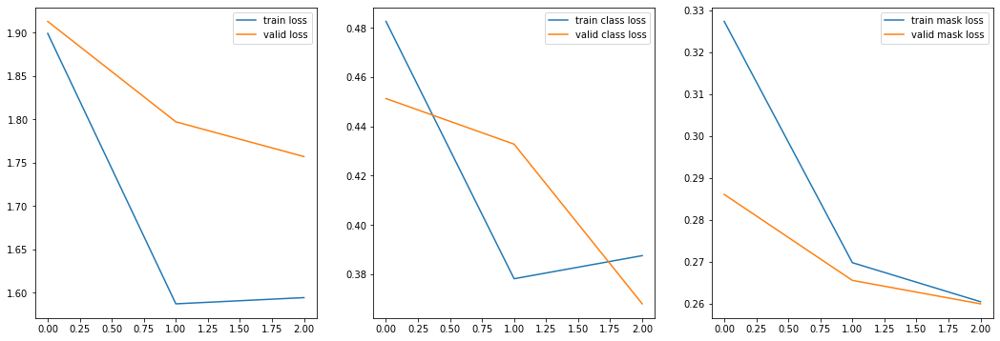

In [20]:
epochs = range(3)
history = model.keras_model.history.history
plt.figure(figsize=(18, 6))

plt.subplot(131)
plt.plot(epochs, history['loss'], label="train loss")
plt.plot(epochs, history['val_loss'], label="valid loss")
plt.legend()
plt.subplot(132)
plt.plot(epochs, history['mrcnn_class_loss'], label="train class loss")
plt.plot(epochs, history['val_mrcnn_class_loss'], label="valid class loss")
plt.legend()
plt.subplot(133)
plt.plot(epochs, history['mrcnn_mask_loss'], label="train mask loss")
plt.plot(epochs, history['val_mrcnn_mask_loss'], label="valid mask loss")
plt.legend()


plt.show()

In [21]:
best_epoch = np.argmin(history["val_loss"]) + 1
print("Best epoch: ", best_epoch)
print("Valid loss: ", history["val_loss"][best_epoch-1])

Best epoch:  3
Valid loss:  1.7571507161855697


In [24]:
#Predict
class InferenceConfig(FashionConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

inference_config = InferenceConfig()

glob_list = glob.glob(f'/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/fashion*/mask_rcnn_fashion_{best_epoch:04d}.h5')
model_path = glob_list[0] if glob_list else ''

model = modellib.MaskRCNN(mode='inference', 
                          config=inference_config,
                          model_dir=ROOT_DIR)

assert model_path != '', "Provide path to trained weights"
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)

Instructions for updating:
Use tf.cast instead.
Loading weights from  /home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/fashion20191227T1556/mask_rcnn_fashion_0003.h5
Re-starting from epoch 3


In [25]:
sample_df = pd.read_csv(DATA_DIR/"sample_submission.csv")
sample_df.head()

,ImageId,EncodedPixels,ClassId
0,003d41dd20f271d27219fe7ee6de727d.jpg,1 1,23
1,0046f98599f05fd7233973e430d6d04d.jpg,1 1,23
2,004e9e21cd1aca568a8ffc77a54638ce.jpg,1 1,23
3,005b37fce3c0f641d327d95dd832f51b.jpg,1 1,23
4,0094940c58c343b742f48ae26eb5e9fa.jpg,1 1,23


In [26]:
def to_rle(bits):
    rle = []
    pos = 1
    for bit, group in itertools.groupby(bits):
        group_list = list(group)
        if bit:
            rle.extend([pos, len(group_list)])
        pos += len(group_list)
    return rle

In [27]:
def trim_masks(masks, rois, class_ids):
    class_pos = np.argsort(class_ids)
    class_rle = to_rle(np.sort(class_ids))
    
    pos = 0
    for i, _ in enumerate(class_rle[::2]):
        previous_pos = pos
        pos += class_rle[2*i+1]
        if pos-previous_pos == 1:
            continue 
        mask_indices = class_pos[previous_pos:pos]
        
        union_mask = np.zeros(masks.shape[:-1], dtype=bool)
        for m in mask_indices:
            masks[:, :, m] = np.logical_and(masks[:, :, m], np.logical_not(union_mask))
            union_mask = np.logical_or(masks[:, :, m], union_mask)
        for m in mask_indices:
            mask_pos = np.where(masks[:, :, m]==True)
            if np.any(mask_pos):
                y1, x1 = np.min(mask_pos, axis=1)
                y2, x2 = np.max(mask_pos, axis=1)
                rois[m, :] = [y1, x1, y2, x2]
            
    return masks, rois

In [28]:
%%time
sub_list = []
missing_count = 0
for i, row in tqdm(sample_df.iterrows(), total=len(sample_df)):
    image = resize_image(str(DATA_DIR/'test'/row['ImageId']))
    result = model.detect([image])[0]
    if result['masks'].size > 0:
        masks, _ = trim_masks(result['masks'], result['rois'], result['class_ids'])
        for m in range(masks.shape[-1]):
            mask = masks[:, :, m].ravel(order='F')
            rle = to_rle(mask)
            label = result['class_ids'][m] - 1
            sub_list.append([row['ImageId'], ' '.join(list(map(str, rle))), label])
    else:
        # The system does not allow missing ids, this is an easy way to fill them
        sub_list.append([row['ImageId'], '1 1', 23])
        missing_count += 1

  0%|          | 0/3200 [00:00<?, ?it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/003d41dd20f271d27219fe7ee6de727d.jpg


  0%|          | 1/3200 [00:06<5:36:23,  6.31s/it]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0046f98599f05fd7233973e430d6d04d.jpg


  0%|          | 2/3200 [00:06<4:05:50,  4.61s/it]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/004e9e21cd1aca568a8ffc77a54638ce.jpg


  0%|          | 3/3200 [00:07<2:58:55,  3.36s/it]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/005b37fce3c0f641d327d95dd832f51b.jpg


  0%|          | 4/3200 [00:08<2:16:24,  2.56s/it]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0094940c58c343b742f48ae26eb5e9fa.jpg


  0%|          | 5/3200 [00:08<1:41:42,  1.91s/it]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0099bc6cd3b8c47c2d21a2877b1fa533.jpg


  0%|          | 6/3200 [00:09<1:19:50,  1.50s/it]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/009b107156c1ee41b03c5b35a82e7232.jpg


  0%|          | 7/3200 [00:09<1:05:47,  1.24s/it]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/00a1940434d687a785be0acf2b0fbff3.jpg


  0%|          | 8/3200 [00:10<52:16,  1.02it/s]  

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/00a325fd4dc22079095ab46330abf7be.jpg


  0%|          | 9/3200 [00:10<44:00,  1.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/00a8764cff12b2e849c850f4be5608bc.jpg


  0%|          | 10/3200 [00:10<38:18,  1.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/00d5da56c02d426c4e4bf802b1888471.jpg


  0%|          | 11/3200 [00:11<32:35,  1.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/00d6e5891b7507fccbd49f2c2756b114.jpg


  0%|          | 12/3200 [00:11<27:54,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/00e45dd233e31906f538ba17dd45bf29.jpg


  0%|          | 13/3200 [00:12<25:10,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/00f1db534538841931f15f2bb5cec76c.jpg


  0%|          | 14/3200 [00:12<22:57,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/00faa1032cc0809974a8d2dd7b018497.jpg


  0%|          | 15/3200 [00:12<22:13,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/010cf2ab96d1d730e15c76720af0e1a6.jpg


  0%|          | 16/3200 [00:13<24:45,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/011ccdc0d82e359420e5b578740d7971.jpg


  1%|          | 17/3200 [00:13<23:21,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0146a53e12d690914995248fb6872121.jpg


  1%|          | 18/3200 [00:14<23:17,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/014c44b97f844dffda594b9e00a4b3fd.jpg


  1%|          | 19/3200 [00:14<22:57,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/014eadcd4cf28a669232d4b6470e4e01.jpg


  1%|          | 20/3200 [00:14<23:08,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/01590a6ba1c54b8addb3c6f876c53a2e.jpg


  1%|          | 21/3200 [00:15<22:34,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/016247873d36ee0ea830a3827107d52c.jpg


  1%|          | 22/3200 [00:15<21:50,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/017feefa35d1e5a8d27d3b93a6d96d15.jpg


  1%|          | 23/3200 [00:16<22:10,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/019ec2bcca4c8aa6381ae3661f5959ef.jpg


  1%|          | 24/3200 [00:17<30:16,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/01a64310ea9205193295869fcae93f90.jpg


  1%|          | 25/3200 [00:17<26:57,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/01ba45ca87225b17fef4abda0bd329e9.jpg


  1%|          | 26/3200 [00:17<24:35,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/01bb382de271571e209dd10cc220c7bc.jpg


  1%|          | 27/3200 [00:18<28:43,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/01c4698117bd9b3f99bc751da8dfd96c.jpg


  1%|          | 28/3200 [00:19<27:04,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/01c6f5ce934d00d6923c549671c36000.jpg


  1%|          | 29/3200 [00:19<26:07,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/01cb7fbd4a2d2c5b9aebfcd3c25c74e9.jpg


  1%|          | 30/3200 [00:20<28:28,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/01d0251b5bc5a41f93c86042c56258d3.jpg


  1%|          | 31/3200 [00:21<34:20,  1.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0205895cfbb5348d94fda8ce32272fa5.jpg


  1%|          | 32/3200 [00:21<30:09,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0214748c08592468d953769e712b9d9f.jpg


  1%|          | 33/3200 [00:21<27:03,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/02147618f9a3ea98605fa68f9179c7a0.jpg


  1%|          | 34/3200 [00:22<31:03,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/02182c58daf61dc5c5c64bb112b1f826.jpg


  1%|          | 35/3200 [00:23<30:10,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0229bef01efc25f915374d55f59cbfdd.jpg


  1%|          | 36/3200 [00:23<30:58,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0231c9645ffeeef22e6f8d769cbfcb13.jpg


  1%|          | 37/3200 [00:24<27:29,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/025c44ff30ea619abd1b1bb2df58bb8b.jpg


  1%|          | 38/3200 [00:24<26:13,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/025ee977bba7d2d1420984745d8232f7.jpg


  1%|          | 39/3200 [00:24<24:33,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/027e76835ebc810fdcc0e54b146e8fc3.jpg


  1%|▏         | 40/3200 [00:25<23:26,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/02916664cd606bb5486353f200a475a3.jpg


  1%|▏         | 41/3200 [00:25<26:43,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/02b4423e161fa2409974174ec53cdb2a.jpg


  1%|▏         | 42/3200 [00:26<24:46,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/02c29fa40b5c3802312e065f1f52cc80.jpg


  1%|▏         | 43/3200 [00:26<24:20,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/02ddd4192bc9a5823be4312824814279.jpg


  1%|▏         | 44/3200 [00:27<28:50,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/02f4eb537b152293cf69938553518677.jpg


  1%|▏         | 45/3200 [00:28<27:37,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0301f50a3cd73f13cd9e1125d8ef38bd.jpg


  1%|▏         | 46/3200 [00:28<25:59,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0309e132bc5fbc75f977005b2d4a79e3.jpg


  1%|▏         | 47/3200 [00:28<24:44,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/030cfd158b49ff622c71bdf9aa30f39a.jpg


  2%|▏         | 48/3200 [00:29<23:51,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/032590f9400693dc8cc6005f4b8dcaa9.jpg


  2%|▏         | 49/3200 [00:29<24:11,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03272452a2491dbed76a28035e195d32.jpg


  2%|▏         | 50/3200 [00:30<23:49,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/032e7b9f985406a0b76a0d1164e3050c.jpg


  2%|▏         | 51/3200 [00:30<22:32,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03410de826f6272f67a3549186d82c4e.jpg


  2%|▏         | 52/3200 [00:31<23:04,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0349e23c22d9ab9a482ac3d38ec315d5.jpg


  2%|▏         | 53/3200 [00:31<22:47,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03549b86fb916d9fc725d816c94d0a3c.jpg


  2%|▏         | 54/3200 [00:31<22:00,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/035b280e6bfd861226dbd2d1c8f89873.jpg


  2%|▏         | 55/3200 [00:32<23:35,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0373fa1af9637930d36bddae6e620b6c.jpg


  2%|▏         | 56/3200 [00:32<24:00,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0374a968b65e5cdf513bd9e20af71874.jpg


  2%|▏         | 57/3200 [00:33<23:18,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0376447616a44894318f342c004da244.jpg


  2%|▏         | 58/3200 [00:33<24:58,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/037bb8903e05afa1af566af09e2122ea.jpg


  2%|▏         | 59/3200 [00:34<24:25,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0388345fc60c336a3fe94085490776e7.jpg


  2%|▏         | 60/3200 [00:34<23:50,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03940cb6fdf45a4844dacf11367a7ff6.jpg


  2%|▏         | 61/3200 [00:35<24:46,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/039a4d7431ddd3a3aa8e7c11b870897c.jpg


  2%|▏         | 62/3200 [00:35<22:43,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03bce314fb43dbf88fa378f170cccc0b.jpg


  2%|▏         | 63/3200 [00:35<21:57,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03c846b699a15a82eb5ed75c61b6e95f.jpg


  2%|▏         | 64/3200 [00:36<22:41,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03e74d876f65ddd114ae4809618ca710.jpg


  2%|▏         | 65/3200 [00:36<22:15,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03e85172b71bb7c69b4cba22ebb34063.jpg


  2%|▏         | 66/3200 [00:37<20:46,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/03fc99c4deaf14724ef6277dec16b8e8.jpg


  2%|▏         | 67/3200 [00:37<22:48,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/04031384f4918c7176a1b20ea2537140.jpg


  2%|▏         | 68/3200 [00:37<20:44,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/041a6b43ed7ddfa1ec6040d27e5ce9a8.jpg


  2%|▏         | 69/3200 [00:38<24:50,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0420c7e0454fbbe11fadd23eb1f40d38.jpg


  2%|▏         | 70/3200 [00:39<28:14,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0434751e2f4ecc0fc5ca600f3ac680bc.jpg


  2%|▏         | 71/3200 [00:39<25:31,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/045db5fc067cb10b5d705c2afefa5966.jpg


  2%|▏         | 72/3200 [00:40<23:08,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0483fc73ee89d2e8c4b63aeb3af0542c.jpg


  2%|▏         | 73/3200 [00:40<28:21,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/04ae4fab477d24611f461c8f7ed4fb3d.jpg


  2%|▏         | 74/3200 [00:41<26:16,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/04e247377c80eb9f6e34c56595d68c95.jpg


  2%|▏         | 75/3200 [00:41<26:07,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/04e2745901c01dfb922ec164cd1e15ab.jpg


  2%|▏         | 76/3200 [00:42<24:08,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/04f51b3d0b28736139affb4e1feed01c.jpg


  2%|▏         | 77/3200 [00:42<21:16,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/04f6e414deea516f05612aa595c7a65e.jpg


  2%|▏         | 78/3200 [00:43<25:20,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/050462b952d003e868fe647797e20f81.jpg


  2%|▏         | 79/3200 [00:43<23:54,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/053888747fe4d05e64411e7454b10881.jpg


  2%|▎         | 80/3200 [00:43<22:07,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05418f9e1940094003b16deb58b3a01d.jpg


  3%|▎         | 81/3200 [00:44<21:44,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0544acba02e8776a56fde74f83633c21.jpg


  3%|▎         | 82/3200 [00:44<21:09,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05488fcc74f81ae452dd55229003f58f.jpg


  3%|▎         | 83/3200 [00:44<20:09,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0548e689638d1e559179b34bc895b72f.jpg


  3%|▎         | 84/3200 [00:45<22:46,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05571f180bbbaca6d3839ddb0a53f0c2.jpg


  3%|▎         | 85/3200 [00:45<24:18,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/056bea38b1947154d0613aab63505033.jpg


  3%|▎         | 86/3200 [00:46<23:18,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/057ebf774d4173380ce513578bd0f3f6.jpg


  3%|▎         | 87/3200 [00:46<22:36,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/058c71bfaebc5d0eb9c2d7285b731560.jpg


  3%|▎         | 88/3200 [00:47<22:02,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05ac586e0bd29fdf12a9506bf05b280b.jpg


  3%|▎         | 89/3200 [00:47<22:32,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05af199570c00b817102c3cb6834a6e4.jpg


  3%|▎         | 90/3200 [00:48<23:03,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05b35a8b70fc204bc6e9339bbc613d22.jpg


  3%|▎         | 91/3200 [00:48<21:31,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05b3d380777552fde5ecd7d2f59a446c.jpg


  3%|▎         | 92/3200 [00:48<21:35,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05b5e806121325fe0b9879c18f146f39.jpg


  3%|▎         | 93/3200 [00:49<21:18,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05bf5bc41fc3f6e18507faac19298273.jpg


  3%|▎         | 94/3200 [00:49<21:32,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05bfc7156bc37ce44207ca814f1b3737.jpg


  3%|▎         | 95/3200 [00:50<21:27,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05cbf14e6618b439185c053633831cdf.jpg


  3%|▎         | 96/3200 [00:50<24:05,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05d26dad11c6bca43d37df0c16d91bc9.jpg


  3%|▎         | 97/3200 [00:51<22:00,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05df29d770955d6fe8d7873982aba082.jpg


  3%|▎         | 98/3200 [00:51<21:28,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05df3749007ec999df0176b9db7c23e3.jpg


  3%|▎         | 99/3200 [00:51<21:36,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/05f4264fb2ef7d7928d8b85522672ec0.jpg


  3%|▎         | 100/3200 [00:52<24:01,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/06017096e7f209d3b23802f546830b40.jpg


  3%|▎         | 101/3200 [00:53<30:03,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0617757485dad98ded988c6e101c8bf2.jpg


  3%|▎         | 102/3200 [00:53<30:13,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0620db3b113984cd1a3a252f7664624a.jpg


  3%|▎         | 103/3200 [00:54<26:58,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/063053841bae486b4c35f00d361e0b2e.jpg


  3%|▎         | 104/3200 [00:54<26:09,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0634790bec8b79130ea6bdf45e1ba939.jpg


  3%|▎         | 105/3200 [00:55<26:38,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/064c8022b32931e787260d81ed5aafe8.jpg


  3%|▎         | 106/3200 [00:55<24:12,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/065fd62a332e15121c5f8713a5bc6bbc.jpg


  3%|▎         | 107/3200 [00:56<26:51,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/066cc36daacfc618bc5a70e8ce789fed.jpg


  3%|▎         | 108/3200 [00:56<24:36,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/069223d02dcbfbe69af905daeb7fae26.jpg


  3%|▎         | 109/3200 [00:57<24:29,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/06c55d20eabb8441eb9b366025cc43ce.jpg


  3%|▎         | 110/3200 [00:57<26:18,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/06cbcf9a70a67f6f02990ab060e3bf16.jpg


  3%|▎         | 111/3200 [00:58<27:29,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/06cc4cc3fd423fb82ce78a63c903cc5b.jpg


  4%|▎         | 112/3200 [00:58<28:07,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/06d3d5f692fedec651140520248bf5c9.jpg


  4%|▎         | 113/3200 [00:59<25:15,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/06e324f9ef2c3bc1cc2573562e498499.jpg


  4%|▎         | 114/3200 [00:59<23:15,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/06eca767af94ec50eb0503088708be13.jpg


  4%|▎         | 115/3200 [01:00<23:17,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/06ecffe481441947fcc9c8cadc8d07ee.jpg


  4%|▎         | 116/3200 [01:00<23:41,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/07572e488f6e5e7b3868a64fbc6be1a3.jpg


  4%|▎         | 117/3200 [01:00<22:22,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/07729e318fa891baba6eb212220b95a6.jpg


  4%|▎         | 118/3200 [01:01<24:38,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/079316c57596d9c170b1fa3964ddaa6c.jpg


  4%|▎         | 119/3200 [01:01<23:18,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/07960daf191c39d8a5c9ea31d0967b72.jpg


  4%|▍         | 120/3200 [01:02<22:53,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0797a7c729a7da9e67258f46bf25113e.jpg


  4%|▍         | 121/3200 [01:02<21:36,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/07a7bc9429c23e4704ab97898de75030.jpg


  4%|▍         | 122/3200 [01:03<21:14,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/07ca6418fec6b952b930f7fc19de9e38.jpg


  4%|▍         | 123/3200 [01:03<20:07,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/07ca8557b287c88d68ad06b4fe42776b.jpg


  4%|▍         | 124/3200 [01:03<20:34,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/07daf1f351859a7d4fcff7b90cc7c01d.jpg


  4%|▍         | 125/3200 [01:04<18:56,  2.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/07ea7662a6eac3f7d6a998c94239ef4e.jpg


  4%|▍         | 126/3200 [01:04<19:10,  2.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08269ba6f7c1fffd539fc3c016b771e6.jpg


  4%|▍         | 127/3200 [01:04<20:00,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/082ad027fea3c92f27b41ab293847fd2.jpg


  4%|▍         | 128/3200 [01:05<24:44,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/083eab3fccdb0fe9af6b29d5648c1c00.jpg


  4%|▍         | 129/3200 [01:06<24:08,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08508eee91db9d3e8cb30d9beaa3e1a7.jpg


  4%|▍         | 130/3200 [01:06<24:46,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08680e1257c83a5a603ae3ef67ef3dde.jpg


  4%|▍         | 131/3200 [01:06<22:55,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/086d00c234f4cb9aa9798860266c3c3f.jpg


  4%|▍         | 132/3200 [01:07<23:22,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08a58fc63f2d38be5419ad16e7ced303.jpg


  4%|▍         | 133/3200 [01:07<21:12,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08a5fc15bb6f3e0f59f4abbf83b79a0e.jpg


  4%|▍         | 134/3200 [01:08<21:50,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08aef22333dc36956f927b2528d47ace.jpg


  4%|▍         | 135/3200 [01:08<22:15,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08b487d437ae6058ca64250be162b656.jpg


  4%|▍         | 136/3200 [01:09<22:31,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08b871382189d9cfb98ae69b8aaf6a37.jpg


  4%|▍         | 137/3200 [01:09<21:07,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08c915c2155cb2e58b7d485982c68947.jpg


  4%|▍         | 138/3200 [01:09<21:38,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08ce85240ea476099fa8e4528b4b8e23.jpg


  4%|▍         | 139/3200 [01:10<24:34,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08d7b9303063435f0302169edcb701d4.jpg


  4%|▍         | 140/3200 [01:11<24:48,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/08db3cd964133d2c08571a4399083f59.jpg


  4%|▍         | 141/3200 [01:11<29:06,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0931b17ccbb82e1eda1010f1428cc7cb.jpg


  4%|▍         | 142/3200 [01:12<29:57,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/09350208dbbe3f0d495c48a8ed036d8e.jpg


  4%|▍         | 143/3200 [01:12<27:13,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/09524f427576768e445b55a1975b9d7f.jpg


  4%|▍         | 144/3200 [01:13<27:04,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/095b9c28ea50b1707ad4be55a37ae399.jpg


  5%|▍         | 145/3200 [01:13<24:29,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/09675496409c85adc6deba11277050e8.jpg


  5%|▍         | 146/3200 [01:14<25:49,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/09a205e6a9500de4d5ec89446a3d9bf2.jpg


  5%|▍         | 147/3200 [01:14<24:12,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/09c1c65c2b742a710bc736a8fe566d11.jpg


  5%|▍         | 148/3200 [01:15<27:08,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/09ea62fead98686e93c6683ab297dda9.jpg


  5%|▍         | 149/3200 [01:15<25:43,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/09ff9e179fe9d63f48c1bf6d5565f659.jpg


  5%|▍         | 150/3200 [01:16<26:17,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0a45b6b033bf0077a15f484e98f3dbfe.jpg


  5%|▍         | 151/3200 [01:16<27:33,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0a4aae5ecd970a120bfcc6b377b6e187.jpg


  5%|▍         | 152/3200 [01:17<25:15,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0a4f8205a3b58e70eec99fbbb9422d08.jpg


  5%|▍         | 153/3200 [01:17<23:48,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0a563d036018e91cd9b5899adb50ec18.jpg


  5%|▍         | 154/3200 [01:18<22:45,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0a729bbbccaf081a46d72e5869838b45.jpg


  5%|▍         | 155/3200 [01:18<23:42,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0a72e0f76ab9b75945f5d610508f9336.jpg


  5%|▍         | 156/3200 [01:18<21:13,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0a939e0e67011aecf7195c17ecb9733c.jpg


  5%|▍         | 157/3200 [01:19<20:25,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0af8af9ca834900d3b23abda5264503a.jpg


  5%|▍         | 158/3200 [01:19<22:13,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0afb6b28d4583e470c7d0c52268272a7.jpg


  5%|▍         | 159/3200 [01:20<24:43,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0b23958eade3801f423e504d2ca8ffa4.jpg


  5%|▌         | 160/3200 [01:20<24:08,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0b351e597f43c6d3c55d7b435aeef066.jpg


  5%|▌         | 161/3200 [01:21<21:25,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0b3e3fbcd4ba937b59837f20e2f0888a.jpg


  5%|▌         | 162/3200 [01:21<21:34,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0b48b477aa4075c5489c5bfb0df35017.jpg


  5%|▌         | 163/3200 [01:21<19:37,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0b915f1e29a2e2dacf96aacd3cb6a3cc.jpg


  5%|▌         | 164/3200 [01:22<19:09,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0ba0216e6879f8b433d0897a77cff984.jpg


  5%|▌         | 165/3200 [01:23<25:31,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0bbaa62211cc48b57957aab152fba023.jpg


  5%|▌         | 166/3200 [01:23<29:43,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0bbb948a0876edce2827a164c6783fbe.jpg


  5%|▌         | 167/3200 [01:24<27:22,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0bf1bfb33db3cee939902582642ac1bb.jpg


  5%|▌         | 168/3200 [01:24<27:53,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0bf28f90d4a78251c32c37b8164d7676.jpg


  5%|▌         | 169/3200 [01:25<32:05,  1.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0c19eca5f90b66b915e2f6cbd421574f.jpg


  5%|▌         | 170/3200 [01:26<28:36,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0c6cf79ffbf7f14a266d0f0f21219447.jpg


  5%|▌         | 171/3200 [01:26<26:20,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0c8c7a46d30f841b2e8944acddc21b3d.jpg


  5%|▌         | 172/3200 [01:27<28:15,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0c96b29823a5372efdc370fb5a231145.jpg


  5%|▌         | 173/3200 [01:27<28:37,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0cae8146b9ec4788a06ea4bf45a257ba.jpg


  5%|▌         | 174/3200 [01:28<26:41,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0cb2351c74ccc0b38128e91d0629625d.jpg


  5%|▌         | 175/3200 [01:28<24:58,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0cd8f2955ec01a4e2678648f153b1326.jpg


  6%|▌         | 176/3200 [01:29<24:33,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0d0417d27fea871995e100907cf39cc1.jpg


  6%|▌         | 177/3200 [01:29<21:16,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0d25b761d9b146cfa820b2a7364b5bf7.jpg


  6%|▌         | 178/3200 [01:29<21:24,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0d2c936a0c0acff642b5a8c5e85fd461.jpg


  6%|▌         | 179/3200 [01:30<21:36,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0d32e0c44b492a04a01db6eaf11c7fc7.jpg


  6%|▌         | 180/3200 [01:30<19:40,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0d5d5e00e589fe5641b919179794994b.jpg


  6%|▌         | 181/3200 [01:31<27:19,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0d76d62a5c5ba8644db899b2b5698a0e.jpg


  6%|▌         | 182/3200 [01:31<26:28,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0d8803f0181d1d5e0b8d55d886a40c3d.jpg


  6%|▌         | 183/3200 [01:32<27:38,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0d98a538dcc1ae339c2e4cfd235b9509.jpg


  6%|▌         | 184/3200 [01:32<25:37,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0dbd3f116ed02e39a2136824473b47a7.jpg


  6%|▌         | 185/3200 [01:33<28:23,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0dc0c471a32907df9e6f3f85b1d1897b.jpg


  6%|▌         | 186/3200 [01:34<25:40,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0dc88e905c843875a508ffd6581170e7.jpg


  6%|▌         | 187/3200 [01:34<26:11,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0df0a300efcfc8c0e289f29c0ac8f86d.jpg


  6%|▌         | 188/3200 [01:35<25:12,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0df11a4383879c0326896fefa30e8f6c.jpg


  6%|▌         | 189/3200 [01:35<25:58,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0e0504a8c053aed418aaeebd2be60ce3.jpg


  6%|▌         | 190/3200 [01:36<27:15,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0e15c6a2a095ba20f904c78dedf3a228.jpg


  6%|▌         | 191/3200 [01:36<30:18,  1.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0e4af4261e722e382d3999857e51870c.jpg


  6%|▌         | 192/3200 [01:37<25:29,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0e4ccb9ca5528265c8330c043604b0c7.jpg


  6%|▌         | 193/3200 [01:37<22:49,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0e5ecf98835cbd0dddd1b45c788005c3.jpg


  6%|▌         | 194/3200 [01:38<23:44,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0e9775fcd1a3b1d95aed773e684b3f49.jpg


  6%|▌         | 195/3200 [01:38<23:24,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0ead2ad663e32a0f867c31895b1ade76.jpg


  6%|▌         | 196/3200 [01:38<22:24,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0ebe6d8449aed07be683fd778a4092d1.jpg


  6%|▌         | 197/3200 [01:39<21:52,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0ed919511953f705089d8d5fd7dff2cf.jpg


  6%|▌         | 198/3200 [01:39<19:56,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0ef685358bc959847a46c299322bafa0.jpg


  6%|▌         | 199/3200 [01:40<19:40,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0efe12abab123c39757888e9c8f9d145.jpg


  6%|▋         | 200/3200 [01:40<19:56,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0f268c42b6eda9ec5f80f3064f4a6155.jpg


  6%|▋         | 201/3200 [01:40<19:42,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0f3444a07e3cc8d310ab33907d96ba1f.jpg


  6%|▋         | 202/3200 [01:41<20:50,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0f49ff48b5b25933db0669e9077b5cd3.jpg


  6%|▋         | 203/3200 [01:41<22:42,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0f4d15d0aed8a66085298f73a759f27b.jpg


  6%|▋         | 204/3200 [01:42<21:36,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0f68960d855adfe019da1d4480770b17.jpg


  6%|▋         | 205/3200 [01:42<20:18,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0f89611061b52ccbf2dde820554de1df.jpg


  6%|▋         | 206/3200 [01:42<19:47,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0fd47405bde971ea795259fa8790ef40.jpg


  6%|▋         | 207/3200 [01:43<19:52,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0ff1ad48b959df32af38f42cef26d361.jpg


  6%|▋         | 208/3200 [01:43<19:07,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/0ff21e64a5480e252e8dbd257f72032e.jpg


  7%|▋         | 209/3200 [01:44<23:38,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1003a917c17bc42f9de565905e976d7a.jpg


  7%|▋         | 210/3200 [01:44<22:04,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1050585bd1104969bc175e8bcdfd5311.jpg


  7%|▋         | 211/3200 [01:45<20:49,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/106d8791ebee7af873405f2bdcb9c54f.jpg


  7%|▋         | 212/3200 [01:45<22:30,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1096d7f19d17bc21e9a56f2ca44740c6.jpg


  7%|▋         | 213/3200 [01:46<22:27,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/10a117448125788275f45a4a48c406a6.jpg


  7%|▋         | 214/3200 [01:46<21:59,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/10ae8bdd823a935b4f107134b62bbc8a.jpg


  7%|▋         | 215/3200 [01:47<28:50,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/10c50c5260df9da9ce521b852c18535e.jpg


  7%|▋         | 216/3200 [01:48<29:25,  1.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/10d0606a6747501716f76fb3f5614cd3.jpg


  7%|▋         | 217/3200 [01:48<29:27,  1.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/10ff41e28a58864e970e1f5d5b6fcc18.jpg


  7%|▋         | 218/3200 [01:49<26:46,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/110884e327a094ad86358ece522dddff.jpg


  7%|▋         | 219/3200 [01:49<24:52,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/112a9c9b9c7a97f3f632b2ec7fd064e5.jpg


  7%|▋         | 220/3200 [01:49<24:03,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1133c832005b9620ab89eee82ba1c4a2.jpg


  7%|▋         | 221/3200 [01:50<23:27,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/113dcdc48d04076928f65df1bc941917.jpg


  7%|▋         | 222/3200 [01:50<20:12,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/114411003923c0d186c6a6d51009424f.jpg


  7%|▋         | 223/3200 [01:51<21:59,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/11669ac85fec72431334f523bc53c45f.jpg


  7%|▋         | 224/3200 [01:51<21:48,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/116c0fd0c6d963e7b68e7af47c4e8cc7.jpg


  7%|▋         | 225/3200 [01:51<21:53,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/118f0ead73f859663c81b5f86f5d5e3a.jpg


  7%|▋         | 226/3200 [01:52<25:36,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/119b337ea431d7795d5e60ad6b5a71a5.jpg


  7%|▋         | 227/3200 [01:52<22:33,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/11c17cfa0c3e2ee65046d0d77c6f8b07.jpg


  7%|▋         | 228/3200 [01:53<21:01,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/11eae5814ba9aad72fa4dad87b54b192.jpg


  7%|▋         | 229/3200 [01:53<21:43,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/123318217b814f567b34b30bc843680f.jpg


  7%|▋         | 230/3200 [01:54<20:14,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12416f707a0428adc08bc899bc6d84c8.jpg


  7%|▋         | 231/3200 [01:54<23:07,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/124d454fca78e66b8358424f05bfe4a1.jpg


  7%|▋         | 232/3200 [01:55<20:51,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/124dc5471306edcadc0d89bfc7353939.jpg


  7%|▋         | 233/3200 [01:55<23:21,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/126c42860c165034e8e46b17fa76cbf9.jpg


  7%|▋         | 234/3200 [01:56<22:31,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/128e563f37864265333bc9a3de7dccc6.jpg


  7%|▋         | 235/3200 [01:56<21:41,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/129641fb38cde5b4c002aada6c0f68f5.jpg


  7%|▋         | 236/3200 [01:56<21:12,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/129e532450000ba8ffceb3b76fd9e617.jpg


  7%|▋         | 237/3200 [01:57<22:03,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12a71f5cee59104964eccb52bd22fe09.jpg


  7%|▋         | 238/3200 [01:58<26:03,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12b3bdbd6cc7f9a136903bdf8c868d1a.jpg


  7%|▋         | 239/3200 [01:58<24:05,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12b6fd67ef3f6c74fd8483219b738bc1.jpg


  8%|▊         | 240/3200 [01:58<23:06,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12bbf859a0a9f6c6aa1330ca506e8015.jpg


  8%|▊         | 241/3200 [01:59<22:03,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12bf6fb74bf3a422429b71f23210d5fa.jpg


  8%|▊         | 242/3200 [01:59<21:12,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12da876e7f7a7e754f0ffe635dfb79f0.jpg


  8%|▊         | 243/3200 [01:59<19:05,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12dd799092382ae3f1cf59120270e9b6.jpg


  8%|▊         | 244/3200 [02:00<18:22,  2.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12ed4c6ee58a1e2ae0a3ddf3d702ca35.jpg


  8%|▊         | 245/3200 [02:00<20:34,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/12fea2852daf1832ce9646dd4554ada2.jpg


  8%|▊         | 246/3200 [02:01<20:46,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/136ac2a820e9718e52835f815428be82.jpg


  8%|▊         | 247/3200 [02:01<22:21,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13714a1c52d443ebeb3357cb3c6b5285.jpg


  8%|▊         | 248/3200 [02:02<21:57,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/137d35208367f5a6aaf358dee6b39d14.jpg


  8%|▊         | 249/3200 [02:02<20:28,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/138d25e69ff93fda0643ced2fa7feafb.jpg


  8%|▊         | 250/3200 [02:03<21:12,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13a6b649fa1638fff877ec7b8676dae9.jpg


  8%|▊         | 251/3200 [02:03<20:10,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13ab3679b9777ce7e608ba2740e6e05d.jpg


  8%|▊         | 252/3200 [02:03<18:51,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13ac5b09f6c7cf03d6bddeeba2dd7d63.jpg


  8%|▊         | 253/3200 [02:04<19:55,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13b9a088b45485a80832c944d48e11ba.jpg


  8%|▊         | 254/3200 [02:04<19:04,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13bd73c2068bc2705f3a0b65e425b965.jpg


  8%|▊         | 255/3200 [02:04<19:59,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13c2e7449a549d43161b95c9f1d68d40.jpg


  8%|▊         | 256/3200 [02:05<19:34,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13c70ef45d33a408cfaef9817926a6e9.jpg


  8%|▊         | 257/3200 [02:05<19:31,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13dc02b29a5e43c7eb2dc5234746a6ca.jpg


  8%|▊         | 258/3200 [02:06<19:14,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13eb38998d1db390780388635cc81d70.jpg


  8%|▊         | 259/3200 [02:06<19:54,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13f2e193228e5f80244a976250606266.jpg


  8%|▊         | 260/3200 [02:07<21:48,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/13fe12441faf2d3a6669aa4653b92658.jpg


  8%|▊         | 261/3200 [02:07<24:16,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/14017b6a1e8a3a5c86b94f8e8fbeb5b0.jpg


  8%|▊         | 262/3200 [02:08<22:47,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/14025b915e71064e49244d221f25eec4.jpg


  8%|▊         | 263/3200 [02:08<21:09,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/140c28b31fcda10211a81f039e8f6c8e.jpg


  8%|▊         | 264/3200 [02:08<19:38,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1415fdce536f372824f1ce32c7f153fd.jpg


  8%|▊         | 265/3200 [02:09<20:07,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1457a4320d40a1483d46288640ea7ddc.jpg


  8%|▊         | 266/3200 [02:09<20:31,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/14918e2a402f109c12da34aa2a4fce45.jpg


  8%|▊         | 267/3200 [02:10<19:51,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/14ce620645bc27f4710e2141432e7139.jpg


  8%|▊         | 268/3200 [02:10<18:51,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/14d9511905160b8b4b03d84465438ae6.jpg


  8%|▊         | 269/3200 [02:10<19:11,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/14f97e527ed398ebb8e13d6af178d941.jpg


  8%|▊         | 270/3200 [02:11<19:29,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1502267228cff79fdeb844edbe000f4f.jpg


  8%|▊         | 271/3200 [02:11<19:13,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15154e4e279813e4f7d40fd88a578810.jpg


  8%|▊         | 272/3200 [02:12<22:24,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1549674bd629241190c29697b8564b57.jpg


  9%|▊         | 273/3200 [02:12<21:25,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/155ea684f404a9b299b20ae06a64b813.jpg


  9%|▊         | 274/3200 [02:13<22:58,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15620ac788726611486d881df27a36b0.jpg


  9%|▊         | 275/3200 [02:13<23:14,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15910ed48cbfceeff0e0b808694b732c.jpg


  9%|▊         | 276/3200 [02:14<24:14,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15b3536fd4cd5f7c40b1ef1a611402e5.jpg


  9%|▊         | 277/3200 [02:14<22:39,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15b762ffae2204c3554787051c72670a.jpg


  9%|▊         | 278/3200 [02:14<21:24,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15dfcb20c4de134ef1d9d7af53ce0eca.jpg


  9%|▊         | 279/3200 [02:15<19:33,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15e1718954473a29738aa932ba31719c.jpg


  9%|▉         | 280/3200 [02:15<17:59,  2.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15e17717d4fd22f7bbebfe46ef3cbe7f.jpg


  9%|▉         | 281/3200 [02:15<17:05,  2.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15eeddb38affa2fcdba515253fad499e.jpg


  9%|▉         | 282/3200 [02:16<17:50,  2.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/15ff2886970f216c73cb0fef10c9f3c1.jpg


  9%|▉         | 283/3200 [02:16<19:20,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/162547986c33e122baa993ee9e02230d.jpg


  9%|▉         | 284/3200 [02:17<21:49,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/163316c8653449a9af4e731ac3aedaf7.jpg


  9%|▉         | 285/3200 [02:17<23:54,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1639f0d883677382b8d728af247c834a.jpg


  9%|▉         | 286/3200 [02:18<24:35,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/163f6acca8041b188a22b38e496bb148.jpg


  9%|▉         | 287/3200 [02:18<23:17,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1646a045268fa9848e2dad851f740452.jpg


  9%|▉         | 288/3200 [02:19<21:38,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/164eabcec362011d921a960e691e182a.jpg


  9%|▉         | 289/3200 [02:19<22:10,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/165b0195ff6dc62096d0c49c680407ca.jpg


  9%|▉         | 290/3200 [02:20<25:30,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/165d068e46d8eaa97392d5db91620721.jpg


  9%|▉         | 291/3200 [02:20<25:46,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/165fc69c577be6c18128e057487cf489.jpg


  9%|▉         | 292/3200 [02:21<24:06,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/166db2094576d8c91dd7b367e695e9a2.jpg


  9%|▉         | 293/3200 [02:21<21:40,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/16860b6e63ea60d49f754ed7424e8009.jpg


  9%|▉         | 294/3200 [02:22<20:10,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1687cf1a76e63aeaacd18ecca3639bbc.jpg


  9%|▉         | 295/3200 [02:22<21:03,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/16969a96d6b8f1c5f2f74805364bc19a.jpg


  9%|▉         | 296/3200 [02:23<22:40,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/16b7202138bdbb600ee49eadfe63f5f6.jpg


  9%|▉         | 297/3200 [02:23<25:00,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/16c1d24ba7182ba51d44540bee5905c6.jpg


  9%|▉         | 298/3200 [02:24<23:05,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1711df13cdf600a6aef7faf3d9e81d02.jpg


  9%|▉         | 299/3200 [02:24<22:40,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1731c6223212d540b428bf1cb1183876.jpg


  9%|▉         | 300/3200 [02:24<21:23,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1744183e925250327f807fdb15907f6a.jpg


  9%|▉         | 301/3200 [02:25<19:55,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1752623f114724c401600b3f4565b631.jpg


  9%|▉         | 302/3200 [02:25<19:35,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/176c976ed8edcf21eebef9de662adc18.jpg


  9%|▉         | 303/3200 [02:26<26:50,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1780ac0ddbb3e96d5eb6fcb97468c878.jpg


 10%|▉         | 304/3200 [02:26<23:57,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/17903da1009ca140ab8a3c081bf263c4.jpg


 10%|▉         | 305/3200 [02:27<25:32,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/17952d2e204c49ddd4fcd63eef60480c.jpg


 10%|▉         | 306/3200 [02:27<22:50,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/17e3e8454e1addcf98b2449ccb96d3a9.jpg


 10%|▉         | 307/3200 [02:28<21:37,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/17ee456175e872cf0dea3dee46e06568.jpg


 10%|▉         | 308/3200 [02:28<20:28,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18065324fae0dce63b803e6a30cc4e2b.jpg


 10%|▉         | 309/3200 [02:29<21:51,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/181629f057c2592c26657b0b02c4a3be.jpg


 10%|▉         | 310/3200 [02:29<21:21,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/183bece374cfc3d8e7bb8c15089eb382.jpg


 10%|▉         | 311/3200 [02:29<20:42,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1851ff9e83b22cbaa4fac6880ddbdc66.jpg


 10%|▉         | 312/3200 [02:30<20:12,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/188da5346a4b33a8f495bdc6fd5f1b87.jpg


 10%|▉         | 313/3200 [02:30<22:27,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1894401d7f537c348a237a8043630521.jpg


 10%|▉         | 314/3200 [02:31<28:45,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18b2f32e876170304b2b6860ae127ba5.jpg


 10%|▉         | 315/3200 [02:32<25:49,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18c07033fd67225df16d98e9f6975fc9.jpg


 10%|▉         | 316/3200 [02:32<24:38,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18c0e9262037120fc1820f5a2fed264b.jpg


 10%|▉         | 317/3200 [02:33<22:35,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18c15c8cfed7547c3b519a6888b3c802.jpg


 10%|▉         | 318/3200 [02:33<21:17,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18c427f220b754deebbe2e5c7c1d9a8a.jpg


 10%|▉         | 319/3200 [02:33<23:01,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18fac8908d23cfecf6bad7515a90b258.jpg


 10%|█         | 320/3200 [02:34<23:37,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18fda96dc0831e40bcaf6c68f4b54455.jpg


 10%|█         | 321/3200 [02:34<22:51,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/18fdadb4fdc5b85ad5ff2de3a35ccbdd.jpg


 10%|█         | 322/3200 [02:35<20:29,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1918cddd5d05e007637c1b635eb683f5.jpg


 10%|█         | 323/3200 [02:35<21:42,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/193e590e5a6b1150b19ef0e42a6155f9.jpg


 10%|█         | 324/3200 [02:36<23:18,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/19465ac5d2d2d07cd7524188666533df.jpg


 10%|█         | 325/3200 [02:36<22:34,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1990db0a5b2ddcee0b5b44a6186ff473.jpg


 10%|█         | 326/3200 [02:37<21:11,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1993511c0af4253eb5ff0d495ad2b9db.jpg


 10%|█         | 327/3200 [02:37<20:10,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/19a3e67782134960f8aad30e24e2a303.jpg


 10%|█         | 328/3200 [02:37<18:30,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/19b88ca66e3ab754d3b6aa7d5e2f0a83.jpg


 10%|█         | 329/3200 [02:38<20:48,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/19dd339879e0b1efdda6a92bbd2c754d.jpg


 10%|█         | 330/3200 [02:38<20:37,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/19ff358743463458613ea7b54f0cfacb.jpg


 10%|█         | 331/3200 [02:39<20:39,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1a0e7426f078931ec3f3c45c2855f7ba.jpg


 10%|█         | 332/3200 [02:39<20:02,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1a2e249b43d0234652e1e1afe9fcef61.jpg


 10%|█         | 333/3200 [02:40<21:18,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1a33b9995013eebb2094ec7d765adb67.jpg


 10%|█         | 334/3200 [02:40<23:00,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1a3b75fa84d23692f516ad00fe2ae2fc.jpg


 10%|█         | 335/3200 [02:41<21:51,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1a8651c1d8e5a8a7a546a303a38eea47.jpg


 10%|█         | 336/3200 [02:41<20:47,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1a8c45a2470ba65a4ae86063a8f638a3.jpg


 11%|█         | 337/3200 [02:42<25:03,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ad178c4bf17f2073b57f2a88daf272d.jpg


 11%|█         | 338/3200 [02:42<25:32,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ad1b073a835636389049ae8edebb29c.jpg


 11%|█         | 339/3200 [02:43<24:19,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ae9cdebd762234889e60f2c0d07a768.jpg


 11%|█         | 340/3200 [02:43<24:15,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1b392a7577346eb050da07a9b7ea3c72.jpg


 11%|█         | 341/3200 [02:44<24:42,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1b745e56a8cd08bd3f4fa85939f9f0d9.jpg


 11%|█         | 342/3200 [02:44<23:37,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1b84aa501066599f1332ff4551d9a1b3.jpg


 11%|█         | 343/3200 [02:45<21:55,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1b8c03a610d653da2492f3c8235e36a5.jpg


 11%|█         | 344/3200 [02:45<21:33,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1b93ec2c602538cb06bf66ef2e0042b0.jpg


 11%|█         | 345/3200 [02:45<20:05,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1b94b1ccf1076bf96d656a870f559d0e.jpg


 11%|█         | 346/3200 [02:46<20:58,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1b9501c6d04c20b1f0e78ada2b94cf5f.jpg


 11%|█         | 347/3200 [02:46<19:52,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1b9b2acc6ad9a65f79d002a9e5eac49b.jpg


 11%|█         | 348/3200 [02:47<19:21,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ba59c93806cd99aa291db7ac4960424.jpg


 11%|█         | 349/3200 [02:47<19:16,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1baaebafd3053581dff3570b50c6af97.jpg


 11%|█         | 350/3200 [02:47<18:59,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1bab167f6bd1af6e5e9bced3ba73284e.jpg


 11%|█         | 351/3200 [02:48<18:50,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1bcd0a03c37992db3d967692b0f7faea.jpg


 11%|█         | 352/3200 [02:48<19:49,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1bf4967e0da8ced7325d1e27e90927f0.jpg


 11%|█         | 353/3200 [02:49<17:59,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1bfa6210a0974e1218e74f6c7d8258ca.jpg


 11%|█         | 354/3200 [02:49<19:25,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c0a1d443043d8797290780b5680d4a4.jpg


 11%|█         | 355/3200 [02:49<19:25,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c1484bd95e170ad133660f8a69419b1.jpg


 11%|█         | 356/3200 [02:50<18:29,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c1b439e448879f805e8c827605ec96b.jpg


 11%|█         | 357/3200 [02:50<18:44,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c1cf4a88aba7c676f8563907b1154ea.jpg


 11%|█         | 358/3200 [02:51<18:40,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c1d3b5d3c768ad58572eae16443c824.jpg


 11%|█         | 359/3200 [02:51<18:05,  2.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c2246e2c36d4b6cc6307b7c3ee8c0eb.jpg


 11%|█▏        | 360/3200 [02:51<18:19,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c34cbdd4fdf7c468f781d1f1cbb4609.jpg


 11%|█▏        | 361/3200 [02:52<18:09,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c38b8f375f1d61b3daad93040447b1b.jpg


 11%|█▏        | 362/3200 [02:52<20:16,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c3c10b47057091f4b524f0128280b51.jpg


 11%|█▏        | 363/3200 [02:53<21:48,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c46fbd003ae2b380143c36d06bd2c72.jpg


 11%|█▏        | 364/3200 [02:53<21:28,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c52ecf72920865d7859cae743d2c4f9.jpg


 11%|█▏        | 365/3200 [02:54<20:18,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c65a2e6783d87f86c30495565722fbd.jpg


 11%|█▏        | 366/3200 [02:54<20:59,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c906b2d4f414e1e7ed064abc0606a0a.jpg


 11%|█▏        | 367/3200 [02:55<23:04,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1c929f3b53b9e67dbf5986309a244aaa.jpg


 12%|█▏        | 368/3200 [02:56<28:16,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ca4458d23522f006de2ffda045c3b44.jpg


 12%|█▏        | 369/3200 [02:56<28:09,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ca6fb4b937bb1f34797d3315266a546.jpg


 12%|█▏        | 370/3200 [02:57<25:24,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ca98d1e4a2bb4aa8f2ab4b3598c78b7.jpg


 12%|█▏        | 371/3200 [02:57<23:13,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d03c2c0dceb5d5edafc7ad4e5de34ec.jpg


 12%|█▏        | 372/3200 [02:57<24:31,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d17dd8bb84bb923966d365e5d8ad174.jpg


 12%|█▏        | 373/3200 [02:58<23:25,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d28435f6cabcd0654ab3b4f11c15c0c.jpg


 12%|█▏        | 374/3200 [02:58<23:00,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d2aa034c5a389441eba1e1d199ec9e4.jpg


 12%|█▏        | 375/3200 [02:59<21:04,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d48dbe153101fe75b0e5c33cdd6934a.jpg


 12%|█▏        | 376/3200 [02:59<20:21,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d674548eeae391259da02e21fac484c.jpg


 12%|█▏        | 377/3200 [03:00<21:49,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d75b2b3f72f3e67b0231ddd8e6a961d.jpg


 12%|█▏        | 378/3200 [03:00<21:06,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d795cf03fcc97e9da94a207b5aca34d.jpg


 12%|█▏        | 379/3200 [03:01<20:36,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d8a81f9cf6f5f3e66f65293408399ed.jpg


 12%|█▏        | 380/3200 [03:01<19:44,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1d964d0eb4974ad6f5b8ed499474f350.jpg


 12%|█▏        | 381/3200 [03:01<19:27,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1dab6bc0e5d847145c29b91e37e1960f.jpg


 12%|█▏        | 382/3200 [03:02<19:53,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1dc3829659f97c1cff867ef710ece470.jpg


 12%|█▏        | 383/3200 [03:02<19:30,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1dc6c14b1cb936d2d639eebce6f19e82.jpg


 12%|█▏        | 384/3200 [03:03<20:08,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1dce1d64fcf0ed0ceacb920a179cc3db.jpg


 12%|█▏        | 385/3200 [03:03<20:38,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1dd0140361672b4ebd9b54aab7ba71ef.jpg


 12%|█▏        | 386/3200 [03:04<21:05,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1dfe4eb7f1f6a38b6871f0f166d1f4e4.jpg


 12%|█▏        | 387/3200 [03:04<18:48,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1dffba470396e2e75841783f4584ed86.jpg


 12%|█▏        | 388/3200 [03:05<22:47,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1e0e966a4adcdb640396d54816534876.jpg


 12%|█▏        | 389/3200 [03:05<23:06,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1e1550d9c7268ebd65e25e94e8b72575.jpg


 12%|█▏        | 390/3200 [03:06<24:08,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1e3fe6a399b928aa949bffe392ffe367.jpg


 12%|█▏        | 391/3200 [03:06<24:32,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1e54ccbc575eac627de68b221913fc52.jpg


 12%|█▏        | 392/3200 [03:07<24:17,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1e7af28b45470cbbf44bbc07b716b1d1.jpg


 12%|█▏        | 393/3200 [03:07<22:38,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1e7e2c402bc778bc18e941c333d46368.jpg


 12%|█▏        | 394/3200 [03:07<22:21,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1eaa797678050a918a706a2fc232697c.jpg


 12%|█▏        | 395/3200 [03:08<19:53,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ebcfa71e3dd6aaabc65fc3a3c383aa7.jpg


 12%|█▏        | 396/3200 [03:08<22:52,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ed3961d0e80c5b7b8b09f9c1ce0662c.jpg


 12%|█▏        | 397/3200 [03:09<25:20,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1ee26a858200fa98bef04c950dad233a.jpg


 12%|█▏        | 398/3200 [03:10<23:57,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1eec96671e8a5fb35bf350d5e7196bda.jpg


 12%|█▏        | 399/3200 [03:10<22:07,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1f0d72ecd966170babc209b45abe8983.jpg


 12%|█▎        | 400/3200 [03:10<22:09,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1f15cf1288966b01ed5bcfb139ed96fc.jpg


 13%|█▎        | 401/3200 [03:11<21:31,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1f1ad688e264cdad3ad242af48dbec87.jpg


 13%|█▎        | 402/3200 [03:11<20:52,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1f1e21e9d1206809d4f20ef5e6d2ddef.jpg


 13%|█▎        | 403/3200 [03:12<22:58,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1f266a1dea53781e622b71a69496ee72.jpg


 13%|█▎        | 404/3200 [03:12<24:49,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1f4c2d7ddfaa4d7c5a88df6d04ec0512.jpg


 13%|█▎        | 405/3200 [03:13<22:00,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1f6b96f7f298903a77fa747ea4fe8840.jpg


 13%|█▎        | 406/3200 [03:13<21:52,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1f9466371d64de05991d2a439301baf2.jpg


 13%|█▎        | 407/3200 [03:14<21:32,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1fbd9af2b5d72ebe335b0cbb08214109.jpg


 13%|█▎        | 408/3200 [03:14<22:17,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1fc67fcf2301de07315b2b1eae7d1e87.jpg


 13%|█▎        | 409/3200 [03:15<21:24,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1fd2dcf403acd7fb4f9d6b2604467c15.jpg


 13%|█▎        | 410/3200 [03:15<22:06,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/1fd63362ced55967a97a324928583339.jpg


 13%|█▎        | 411/3200 [03:15<19:52,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/200801ffb2c44d46b94454f1b6a278a6.jpg


 13%|█▎        | 412/3200 [03:16<21:10,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2012cd2a43f402afc464573883246bd9.jpg


 13%|█▎        | 413/3200 [03:16<20:14,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/201a00e2624e8befe10480933714e626.jpg


 13%|█▎        | 414/3200 [03:17<19:19,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/201ed1164d3ebb6acaa419e5f8328368.jpg


 13%|█▎        | 415/3200 [03:17<19:44,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/203bd39accd1e4dee2ce379c561c8ca2.jpg


 13%|█▎        | 416/3200 [03:18<19:44,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/205d6dceb7b3a14177190eb660dc0e2b.jpg


 13%|█▎        | 417/3200 [03:18<18:27,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2064125f44bafe6b58a8b62750c96e5e.jpg


 13%|█▎        | 418/3200 [03:18<18:12,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/209cbf60a0afd6931578067a9856678a.jpg


 13%|█▎        | 419/3200 [03:19<21:09,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/20bdefcd48f74c927cca2870e52176b1.jpg


 13%|█▎        | 420/3200 [03:19<21:25,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/20cce77f20aada8462856157a7957d8f.jpg


 13%|█▎        | 421/3200 [03:20<21:08,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/20d177d2cab24b9d12a2291670901535.jpg


 13%|█▎        | 422/3200 [03:20<22:30,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/20e1589c4346944fa7f77b5f28a1aa2c.jpg


 13%|█▎        | 423/3200 [03:21<20:51,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/20f9819eaa83ce17d76baf30880cd99f.jpg


 13%|█▎        | 424/3200 [03:21<19:17,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2124c532db8efdacf127013fbd5461e7.jpg


 13%|█▎        | 425/3200 [03:22<19:41,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/215ae3c02ff82ed943816a80204d7a41.jpg


 13%|█▎        | 426/3200 [03:22<19:19,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/216d717f1360e765cdc3e6d4321b2270.jpg


 13%|█▎        | 427/3200 [03:22<19:33,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/216e060e6cf3138f62aaa7f0efd5fb09.jpg


 13%|█▎        | 428/3200 [03:23<17:38,  2.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2171b137ca967fb6540ce50fc824aaa4.jpg


 13%|█▎        | 429/3200 [03:23<17:42,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/218f45327eead3c64b19e3ddee2ec238.jpg


 13%|█▎        | 430/3200 [03:24<21:32,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/219a6c846e208bbad39f71ddab96408a.jpg


 13%|█▎        | 431/3200 [03:24<24:09,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/219e070fdf1a306f0f229db82cd46c5c.jpg


 14%|█▎        | 432/3200 [03:25<27:18,  1.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/21a9eb0a54a146d628b36571c6a8ef7c.jpg


 14%|█▎        | 433/3200 [03:26<27:50,  1.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/21b019899232d2682e25237d3da5eefc.jpg


 14%|█▎        | 434/3200 [03:26<25:48,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/21c52aa89dbf9b2be2089c20cf1d987d.jpg


 14%|█▎        | 435/3200 [03:27<23:34,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/21dd915650694b8a5b17aa9e442bb079.jpg


 14%|█▎        | 436/3200 [03:27<25:24,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2207cd8dd49a5ee0f3e7903871272640.jpg


 14%|█▎        | 437/3200 [03:28<23:27,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/226e38da6ac6142912a6a8c61bafddb6.jpg


 14%|█▎        | 438/3200 [03:28<21:27,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2276c9df229065fb827c8254efae9c15.jpg


 14%|█▎        | 439/3200 [03:29<21:47,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/227a61b64bca65ba3a3247a253d05fb1.jpg


 14%|█▍        | 440/3200 [03:29<20:22,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2288c53c83faab62d8fbf73b35d1ebb8.jpg


 14%|█▍        | 441/3200 [03:29<20:34,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/228d6f335e7c88d524d4bd4c8bdebd1d.jpg


 14%|█▍        | 442/3200 [03:30<18:43,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2294520d7ec0bda53fb0e77af9560e05.jpg


 14%|█▍        | 443/3200 [03:30<19:48,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/229f39b7fdd1baf571f9e757ca8b7982.jpg


 14%|█▍        | 444/3200 [03:31<19:32,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/22c08d9856fbadfbba1ea898d44a652f.jpg


 14%|█▍        | 445/3200 [03:31<18:47,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/22cdabf1fc70b949b8bd3a37d93ecf05.jpg


 14%|█▍        | 446/3200 [03:31<18:23,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/22da26837c3e8b3ca2d60fb067c6cd0e.jpg


 14%|█▍        | 447/3200 [03:32<19:48,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/22edb152f5dcafd163ccf1e70d005e38.jpg


 14%|█▍        | 448/3200 [03:32<19:29,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2310f7efadf3407b64a2a4532a1d2ee7.jpg


 14%|█▍        | 449/3200 [03:33<17:46,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/232031788c76d2cc08217c74d1caf8bb.jpg


 14%|█▍        | 450/3200 [03:33<18:31,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/234edbb6b3cb898efe2aa8ad2d9e9264.jpg


 14%|█▍        | 451/3200 [03:33<19:19,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/236d3495722c76ba66121bdd9dc92d37.jpg


 14%|█▍        | 452/3200 [03:34<19:13,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/23791581c54542f3e761b0ff28c38e00.jpg


 14%|█▍        | 453/3200 [03:34<19:37,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2391a0988f649d929bf815a4e0524453.jpg


 14%|█▍        | 454/3200 [03:35<18:01,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/23dc2aa28cc0030acefeed92059cb09d.jpg


 14%|█▍        | 455/3200 [03:35<19:36,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/240bd00f12d515296843b780abb6ffc7.jpg


 14%|█▍        | 456/3200 [03:36<22:22,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/247ac98e288609e616f1dde9aede4e94.jpg


 14%|█▍        | 457/3200 [03:36<24:00,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/24b27b0fc9a787c000ebfec2b829de95.jpg


 14%|█▍        | 458/3200 [03:37<22:08,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/24b7c65d52433d1fd9f3530d18ea9779.jpg


 14%|█▍        | 459/3200 [03:37<21:56,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/24bf389023a1e1a5b69038ed4925cd6e.jpg


 14%|█▍        | 460/3200 [03:38<23:10,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/24de14c8095366da2ad9da3d0f8f827c.jpg


 14%|█▍        | 461/3200 [03:38<21:13,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/24f1db5265b04819c05c271ffb22a0ef.jpg


 14%|█▍        | 462/3200 [03:39<21:55,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2546dc0cd67b764a0969782c122732c0.jpg


 14%|█▍        | 463/3200 [03:39<19:32,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2551e47761b4dec0095aa9d1529385e0.jpg


 14%|█▍        | 464/3200 [03:39<19:30,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2555992e6dd494b54500f128cfcc1881.jpg


 15%|█▍        | 465/3200 [03:40<18:28,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/255603898dc1fe398ac79dc3e3fcaf46.jpg


 15%|█▍        | 466/3200 [03:41<25:03,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/255989bbfb631c18a52e16690eae4545.jpg


 15%|█▍        | 467/3200 [03:41<23:13,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/25b6a7dad9c5df5d9b36d681541500bf.jpg


 15%|█▍        | 468/3200 [03:42<22:51,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/25cab6fb1d57b9a85a29be68a276099a.jpg


 15%|█▍        | 469/3200 [03:42<21:25,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/25d405f31851734c949c85172cd41f5b.jpg


 15%|█▍        | 470/3200 [03:42<22:01,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/25d4e40003f6739349121db096771d58.jpg


 15%|█▍        | 471/3200 [03:43<20:01,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/25dbe452e7b37fd0692904330fb46dd5.jpg


 15%|█▍        | 472/3200 [03:43<18:46,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/25e8f5c19ebd5f6a319c71a2790270a2.jpg


 15%|█▍        | 473/3200 [03:44<20:52,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/25e92d53394ac92b6b9edbbfe7cb0e1e.jpg


 15%|█▍        | 474/3200 [03:44<20:03,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/25fb92c0d8ca2d4d159bfcd674b484d8.jpg


 15%|█▍        | 475/3200 [03:45<22:57,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/26168da8556dab9641084df526c39ced.jpg


 15%|█▍        | 476/3200 [03:45<21:24,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/263b6dd877a80699f43aef905d7ea37e.jpg


 15%|█▍        | 477/3200 [03:46<20:46,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/263bae0aa4d51756fe2d1fb42bb87802.jpg


 15%|█▍        | 478/3200 [03:47<27:03,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/265a6f3aee35666b2f62752c49f6dd63.jpg


 15%|█▍        | 479/3200 [03:47<24:11,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/26723185fa9f1969f6e03e2cf9e5e039.jpg


 15%|█▌        | 480/3200 [03:47<21:07,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/26759016fd26e02207463675219f7fef.jpg


 15%|█▌        | 481/3200 [03:48<20:13,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/269611aa278ac123b0a5809b2013c383.jpg


 15%|█▌        | 482/3200 [03:48<19:10,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/26a82d34b44654c6812863ecacb3f3fc.jpg


 15%|█▌        | 483/3200 [03:48<18:28,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/26b4c404e7c9187ce393b20f735933a7.jpg


 15%|█▌        | 484/3200 [03:49<18:41,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/26b690a55011a8be0019dc404b02726a.jpg


 15%|█▌        | 485/3200 [03:49<17:22,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/27023eed1274dd51e91924ea631b1ab1.jpg


 15%|█▌        | 486/3200 [03:49<16:53,  2.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/271b372616db8015c4d4977b04b5027a.jpg


 15%|█▌        | 487/3200 [03:50<16:33,  2.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2745b607f99c51112aba66b10c120ca2.jpg


 15%|█▌        | 488/3200 [03:50<16:08,  2.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/277b370ed29d43317e5ad2c9cfee3f2e.jpg


 15%|█▌        | 489/3200 [03:51<16:09,  2.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2782426d99e5e0ab2555378e29953c9e.jpg


 15%|█▌        | 490/3200 [03:51<20:33,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/27b6a77e28237490b23020b788514f9c.jpg


 15%|█▌        | 491/3200 [03:52<19:53,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/27d2169b6f873651eedbb6acc92173fc.jpg


 15%|█▌        | 492/3200 [03:52<20:05,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/280a76210b66ab30456070b315ac81e7.jpg


 15%|█▌        | 493/3200 [03:53<22:33,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2818590a72f2e4382b89743c4e1b5c9b.jpg


 15%|█▌        | 494/3200 [03:53<19:54,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/286c8e22e0b7b118aeb05c824dfc3910.jpg


 15%|█▌        | 495/3200 [03:54<21:28,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28772cc5485a105f5bf8bfafedfc66b6.jpg


 16%|█▌        | 496/3200 [03:54<20:36,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/287ececfbce9ad3de25e618f3ddfc21a.jpg


 16%|█▌        | 497/3200 [03:54<20:36,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28864959bd569098ab46022cc851b1dd.jpg


 16%|█▌        | 498/3200 [03:55<19:34,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/289236c117e289c12d6c57e2cb4ce427.jpg


 16%|█▌        | 499/3200 [03:55<18:59,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2892b3605dc467bdc1b421a6e69400eb.jpg


 16%|█▌        | 500/3200 [03:56<21:32,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28940c15bd7a508d674774089fc73674.jpg


 16%|█▌        | 501/3200 [03:56<20:37,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2898c07ef740e24cb05c068998a9e23d.jpg


 16%|█▌        | 502/3200 [03:57<21:19,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28a81048c096bc60a0a2b30c17a2d740.jpg


 16%|█▌        | 503/3200 [03:57<20:48,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28cc10255347d209843aa9a595eaed69.jpg


 16%|█▌        | 504/3200 [03:58<20:35,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28d0923aec82214d368745bd681ff6d5.jpg


 16%|█▌        | 505/3200 [03:58<19:37,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28e99764cb014ce14acfdcf5d0da27b9.jpg


 16%|█▌        | 506/3200 [03:58<19:15,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28f3172e9e96bb17c1f9ec3697b175bc.jpg


 16%|█▌        | 507/3200 [03:59<26:09,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/28f5d826ac96e87a66d6abeb50e74ca8.jpg


 16%|█▌        | 508/3200 [04:00<23:40,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2907c60baee70f30b349de950935bdd4.jpg


 16%|█▌        | 509/3200 [04:00<20:22,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/290c05efb25025640ba2ff706d7e8f88.jpg


 16%|█▌        | 510/3200 [04:00<18:47,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/291c696bac30169082d710652df75e9f.jpg


 16%|█▌        | 511/3200 [04:01<18:30,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/292ebab1191c45465fddac3b9612f4f2.jpg


 16%|█▌        | 512/3200 [04:01<17:16,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/293b4500aa1c923090943fa9afd5f8f9.jpg


 16%|█▌        | 513/3200 [04:02<18:58,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/29548961c91191c37d36a5fa7a991d5d.jpg


 16%|█▌        | 514/3200 [04:02<19:27,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/296dee66e4ef01a6453434cdd7062b25.jpg


 16%|█▌        | 515/3200 [04:02<18:40,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2987586fbbd50d198da2ca38e532bb7f.jpg


 16%|█▌        | 516/3200 [04:03<23:47,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/29e30115483327217b2df411675f6eda.jpg


 16%|█▌        | 517/3200 [04:04<21:22,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2a057ce851e8dbb5b64f0ac8fb264bbf.jpg


 16%|█▌        | 518/3200 [04:04<19:16,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2a191fe07d0c2f63c5192d7effcec0c1.jpg


 16%|█▌        | 519/3200 [04:04<18:04,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2a1a02af6a6b8a64729f8187123514a0.jpg


 16%|█▋        | 520/3200 [04:05<19:07,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2a2d4fb6f4a74ccbef9eb5410859cea8.jpg


 16%|█▋        | 521/3200 [04:05<17:57,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2a7c1a61e94d09026f97f8da63ffcdb5.jpg


 16%|█▋        | 522/3200 [04:05<17:23,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2a8546bee24b4296775bb779dec46564.jpg


 16%|█▋        | 523/3200 [04:06<17:35,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2a8e81320485e638edf383fc8d86fe7f.jpg


 16%|█▋        | 524/3200 [04:06<17:37,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2aa229d7589a06e59c4eb1f05162f9ab.jpg


 16%|█▋        | 525/3200 [04:07<19:00,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ab8deb3a77d67416d2a5eeebd6a4d72.jpg


 16%|█▋        | 526/3200 [04:07<17:55,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2abdc6e8f0d5f1e06467839e983e94e4.jpg


 16%|█▋        | 527/3200 [04:08<18:10,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ac255bebc4b36a41bc44cbe5cff824a.jpg


 16%|█▋        | 528/3200 [04:08<18:34,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ac2b2c8609b2551fdbcc48f6f7303a4.jpg


 17%|█▋        | 529/3200 [04:09<20:36,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2accb85792c62a59d6819f62dde7ee33.jpg


 17%|█▋        | 530/3200 [04:09<18:52,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ad4ef98177e257b8d57cdfa8e421bde.jpg


 17%|█▋        | 531/3200 [04:09<17:32,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2addfe13ead3874d6501415c872e601e.jpg


 17%|█▋        | 532/3200 [04:10<23:21,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2adffb322a52bb5e4111ff76b9883f36.jpg


 17%|█▋        | 533/3200 [04:10<20:44,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2b2de1517e4ce95fc961f0be4d0a41e9.jpg


 17%|█▋        | 534/3200 [04:11<19:47,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2b30342be39890707e464bb576430c02.jpg


 17%|█▋        | 535/3200 [04:11<19:21,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2b7af51162fd36e009a023adc49642b7.jpg


 17%|█▋        | 536/3200 [04:12<18:47,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2b83b19318de550aa4888c6c5af0f81a.jpg


 17%|█▋        | 537/3200 [04:12<18:17,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2b953d912ed82adadc5a6e4642a6bc1c.jpg


 17%|█▋        | 538/3200 [04:12<17:37,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2bac65b52a54381bcae0b0c817fc3ebf.jpg


 17%|█▋        | 539/3200 [04:13<18:14,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2baf6e529ee611b8908d8e8a45a1baea.jpg


 17%|█▋        | 540/3200 [04:13<18:43,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2bb3700b00be0b5dc63b73da24501546.jpg


 17%|█▋        | 541/3200 [04:13<17:13,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2bd3170874fb32e36a204df9217de42b.jpg


 17%|█▋        | 542/3200 [04:14<18:27,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2bf35f24a92541b658e106a0ef614e98.jpg


 17%|█▋        | 543/3200 [04:14<18:22,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2c0c4094e2c3988fd3be0146f2c2488f.jpg


 17%|█▋        | 544/3200 [04:15<19:14,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2c48d8bbbf752aba44e0171f08fcabc0.jpg


 17%|█▋        | 545/3200 [04:15<18:55,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2c606f99f02e408b00ed4cfb5317c4e1.jpg


 17%|█▋        | 546/3200 [04:16<18:40,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2c72aa2fceaf703ccb2f8573d09a1d94.jpg


 17%|█▋        | 547/3200 [04:16<19:20,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2c76c168ea0dc84e50cdc539d22c22da.jpg


 17%|█▋        | 548/3200 [04:17<19:26,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2c84341d97e5702d0a565db2c6a2a815.jpg


 17%|█▋        | 549/3200 [04:17<18:28,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2c93c741cc5e4e4fce6f7a7b0d46064e.jpg


 17%|█▋        | 550/3200 [04:17<19:22,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2cb78f57e5a856474f48fa3b581766aa.jpg


 17%|█▋        | 551/3200 [04:18<18:44,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ccb0ad355225f62d6cd2144155eb915.jpg


 17%|█▋        | 552/3200 [04:18<17:32,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2cd658e1260487a6866e24100e030099.jpg


 17%|█▋        | 553/3200 [04:19<17:30,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ceacea255bd16e687e26a83c5452255.jpg


 17%|█▋        | 554/3200 [04:19<17:45,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ceef0d919bc56d644bec05fcc20c99a.jpg


 17%|█▋        | 555/3200 [04:19<18:50,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2cf13e48204a0e45bb0a58cf05b53c06.jpg


 17%|█▋        | 556/3200 [04:20<18:05,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2cf2e1a28edab787da3816136528c1aa.jpg


 17%|█▋        | 557/3200 [04:20<20:24,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2d0f4dcba1c08f0413e9d81783adbad7.jpg


 17%|█▋        | 558/3200 [04:21<21:38,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2d21aeee867d29ef387e0376fbf3d099.jpg


 17%|█▋        | 559/3200 [04:21<19:25,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2d323ac6cb8ddf940aa0391400a0ff7f.jpg


 18%|█▊        | 560/3200 [04:22<17:59,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2d3c87a230e6e06e383db8feed2b7c5f.jpg


 18%|█▊        | 561/3200 [04:22<18:07,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2d3e94bb76e3d9d8a579a36022f1c3de.jpg


 18%|█▊        | 562/3200 [04:22<17:48,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2d6fe71c3e165ca1d5f47143202f00e7.jpg


 18%|█▊        | 563/3200 [04:23<20:21,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2d8c3fb3469e9f98f9143be30a375345.jpg


 18%|█▊        | 564/3200 [04:23<20:00,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2d9570e48718cbae4c8314e29b0eed31.jpg


 18%|█▊        | 565/3200 [04:24<24:43,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2da662b69fa3f0562ba4eb003ac65c52.jpg


 18%|█▊        | 566/3200 [04:25<22:56,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ddb7061e681364714475dc59c928420.jpg


 18%|█▊        | 567/3200 [04:25<21:06,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ddd0fbcbeb60656e0a46efe621b5a9f.jpg


 18%|█▊        | 568/3200 [04:26<21:05,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2df0821b7209525b844cdaff6034ea83.jpg


 18%|█▊        | 569/3200 [04:26<19:56,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2df8a3cbaf17a7e8441cf3f4bc73824c.jpg


 18%|█▊        | 570/3200 [04:26<19:05,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2dfddd4c026c5dfbcf2556557e6290cc.jpg


 18%|█▊        | 571/3200 [04:27<17:41,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e0668607ef88383e3fae4925b12cef8.jpg


 18%|█▊        | 572/3200 [04:27<17:53,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e279590988cb29535739095a188cd0b.jpg


 18%|█▊        | 573/3200 [04:28<20:30,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e3125d6e9d61348eb5703b927d9767b.jpg


 18%|█▊        | 574/3200 [04:29<26:42,  1.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e442d2b49f0c08838c96fa0de887956.jpg


 18%|█▊        | 575/3200 [04:29<22:48,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e45b6c8ce44c314132eb408d68ce7e0.jpg


 18%|█▊        | 576/3200 [04:29<20:40,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e55bc4d784ca200037063830d5fa7ba.jpg


 18%|█▊        | 577/3200 [04:30<20:09,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e5ff528d611008f0fadd8c565423228.jpg


 18%|█▊        | 578/3200 [04:30<19:14,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e783ef225f6afd2c16ceac5482d955c.jpg


 18%|█▊        | 579/3200 [04:31<18:24,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e86f57dc5056cd9e47b99eec737187e.jpg


 18%|█▊        | 580/3200 [04:31<22:08,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2e946de414de0f19e5d03732950f21de.jpg


 18%|█▊        | 581/3200 [04:32<20:59,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ea1bb2c78e4eac2e27b617bd0309e9a.jpg


 18%|█▊        | 582/3200 [04:32<20:44,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ea85d01fda8b3d91a5477684d3f2c19.jpg


 18%|█▊        | 583/3200 [04:33<19:17,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2eb2b58695e87eb9081f58d1a9fe46f9.jpg


 18%|█▊        | 584/3200 [04:33<18:40,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ed6ea0b7ce46f8d5fc6608776152d5d.jpg


 18%|█▊        | 585/3200 [04:33<18:21,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ede08066feaa38aa9127fccf570a4a9.jpg


 18%|█▊        | 586/3200 [04:34<20:33,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ef054053398f173b9c9c6478600df24.jpg


 18%|█▊        | 587/3200 [04:34<20:20,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f0da6ac332c5d0b661fe0c89a5e3dd9.jpg


 18%|█▊        | 588/3200 [04:35<19:05,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f103ab523c1808e842eead692ec5c40.jpg


 18%|█▊        | 589/3200 [04:35<19:04,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f393444ea158b33118dfd0f3280fd1e.jpg


 18%|█▊        | 590/3200 [04:36<19:16,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f4989541e7c6fda33c43fafc2819adf.jpg


 18%|█▊        | 591/3200 [04:36<17:16,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f556569b5f72e04cd73da21ff1144d4.jpg


 18%|█▊        | 592/3200 [04:36<18:14,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f6522339a83152471aa80928030a27c.jpg


 19%|█▊        | 593/3200 [04:37<17:58,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f7129e13432dae85d1378fffaae0a75.jpg


 19%|█▊        | 594/3200 [04:37<18:17,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f8b848931225299bed8053bd219243f.jpg


 19%|█▊        | 595/3200 [04:38<18:34,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2f9154b8a9108bb656420ee020563ed9.jpg


 19%|█▊        | 596/3200 [04:38<20:16,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2faebabe4dc2c4fd180e5066d7a89282.jpg


 19%|█▊        | 597/3200 [04:39<21:35,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2fb5f03fa531a27e7eaa32c200624c14.jpg


 19%|█▊        | 598/3200 [04:39<22:38,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2fb7e6b96bddf2a4b9ff15298b334d08.jpg


 19%|█▊        | 599/3200 [04:40<22:50,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2fc138f09e8b54a41d7de7e232ba3f4a.jpg


 19%|█▉        | 600/3200 [04:40<21:00,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2fe689c65e67d9bebcf38995d15ad99a.jpg


 19%|█▉        | 601/3200 [04:41<26:41,  1.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/2ff4df52e8518dbc83c84c7b3f77beb6.jpg


 19%|█▉        | 602/3200 [04:42<22:34,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/300dcfff954898e161a61e37fca960b8.jpg


 19%|█▉        | 603/3200 [04:42<20:37,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3013a96e20a17087b9cd53f772a63df4.jpg


 19%|█▉        | 604/3200 [04:42<20:06,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/301550866f92b82ff7c831e6efdaf531.jpg


 19%|█▉        | 605/3200 [04:43<18:32,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3023783645f6b5b3ddd20648231f85aa.jpg


 19%|█▉        | 606/3200 [04:43<17:40,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/30241344e3d35ed22d1b695fefcc10e2.jpg


 19%|█▉        | 607/3200 [04:43<17:08,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/303d796dda5fa9b61435004c9de4a4e8.jpg


 19%|█▉        | 608/3200 [04:44<20:09,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3053bb1873f4e80de9e7c5c912b98ae0.jpg


 19%|█▉        | 609/3200 [04:44<19:43,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3059f14b186aa6d3add9b8d5844f6496.jpg


 19%|█▉        | 610/3200 [04:45<19:11,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/30b9f0bc749e2904e0f66b41416aa27e.jpg


 19%|█▉        | 611/3200 [04:45<18:58,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/30df16570188b324a7c076af2a0c2c2c.jpg


 19%|█▉        | 612/3200 [04:46<17:13,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/30df3d9900d355e80d47a9e52372eeda.jpg


 19%|█▉        | 613/3200 [04:46<19:38,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/30f78c0b40e3a0cdcd7274a7af53f2ce.jpg


 19%|█▉        | 614/3200 [04:47<18:14,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3109762baa95cfc50b5a454db19d4143.jpg


 19%|█▉        | 615/3200 [04:47<18:24,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/31140648986fc92f80f858c6b2b59304.jpg


 19%|█▉        | 616/3200 [04:47<17:09,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/311db0d6f5b7be84ac3c952a443ef981.jpg


 19%|█▉        | 617/3200 [04:48<17:04,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3120116d2355924c093fad13279571b6.jpg


 19%|█▉        | 618/3200 [04:48<16:44,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/31376f97ef5d1d083e6f1092d5d33b7b.jpg


 19%|█▉        | 619/3200 [04:49<18:30,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/317eb8142316b0f17e44fbbb5a8f3667.jpg


 19%|█▉        | 620/3200 [04:49<22:26,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3185f1171c39e80614b4f767830f823a.jpg


 19%|█▉        | 621/3200 [04:50<20:11,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/31bbe8edffb11d49563d77dd3fa29610.jpg


 19%|█▉        | 622/3200 [04:50<20:48,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/31e21210619fef6b7c42afafb0e66fc7.jpg


 19%|█▉        | 623/3200 [04:51<22:05,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/31e374c60244b206b090c1a96db51c0f.jpg


 20%|█▉        | 624/3200 [04:51<20:08,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/31fb5cf2081e71930d8de88d9ac3781e.jpg


 20%|█▉        | 625/3200 [04:52<19:30,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/320930dcc25cc8552bba966eff2d06c4.jpg


 20%|█▉        | 626/3200 [04:52<21:37,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/320e6497373a2f91a108044407c69a9e.jpg


 20%|█▉        | 627/3200 [04:53<19:01,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/32227cade6d3646824f9c0f3fa9dc9e7.jpg


 20%|█▉        | 628/3200 [04:53<20:27,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3239bdcb73f66fde2b3a3f763b389540.jpg


 20%|█▉        | 629/3200 [04:53<18:59,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/324144f7044a467afacd41362e497ba6.jpg


 20%|█▉        | 630/3200 [04:54<17:47,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/324c81a1ee14142e21e1377e1680a5f7.jpg


 20%|█▉        | 631/3200 [04:54<18:01,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/32590b520c559c58b63003cd3cdb6f2f.jpg


 20%|█▉        | 632/3200 [04:55<17:49,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/325d2a63d3c9f0d8c380da23974f50bf.jpg


 20%|█▉        | 633/3200 [04:55<17:07,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/325d58068eeb1b4a51a27b5837fafdc3.jpg


 20%|█▉        | 634/3200 [04:55<16:29,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3265e1ad2e5fc96ccdbfc6504e6d4037.jpg


 20%|█▉        | 635/3200 [04:56<16:43,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3268cfbed88575eef896c7df7ad8ee05.jpg


 20%|█▉        | 636/3200 [04:56<16:44,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/327da40ed586be878e85f72b4c192b2f.jpg


 20%|█▉        | 637/3200 [04:57<19:14,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/32a9113ae978781167bebd03f8c61438.jpg


 20%|█▉        | 638/3200 [04:57<17:52,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/32b824f78121dcb30841499b390f71a6.jpg


 20%|█▉        | 639/3200 [04:57<16:50,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/32c3e103ad265b786e98b45f5525e456.jpg


 20%|██        | 640/3200 [04:58<17:40,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/32ce3d03a369ecff179e2ca4a2214821.jpg


 20%|██        | 641/3200 [04:58<17:02,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/32e566cd7c0388f44f1a09e10e2ac96c.jpg


 20%|██        | 642/3200 [04:59<17:39,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/330629f6ea12a084fa484a2ae181d1ab.jpg


 20%|██        | 643/3200 [04:59<17:28,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/331afc780af391b39b66d8ae669c88a4.jpg


 20%|██        | 644/3200 [05:00<20:14,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3337471b7bbe7f31bc7fd57c48c10f34.jpg


 20%|██        | 645/3200 [05:00<18:26,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3359afa538d27229f41919d49b3d149b.jpg


 20%|██        | 646/3200 [05:00<16:44,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33846044d27032d3988b9b4b7e22e252.jpg


 20%|██        | 647/3200 [05:01<17:51,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/338e3b7d82fb18e09d546dd3056184e4.jpg


 20%|██        | 648/3200 [05:01<16:37,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33a3fc04da3b454d27f5fdc5e8bb0f53.jpg


 20%|██        | 649/3200 [05:02<19:11,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33a5bdedbd732f7fdd89d558b78707ef.jpg


 20%|██        | 650/3200 [05:02<19:26,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33a60f6f6d0abe76697705b61564ad30.jpg


 20%|██        | 651/3200 [05:03<19:00,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33a7c42db78149d76d89e444a3a3ee8b.jpg


 20%|██        | 652/3200 [05:03<18:19,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33af8bfef7b6692578c54ed2ded85e45.jpg


 20%|██        | 653/3200 [05:04<19:27,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33cfdcbd48019b09e36a78c428bbae1d.jpg


 20%|██        | 654/3200 [05:04<19:13,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33dc8849ee8a2f8d074a69d276309118.jpg


 20%|██        | 655/3200 [05:04<18:51,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33e7a5f7f47b7bb2bf6d3549eedde5fd.jpg


 20%|██        | 656/3200 [05:05<16:42,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/33ecb4848e6d1e791a505abc1ec66572.jpg


 21%|██        | 657/3200 [05:05<15:38,  2.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/340e157495135ef6c819e4b747184b0a.jpg


 21%|██        | 658/3200 [05:05<16:06,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/34200ca626775c549932ff37b1fd1875.jpg


 21%|██        | 659/3200 [05:06<16:07,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3421d3316a1b5e3e0eba67a600201806.jpg


 21%|██        | 660/3200 [05:06<18:30,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3423d1b381d437ad26011e628173bc63.jpg


 21%|██        | 661/3200 [05:07<17:41,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3450daa15c811c47b4bdd77bb1462438.jpg


 21%|██        | 662/3200 [05:07<20:43,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/347c5d77fb5cea10e3bb9d604b40e141.jpg


 21%|██        | 663/3200 [05:08<19:15,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/349285dfdc0e2f7a60395e654a44f1e3.jpg


 21%|██        | 664/3200 [05:08<19:13,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/34a232dd8a162e7a604f1bcd57bf3aa0.jpg


 21%|██        | 665/3200 [05:09<19:34,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/34ba56d9e4786884b311581712c17252.jpg


 21%|██        | 666/3200 [05:09<21:30,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/34c7359b1e12185ce9c942ef3ea3abaa.jpg


 21%|██        | 667/3200 [05:10<18:40,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/34cadef801f79d322e1cbc86efc7a455.jpg


 21%|██        | 668/3200 [05:10<17:51,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/350932dd5559f9419cbd1fc1ae0e43e1.jpg


 21%|██        | 669/3200 [05:10<17:34,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/351000e7b46f154d968b07be4c3e4588.jpg


 21%|██        | 670/3200 [05:11<18:44,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3524ffdacc7dec899ab6fbecc81f761e.jpg


 21%|██        | 671/3200 [05:11<17:21,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/355ffd01ed8031f0d45f400b35eef6f3.jpg


 21%|██        | 672/3200 [05:12<16:54,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/356a5d0bd91c5f2ea94140f4e4ab24fc.jpg


 21%|██        | 673/3200 [05:12<16:12,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/356f124cc0957ed08ad538e625161699.jpg


 21%|██        | 674/3200 [05:12<15:59,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/35746b36d64c4fc7dd527bc44a2908cf.jpg


 21%|██        | 675/3200 [05:13<17:01,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/357f19d91510c71c8f01a5adc6721b9b.jpg


 21%|██        | 676/3200 [05:13<18:05,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/35980d446169c38a1ebe02324dc0df36.jpg


 21%|██        | 677/3200 [05:14<19:36,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/35a40d006d7f633f12d86624236cf272.jpg


 21%|██        | 678/3200 [05:14<19:07,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/35cfd5880363207eec8853d89b68ff54.jpg


 21%|██        | 679/3200 [05:15<21:06,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/35dc40a628359e4e7698bc35ffc80e68.jpg


 21%|██▏       | 680/3200 [05:15<19:45,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/35ea31136d790c8bd79de310fd235d6a.jpg


 21%|██▏       | 681/3200 [05:16<19:57,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/35eb7f5fb76a9ed5aec684be53761cff.jpg


 21%|██▏       | 682/3200 [05:17<23:40,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/35f4543a394e9fdd13e3bd4df27bfa89.jpg


 21%|██▏       | 683/3200 [05:17<24:11,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/36124d66d61ff6737500211520688a94.jpg


 21%|██▏       | 684/3200 [05:18<21:47,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3628ba3d48dfc3c26103dd2056f47bc6.jpg


 21%|██▏       | 685/3200 [05:18<20:01,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/362bf5c0a450f2bd363794bcd51950b8.jpg


 21%|██▏       | 686/3200 [05:18<21:10,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/362c3cd25c4971205a3c544f3c3bfd58.jpg


 21%|██▏       | 687/3200 [05:19<18:46,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3641da2171647a07f88dae8d53c9a6a3.jpg


 22%|██▏       | 688/3200 [05:19<17:58,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/366f921322872847b3978808f7831143.jpg


 22%|██▏       | 689/3200 [05:20<17:56,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3671517391a42b71c207ec5ed2627c01.jpg


 22%|██▏       | 690/3200 [05:20<17:29,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/368ff65f97b6488254686dcb4ed7196e.jpg


 22%|██▏       | 691/3200 [05:20<15:54,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3696956aa43b2641bdb8ee6fd0ea213f.jpg


 22%|██▏       | 692/3200 [05:21<16:16,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/36d52e6a24212f35e00755030e047cce.jpg


 22%|██▏       | 693/3200 [05:21<15:50,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/36ea6a5a1f7d7a2b95c016308e7a7e02.jpg


 22%|██▏       | 694/3200 [05:21<16:08,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/36f7cccc41588ac9b5daaa46040ff5a0.jpg


 22%|██▏       | 695/3200 [05:22<21:48,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/371139f575bc23e2ef9994a8682d58ec.jpg


 22%|██▏       | 696/3200 [05:23<20:08,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3715fccb46e32657b65c87c3896493fa.jpg


 22%|██▏       | 697/3200 [05:23<20:08,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/371b3e6f2af0dd3beb685799794e1043.jpg


 22%|██▏       | 698/3200 [05:24<20:07,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/371e5e787888f039b5140585b21cce26.jpg


 22%|██▏       | 699/3200 [05:24<18:08,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3729d10c4ddc4c49d22fb8f45de5cc61.jpg


 22%|██▏       | 700/3200 [05:24<16:53,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/37316b930650ab0117bfbd6b28fbc0aa.jpg


 22%|██▏       | 701/3200 [05:25<16:26,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/37370ccfad7a49a1121ad83eb0a39b87.jpg


 22%|██▏       | 702/3200 [05:25<15:23,  2.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/37428aefea46fee89a2af9dc1ba086e1.jpg


 22%|██▏       | 703/3200 [05:25<16:05,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3745efe8958e34ca0e5dbab9362a68da.jpg


 22%|██▏       | 704/3200 [05:26<16:17,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/378f196b34cc7372307c3996daf6359a.jpg


 22%|██▏       | 705/3200 [05:26<16:23,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/37a69cc82f0c8a2dd9a965a934072e24.jpg


 22%|██▏       | 706/3200 [05:27<16:38,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/37c8b0742095f9aadcb3bcdd6b35b2e0.jpg


 22%|██▏       | 707/3200 [05:27<17:00,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/37ce687135952808d32c6f06cf42b2e2.jpg


 22%|██▏       | 708/3200 [05:28<18:29,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/37daf864f5b372bd9f665a77dd8d02e1.jpg


 22%|██▏       | 709/3200 [05:28<20:50,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/37dea316932c456be53a05eb98e16cda.jpg


 22%|██▏       | 710/3200 [05:29<20:04,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/381c2a1a91bfd7966a5b50ca82706ddf.jpg


 22%|██▏       | 711/3200 [05:29<18:31,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3847d09a2d4cd130c008c60fdd7832a1.jpg


 22%|██▏       | 712/3200 [05:29<17:45,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/384e00383a180c21387d6434b71a2256.jpg


 22%|██▏       | 713/3200 [05:30<20:05,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/385c5c8c48d5d206ac7a77c23d0b28e7.jpg


 22%|██▏       | 714/3200 [05:31<22:57,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/385d86649154b8a53690d982266acf8e.jpg


 22%|██▏       | 715/3200 [05:31<20:17,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/386af7262a1ec8cf29374bbdba381018.jpg


 22%|██▏       | 716/3200 [05:32<21:26,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/387a049fc5d151a2c6c2444a44211d5c.jpg


 22%|██▏       | 717/3200 [05:32<22:20,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/38ce0a95a84489c35fc8f5e145205584.jpg


 22%|██▏       | 718/3200 [05:33<20:50,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/38dcf2091696c485cdaecf6faab193f3.jpg


 22%|██▏       | 719/3200 [05:33<19:32,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/38ea39b4af2075c486a971e48aeb002f.jpg


 22%|██▎       | 720/3200 [05:33<18:24,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/38f9af46bc5456b86585c68acbb089d3.jpg


 23%|██▎       | 721/3200 [05:34<18:12,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/38fdac9188383dc9ceb7977ac6d82259.jpg


 23%|██▎       | 722/3200 [05:34<18:20,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/391df2b8f3a2f020392fd8d621a016c7.jpg


 23%|██▎       | 723/3200 [05:35<19:07,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/394b4423685a2fb199b200a20a940f07.jpg


 23%|██▎       | 724/3200 [05:35<18:09,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3951ec06202c21a20dbccc975341aefd.jpg


 23%|██▎       | 725/3200 [05:36<19:55,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/39598903e7ffcd5d5ce5354c3a4d2764.jpg


 23%|██▎       | 726/3200 [05:36<18:56,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/395a011ba6ac24d127f60fc02e2dcb96.jpg


 23%|██▎       | 727/3200 [05:37<18:07,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/395c0c3cbafc0778ae9f8d2306e8b4bb.jpg


 23%|██▎       | 728/3200 [05:37<17:30,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3970985cf1832e433d497ea7aad8d425.jpg


 23%|██▎       | 729/3200 [05:37<16:25,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3990300351c44307a56a9263b1d9f346.jpg


 23%|██▎       | 730/3200 [05:38<16:41,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/39b8170fa150a75cd599ea013bed210b.jpg


 23%|██▎       | 731/3200 [05:38<16:49,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/39bca2df1d1c90524c5d3ac209b6b32f.jpg


 23%|██▎       | 732/3200 [05:39<16:37,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/39fc64de6a2304536b0cf18e4de97f98.jpg


 23%|██▎       | 733/3200 [05:39<17:13,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a1fdb48dce09cabaa2836f1917b3eb4.jpg


 23%|██▎       | 734/3200 [05:39<17:16,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a251a0d83018173d9eb85dd2f7c64f1.jpg


 23%|██▎       | 735/3200 [05:40<20:08,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a2d7cf9e19969365f757bb238e4560d.jpg


 23%|██▎       | 736/3200 [05:40<18:47,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a363533069e4150d6fd215abb73dd08.jpg


 23%|██▎       | 737/3200 [05:41<18:18,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a43fa38e740498163470ed9dd217c73.jpg


 23%|██▎       | 738/3200 [05:41<16:11,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a665c6ecde9bb4f58cc56015dd153bb.jpg


 23%|██▎       | 739/3200 [05:41<15:11,  2.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a76613bb538bdec6d8fc488c2bd5f8d.jpg


 23%|██▎       | 740/3200 [05:42<15:26,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a7a87b0596e88cca11916a7bc59c50c.jpg


 23%|██▎       | 741/3200 [05:42<14:50,  2.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a87ce99efb87686869fdb390cc5ef0c.jpg


 23%|██▎       | 742/3200 [05:43<16:01,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3a8a2d38d8e3d16b2ca9dff94be6e9ed.jpg


 23%|██▎       | 743/3200 [05:43<15:50,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ab0c57df2c62cf0549eb9e54c61eb9c.jpg


 23%|██▎       | 744/3200 [05:43<15:41,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ac523f4c0112f6331948963cb654f68.jpg


 23%|██▎       | 745/3200 [05:44<16:36,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3acc1889145c21ce16758b5a0251bd7e.jpg


 23%|██▎       | 746/3200 [05:44<16:56,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ad847bd01f73476418f50f8419bf644.jpg


 23%|██▎       | 747/3200 [05:45<18:01,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ad8d42ba64449a7617160489b43cffb.jpg


 23%|██▎       | 748/3200 [05:45<17:43,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ae36909e5aa4ad018b2601797debf94.jpg


 23%|██▎       | 749/3200 [05:46<17:30,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3aeefafbcd775d3fd4a7c6de732da8a0.jpg


 23%|██▎       | 750/3200 [05:46<19:01,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3af3a8c1e0581011f46326d3b837a53d.jpg


 23%|██▎       | 751/3200 [05:47<17:55,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b090c8c5228647a7c486ed9f1b14309.jpg


 24%|██▎       | 752/3200 [05:47<19:17,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b0e3da1465e802b7855e4c532638e7e.jpg


 24%|██▎       | 753/3200 [05:48<22:44,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b104d46cb327fa394cc125ffb52197b.jpg


 24%|██▎       | 754/3200 [05:48<20:58,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b3f1c6452df93fe8ded869287064d14.jpg


 24%|██▎       | 755/3200 [05:49<19:30,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b3fc92c529527b7c1dbe7d45c281beb.jpg


 24%|██▎       | 756/3200 [05:49<20:26,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b41dd77949b41be88e2f37f5663a04f.jpg


 24%|██▎       | 757/3200 [05:50<18:45,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b6e7747fc224ba8aedc7a4c699fe5d1.jpg


 24%|██▎       | 758/3200 [05:50<17:41,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b7e2926070c390e079b267ba6c0c888.jpg


 24%|██▎       | 759/3200 [05:50<17:26,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b8410e6c6828c7ba45a7bc0e3e73112.jpg


 24%|██▍       | 760/3200 [05:51<18:10,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b8e5457c9419df3a67ed590cbb46b56.jpg


 24%|██▍       | 761/3200 [05:51<17:24,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b92f84c339fda08a3349262a41e6866.jpg


 24%|██▍       | 762/3200 [05:52<18:40,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3b9cc0d697af512490a7bf58883f9a20.jpg


 24%|██▍       | 763/3200 [05:52<17:22,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ba29aa7a1df892139f4006867bda2be.jpg


 24%|██▍       | 764/3200 [05:53<18:20,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ba6fd4542438c94876f53533d96f8ef.jpg


 24%|██▍       | 765/3200 [05:53<18:24,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ba7cbf09f8eb5417683e4a33b5c1906.jpg


 24%|██▍       | 766/3200 [05:54<18:19,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3bd44e839ce74c6d38d4be30029b015a.jpg


 24%|██▍       | 767/3200 [05:54<17:17,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3be3790820d624749b1dbfb956272265.jpg


 24%|██▍       | 768/3200 [05:54<17:08,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3be4a0ddad745d76116775dbb474cd3f.jpg


 24%|██▍       | 769/3200 [05:55<16:43,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3bf082a96a03a1c8f75e1d1d0ebf42d2.jpg


 24%|██▍       | 770/3200 [05:55<16:41,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3bfe7d18bfef3ba2780ee75014e943ba.jpg


 24%|██▍       | 771/3200 [05:56<18:19,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3c2ec192793fd46391289d2ba4527c09.jpg


 24%|██▍       | 772/3200 [05:56<16:52,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3c38ab274f7b772f00c239f3e642fbf0.jpg


 24%|██▍       | 773/3200 [05:56<16:32,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3c4d936d0753289025fe0f04d2e8a226.jpg


 24%|██▍       | 774/3200 [05:57<17:12,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3c77bfcabe3495c954793a8f4696be5f.jpg


 24%|██▍       | 775/3200 [05:57<18:22,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3c8169ca77a76890f83af2cc72ec4f24.jpg


 24%|██▍       | 776/3200 [05:58<16:58,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3c8d67e02218697b527f243bd7ab2e7b.jpg


 24%|██▍       | 777/3200 [05:58<17:55,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3c9135567d29729161aa465507e5efad.jpg


 24%|██▍       | 778/3200 [05:59<21:43,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3c9745ee71fdc72c43f9baec5f9e27f0.jpg


 24%|██▍       | 779/3200 [05:59<20:20,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3cc19299f6a1bd07ce4bb07dfe2a6112.jpg


 24%|██▍       | 780/3200 [06:00<19:04,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ce04e48660ed6d21aee863f674486b7.jpg


 24%|██▍       | 781/3200 [06:00<18:34,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3cf6d040c80e9055248dafca18839ae5.jpg


 24%|██▍       | 782/3200 [06:01<17:15,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3d1a8d1323ab2feae0530606f883e2c7.jpg


 24%|██▍       | 783/3200 [06:01<19:48,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3d210e0f2b3843e00248c42ff7e8db2e.jpg


 24%|██▍       | 784/3200 [06:02<17:57,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3d22f96df4743bd1aad2818b59645133.jpg


 25%|██▍       | 785/3200 [06:02<19:49,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3d2c62435d6f70d51721670bc5e60ad2.jpg


 25%|██▍       | 786/3200 [06:03<18:27,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3d2fa82ba639b9d0c3f223ce1d6222fc.jpg


 25%|██▍       | 787/3200 [06:03<18:31,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3d951d163b5a69207c308ae1c6994f6a.jpg


 25%|██▍       | 788/3200 [06:04<19:16,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3dc0b2b41d54c1b702e908f8aa5b4e04.jpg


 25%|██▍       | 789/3200 [06:04<19:36,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3dc9e44b363b2b35a06c6d9b37340e0c.jpg


 25%|██▍       | 790/3200 [06:04<17:48,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3dcad4616d0f70f5a20f27dd5f552328.jpg


 25%|██▍       | 791/3200 [06:05<16:41,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3dda1140e27ed1ba03b9bf8081eed0ab.jpg


 25%|██▍       | 792/3200 [06:05<17:24,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3dda4e48dc4aaf7cb08016c5ae77a8fb.jpg


 25%|██▍       | 793/3200 [06:06<16:37,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3df4b3268b73d27f7dc27ffbf6c230ad.jpg


 25%|██▍       | 794/3200 [06:06<17:02,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3e31d0acc8d20d25ad852c1e85d1f2e9.jpg


 25%|██▍       | 795/3200 [06:06<16:44,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3e38c727a70c8c212f4794b0d46fdb01.jpg


 25%|██▍       | 796/3200 [06:07<17:36,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3e4627f24c244659d60bde2c8bdbe64e.jpg


 25%|██▍       | 797/3200 [06:08<19:33,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3e57b446b927f69e56d46f3e5db68b37.jpg


 25%|██▍       | 798/3200 [06:08<21:42,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3e9a86f7c7424c09b4d0e1a76fe6f0ce.jpg


 25%|██▍       | 799/3200 [06:09<19:40,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3eb7a0ff606c78fe102f35a98f08573c.jpg


 25%|██▌       | 800/3200 [06:09<18:21,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3eb8a89a4fc42e0f7154607ba62c96d9.jpg


 25%|██▌       | 801/3200 [06:09<17:56,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ec190ed1d5b8f97d7f8923ebda61de7.jpg


 25%|██▌       | 802/3200 [06:10<19:06,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ed12074817fa4dff22b8df5ba0ce3f5.jpg


 25%|██▌       | 803/3200 [06:10<18:42,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3ede1151cd6d74335e23f6cf5511b5af.jpg


 25%|██▌       | 804/3200 [06:11<17:34,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f0315fb01aa6797b9adb273413cea1c.jpg


 25%|██▌       | 805/3200 [06:12<22:57,  1.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f0a13e8c180d37aa8635f683f7bedf5.jpg


 25%|██▌       | 806/3200 [06:12<23:05,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f0ee3d509a4537fec51a94649ba352a.jpg


 25%|██▌       | 807/3200 [06:13<21:13,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f18271f3f7d101e2f9a27b0b12b034b.jpg


 25%|██▌       | 808/3200 [06:13<20:14,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f2c52642071b75acdbb213252e5ca0b.jpg


 25%|██▌       | 809/3200 [06:14<20:21,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f31f37aaf18b31d2046c3f9268b942d.jpg


 25%|██▌       | 810/3200 [06:14<18:34,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f404ac53cc7bb505a01e678909a4b6a.jpg


 25%|██▌       | 811/3200 [06:15<19:56,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f474c1b3be625474290284d1c882317.jpg


 25%|██▌       | 812/3200 [06:15<20:01,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f771de0d16afef53e415530105ec3d1.jpg


 25%|██▌       | 813/3200 [06:16<20:28,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3f90f848f2105e76a9472556b1b355fa.jpg


 25%|██▌       | 814/3200 [06:16<18:22,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3fb041a94fa2a78e916b319f8f08ff37.jpg


 25%|██▌       | 815/3200 [06:17<19:57,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3fcfa9cf841c43da1cf40ff998939b21.jpg


 26%|██▌       | 816/3200 [06:17<17:36,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/3fe7ee5e245a4e4eaf88181e5186333a.jpg


 26%|██▌       | 817/3200 [06:17<18:19,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/40060d81cabbd92fe2bbd49dc3117939.jpg


 26%|██▌       | 818/3200 [06:18<19:29,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/404b963d39fc23dc2494aa5cfb912407.jpg


 26%|██▌       | 819/3200 [06:18<18:17,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4098fcf6792d6ae8007dfb809cebd442.jpg


 26%|██▌       | 820/3200 [06:19<20:12,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/410cd8277df1be20360c734a7b0ebe01.jpg


 26%|██▌       | 821/3200 [06:19<20:12,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/41271e954fc908b2183f0ba8ff8106ae.jpg


 26%|██▌       | 822/3200 [06:20<19:53,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/41588c054aff5ccdd45328b6c2bfa1b4.jpg


 26%|██▌       | 823/3200 [06:20<18:47,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4179ebe2722fb29804be29847034d32a.jpg


 26%|██▌       | 824/3200 [06:21<17:59,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/418cecfe2ffccf506a041d25db34572c.jpg


 26%|██▌       | 825/3200 [06:21<19:47,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/41ba91755c5dcd7af9333cb633ce95a8.jpg


 26%|██▌       | 826/3200 [06:22<21:42,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/42056ac2e1aef315b171490c5b427ea3.jpg


 26%|██▌       | 827/3200 [06:22<19:40,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/420f153001eb2e37269ae974b9f7665e.jpg


 26%|██▌       | 828/3200 [06:23<22:11,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/42477a99518adb127e0bb7efea4e7911.jpg


 26%|██▌       | 829/3200 [06:23<19:10,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4258a57f9ae2b08fe1783858ff936596.jpg


 26%|██▌       | 830/3200 [06:24<21:19,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/425fa1894a6b88f542cb78bf26c28bd7.jpg


 26%|██▌       | 831/3200 [06:25<19:53,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/42668f83c24465ba79d25eb2a8790050.jpg


 26%|██▌       | 832/3200 [06:25<18:18,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/42aa5e7f44cccbefc235011ad072f6d5.jpg


 26%|██▌       | 833/3200 [06:25<17:44,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/42bd52d3882424b80d61a7e4f27f2529.jpg


 26%|██▌       | 834/3200 [06:26<17:06,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/42db842677019ef681438d5bd843760a.jpg


 26%|██▌       | 835/3200 [06:26<19:27,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/42e223bd6f6a6b8dce57c4496ca4fcc2.jpg


 26%|██▌       | 836/3200 [06:27<17:22,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/42fcd15111e080373a8c07201a539ca1.jpg


 26%|██▌       | 837/3200 [06:27<17:16,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/430b93c1865a56185b4606b7d58d3e4b.jpg


 26%|██▌       | 838/3200 [06:28<19:17,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4326995f16fdd834b4d56c175fdb2f2d.jpg


 26%|██▌       | 839/3200 [06:28<17:17,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/433bb776098fe3e3dbf85874bb97e06f.jpg


 26%|██▋       | 840/3200 [06:29<19:02,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/434098f21ce64caac4c9fdbbc12b656c.jpg


 26%|██▋       | 841/3200 [06:29<20:18,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/43778dff8bac7d13784527fdba344468.jpg


 26%|██▋       | 842/3200 [06:30<21:55,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/43b336366b1c4d87732c522242f7e966.jpg


 26%|██▋       | 843/3200 [06:30<19:46,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/43b780991509f28d70afa9cbbc5ea7a3.jpg


 26%|██▋       | 844/3200 [06:31<17:55,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/43bbbd7b8483585734ecf3597d865110.jpg


 26%|██▋       | 845/3200 [06:31<16:32,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44001bdf13510836548b61d0d901503e.jpg


 26%|██▋       | 846/3200 [06:31<18:23,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44024d7ac0c534e4a91642a1c8a2f2e1.jpg


 26%|██▋       | 847/3200 [06:32<16:46,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44251236b18ca10def4cae4fc7c6c422.jpg


 26%|██▋       | 848/3200 [06:32<16:03,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4429a4b4d64b3dcb6defc456a3f4cb11.jpg


 27%|██▋       | 849/3200 [06:33<17:57,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/442a5a25299630048124ddde62f276c1.jpg


 27%|██▋       | 850/3200 [06:33<21:10,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4435e1c935ba3b138c803c2403675761.jpg


 27%|██▋       | 851/3200 [06:34<22:15,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/443afe5ce1fe775cd6f04c359e122f4b.jpg


 27%|██▋       | 852/3200 [06:35<21:08,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/443f8997ca02a0a2a2dc1eb82f0a9f06.jpg


 27%|██▋       | 853/3200 [06:35<19:26,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/444254c92d23f76f480933ad8dead59f.jpg


 27%|██▋       | 854/3200 [06:36<21:38,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44531d839e7be11cb29556ca9c56cdc3.jpg


 27%|██▋       | 855/3200 [06:36<20:49,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4454d33644695b5b14cffba84ceb8066.jpg


 27%|██▋       | 856/3200 [06:37<19:38,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/448946deca2871272c1a9783a7c4b4b4.jpg


 27%|██▋       | 857/3200 [06:37<19:18,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44a33562cc61058bfadb2164c829156b.jpg


 27%|██▋       | 858/3200 [06:37<17:29,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44e72ecbd53c71e3762350a33de162ce.jpg


 27%|██▋       | 859/3200 [06:38<19:20,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44f35097b7848e2ef93de291f27007eb.jpg


 27%|██▋       | 860/3200 [06:38<17:46,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44fb46c8cd5d236eb6f7555f870e11a9.jpg


 27%|██▋       | 861/3200 [06:39<20:35,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/44fcea22709b87d5596dac460f61c211.jpg


 27%|██▋       | 862/3200 [06:39<18:45,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4511d27349be219a4d430c97c16a2bee.jpg


 27%|██▋       | 863/3200 [06:40<23:47,  1.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4519085e8355e89fde5208631b5c1b26.jpg


 27%|██▋       | 864/3200 [06:41<23:20,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/451da4d8f4ec24ed885d4ce5c036bdab.jpg


 27%|██▋       | 865/3200 [06:41<20:09,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/45225483e305abaac3bc54c3dce0723e.jpg


 27%|██▋       | 866/3200 [06:42<18:25,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4527920c4cde9888cfdc5b945d1132f0.jpg


 27%|██▋       | 867/3200 [06:42<18:27,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/455cc32f0023ea3ef1a9f5e2fb31dd01.jpg


 27%|██▋       | 868/3200 [06:42<16:31,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/45642edf7d2533746bdd1006663d33d4.jpg


 27%|██▋       | 869/3200 [06:43<15:54,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/458a233d4c93b18ba905ac655f7c255c.jpg


 27%|██▋       | 870/3200 [06:43<17:35,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/458aec6dd827b8585dbfeeb7bd4cf4c9.jpg


 27%|██▋       | 871/3200 [06:44<19:53,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/45ab83bceca6b2db1652682e88e0b4e1.jpg


 27%|██▋       | 872/3200 [06:44<18:36,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/45b584f600bb54980c947629322ea66f.jpg


 27%|██▋       | 873/3200 [06:45<20:25,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/45bfbdb661fd4803227f210158b7cd72.jpg


 27%|██▋       | 874/3200 [06:45<19:04,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/45f26491ce9c674b8a12cef0f31d715b.jpg


 27%|██▋       | 875/3200 [06:46<20:15,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/46036ec7b89bdae029e01b1f0cdd0421.jpg


 27%|██▋       | 876/3200 [06:46<18:37,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/460a84beed4abb794b91e453b053df46.jpg


 27%|██▋       | 877/3200 [06:47<17:16,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4616a0257b05546fbbaa5888df2e7155.jpg


 27%|██▋       | 878/3200 [06:48<22:00,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/463c8ac180902e0814b6869716576eb5.jpg


 27%|██▋       | 879/3200 [06:48<19:28,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4644da390dfdd8da806ea9be0e47317c.jpg


 28%|██▊       | 880/3200 [06:48<16:47,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/466e69961de78100fddae84c64fbf542.jpg


 28%|██▊       | 881/3200 [06:49<18:07,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/467e320a26dba17b9eebc70fd05ce78b.jpg


 28%|██▊       | 882/3200 [06:49<16:26,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/469a44a83fb852b12df0254a0bd57746.jpg


 28%|██▊       | 883/3200 [06:49<15:03,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/46c1433283e5cfba916f741bc681b99b.jpg


 28%|██▊       | 884/3200 [06:50<16:17,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/46d182d4037186155264d0bc9660912f.jpg


 28%|██▊       | 885/3200 [06:50<16:27,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/470040991c8127d65f1e328f3a952a75.jpg


 28%|██▊       | 886/3200 [06:51<16:15,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/470281287b961aa83407820eaf2cbf5c.jpg


 28%|██▊       | 887/3200 [06:51<15:33,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/47097012270b2449fba96150b66472ad.jpg


 28%|██▊       | 888/3200 [06:52<17:59,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/473b84b26a91ed22e0c0584cab355068.jpg


 28%|██▊       | 889/3200 [06:52<16:39,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/473ca12a9a40ada656994abef67bf900.jpg


 28%|██▊       | 890/3200 [06:53<16:35,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/473f5ab130db24c12058ad0717e8079d.jpg


 28%|██▊       | 891/3200 [06:53<18:30,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/474d53c6c7a10c536cb49d55104211bf.jpg


 28%|██▊       | 892/3200 [06:54<18:07,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/474e72f6ba85af2fd401bcf4aebb7475.jpg


 28%|██▊       | 893/3200 [06:54<16:45,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/474fb5f0ba61e67736a3f1e692898c28.jpg


 28%|██▊       | 894/3200 [06:54<15:37,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4752e537885d7e71c6d84b6c00975686.jpg


 28%|██▊       | 895/3200 [06:55<15:19,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/475b5186090b07552f605328301bf47d.jpg


 28%|██▊       | 896/3200 [06:55<18:12,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/476275d5d7626052c882a221ac612d1b.jpg


 28%|██▊       | 897/3200 [06:56<19:20,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/47736ef8a3f70b9389df0ce5054b7098.jpg


 28%|██▊       | 898/3200 [06:56<19:16,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/477933d2125703032b27d6abdb1c3182.jpg


 28%|██▊       | 899/3200 [06:57<18:56,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4780157d29c95a659dc9ee19f901eaad.jpg


 28%|██▊       | 900/3200 [06:57<17:36,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/478fbd0b63b512f5535033da9499d6f4.jpg


 28%|██▊       | 901/3200 [06:58<17:35,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/47a6e8d14d0e8c92f3759036b8541cf9.jpg


 28%|██▊       | 902/3200 [06:58<16:48,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/47be6f4c6eb47f76422ff75eda31a3c0.jpg


 28%|██▊       | 903/3200 [06:58<16:09,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/47c2e3e2ff0bfcacd0b42339314862d3.jpg


 28%|██▊       | 904/3200 [06:59<16:27,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/47c49cd1f3a6676d4ff28cb89849f84c.jpg


 28%|██▊       | 905/3200 [07:00<18:03,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/47c9726df8e71eeafb1f330b8909cff1.jpg


 28%|██▊       | 906/3200 [07:00<16:49,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/480a63a89fa67f75333ac3e2ec709fde.jpg


 28%|██▊       | 907/3200 [07:00<17:19,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4814acde22d51b044c7f250d28cbc17c.jpg


 28%|██▊       | 908/3200 [07:01<17:00,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/483749a06353623663a49ed556620dec.jpg


 28%|██▊       | 909/3200 [07:01<16:37,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/48475ad8c99118d4e789243072fc72d9.jpg


 28%|██▊       | 910/3200 [07:02<16:24,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/485e1aa3e129f610b9d25ca0c6b35065.jpg


 28%|██▊       | 911/3200 [07:02<15:49,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/486ec98a59e9816bcee7a7249a4662d3.jpg


 28%|██▊       | 912/3200 [07:02<15:37,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4872c05863d20208e9d4c59587261de2.jpg


 29%|██▊       | 913/3200 [07:03<15:01,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/488d950965993b643ae18323acacc9d0.jpg


 29%|██▊       | 914/3200 [07:03<17:25,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/48acf4105e66abe3ae57901e15d08e25.jpg


 29%|██▊       | 915/3200 [07:04<22:13,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/48cd84bb8162589603eec145b4d3d247.jpg


 29%|██▊       | 916/3200 [07:05<19:17,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/48e44ee0ed82b3c6c6d6ff2f1ed41ad1.jpg


 29%|██▊       | 917/3200 [07:05<19:08,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/490173ee33906243fa6610556d755c31.jpg


 29%|██▊       | 918/3200 [07:05<16:44,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/491cb7a45cc0f231fac998814d9a10f2.jpg


 29%|██▊       | 919/3200 [07:06<19:47,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/492c43f88806dc6beb84ed534f0fc001.jpg


 29%|██▉       | 920/3200 [07:06<18:33,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/49557b0a8dd64c2b71a77cd5b789d3b0.jpg


 29%|██▉       | 921/3200 [07:07<18:01,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/498c7845abae2cee677cc349e76c5907.jpg


 29%|██▉       | 922/3200 [07:07<16:40,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/499db08e9427371746c9649cac1eb0fd.jpg


 29%|██▉       | 923/3200 [07:08<16:22,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/49c6df0c7efba80c032d91847c4bcd36.jpg


 29%|██▉       | 924/3200 [07:08<15:53,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/49cd3b95fc25c0bf4bf2befc5359d6c5.jpg


 29%|██▉       | 925/3200 [07:08<15:34,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/49d81c554e9eee4cbbd06e2074e86dc2.jpg


 29%|██▉       | 926/3200 [07:09<15:34,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4a093e8fa7c58644cb2ebcc953b16f14.jpg


 29%|██▉       | 927/3200 [07:09<17:09,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4a09beb74d1d68b783666f5580b2f266.jpg


 29%|██▉       | 928/3200 [07:10<16:17,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4a187f518128b40b560b202c5e5b1809.jpg


 29%|██▉       | 929/3200 [07:10<18:40,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4a1a824475a9bbdd2680cc1a48c6b0d3.jpg


 29%|██▉       | 930/3200 [07:11<18:53,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4a218fbe91f6d17267cdbb255d4d8900.jpg


 29%|██▉       | 931/3200 [07:11<17:16,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4a31fac7636b52e489a4778a4babe837.jpg


 29%|██▉       | 932/3200 [07:12<16:39,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4a924927fccda08763d1b15014d52374.jpg


 29%|██▉       | 933/3200 [07:12<17:04,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4aa03d8592a822aaaaf795ec257014c2.jpg


 29%|██▉       | 934/3200 [07:13<18:36,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4aa62ca489ce6e163ca8400d4c96b569.jpg


 29%|██▉       | 935/3200 [07:13<16:43,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4aa6626a5183e3072b74ee07f75e07b6.jpg


 29%|██▉       | 936/3200 [07:14<16:42,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4aaa8433002a44788aa9829ec7c10f21.jpg


 29%|██▉       | 937/3200 [07:14<15:55,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4abff7f81c338acf498ac3bc8bcf75f7.jpg


 29%|██▉       | 938/3200 [07:14<15:24,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4b205d52e32f8b3df68a2c5918aac3fd.jpg


 29%|██▉       | 939/3200 [07:15<15:06,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4b66478d77f78d22bde75f537c1afc9c.jpg


 29%|██▉       | 940/3200 [07:15<14:32,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4ba277c9a234db8eb76681da8ea065e4.jpg


 29%|██▉       | 941/3200 [07:15<14:26,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4ba42ffee87d761b58fc029b95b807a2.jpg


 29%|██▉       | 942/3200 [07:16<15:23,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4ba624616f54007236995b5ed5d330e2.jpg


 29%|██▉       | 943/3200 [07:16<14:55,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4c4b78041c4277662b9754c210b7a2d9.jpg


 30%|██▉       | 944/3200 [07:17<14:19,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4c528816dbb9d5ba947d10b145fcb5f1.jpg


 30%|██▉       | 945/3200 [07:17<16:40,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4c5a073005b2a7e62dd7287aa4406009.jpg


 30%|██▉       | 946/3200 [07:18<15:41,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4c671823e7a66f094f825a6f76085f24.jpg


 30%|██▉       | 947/3200 [07:18<15:40,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4c796269b7c4578353de5be59efbb9f9.jpg


 30%|██▉       | 948/3200 [07:18<15:26,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4cacd353f49c86d43b4b616789776d3b.jpg


 30%|██▉       | 949/3200 [07:19<16:17,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4caf9a623b8931bf6b2f6107af4381fb.jpg


 30%|██▉       | 950/3200 [07:19<16:21,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4cca3d58aa71de560c2432dcb3ecaf6b.jpg


 30%|██▉       | 951/3200 [07:20<16:24,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4cea97e3bd3c0e426073cf4fe482b9ad.jpg


 30%|██▉       | 952/3200 [07:20<15:26,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4cf0603ca0e51e4ea465b2b9d5eea307.jpg


 30%|██▉       | 953/3200 [07:21<15:56,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4d200cb316a6260257ce84b37e25161c.jpg


 30%|██▉       | 954/3200 [07:21<16:10,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4d37dc2a87d081803da905bdcc5cb89a.jpg


 30%|██▉       | 955/3200 [07:21<15:39,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4d3fd642c9d08290f6262759a51d252f.jpg


 30%|██▉       | 956/3200 [07:22<15:50,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4d41de545cfaf48804ea579802168dc4.jpg


 30%|██▉       | 957/3200 [07:22<14:39,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4d64871e6fe3f3050fe1717551c3cedd.jpg


 30%|██▉       | 958/3200 [07:23<15:27,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4d6c4b89ddc23629a730a46aaba04903.jpg


 30%|██▉       | 959/3200 [07:23<15:28,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4d7048cf94764599b60357d281c12a6d.jpg


 30%|███       | 960/3200 [07:23<15:35,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4dc413ef5a47c5da696ba2f72835e6ed.jpg


 30%|███       | 961/3200 [07:24<15:31,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4dfb4420e88d33d4d1fe455ad77d7901.jpg


 30%|███       | 962/3200 [07:24<14:30,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4dfdd566c7812856c57366d6f7ddf19b.jpg


 30%|███       | 963/3200 [07:25<16:45,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e19a3c215227e66f7c7e3bbf810d044.jpg


 30%|███       | 964/3200 [07:26<21:50,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e2da094d25d7b0437d039bf33ee9a90.jpg


 30%|███       | 965/3200 [07:26<20:03,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e2f06b28e7f63779e30c558c7955196.jpg


 30%|███       | 966/3200 [07:26<17:21,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e430921fc7a3cf3576f478fc8a43265.jpg


 30%|███       | 967/3200 [07:27<21:38,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e51bcd97c1cb453e844e70e33e39970.jpg


 30%|███       | 968/3200 [07:28<20:12,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e60486fcb073e3f91e400ac22551f11.jpg


 30%|███       | 969/3200 [07:28<21:12,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e753140d7f5a78ba6b73714f7289706.jpg


 30%|███       | 970/3200 [07:29<19:00,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e872a7fcd5c125164305d750c8688b6.jpg


 30%|███       | 971/3200 [07:29<16:31,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4e989be425f62825e162da25987cd683.jpg


 30%|███       | 972/3200 [07:29<15:58,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4ec22d53051a9c25a134fb154e6ea3b0.jpg


 30%|███       | 973/3200 [07:30<15:40,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4ed56e93ed6d3f48f669ef07e22d4ce5.jpg


 30%|███       | 974/3200 [07:30<18:04,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4ef83d332aff82f6e43d54efc78ad422.jpg


 30%|███       | 975/3200 [07:31<18:08,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f1a11c52275858bcbcffa06085e75fa.jpg


 30%|███       | 976/3200 [07:31<18:32,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f23f05daee3cbdd96295f84825e3581.jpg


 31%|███       | 977/3200 [07:32<17:48,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f2a2c16e1c284c1dc11cb987c9f5ca0.jpg


 31%|███       | 978/3200 [07:32<16:36,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f41da3e0c00e10fb42903b08bbc3aef.jpg


 31%|███       | 979/3200 [07:33<17:02,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f55ee2a4882753c0d92a1529c2def3f.jpg


 31%|███       | 980/3200 [07:33<16:24,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f597215b8654ef40e0ab28b44c9695b.jpg


 31%|███       | 981/3200 [07:34<15:37,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f69a8181ed358fdb41af0a36badc17b.jpg


 31%|███       | 982/3200 [07:34<15:49,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f6a07b4d6cca27ea0b02e2cfaf6d114.jpg


 31%|███       | 983/3200 [07:34<15:30,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f7fefd0c03de78fb289b74e553b6f26.jpg


 31%|███       | 984/3200 [07:35<15:20,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f90696201ecfc4a4fe2ca9dfacc42c8.jpg


 31%|███       | 985/3200 [07:35<18:44,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4f9742189256a459260eb22543154825.jpg


 31%|███       | 986/3200 [07:36<19:01,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/4fb2c73ae072c096e3166a2f1568d539.jpg


 31%|███       | 987/3200 [07:37<20:26,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/500b11585be57e3a6392ccca2b946872.jpg


 31%|███       | 988/3200 [07:37<18:34,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/500c2c80e968e9769cd5d5605185866f.jpg


 31%|███       | 989/3200 [07:37<17:18,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/501c322b5237d8598b0af105b337e8d3.jpg


 31%|███       | 990/3200 [07:38<19:15,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50228a42512c918415c14f752a011c2c.jpg


 31%|███       | 991/3200 [07:38<17:44,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5025cd4f17e567835ec22310a9579dc9.jpg


 31%|███       | 992/3200 [07:39<17:02,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/503439da08f8947b5d7c7a0fdbdb882f.jpg


 31%|███       | 993/3200 [07:39<17:36,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5048b43266b5bcda8b56e559bd845636.jpg


 31%|███       | 994/3200 [07:40<15:44,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5049bbdf74bd262be2a884d048d09619.jpg


 31%|███       | 995/3200 [07:40<14:19,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50589605133a0468feaea6dea39493a4.jpg


 31%|███       | 996/3200 [07:40<14:36,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/505a92d3bc16ee19040e0db383dc7a17.jpg


 31%|███       | 997/3200 [07:41<14:16,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5062ad6803905a0fbc9ad3147cca1fb8.jpg


 31%|███       | 998/3200 [07:41<14:36,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/508364f694d333e1428be64df09a48be.jpg


 31%|███       | 999/3200 [07:42<14:12,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50ab7c8b2848817931e5879671e234ae.jpg


 31%|███▏      | 1000/3200 [07:42<19:21,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50ab920f8b4658773135da5f3337d1fe.jpg


 31%|███▏      | 1001/3200 [07:43<18:26,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50bf242de2ea25ede7fd90269c1df7ee.jpg


 31%|███▏      | 1002/3200 [07:43<15:58,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50ce78c6e32e84fceafe54dff2bd2a5f.jpg


 31%|███▏      | 1003/3200 [07:44<15:34,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50e763ae42f2872db7567e607005d3b1.jpg


 31%|███▏      | 1004/3200 [07:44<16:32,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50e8ca60858b153ee75d5f821a8e9f1a.jpg


 31%|███▏      | 1005/3200 [07:45<18:56,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50ebf72d1294ac64c8ff95ba81d05be7.jpg


 31%|███▏      | 1006/3200 [07:45<20:51,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/50ee06e5ddf88b2cb2088cbf68c0658a.jpg


 31%|███▏      | 1007/3200 [07:46<18:20,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5100f3620fc24ef40aadee37ea513909.jpg


 32%|███▏      | 1008/3200 [07:46<19:58,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/510a90c0e8a7ab73184f3d668fe1afb6.jpg


 32%|███▏      | 1009/3200 [07:47<18:07,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/51157cc2ca7c419627f1f4a6d3532d80.jpg


 32%|███▏      | 1010/3200 [07:47<18:56,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/514b8622df7be4010ba0c6091cec236f.jpg


 32%|███▏      | 1011/3200 [07:48<17:25,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/51574b5466c208f0893d73f5206b0134.jpg


 32%|███▏      | 1012/3200 [07:48<16:29,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/517a8397f4b67050adbbb77fc38d94f3.jpg


 32%|███▏      | 1013/3200 [07:48<15:02,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/51aa756bd216dd5eb9e24615ca394c1a.jpg


 32%|███▏      | 1014/3200 [07:49<14:57,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/51ac2655f437e006705567521d159ddd.jpg


 32%|███▏      | 1015/3200 [07:49<13:57,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/51c2e1d3765b48227cc474513f6efc59.jpg


 32%|███▏      | 1016/3200 [07:50<15:03,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/51dc49acf700d0bd1c3edec54432666e.jpg


 32%|███▏      | 1017/3200 [07:50<13:50,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/51e89e8be69cb38428e949cdfe811ff3.jpg


 32%|███▏      | 1018/3200 [07:50<13:15,  2.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/51f3d59a03c79e14e72ea8da915a5346.jpg


 32%|███▏      | 1019/3200 [07:51<12:48,  2.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/520460a9bf6b8159ae2f7dea934ce10e.jpg


 32%|███▏      | 1020/3200 [07:51<12:18,  2.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5212e817a482575fa3cf99001bf1cead.jpg


 32%|███▏      | 1021/3200 [07:51<13:07,  2.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/521aed3f314591921a55e69621ad9482.jpg


 32%|███▏      | 1022/3200 [07:52<13:04,  2.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/522a8eeaf171a342cb62e3ef58d3e16e.jpg


 32%|███▏      | 1023/3200 [07:52<12:39,  2.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5252d050b77d50fd4aa90efd21b9513f.jpg


 32%|███▏      | 1024/3200 [07:52<13:13,  2.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/525a1779d3553b0fc3acbb8a84651056.jpg


 32%|███▏      | 1025/3200 [07:53<12:54,  2.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/526b809da8da8ee5cffb5a98d060c62a.jpg


 32%|███▏      | 1026/3200 [07:53<13:39,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5285f0cc22e6b24ebf7597921f1e792f.jpg


 32%|███▏      | 1027/3200 [07:54<14:26,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/529b18e02786c68f1626995b7fa427a2.jpg


 32%|███▏      | 1028/3200 [07:54<16:32,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/52a6dcf5c19a6f0f6033ebc8dd9f3078.jpg


 32%|███▏      | 1029/3200 [07:55<18:38,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/52a7403c2b823d1601ebbc182616f8c2.jpg


 32%|███▏      | 1030/3200 [07:55<18:44,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/52b511f163feee73097a695f458f29a2.jpg


 32%|███▏      | 1031/3200 [07:56<17:26,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/52be224a0f7d2e418e18da2b0143fb5e.jpg


 32%|███▏      | 1032/3200 [07:56<19:13,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/52d1bc8d28804844ee349e3605cd0eb6.jpg


 32%|███▏      | 1033/3200 [07:57<17:24,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/52df4fde942c5b69a757f82014af85e4.jpg


 32%|███▏      | 1034/3200 [07:57<16:21,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/52e55009a74b4fa557d5cefb1aa00393.jpg


 32%|███▏      | 1035/3200 [07:58<15:35,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/531128dcbc63ed5162785be61fe20c55.jpg


 32%|███▏      | 1036/3200 [07:58<15:02,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/53299262e048171c51fb3673c5b85a08.jpg


 32%|███▏      | 1037/3200 [07:58<15:38,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5335b8ea8a70be860bc310864bc7d8d1.jpg


 32%|███▏      | 1038/3200 [07:59<14:54,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/53500f077b5e681e16ea4bffa8575414.jpg


 32%|███▏      | 1039/3200 [07:59<16:19,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/53638f7d3a9adcd5e93a4ade8f1ed552.jpg


 32%|███▎      | 1040/3200 [08:00<15:40,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/536933f7c66f6a2122b9ece41382c1d6.jpg


 33%|███▎      | 1041/3200 [08:00<15:05,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/537416bdaf0b522f0b6583d6a91c6105.jpg


 33%|███▎      | 1042/3200 [08:01<14:58,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5379682d2e66438ad3b1b963a0834470.jpg


 33%|███▎      | 1043/3200 [08:01<14:20,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/537ecc29cbe6e09d8eb0038a0dc7edbe.jpg


 33%|███▎      | 1044/3200 [08:01<14:54,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/53bb05766ec71b12b32b3349b1b144cf.jpg


 33%|███▎      | 1045/3200 [08:02<14:41,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/53f0edc32144d8fb96f81b6db8e808ec.jpg


 33%|███▎      | 1046/3200 [08:02<14:28,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/53f850b18b5101f28b6a279bcd546161.jpg


 33%|███▎      | 1047/3200 [08:03<16:00,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/542422c85b741c243693257e395d9cb8.jpg


 33%|███▎      | 1048/3200 [08:03<14:31,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5441093dfe37087e7466ac987706de9b.jpg


 33%|███▎      | 1049/3200 [08:04<20:23,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5443cbc1deabe8bc22b903eeacb209ce.jpg


 33%|███▎      | 1050/3200 [08:05<20:09,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5446d1fd42c4c2baac5bc3ae647b2f7d.jpg


 33%|███▎      | 1051/3200 [08:05<20:03,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/544f161c7e01d05b02fe313ad38afac0.jpg


 33%|███▎      | 1052/3200 [08:05<18:11,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/545342e1ff1fbecc6cf069bd3ebf7e1a.jpg


 33%|███▎      | 1053/3200 [08:06<16:58,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/545931fc6b7191b09a4a8cd83e4a0a60.jpg


 33%|███▎      | 1054/3200 [08:06<15:38,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/54667303234c3838b0f56b36c3adf084.jpg


 33%|███▎      | 1055/3200 [08:07<15:06,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/54758e3c78368fec8f3dced455305249.jpg


 33%|███▎      | 1056/3200 [08:07<17:10,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/548cf1c7f88c44f0acc7bf68885b6d31.jpg


 33%|███▎      | 1057/3200 [08:08<16:28,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/54b5226293d7cf8eabc1421062284a05.jpg


 33%|███▎      | 1058/3200 [08:08<15:09,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/54c1a7bfcfd8d0c31311a061ee5a0f8c.jpg


 33%|███▎      | 1059/3200 [08:08<14:57,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/54cc806a05ebd88048485d929f91fe7c.jpg


 33%|███▎      | 1060/3200 [08:09<17:00,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5509cbf54887e59f33c40bcbbc78a15b.jpg


 33%|███▎      | 1061/3200 [08:09<15:53,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/550b244e8dfef26f36aac99c00814007.jpg


 33%|███▎      | 1062/3200 [08:10<14:48,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5519b067d1037167b0acd664fcbb918e.jpg


 33%|███▎      | 1063/3200 [08:10<14:47,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/551e65e41de6a13025f2542b4886d8f0.jpg


 33%|███▎      | 1064/3200 [08:11<15:05,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/552700b156b4012a7367ff18ec79cf65.jpg


 33%|███▎      | 1065/3200 [08:11<16:58,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/552abb540dabe8fabad26affaf1e7916.jpg


 33%|███▎      | 1066/3200 [08:12<17:43,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/555edef2fe0579c42fd52be1600d86df.jpg


 33%|███▎      | 1067/3200 [08:12<17:45,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/555f01d3182fe08df981876ddf80a38a.jpg


 33%|███▎      | 1068/3200 [08:13<22:11,  1.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5569e07f788a17febbfa20b7d97d47cd.jpg


 33%|███▎      | 1069/3200 [08:13<18:56,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/556ff321c2f943aee1a96f546182cde2.jpg


 33%|███▎      | 1070/3200 [08:14<17:37,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/55738a666186f76e44e5354893c8370b.jpg


 33%|███▎      | 1071/3200 [08:14<18:44,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/557b6301ca3fefdf29d0609dfe8a74fd.jpg


 34%|███▎      | 1072/3200 [08:15<16:54,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/558aa27776a2fb39d148328b7c818b60.jpg


 34%|███▎      | 1073/3200 [08:15<16:19,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/559e02db49c2e81f6a6116b717beee9d.jpg


 34%|███▎      | 1074/3200 [08:16<18:20,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/55a068f69c6971ced04ed658f9e3e1b7.jpg


 34%|███▎      | 1075/3200 [08:16<16:26,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/55b683f5bb5508aff62ddb34f8c9b05b.jpg


 34%|███▎      | 1076/3200 [08:17<15:38,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/55cacaf25e4f6cc7b37257052df5a444.jpg


 34%|███▎      | 1077/3200 [08:17<15:04,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/55cd7f4f81847745f62b4bc59df3df1f.jpg


 34%|███▎      | 1078/3200 [08:17<14:36,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/55dceee611d0204dbac46fc06b19f3d9.jpg


 34%|███▎      | 1079/3200 [08:18<14:32,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/55f0e22595b29615cb5677819bce7c7f.jpg


 34%|███▍      | 1080/3200 [08:18<14:24,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/561f00850ff267c4651ce5490916eba0.jpg


 34%|███▍      | 1081/3200 [08:19<14:05,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/563c45745e1775a74e3a5b2513079b9d.jpg


 34%|███▍      | 1082/3200 [08:19<14:05,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/563f37df673fa80cfc369fbcf4a9869a.jpg


 34%|███▍      | 1083/3200 [08:19<14:44,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/56461a858bec54a4baec786eba8982b4.jpg


 34%|███▍      | 1084/3200 [08:20<13:27,  2.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/56635befa7b0c0c3904e4ac9aed6af0b.jpg


 34%|███▍      | 1085/3200 [08:20<13:06,  2.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/56a55dbb082744158c0ca0f86b2c028c.jpg


 34%|███▍      | 1086/3200 [08:20<13:17,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/56de0257f498e65810f31c1bba98b058.jpg


 34%|███▍      | 1087/3200 [08:21<13:35,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/56e5e99c58d6d12337e92e6a73f3c8d5.jpg


 34%|███▍      | 1088/3200 [08:22<16:08,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/56f4a208ab152a98f67ebaee3d170b28.jpg


 34%|███▍      | 1089/3200 [08:22<15:17,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/56fed96f359a4e2b728aa67a6ac567f1.jpg


 34%|███▍      | 1090/3200 [08:22<13:37,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/570d92eda82829068e04ab8fd200501e.jpg


 34%|███▍      | 1091/3200 [08:23<18:16,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/572743d005cbb6a1d481a02243b1a259.jpg


 34%|███▍      | 1092/3200 [08:23<17:10,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5740836931d1263c1fa0dd3591a74eb7.jpg


 34%|███▍      | 1093/3200 [08:24<18:39,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/57657112fe755ad11c1e964917106b0b.jpg


 34%|███▍      | 1094/3200 [08:24<17:05,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/57720b14ae0823652bccc18c2c5d6483.jpg


 34%|███▍      | 1095/3200 [08:25<16:59,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5776de894d1a2257e23b6e4f9a51e9e0.jpg


 34%|███▍      | 1096/3200 [08:25<15:39,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5776df41f5f5d58138f1ae9fe79b8283.jpg


 34%|███▍      | 1097/3200 [08:26<15:22,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/57774be0f5c323623cc8df37d812c033.jpg


 34%|███▍      | 1098/3200 [08:26<15:34,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5795936636443a4adb1ab90055eaa9e7.jpg


 34%|███▍      | 1099/3200 [08:26<14:41,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/57a4b030404a0de5840fff19ba9861e9.jpg


 34%|███▍      | 1100/3200 [08:27<14:21,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/57b4b96f4df6edc7882e6eb990ec9a37.jpg


 34%|███▍      | 1101/3200 [08:27<14:52,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/57c10f0be07701e8ad3347cb57951c59.jpg


 34%|███▍      | 1102/3200 [08:28<14:52,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/58272038ffbaf97782e870d7283a3ee7.jpg


 34%|███▍      | 1103/3200 [08:28<14:48,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/583ce253bc26ccfbebf6246e0e3af148.jpg


 34%|███▍      | 1104/3200 [08:29<14:50,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/584697644742b9ba8e374bd65528be34.jpg


 35%|███▍      | 1105/3200 [08:29<14:31,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/589cb6034eece556b38fc397708d4b92.jpg


 35%|███▍      | 1106/3200 [08:30<16:32,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/589d99e66e07d67bc0382fba2b95e426.jpg


 35%|███▍      | 1107/3200 [08:30<15:44,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/58bb451c5c147ad68685916dbd78d147.jpg


 35%|███▍      | 1108/3200 [08:31<16:12,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/58c1fc6788ef245d1950dcb8196af144.jpg


 35%|███▍      | 1109/3200 [08:31<15:05,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/58c8f141230566234903c6b12fea2b5f.jpg


 35%|███▍      | 1110/3200 [08:31<13:59,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/58dab92d28967d705851b30cae50faa0.jpg


 35%|███▍      | 1111/3200 [08:32<13:24,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/58ea511f7e4b54251ec96daddfa7dd02.jpg


 35%|███▍      | 1112/3200 [08:32<13:20,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/58edeafe6cdaa1aca812a2a04f4a5c68.jpg


 35%|███▍      | 1113/3200 [08:33<15:47,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/590d516a191a9f1013976798dda97d36.jpg


 35%|███▍      | 1114/3200 [08:33<15:21,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5913503e8e8d19b127028fb265b2a50b.jpg


 35%|███▍      | 1115/3200 [08:33<15:11,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/591fcf796516e708cd42b1126fabe689.jpg


 35%|███▍      | 1116/3200 [08:34<15:43,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/596b0afce8197d0db1a5431ae3697a1e.jpg


 35%|███▍      | 1117/3200 [08:34<14:15,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/59972d4827e58fd77ceac9dd7f0b42c7.jpg


 35%|███▍      | 1118/3200 [08:35<13:29,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/599ba45de3ece683b85a04151c9cd4b7.jpg


 35%|███▍      | 1119/3200 [08:35<14:20,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/59d05fe4f3bdbb3ef6690a6d12cbca00.jpg


 35%|███▌      | 1120/3200 [08:35<13:40,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/59d3a2977800f135ac92ddac2a158d59.jpg


 35%|███▌      | 1121/3200 [08:36<14:05,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/59e06fb924b0f433d0aed18b3469beec.jpg


 35%|███▌      | 1122/3200 [08:36<12:36,  2.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/59e8233d10875055a0c3be4f6eea77ab.jpg


 35%|███▌      | 1123/3200 [08:36<13:03,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/59f0141a32a2e30bca6555195e628bc2.jpg


 35%|███▌      | 1124/3200 [08:37<14:07,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/59f734b2ca6b11929ef0d075fb320c44.jpg


 35%|███▌      | 1125/3200 [08:37<14:15,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a26b076ff580f5b9979ec8371483494.jpg


 35%|███▌      | 1126/3200 [08:38<14:57,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a2dbdd242cf1042738f9484a9b5044b.jpg


 35%|███▌      | 1127/3200 [08:38<16:00,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a39ac9e5aff72255bc028454bf176bf.jpg


 35%|███▌      | 1128/3200 [08:39<15:07,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a45019f91a09b34caad0730b77f281d.jpg


 35%|███▌      | 1129/3200 [08:39<14:13,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a5617f271d52eef25ad477bfe52d282.jpg


 35%|███▌      | 1130/3200 [08:39<13:14,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a6a709cdd926e51bdbaba834d0c7207.jpg


 35%|███▌      | 1131/3200 [08:40<13:32,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a750b28f42a2fe9e480725edb0447db.jpg


 35%|███▌      | 1132/3200 [08:40<14:54,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a7be1610d64e15581a3762ebca0e14f.jpg


 35%|███▌      | 1133/3200 [08:41<14:34,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5a90282a3570b920d4e28f0de0a71df4.jpg


 35%|███▌      | 1134/3200 [08:42<18:29,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5ab87e352be3b0c045cf417957013ecc.jpg


 35%|███▌      | 1135/3200 [08:42<16:33,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5abd76c03bfe9417a51ef66b920e6ad9.jpg


 36%|███▌      | 1136/3200 [08:42<16:39,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5ac790b7d38a79586bd4a542fa430a3c.jpg


 36%|███▌      | 1137/3200 [08:43<15:43,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5ad73b4c6c594d222bd5626b220ce323.jpg


 36%|███▌      | 1138/3200 [08:44<20:38,  1.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5ada94993430e73f1e6967d5ce2aecad.jpg


 36%|███▌      | 1139/3200 [08:44<21:36,  1.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5adec4ce8331f96c1e838d78a085b810.jpg


 36%|███▌      | 1140/3200 [08:45<19:15,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5afdd6632b3d1f4b5eea473b90dd1eb0.jpg


 36%|███▌      | 1141/3200 [08:45<17:42,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5b119f366a58e6706b6c721fb0c52d9d.jpg


 36%|███▌      | 1142/3200 [08:46<17:50,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5b1bea3ae9b3acc3eb31699269e212ca.jpg


 36%|███▌      | 1143/3200 [08:46<18:39,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5b1d263a42d5c7967665b08cd0eb7234.jpg


 36%|███▌      | 1144/3200 [08:47<18:01,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5b5431ed3807050ae798674333f8eb64.jpg


 36%|███▌      | 1145/3200 [08:47<16:47,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5b7dfd2d006e7f0dd2bd673dd009d413.jpg


 36%|███▌      | 1146/3200 [08:48<15:49,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5b8b95fc43954042dda755652375b759.jpg


 36%|███▌      | 1147/3200 [08:48<15:21,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5b8bbee262cc9da2e3a973224373106d.jpg


 36%|███▌      | 1148/3200 [08:49<15:06,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5be391b9e63bdd225ab3306c941a7b74.jpg


 36%|███▌      | 1149/3200 [08:49<16:05,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5bf0efea7e8a6cf8ddfe6341668c7558.jpg


 36%|███▌      | 1150/3200 [08:50<17:39,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c022485f1070bb6f6e668d1d699c603.jpg


 36%|███▌      | 1151/3200 [08:50<15:52,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c02879d04dacef50fe83f81243788df.jpg


 36%|███▌      | 1152/3200 [08:50<15:59,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c0692f68c56865fef21aa401e719381.jpg


 36%|███▌      | 1153/3200 [08:51<17:24,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c0eaf59c2eaf693980708f24a6b818a.jpg


 36%|███▌      | 1154/3200 [08:52<18:02,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c2ae75ce5ed6f916a8dde9cf5ca620f.jpg


 36%|███▌      | 1155/3200 [08:52<17:44,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c42c081391a20d59446f3ae29776792.jpg


 36%|███▌      | 1156/3200 [08:53<18:02,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c4576f7fb71f2c0aa9b54fac6351c4e.jpg


 36%|███▌      | 1157/3200 [08:53<16:30,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c4ce383d7586b7babf9dc6ab79907bb.jpg


 36%|███▌      | 1158/3200 [08:54<15:58,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c58b714cc71e014a9cf17d84882a30d.jpg


 36%|███▌      | 1159/3200 [08:54<15:15,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5c671460791fcc0a8c22a6dc6b014619.jpg


 36%|███▋      | 1160/3200 [08:54<14:40,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5ca3337cf8946c0145b3ec3a3347a570.jpg


 36%|███▋      | 1161/3200 [08:55<13:30,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5cb4fc686e125e6523c21bce83d64a9b.jpg


 36%|███▋      | 1162/3200 [08:55<12:51,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5cba4260eab80d368b662a6348ab47ad.jpg


 36%|███▋      | 1163/3200 [08:55<13:36,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5cbedccefa25db5f16b73466d8c80514.jpg


 36%|███▋      | 1164/3200 [08:56<15:39,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5cc16ad192fea08bb55904d53e2ff510.jpg


 36%|███▋      | 1165/3200 [08:57<15:39,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5cf02b1f367d054f44af26c4e5e443be.jpg


 36%|███▋      | 1166/3200 [08:57<14:53,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5d2a983e1bcdce687150ce6115212283.jpg


 36%|███▋      | 1167/3200 [08:58<17:37,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5d561a0a5657ab2e09d65a32ffc1190c.jpg


 36%|███▋      | 1168/3200 [08:58<17:08,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5d5d3fb33612b0794f06003d8abe2a3e.jpg


 37%|███▋      | 1169/3200 [08:59<16:50,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5d7f5a1b4d12d8931d03c3e7e1060689.jpg


 37%|███▋      | 1170/3200 [08:59<17:41,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5d9b7b0dfc956f5aa831b426e886143f.jpg


 37%|███▋      | 1171/3200 [09:00<17:54,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5dbc92d79e36f8af3824a776b28b97d0.jpg


 37%|███▋      | 1172/3200 [09:01<22:14,  1.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5ddbdf35dcaab8fc29044d1d21ae4117.jpg


 37%|███▋      | 1173/3200 [09:01<19:39,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5de396c12707d8a8d4ba5b619df11ef0.jpg


 37%|███▋      | 1174/3200 [09:02<20:18,  1.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5de582b94f1515ab99f752299f4d600c.jpg


 37%|███▋      | 1175/3200 [09:02<21:51,  1.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e38e53cdc8f9416e958acb42e9139d4.jpg


 37%|███▋      | 1176/3200 [09:03<19:59,  1.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e403cbb87151e1338d9af7b77384d1f.jpg


 37%|███▋      | 1177/3200 [09:03<18:33,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e519b1cba7464f6dac6a7304d0b50bb.jpg


 37%|███▋      | 1178/3200 [09:04<15:52,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e6ce726c8dfbc3beadfc5288a10f203.jpg


 37%|███▋      | 1179/3200 [09:04<14:34,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e85b87de474b11dee0166f44c93e408.jpg


 37%|███▋      | 1180/3200 [09:05<16:08,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e8b56c07272aca5907a14d5bce3e4e7.jpg


 37%|███▋      | 1181/3200 [09:05<15:21,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e9318c2b27f4b6894a5f98f92845bd8.jpg


 37%|███▋      | 1182/3200 [09:05<15:46,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e9bc1602c42a055f7e8626fc23776a8.jpg


 37%|███▋      | 1183/3200 [09:06<16:11,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5e9dd970d23bcec792c131d8ccae29b0.jpg


 37%|███▋      | 1184/3200 [09:06<15:57,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5ea0598a385c48d3f443317184a51cb7.jpg


 37%|███▋      | 1185/3200 [09:07<15:40,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5eaea882aacea46d7fd51db37ad1f573.jpg


 37%|███▋      | 1186/3200 [09:07<15:40,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5f1a6fc913ba40dee4d94b3428afba15.jpg


 37%|███▋      | 1187/3200 [09:08<13:49,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5f2af17b92b92e0b5bf6f9c8dffb6170.jpg


 37%|███▋      | 1188/3200 [09:08<13:34,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5f3fa9a6c65a625069bd6db0a7cd67be.jpg


 37%|███▋      | 1189/3200 [09:08<14:01,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5f5e8dd2003101a233a31bfc1b940085.jpg


 37%|███▋      | 1190/3200 [09:09<13:34,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5fc10ec4093687e599ca019b2f8b680d.jpg


 37%|███▋      | 1191/3200 [09:09<13:47,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5fc2853754a2d370b75869fe467672a5.jpg


 37%|███▋      | 1192/3200 [09:10<13:54,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5fc499c60fc95671180347cf63b6f31a.jpg


 37%|███▋      | 1193/3200 [09:10<13:08,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5fd78b0a8107415548b93f29bb5210f1.jpg


 37%|███▋      | 1194/3200 [09:10<12:24,  2.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/5ff7b403a6c8e15b34eb58fb62bfaef0.jpg


 37%|███▋      | 1195/3200 [09:11<18:34,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6078876b1eef9845bf6cd8ed6a653963.jpg


 37%|███▋      | 1196/3200 [09:12<16:48,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/609623ea641545a9bbbf0dcfe277f0dd.jpg


 37%|███▋      | 1197/3200 [09:12<18:01,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6096b12d8fc996b65b4b9947b18502ca.jpg


 37%|███▋      | 1198/3200 [09:13<16:42,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/609b9fc370f7c98fbb6a41baf72664a1.jpg


 37%|███▋      | 1199/3200 [09:13<15:02,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/609e1ad6ae6928072aa318fc9cbe7ca0.jpg


 38%|███▊      | 1200/3200 [09:14<16:34,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/60a31121195ca0621a6bf6b01b6c9fcf.jpg


 38%|███▊      | 1201/3200 [09:14<17:24,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/60b18000fbe38a3e0efc55e8ab5656da.jpg


 38%|███▊      | 1202/3200 [09:15<15:46,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/60d05fa8bc73b960e13f73cb8a312b0e.jpg


 38%|███▊      | 1203/3200 [09:15<15:31,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/60e0b76fdcb76a34e489b26bb2f409ae.jpg


 38%|███▊      | 1204/3200 [09:15<14:09,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/60f5792a8e8735c9c0a3cf5f8ff76855.jpg


 38%|███▊      | 1205/3200 [09:16<13:56,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/611939b9f3ac6aba96c64026edc11575.jpg


 38%|███▊      | 1206/3200 [09:16<14:03,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6129a289fa99fd43988c56cf0271e345.jpg


 38%|███▊      | 1207/3200 [09:17<15:17,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6135e8aa73d090d49b262bd5b158e6eb.jpg


 38%|███▊      | 1208/3200 [09:17<16:47,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/614e7297f89c14e73b691d7f76ed77f4.jpg


 38%|███▊      | 1209/3200 [09:18<21:00,  1.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6188833c90dfbe431f7b5c452b9747c5.jpg


 38%|███▊      | 1210/3200 [09:19<18:30,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/618a8e4228fd155e551eddc87d8b1e26.jpg


 38%|███▊      | 1211/3200 [09:19<16:30,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6194a35653bc8006cdb2e1ee9609ef8b.jpg


 38%|███▊      | 1212/3200 [09:19<14:54,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/61c4a1970474f410a04a96640b718e54.jpg


 38%|███▊      | 1213/3200 [09:20<15:01,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/61ca696149e56b4eef82e8f507fb8629.jpg


 38%|███▊      | 1214/3200 [09:20<15:54,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/62015d50ee7880aba8197c6796680a97.jpg


 38%|███▊      | 1215/3200 [09:21<14:53,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6205f4229badeebe2a4108454210809f.jpg


 38%|███▊      | 1216/3200 [09:21<16:09,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/620859fa8ef3a9f325a2208846866053.jpg


 38%|███▊      | 1217/3200 [09:22<16:26,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/620c445190aafb09a9f17acdca5585b3.jpg


 38%|███▊      | 1218/3200 [09:22<14:44,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6216b46eeada317d0fbac617c2f09a2f.jpg


 38%|███▊      | 1219/3200 [09:23<14:35,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/627bfa841f072062e0cbeeff330787eb.jpg


 38%|███▊      | 1220/3200 [09:23<16:44,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6291590bd4e284122334eae8a662e9a0.jpg


 38%|███▊      | 1221/3200 [09:24<16:04,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/629df21f84ffc47d37ab1e3818dfad7a.jpg


 38%|███▊      | 1222/3200 [09:24<14:59,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/62bf650d4eaa67745e0bc3104ac588b9.jpg


 38%|███▊      | 1223/3200 [09:25<15:59,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/62c2a58de9a97c754cde718fb409402e.jpg


 38%|███▊      | 1224/3200 [09:25<15:26,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/630ec9ac780c0e28c4cb5ecb78e39c5a.jpg


 38%|███▊      | 1225/3200 [09:25<14:16,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/633cd26eebb7f8b62d7ef7f78eb64461.jpg


 38%|███▊      | 1226/3200 [09:26<16:09,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/63428001d1dead4d5afcbabfc9777c67.jpg


 38%|███▊      | 1227/3200 [09:27<15:03,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/634b8e06e0d3bc3b8258cdef7ea56251.jpg


 38%|███▊      | 1228/3200 [09:27<18:45,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/634fe6afefee27498551381955f39dba.jpg


 38%|███▊      | 1229/3200 [09:28<17:39,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6350070620d5693afb9a6d58943381f2.jpg


 38%|███▊      | 1230/3200 [09:28<16:08,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6375bd30773a17a141a35eb4df0e4e16.jpg


 38%|███▊      | 1231/3200 [09:29<14:59,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/637d4e5120ce4f3860de94d9727abc30.jpg


 38%|███▊      | 1232/3200 [09:29<13:43,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6385040ca90ec396e37c2a25c2aafc31.jpg


 39%|███▊      | 1233/3200 [09:29<13:37,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/63896ba1c898a7ec0264087f92c5498b.jpg


 39%|███▊      | 1234/3200 [09:30<15:06,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/638e742038f5a8be2c5d0d95e5aab053.jpg


 39%|███▊      | 1235/3200 [09:30<14:46,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/63dce5aa9fc0bb5a19c34e44d64f2e9f.jpg


 39%|███▊      | 1236/3200 [09:31<14:07,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/64233813807bf71d72816d560ce43181.jpg


 39%|███▊      | 1237/3200 [09:31<13:36,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6428198eb1f42bad959000bdb7f381be.jpg


 39%|███▊      | 1238/3200 [09:31<13:42,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/642f917cb4fff586a4201b93c9958af3.jpg


 39%|███▊      | 1239/3200 [09:32<13:42,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/643befc8433653bd7647f45c3c89b02f.jpg


 39%|███▉      | 1240/3200 [09:32<13:22,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6450c32bf9c7f43d91c52ba51e636e47.jpg


 39%|███▉      | 1241/3200 [09:33<12:31,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6469f5b56cb9ab713851fcd9116923c1.jpg


 39%|███▉      | 1242/3200 [09:33<12:56,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/647aa80b270af65df731c5741c4c0a0a.jpg


 39%|███▉      | 1243/3200 [09:33<12:56,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/647e951facc871a24a9a0f5652975501.jpg


 39%|███▉      | 1244/3200 [09:34<13:53,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6492cc6d853775ef34d3e0295dc75566.jpg


 39%|███▉      | 1245/3200 [09:34<13:28,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6499b518ea551522410fc199dc73a159.jpg


 39%|███▉      | 1246/3200 [09:35<13:12,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/64b13d18dea21a27301129ad62f7468f.jpg


 39%|███▉      | 1247/3200 [09:35<14:17,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/64dfaef7dc920165910a63ef12a369a9.jpg


 39%|███▉      | 1248/3200 [09:35<12:36,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/64e3da4b3ba2f5ec703c8b7bc8da70dc.jpg


 39%|███▉      | 1249/3200 [09:36<13:18,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/64ebca6ec28ac272c037f05142d34cd2.jpg


 39%|███▉      | 1250/3200 [09:36<13:13,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6505460537d204e3cc8c6339180aa301.jpg


 39%|███▉      | 1251/3200 [09:37<12:56,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65234fc709d8abe0130ee4ad9c2c1431.jpg


 39%|███▉      | 1252/3200 [09:37<12:42,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/653caa2835b4a60492f8d057a4da88b0.jpg


 39%|███▉      | 1253/3200 [09:38<14:45,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/654de01ca8c6c182ffde9a511c091dd8.jpg


 39%|███▉      | 1254/3200 [09:39<18:53,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6558968db79118a43e3a5e96cf043e82.jpg


 39%|███▉      | 1255/3200 [09:39<16:29,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6563cf5e04c1537eac0611617040fb37.jpg


 39%|███▉      | 1256/3200 [09:39<15:12,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6575210a3c1c3541bae38124f9d30e1d.jpg


 39%|███▉      | 1257/3200 [09:40<13:56,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/657646a95cdcdb80e163e326e4f6b124.jpg


 39%|███▉      | 1258/3200 [09:40<13:59,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65786c1daac47109f0a2d55e8e864435.jpg


 39%|███▉      | 1259/3200 [09:40<13:27,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/657d7fe5de48897db7ceb4891853830e.jpg


 39%|███▉      | 1260/3200 [09:41<12:14,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6593296e0494420b84d06fc910ea5bb2.jpg


 39%|███▉      | 1261/3200 [09:41<13:15,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65aaa137d82f251cc9eb763fee6068c4.jpg


 39%|███▉      | 1262/3200 [09:42<13:11,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65aba1fc79c8b44c66e8f75be8b7633e.jpg


 39%|███▉      | 1263/3200 [09:43<17:41,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65bbcfcd0df320d8f281601ad5391d3f.jpg


 40%|███▉      | 1264/3200 [09:43<16:29,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65bcd24a36ebc770df78fde75b63500d.jpg


 40%|███▉      | 1265/3200 [09:43<15:20,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65c0ca5772b227a356c95910354278e0.jpg


 40%|███▉      | 1266/3200 [09:44<14:32,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65cb75a24d64e835888e2824b1baaacc.jpg


 40%|███▉      | 1267/3200 [09:45<18:21,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65d0f53dfbc340ecc3ee3abd6da6b54c.jpg


 40%|███▉      | 1268/3200 [09:45<17:31,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65de59ba6cf469846c2ccc56ed8e06a0.jpg


 40%|███▉      | 1269/3200 [09:46<18:33,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65e15431d7bd355e3651897d213339c7.jpg


 40%|███▉      | 1270/3200 [09:46<16:36,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/65edd5b7e01f481f233d4cd08c598095.jpg


 40%|███▉      | 1271/3200 [09:46<15:03,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6612b7476f511c5cd1eb1086f2b7ba39.jpg


 40%|███▉      | 1272/3200 [09:47<15:17,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6645d5946b3279b5bde4975951b0f077.jpg


 40%|███▉      | 1273/3200 [09:47<14:35,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6661e2aa125fb543f39193e0d8423720.jpg


 40%|███▉      | 1274/3200 [09:48<13:58,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6662a939ece16adac1cce52b92f68704.jpg


 40%|███▉      | 1275/3200 [09:48<13:44,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/66944533f2aa560438fb0b83b33aa106.jpg


 40%|███▉      | 1276/3200 [09:49<13:24,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/66d8259478a29ff1d7b2d0f8a4b49052.jpg


 40%|███▉      | 1277/3200 [09:49<12:44,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/66e1d473a26b89ca36554f186b2c0f39.jpg


 40%|███▉      | 1278/3200 [09:49<13:23,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/66f82f83843a73fe79d090ace137330e.jpg


 40%|███▉      | 1279/3200 [09:50<12:31,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/66fe67538a5675cf82fc8d21a0fa4842.jpg


 40%|████      | 1280/3200 [09:50<13:27,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6729287d748766fc0730d981cc3e2b26.jpg


 40%|████      | 1281/3200 [09:51<14:04,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6748434f792cd2d10983b462884ceb3d.jpg


 40%|████      | 1282/3200 [09:51<14:47,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/67604e1a655ce26165747f073d9924f3.jpg


 40%|████      | 1283/3200 [09:52<13:59,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6765044e8079cfe42ae6cac73cbf79c4.jpg


 40%|████      | 1284/3200 [09:52<14:09,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6774b004564542240457189be09c5337.jpg


 40%|████      | 1285/3200 [09:52<13:22,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6793083b67a63f270e81e71d0b5d0555.jpg


 40%|████      | 1286/3200 [09:53<13:50,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/679ab015b49cb5b53d168d3efd956fad.jpg


 40%|████      | 1287/3200 [09:53<15:40,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/67b6ab0d2b89edb63c9bb6ffa7d49db5.jpg


 40%|████      | 1288/3200 [09:54<15:02,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/67c339371af49bce414d572c60ef9e76.jpg


 40%|████      | 1289/3200 [09:54<15:12,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/67ec64b00cd3aa7ab1d92c59e5d8fd85.jpg


 40%|████      | 1290/3200 [09:55<14:22,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/67f807cdadb96ebc9e59beb2222e1d57.jpg


 40%|████      | 1291/3200 [09:55<13:28,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/67f888b13137c5a8d28bad34c86b8118.jpg


 40%|████      | 1292/3200 [09:56<13:15,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6801ce32983e78e3d585936198417dfc.jpg


 40%|████      | 1293/3200 [09:56<14:01,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6804c0168b384deb92f498ba8ed5ca4a.jpg


 40%|████      | 1294/3200 [09:57<16:00,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/68068cc29ead58d13af09c1b9af5482b.jpg


 40%|████      | 1295/3200 [09:57<16:42,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/682eaa8bf6571934573423565bd1908c.jpg


 40%|████      | 1296/3200 [09:58<14:53,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/683285b40e3a5d5cca6ba4f81cee2169.jpg


 41%|████      | 1297/3200 [09:58<14:26,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/683aab41f75f5fe518b388b3d1ef504c.jpg


 41%|████      | 1298/3200 [09:58<14:24,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/68434aeb15469d16e274ff97e297ef66.jpg


 41%|████      | 1299/3200 [09:59<14:01,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/689331d9919007b5b918daf2e5526797.jpg


 41%|████      | 1300/3200 [10:00<17:37,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/68a8ab13c1413b5e8252fd7736e88860.jpg


 41%|████      | 1301/3200 [10:00<16:15,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/68aefbd5faf3d79453eee3593e815d32.jpg


 41%|████      | 1302/3200 [10:01<15:14,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/68d6747a3e74f059dddb6d75f624f21c.jpg


 41%|████      | 1303/3200 [10:01<15:02,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/68e00f70e847acff65e2675412a331ba.jpg


 41%|████      | 1304/3200 [10:01<14:24,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/69009a632bf0a6fdb945454edd640ce9.jpg


 41%|████      | 1305/3200 [10:02<14:37,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/690c04daa5e18fbb51be1837fa968442.jpg


 41%|████      | 1306/3200 [10:02<14:12,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/692293ff6548750ebea83318c7230dbc.jpg


 41%|████      | 1307/3200 [10:03<14:26,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/692c5a6f667b1cc3418c14f89070ee18.jpg


 41%|████      | 1308/3200 [10:03<13:43,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/693a69866e6d91826d18808121f711f9.jpg


 41%|████      | 1309/3200 [10:04<12:55,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/69640e5766614b3121e9d389350067c0.jpg


 41%|████      | 1310/3200 [10:04<11:58,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6979fdfcb790f2c5a4c8e04b19edda10.jpg


 41%|████      | 1311/3200 [10:04<12:59,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/697f5a33839d607f7cddd6cd994846bf.jpg


 41%|████      | 1312/3200 [10:05<12:55,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/69a4aab6ac40b8f5295c17731de41024.jpg


 41%|████      | 1313/3200 [10:05<12:32,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/69b505aa605512169cdbf485fc8b9718.jpg


 41%|████      | 1314/3200 [10:06<12:46,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/69d40ea21e5303ed3eea6bf67b5b6533.jpg


 41%|████      | 1315/3200 [10:06<12:40,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6a0d484572ffd11cc5ea627df2c82b94.jpg


 41%|████      | 1316/3200 [10:06<12:34,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6a0f64b86eb9ed8ebebc65f773a988cf.jpg


 41%|████      | 1317/3200 [10:07<12:37,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6a2c490ed5f440ebeb12a9ac632ad9ed.jpg


 41%|████      | 1318/3200 [10:07<15:59,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6a469515a4314862ab355bfb1708833a.jpg


 41%|████      | 1319/3200 [10:08<14:50,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6a72afd646ed7b6859c04b84df281baa.jpg


 41%|████▏     | 1320/3200 [10:08<16:17,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6a9ca2cd7f154e7c68f3fbb68b507560.jpg


 41%|████▏     | 1321/3200 [10:09<15:03,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6a9d3efbb6a8126e881c1441af1f0fb1.jpg


 41%|████▏     | 1322/3200 [10:09<14:35,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6a9e3f47bfbe4713a258a69582175724.jpg


 41%|████▏     | 1323/3200 [10:10<13:28,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6aa18c47102a7a919851dcc817771414.jpg


 41%|████▏     | 1324/3200 [10:10<15:57,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6abf73833293195b983aae86baf4d2a6.jpg


 41%|████▏     | 1325/3200 [10:11<15:20,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6ac91cefd9689e6dbf615080e3cc83c3.jpg


 41%|████▏     | 1326/3200 [10:11<16:52,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6ad46457d37e8ebd257eb54fb3ac4da3.jpg


 41%|████▏     | 1327/3200 [10:12<15:24,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6af498e329fc79dc588c84f7943779a2.jpg


 42%|████▏     | 1328/3200 [10:12<14:04,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b23e435bc29b6edf8f5ec4e6e5a6755.jpg


 42%|████▏     | 1329/3200 [10:13<13:36,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b2de54221e274aa40a9a0058652f172.jpg


 42%|████▏     | 1330/3200 [10:13<15:01,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b4ee84a44b076120d58c0ebb74f313a.jpg


 42%|████▏     | 1331/3200 [10:14<14:55,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b6582dc900f463d0fc31a95c3fbeb49.jpg


 42%|████▏     | 1332/3200 [10:14<14:31,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b667bf1b2d15d22adc21d3f70967458.jpg


 42%|████▏     | 1333/3200 [10:15<16:35,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b6e90df8e7a3cba1960fc1f40a7f83a.jpg


 42%|████▏     | 1334/3200 [10:15<16:02,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b6f19f8ce41baf33828f1756e4b4cb3.jpg


 42%|████▏     | 1335/3200 [10:16<19:41,  1.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b74faf4f212f0c1dfb372e7afc872a9.jpg


 42%|████▏     | 1336/3200 [10:17<19:21,  1.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6b92f99e560abe44ac59ce6886b65f09.jpg


 42%|████▏     | 1337/3200 [10:17<16:29,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6bad34d88e1ef6f4902d4ebd9c73cc69.jpg


 42%|████▏     | 1338/3200 [10:17<15:03,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6bc54dae6f103b8ec0e51b8e192c97ee.jpg


 42%|████▏     | 1339/3200 [10:18<14:08,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6be007be99cfa7fe471377c7a5b84494.jpg


 42%|████▏     | 1340/3200 [10:18<14:22,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6be474a1432d1c6fdd9e1a0cde2bf326.jpg


 42%|████▏     | 1341/3200 [10:19<14:19,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6be62b6a8b3259257de85786c5fd4b76.jpg


 42%|████▏     | 1342/3200 [10:19<12:50,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6beae9033a9244991b99ac04347ba917.jpg


 42%|████▏     | 1343/3200 [10:20<13:03,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c1cf70085fef21a41cb374e84bfd6c3.jpg


 42%|████▏     | 1344/3200 [10:20<12:39,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c25f5b9177191c25b74f167d361e114.jpg


 42%|████▏     | 1345/3200 [10:20<12:47,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c29f06d6497c89764f2cc68c56cc09e.jpg


 42%|████▏     | 1346/3200 [10:21<14:15,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c312c025590dd3c091ca0c7f2e9b4ee.jpg


 42%|████▏     | 1347/3200 [10:21<14:18,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c33c995f25dd901ca094617bf51053a.jpg


 42%|████▏     | 1348/3200 [10:22<17:10,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c3548f5e82ab1815f8a4f32bb0ab873.jpg


 42%|████▏     | 1349/3200 [10:22<15:21,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c531bbf17b77041660820b3230c772e.jpg


 42%|████▏     | 1350/3200 [10:23<13:44,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c5f2d5942192613d0e6e6340859e326.jpg


 42%|████▏     | 1351/3200 [10:23<12:59,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c8834c6e3dfa2b294971d118eb505e8.jpg


 42%|████▏     | 1352/3200 [10:24<12:56,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c8b75eda84586938870b9715fd35181.jpg


 42%|████▏     | 1353/3200 [10:24<12:30,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6c91cc6e1c07e9336e3c00d1569ac1c5.jpg


 42%|████▏     | 1354/3200 [10:24<12:17,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6ca502fc807f6f8e19ea48f1d88452a7.jpg


 42%|████▏     | 1355/3200 [10:25<12:03,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6cabf54cc1be066dbe18dbfed75041a0.jpg


 42%|████▏     | 1356/3200 [10:25<13:21,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6cbc18fcb13a5381bf4eeebaea71ec43.jpg


 42%|████▏     | 1357/3200 [10:26<18:18,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6cbdfad69032913bb177428379ed137e.jpg


 42%|████▏     | 1358/3200 [10:27<18:35,  1.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6cf15c5bd5d145d9fe4b9cea16be2bd2.jpg


 42%|████▏     | 1359/3200 [10:27<16:30,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6d089212aa1ce1f9d1424cfe219f9080.jpg


 42%|████▎     | 1360/3200 [10:28<14:35,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6d095eb37a313bb784ad00ab53a0df05.jpg


 43%|████▎     | 1361/3200 [10:28<14:16,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6d10337a5c2e3efa97bb8e91bc4c2d75.jpg


 43%|████▎     | 1362/3200 [10:29<18:18,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6d1970ca8614a7edeaee344ac19a6e54.jpg


 43%|████▎     | 1363/3200 [10:30<18:08,  1.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6d734ccae856df8a0bf85bb3f658bbbb.jpg


 43%|████▎     | 1364/3200 [10:30<17:15,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6d8c78b2f54e071b2358426390cbb5e9.jpg


 43%|████▎     | 1365/3200 [10:31<16:53,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6d95da4342ed1995dd2988efe47f695c.jpg


 43%|████▎     | 1366/3200 [10:31<15:44,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6dad2c503600ab499315453bdf3be232.jpg


 43%|████▎     | 1367/3200 [10:32<16:26,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6dbc5307d0527ed43ab3472b305fda35.jpg


 43%|████▎     | 1368/3200 [10:32<14:29,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6dbf9e5879c1c4256ecb16bf9cc40c0e.jpg


 43%|████▎     | 1369/3200 [10:32<13:06,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6dc0a963981000c1aee1a30661e8eab0.jpg


 43%|████▎     | 1370/3200 [10:33<12:44,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6dc5dbb96fdc5282c6473d49e4f13272.jpg


 43%|████▎     | 1371/3200 [10:33<14:16,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6dd3d20f3b1db0aac18fef7e67399ee2.jpg


 43%|████▎     | 1372/3200 [10:34<14:19,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6de0db96e14807a6824c20a3e4985fa9.jpg


 43%|████▎     | 1373/3200 [10:34<13:28,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6df68986984a942712bff893699d9167.jpg


 43%|████▎     | 1374/3200 [10:34<12:53,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6df7b1b9d5185e497d8d3fc248d76fb5.jpg


 43%|████▎     | 1375/3200 [10:35<12:32,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6dfc00b7184421eca9638b8e380a1226.jpg


 43%|████▎     | 1376/3200 [10:35<12:12,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6e006aa5059d92de9543d512005026ef.jpg


 43%|████▎     | 1377/3200 [10:36<14:22,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6e2652e279a03035a8a0190ba461d247.jpg


 43%|████▎     | 1378/3200 [10:36<14:12,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6e331bf8bf78861f5a0361fc4ed7c3b8.jpg


 43%|████▎     | 1379/3200 [10:37<12:55,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6e39689e7dcfc62dece21f53aab59123.jpg


 43%|████▎     | 1380/3200 [10:37<11:55,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6e3cb05668b52634de69bcc3fa5b287c.jpg


 43%|████▎     | 1381/3200 [10:37<12:23,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6e82ded366828bf51aeefacc3b234085.jpg


 43%|████▎     | 1382/3200 [10:38<13:36,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6e9b2c34d806ccddecea819b85c1f276.jpg


 43%|████▎     | 1383/3200 [10:39<15:23,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6e9b9a626e29ae18a2029c50d30471d6.jpg


 43%|████▎     | 1384/3200 [10:39<14:14,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6eb100c62383715e12ebff000231a31e.jpg


 43%|████▎     | 1385/3200 [10:39<12:30,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6eb416609af49947f1ef307d2ee14dbd.jpg


 43%|████▎     | 1386/3200 [10:40<11:50,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6eba429572feb4a28320f7f8d2710fe4.jpg


 43%|████▎     | 1387/3200 [10:40<11:53,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6f19aee196965eac33ddd9bda38a68e7.jpg


 43%|████▎     | 1388/3200 [10:40<13:14,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6f2aa066f56c7f9df4e28a526628ee3e.jpg


 43%|████▎     | 1389/3200 [10:41<13:11,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6f3d78b8f4e87671a12401a9166115b9.jpg


 43%|████▎     | 1390/3200 [10:42<16:29,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6f4d4a78e8ae37ec3fcdbaf4704995b2.jpg


 43%|████▎     | 1391/3200 [10:42<14:39,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6f6f22db7af33a7f6d4215982f34c35b.jpg


 44%|████▎     | 1392/3200 [10:42<13:08,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6f7db3c5acb767bdc0a0aa8a63122ec0.jpg


 44%|████▎     | 1393/3200 [10:43<13:28,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6f7e3162e9690967035c75bdbb9b0aea.jpg


 44%|████▎     | 1394/3200 [10:44<17:52,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6f9787e7abe76ebdc44882c11eda2058.jpg


 44%|████▎     | 1395/3200 [10:44<17:54,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6fe199d9875bd01b8361d7f0d5d4c071.jpg


 44%|████▎     | 1396/3200 [10:45<16:50,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6ff1187d58522da123a25c0e8354f29f.jpg


 44%|████▎     | 1397/3200 [10:45<14:55,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7022f4542b6d98319b508b30fda7e15f.jpg


 44%|████▎     | 1398/3200 [10:46<14:20,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/703270ac4c4978c7a193a7df70e78fbc.jpg


 44%|████▎     | 1399/3200 [10:46<15:00,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7064070549ca197a6bbf5be963dd3550.jpg


 44%|████▍     | 1400/3200 [10:47<14:59,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/706d1795327d056a2b9aac1428027966.jpg


 44%|████▍     | 1401/3200 [10:47<14:30,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/70728a64bc4398b0f4204e8ad7b9bc06.jpg


 44%|████▍     | 1402/3200 [10:48<13:31,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7080109fa8000574569ab974991d6bd2.jpg


 44%|████▍     | 1403/3200 [10:48<14:44,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/708a07ef70c7b1c95bc839b45ed774aa.jpg


 44%|████▍     | 1404/3200 [10:49<14:03,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/708b614476f051e6a165f1f124a269a8.jpg


 44%|████▍     | 1405/3200 [10:49<14:56,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/70b7d4241e6f6c096e856561174cffe4.jpg


 44%|████▍     | 1406/3200 [10:50<14:07,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/70d9c81f8f59b48d2c251e8363331da0.jpg


 44%|████▍     | 1407/3200 [10:50<13:29,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/70e000fc740fd51671f257453e5d4ef1.jpg


 44%|████▍     | 1408/3200 [10:51<17:51,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/70ead8acde296e894a66fe7ba2aecc8b.jpg


 44%|████▍     | 1409/3200 [10:51<17:52,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/70eafbe28f1ce1a955c1acf2913ade0e.jpg


 44%|████▍     | 1410/3200 [10:52<15:48,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/70ed78734cd0aea2aeb9e1fbe6846ae7.jpg


 44%|████▍     | 1411/3200 [10:52<15:19,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/712958df9c9b2c62f9a18f82388a34be.jpg


 44%|████▍     | 1412/3200 [10:53<13:31,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/713b4e7f2fedb50b44c3efae6f479925.jpg


 44%|████▍     | 1413/3200 [10:53<12:03,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7142d1327caccda7fbfc2835521ee4e5.jpg


 44%|████▍     | 1414/3200 [10:53<12:21,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7147501f2e5e05c71169ce0f6e1ddbe2.jpg


 44%|████▍     | 1415/3200 [10:54<11:59,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/716a8d440eb0d57fbf489d07e0d2b8f2.jpg


 44%|████▍     | 1416/3200 [10:54<11:23,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/71ef27475c9dfbb7e7f7ef7305c198c2.jpg


 44%|████▍     | 1417/3200 [10:54<11:26,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/72091ddbd23f86835c16053c1604b9e9.jpg


 44%|████▍     | 1418/3200 [10:55<12:25,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7229de52add8dfb593d50f63cc39df10.jpg


 44%|████▍     | 1419/3200 [10:55<12:15,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/729331a4d925fefce91c66918f4a14eb.jpg


 44%|████▍     | 1420/3200 [10:56<11:49,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7296df63ead3a2e7252503d650a1116d.jpg


 44%|████▍     | 1421/3200 [10:56<13:58,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/729dd8c236e2735193ff48d0712e0439.jpg


 44%|████▍     | 1422/3200 [10:57<13:18,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/72a009d870e9aa60b9c47e3dc1457d1e.jpg


 44%|████▍     | 1423/3200 [10:57<14:54,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/72a138c47a27759553ebb2b2c1a94707.jpg


 44%|████▍     | 1424/3200 [10:58<13:59,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/72bd26f4e3599d2f37fc31d50b50f412.jpg


 45%|████▍     | 1425/3200 [10:58<14:55,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/72c05b3dfb63602ee4319705816abba0.jpg


 45%|████▍     | 1426/3200 [10:59<13:45,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/72cde3a004971067150039b17fdd6ad9.jpg


 45%|████▍     | 1427/3200 [11:00<18:01,  1.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7307f9bf5fa04f47361d0dd86d8c73d9.jpg


 45%|████▍     | 1428/3200 [11:00<18:57,  1.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/730d6d8d5f91eeeb8b0d9c1989948e4e.jpg


 45%|████▍     | 1429/3200 [11:01<17:40,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/73277e98038a3015f12565dfdb173faa.jpg


 45%|████▍     | 1430/3200 [11:01<16:49,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/733128db0ce4f09443fc561514458c7f.jpg


 45%|████▍     | 1431/3200 [11:02<14:33,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7337b3ab6ebd599d07084a8fd265832b.jpg


 45%|████▍     | 1432/3200 [11:02<14:11,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/733c7993cb2b7f5abd3fe0ec9988137f.jpg


 45%|████▍     | 1433/3200 [11:03<13:24,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/733d69a189f3372b6374e1d9ce88c52b.jpg


 45%|████▍     | 1434/3200 [11:03<12:28,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/734203a8661cedf46872cb8f86998fe7.jpg


 45%|████▍     | 1435/3200 [11:03<12:37,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7342b45f9f31fde34b3d1c744012822a.jpg


 45%|████▍     | 1436/3200 [11:04<13:10,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/73565a1d1eab156d8d17f9f481d7d54e.jpg


 45%|████▍     | 1437/3200 [11:04<12:36,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7359682135d74335bf20a97149313737.jpg


 45%|████▍     | 1438/3200 [11:05<11:52,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/735a1717e7c8b1f1bdbbe4c45ad45930.jpg


 45%|████▍     | 1439/3200 [11:05<11:16,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7361ead8d5fded358d22e61ecaf07f18.jpg


 45%|████▌     | 1440/3200 [11:05<11:39,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7364f45820e10eb53b3b6827c2b08516.jpg


 45%|████▌     | 1441/3200 [11:06<11:21,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/739315b9f8d16a8e4f9b6817aa14e586.jpg


 45%|████▌     | 1442/3200 [11:06<11:33,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/73b8457583eb2fc453caef8b8307bff9.jpg


 45%|████▌     | 1443/3200 [11:06<11:15,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/73c9c1af623fbd01abb9df20c33a429a.jpg


 45%|████▌     | 1444/3200 [11:07<10:44,  2.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/73d2b7e13c0b34f9d0572b57ea56be63.jpg


 45%|████▌     | 1445/3200 [11:07<10:24,  2.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/73e97a38d4bef0b2e7c0920b2cdafdd4.jpg


 45%|████▌     | 1446/3200 [11:08<10:38,  2.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/73ecf34700d98aa41c58d68fb6c43bab.jpg


 45%|████▌     | 1447/3200 [11:08<12:44,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/742ca0ded538281bfd2d1f3ea331773e.jpg


 45%|████▌     | 1448/3200 [11:09<12:37,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7438947e77d65fc051bb8f0556f66faa.jpg


 45%|████▌     | 1449/3200 [11:09<13:00,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7438a2c6ee6d6ad3fde0345b4d5b15df.jpg


 45%|████▌     | 1450/3200 [11:09<12:01,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7450a0ad431b3446ab57608050095649.jpg


 45%|████▌     | 1451/3200 [11:10<11:27,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/747b572db9b42b264b3bfed4d9ed7140.jpg


 45%|████▌     | 1452/3200 [11:10<12:06,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/748883a8155074520580d00532965efc.jpg


 45%|████▌     | 1453/3200 [11:11<11:43,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7497c1a6c20d29a70db0f8d7903e890a.jpg


 45%|████▌     | 1454/3200 [11:11<11:10,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/74a6d023e5adfb465f186250a916dc84.jpg


 45%|████▌     | 1455/3200 [11:11<11:30,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/74c5cc18c1c7b67b241174f2d030cc34.jpg


 46%|████▌     | 1456/3200 [11:12<12:08,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/74d27941be1a118fc8f898d6d0d16da3.jpg


 46%|████▌     | 1457/3200 [11:12<13:09,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/750f0789dd7eee4ced1b09f3caa7383f.jpg


 46%|████▌     | 1458/3200 [11:13<11:50,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/750ff1f0bb17bd102b4e68e96684a2ee.jpg


 46%|████▌     | 1459/3200 [11:13<14:11,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7510bb91d6fc3885c6fb4eacf634b994.jpg


 46%|████▌     | 1460/3200 [11:14<12:45,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7513a9946e08fae898885e4c181bd210.jpg


 46%|████▌     | 1461/3200 [11:14<12:26,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7533864fd2c85ade8b7969fb5f27d664.jpg


 46%|████▌     | 1462/3200 [11:14<12:27,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/754020583cbd9adb968e18a9005e7dce.jpg


 46%|████▌     | 1463/3200 [11:15<12:26,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7565295cfbb98feec81caa62e748eada.jpg


 46%|████▌     | 1464/3200 [11:15<12:00,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/75850809cabb412eb28ff5b9c732cc5e.jpg


 46%|████▌     | 1465/3200 [11:16<11:54,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/75917c25560ef29c9d07ff6b6d6ed022.jpg


 46%|████▌     | 1466/3200 [11:16<12:50,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7592eae23a03dc8bc5afa2b309f13656.jpg


 46%|████▌     | 1467/3200 [11:17<12:30,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/759a7660c0f1268c90bad70cae7427ca.jpg


 46%|████▌     | 1468/3200 [11:17<13:52,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/75a0f33be128afba12be2f3441d138a0.jpg


 46%|████▌     | 1469/3200 [11:18<14:43,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/75b26ed0f967bc87feff0bda08db4f05.jpg


 46%|████▌     | 1470/3200 [11:18<14:42,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/75d450e569876edde5142ac55a303254.jpg


 46%|████▌     | 1471/3200 [11:19<13:40,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/75ec98a0e2afc332e276815266db0a4a.jpg


 46%|████▌     | 1472/3200 [11:19<13:09,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/762498945c215fd5604625a4e14ecbe2.jpg


 46%|████▌     | 1473/3200 [11:19<11:53,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/76404a5172b67bd805c5776aecc2dd8f.jpg


 46%|████▌     | 1474/3200 [11:20<11:33,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7642e0c82d9c6230883fa6378932c869.jpg


 46%|████▌     | 1475/3200 [11:20<10:42,  2.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/76495f68bde62af30f996ec9531aecf1.jpg


 46%|████▌     | 1476/3200 [11:21<12:07,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/765d5b5f4b67374f4487ba4d99020d65.jpg


 46%|████▌     | 1477/3200 [11:21<12:12,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7667dcd4eeb3ae8837797aae7db3948c.jpg


 46%|████▌     | 1478/3200 [11:21<12:08,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/76865174d4c6dd61ba58e6ed3413295f.jpg


 46%|████▌     | 1479/3200 [11:22<11:30,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7687ed4a288e8e7fcf26fb6d8b75af01.jpg


 46%|████▋     | 1480/3200 [11:22<11:45,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/768acaf9c9e2b1230016fa2924ce42aa.jpg


 46%|████▋     | 1481/3200 [11:23<16:35,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/768b7d04fba6a3defb364119f5202afa.jpg


 46%|████▋     | 1482/3200 [11:23<13:59,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/769b70583bee57a074cf83da94eee078.jpg


 46%|████▋     | 1483/3200 [11:24<12:16,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/76a253b663e9731028c75d9c187dca6f.jpg


 46%|████▋     | 1484/3200 [11:24<12:31,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/76aadb034eaf84a0696f64accf2f4394.jpg


 46%|████▋     | 1485/3200 [11:25<12:13,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/76b196212bf0025fecd3efc8606b3b6d.jpg


 46%|████▋     | 1486/3200 [11:25<11:40,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/76b3b37eb25b4f216cd31fc7863f7acb.jpg


 46%|████▋     | 1487/3200 [11:25<12:16,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/76fd87d84ee7cdffcb33e05d74bb663c.jpg


 46%|████▋     | 1488/3200 [11:26<12:20,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/771969fa224f15b6514628d98b8e60d7.jpg


 47%|████▋     | 1489/3200 [11:26<12:20,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/772026f29db0fdde30a45860618ac8fe.jpg


 47%|████▋     | 1490/3200 [11:27<12:47,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7721da0f16c96201bd7c4369507b734d.jpg


 47%|████▋     | 1491/3200 [11:27<13:49,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/77342338c1f220a87655d920ce4cbb15.jpg


 47%|████▋     | 1492/3200 [11:28<12:48,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/77435fc234059dcb9e0bb3d73382bcc7.jpg


 47%|████▋     | 1493/3200 [11:28<14:19,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/775c380cd79c0f3a3e34a41f89468022.jpg


 47%|████▋     | 1494/3200 [11:29<15:08,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/77ab6c285ed02a0c8badb9d52755163f.jpg


 47%|████▋     | 1495/3200 [11:30<15:45,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/77c90295a0c61308fbd2a3620f2b4a09.jpg


 47%|████▋     | 1496/3200 [11:30<17:40,  1.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/77dc9ae66c8ff5bcd2346ae7be7e03d0.jpg


 47%|████▋     | 1497/3200 [11:31<15:40,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/77e9eefca9b24d5d5b2ca7a43d1fc1ce.jpg


 47%|████▋     | 1498/3200 [11:31<14:17,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/77f6e3e9d91cc2c3ccdb2d1064e1efe1.jpg


 47%|████▋     | 1499/3200 [11:32<13:47,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/77fc433451cf1e791c6f70e9b5b352ca.jpg


 47%|████▋     | 1500/3200 [11:32<14:14,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7802244651c1fd5b38a364dddc367f7c.jpg


 47%|████▋     | 1501/3200 [11:33<13:33,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/782ac1a20053446ae48aec72fe31e6f9.jpg


 47%|████▋     | 1502/3200 [11:33<12:51,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/782f4ed69368eedc63b33ffed5c34cb8.jpg


 47%|████▋     | 1503/3200 [11:34<14:24,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/783795b1e7184e845b89fa908ce99fab.jpg


 47%|████▋     | 1504/3200 [11:34<14:14,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/783be57827f0a3615872597d7f524cd9.jpg


 47%|████▋     | 1505/3200 [11:35<13:37,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/78a43b935461d06bfe9831513d4035c8.jpg


 47%|████▋     | 1506/3200 [11:35<12:06,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/78b4540e25f89ed0f3108375f5844bb8.jpg


 47%|████▋     | 1507/3200 [11:35<12:09,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/78b70998064ea34d607363c1f332de7a.jpg


 47%|████▋     | 1508/3200 [11:36<12:04,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/78b971f2f2959b0c7b2f1e83bf9e9a9f.jpg


 47%|████▋     | 1509/3200 [11:36<11:25,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/78c76bd3d70e760b4b59fde91b1cc03f.jpg


 47%|████▋     | 1510/3200 [11:36<11:06,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/78e59b2f924629ea160fa3e029e106d0.jpg


 47%|████▋     | 1511/3200 [11:37<10:53,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/78e816c958294e0ae7c62514d65c0725.jpg


 47%|████▋     | 1512/3200 [11:37<12:32,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/78f6d9e1d5339d5215b73d37a52c2837.jpg


 47%|████▋     | 1513/3200 [11:38<13:06,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/790cc5b2e3f130e9f45cde050b74c055.jpg


 47%|████▋     | 1514/3200 [11:38<13:01,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/792e251c4998390888c964b3902bcfee.jpg


 47%|████▋     | 1515/3200 [11:39<12:45,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/796c5acbad0693006c3f310ece5e1754.jpg


 47%|████▋     | 1516/3200 [11:39<11:25,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/79a24ad034125a47b08f50a0387b5643.jpg


 47%|████▋     | 1517/3200 [11:39<11:21,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/79a404d13384b4e687f5927f1d28e2e3.jpg


 47%|████▋     | 1518/3200 [11:40<11:45,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/79cfb76eba56b2e55ae9c7813f2ca22c.jpg


 47%|████▋     | 1519/3200 [11:40<11:49,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/79d26c33f1e0fa3a7ec7bbe43d1e5e9e.jpg


 48%|████▊     | 1520/3200 [11:41<11:51,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/79ef307dac6647a9bdba4c0db0be3575.jpg


 48%|████▊     | 1521/3200 [11:41<13:30,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7a2ef4e4f9ecd5180e2dac23764704b3.jpg


 48%|████▊     | 1522/3200 [11:42<12:50,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7a3b0c0c37b1f3cf6e383b835a39454b.jpg


 48%|████▊     | 1523/3200 [11:42<12:06,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7a4e8f189e99149e42573817b6c6e679.jpg


 48%|████▊     | 1524/3200 [11:43<11:39,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7a65f8ca901b6307715350452dff10b6.jpg


 48%|████▊     | 1525/3200 [11:43<11:09,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7a977d8a9bfad2925b2d80efb2722fb1.jpg


 48%|████▊     | 1526/3200 [11:44<12:51,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7ab3ce7846964dae50823ac71349086b.jpg


 48%|████▊     | 1527/3200 [11:44<12:01,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7adf2de51afa4035520cb06740eba48a.jpg


 48%|████▊     | 1528/3200 [11:45<13:37,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7b08204b43925ecb85749127d623ac1f.jpg


 48%|████▊     | 1529/3200 [11:45<13:14,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7b2933c590e851248ab5751fb9f6ae91.jpg


 48%|████▊     | 1530/3200 [11:45<11:56,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7b4dfecd8fcd5ce98bba44308b319d66.jpg


 48%|████▊     | 1531/3200 [11:46<10:49,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7b66a70eae5ccb7bf914f674b7153c5b.jpg


 48%|████▊     | 1532/3200 [11:46<11:12,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7b7004847bc705077c748fabf5db213e.jpg


 48%|████▊     | 1533/3200 [11:46<11:19,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7bac23d7c40fc7475a4370255dd9a4da.jpg


 48%|████▊     | 1534/3200 [11:47<11:43,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7bc3b6a20add1e0aae70f881dd37a2c2.jpg


 48%|████▊     | 1535/3200 [11:47<12:34,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7bc92c9d949f8cf648b591de54bc4588.jpg


 48%|████▊     | 1536/3200 [11:48<12:51,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7bd508d9275f392c993ac1e249ea0ca1.jpg


 48%|████▊     | 1537/3200 [11:48<12:29,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7be5e15df33ddfd91374e7f3236b0933.jpg


 48%|████▊     | 1538/3200 [11:49<13:32,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7be8af2ebbb6fa133131a2f42bdbe9f6.jpg


 48%|████▊     | 1539/3200 [11:49<12:36,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c122aea5d99c0cef73c4c664ebc2ccc.jpg


 48%|████▊     | 1540/3200 [11:50<14:32,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c12e27689c7a1ebb50c1d3dee21a7cb.jpg


 48%|████▊     | 1541/3200 [11:50<13:40,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c1c1c9c7a065b576f648e94d5a65c51.jpg


 48%|████▊     | 1542/3200 [11:51<12:17,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c308e574cd02b760e699f48ad7628b9.jpg


 48%|████▊     | 1543/3200 [11:51<12:45,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c3c0cd188f831a4533f8aa2f5902b64.jpg


 48%|████▊     | 1544/3200 [11:52<11:41,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c571a41a6cb5e86edf9cade4f1e3799.jpg


 48%|████▊     | 1545/3200 [11:52<11:48,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c5f6790ce73450317536f4589e15348.jpg


 48%|████▊     | 1546/3200 [11:52<10:48,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c6039880fa07ba78961b60c0a2f2ac7.jpg


 48%|████▊     | 1547/3200 [11:53<11:16,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c8931f9b57b9e4074240a3e61b21dff.jpg


 48%|████▊     | 1548/3200 [11:53<11:42,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c91cf7c97a0134641620606a54a5273.jpg


 48%|████▊     | 1549/3200 [11:54<13:47,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7c94f74b4a0fc9be0dc73512da18ddd5.jpg


 48%|████▊     | 1550/3200 [11:54<12:42,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7cc001c4460c9b8959fc6f607944bdca.jpg


 48%|████▊     | 1551/3200 [11:55<14:14,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7cd2d4d8c82f31d09cbae219aa82cfa6.jpg


 48%|████▊     | 1552/3200 [11:55<13:06,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7cea23609211a1309e5440182e7d5cdf.jpg


 49%|████▊     | 1553/3200 [11:56<13:34,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7cec6c9dbd406032c6069f32381f2daa.jpg


 49%|████▊     | 1554/3200 [11:57<17:50,  1.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7d05d9ee526ac8741326f86b99571011.jpg


 49%|████▊     | 1555/3200 [11:57<15:36,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7d0f20e1e127a96633e703ef63f1aff8.jpg


 49%|████▊     | 1556/3200 [11:58<15:02,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7d9a766f0de2a8aab3004ac1bee9768f.jpg


 49%|████▊     | 1557/3200 [11:58<14:25,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7d9c7674c57bbe1d7d82ec2fb8b9e1d4.jpg


 49%|████▊     | 1558/3200 [11:59<13:01,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7da6d9c16999d49be7c2e9cc0f44aec0.jpg


 49%|████▊     | 1559/3200 [11:59<12:21,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7dba7fb0f91a8b204440d098eaa2df23.jpg


 49%|████▉     | 1560/3200 [12:00<16:18,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7dd7d2e397abb8f7c4f0c9889e7b480f.jpg


 49%|████▉     | 1561/3200 [12:00<14:43,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7de466d59c79baff029429b8067963e3.jpg


 49%|████▉     | 1562/3200 [12:01<13:49,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7e0bf3b4a95ed2e8a76d38321a6ad77c.jpg


 49%|████▉     | 1563/3200 [12:01<13:07,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7e0ecb32e5d2a65ad101c8e8a0dc5e7d.jpg


 49%|████▉     | 1564/3200 [12:01<12:02,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7e153b9c152c5b25d93f8588a017e9b7.jpg


 49%|████▉     | 1565/3200 [12:02<14:01,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7e2d714292c7e814397389cc6213c4c9.jpg


 49%|████▉     | 1566/3200 [12:03<12:37,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7e36e68e80084fd61c2e4c6c132adcec.jpg


 49%|████▉     | 1567/3200 [12:03<11:57,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7e6224283ff387b230171d2097f7b314.jpg


 49%|████▉     | 1568/3200 [12:03<11:50,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7e726464437432e79c18a5dba42562f8.jpg


 49%|████▉     | 1569/3200 [12:04<15:12,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7e99694263e60924945921f8ea6b3671.jpg


 49%|████▉     | 1570/3200 [12:05<13:56,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7ebd01cb0441fc2676f455ea635017ec.jpg


 49%|████▉     | 1571/3200 [12:05<13:07,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7ecf4a99e5dd29ee988732ce591afe32.jpg


 49%|████▉     | 1572/3200 [12:06<14:23,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7ecf591cf3e21e72ea2718e3869f5768.jpg


 49%|████▉     | 1573/3200 [12:06<14:52,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7ed0f259c838cb729559774d9fa24316.jpg


 49%|████▉     | 1574/3200 [12:07<14:19,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7edab506f7628da58ac683b6b9554d2d.jpg


 49%|████▉     | 1575/3200 [12:08<17:24,  1.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7edacf247e9695c8647edc329ce18290.jpg


 49%|████▉     | 1576/3200 [12:08<15:02,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7eee421da83e712d4848ac859dbcab4b.jpg


 49%|████▉     | 1577/3200 [12:09<17:41,  1.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7eefb98ba73c8eae29d8c7933ce8af10.jpg


 49%|████▉     | 1578/3200 [12:09<15:34,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f11b43b5f1bc73f74ef56b9df6de417.jpg


 49%|████▉     | 1579/3200 [12:10<16:25,  1.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f39a453c23bd55c53816a1e59120d8b.jpg


 49%|████▉     | 1580/3200 [12:11<17:14,  1.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f5c5ed02e62a9afea01d6a60ac5e768.jpg


 49%|████▉     | 1581/3200 [12:11<15:37,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f5cd5f13122b4bc95fe1a7bf0df56aa.jpg


 49%|████▉     | 1582/3200 [12:12<17:12,  1.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f662aedcb4f6654577740526c304ab4.jpg


 49%|████▉     | 1583/3200 [12:12<15:22,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f711b75dbc5b87fa5e6e3e0a9622132.jpg


 50%|████▉     | 1584/3200 [12:13<13:57,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f7cbaa6ea88b24f0e81c06355b380dc.jpg


 50%|████▉     | 1585/3200 [12:13<13:00,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f8a675045a7845310c18b3d25a5532a.jpg


 50%|████▉     | 1586/3200 [12:14<13:19,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7f9007ed8484e01e26dee5e2e7a633bf.jpg


 50%|████▉     | 1587/3200 [12:14<16:23,  1.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7fb12bed13c7a63fff0d374f79dba2a8.jpg


 50%|████▉     | 1588/3200 [12:15<14:58,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7fb4e8903622ee05fdd763b1298503c9.jpg


 50%|████▉     | 1589/3200 [12:15<14:11,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7fbd864b06b76fda165ca6d60c5cf879.jpg


 50%|████▉     | 1590/3200 [12:16<13:13,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7fc8a54146a81b33f348f21ad07fa141.jpg


 50%|████▉     | 1591/3200 [12:16<14:25,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7fe4e69781227b6cc63b1bf5fc611fb1.jpg


 50%|████▉     | 1592/3200 [12:17<13:55,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7fe5163a3f9735c662a51e8b3ed05cb2.jpg


 50%|████▉     | 1593/3200 [12:17<13:33,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8013b694ce0185715887693a5728c3aa.jpg


 50%|████▉     | 1594/3200 [12:18<12:04,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/80206b9ade4e359369a5b9c6bbdf4321.jpg


 50%|████▉     | 1595/3200 [12:18<12:08,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/804a460e4bd0d666d51e84adc70f5490.jpg


 50%|████▉     | 1596/3200 [12:19<11:40,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/805c4d30e17e43b8eef0790b1af04a00.jpg


 50%|████▉     | 1597/3200 [12:19<13:32,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8075d3afc3d574f8cfd7c5400417d9fc.jpg


 50%|████▉     | 1598/3200 [12:20<14:17,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8087c566a192cae92aecfab3ac7c4995.jpg


 50%|████▉     | 1599/3200 [12:20<12:55,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/80882c13c2ae3a9bb340cef16b86b1d8.jpg


 50%|█████     | 1600/3200 [12:21<12:01,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/809463888e79b6d996b0a3afe37139c9.jpg


 50%|█████     | 1601/3200 [12:21<11:16,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/809906ce0fd1e001d613c9b13e7e8a4e.jpg


 50%|█████     | 1602/3200 [12:22<13:19,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/809e3a119e643a2ee28ba9cdf624e053.jpg


 50%|█████     | 1603/3200 [12:22<13:33,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/80b493e0dccaca4fcb11fe5d81c47e83.jpg


 50%|█████     | 1604/3200 [12:23<13:00,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/80b692cd4d516d4cd8ec768d556639a0.jpg


 50%|█████     | 1605/3200 [12:23<13:30,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/80cc64c25a378911ec28b81fe83102fe.jpg


 50%|█████     | 1606/3200 [12:24<13:41,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/80ea3aeb159e34f27e85021d3db92755.jpg


 50%|█████     | 1607/3200 [12:24<14:00,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/810295e8e47b947d544b7e95b8c552a0.jpg


 50%|█████     | 1608/3200 [12:25<14:35,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/811631e068a693a84aba068845f98dfd.jpg


 50%|█████     | 1609/3200 [12:25<13:10,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/812ea80dd5af7cebf67d23571e3f7054.jpg


 50%|█████     | 1610/3200 [12:26<12:07,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/816a611ba920bd7c42b716d5fb351aab.jpg


 50%|█████     | 1611/3200 [12:26<12:27,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/816a95bab929fa5ea04400a4f848f81a.jpg


 50%|█████     | 1612/3200 [12:27<13:16,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8171452c07265f3ec9c85fe78a7e2217.jpg


 50%|█████     | 1613/3200 [12:28<17:26,  1.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/81bb1b4a100592e91aa6b2d3991f6258.jpg


 50%|█████     | 1614/3200 [12:28<15:12,  1.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/81bff1603220ce6e7c218913df9cb8f9.jpg


 50%|█████     | 1615/3200 [12:29<14:28,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/81d20f766c379a7474f81e1ba1487d2e.jpg


 50%|█████     | 1616/3200 [12:29<17:26,  1.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/81d5078514e93327f0ef0461be35faa6.jpg


 51%|█████     | 1617/3200 [12:30<15:16,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/81f67b4843e942a80831813776dc7e7c.jpg


 51%|█████     | 1618/3200 [12:30<14:51,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/81fef59795c16096b336ac5db3ef27aa.jpg


 51%|█████     | 1619/3200 [12:31<13:40,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/820525423e0fc084ff07f8f4d2838727.jpg


 51%|█████     | 1620/3200 [12:31<12:57,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/821466cdc3fd9f88ff86262d4c363f79.jpg


 51%|█████     | 1621/3200 [12:32<12:08,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8215d1e0e66154ac0f3efce02384657e.jpg


 51%|█████     | 1622/3200 [12:32<11:55,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8248793dfb50ff3c8209cd0e44ddf9bf.jpg


 51%|█████     | 1623/3200 [12:32<11:44,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/824b434f14ba3851898c98a1dcd3e536.jpg


 51%|█████     | 1624/3200 [12:33<11:57,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/82578e153eb6a88d81bfaa437946049b.jpg


 51%|█████     | 1625/3200 [12:33<11:19,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/828516200bbfe2536ab9545749cce871.jpg


 51%|█████     | 1626/3200 [12:34<12:40,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/828d98b48bba45b836ec19732db2aa09.jpg


 51%|█████     | 1627/3200 [12:35<14:12,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/829d601a32ed885252c03e0bc7951e32.jpg


 51%|█████     | 1628/3200 [12:35<13:03,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/82d0f7406c8d1b1ffcf8a0372f92533c.jpg


 51%|█████     | 1629/3200 [12:35<12:57,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/82d90f72c9745665b559a423f5e4e101.jpg


 51%|█████     | 1630/3200 [12:36<12:48,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/82e4e0f98d3191bf6cf30aacf60abe00.jpg


 51%|█████     | 1631/3200 [12:36<11:52,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/82edc3185777021c8126adb09a816d61.jpg


 51%|█████     | 1632/3200 [12:37<13:15,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/82f2dd35ae34d6010c256e0944a28fd2.jpg


 51%|█████     | 1633/3200 [12:37<12:17,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/83755fe9c37439b58dc6e1b662121f61.jpg


 51%|█████     | 1634/3200 [12:38<11:55,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/837e4c6644bf288b4849aab1cf7c1367.jpg


 51%|█████     | 1635/3200 [12:38<11:25,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/838933e4c25036538e2051f23155eb4d.jpg


 51%|█████     | 1636/3200 [12:39<11:50,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/839240be590339e1c777308b1838cd25.jpg


 51%|█████     | 1637/3200 [12:39<11:59,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/83974b671bb66ea35a8ef82830fa6a63.jpg


 51%|█████     | 1638/3200 [12:40<12:41,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/839e2c538de6c030df4cb661d1aa21de.jpg


 51%|█████     | 1639/3200 [12:40<11:54,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/83d320101bb88a10c01482ff36d56683.jpg


 51%|█████▏    | 1640/3200 [12:40<11:31,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/83d90642583b5b49032e71c7aa06c57c.jpg


 51%|█████▏    | 1641/3200 [12:41<10:50,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/83e7a715477c78f45fb00d7743809646.jpg


 51%|█████▏    | 1642/3200 [12:41<10:12,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/83f2d49788280ff1b22c40269770df4a.jpg


 51%|█████▏    | 1643/3200 [12:42<09:46,  2.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84113ebb5d5c7b04fdba9cde426cf249.jpg


 51%|█████▏    | 1644/3200 [12:42<09:06,  2.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/841690826ff84fb6ca2f6ed238a6be77.jpg


 51%|█████▏    | 1645/3200 [12:42<10:20,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84171620bb52fcdc51a7bc9896cc908d.jpg


 51%|█████▏    | 1646/3200 [12:43<10:32,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84288ab554b83b19f5677e502e34f5a5.jpg


 51%|█████▏    | 1647/3200 [12:43<12:22,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8431eabfc6ff56f90d9c7ee2977f30c0.jpg


 52%|█████▏    | 1648/3200 [12:44<13:20,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/843bd5d77fbfebe568d2f99893455190.jpg


 52%|█████▏    | 1649/3200 [12:45<13:30,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/845197179e9ea35e1dd58144a1e03f36.jpg


 52%|█████▏    | 1650/3200 [12:45<11:57,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8475d1ee33738152d7ed5c5cb6d16fc8.jpg


 52%|█████▏    | 1651/3200 [12:45<12:18,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8498702d4721cc2c41af43d3f42b8d89.jpg


 52%|█████▏    | 1652/3200 [12:46<12:32,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84a4f4463d6e730c24bc14c5db844e0f.jpg


 52%|█████▏    | 1653/3200 [12:46<12:14,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84a5823a17d01c2bb823b37e966285e1.jpg


 52%|█████▏    | 1654/3200 [12:47<11:11,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84af5541b53f82f070b8d043ac6ade5a.jpg


 52%|█████▏    | 1655/3200 [12:47<10:20,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84c0f83f07beb9cdbbfbfa19cc5dbab8.jpg


 52%|█████▏    | 1656/3200 [12:47<10:32,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84cb2045d51adaff87124e9dfb703c46.jpg


 52%|█████▏    | 1657/3200 [12:48<10:36,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84e649821d6e0087ea60d3170edc5fc0.jpg


 52%|█████▏    | 1658/3200 [12:48<10:32,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84e7ae1b1bd401b341a4cc8f9a032541.jpg


 52%|█████▏    | 1659/3200 [12:49<10:10,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84e8048def1e6bbfd0c8558a949ef76d.jpg


 52%|█████▏    | 1660/3200 [12:49<10:01,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/84fae07c92d39a7347fadf145330f4bc.jpg


 52%|█████▏    | 1661/3200 [12:50<11:58,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/850a0654365826a3c74dd8e7d94d9fc1.jpg


 52%|█████▏    | 1662/3200 [12:50<11:19,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/852b5baea8b49dd88b168e45205bb7e6.jpg


 52%|█████▏    | 1663/3200 [12:50<11:14,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8552713e4f7cf49caadf6263da66fd87.jpg


 52%|█████▏    | 1664/3200 [12:51<12:58,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8552ba7fcd321cb2677612ae5cab94c3.jpg


 52%|█████▏    | 1665/3200 [12:52<12:10,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/85599340145fc489822b7ac5ac704fca.jpg


 52%|█████▏    | 1666/3200 [12:52<11:39,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/856299572eafa93c80b15e6587779553.jpg


 52%|█████▏    | 1667/3200 [12:52<10:38,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/85804649d2d6e9cea14a4f7cb6e726ff.jpg


 52%|█████▏    | 1668/3200 [12:53<10:12,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/858395fd6b5e8111aaa523922c1d68fb.jpg


 52%|█████▏    | 1669/3200 [12:53<09:30,  2.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/858f141535ac0b2aeef9278577da78b6.jpg


 52%|█████▏    | 1670/3200 [12:53<09:07,  2.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8595caaaab337a576a90e7676f192f63.jpg


 52%|█████▏    | 1671/3200 [12:54<09:22,  2.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/85a82cea7c845796bb0d2ba1f9e6ca1d.jpg


 52%|█████▏    | 1672/3200 [12:54<11:18,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/85aa83033214755fefff61b7615c7a48.jpg


 52%|█████▏    | 1673/3200 [12:55<10:34,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/85b908aa7e3e26a871fd720919fa2a38.jpg


 52%|█████▏    | 1674/3200 [12:55<10:42,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/85bbb0b0b6cce893d6b76e0583cd8dbc.jpg


 52%|█████▏    | 1675/3200 [12:55<10:25,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/85f9ed6d4a1dfdcae1a4ec2dcb3a959e.jpg


 52%|█████▏    | 1676/3200 [12:56<10:19,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/86184f05dab0caa5e96ab1db699e91e7.jpg


 52%|█████▏    | 1677/3200 [12:56<10:17,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8623733272199d95726231fd6dcdc7bf.jpg


 52%|█████▏    | 1678/3200 [12:57<10:25,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8692b6ac25f977db6b8e56245e31457c.jpg


 52%|█████▏    | 1679/3200 [12:57<10:17,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/869448337f27c47f1399ff0bac46d16e.jpg


 52%|█████▎    | 1680/3200 [12:58<11:04,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/86cd2690e434de5a89e76f13fd53b4b1.jpg


 53%|█████▎    | 1681/3200 [12:58<11:40,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/86f139c6fe14c64090091230a78862fd.jpg


 53%|█████▎    | 1682/3200 [12:59<11:48,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/86fd926462fed58b04742eb391999a99.jpg


 53%|█████▎    | 1683/3200 [12:59<10:49,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8703ce9e7e4496fab91986d1da8e647b.jpg


 53%|█████▎    | 1684/3200 [12:59<12:18,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/871987f11b588e18065fe649a7956194.jpg


 53%|█████▎    | 1685/3200 [13:00<11:51,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/871b1533f5ecd9f4de3d7942ab3dfcc1.jpg


 53%|█████▎    | 1686/3200 [13:00<12:34,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/872fc33127ea1bff445f180e91ea979f.jpg


 53%|█████▎    | 1687/3200 [13:01<13:02,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8787d1030c9366d30360db97173cd726.jpg


 53%|█████▎    | 1688/3200 [13:02<12:30,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/878edf7b16de52fcfd53377838f87c00.jpg


 53%|█████▎    | 1689/3200 [13:02<11:48,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/879a7517bb7266cb5ca228c0d5fbbbc2.jpg


 53%|█████▎    | 1690/3200 [13:02<11:42,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/87b00e47af8c5b240b9225c76522e646.jpg


 53%|█████▎    | 1691/3200 [13:03<10:42,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/87c4d302d480ab171d9e2f6fd836b098.jpg


 53%|█████▎    | 1692/3200 [13:03<10:10,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/87cd39f4e42d135256e0ddc74a966886.jpg


 53%|█████▎    | 1693/3200 [13:04<11:05,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8816e46cbd34f80ccf8b0e01c685e8e2.jpg


 53%|█████▎    | 1694/3200 [13:04<10:17,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/882c9431c1a0d3c39927f34e7ad893eb.jpg


 53%|█████▎    | 1695/3200 [13:04<10:29,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/88383c53ef2404f1596e41e45ebe5ddd.jpg


 53%|█████▎    | 1696/3200 [13:05<09:42,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/883ed7e6b3ba37210928075a8efe952f.jpg


 53%|█████▎    | 1697/3200 [13:05<09:30,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/884402d5325557e7db4216f067cdc652.jpg


 53%|█████▎    | 1698/3200 [13:05<09:44,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/884e8925a3e02304c9c60b41a5ad3ed7.jpg


 53%|█████▎    | 1699/3200 [13:06<13:25,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/88581952c019abc60faade352d003e91.jpg


 53%|█████▎    | 1700/3200 [13:07<13:44,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/88594d2c3e6bc16310571a20f9e13791.jpg


 53%|█████▎    | 1701/3200 [13:07<13:09,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/887fe5e4576006e380c1cd5fce5a075b.jpg


 53%|█████▎    | 1702/3200 [13:08<13:06,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/888ce4d1599f17c5b16537b13bad7fc3.jpg


 53%|█████▎    | 1703/3200 [13:08<12:06,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8894e8a608e0fc8b08f4f529b75a13b0.jpg


 53%|█████▎    | 1704/3200 [13:09<12:10,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/88a0031f5015673edf2604daaf45f1f8.jpg


 53%|█████▎    | 1705/3200 [13:09<11:31,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/88baae46c4883251a3430a88966aca9a.jpg


 53%|█████▎    | 1706/3200 [13:10<15:31,  1.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/88c840fa10f5ee1ac241b8097df3574e.jpg


 53%|█████▎    | 1707/3200 [13:11<14:27,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/88dff3aa0071a4bd1b578ded7caa0e5e.jpg


 53%|█████▎    | 1708/3200 [13:11<12:36,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/88ed99e20253c0c56a6d70c8664d32ed.jpg


 53%|█████▎    | 1709/3200 [13:12<13:12,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/890119ed2ff61b3a1910fbba18e07360.jpg


 53%|█████▎    | 1710/3200 [13:12<12:42,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/891224c134e83ed77796f700a5bb3398.jpg


 53%|█████▎    | 1711/3200 [13:13<13:09,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/89144779b3e40421facdb2eb70309356.jpg


 54%|█████▎    | 1712/3200 [13:13<11:51,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8937a7dafd3f090901d5bda9aee1ccca.jpg


 54%|█████▎    | 1713/3200 [13:13<10:34,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/898328bf49caadd0564b35df0d66f355.jpg


 54%|█████▎    | 1714/3200 [13:14<09:31,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/898db4f59b0412f46a6be5d93426f142.jpg


 54%|█████▎    | 1715/3200 [13:14<10:17,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/898e55bdaedeccd388a2bf851b03bd6e.jpg


 54%|█████▎    | 1716/3200 [13:15<10:41,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/899bf79bd131b497859a231916f4ef04.jpg


 54%|█████▎    | 1717/3200 [13:15<10:42,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/899f2cf99bf2589cb5f037792f6f35ae.jpg


 54%|█████▎    | 1718/3200 [13:15<10:06,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/89a6740c59cf15f9660a5fa59620d3cc.jpg


 54%|█████▎    | 1719/3200 [13:16<09:31,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/89a8e57e3dd47abc61118403b8a4187f.jpg


 54%|█████▍    | 1720/3200 [13:16<09:43,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/89c88cb044c3d4b0c728575fca08846f.jpg


 54%|█████▍    | 1721/3200 [13:16<09:17,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/89dcdc3030d81fd68a8998f3d7cdb03a.jpg


 54%|█████▍    | 1722/3200 [13:17<10:00,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/89f6e3ad94e5493906b4f3d0e16bdae1.jpg


 54%|█████▍    | 1723/3200 [13:17<10:26,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8a0381caccced20a4f910443793a534b.jpg


 54%|█████▍    | 1724/3200 [13:18<10:01,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8a3628a193ab4f72edae6d793a61e649.jpg


 54%|█████▍    | 1725/3200 [13:18<10:30,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8a512a5a261000f975eb64b7cdfcc9d5.jpg


 54%|█████▍    | 1726/3200 [13:19<11:18,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8a59f4c165c289c82c84878e97ec5b94.jpg


 54%|█████▍    | 1727/3200 [13:19<12:21,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8aab8f565c3dacb0b9adf8720a2a7324.jpg


 54%|█████▍    | 1728/3200 [13:20<11:47,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8abeb1e162da88584c77778d51428163.jpg


 54%|█████▍    | 1729/3200 [13:21<15:12,  1.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8afcffb4c50974318288681ea6c1b5a8.jpg


 54%|█████▍    | 1730/3200 [13:21<13:44,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b0f9bec3b8c5793bf116e1e5e502072.jpg


 54%|█████▍    | 1731/3200 [13:22<12:44,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b329935d85395e8bc9daebe45bdcf41.jpg


 54%|█████▍    | 1732/3200 [13:22<11:49,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b3b41d9a510d0739d5d78364eaeaa72.jpg


 54%|█████▍    | 1733/3200 [13:22<11:01,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b3be71f1697837f1869034b3a95d3f9.jpg


 54%|█████▍    | 1734/3200 [13:23<10:12,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b4f03ac2c824054e378b7b49440a6a4.jpg


 54%|█████▍    | 1735/3200 [13:23<09:41,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b5635d5a5331e26d0e5135a068976ee.jpg


 54%|█████▍    | 1736/3200 [13:23<09:47,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b6c6b36bfaa7fabe3e500efd6251e37.jpg


 54%|█████▍    | 1737/3200 [13:24<09:28,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b70e9d7340737b0724bbdabfbda42ce.jpg


 54%|█████▍    | 1738/3200 [13:24<09:42,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b841ec093878d46cffc502948580985.jpg


 54%|█████▍    | 1739/3200 [13:25<14:16,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8b95a6d4b56beeee01e7f74c76352b18.jpg


 54%|█████▍    | 1740/3200 [13:26<16:51,  1.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8bb0c4589fb54b63aa7bb7e7ef34aff0.jpg


 54%|█████▍    | 1741/3200 [13:27<14:35,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8bc8b655272fb7227146e86d101af7fe.jpg


 54%|█████▍    | 1742/3200 [13:27<14:12,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8bca1e53faf0293e78a2bc23cc27d9f6.jpg


 54%|█████▍    | 1743/3200 [13:27<11:58,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8bcfa2f270e2e376e6c6d4d52f4c77e7.jpg


 55%|█████▍    | 1744/3200 [13:28<10:40,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8bdb5ea143c004026146f13b79935ba7.jpg


 55%|█████▍    | 1745/3200 [13:28<12:15,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8be355cc27de8de90e70100fd6d9c242.jpg


 55%|█████▍    | 1746/3200 [13:29<11:20,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8bf1d585de3ab864c36e9008d96bfeea.jpg


 55%|█████▍    | 1747/3200 [13:29<10:54,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c1ac26221e4c4a73e5fd3080ba70572.jpg


 55%|█████▍    | 1748/3200 [13:30<10:56,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c2452eabc9ee57dbfa158ecf9f3af81.jpg


 55%|█████▍    | 1749/3200 [13:30<10:22,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c315317d17a74fd3cdf56a7afba4ab7.jpg


 55%|█████▍    | 1750/3200 [13:30<10:53,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c42937208d75b014eda4f1ffad3cbca.jpg


 55%|█████▍    | 1751/3200 [13:31<11:14,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c51d296222b72647dfe74251a112434.jpg


 55%|█████▍    | 1752/3200 [13:31<11:26,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c54a0c4b1c47d32a13f2bcc0f4c24bb.jpg


 55%|█████▍    | 1753/3200 [13:32<12:10,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c600039c2a2abf0caa5c632f2694fcb.jpg


 55%|█████▍    | 1754/3200 [13:33<13:20,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c6c8abea5d5a128ca8834600b2aeddc.jpg


 55%|█████▍    | 1755/3200 [13:33<12:32,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c727fe725582c4b95c1f118333b26d6.jpg


 55%|█████▍    | 1756/3200 [13:34<13:23,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c7a33f8f29d310863fb64e66b86c335.jpg


 55%|█████▍    | 1757/3200 [13:34<12:48,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c8b776101efd17df6b01d761ea286f3.jpg


 55%|█████▍    | 1758/3200 [13:35<11:38,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8c92c1e86c88ba68b39d6a0a9d6b545d.jpg


 55%|█████▍    | 1759/3200 [13:35<11:30,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8caa8a19eefb55e5396adcc445a5e99d.jpg


 55%|█████▌    | 1760/3200 [13:35<10:24,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8cabbc74ec65be47f5bd087f9e73c89f.jpg


 55%|█████▌    | 1761/3200 [13:36<10:16,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8cca49fbcf6adea78b6fe875c06edf48.jpg


 55%|█████▌    | 1762/3200 [13:36<09:22,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8cd47ea6b100369f44879e44ba5950c7.jpg


 55%|█████▌    | 1763/3200 [13:37<09:08,  2.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8cfc881a2bb8a66a796b6324cb05d9cb.jpg


 55%|█████▌    | 1764/3200 [13:37<10:19,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d1d4b14e598bafb3d718fa8c096e95e.jpg


 55%|█████▌    | 1765/3200 [13:38<11:43,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d246107cf4c81dad01bc57c980dcb11.jpg


 55%|█████▌    | 1766/3200 [13:38<11:41,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d493b6e705fb6b0e57535d30b04b06b.jpg


 55%|█████▌    | 1767/3200 [13:39<10:52,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d598922fc16ca07a3721309ac6f3045.jpg


 55%|█████▌    | 1768/3200 [13:39<10:23,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d6cc2330f9c370096ac3f33147b2b83.jpg


 55%|█████▌    | 1769/3200 [13:39<09:48,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d7cda12d54f825d1074ec6591264e80.jpg


 55%|█████▌    | 1770/3200 [13:40<09:03,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d7d73888f69989aa8f72013f945ff50.jpg


 55%|█████▌    | 1771/3200 [13:40<09:26,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d81e4ca92e63119e1ed5dacdddc0430.jpg


 55%|█████▌    | 1772/3200 [13:41<11:29,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d8526f42bdbc073a21f78b02931a944.jpg


 55%|█████▌    | 1773/3200 [13:41<12:16,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d95deec534ec34a6ae4debface6c565.jpg


 55%|█████▌    | 1774/3200 [13:42<13:06,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8d9db596f429d1ce75c6c163ae9d987c.jpg


 55%|█████▌    | 1775/3200 [13:42<11:41,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8dd086b4d6a784201d6b1ffa7556ac9f.jpg


 56%|█████▌    | 1776/3200 [13:43<12:08,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8dd3fc43988364a48cd559387c10e029.jpg


 56%|█████▌    | 1777/3200 [13:43<11:16,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8deb3e7283d7407f68d8bb58ee68840a.jpg


 56%|█████▌    | 1778/3200 [13:44<11:42,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8dfb0daa689c59460fc5a65f27a66ff1.jpg


 56%|█████▌    | 1779/3200 [13:44<12:48,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8e13b4bba964e3d1fc2eba6e30975f06.jpg


 56%|█████▌    | 1780/3200 [13:45<11:42,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8e3c2f8f12d3bd070cba2a8a21bc4560.jpg


 56%|█████▌    | 1781/3200 [13:45<10:59,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8e3d327c799e1a524cd9691b42964efa.jpg


 56%|█████▌    | 1782/3200 [13:46<10:42,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8e5522b11dc2ff19cbb8616c46e27ba2.jpg


 56%|█████▌    | 1783/3200 [13:46<11:26,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8e87687c1064403a1cd1500b516a7ad8.jpg


 56%|█████▌    | 1784/3200 [13:47<11:45,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8e9317858253147670f0a536ec316119.jpg


 56%|█████▌    | 1785/3200 [13:47<11:06,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8e9562c6d5d6091d07cd4adfe7878dfa.jpg


 56%|█████▌    | 1786/3200 [13:48<10:22,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8eacc19c92ca15c7d79d66bfb2626fe7.jpg


 56%|█████▌    | 1787/3200 [13:48<09:28,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8ec2cc47cc8ae60da6de3872a561a6af.jpg


 56%|█████▌    | 1788/3200 [13:48<09:59,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8edb034e1536833519aa3ba46d0f8a4c.jpg


 56%|█████▌    | 1789/3200 [13:49<09:23,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8f26cdd2e9820e1840426ea35f9dfa3a.jpg


 56%|█████▌    | 1790/3200 [13:49<10:14,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8f378da3d84b17ec5740d5531f38f089.jpg


 56%|█████▌    | 1791/3200 [13:50<09:53,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8f691c0c5426690c44b91691db150c9c.jpg


 56%|█████▌    | 1792/3200 [13:50<10:36,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8f7c15ac496560a4cfac540fea4725c5.jpg


 56%|█████▌    | 1793/3200 [13:51<13:41,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8f9bcf80aa9ddc7a8c7a897e7a1679b5.jpg


 56%|█████▌    | 1794/3200 [13:51<11:44,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8f9f0279df604ce012c8a9d454ab430f.jpg


 56%|█████▌    | 1795/3200 [13:52<13:07,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8fa2d8f48a970dc0c26c48801560dc3e.jpg


 56%|█████▌    | 1796/3200 [13:52<12:00,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8fb173322ae27cba90b6242356e16199.jpg


 56%|█████▌    | 1797/3200 [13:53<11:13,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8fb485761d8e4e3f7d0673d317432105.jpg


 56%|█████▌    | 1798/3200 [13:53<11:20,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8fb597ff8afb9ebe46bd4ccbffec459c.jpg


 56%|█████▌    | 1799/3200 [13:54<12:05,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8fbc754c352992f566a676171de213a1.jpg


 56%|█████▋    | 1800/3200 [13:54<12:05,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8fd977cccd42dde5ebe8785b3929f801.jpg


 56%|█████▋    | 1801/3200 [13:55<12:47,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/8ffb6a0c280839553fa4025f3135d178.jpg


 56%|█████▋    | 1802/3200 [13:56<12:31,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9016cbb248a24780a398afa5dd5bc1df.jpg


 56%|█████▋    | 1803/3200 [13:56<13:42,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/902381f145bdaba5046762af0fbc95cf.jpg


 56%|█████▋    | 1804/3200 [13:57<12:22,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/902bc083a355f8d15f5a53cba245135e.jpg


 56%|█████▋    | 1805/3200 [13:57<12:16,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90549a1f22d91e3ded4eaa8bca419864.jpg


 56%|█████▋    | 1806/3200 [13:58<11:33,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90660c0ed572b8781bdae636a672bdc8.jpg


 56%|█████▋    | 1807/3200 [13:58<10:56,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9069b028b06d0664f91e70ee4114e447.jpg


 56%|█████▋    | 1808/3200 [13:59<11:52,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/906bc8a73ba1d28c2ae3793b54f57d20.jpg


 57%|█████▋    | 1809/3200 [13:59<12:20,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9078e17f7b8381d1600608b588ccbd45.jpg


 57%|█████▋    | 1810/3200 [14:00<11:13,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90850ac4035be1d4d306450bbefd4fe8.jpg


 57%|█████▋    | 1811/3200 [14:00<09:52,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9085ccba6fd779e3d5fffc61deda567e.jpg


 57%|█████▋    | 1812/3200 [14:00<10:30,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9097a8c97aca5dd1fe4a34f0d9517ac2.jpg


 57%|█████▋    | 1813/3200 [14:01<09:49,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90b3a9254b942e4fb986258899b4d39c.jpg


 57%|█████▋    | 1814/3200 [14:02<12:48,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90b68fc59a4b48dad4be10eeaef7205f.jpg


 57%|█████▋    | 1815/3200 [14:02<12:40,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90dedb55e09ac1f7a2fc3e37dfd12f51.jpg


 57%|█████▋    | 1816/3200 [14:03<11:58,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90e29b1a604c8046f96b0a52e2cc7399.jpg


 57%|█████▋    | 1817/3200 [14:03<11:01,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90e43f37fd3065c424f998a2f3ceb2c5.jpg


 57%|█████▋    | 1818/3200 [14:03<09:57,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90ebe656dc1d4b49daee0525afdefcc3.jpg


 57%|█████▋    | 1819/3200 [14:04<10:06,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/90ffd404d1eb433fc6bb4065d9c96a37.jpg


 57%|█████▋    | 1820/3200 [14:04<09:19,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9103fb4292a60db77d999f0838c4e562.jpg


 57%|█████▋    | 1821/3200 [14:04<09:01,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/911738a2860c2693f3386fb1c5773cd2.jpg


 57%|█████▋    | 1822/3200 [14:05<09:51,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/913109abff6b0222d9afed1c7aaeb38f.jpg


 57%|█████▋    | 1823/3200 [14:05<09:58,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/91432b8abf420c3389036c1a4911cbd0.jpg


 57%|█████▋    | 1824/3200 [14:06<09:34,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/914d8db66c7d852b32df43fedfe1ed58.jpg


 57%|█████▋    | 1825/3200 [14:06<10:16,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9171c0d10e43e4b5987a705e552568d7.jpg


 57%|█████▋    | 1826/3200 [14:07<09:46,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/91d2989ccce4a5b3e4789f48b4e05a68.jpg


 57%|█████▋    | 1827/3200 [14:07<09:57,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/91d63e4fe4777e2d1a6e7f9e6f93de2d.jpg


 57%|█████▋    | 1828/3200 [14:08<11:21,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/91eeab2f8925619cbcaae92a12d83bc8.jpg


 57%|█████▋    | 1829/3200 [14:08<10:57,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/91fd3d063f5df50b05d78af86708c0e2.jpg


 57%|█████▋    | 1830/3200 [14:09<10:19,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9204165ae18d2e7ea1b12f5bcc62641e.jpg


 57%|█████▋    | 1831/3200 [14:09<10:59,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9218ae8bff787d564211ad8b357e6afa.jpg


 57%|█████▋    | 1832/3200 [14:10<10:20,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/923d9f0cbf8310c92e7949638ac59fdc.jpg


 57%|█████▋    | 1833/3200 [14:10<11:36,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/923ee30184b92ad0f16335c473d9423e.jpg


 57%|█████▋    | 1834/3200 [14:11<11:30,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/923f3b3e01d45b726bc4da95adab9e08.jpg


 57%|█████▋    | 1835/3200 [14:11<10:38,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9245bd10e67b50de43ec468e89b5a9b3.jpg


 57%|█████▋    | 1836/3200 [14:12<10:47,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9245d76e247ffdaaf4d7cee0ed8f3445.jpg


 57%|█████▋    | 1837/3200 [14:12<09:54,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/926e547ae973c4ff47a63ac941fe6be1.jpg


 57%|█████▋    | 1838/3200 [14:12<09:28,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/92722597462c326b10061ed3a80d75e8.jpg


 57%|█████▋    | 1839/3200 [14:13<09:35,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9275760e0d66b6ed46ffd29e8b0d1f23.jpg


 57%|█████▊    | 1840/3200 [14:13<09:50,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/929099c5af8113e8f08020056361e7a9.jpg


 58%|█████▊    | 1841/3200 [14:14<09:48,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/929a6a0c3b3d6e2231b5c5c50ee6e87c.jpg


 58%|█████▊    | 1842/3200 [14:14<09:30,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/929b3b48b6ea47194d7fe69ebfd8142a.jpg


 58%|█████▊    | 1843/3200 [14:14<09:52,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/92aa9be7413ae036dd7ec11cb189c85b.jpg


 58%|█████▊    | 1844/3200 [14:15<10:48,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/92c0ba4c07166ced1954af757ebf9adc.jpg


 58%|█████▊    | 1845/3200 [14:15<09:58,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/92e4fad6ba217df3ddfffe229765239b.jpg


 58%|█████▊    | 1846/3200 [14:16<09:35,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/930662a80ef121332aa035a1c28f593a.jpg


 58%|█████▊    | 1847/3200 [14:16<09:19,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/93265e9715313c69315a377426eccaef.jpg


 58%|█████▊    | 1848/3200 [14:17<09:40,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9339017be8e4a1e73acf33dc5c8edaa8.jpg


 58%|█████▊    | 1849/3200 [14:17<09:35,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/933bea0d5f4951a2042969095b0e99c8.jpg


 58%|█████▊    | 1850/3200 [14:17<09:35,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/93689df6d05b8406fcf9083057344e3e.jpg


 58%|█████▊    | 1851/3200 [14:18<09:15,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9376e499007cc6cd4470844161963003.jpg


 58%|█████▊    | 1852/3200 [14:18<09:15,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/937e3411c87ebde1115bd1dc5e766fd9.jpg


 58%|█████▊    | 1853/3200 [14:19<08:55,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/939ef1237cf9eacee59de1f7522af98a.jpg


 58%|█████▊    | 1854/3200 [14:19<08:29,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/93e27b88626e9b4c290db96d44093e4a.jpg


 58%|█████▊    | 1855/3200 [14:19<08:18,  2.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/93e8640a95c5a2a4c2ddb4298743d34b.jpg


 58%|█████▊    | 1856/3200 [14:20<08:09,  2.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/93efb0bb563c162a51cd3aeb1c6ac687.jpg


 58%|█████▊    | 1857/3200 [14:20<08:15,  2.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9405a818d917c81a09bda5488020127a.jpg


 58%|█████▊    | 1858/3200 [14:20<07:52,  2.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/941fb0eae1c264c3b18aa7161929a4d8.jpg


 58%|█████▊    | 1859/3200 [14:21<10:05,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94290cdf6f0f7a1e94cf9f52c7ab3821.jpg


 58%|█████▊    | 1860/3200 [14:21<10:00,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/942fe3b68a63d7e8f9cee47af528c02c.jpg


 58%|█████▊    | 1861/3200 [14:22<09:54,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94351b1b66b1e37756eef9206883dd83.jpg


 58%|█████▊    | 1862/3200 [14:22<10:16,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9449c62eece72934c01c39b44a453355.jpg


 58%|█████▊    | 1863/3200 [14:23<11:46,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9452c7b29099c7715d166d2fa2f496a1.jpg


 58%|█████▊    | 1864/3200 [14:23<10:33,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94541b52003129847a8459265f48315f.jpg


 58%|█████▊    | 1865/3200 [14:24<09:41,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/945f11ac64a96495ce958b9db899f138.jpg


 58%|█████▊    | 1866/3200 [14:24<09:43,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9466c1ebff0cc438549ceae3e46a14f5.jpg


 58%|█████▊    | 1867/3200 [14:25<10:06,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/947b6ea8d5e30914a55992708fbf5b99.jpg


 58%|█████▊    | 1868/3200 [14:25<10:28,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/947ce93a6f64f79c5c29ef8e80abfe7b.jpg


 58%|█████▊    | 1869/3200 [14:26<09:29,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/947e7d1d100746d3307cb77e54547cd4.jpg


 58%|█████▊    | 1870/3200 [14:26<09:09,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94853f25bf4c30a694079740ad65ed94.jpg


 58%|█████▊    | 1871/3200 [14:26<08:56,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/948f43eb75823eaa79a478ff704d1c6d.jpg


 58%|█████▊    | 1872/3200 [14:27<09:01,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94bfc08af4cee6cce511d190be8696bf.jpg


 59%|█████▊    | 1873/3200 [14:27<09:06,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94c3aa688e6f7e7c93287e541f726452.jpg


 59%|█████▊    | 1874/3200 [14:28<09:06,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94c75e94e8a6cc040c001f825686ad2c.jpg


 59%|█████▊    | 1875/3200 [14:28<10:18,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94cc488e9b73d685d88960eddc518c36.jpg


 59%|█████▊    | 1876/3200 [14:29<11:36,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94ec795c8ae447197517c364ca8f7e51.jpg


 59%|█████▊    | 1877/3200 [14:29<10:42,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/94f0b01407d99317be115aa01df8e87a.jpg


 59%|█████▊    | 1878/3200 [14:30<10:02,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9566a3b67188312b8fb27ca87cfa0053.jpg


 59%|█████▊    | 1879/3200 [14:31<13:04,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/956bd805fafef7524b88d3629224b151.jpg


 59%|█████▉    | 1880/3200 [14:31<11:19,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9595f24dbd770431ef76c8d4e4007d87.jpg


 59%|█████▉    | 1881/3200 [14:31<09:53,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/95bca399ad3d4296c61863dadc45c82e.jpg


 59%|█████▉    | 1882/3200 [14:32<11:10,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/95f97d8fed5f0620b6709560a86035d6.jpg


 59%|█████▉    | 1883/3200 [14:32<10:31,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9606b2f07120decea19e5cfc6e003585.jpg


 59%|█████▉    | 1884/3200 [14:33<10:04,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/961e29e1c276f6c2d99652b8eff5e43d.jpg


 59%|█████▉    | 1885/3200 [14:33<10:56,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/961e514d50e8a34f2bd634f02bb655d5.jpg


 59%|█████▉    | 1886/3200 [14:34<10:23,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/96279ba6ed6712de48e730ce93894f6a.jpg


 59%|█████▉    | 1887/3200 [14:34<10:48,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/963999a4ce820148817057ade3cc956d.jpg


 59%|█████▉    | 1888/3200 [14:35<10:27,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/964cc7b8c2eaf1abfc38c04f5d8bc8fc.jpg


 59%|█████▉    | 1889/3200 [14:35<09:59,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/965e445d8b95e991e368bad3a74c8f11.jpg


 59%|█████▉    | 1890/3200 [14:36<10:46,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/96760bb2799b4461b7eabb1d94bbf7b4.jpg


 59%|█████▉    | 1891/3200 [14:36<09:46,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/968a55c5e4d4d763b0007b1fa8993644.jpg


 59%|█████▉    | 1892/3200 [14:36<09:20,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/96b202445bdc16ebc3e93ae5788ed63e.jpg


 59%|█████▉    | 1893/3200 [14:37<10:10,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/96d10c929a960bdfebab3789bcfa7c10.jpg


 59%|█████▉    | 1894/3200 [14:37<09:47,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/96df862fd81896902b34ad23f3d901c2.jpg


 59%|█████▉    | 1895/3200 [14:38<09:10,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/96e8527a493e0b5a756b13cdb6e24d36.jpg


 59%|█████▉    | 1896/3200 [14:38<08:46,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/96efe0543a0aa8e37634431177a3e43b.jpg


 59%|█████▉    | 1897/3200 [14:38<09:14,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/96f153498b67f407ab7d7756b2abe2dc.jpg


 59%|█████▉    | 1898/3200 [14:39<08:39,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9737a08c0d581734111e8d0d60a8d6ec.jpg


 59%|█████▉    | 1899/3200 [14:39<09:39,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9741b2e57b9b0156a12b4cd50a7b895e.jpg


 59%|█████▉    | 1900/3200 [14:40<09:26,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/97431c84addb6dffd10e60658cbf00b8.jpg


 59%|█████▉    | 1901/3200 [14:40<08:35,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9746e5b820125c737e871fc2f8c50c42.jpg


 59%|█████▉    | 1902/3200 [14:40<08:37,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9750434d2cd9ced43c09f15ae11ed6b2.jpg


 59%|█████▉    | 1903/3200 [14:41<08:34,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/975bc03b803a8187fe7b005966f7cdd9.jpg


 60%|█████▉    | 1904/3200 [14:42<10:12,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/976f38b9efb4a6c8d089bdd2e1e5ab02.jpg


 60%|█████▉    | 1905/3200 [14:42<09:27,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9773f7ed0f60fe8a6d87c19d76f5f526.jpg


 60%|█████▉    | 1906/3200 [14:42<09:14,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/97798485ca538a03284d8dbaceab92c4.jpg


 60%|█████▉    | 1907/3200 [14:43<09:15,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9797ab044e643d98dce52db59e6625f7.jpg


 60%|█████▉    | 1908/3200 [14:43<09:18,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/979a1a64616ff1a827182253b2eb04fb.jpg


 60%|█████▉    | 1909/3200 [14:44<09:16,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/97bea7496a731023b01ca440d690d95d.jpg


 60%|█████▉    | 1910/3200 [14:44<08:45,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/97cb9ef6e3eb1e4870201eb60ea875ac.jpg


 60%|█████▉    | 1911/3200 [14:44<08:38,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/97d77f8581dbbd6534ffd92e382b0700.jpg


 60%|█████▉    | 1912/3200 [14:45<08:41,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/97e0ea90d13d99e64fb220f2643fa01a.jpg


 60%|█████▉    | 1913/3200 [14:45<08:17,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/981fa1400f6240e4a3d5082b95b667a2.jpg


 60%|█████▉    | 1914/3200 [14:46<08:39,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/983b3e97adb4f92762641af9c73669b6.jpg


 60%|█████▉    | 1915/3200 [14:46<09:06,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/985a2c07b12b20673074487049fdd68e.jpg


 60%|█████▉    | 1916/3200 [14:46<08:55,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/985c7503cb30a7023c99b093a43438ee.jpg


 60%|█████▉    | 1917/3200 [14:47<09:20,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/986b2b782e65f07b8f5f3fafd4c5457a.jpg


 60%|█████▉    | 1918/3200 [14:47<09:06,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/987a878f686ed38748373bbabacb87f9.jpg


 60%|█████▉    | 1919/3200 [14:48<09:06,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9883e6deb5b436bcea4730e7568fe255.jpg


 60%|██████    | 1920/3200 [14:48<08:56,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9888899a5551c6148dacc986272a4ff0.jpg


 60%|██████    | 1921/3200 [14:49<09:54,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9899405b768a99e31657ccf8d2931e92.jpg


 60%|██████    | 1922/3200 [14:49<10:21,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/98bc03e3db325b0031a15378e3f1e7e8.jpg


 60%|██████    | 1923/3200 [14:50<09:51,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/98cfbfb56a9cecd482f06e6e710560d9.jpg


 60%|██████    | 1924/3200 [14:50<09:03,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/98d5cef48d91a5f387c24958fc11e024.jpg


 60%|██████    | 1925/3200 [14:50<08:35,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/98dd1c8d0eab1c584990ed6a3aa483ca.jpg


 60%|██████    | 1926/3200 [14:51<08:27,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/98ee9e7b954566e0b34ffd8c9b30d0ba.jpg


 60%|██████    | 1927/3200 [14:51<08:22,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/98f21cbde5dc14ddc0be19fc54177eb6.jpg


 60%|██████    | 1928/3200 [14:51<08:21,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/99027620fc97d34441847d380ea3b7aa.jpg


 60%|██████    | 1929/3200 [14:52<10:21,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/99182c4ad8ec61c657126e02fb09524b.jpg


 60%|██████    | 1930/3200 [14:53<09:55,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/991f69fa4b82fcbaffef48c86e595065.jpg


 60%|██████    | 1931/3200 [14:53<09:53,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/992c89a774b9f246db9ab54865273b26.jpg


 60%|██████    | 1932/3200 [14:54<09:33,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9947f3f56aa4fab3b07bca98b09d7bfe.jpg


 60%|██████    | 1933/3200 [14:54<10:31,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/995d3b43753f3086a11c7ef12723631b.jpg


 60%|██████    | 1934/3200 [14:55<10:56,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/99601fa457d157b81154d089966c2e3a.jpg


 60%|██████    | 1935/3200 [14:55<11:07,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/997ca4b7e0d43a8a69487cec160552e6.jpg


 60%|██████    | 1936/3200 [14:56<11:13,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/997d83ea8ebec72a6850ea0d6dba1d76.jpg


 61%|██████    | 1937/3200 [14:56<10:09,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/999140470f4428836e773ab69bbedef3.jpg


 61%|██████    | 1938/3200 [14:57<09:37,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9998cd8c040a202d3ff1019be96ab38c.jpg


 61%|██████    | 1939/3200 [14:57<09:09,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/99a9a280ebca054451e8b29cdfeec85c.jpg


 61%|██████    | 1940/3200 [14:57<09:27,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/99b9e9a1e05d78788f71de34bd101a0f.jpg


 61%|██████    | 1941/3200 [14:58<10:50,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/99e576a9859dbbfa7bbf1ca6a8200960.jpg


 61%|██████    | 1942/3200 [14:59<13:58,  1.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/99e8edab1560f8962e4639dfadcb403c.jpg


 61%|██████    | 1943/3200 [15:00<13:54,  1.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/99e98d14f5c0dcc16a0fd5f3016a7a45.jpg


 61%|██████    | 1944/3200 [15:00<12:03,  1.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9a2b912178df3d42f2cbcac797a98694.jpg


 61%|██████    | 1945/3200 [15:01<10:55,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9a35438c7a96035211ab5f09dd6eface.jpg


 61%|██████    | 1946/3200 [15:01<10:56,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9a6fb3f3cd5045400c586f2ecb5b6f69.jpg


 61%|██████    | 1947/3200 [15:01<09:33,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9a755d94e00922406ee34010fac8eec5.jpg


 61%|██████    | 1948/3200 [15:02<10:00,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9a7743d3ea701eb05c5529810f2243a7.jpg


 61%|██████    | 1949/3200 [15:02<09:22,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9a7e53d59ecbcd8f121b2fc341d0ac14.jpg


 61%|██████    | 1950/3200 [15:03<09:38,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9a886a145d0a9f81b15e79666a5c51b1.jpg


 61%|██████    | 1951/3200 [15:03<09:05,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9ab78ff4d6c910ba5e2fd2395b37d6b5.jpg


 61%|██████    | 1952/3200 [15:03<08:20,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9ac4f47132fe867a5bef9e999fe562fd.jpg


 61%|██████    | 1953/3200 [15:04<08:25,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9ad7fa911ef3602db892724c8cd679ee.jpg


 61%|██████    | 1954/3200 [15:04<07:53,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9ad95d2490271aec9728b86fee44ccfc.jpg


 61%|██████    | 1955/3200 [15:05<08:18,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9af848166e12e5180f253980a8ccc61b.jpg


 61%|██████    | 1956/3200 [15:05<08:19,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9b224a93e4696bfd2116f79e46e992c1.jpg


 61%|██████    | 1957/3200 [15:05<08:30,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9b2e5c9d76e7f88090838f4265cf2a4c.jpg


 61%|██████    | 1958/3200 [15:06<10:37,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9b4fea2774c4aba3a1708e867dfd41de.jpg


 61%|██████    | 1959/3200 [15:07<10:18,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9bb1c1ac3d9dc74e899ab23c27283c67.jpg


 61%|██████▏   | 1960/3200 [15:07<10:07,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9bccefd557dfa188af2e8ec8ca98e928.jpg


 61%|██████▏   | 1961/3200 [15:08<10:41,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9bdca07273f49c2581b22c7ac0dbe1da.jpg


 61%|██████▏   | 1962/3200 [15:08<11:07,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9be4a53f4bedf99ed5fe4a0cae9f68a3.jpg


 61%|██████▏   | 1963/3200 [15:09<09:48,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9be97731b91f50cb1fabfa8d6d1bf441.jpg


 61%|██████▏   | 1964/3200 [15:09<10:28,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9bf8f3886574e78b10d0245e101101c9.jpg


 61%|██████▏   | 1965/3200 [15:10<13:14,  1.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9c09bc13950c049c82bab5f9bef36fb4.jpg


 61%|██████▏   | 1966/3200 [15:11<11:53,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9c09e13e8d3b85d10cbdf08277af395e.jpg


 61%|██████▏   | 1967/3200 [15:11<10:51,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9c0aee7bd2e5b9c8fb1893a689f1f6be.jpg


 62%|██████▏   | 1968/3200 [15:12<10:57,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9c2550f6d3d9aa0f9fb0f8618ba9a588.jpg


 62%|██████▏   | 1969/3200 [15:12<10:14,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9c2944165b3d4390a3aa62dc0a07fe7e.jpg


 62%|██████▏   | 1970/3200 [15:12<09:23,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9c48e60c83bd48eb4bf116b41678edd2.jpg


 62%|██████▏   | 1971/3200 [15:13<09:30,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9c740b226f9ffe7eca197ade2f554fe9.jpg


 62%|██████▏   | 1972/3200 [15:13<09:03,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9cad0d1244d0d99582490e482226078d.jpg


 62%|██████▏   | 1973/3200 [15:14<08:42,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9cb1a69b5506d8d2b565e55ee8ce3176.jpg


 62%|██████▏   | 1974/3200 [15:14<08:07,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9cb35657a21d1acc36e5018b71aed850.jpg


 62%|██████▏   | 1975/3200 [15:14<07:32,  2.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9cc2d5e0423cd6631db515cc7b7a3d25.jpg


 62%|██████▏   | 1976/3200 [15:15<07:51,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9cd3cff73af684ecd82abd69080a7a2b.jpg


 62%|██████▏   | 1977/3200 [15:15<07:16,  2.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9ce7b758976ec102f8c3ec502e523969.jpg


 62%|██████▏   | 1978/3200 [15:15<07:33,  2.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9cf0931fc2279659c1193ab5135c73f6.jpg


 62%|██████▏   | 1979/3200 [15:16<07:21,  2.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9cf82031803294a70fa818e0db31a730.jpg


 62%|██████▏   | 1980/3200 [15:16<07:01,  2.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9cfc91967c94eeb7e8a6db3e59f28d7f.jpg


 62%|██████▏   | 1981/3200 [15:16<07:01,  2.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9d168e8f15461880cb5ed8add1d267d3.jpg


 62%|██████▏   | 1982/3200 [15:17<09:16,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9d50584b77a969b75159ae03182d22de.jpg


 62%|██████▏   | 1983/3200 [15:18<09:48,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9d71ba45bfd1698447175220b00b330f.jpg


 62%|██████▏   | 1984/3200 [15:18<10:38,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9d7ca1cd81a209382eec1f19d6737659.jpg


 62%|██████▏   | 1985/3200 [15:19<10:01,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9d8e645c9b816a1f0daa6eda4cff25a0.jpg


 62%|██████▏   | 1986/3200 [15:19<09:31,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9d9ce0c4352ea695799828c06cbf32b4.jpg


 62%|██████▏   | 1987/3200 [15:20<10:56,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9dd731f00f648ab2ce0f52747e26f539.jpg


 62%|██████▏   | 1988/3200 [15:21<13:14,  1.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9e0397024b5685fad8a45e4d837a02f4.jpg


 62%|██████▏   | 1989/3200 [15:21<12:31,  1.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9e1364942b6f33732f780404474136b0.jpg


 62%|██████▏   | 1990/3200 [15:22<11:20,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9e35bff1f530e353ce2844823e27fe28.jpg


 62%|██████▏   | 1991/3200 [15:22<10:15,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9e47a436ee7ddb80cf5e092db0232e4a.jpg


 62%|██████▏   | 1992/3200 [15:22<09:39,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9e656059d78b7318fa234fca34f4414b.jpg


 62%|██████▏   | 1993/3200 [15:23<09:07,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9eb8652e63ac33c79a9277fe0e115440.jpg


 62%|██████▏   | 1994/3200 [15:24<10:17,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9edbd54a4c03d778b681d78f52a98fb2.jpg


 62%|██████▏   | 1995/3200 [15:24<08:56,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9ee4ab7e641b11396518ea54e2d8c03e.jpg


 62%|██████▏   | 1996/3200 [15:24<08:18,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9effd240b69c2fde0a0df560fd71122d.jpg


 62%|██████▏   | 1997/3200 [15:25<08:24,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f257129e844359000d56323e0acde31.jpg


 62%|██████▏   | 1998/3200 [15:25<07:50,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f2b43ca80f1efb145dc87cb63efbb85.jpg


 62%|██████▏   | 1999/3200 [15:25<08:12,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f2f35b256c1ae8a24ed9199ba41047c.jpg


 62%|██████▎   | 2000/3200 [15:26<08:46,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f363934f1a4e4d488113caf2cb3a9aa.jpg


 63%|██████▎   | 2001/3200 [15:26<08:40,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f3bfeed3341128f6555ab1552305b49.jpg


 63%|██████▎   | 2002/3200 [15:27<11:08,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f47781e25af3e848f878ed1db72edae.jpg


 63%|██████▎   | 2003/3200 [15:28<10:44,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f4960b7a2d03384eb29b12e2ee637a7.jpg


 63%|██████▎   | 2004/3200 [15:28<09:48,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f5513ff80ada844050669751bf1e609.jpg


 63%|██████▎   | 2005/3200 [15:28<09:24,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f672b78aba089b7d2a5fcf73c4aedbc.jpg


 63%|██████▎   | 2006/3200 [15:29<09:59,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f6a012fdb962c60a7f95bb7472a3c6c.jpg


 63%|██████▎   | 2007/3200 [15:30<10:27,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f72f88fdb0def99162b19ceedff3c60.jpg


 63%|██████▎   | 2008/3200 [15:30<11:36,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f89c9da7c60cdde5cc7c53e9d9e49f4.jpg


 63%|██████▎   | 2009/3200 [15:31<11:27,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f8b942bfc3320c0011c76c114b719a8.jpg


 63%|██████▎   | 2010/3200 [15:31<10:36,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f8e805a62be868379e13cfa24658106.jpg


 63%|██████▎   | 2011/3200 [15:32<10:05,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9f99bb67c37e98b01b01b2d3a9bd4b53.jpg


 63%|██████▎   | 2012/3200 [15:32<10:04,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9fac627b1dc1153b5933ed3dc3020bac.jpg


 63%|██████▎   | 2013/3200 [15:33<09:09,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9fb1ff3181554d24d01894478988ec71.jpg


 63%|██████▎   | 2014/3200 [15:33<08:30,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9fb955c5e37ad1fd7c610c931c3bc714.jpg


 63%|██████▎   | 2015/3200 [15:33<08:21,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9fdf851a4e6d797aa6db2089a15201d3.jpg


 63%|██████▎   | 2016/3200 [15:34<08:03,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9fffb17f8179e1d1f19cddda8d9c5f70.jpg


 63%|██████▎   | 2017/3200 [15:34<08:12,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a0157697c907f7fb762702ca3e9ab259.jpg


 63%|██████▎   | 2018/3200 [15:35<07:53,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a0249766f7dc92cc570df02269f328dd.jpg


 63%|██████▎   | 2019/3200 [15:35<07:52,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a02947f19d7b03ab21b5fb67d2fed31b.jpg


 63%|██████▎   | 2020/3200 [15:35<07:27,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a059283e3d40bf35ee175b6e2d900737.jpg


 63%|██████▎   | 2021/3200 [15:36<07:04,  2.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a071a3f745951e97fd55d80dc2f0c32c.jpg


 63%|██████▎   | 2022/3200 [15:36<08:01,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a07d21ff7436ded273fe71af64d05baf.jpg


 63%|██████▎   | 2023/3200 [15:37<07:57,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a0aedf945aef6f2eb6578dd749e92545.jpg


 63%|██████▎   | 2024/3200 [15:37<07:43,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a0c19ceabddffe9fcbdaade1a6d45a1e.jpg


 63%|██████▎   | 2025/3200 [15:37<07:42,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a116f2dc48597d4f5103ca7e87c59d83.jpg


 63%|██████▎   | 2026/3200 [15:38<07:41,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a1179351a2caafc4cd15b6666121c813.jpg


 63%|██████▎   | 2027/3200 [15:38<07:52,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a1281e8cbfd0097fc573e6fcb1ffc307.jpg


 63%|██████▎   | 2028/3200 [15:38<07:39,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a13f7be475e3cf371b342c0f2e320836.jpg


 63%|██████▎   | 2029/3200 [15:39<07:31,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a14641a4af29efa1ed78dce1386996f7.jpg


 63%|██████▎   | 2030/3200 [15:39<07:38,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a15c6c13e9f38c1cef065bac315dd032.jpg


 63%|██████▎   | 2031/3200 [15:40<07:50,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a1678fa388b815b80f71ac94878eef47.jpg


 64%|██████▎   | 2032/3200 [15:40<08:06,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a188b1107ffa2b6d8a2077cbd59de67d.jpg


 64%|██████▎   | 2033/3200 [15:41<07:53,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a18d2eb2d8c48f12bb587b2d3fc07781.jpg


 64%|██████▎   | 2034/3200 [15:41<09:41,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a192b4188273b1c78e629e65e607f7a6.jpg


 64%|██████▎   | 2035/3200 [15:42<10:32,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a19dbf63dbbcb28c0bcc4fa15ae975e2.jpg


 64%|██████▎   | 2036/3200 [15:42<10:58,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2085bd21aaddd5c1f59d53fa670d8c6.jpg


 64%|██████▎   | 2037/3200 [15:43<09:41,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a22769bf38c0acd680854bd5588e8075.jpg


 64%|██████▎   | 2038/3200 [15:43<09:54,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a28f1fee3660a053fef31f6bb7e0db9d.jpg


 64%|██████▎   | 2039/3200 [15:44<09:30,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2b5ec83b7656e331622ac3c00606161.jpg


 64%|██████▍   | 2040/3200 [15:45<11:35,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2b9272493f4264d9a8878a8ab8d847d.jpg


 64%|██████▍   | 2041/3200 [15:45<11:41,  1.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2cf8775c631d95f26eae9e1f02bcb2f.jpg


 64%|██████▍   | 2042/3200 [15:46<10:03,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2d2041ec86da596439a8fd74575ce0b.jpg


 64%|██████▍   | 2043/3200 [15:46<12:06,  1.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2e0b71a408fed6a824816df2dc947a3.jpg


 64%|██████▍   | 2044/3200 [15:47<11:48,  1.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2f20e976b8a7656cb4d9490101def5d.jpg


 64%|██████▍   | 2045/3200 [15:48<10:53,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2f2fb31d3d5ee496df28eb7c43304da.jpg


 64%|██████▍   | 2046/3200 [15:48<09:50,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a2f42b4ffd95e06bae41c9c0ca488df0.jpg


 64%|██████▍   | 2047/3200 [15:48<09:44,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3068422b4e9c7f37d6cf45f44d1d8eb.jpg


 64%|██████▍   | 2048/3200 [15:49<10:44,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a31b720a8bfbfa4f33cc839f9e15e295.jpg


 64%|██████▍   | 2049/3200 [15:50<10:40,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a37683e24561b78d8104637789731339.jpg


 64%|██████▍   | 2050/3200 [15:50<09:45,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a38445479f8dcc4074a291d8eb99e97a.jpg


 64%|██████▍   | 2051/3200 [15:50<08:46,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3c21298ffc98af55b794abc24b404b1.jpg


 64%|██████▍   | 2052/3200 [15:51<09:26,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3c6c961d4529f272f9efe3ff180abd7.jpg


 64%|██████▍   | 2053/3200 [15:52<10:36,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3cbb86c598b433105d29f84039bd832.jpg


 64%|██████▍   | 2054/3200 [15:52<10:25,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3e5fa328e54f1ae3c2021ab55530f70.jpg


 64%|██████▍   | 2055/3200 [15:53<09:26,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3e8b41e2b987fcc15aefcecf1b09a31.jpg


 64%|██████▍   | 2056/3200 [15:53<08:10,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3ebf772ed45d144095a71de47cbf49d.jpg


 64%|██████▍   | 2057/3200 [15:53<07:43,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3f718d1c9fcc40eeea99a146a137744.jpg


 64%|██████▍   | 2058/3200 [15:54<08:04,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3f881917b1e3e8875dfe97f9ae98bee.jpg


 64%|██████▍   | 2059/3200 [15:54<07:47,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a3ff9da0839b3e8dc9e6d0067cb6d0ba.jpg


 64%|██████▍   | 2060/3200 [15:54<08:00,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a419c030ecf1f588302b7db62ee2bb21.jpg


 64%|██████▍   | 2061/3200 [15:55<08:01,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a4222aa94c4ed6f7e3a36f553505249b.jpg


 64%|██████▍   | 2062/3200 [15:55<08:59,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a4367371218c3a1ac61032d302623fac.jpg


 64%|██████▍   | 2063/3200 [15:56<09:49,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a47050914f2bc36a39a15d71700b1816.jpg


 64%|██████▍   | 2064/3200 [15:56<09:04,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a49b9f9ea8665f09f536d0f122a4776f.jpg


 65%|██████▍   | 2065/3200 [15:57<09:40,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a49c9f3e77be105d5b11beb94b155fd6.jpg


 65%|██████▍   | 2066/3200 [15:58<09:09,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a4da446150a60608bc435bfd70a07574.jpg


 65%|██████▍   | 2067/3200 [15:58<09:05,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a4f7da97d43e3ac7daab447f80f60834.jpg


 65%|██████▍   | 2068/3200 [15:58<08:45,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a4f806e6b45ed0ac339db298ee287b44.jpg


 65%|██████▍   | 2069/3200 [15:59<08:23,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a4f8de55929c1ccdfa38c3091f9ea800.jpg


 65%|██████▍   | 2070/3200 [15:59<07:35,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a509469dbfeab0d3abc23fbafcdb6d84.jpg


 65%|██████▍   | 2071/3200 [16:00<07:42,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a512844305c34318bff9c8dc9cef7061.jpg


 65%|██████▍   | 2072/3200 [16:00<08:11,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a51c8f98de490fbf47269f374c337de7.jpg


 65%|██████▍   | 2073/3200 [16:00<07:33,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a53e1c400993280b2e008aebeaec46cf.jpg


 65%|██████▍   | 2074/3200 [16:01<07:07,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a56c94b934f4bb83c844244cc54bc5b5.jpg


 65%|██████▍   | 2075/3200 [16:01<07:05,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a57427104ffccaa66c4a463aaa973406.jpg


 65%|██████▍   | 2076/3200 [16:01<07:17,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a574c19b024432fe08c97ad04c2aeea5.jpg


 65%|██████▍   | 2077/3200 [16:02<08:04,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a58b06a7e7263c8059ba93ae4a208256.jpg


 65%|██████▍   | 2078/3200 [16:02<07:51,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a59beff3dc6342077cd6fd49ae88483b.jpg


 65%|██████▍   | 2079/3200 [16:03<07:41,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5ab943b573bec527ad6ef6fd1143276.jpg


 65%|██████▌   | 2080/3200 [16:03<06:52,  2.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5be478d69f654e7158b9dcb081de0a5.jpg


 65%|██████▌   | 2081/3200 [16:03<06:36,  2.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5ce8639ddae4a430114a582879f35b7.jpg


 65%|██████▌   | 2082/3200 [16:04<06:23,  2.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5d6c57a0163241d6a144b5268af7608.jpg


 65%|██████▌   | 2083/3200 [16:04<07:42,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5d9e9d76cc186cd8e15d14e4bb71580.jpg


 65%|██████▌   | 2084/3200 [16:05<07:19,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5e9a3eaaf1355bb6aa6959dee012631.jpg


 65%|██████▌   | 2085/3200 [16:05<07:29,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5ec3cfe2bc9cfb48dea272edef4adeb.jpg


 65%|██████▌   | 2086/3200 [16:05<07:21,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5eca81e26625f94bfb174c4fbe5bfc5.jpg


 65%|██████▌   | 2087/3200 [16:06<07:23,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a5faa285a9bdc4fd48c22381fd2d4108.jpg


 65%|██████▌   | 2088/3200 [16:06<07:20,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a60133a38ac550ddd48b3d25965d2c80.jpg


 65%|██████▌   | 2089/3200 [16:07<08:18,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a62022b349b66f249a0ffbc07f9aa013.jpg


 65%|██████▌   | 2090/3200 [16:07<08:51,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a62ff7c9a5790fafeeb97ef9016f7b4b.jpg


 65%|██████▌   | 2091/3200 [16:08<09:30,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a6507cc61e40a08435a5a210450a47c1.jpg


 65%|██████▌   | 2092/3200 [16:08<09:33,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a6a6d310b44b944c222b8e45db18dafc.jpg


 65%|██████▌   | 2093/3200 [16:09<10:32,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a6cf5b798825337bf1b1e310d9a7e600.jpg


 65%|██████▌   | 2094/3200 [16:09<09:13,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a6e7cb3bb162e57f76ccfd61bb38ed3b.jpg


 65%|██████▌   | 2095/3200 [16:10<11:37,  1.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a6ece404481b801e7518984f7aabca9a.jpg


 66%|██████▌   | 2096/3200 [16:11<10:59,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a6f32b69191dc3ae4976e90cc681f21b.jpg


 66%|██████▌   | 2097/3200 [16:11<09:48,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a6f3960744c8db184ecb0f6112b7988e.jpg


 66%|██████▌   | 2098/3200 [16:12<08:43,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a70857f8f76a18d097becc82eb33a9f1.jpg


 66%|██████▌   | 2099/3200 [16:12<08:06,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a70a5fa23a89f6c4aec0088c066f18cc.jpg


 66%|██████▌   | 2100/3200 [16:12<07:29,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a721d94e72eeecc112511269ece5ded6.jpg


 66%|██████▌   | 2101/3200 [16:13<07:30,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a7309a892ac28a7ea5f3a7af1d9e798a.jpg


 66%|██████▌   | 2102/3200 [16:13<07:46,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a732b281c038211291bcc66b8b568cee.jpg


 66%|██████▌   | 2103/3200 [16:14<07:31,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a76a69ff52902deea7f385e6cd578412.jpg


 66%|██████▌   | 2104/3200 [16:14<08:33,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a7830bf408d9fb215c314b3fc77cb1d4.jpg


 66%|██████▌   | 2105/3200 [16:15<07:40,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a798931414935e76ff5e5e33faca5417.jpg


 66%|██████▌   | 2106/3200 [16:15<08:17,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a7a66278f5ce1e3157214fc869cbf92f.jpg


 66%|██████▌   | 2107/3200 [16:16<08:14,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a7cd14255a4b949380f8068a77e98a9a.jpg


 66%|██████▌   | 2108/3200 [16:16<07:55,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a7e26b54199cc3e7da9ba8b3e20980b7.jpg


 66%|██████▌   | 2109/3200 [16:16<08:22,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a7f98842c293b87cb5d4f277d08682f4.jpg


 66%|██████▌   | 2110/3200 [16:17<07:43,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a815694afdd8e29940f114a4d4a1ac50.jpg


 66%|██████▌   | 2111/3200 [16:17<07:20,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a81789ee4548b9ea8aafde83cc5eaccc.jpg


 66%|██████▌   | 2112/3200 [16:17<07:02,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a850c06ad34de3d912bd568ee003e040.jpg


 66%|██████▌   | 2113/3200 [16:18<07:30,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a8741d59e6609bfc5f6abfa00fd6b431.jpg


 66%|██████▌   | 2114/3200 [16:18<07:37,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a8769fb3b98cdcf3cfaef9dcd329a8d1.jpg


 66%|██████▌   | 2115/3200 [16:19<09:49,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a88f8a13962170b14459a6d34c53ef8c.jpg


 66%|██████▌   | 2116/3200 [16:20<08:58,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a8980255f481e863728f615b15ded08c.jpg


 66%|██████▌   | 2117/3200 [16:20<07:51,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a89e8cd2564a7e5050c8aa5c5c24c18d.jpg


 66%|██████▌   | 2118/3200 [16:20<08:00,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a9004798c12909fa5899900577bb45a2.jpg


 66%|██████▌   | 2119/3200 [16:21<07:12,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a90074fe58dd58955e77df90b520249b.jpg


 66%|██████▋   | 2120/3200 [16:21<06:42,  2.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a9241e7a983feabc10d4c1e548e9b286.jpg


 66%|██████▋   | 2121/3200 [16:21<07:32,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a92c830ce1c63bd3db9624337ce94c0a.jpg


 66%|██████▋   | 2122/3200 [16:22<07:05,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a92cc058258f67bd943441f7363d40fd.jpg


 66%|██████▋   | 2123/3200 [16:22<06:43,  2.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a93069c5bcf17729bce9cab2513a3f67.jpg


 66%|██████▋   | 2124/3200 [16:23<06:39,  2.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a94546608ffe531ca3a5d3553222fcf3.jpg


 66%|██████▋   | 2125/3200 [16:23<06:33,  2.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a957829a2196fa0af4bf75df02b35dbe.jpg


 66%|██████▋   | 2126/3200 [16:23<07:08,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a957b9444f387889d83c4d839793227a.jpg


 66%|██████▋   | 2127/3200 [16:24<06:42,  2.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a95fbf0046baf4bb406f4f9e27a70454.jpg


 66%|██████▋   | 2128/3200 [16:24<07:21,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a9718c7da26a2118ce906a8561d79997.jpg


 67%|██████▋   | 2129/3200 [16:25<07:04,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a984744f0ebcaedd8c4d5aa1b9d54b5b.jpg


 67%|██████▋   | 2130/3200 [16:25<07:13,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a99f0561c41b1b00721572e7b3ec9c38.jpg


 67%|██████▋   | 2131/3200 [16:25<07:26,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a9be59e29d4150e262c8b1dfa4df73fd.jpg


 67%|██████▋   | 2132/3200 [16:26<07:44,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a9c817161fda6df41766dfe80e939c6b.jpg


 67%|██████▋   | 2133/3200 [16:26<07:53,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/a9d9729083ac9c348c98f403cf3105cc.jpg


 67%|██████▋   | 2134/3200 [16:27<07:23,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa1b3c59228f9dc2c61a9b2aaa25c745.jpg


 67%|██████▋   | 2135/3200 [16:27<06:48,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa222ff55330c5de70acafe4049b1746.jpg


 67%|██████▋   | 2136/3200 [16:27<06:58,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa2b2c6923621af9d2ba884f02006cd6.jpg


 67%|██████▋   | 2137/3200 [16:28<07:34,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa32a735ab300f9420f9f8ce66cbd0d0.jpg


 67%|██████▋   | 2138/3200 [16:29<10:14,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa3e1fdd1e6844fdc778ca7eb327f436.jpg


 67%|██████▋   | 2139/3200 [16:29<10:01,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa436971de7a39708edbc4d5e9e969cc.jpg


 67%|██████▋   | 2140/3200 [16:30<08:44,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa742c3af0cddc5fa7d6775fd0f5f9fa.jpg


 67%|██████▋   | 2141/3200 [16:30<08:23,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa79d470d20e275afb10698ff96cbc10.jpg


 67%|██████▋   | 2142/3200 [16:31<08:02,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa8e34255bae5532e3c45385009a8d9a.jpg


 67%|██████▋   | 2143/3200 [16:31<10:16,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa95964ff3b249168fcda1504434d04b.jpg


 67%|██████▋   | 2144/3200 [16:32<09:19,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aa9e2de62fd6c1ddd43c9061844a3e59.jpg


 67%|██████▋   | 2145/3200 [16:32<08:28,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aaa1651731fb8412f15271464adba610.jpg


 67%|██████▋   | 2146/3200 [16:33<07:52,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aaa6cb392f709ada1eadcc4c146851a1.jpg


 67%|██████▋   | 2147/3200 [16:33<09:15,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aad003920325c56028fac2677ef8f602.jpg


 67%|██████▋   | 2148/3200 [16:34<08:44,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aad56cfed5154edb5d07f22535051fa8.jpg


 67%|██████▋   | 2149/3200 [16:34<07:48,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aadf0ebc661744048a0642fb922912b1.jpg


 67%|██████▋   | 2150/3200 [16:34<07:23,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aaf6934258f226a68996b5922fa3f038.jpg


 67%|██████▋   | 2151/3200 [16:35<06:51,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ab017585e952e7a4d81edc617c0179ee.jpg


 67%|██████▋   | 2152/3200 [16:36<09:16,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ab23d0c1ccdadcac2da79af78298ea8d.jpg


 67%|██████▋   | 2153/3200 [16:36<09:58,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ab52c9490015a4b79249fe7076319b54.jpg


 67%|██████▋   | 2154/3200 [16:37<09:00,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aba090c2aa6751db3ef7d97b2bcc23c7.jpg


 67%|██████▋   | 2155/3200 [16:37<08:03,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/abe53c8a47ddead61bd294de8c38982d.jpg


 67%|██████▋   | 2156/3200 [16:37<07:45,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/abe7f00720ada9f255b8d1355579dc0e.jpg


 67%|██████▋   | 2157/3200 [16:38<08:45,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac04434c447d537b797dcef55ad597a5.jpg


 67%|██████▋   | 2158/3200 [16:38<08:07,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac0bb60c85a2a9a02d525f900316cda2.jpg


 67%|██████▋   | 2159/3200 [16:39<07:50,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac14ee8a27be712ac0123b69d376b0be.jpg


 68%|██████▊   | 2160/3200 [16:39<07:31,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac251d77cc42ec66b128c80048e10bef.jpg


 68%|██████▊   | 2161/3200 [16:40<07:47,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac257ddc35bb18760df07544ca327129.jpg


 68%|██████▊   | 2162/3200 [16:40<07:16,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac453fbad1af6923ae38db5e33512e2b.jpg


 68%|██████▊   | 2163/3200 [16:41<07:48,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac4aa8f399c1cf0440c03a13bb571660.jpg


 68%|██████▊   | 2164/3200 [16:41<07:15,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac57b6777bddd25f1c07210186d68a74.jpg


 68%|██████▊   | 2165/3200 [16:41<07:05,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac65c3bf9d5843ed96e00d4471fe55bc.jpg


 68%|██████▊   | 2166/3200 [16:42<07:06,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac69eb5fd7e6417a8fec1450d2ca8940.jpg


 68%|██████▊   | 2167/3200 [16:42<07:13,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ac9cf5f349291912f5a973202b51da55.jpg


 68%|██████▊   | 2168/3200 [16:43<07:10,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aca1d6b066e0693e8acf63e7a5a0df67.jpg


 68%|██████▊   | 2169/3200 [16:43<08:07,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/acabbdced11ec0ebf774bc5959616b84.jpg


 68%|██████▊   | 2170/3200 [16:44<07:47,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/acaf35bdaad51ebde6a408585def9027.jpg


 68%|██████▊   | 2171/3200 [16:44<07:40,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/acdb09be169f3ac40728c8590a66e6c6.jpg


 68%|██████▊   | 2172/3200 [16:44<07:25,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/acdf7a78a6d3f26fda1709834155ede2.jpg


 68%|██████▊   | 2173/3200 [16:45<08:26,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ace59d3c8186fef44760f30fff9bc061.jpg


 68%|██████▊   | 2174/3200 [16:45<08:04,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ad1a3b0fb188342ec29f22275b434f04.jpg


 68%|██████▊   | 2175/3200 [16:46<08:35,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ad3b7f7fc4ae835dc83d1eb76fab3b08.jpg


 68%|██████▊   | 2176/3200 [16:46<07:36,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ad4eba200ce58dc412e938f25d2d3098.jpg


 68%|██████▊   | 2177/3200 [16:47<08:02,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ad5d1fdf507a2775c8dd01f336f29ddf.jpg


 68%|██████▊   | 2178/3200 [16:47<07:36,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ada83e10834aa11414790cb9b9955aea.jpg


 68%|██████▊   | 2179/3200 [16:48<07:19,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/adb1adac8aefd289bfb6f6fa82a0e4d4.jpg


 68%|██████▊   | 2180/3200 [16:48<07:19,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ade503be95a44b502008c54b5c302ef6.jpg


 68%|██████▊   | 2181/3200 [16:49<07:53,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/adf1d580d3e4e99c8840e498fa2ca4ee.jpg


 68%|██████▊   | 2182/3200 [16:49<08:29,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae214103040109df9e86f748c287472e.jpg


 68%|██████▊   | 2183/3200 [16:50<08:43,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae3d07eec081036b91a2736cae3f3810.jpg


 68%|██████▊   | 2184/3200 [16:50<08:11,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae7b6f5aabf119aa721da3a43177d848.jpg


 68%|██████▊   | 2185/3200 [16:51<08:05,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae82a2ab29980838f6a452380ec9ae33.jpg


 68%|██████▊   | 2186/3200 [16:51<07:55,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae82b7aaa8bd597b58f068fe184616f5.jpg


 68%|██████▊   | 2187/3200 [16:52<08:06,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae8c7fa59cb054a8e15b2d6518c95ee3.jpg


 68%|██████▊   | 2188/3200 [16:52<09:28,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae9121f76b9b617c53c5b2d617f6df99.jpg


 68%|██████▊   | 2189/3200 [16:53<08:36,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae97534d312305c3b2ce4c956d54d3a9.jpg


 68%|██████▊   | 2190/3200 [16:53<09:00,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae981c53cc7b6e9211001c96db420d64.jpg


 68%|██████▊   | 2191/3200 [16:54<08:12,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ae98f107ebc2bc3da24a5ba6eb681b78.jpg


 68%|██████▊   | 2192/3200 [16:54<07:31,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aeb888248ef236b1eb620ad20b2fa483.jpg


 69%|██████▊   | 2193/3200 [16:55<08:14,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aebe50d49d405f0b1983dc3a5e4e4f61.jpg


 69%|██████▊   | 2194/3200 [16:55<07:41,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af2a05e4eef6269e949bc807f71ecd3a.jpg


 69%|██████▊   | 2195/3200 [16:55<06:47,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af3ac21f5705cd747558b82261adebf6.jpg


 69%|██████▊   | 2196/3200 [16:56<06:29,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af496316395f8375383561f51fd5c731.jpg


 69%|██████▊   | 2197/3200 [16:56<06:40,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af525e61e3575651154f2b0e9772f48c.jpg


 69%|██████▊   | 2198/3200 [16:57<07:27,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af68e2b757368f185c0616e62b1ddd3a.jpg


 69%|██████▊   | 2199/3200 [16:57<07:09,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af71ee62845837945d5e1693f181fde2.jpg


 69%|██████▉   | 2200/3200 [16:57<06:41,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af73e1b97bda4165c77a9219d40edc42.jpg


 69%|██████▉   | 2201/3200 [16:58<06:34,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af83a557fc80026a2e012f437e135fe3.jpg


 69%|██████▉   | 2202/3200 [16:58<06:46,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af8be1edbef6e48a88325ebf63cb48f1.jpg


 69%|██████▉   | 2203/3200 [16:59<06:43,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af8c96eef56629d50da58a8e39bdae1d.jpg


 69%|██████▉   | 2204/3200 [16:59<08:59,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af92e368c6849d604fdf2b7b1dc22daa.jpg


 69%|██████▉   | 2205/3200 [17:00<08:02,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/af9d0676e5d7010460c3372721ed4b29.jpg


 69%|██████▉   | 2206/3200 [17:00<07:53,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/afa89b8ae5bcec66c8dff4573e42ae0a.jpg


 69%|██████▉   | 2207/3200 [17:01<07:20,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/afb8182ab6475db9830b0afafb442f55.jpg


 69%|██████▉   | 2208/3200 [17:01<07:10,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/afb9a5cf678b096c08cee2bae6180f1b.jpg


 69%|██████▉   | 2209/3200 [17:01<06:59,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/afdae1675cabf75e771425643dc24084.jpg


 69%|██████▉   | 2210/3200 [17:02<06:54,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/afe908fa847c66e2bd6d289ccb0f19fa.jpg


 69%|██████▉   | 2211/3200 [17:03<08:00,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/afed0aabf0978f16aa110ca790aba957.jpg


 69%|██████▉   | 2212/3200 [17:03<07:09,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/aff7184bc4387270ed672d1c78f484c6.jpg


 69%|██████▉   | 2213/3200 [17:03<07:14,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b00ba458be2f204c127cbd76d7410a84.jpg


 69%|██████▉   | 2214/3200 [17:04<07:00,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b031262e887be7bdd301dc65f7da81e8.jpg


 69%|██████▉   | 2215/3200 [17:04<07:09,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b075da01929bc30975ffb11a99b71851.jpg


 69%|██████▉   | 2216/3200 [17:05<06:48,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b0c2003291bafdda48c2cc3c229dfda0.jpg


 69%|██████▉   | 2217/3200 [17:05<07:08,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b0e174c28c9694e8cf3d3246e8ded271.jpg


 69%|██████▉   | 2218/3200 [17:05<06:39,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b0ed46a2ed52c32e7a1c2c47cebf3f70.jpg


 69%|██████▉   | 2219/3200 [17:06<06:41,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b0ee04b8b7d5937026e130403e8ef887.jpg


 69%|██████▉   | 2220/3200 [17:06<06:31,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b0ff6edc573ce8ec7e28b608c668a19d.jpg


 69%|██████▉   | 2221/3200 [17:07<07:22,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1064b052dec64391ceb3a1f0cc93ea7.jpg


 69%|██████▉   | 2222/3200 [17:07<07:40,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b110cb98c64f949796705e916be76c8e.jpg


 69%|██████▉   | 2223/3200 [17:08<07:18,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b112e82e938c91de6f11c078948d252c.jpg


 70%|██████▉   | 2224/3200 [17:08<06:51,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b12947ba09cb3967e074fa4ad878c1d6.jpg


 70%|██████▉   | 2225/3200 [17:09<07:43,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1682bc7e7fb2a0d868f75a9fcc03b82.jpg


 70%|██████▉   | 2226/3200 [17:09<07:43,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b16b65870fe7c3bf79746ce90ed829da.jpg


 70%|██████▉   | 2227/3200 [17:10<08:53,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b17d79fdd2bf0062d63674fa366293b5.jpg


 70%|██████▉   | 2228/3200 [17:10<08:03,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b18b32f6c5a2e6d494257521e752524e.jpg


 70%|██████▉   | 2229/3200 [17:11<07:32,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1a6657a8d2f74010b28d8a9d47be111.jpg


 70%|██████▉   | 2230/3200 [17:11<06:56,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1a863cab7eb5db538cc598676c9ef02.jpg


 70%|██████▉   | 2231/3200 [17:11<06:27,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1aa49aec2995f7424bbbbe483449893.jpg


 70%|██████▉   | 2232/3200 [17:12<06:43,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1d8f94bb00e13d761332566dd6669eb.jpg


 70%|██████▉   | 2233/3200 [17:12<07:59,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1dfbc0da1055c82a599e6bb777bdb81.jpg


 70%|██████▉   | 2234/3200 [17:13<06:53,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1e1f73bb1448f40031df2a585f635f1.jpg


 70%|██████▉   | 2235/3200 [17:13<06:34,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b1eecb6e850f334c2d4ba07e903412d1.jpg


 70%|██████▉   | 2236/3200 [17:13<06:27,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2006174759a811aca6bd63e861dc741.jpg


 70%|██████▉   | 2237/3200 [17:14<06:49,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2084244031b7171addd483601468c7a.jpg


 70%|██████▉   | 2238/3200 [17:14<06:32,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b226932f31c134c6312e848a0c67037b.jpg


 70%|██████▉   | 2239/3200 [17:15<06:10,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b22ea58665d776f693c9f13635499460.jpg


 70%|███████   | 2240/3200 [17:15<06:38,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b23b002bed11cb4c1b8acaca75a88d71.jpg


 70%|███████   | 2241/3200 [17:15<06:37,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b246457b56c522682a2400286ca834ec.jpg


 70%|███████   | 2242/3200 [17:16<07:05,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b24d298f9856f105bb3f3bb645b59dd9.jpg


 70%|███████   | 2243/3200 [17:16<07:16,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2514d07946f182a890908a7ba436bd5.jpg


 70%|███████   | 2244/3200 [17:17<07:06,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b25d026077a4e081bf2dd093c4797a36.jpg


 70%|███████   | 2245/3200 [17:17<06:24,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b262b5cf6231c1d56ba03733c109b10b.jpg


 70%|███████   | 2246/3200 [17:18<06:35,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2686172341f1d7a8b36b72194aad82e.jpg


 70%|███████   | 2247/3200 [17:18<07:43,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2ad252d6830428b9dbc07f251015023.jpg


 70%|███████   | 2248/3200 [17:19<07:08,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2bf9732d5ce543fcf3c3e0a8b0c24ec.jpg


 70%|███████   | 2249/3200 [17:19<06:47,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2c1992ba16adc02e39c130e373ae722.jpg


 70%|███████   | 2250/3200 [17:20<07:15,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2c35c8f0ca1e87a90dbe33a0c62d87e.jpg


 70%|███████   | 2251/3200 [17:20<06:57,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2c9590575feb09e5b4fdc3de1acbf90.jpg


 70%|███████   | 2252/3200 [17:20<06:39,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2cde18268be263d87fed783104166c2.jpg


 70%|███████   | 2253/3200 [17:21<06:38,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2d88ca8bc761e0f2085ddee12bb1f7a.jpg


 70%|███████   | 2254/3200 [17:21<06:47,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b2ee40a0855648454d668c62a84e3ca0.jpg


 70%|███████   | 2255/3200 [17:22<06:38,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b3026336b4656d8b2251e537fbe4a428.jpg


 70%|███████   | 2256/3200 [17:22<06:10,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b32d8dda1706914683986e33d738f2cc.jpg


 71%|███████   | 2257/3200 [17:22<06:13,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b360c19580caf49e561173fab54bfdb2.jpg


 71%|███████   | 2258/3200 [17:23<06:55,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b3727cc1c8c81af2822bc1750c6d7b74.jpg


 71%|███████   | 2259/3200 [17:23<07:30,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b3ab1b8ce56ff0d4415ec0e85202d98e.jpg


 71%|███████   | 2260/3200 [17:24<08:16,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b3c468c267a61045e4a6c10995f8b059.jpg


 71%|███████   | 2261/3200 [17:25<08:41,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b3fcaf4949ae3ae56c57993c76556dfe.jpg


 71%|███████   | 2262/3200 [17:25<09:00,  1.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4203e261b10c64ace7ac590a33cfef2.jpg


 71%|███████   | 2263/3200 [17:26<08:05,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b43e2fe7588b2fda2ef5c8bfce607da0.jpg


 71%|███████   | 2264/3200 [17:26<08:10,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b453e64b5615e852429ff655c33e0309.jpg


 71%|███████   | 2265/3200 [17:27<10:27,  1.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b46174f644e200efcd208140bb151c57.jpg


 71%|███████   | 2266/3200 [17:28<08:56,  1.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4651a3a2803c8e725b564bb83260afa.jpg


 71%|███████   | 2267/3200 [17:28<07:56,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4695a26302b7ffcd3b91b8639f8e31f.jpg


 71%|███████   | 2268/3200 [17:28<07:37,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4968dc30b419476fcc4a72938113609.jpg


 71%|███████   | 2269/3200 [17:29<07:10,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b498265d0b1fd5583a9ca17e68f68f3e.jpg


 71%|███████   | 2270/3200 [17:29<06:42,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4a06e2e10105c24c9f5cada44b371ad.jpg


 71%|███████   | 2271/3200 [17:29<05:58,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4a51e0054f3768c527b3cf65fd6bdca.jpg


 71%|███████   | 2272/3200 [17:30<05:56,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4a532f87e5710c5d7135c218c18f005.jpg


 71%|███████   | 2273/3200 [17:30<06:17,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4b64cf5f321cc0a9105f640b0131742.jpg


 71%|███████   | 2274/3200 [17:31<06:08,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4f6d9c2696573ff0cfc05070d17b5b6.jpg


 71%|███████   | 2275/3200 [17:31<05:52,  2.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b501b3ef359ece066e0fd60d3d146085.jpg


 71%|███████   | 2276/3200 [17:31<05:54,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b5082dc5bb6ea6277febfc0caec98869.jpg


 71%|███████   | 2277/3200 [17:32<06:37,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b50ca86fb49a234bbfbb7d0301ffce65.jpg


 71%|███████   | 2278/3200 [17:32<07:14,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b51aff5490460f0c0638a8e1d4e6d811.jpg


 71%|███████   | 2279/3200 [17:33<07:10,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b54a212702dcdcf06d36ded2923771b3.jpg


 71%|███████▏  | 2280/3200 [17:33<06:51,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b553e65568e425286898f16b064598f8.jpg


 71%|███████▏  | 2281/3200 [17:34<06:35,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b561ce85eea07f72dc126c7f37001b77.jpg


 71%|███████▏  | 2282/3200 [17:34<06:26,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b56a57edff4230c68e1d4296cc345718.jpg


 71%|███████▏  | 2283/3200 [17:35<06:28,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b5740042f2750e94f9d09398b7bc46f8.jpg


 71%|███████▏  | 2284/3200 [17:35<07:31,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b57c1abdc520418a85d2c94514304670.jpg


 71%|███████▏  | 2285/3200 [17:36<07:09,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b5afca4e7afe32cd8d4e7ba62da456bd.jpg


 71%|███████▏  | 2286/3200 [17:36<07:26,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b5b493361cb5898a0cbf4c3929cad737.jpg


 71%|███████▏  | 2287/3200 [17:37<07:59,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b5bb1b26c58dc20422e7a19efdf3cab4.jpg


 72%|███████▏  | 2288/3200 [17:37<07:07,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b5c8c768b2bc55ca312ffcbdabbc4acd.jpg


 72%|███████▏  | 2289/3200 [17:38<07:00,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b5ec1e1497ca6c4784ce91e9f99cf39f.jpg


 72%|███████▏  | 2290/3200 [17:38<06:32,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b616da55210a344596f7eb3a14c0d81e.jpg


 72%|███████▏  | 2291/3200 [17:38<07:05,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b64ae96f85b4f1bab7b8e2bec3378161.jpg


 72%|███████▏  | 2292/3200 [17:39<06:35,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b65f2b0d7cd08cf182f554f667982c7a.jpg


 72%|███████▏  | 2293/3200 [17:39<07:28,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b66643e09504500db84e3d75535a8273.jpg


 72%|███████▏  | 2294/3200 [17:40<06:59,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b66d836caa14d17a8b7de99d0a4e8a5d.jpg


 72%|███████▏  | 2295/3200 [17:40<06:30,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b6b563c14cfb7911932d24d22ffe5041.jpg


 72%|███████▏  | 2296/3200 [17:41<07:13,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b6bd1e6af80450d6b94839eaebe0b354.jpg


 72%|███████▏  | 2297/3200 [17:41<06:54,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b6bd32080d763144cc9863c41a4fce07.jpg


 72%|███████▏  | 2298/3200 [17:42<07:22,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b6ccf0abc9ce92d2943772572be2a6ea.jpg


 72%|███████▏  | 2299/3200 [17:42<07:11,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b6e6696d7af7cc5a24bd08666f56312f.jpg


 72%|███████▏  | 2300/3200 [17:43<07:09,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b711f0a2569dbc7b8b2db442ef9004e2.jpg


 72%|███████▏  | 2301/3200 [17:43<06:40,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b71711424f189b2279045ba925231bc8.jpg


 72%|███████▏  | 2302/3200 [17:44<06:39,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b75c28867e64db0d890e186710005eeb.jpg


 72%|███████▏  | 2303/3200 [17:44<06:40,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b77ff25fea3bb5dcb70381b041663e51.jpg


 72%|███████▏  | 2304/3200 [17:44<06:28,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b7aede0d084432acc265122049138a0c.jpg


 72%|███████▏  | 2305/3200 [17:45<07:43,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b7b9318c2ee4902930be776d1c557fc1.jpg


 72%|███████▏  | 2306/3200 [17:46<07:42,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b7e37d461b7abbe7af0bb979742b2a77.jpg


 72%|███████▏  | 2307/3200 [17:46<07:08,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b817d1607defe277ab41e880ca1c6763.jpg


 72%|███████▏  | 2308/3200 [17:46<06:28,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b834537c1ec58367136a739b6b0261ff.jpg


 72%|███████▏  | 2309/3200 [17:47<06:17,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b84ba0c1bb7cd0ad837ae77665e9a784.jpg


 72%|███████▏  | 2310/3200 [17:47<07:00,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b85aa8b3a84fbc98d4c805f463691419.jpg


 72%|███████▏  | 2311/3200 [17:48<06:32,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b86ee14e8e062d3ecad8eb5b69ede489.jpg


 72%|███████▏  | 2312/3200 [17:48<06:04,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b884255f8e205ecce6c4bab695d2b8ab.jpg


 72%|███████▏  | 2313/3200 [17:49<07:39,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b89941b5ca18bbe2152a76e19c77b249.jpg


 72%|███████▏  | 2314/3200 [17:49<07:34,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b8a947f30b9b5bca2dcc449819547575.jpg


 72%|███████▏  | 2315/3200 [17:50<08:16,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b8b9f9540729cb51f3037be71262a2db.jpg


 72%|███████▏  | 2316/3200 [17:50<07:26,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b8be7863a74a2a7a29af08d41f32e12f.jpg


 72%|███████▏  | 2317/3200 [17:51<07:08,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b8c23eec5b0db0049167fa31b450a7bf.jpg


 72%|███████▏  | 2318/3200 [17:51<06:35,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b8eaf8c00374717613e9535c2a8a720c.jpg


 72%|███████▏  | 2319/3200 [17:51<06:09,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b8f479494ea232b74e38642a78d4ef31.jpg


 72%|███████▎  | 2320/3200 [17:52<07:01,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b94d99465abae434937344cf5eed85af.jpg


 73%|███████▎  | 2321/3200 [17:53<06:57,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b95dae1ed0c598a38d17906e9b27dabe.jpg


 73%|███████▎  | 2322/3200 [17:53<06:34,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b98533fdd4529a58a37839b404c7ab3e.jpg


 73%|███████▎  | 2323/3200 [17:54<07:06,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b990707e240187f00b1c7a66199b7121.jpg


 73%|███████▎  | 2324/3200 [17:54<06:52,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b99bef240aab7b9752f5bcf58ab65762.jpg


 73%|███████▎  | 2325/3200 [17:55<07:23,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b9ad125556e1c0f66f8d23a3deaca2fa.jpg


 73%|███████▎  | 2326/3200 [17:55<07:35,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b9b9619a5fec071603e1b29a9772cefc.jpg


 73%|███████▎  | 2327/3200 [17:56<07:13,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b9d34d7ecfc267888ad6eb0f20af3792.jpg


 73%|███████▎  | 2328/3200 [17:56<07:22,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b9dadd574515ae8aebd468d74f917be1.jpg


 73%|███████▎  | 2329/3200 [17:57<07:07,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b9e3e2c2771f3bc0ff218c63ee1c86e8.jpg


 73%|███████▎  | 2330/3200 [17:57<06:47,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b9f5719011b18df11bf555cd81b20b73.jpg


 73%|███████▎  | 2331/3200 [17:58<07:21,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b9fd91b95246a1a73544c58959c7a369.jpg


 73%|███████▎  | 2332/3200 [17:58<06:48,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba230c5008aba14a031f540a7d601c57.jpg


 73%|███████▎  | 2333/3200 [17:58<06:41,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba347189ebf369d7e272a7227c64ebbb.jpg


 73%|███████▎  | 2334/3200 [17:59<06:30,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba3c5433834310e126daadb9e4ddfa2f.jpg


 73%|███████▎  | 2335/3200 [17:59<07:29,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba3d56d9c653a0ee7edd0efe284b20a2.jpg


 73%|███████▎  | 2336/3200 [18:00<09:12,  1.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba3ff41a9b5112e0b7459718788654b4.jpg


 73%|███████▎  | 2337/3200 [18:01<09:37,  1.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba49f22a7e2927ec0df677e4d199c93d.jpg


 73%|███████▎  | 2338/3200 [18:02<08:33,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba76943e4b9bbe51bd111b89b54e8252.jpg


 73%|███████▎  | 2339/3200 [18:02<07:50,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba8439f18a33ea4063ab92b3a4ced530.jpg


 73%|███████▎  | 2340/3200 [18:03<07:52,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ba8652e2b71e0be6567767d256fa600e.jpg


 73%|███████▎  | 2341/3200 [18:03<07:14,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/badb9c0f2ba832076e6a6c52bf2e570a.jpg


 73%|███████▎  | 2342/3200 [18:03<06:41,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bafce2b795577604fb4bde1c4f4e8ca1.jpg


 73%|███████▎  | 2343/3200 [18:04<06:24,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bafce6a94544af54357177ff7bbd7453.jpg


 73%|███████▎  | 2344/3200 [18:05<08:22,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb15dcde4531031ea13c8e630b9d404f.jpg


 73%|███████▎  | 2345/3200 [18:05<07:31,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb307307b979585ce65c904e9c369b91.jpg


 73%|███████▎  | 2346/3200 [18:05<06:45,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb3eee6cd89b330ff8302dc2bcc2e839.jpg


 73%|███████▎  | 2347/3200 [18:06<06:45,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb48a572b525975f60627fdea9cfaf0a.jpg


 73%|███████▎  | 2348/3200 [18:06<06:07,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb53273302796bb80db3e12ddbb6d12d.jpg


 73%|███████▎  | 2349/3200 [18:07<06:59,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb652fbf333450600dad7990ae6ebfcc.jpg


 73%|███████▎  | 2350/3200 [18:07<07:34,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb66c9d8c278dd1a8f50e58dd3108d0c.jpg


 73%|███████▎  | 2351/3200 [18:08<06:43,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb90e6b408796bf233b837f517fb0fef.jpg


 74%|███████▎  | 2352/3200 [18:08<06:55,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bb95b32ad01211615d6deca5a5953662.jpg


 74%|███████▎  | 2353/3200 [18:09<06:41,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bba3aec79e766cc1375de76bbe6493bb.jpg


 74%|███████▎  | 2354/3200 [18:09<06:57,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bbb7c11a2a4fe731a371cdf9e223c360.jpg


 74%|███████▎  | 2355/3200 [18:10<07:11,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bbd80ae0b10ae91b4f1f900484d36e8a.jpg


 74%|███████▎  | 2356/3200 [18:10<06:46,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bbf89462f84170d448981fcc3edd2624.jpg


 74%|███████▎  | 2357/3200 [18:11<06:11,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bc36264e8afc302ca7b646d0d3f2040f.jpg


 74%|███████▎  | 2358/3200 [18:11<05:40,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bc4940c82837a7d3c7c63d64ccc95ba2.jpg


 74%|███████▎  | 2359/3200 [18:11<05:50,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bc6426e3f3df37ba4b2a84b808c20152.jpg


 74%|███████▍  | 2360/3200 [18:12<05:47,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bc9204907e32e6bed2ea7309439733de.jpg


 74%|███████▍  | 2361/3200 [18:12<05:37,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bc9cc701195e6b10fdb5026e6041871c.jpg


 74%|███████▍  | 2362/3200 [18:13<05:44,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bcb36cbab6727c717ddb60a872bdb4d7.jpg


 74%|███████▍  | 2363/3200 [18:13<05:30,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bcb708e46152e97a939f51acde40bfbe.jpg


 74%|███████▍  | 2364/3200 [18:13<05:13,  2.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bccd8f9bb3e7cef18a6f85400f8da3f1.jpg


 74%|███████▍  | 2365/3200 [18:14<05:57,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bcdfe9978dc95b41eada90b84fa0741c.jpg


 74%|███████▍  | 2366/3200 [18:14<05:39,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bd4c2ae0478c2162033a02216e394604.jpg


 74%|███████▍  | 2367/3200 [18:15<05:31,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bd5853e8fa42db92d952b555607112a5.jpg


 74%|███████▍  | 2368/3200 [18:15<05:23,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bd8d3293d99b77a3fa0ec0dd058235dc.jpg


 74%|███████▍  | 2369/3200 [18:15<05:27,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bd9c22e3a70ec0d7b77d3c4d10551241.jpg


 74%|███████▍  | 2370/3200 [18:16<05:59,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bda615f592a3aa72569c908d374898c1.jpg


 74%|███████▍  | 2371/3200 [18:16<06:02,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bdcf0ce447e6b6f9f738abe687d79425.jpg


 74%|███████▍  | 2372/3200 [18:17<06:10,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bdd7e6feeb62d058bea48a7d342235eb.jpg


 74%|███████▍  | 2373/3200 [18:18<09:10,  1.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bdde65e85fa5a2460706ce062ce21f7b.jpg


 74%|███████▍  | 2374/3200 [18:18<08:02,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bdf1b7cd23faf554bec077e59312de2e.jpg


 74%|███████▍  | 2375/3200 [18:19<07:13,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/be25130764867130bf75138ad62e76c3.jpg


 74%|███████▍  | 2376/3200 [18:19<06:42,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/be28de5c8a6dd195e6f4e8786cd5cc01.jpg


 74%|███████▍  | 2377/3200 [18:20<06:41,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/be4426f4502c4822a7a2ccd5aa72cf32.jpg


 74%|███████▍  | 2378/3200 [18:20<06:01,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/be4ff85191ef36126b44ba385868247b.jpg


 74%|███████▍  | 2379/3200 [18:20<05:34,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/be53587c9b49177d4e46ab9caf22e0e6.jpg


 74%|███████▍  | 2380/3200 [18:21<07:25,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/be6b9b71840d9c1640c288d951dccc49.jpg


 74%|███████▍  | 2381/3200 [18:22<07:02,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/be8e87152281c0f89fdc6c2cbdd7ff13.jpg


 74%|███████▍  | 2382/3200 [18:22<06:35,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bea6c37663ba0eec0869236de1b1a430.jpg


 74%|███████▍  | 2383/3200 [18:22<06:15,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bec9f3c0fa83571bb771f4e24ba92cea.jpg


 74%|███████▍  | 2384/3200 [18:23<05:54,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bedd4c227a48bc3f89431058fa77c82b.jpg


 75%|███████▍  | 2385/3200 [18:23<05:45,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bedfcd714f56e7a6401c1c234ac672fe.jpg


 75%|███████▍  | 2386/3200 [18:24<05:27,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/beeec465496b433c55f37c5f5ba80498.jpg


 75%|███████▍  | 2387/3200 [18:24<06:33,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf08a1955bfce99f913046ef11600913.jpg


 75%|███████▍  | 2388/3200 [18:25<06:11,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf1163bfb3381070ba9a5466bde4802c.jpg


 75%|███████▍  | 2389/3200 [18:25<06:05,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf220f1c9ef47e7338d32cd082ecc15c.jpg


 75%|███████▍  | 2390/3200 [18:25<05:54,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf31b3362ef33133f795a950081162d6.jpg


 75%|███████▍  | 2391/3200 [18:26<05:29,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf323c62fb410d71fd36249e30dd15fb.jpg


 75%|███████▍  | 2392/3200 [18:26<05:39,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf3ef97f28c83839cbf4da20ed9bd704.jpg


 75%|███████▍  | 2393/3200 [18:27<05:31,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf57b8527669b766d15e3f182d2b32be.jpg


 75%|███████▍  | 2394/3200 [18:27<05:25,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf81aa3d4fc16cdb3f34f11f6d9c12e9.jpg


 75%|███████▍  | 2395/3200 [18:27<05:23,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf8e9e083eec7339094b49884332cf92.jpg


 75%|███████▍  | 2396/3200 [18:28<07:07,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bf916c006f8adb3c0a45b5a7bfe4d782.jpg


 75%|███████▍  | 2397/3200 [18:29<06:30,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bfabcacd46568489e6ae0d4952ecccf9.jpg


 75%|███████▍  | 2398/3200 [18:29<05:52,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bfb8f667129a73bbb2e54551816ab37b.jpg


 75%|███████▍  | 2399/3200 [18:29<06:02,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bfcec371ff34fe251574364b801617f0.jpg


 75%|███████▌  | 2400/3200 [18:30<05:16,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bfdb81a5f9bebef69b5cda7f59a8daab.jpg


 75%|███████▌  | 2401/3200 [18:30<05:44,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bfe70a15b7425e495164c9473b8974ed.jpg


 75%|███████▌  | 2402/3200 [18:31<05:35,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/bff05e590e453afb6e24bd6d46f8c836.jpg


 75%|███████▌  | 2403/3200 [18:31<06:24,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c035ab1c7504b8e89f22f3b2f06abec4.jpg


 75%|███████▌  | 2404/3200 [18:32<06:06,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c03dd8be1d13ca557cf0530b3eabe06b.jpg


 75%|███████▌  | 2405/3200 [18:32<06:38,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c042811268f9d093db4b97a63d2205b2.jpg


 75%|███████▌  | 2406/3200 [18:33<06:18,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c04e7cf82a3d0216dabe151f5fc05c24.jpg


 75%|███████▌  | 2407/3200 [18:33<06:20,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c0516e19209daa9918403bf876011f1a.jpg


 75%|███████▌  | 2408/3200 [18:34<06:04,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c080362228fa5ea2bd57f38ab6f950e2.jpg


 75%|███████▌  | 2409/3200 [18:34<05:53,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c085b088df3ca1b28a741e751c966df4.jpg


 75%|███████▌  | 2410/3200 [18:34<05:37,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c085fb2b093eeb52041884c9ea51cc65.jpg


 75%|███████▌  | 2411/3200 [18:35<05:09,  2.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c087bf33bbc301f282b91deb9ab3f3f9.jpg


 75%|███████▌  | 2412/3200 [18:35<05:04,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c091531b2b5cb6a6c8ad2ce197d530f4.jpg


 75%|███████▌  | 2413/3200 [18:35<05:00,  2.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c0a478558194a03c19b1ac9d61d5777c.jpg


 75%|███████▌  | 2414/3200 [18:36<05:10,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c0b92bd3b35f69c4ce9de40bd44dcf3c.jpg


 75%|███████▌  | 2415/3200 [18:36<05:19,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c0e497b92b65779f0c2491827d3e0060.jpg


 76%|███████▌  | 2416/3200 [18:37<06:18,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c0e92f68b8ce834a9929e537d5f8228c.jpg


 76%|███████▌  | 2417/3200 [18:37<05:47,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c120fee6ec710f20f414398d4bf27fc4.jpg


 76%|███████▌  | 2418/3200 [18:38<06:08,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c1a06f614a306853a0143ce4af92072d.jpg


 76%|███████▌  | 2419/3200 [18:38<05:52,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c1cd92903be0c82b188fb8d191770887.jpg


 76%|███████▌  | 2420/3200 [18:39<05:36,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c1df3b91dde14c0937a259345d5c7ca7.jpg


 76%|███████▌  | 2421/3200 [18:39<05:00,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c201083bb1f8b26dba075f380aa799bc.jpg


 76%|███████▌  | 2422/3200 [18:39<05:26,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c20169d638cdd383efd09d08db3c33d6.jpg


 76%|███████▌  | 2423/3200 [18:40<05:26,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c20cd495aea72107c49299e4f957ef2b.jpg


 76%|███████▌  | 2424/3200 [18:40<05:38,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c23406e7d038f1d5b46c900bf9e3e309.jpg


 76%|███████▌  | 2425/3200 [18:41<07:37,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c249eb2d3c7f3a32bb75c27cdf0e2ed9.jpg


 76%|███████▌  | 2426/3200 [18:42<06:31,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c256c4fd8c8f2a178b342243265cc3ac.jpg


 76%|███████▌  | 2427/3200 [18:42<06:12,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c25871befe2578df73ae5d290526320a.jpg


 76%|███████▌  | 2428/3200 [18:42<05:41,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c272a18aa86b5f9ef51f5b0059702ba4.jpg


 76%|███████▌  | 2429/3200 [18:43<05:17,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c289db2928b41ea6f09a2b7a1abe6ca5.jpg


 76%|███████▌  | 2430/3200 [18:43<05:45,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c2c852dcf57180f6938c386cbc2667a2.jpg


 76%|███████▌  | 2431/3200 [18:44<06:32,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c2c99badba75ede1d3612cfbd7aee9aa.jpg


 76%|███████▌  | 2432/3200 [18:44<06:49,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c2cd4e526be86ec16e2482cbcfe1cdef.jpg


 76%|███████▌  | 2433/3200 [18:45<06:17,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c2d80480b743d45143725a5c223c16d9.jpg


 76%|███████▌  | 2434/3200 [18:45<06:20,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c2df042b788e4567208930bfc6156ca7.jpg


 76%|███████▌  | 2435/3200 [18:46<07:54,  1.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c2e943bedae0c0d5512af46d8cf56cf4.jpg


 76%|███████▌  | 2436/3200 [18:47<06:42,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c31559c64af54e80aa1bcee8dd33c897.jpg


 76%|███████▌  | 2437/3200 [18:47<06:09,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c31564bf88c1d02aa8cb1e886ccaadef.jpg


 76%|███████▌  | 2438/3200 [18:48<08:07,  1.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c337347e1e47b1f053ca2d37cce1f378.jpg


 76%|███████▌  | 2439/3200 [18:48<07:11,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c33e32269bd5a22d492a32b95ccada95.jpg


 76%|███████▋  | 2440/3200 [18:49<06:03,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c3481ffac40b45bed9ba4cb688928e48.jpg


 76%|███████▋  | 2441/3200 [18:49<05:52,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c36fb69207a981cb96d570b16ee1ff33.jpg


 76%|███████▋  | 2442/3200 [18:49<05:48,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c3cb62306b032403cb2f069e87f14a11.jpg


 76%|███████▋  | 2443/3200 [18:50<06:24,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c3cdc2081b858dbad07e867805b707ba.jpg


 76%|███████▋  | 2444/3200 [18:51<05:59,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c3d0fe19d35b7e0181b1d2f3237a05af.jpg


 76%|███████▋  | 2445/3200 [18:51<05:13,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c3ede1227000c4e6fa1a3c5e9bbadaea.jpg


 76%|███████▋  | 2446/3200 [18:51<05:38,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4000bb6d674b66ecd21840fe20c8cd8.jpg


 76%|███████▋  | 2447/3200 [18:52<05:13,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4206845b073ab166f43cf534a36558b.jpg


 76%|███████▋  | 2448/3200 [18:52<06:18,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4495c86c19fedfdf2fefb74d43fdd6d.jpg


 77%|███████▋  | 2449/3200 [18:53<06:00,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c462349b5ceacb14013d54f511802972.jpg


 77%|███████▋  | 2450/3200 [18:53<05:24,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c475356236fb19a3d18b6d813c899521.jpg


 77%|███████▋  | 2451/3200 [18:54<06:03,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c47f02a61808cde22c26d21fb035da83.jpg


 77%|███████▋  | 2452/3200 [18:54<05:39,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c49c54015b966bc7220c18569088e5ea.jpg


 77%|███████▋  | 2453/3200 [18:55<06:26,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4a3b40bb1b6315d1769e1d0a0c1e1cd.jpg


 77%|███████▋  | 2454/3200 [18:55<05:57,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4aa5de47b6d328c2aee1ae3c3a98a98.jpg


 77%|███████▋  | 2455/3200 [18:56<05:45,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4b245e0fed3e198ef429175fbb0e3c2.jpg


 77%|███████▋  | 2456/3200 [18:56<05:31,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4c724c3a71bb2e2757c3edf1629960b.jpg


 77%|███████▋  | 2457/3200 [18:57<06:00,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4d87cf0f18b8564b85fafd3d8c8df17.jpg


 77%|███████▋  | 2458/3200 [18:57<05:38,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c4e7ac9027ce6e052eb110b1281a8638.jpg


 77%|███████▋  | 2459/3200 [18:57<05:53,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c51180190703b53eb4175a3ccd80e879.jpg


 77%|███████▋  | 2460/3200 [18:58<06:04,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c52405fedbc4589247d033f96c817be2.jpg


 77%|███████▋  | 2461/3200 [18:58<05:21,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c5306b24c72347551dd2f8b08c8f6baf.jpg


 77%|███████▋  | 2462/3200 [18:59<05:22,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c555f89dc98456102b85aade9478da05.jpg


 77%|███████▋  | 2463/3200 [18:59<05:19,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c56ae5ccf4fd933378abeed9db33792e.jpg


 77%|███████▋  | 2464/3200 [19:00<06:00,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c571cf026fca49b50618068bff936894.jpg


 77%|███████▋  | 2465/3200 [19:00<06:03,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c578bd4c57daafb0661a41dba566aa07.jpg


 77%|███████▋  | 2466/3200 [19:01<06:02,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c581326401c8eadcf84b2d16e466f22b.jpg


 77%|███████▋  | 2467/3200 [19:01<05:40,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c59652d40810f10a443756d41bfa1287.jpg


 77%|███████▋  | 2468/3200 [19:02<05:43,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c5a8fb9fb3469d9baee2f555d1fb779d.jpg


 77%|███████▋  | 2469/3200 [19:02<05:23,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c5bf004539b33cbc062ded0976f5a788.jpg


 77%|███████▋  | 2470/3200 [19:03<07:00,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c5cbcc1459bb67f98ea6ef6e9b3311ab.jpg


 77%|███████▋  | 2471/3200 [19:03<06:27,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c5e12ba6c5f039031bd14b4670d581c3.jpg


 77%|███████▋  | 2472/3200 [19:04<06:41,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c5e402eb6d58b7e74a00e00ad9e3e79c.jpg


 77%|███████▋  | 2473/3200 [19:04<06:13,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c5f29824fd3eae2e53e487b9707ec15c.jpg


 77%|███████▋  | 2474/3200 [19:05<05:53,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c5ff969dbc8c40509d7a0115e11c2c7f.jpg


 77%|███████▋  | 2475/3200 [19:05<05:39,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c602f9910d576576eec1fc6adb2a6b3e.jpg


 77%|███████▋  | 2476/3200 [19:06<05:26,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c61d5cca2c2a6e5f06a6ff26689e8f89.jpg


 77%|███████▋  | 2477/3200 [19:07<07:02,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c6398a13045b1e4ff296673bc6632967.jpg


 77%|███████▋  | 2478/3200 [19:07<06:43,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c6485c7962c9ab62e552151aa4db4949.jpg


 77%|███████▋  | 2479/3200 [19:08<06:58,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c650f80f25497fb2b0f1231d1e487878.jpg


 78%|███████▊  | 2480/3200 [19:08<06:30,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c6512e22ca503ad536751ae62e68c9e2.jpg


 78%|███████▊  | 2481/3200 [19:09<05:55,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c651a759f1c89117a66f074939686f4c.jpg


 78%|███████▊  | 2482/3200 [19:09<05:35,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c6556fc03645440dc8bc35a8f71efe96.jpg


 78%|███████▊  | 2483/3200 [19:09<05:18,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c658c6a2698fc988c5e25000814cb2b0.jpg


 78%|███████▊  | 2484/3200 [19:10<05:04,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c67f567b2bcd6a7204842d1019a0287d.jpg


 78%|███████▊  | 2485/3200 [19:10<05:01,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c683ee7f2ad76518728a0e26dcc85c65.jpg


 78%|███████▊  | 2486/3200 [19:10<04:36,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c691539200cdb7a04b1e993d7baa10f4.jpg


 78%|███████▊  | 2487/3200 [19:11<04:20,  2.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c6945a04fa8add48266a7101a4de5215.jpg


 78%|███████▊  | 2488/3200 [19:11<04:48,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c6bce1a1c977e2ff5a000b9fd1e0e060.jpg


 78%|███████▊  | 2489/3200 [19:12<04:40,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c6d8dcf46baab321a427db4f7e266168.jpg


 78%|███████▊  | 2490/3200 [19:12<04:39,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c6e87ff9f1da592ee98d66d99002fc4f.jpg


 78%|███████▊  | 2491/3200 [19:12<05:04,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c70fecb6c38628b4ab9ec01341ccbe32.jpg


 78%|███████▊  | 2492/3200 [19:13<04:58,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c71488afd769310cc1cac37a1446038e.jpg


 78%|███████▊  | 2493/3200 [19:13<04:52,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c7154df1a2a7d442ba4a2f9579622a31.jpg


 78%|███████▊  | 2494/3200 [19:14<04:34,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c71725f6c3b33f109c76c4d356efb90b.jpg


 78%|███████▊  | 2495/3200 [19:14<05:11,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c727d3096d448818302663fda2fedb2c.jpg


 78%|███████▊  | 2496/3200 [19:15<05:04,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c763e88e2450a7f0e866e5f5d1703a4a.jpg


 78%|███████▊  | 2497/3200 [19:15<05:25,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c770640b0f53b9773cd109718631e9f9.jpg


 78%|███████▊  | 2498/3200 [19:16<06:46,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c774d40097372da70c676411a1bd0bbe.jpg


 78%|███████▊  | 2499/3200 [19:17<07:06,  1.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c783a3e232d0e640165ddd05e7b037ed.jpg


 78%|███████▊  | 2500/3200 [19:17<06:04,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c78e136d70e1f875fb257b6fb5d069c4.jpg


 78%|███████▊  | 2501/3200 [19:17<05:14,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c794c902a98f574fa8da4ff1b3be8f85.jpg


 78%|███████▊  | 2502/3200 [19:18<05:26,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c7a1f147b628ca3258b1db974424454b.jpg


 78%|███████▊  | 2503/3200 [19:18<04:59,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c7a789f6eaa33502f0d3d17a69c07732.jpg


 78%|███████▊  | 2504/3200 [19:19<05:17,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c7ab3258faa14bd182e8cb18d225b6f7.jpg


 78%|███████▊  | 2505/3200 [19:19<05:57,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c7bce64a54a7b91d6f3686ef43f94d76.jpg


 78%|███████▊  | 2506/3200 [19:20<05:36,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c7c20b0d045b4b3620e53b7e478ebc8e.jpg


 78%|███████▊  | 2507/3200 [19:20<05:44,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c7c45736d7976e2ee38eb285205c8404.jpg


 78%|███████▊  | 2508/3200 [19:21<06:13,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8110d529733b4e233fd393dd6f5f0c0.jpg


 78%|███████▊  | 2509/3200 [19:21<05:30,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c816821f03e72c341b2754eff069d19f.jpg


 78%|███████▊  | 2510/3200 [19:22<05:51,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8183194c22ace7c7bbe6f224ea525bb.jpg


 78%|███████▊  | 2511/3200 [19:22<05:18,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c82033f403d39563d28df160db6c13c4.jpg


 78%|███████▊  | 2512/3200 [19:23<05:08,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c829a692db2ec7013e3eb242b430a2d8.jpg


 79%|███████▊  | 2513/3200 [19:23<04:54,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c83930e00d4bd0db4afbcc7785280259.jpg


 79%|███████▊  | 2514/3200 [19:23<04:56,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8408167a887fd88ab94f674cbcc2bde.jpg


 79%|███████▊  | 2515/3200 [19:24<05:08,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c87fb99e4cbb5a408e8fa1f4d86f9204.jpg


 79%|███████▊  | 2516/3200 [19:24<05:41,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c889c6521a8ca1d17073308ca9e56fc2.jpg


 79%|███████▊  | 2517/3200 [19:25<05:24,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c891be8bf301ed615ca18b5b71380794.jpg


 79%|███████▊  | 2518/3200 [19:25<04:52,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8b21201adefc9832068416f76773cf5.jpg


 79%|███████▊  | 2519/3200 [19:26<04:33,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8bb6c6fde01f900ab9534e214f30de4.jpg


 79%|███████▉  | 2520/3200 [19:26<04:15,  2.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8bcd6013cb4e11b314b80c3819d6bbf.jpg


 79%|███████▉  | 2521/3200 [19:26<04:01,  2.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8d4545606c86fab3c31b5605b22ab0c.jpg


 79%|███████▉  | 2522/3200 [19:27<04:24,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8e419891e3b5591f2acd756e6047411.jpg


 79%|███████▉  | 2523/3200 [19:27<04:10,  2.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8f998feaab1947b6547c30d50fb6d57.jpg


 79%|███████▉  | 2524/3200 [19:27<04:11,  2.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c8fc2ae528ad9df0a8c7fdb13038268f.jpg


 79%|███████▉  | 2525/3200 [19:28<04:39,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c902c9cf13ad2576e863c6442755f79c.jpg


 79%|███████▉  | 2526/3200 [19:28<04:16,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c902d1cb6778dd0d0a25dcf8eae340f2.jpg


 79%|███████▉  | 2527/3200 [19:29<04:37,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c904cc04ff8135c55ef891142c7fdf4a.jpg


 79%|███████▉  | 2528/3200 [19:29<04:35,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c90aca194630b71b6a418989df3b06fb.jpg


 79%|███████▉  | 2529/3200 [19:29<04:31,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c92548c2607654c3b6d6f0c7b9ea80b6.jpg


 79%|███████▉  | 2530/3200 [19:30<04:32,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c93e203076bbea6d3495afc03919a672.jpg


 79%|███████▉  | 2531/3200 [19:30<04:30,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c94bad728fa7917df779c57c24bd0a8d.jpg


 79%|███████▉  | 2532/3200 [19:31<04:49,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c97e3d9d661a82f33098f4fd7d19be17.jpg


 79%|███████▉  | 2533/3200 [19:31<04:17,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c9946804239bdb74aa23c4a56445b9a8.jpg


 79%|███████▉  | 2534/3200 [19:32<04:56,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c9d696c1abd41188c49b0a88ed46161e.jpg


 79%|███████▉  | 2535/3200 [19:32<04:30,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c9dd59777e1a5490e4cd558d85089490.jpg


 79%|███████▉  | 2536/3200 [19:32<04:37,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c9e16732de48184964171fb0eafd9ecf.jpg


 79%|███████▉  | 2537/3200 [19:33<04:36,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c9e97fd1c96dd32d0cc9ec756ee76b76.jpg


 79%|███████▉  | 2538/3200 [19:33<04:46,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/c9f05c55cbfeb18eff81a78b976fb373.jpg


 79%|███████▉  | 2539/3200 [19:34<04:46,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca24fd23fe475d1e54a35b825bba693d.jpg


 79%|███████▉  | 2540/3200 [19:34<05:32,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca26a0b540432170b0bec9c285237964.jpg


 79%|███████▉  | 2541/3200 [19:35<05:33,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca2e0ac1b45a396c7040b135deff7d66.jpg


 79%|███████▉  | 2542/3200 [19:36<06:02,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca3219b86968d6720061e8747092fced.jpg


 79%|███████▉  | 2543/3200 [19:36<06:02,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca395e774bde006791482eba79226b7d.jpg


 80%|███████▉  | 2544/3200 [19:37<05:59,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca45833de888a13ee824a2d16a892ed3.jpg


 80%|███████▉  | 2545/3200 [19:37<06:01,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca5450d401bc0a5e5fb17c239df90f69.jpg


 80%|███████▉  | 2546/3200 [19:38<05:50,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca66c3f463f5f667935a0b77bcdcd087.jpg


 80%|███████▉  | 2547/3200 [19:38<05:26,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca8bad15471d02ecd7bea1da0a8c29ce.jpg


 80%|███████▉  | 2548/3200 [19:39<05:08,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ca93577a5aa299c6b2febfd4277d71cf.jpg


 80%|███████▉  | 2549/3200 [19:39<04:52,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/caa1a9bff740cfbf913f07ef4a045484.jpg


 80%|███████▉  | 2550/3200 [19:39<04:39,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/caa2c63b867a08044859c1a434adf1bd.jpg


 80%|███████▉  | 2551/3200 [19:40<04:36,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/caa7c7b751d4acf2ef5a8aaf1896d3f0.jpg


 80%|███████▉  | 2552/3200 [19:40<04:26,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cabe2bb46f93bac1a168f8f445b09ec3.jpg


 80%|███████▉  | 2553/3200 [19:41<04:29,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cabf8dee80bf68e1d9936fb5990b648e.jpg


 80%|███████▉  | 2554/3200 [19:41<04:19,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cade19169e79b91b610ce5a6f7576a5b.jpg


 80%|███████▉  | 2555/3200 [19:41<04:16,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cb43bd1cf64a15ba6d0bea9e343247ed.jpg


 80%|███████▉  | 2556/3200 [19:42<04:01,  2.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cb49b883e995b9102d831e4640c0d195.jpg


 80%|███████▉  | 2557/3200 [19:42<04:38,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cb80d4d064c56174e07a8bc66c3fd601.jpg


 80%|███████▉  | 2558/3200 [19:43<05:51,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cbe421f0f567af8dc6dee22ae239e846.jpg


 80%|███████▉  | 2559/3200 [19:43<05:21,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cc046b0226e16a17e365f2a3c1b86a12.jpg


 80%|████████  | 2560/3200 [19:44<04:55,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cc066bcf334a4f0345764c594e85a929.jpg


 80%|████████  | 2561/3200 [19:44<04:56,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cc239f97c71b08aff94c1b3b26dd62f4.jpg


 80%|████████  | 2562/3200 [19:45<04:32,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cc683f15ca407bfcd48bdfd884495cd4.jpg


 80%|████████  | 2563/3200 [19:45<04:47,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cc75956494927114868b0dcc6a7cfd66.jpg


 80%|████████  | 2564/3200 [19:45<04:38,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cc8f9e9034b24e6ce636b6b4694ef261.jpg


 80%|████████  | 2565/3200 [19:46<06:24,  1.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cca8088b4a705c5e5aeafeda849955fb.jpg


 80%|████████  | 2566/3200 [19:47<05:34,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ccafaff53ef04ad0c342156d8fb9aef4.jpg


 80%|████████  | 2567/3200 [19:47<04:59,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ccbb2abe14a148570d6cd791a97c8521.jpg


 80%|████████  | 2568/3200 [19:48<04:46,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ccc7839521c4addcdccb2efde9b65683.jpg


 80%|████████  | 2569/3200 [19:48<05:17,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cd0f34921f96592811ff3a3776fa0444.jpg


 80%|████████  | 2570/3200 [19:49<05:29,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cd30c3a3d2eae0659013f8e27938c805.jpg


 80%|████████  | 2571/3200 [19:50<06:41,  1.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cd35a2d7fa74324fb80a0c0d4a55bf6b.jpg


 80%|████████  | 2572/3200 [19:50<05:55,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cd49344a73f9e61527b4ef120e1ddfd0.jpg


 80%|████████  | 2573/3200 [19:50<05:29,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cd9737f2cf0967f12cc001d57568e913.jpg


 80%|████████  | 2574/3200 [19:51<06:51,  1.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cd9c51905e7137884fe62fc4c2e3a8df.jpg


 80%|████████  | 2575/3200 [19:52<07:51,  1.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cdc6c8bf09319f6681469e8c02fa6fe0.jpg


 80%|████████  | 2576/3200 [19:53<06:54,  1.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cdd175f26ac87c01ec64fb2f02268654.jpg


 81%|████████  | 2577/3200 [19:54<07:41,  1.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cdd27e07ef7ddf8d413bb13936241ac4.jpg


 81%|████████  | 2578/3200 [19:54<06:40,  1.55it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cdd60a254cc0a2ad373d5b2cd32b0247.jpg


 81%|████████  | 2579/3200 [19:55<05:41,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ce07236c7bdb9f4d04df57c3a7967959.jpg


 81%|████████  | 2580/3200 [19:55<05:39,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ce25fc2ea56c29c024e96686099373b5.jpg


 81%|████████  | 2581/3200 [19:56<05:35,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ce2f72edcbfdc22d9b95b5990d71609c.jpg


 81%|████████  | 2582/3200 [19:56<04:49,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ce3238e12153c065e933412921e2c0db.jpg


 81%|████████  | 2583/3200 [19:56<05:02,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ce8397e4ef15eaa0d85510b6de41224a.jpg


 81%|████████  | 2584/3200 [19:57<04:38,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ce96ba16deba440ead4b7ec92200e076.jpg


 81%|████████  | 2585/3200 [19:57<04:21,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cea50afeb11eab0a4d95210610de3f4f.jpg


 81%|████████  | 2586/3200 [19:58<04:17,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cea72ae8b367d14e2d84fa23f5a8563b.jpg


 81%|████████  | 2587/3200 [19:59<05:58,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ceba33cb9d3468560844583f709d5961.jpg


 81%|████████  | 2588/3200 [19:59<06:55,  1.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ceccbc38fb2a7e05d11240a34b9eafef.jpg


 81%|████████  | 2589/3200 [20:00<05:56,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ceda0fb843f97259cad42ea47d14fe48.jpg


 81%|████████  | 2590/3200 [20:00<05:28,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cef7317d699eb4899f181a570b1502e0.jpg


 81%|████████  | 2591/3200 [20:01<05:01,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cefdf3bda4f600792ddbed990887d837.jpg


 81%|████████  | 2592/3200 [20:01<04:43,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cf0a241235163a9a66e5e27ee3e02674.jpg


 81%|████████  | 2593/3200 [20:01<04:23,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cf2b90efe608a262ab09c367feddc352.jpg


 81%|████████  | 2594/3200 [20:02<04:22,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cf3429023d3527db890c5787e03bc852.jpg


 81%|████████  | 2595/3200 [20:02<04:18,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cf5a58d98a2a2b35a84a4baa310932ee.jpg


 81%|████████  | 2596/3200 [20:03<04:06,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cf7bd43e4005602bc0ba4e2b5763e3a0.jpg


 81%|████████  | 2597/3200 [20:03<04:26,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cf8fbb58ce182fb9976486509e220efd.jpg


 81%|████████  | 2598/3200 [20:04<04:24,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cf9ee579dfff83db95d3ad350557245a.jpg


 81%|████████  | 2599/3200 [20:04<05:02,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cfbabd988312ff3c07fe7f3363ba96a5.jpg


 81%|████████▏ | 2600/3200 [20:05<04:39,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cfc959561412f65791291a7cf5048c15.jpg


 81%|████████▏ | 2601/3200 [20:05<04:35,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cfe1c4de7beeb5eef7cdc05e8be73d57.jpg


 81%|████████▏ | 2602/3200 [20:06<04:37,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cfe46db710175acbb37e5d12cc56d499.jpg


 81%|████████▏ | 2603/3200 [20:06<04:15,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/cfe96721d24aa13f9cd319c93b4630ad.jpg


 81%|████████▏ | 2604/3200 [20:06<04:16,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d02c51d1bad4d2c2c7d53564537c6d04.jpg


 81%|████████▏ | 2605/3200 [20:07<05:58,  1.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0325bdc9ff2fda2ddd7bff85de81c1f.jpg


 81%|████████▏ | 2606/3200 [20:08<05:13,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0471c2d39de4ab5ae2ae34fe555fdc4.jpg


 81%|████████▏ | 2607/3200 [20:08<05:41,  1.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d04cf49d93f1bbd614f2737b43b926df.jpg


 82%|████████▏ | 2608/3200 [20:09<05:43,  1.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d04d3562eaabdfd4b6ce70b26c079c8b.jpg


 82%|████████▏ | 2609/3200 [20:09<05:09,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d05ff29218305d0a5b3b1794bbafaf0a.jpg


 82%|████████▏ | 2610/3200 [20:10<04:35,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0777f077f0a05223b8b53e74aafb465.jpg


 82%|████████▏ | 2611/3200 [20:10<04:14,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d086cf0a345d023ab0adf3e10c5a6295.jpg


 82%|████████▏ | 2612/3200 [20:10<04:18,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0a5016b11056c25872b94d28bc0322c.jpg


 82%|████████▏ | 2613/3200 [20:11<04:02,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0c0ec93b7c6f088e1dedb3034706f87.jpg


 82%|████████▏ | 2614/3200 [20:11<04:14,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0c4784dc3efc24c058fd0b9b533ca2d.jpg


 82%|████████▏ | 2615/3200 [20:12<03:56,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0c4bf7ed3c55cb69bfaa0316c763dc3.jpg


 82%|████████▏ | 2616/3200 [20:12<04:07,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0cd68ece3aa076ba4f3855d99b96767.jpg


 82%|████████▏ | 2617/3200 [20:13<05:34,  1.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d0fdef1f5c80b620a109cb2890dfcbb7.jpg


 82%|████████▏ | 2618/3200 [20:13<04:59,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d12805794caa1a20fc8f265980fa5302.jpg


 82%|████████▏ | 2619/3200 [20:14<04:22,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d143e41db607aaeff07a69ca9a5e704c.jpg


 82%|████████▏ | 2620/3200 [20:14<04:06,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d14b58173e059b7d5592cc3eb115e1a4.jpg


 82%|████████▏ | 2621/3200 [20:15<04:34,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d14c29b741ec264a1bc7ea1918898a99.jpg


 82%|████████▏ | 2622/3200 [20:15<04:11,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d15a9ee27ee2180fee5ba2447d6c7939.jpg


 82%|████████▏ | 2623/3200 [20:15<03:48,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d177548c293dd9d3a07d7b2f3a61c5c1.jpg


 82%|████████▏ | 2624/3200 [20:16<03:53,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d178d6b64759588f756d923a1623946e.jpg


 82%|████████▏ | 2625/3200 [20:16<03:42,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d180d46899f679488d6415c31c6ea77d.jpg


 82%|████████▏ | 2626/3200 [20:16<03:35,  2.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d198f4fa9e015ec9f7b675a576973ab8.jpg


 82%|████████▏ | 2627/3200 [20:17<03:51,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d19bbafb0474aff8e0b42e2c4c57f68c.jpg


 82%|████████▏ | 2628/3200 [20:17<04:10,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d1c5bc7f10b21c76e7f2fd2d085174fc.jpg


 82%|████████▏ | 2629/3200 [20:18<03:53,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d1e9977c8d5b658292c8be4aa054af35.jpg


 82%|████████▏ | 2630/3200 [20:18<04:01,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d1f45baeead02d8e40f8de0ce640e79d.jpg


 82%|████████▏ | 2631/3200 [20:19<03:44,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d1fdeccdb80e5240423b2f15f059a815.jpg


 82%|████████▏ | 2632/3200 [20:19<05:03,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d20cc28453b972cc24b9d81e88ab930c.jpg


 82%|████████▏ | 2633/3200 [20:20<04:44,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d21941fa3e7171be501a4046eb61fe7a.jpg


 82%|████████▏ | 2634/3200 [20:20<04:24,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2241e8d3558ef4b9a9dd86153bb6e49.jpg


 82%|████████▏ | 2635/3200 [20:21<04:20,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d22be1236f61df7c6b5a6bf6ca5605cb.jpg


 82%|████████▏ | 2636/3200 [20:21<04:05,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d23d0383fa7e5e512eba48cdf9b8f5cb.jpg


 82%|████████▏ | 2637/3200 [20:21<03:57,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d240956b7c8a58b8d523eb4e1db459af.jpg


 82%|████████▏ | 2638/3200 [20:22<03:54,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2505ff3f12688e009ccda4a4a579eae.jpg


 82%|████████▏ | 2639/3200 [20:22<03:58,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2577921e35bba15a9a907544b492ec8.jpg


 82%|████████▎ | 2640/3200 [20:23<04:00,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d278c56f0256141f5b8a98657db4e8a0.jpg


 83%|████████▎ | 2641/3200 [20:24<05:19,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d286a435e6e15637c797d692d07fd385.jpg


 83%|████████▎ | 2642/3200 [20:24<05:02,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2b54bddb408aa4b652b402aefb1dd7e.jpg


 83%|████████▎ | 2643/3200 [20:25<04:51,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2c69d175a69a01fe09597583fa740a3.jpg


 83%|████████▎ | 2644/3200 [20:25<04:38,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2d5e1f1246cf04c98713ce0ea561524.jpg


 83%|████████▎ | 2645/3200 [20:25<04:21,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2d97271d01fed6c70f4ad5dccd17659.jpg


 83%|████████▎ | 2646/3200 [20:26<03:55,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2de997caf5e97ad41d0b37174afa83d.jpg


 83%|████████▎ | 2647/3200 [20:26<04:08,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2e802de3a1d5f731f711440d59cfbe0.jpg


 83%|████████▎ | 2648/3200 [20:27<04:05,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2eb58326f2ae516be70ba3132c4fd59.jpg


 83%|████████▎ | 2649/3200 [20:27<04:18,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d2f3f13a7a3532cc905fe9f3bad10b8a.jpg


 83%|████████▎ | 2650/3200 [20:28<04:10,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3123ce60d0f052f1b5b2a0d1ef089e3.jpg


 83%|████████▎ | 2651/3200 [20:28<04:07,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d32345e203eae6436a36869e770e4e7a.jpg


 83%|████████▎ | 2652/3200 [20:29<04:31,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3288584fffb4caeb8a392304b09ce93.jpg


 83%|████████▎ | 2653/3200 [20:29<04:32,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d32d4af30a095bfe47c8cb3c0e09935a.jpg


 83%|████████▎ | 2654/3200 [20:30<04:15,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d32e59c2d829afffa3d1def2fba96d2c.jpg


 83%|████████▎ | 2655/3200 [20:30<03:55,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d36482dcef46afcfcb7d96013c0715c2.jpg


 83%|████████▎ | 2656/3200 [20:30<03:49,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d37fd4b32e7008873d01508f21d45877.jpg


 83%|████████▎ | 2657/3200 [20:31<03:40,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3822d2c41fd9b044ba0f933f2ef2a42.jpg


 83%|████████▎ | 2658/3200 [20:31<04:01,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d39c0365d24f5df2827cc67c099880ef.jpg


 83%|████████▎ | 2659/3200 [20:32<03:58,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3a63cb2ef0da47f3c10f65b24db577f.jpg


 83%|████████▎ | 2660/3200 [20:32<03:35,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3acadf1bd9bae2041f5c90336e6f6fd.jpg


 83%|████████▎ | 2661/3200 [20:32<03:45,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3cf66e85e45aede8542d3c0d419b6ac.jpg


 83%|████████▎ | 2662/3200 [20:33<03:34,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3ef1a1e28565e6f4a90f46d33080115.jpg


 83%|████████▎ | 2663/3200 [20:33<03:52,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3f5810fc4cf36b90937b5a01f5ad9ca.jpg


 83%|████████▎ | 2664/3200 [20:34<03:44,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d3ffb8841f721835559ecdedeefd2387.jpg


 83%|████████▎ | 2665/3200 [20:34<03:34,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d4162537aace494dee912aa9173dd4b5.jpg


 83%|████████▎ | 2666/3200 [20:35<03:48,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d42681a6b954af2d04e2aaaf9c1bba84.jpg


 83%|████████▎ | 2667/3200 [20:35<03:39,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d44d474fc729bc0fc728a1654b37cfc8.jpg


 83%|████████▎ | 2668/3200 [20:35<03:25,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d451b646b79628026a369c045ed54462.jpg


 83%|████████▎ | 2669/3200 [20:36<03:17,  2.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d456b51deebc83e01cfef985d05e063e.jpg


 83%|████████▎ | 2670/3200 [20:36<03:16,  2.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d4753f6c9f7c2f0efb5c33486ba2bd98.jpg


 83%|████████▎ | 2671/3200 [20:36<03:20,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d47f5c8a886204cd7b315af23ce90b4e.jpg


 84%|████████▎ | 2672/3200 [20:37<03:28,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d47fd4ffb3f8559ed563d59f03507e98.jpg


 84%|████████▎ | 2673/3200 [20:37<03:34,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d481c3469784b754c91831a74310775b.jpg


 84%|████████▎ | 2674/3200 [20:38<03:34,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d4ab71089868d3213a9a0edcbf469a8d.jpg


 84%|████████▎ | 2675/3200 [20:38<03:52,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d4c344f311d15ca6651e300873a356c0.jpg


 84%|████████▎ | 2676/3200 [20:38<03:37,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d4ce60492fd40cf9ace08f4b23c2c730.jpg


 84%|████████▎ | 2677/3200 [20:39<03:41,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d4d0ab49f8115395f0be66784cf93476.jpg


 84%|████████▎ | 2678/3200 [20:39<03:48,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d4ded486e5dc9716df9653d67c584403.jpg


 84%|████████▎ | 2679/3200 [20:40<03:43,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d50d3a6538824799818bb76fd16dbeef.jpg


 84%|████████▍ | 2680/3200 [20:40<03:51,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d5420eb0d6e13003799778f0157b0a0e.jpg


 84%|████████▍ | 2681/3200 [20:41<03:41,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d5593bc7fc873c6dc301b389da59b09a.jpg


 84%|████████▍ | 2682/3200 [20:41<03:45,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d56bf67bd74cb0f2128007818675a465.jpg


 84%|████████▍ | 2683/3200 [20:42<03:48,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d596ec2c155fd18bb532077bf035701f.jpg


 84%|████████▍ | 2684/3200 [20:42<03:46,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d5b71be47a3d8306719674d0f76c31ea.jpg


 84%|████████▍ | 2685/3200 [20:42<03:40,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d5c1ce96e0780de7d0255958db531baf.jpg


 84%|████████▍ | 2686/3200 [20:43<03:17,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d5d759731757fdef16a804321d4375ae.jpg


 84%|████████▍ | 2687/3200 [20:44<04:50,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d5da50f251cc2ba7d90e5ab8251d2b94.jpg


 84%|████████▍ | 2688/3200 [20:44<04:22,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d60494f89da6085d50ce87c014ae4738.jpg


 84%|████████▍ | 2689/3200 [20:45<04:20,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6049e2f6a5ee5daf70a8ebfc2c16225.jpg


 84%|████████▍ | 2690/3200 [20:45<03:48,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d62920b3099c85def0c26cb1fc1b6854.jpg


 84%|████████▍ | 2691/3200 [20:45<03:25,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d64030d2448ad79fc28b3fea03398653.jpg


 84%|████████▍ | 2692/3200 [20:46<04:02,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d645aff25ed677a452471a9473eefd6f.jpg


 84%|████████▍ | 2693/3200 [20:46<03:36,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d647edd6f4ec12c21b4fe257b94ec780.jpg


 84%|████████▍ | 2694/3200 [20:47<03:37,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d652919f4610e2fbbe5c8ab782fee722.jpg


 84%|████████▍ | 2695/3200 [20:47<03:40,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6691a0689a75aab59dfc7c05c041093.jpg


 84%|████████▍ | 2696/3200 [20:47<03:38,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d67ad10df9224b51361c9dfb18f5a9ef.jpg


 84%|████████▍ | 2697/3200 [20:48<03:30,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d67c05f954b7ce9ed42c77cea1a9183e.jpg


 84%|████████▍ | 2698/3200 [20:48<03:47,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d680b56c59f41348dcaf98fefe05f7d8.jpg


 84%|████████▍ | 2699/3200 [20:49<03:45,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d683721cb2d79128cdb41958953d67c3.jpg


 84%|████████▍ | 2700/3200 [20:49<04:09,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d692ee1c24d3625dc9d9233108c0afda.jpg


 84%|████████▍ | 2701/3200 [20:50<04:29,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6a16c35edb78a81e74ff4e506f6ba93.jpg


 84%|████████▍ | 2702/3200 [20:50<04:05,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6aed3b6455bbf3dce9a15841f044c7c.jpg


 84%|████████▍ | 2703/3200 [20:51<03:55,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6c788de687a36f2f664a67f55977af1.jpg


 84%|████████▍ | 2704/3200 [20:51<03:51,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6d0e5cdc8b1fa1485c037cd6429e8c2.jpg


 85%|████████▍ | 2705/3200 [20:52<03:44,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6e0e134258a4d4f5027dea199126c2d.jpg


 85%|████████▍ | 2706/3200 [20:53<04:42,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6fdd26de5d7dd80f1179b6c631b9f2c.jpg


 85%|████████▍ | 2707/3200 [20:53<05:09,  1.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d6fe5263e2877f4eece14acd15f9ac24.jpg


 85%|████████▍ | 2708/3200 [20:54<04:38,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d7054d8a639b2385be571b5795d183cb.jpg


 85%|████████▍ | 2709/3200 [20:54<04:03,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d71f379a691017d51634b13d7abc1350.jpg


 85%|████████▍ | 2710/3200 [20:55<03:48,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d736355075163a95145aa162c68b12c5.jpg


 85%|████████▍ | 2711/3200 [20:55<03:36,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d76083cc75d321c782c53f63f5c5686e.jpg


 85%|████████▍ | 2712/3200 [20:55<03:21,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d763f1b64e80e78559eb39998405ba64.jpg


 85%|████████▍ | 2713/3200 [20:56<03:50,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d788b5920905566d4a57247b2ffb7d26.jpg


 85%|████████▍ | 2714/3200 [20:56<03:31,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d79c5d6dea80aa45156d3aea928d65ec.jpg


 85%|████████▍ | 2715/3200 [20:57<03:18,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d7da3cf290a8f293ed39dff8ed1ef376.jpg


 85%|████████▍ | 2716/3200 [20:57<03:20,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d7e2b1b248b86536e4f5fb9111ec0c28.jpg


 85%|████████▍ | 2717/3200 [20:57<03:09,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d7f4d06c3226febd8569d92476c19ef1.jpg


 85%|████████▍ | 2718/3200 [20:58<03:18,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d7f776225ff22a8cf5c819f6ddda99d6.jpg


 85%|████████▍ | 2719/3200 [20:58<03:23,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d8035a35fcdaa68e9a01fdd43eb2bef6.jpg


 85%|████████▌ | 2720/3200 [20:59<03:29,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d81b7c8bdd0d1f9f33ab57ddc01f0ced.jpg


 85%|████████▌ | 2721/3200 [20:59<03:34,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d820769755b90d8b834942d3f87a0439.jpg


 85%|████████▌ | 2722/3200 [21:00<03:28,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d8406911bd8ef88faee80843286b6bb2.jpg


 85%|████████▌ | 2723/3200 [21:00<03:47,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d886885b1924a8fce8d60d11899b45bd.jpg


 85%|████████▌ | 2724/3200 [21:01<03:36,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d88ddc792eb989edcae2e46b32ce7f55.jpg


 85%|████████▌ | 2725/3200 [21:01<03:43,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d89cfd42ad93ed42c247b21558e6034e.jpg


 85%|████████▌ | 2726/3200 [21:01<03:38,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d8a15c19d1717b794674e83c65152ca5.jpg


 85%|████████▌ | 2727/3200 [21:02<03:26,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d8a52111ee042d5cfbe84c31e2c6428f.jpg


 85%|████████▌ | 2728/3200 [21:02<03:29,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d8b36f1be818f71a0ab4224b829c1210.jpg


 85%|████████▌ | 2729/3200 [21:03<03:23,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d8b5522b5efeec3df5b29d1268e278bd.jpg


 85%|████████▌ | 2730/3200 [21:03<03:40,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d8d4c3487d1060cdb9f03f26667e98f6.jpg


 85%|████████▌ | 2731/3200 [21:04<03:34,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d94129213f699be92483a31d2318cd22.jpg


 85%|████████▌ | 2732/3200 [21:04<04:05,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d941732e5b6c817f7981cf6831c103a0.jpg


 85%|████████▌ | 2733/3200 [21:05<04:50,  1.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d94ce4e0c5ce05803cf589dbcfa81d15.jpg


 85%|████████▌ | 2734/3200 [21:06<04:05,  1.90it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d96546ba5aa3574b87ac9508d7d39444.jpg


 85%|████████▌ | 2735/3200 [21:06<03:35,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d96606ae95730d706916c376ede63c28.jpg


 86%|████████▌ | 2736/3200 [21:06<03:24,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d992775287c798c35aa862953d8e064d.jpg


 86%|████████▌ | 2737/3200 [21:07<03:07,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d9a2aa439b21d38ac4803aaa9b0360db.jpg


 86%|████████▌ | 2738/3200 [21:07<03:09,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d9a459905ec9af1f44c8587a09b0a37b.jpg


 86%|████████▌ | 2739/3200 [21:07<03:05,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d9c27d7e3de5f11bae1f2b35b4f80ff4.jpg


 86%|████████▌ | 2740/3200 [21:08<03:30,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d9c7006485faff71fe6c48d8e4908d1c.jpg


 86%|████████▌ | 2741/3200 [21:08<03:08,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d9d50b836055360071b84d7c8f13b88c.jpg


 86%|████████▌ | 2742/3200 [21:09<02:51,  2.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d9d79d287b660a0076e6942fe3bf0d30.jpg


 86%|████████▌ | 2743/3200 [21:09<03:15,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/d9ff0d53e1e06bdb6e954700cbaea4c1.jpg


 86%|████████▌ | 2744/3200 [21:09<03:02,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/da3a2dd130bed8f31cb0a100407f677d.jpg


 86%|████████▌ | 2745/3200 [21:10<03:11,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/da459ea4e286c03fd3e936e1beb55bd6.jpg


 86%|████████▌ | 2746/3200 [21:10<03:09,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/da5a8868b6f8bba5bf7a01892bdce775.jpg


 86%|████████▌ | 2747/3200 [21:11<03:09,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/da82fc453a07660c2c0b3bb7f090e17e.jpg


 86%|████████▌ | 2748/3200 [21:11<03:33,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/da916438984e67a08912b38fbc2e3e91.jpg


 86%|████████▌ | 2749/3200 [21:12<03:59,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/daa5986d4a683b547328db6dce8d7817.jpg


 86%|████████▌ | 2750/3200 [21:12<03:38,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dad143d95446d9ee58f3987bdf48dbce.jpg


 86%|████████▌ | 2751/3200 [21:13<03:42,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dad3059af72872890ea3be6112567861.jpg


 86%|████████▌ | 2752/3200 [21:13<03:27,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dad6da4fbf56fed28f9fa53035428905.jpg


 86%|████████▌ | 2753/3200 [21:14<03:15,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dad81a6d5c40333d7424db23c85e66cb.jpg


 86%|████████▌ | 2754/3200 [21:14<03:21,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dae66883f57f31d10cc286784a042c35.jpg


 86%|████████▌ | 2755/3200 [21:15<03:16,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/daf5e5c58d573f7b7d7d64ae30bdd4b5.jpg


 86%|████████▌ | 2756/3200 [21:15<03:15,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/db037de96fcf4a1456fe26ab7cb3ecff.jpg


 86%|████████▌ | 2757/3200 [21:15<03:17,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/db08f7de6ffda33d1d2fc9176cecdfe2.jpg


 86%|████████▌ | 2758/3200 [21:16<03:47,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/db18e7b8a540dee1987849b2b071fff6.jpg


 86%|████████▌ | 2759/3200 [21:17<03:31,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/db20f594d3db0917a4a68c92b9a0e792.jpg


 86%|████████▋ | 2760/3200 [21:17<03:29,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/db26dd4ab74b3f12041cc72ff6acb60d.jpg


 86%|████████▋ | 2761/3200 [21:18<03:33,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/db2c7d5456e8bb09f89ec6d32c6aac37.jpg


 86%|████████▋ | 2762/3200 [21:18<03:20,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/db754979155507a6528eeb152a0adaf9.jpg


 86%|████████▋ | 2763/3200 [21:18<03:15,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/db85f62492da69d793339b2c124e7abb.jpg


 86%|████████▋ | 2764/3200 [21:19<03:30,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dba897f9c578dc441ea7cd5cd13910a7.jpg


 86%|████████▋ | 2765/3200 [21:19<03:13,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dbb04e8807f6e429a7c77a89300f9941.jpg


 86%|████████▋ | 2766/3200 [21:20<03:05,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dbbc57a65ecd459890dfd87b72288f70.jpg


 86%|████████▋ | 2767/3200 [21:20<03:05,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dbdc279b55d47a369ca44505677d6f51.jpg


 86%|████████▋ | 2768/3200 [21:21<03:17,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dbe77f6758d5dd3c290000377582bc92.jpg


 87%|████████▋ | 2769/3200 [21:21<03:06,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dbf96873bc9183c44f618edc3771dfb4.jpg


 87%|████████▋ | 2770/3200 [21:21<02:54,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dbfbf5c1fd919d7796d19e54ff8df02a.jpg


 87%|████████▋ | 2771/3200 [21:22<03:21,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dc04491259bc9802758a0ec781f3983c.jpg


 87%|████████▋ | 2772/3200 [21:22<03:08,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dc348cf18c4ea3b836918d6eb93e910c.jpg


 87%|████████▋ | 2773/3200 [21:23<04:02,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dc529f8e07ac115f169d5cf7f9397fa1.jpg


 87%|████████▋ | 2774/3200 [21:24<03:42,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dc676fb60e28f81a6b0624bd397437c7.jpg


 87%|████████▋ | 2775/3200 [21:24<03:24,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dc930ab2bd268b01b3ffd6c44e897e8f.jpg


 87%|████████▋ | 2776/3200 [21:24<03:19,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dc9f15c44578c1e6a254a99604bd324e.jpg


 87%|████████▋ | 2777/3200 [21:25<03:04,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dca695c93ad0851d78022f8393f70a65.jpg


 87%|████████▋ | 2778/3200 [21:25<03:30,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dcad9d1fe5e077912fe84049c3e7076c.jpg


 87%|████████▋ | 2779/3200 [21:26<03:29,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dcbbdfd8befcde17f00c35877fb20277.jpg


 87%|████████▋ | 2780/3200 [21:26<03:34,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dcbc290593fde91a59d83ec39a4243e7.jpg


 87%|████████▋ | 2781/3200 [21:27<03:23,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dcbdac96042c96e1fcd4f5e344c3ea43.jpg


 87%|████████▋ | 2782/3200 [21:27<03:13,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dce1dcd50f697f726544944e8d6b17f6.jpg


 87%|████████▋ | 2783/3200 [21:28<03:04,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dce78e63156955da1ed8a9cc3ba084d3.jpg


 87%|████████▋ | 2784/3200 [21:28<03:00,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dcee0c0b136a4e8a004fef599a4c96f3.jpg


 87%|████████▋ | 2785/3200 [21:28<02:53,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dcf44060027ee72e28127a94e6c390c1.jpg


 87%|████████▋ | 2786/3200 [21:29<02:50,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd0cc2051bc4dc84952775ef320830ac.jpg


 87%|████████▋ | 2787/3200 [21:29<02:40,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd1e31a6f4be99d669112b30d6ce476b.jpg


 87%|████████▋ | 2788/3200 [21:30<02:39,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd359b8e716b1f92524a8756c147c3ab.jpg


 87%|████████▋ | 2789/3200 [21:30<03:07,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd42bea74dfe83102dfeb74e9129bcc0.jpg


 87%|████████▋ | 2790/3200 [21:31<03:17,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd4525a10b6110df29f0a6b19e6b924b.jpg


 87%|████████▋ | 2791/3200 [21:31<03:20,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd4818adb730f88d9e57bb9c664812d9.jpg


 87%|████████▋ | 2792/3200 [21:32<03:10,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd5a9faddbee8afb6adc6c741da8c914.jpg


 87%|████████▋ | 2793/3200 [21:32<02:56,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd705f8d03d3937ebce0f547737b5bb1.jpg


 87%|████████▋ | 2794/3200 [21:32<02:54,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd8239e8b7b5f3c9b86babc9754cf4a5.jpg


 87%|████████▋ | 2795/3200 [21:33<02:40,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd91fdc592957169911f3a80c29796d2.jpg


 87%|████████▋ | 2796/3200 [21:33<02:41,  2.50it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd956375d1214a4d15bd780076711e7a.jpg


 87%|████████▋ | 2797/3200 [21:34<02:36,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dd9e452c6b031dbc6c32ce2e7cd811db.jpg


 87%|████████▋ | 2798/3200 [21:34<02:42,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ddb88129464e77b6d6d113b3d127bb15.jpg


 87%|████████▋ | 2799/3200 [21:35<02:59,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de0368a5d1667a3befe923029a57991c.jpg


 88%|████████▊ | 2800/3200 [21:35<02:52,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de200aec795d128d7f09ac8e80368058.jpg


 88%|████████▊ | 2801/3200 [21:35<02:47,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de3856d93bf781545f6453afbbeef077.jpg


 88%|████████▊ | 2802/3200 [21:36<02:45,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de3b47ed616028f8ca462583f6f30059.jpg


 88%|████████▊ | 2803/3200 [21:36<02:42,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de447a68c6722cc821862aa49ca5c500.jpg


 88%|████████▊ | 2804/3200 [21:37<03:48,  1.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de699dedf1aade91f713ea59f187f74f.jpg


 88%|████████▊ | 2805/3200 [21:38<03:33,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de7fd1fb2aff6a3072d1e23fe9b93420.jpg


 88%|████████▊ | 2806/3200 [21:38<03:36,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de8af016793ce1f2170e1ae785ed78ee.jpg


 88%|████████▊ | 2807/3200 [21:39<03:32,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de90e3f82e7a96e74dfc900b07caf5ab.jpg


 88%|████████▊ | 2808/3200 [21:39<03:30,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de90eb7afaaabcb70aef936a6d6cf8a0.jpg


 88%|████████▊ | 2809/3200 [21:40<03:37,  1.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/de92afe62c9c4670a48c6c3e43440323.jpg


 88%|████████▊ | 2810/3200 [21:40<03:24,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/deab9c33ce187b69cff3e1b226ddd8ac.jpg


 88%|████████▊ | 2811/3200 [21:41<03:13,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/deaf5d80341b4b005aef1ac78ce2e2e6.jpg


 88%|████████▊ | 2812/3200 [21:41<02:48,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/debf8dc05358ef01392940b25e3d613c.jpg


 88%|████████▊ | 2813/3200 [21:42<03:37,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dec4eb572fb1895c9e33373bfc1335b1.jpg


 88%|████████▊ | 2814/3200 [21:42<03:40,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dee4472882955ed78817aaa2c35a4e23.jpg


 88%|████████▊ | 2815/3200 [21:43<03:28,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dee86aeb306c9b3b41010281f0697837.jpg


 88%|████████▊ | 2816/3200 [21:43<03:04,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/deee20a59a22cf658cd6d51737909b26.jpg


 88%|████████▊ | 2817/3200 [21:44<02:53,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/df079613f0d10e3e2778b0dba7809686.jpg


 88%|████████▊ | 2818/3200 [21:44<02:54,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/df0af6e16efd41578ae500702c172407.jpg


 88%|████████▊ | 2819/3200 [21:44<02:48,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/df304efac199ddc41d7bea387ed0b4e0.jpg


 88%|████████▊ | 2820/3200 [21:45<02:35,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/df404e7069020b03b8a858dab8d3be2f.jpg


 88%|████████▊ | 2821/3200 [21:45<02:23,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/df575686e3806164403a1546554d9d68.jpg


 88%|████████▊ | 2822/3200 [21:46<02:32,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/df811335254d103598c7d60343e276bf.jpg


 88%|████████▊ | 2823/3200 [21:46<02:49,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/df9a2621439cbb8c39ed47a9072864c4.jpg


 88%|████████▊ | 2824/3200 [21:47<02:42,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dfe1614f4dc3b8d717b7a81244166c0d.jpg


 88%|████████▊ | 2825/3200 [21:47<02:35,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/dff73ac167949e060d7b485ba65ceda7.jpg


 88%|████████▊ | 2826/3200 [21:47<02:38,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e01e46ac528f9751eac22a7886fb8abc.jpg


 88%|████████▊ | 2827/3200 [21:48<02:25,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e03627df16e9c32083022b7b50832894.jpg


 88%|████████▊ | 2828/3200 [21:48<02:24,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e036486db03e0b87a183a8a16d3d5733.jpg


 88%|████████▊ | 2829/3200 [21:48<02:20,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e040bae56e33efea053409aa4e56f714.jpg


 88%|████████▊ | 2830/3200 [21:49<02:42,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e052ae4d86474f554c4439908af9f166.jpg


 88%|████████▊ | 2831/3200 [21:49<02:47,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e092fde94960134ff291caaebdd79711.jpg


 88%|████████▊ | 2832/3200 [21:50<02:53,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e0c0f2e8c0739f4be05015fa22e38c16.jpg


 89%|████████▊ | 2833/3200 [21:50<02:43,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e0c289dfb1492fc50965e63ad79d1431.jpg


 89%|████████▊ | 2834/3200 [21:51<02:51,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e0dc7eeba14882ae1a95585804a5d666.jpg


 89%|████████▊ | 2835/3200 [21:51<02:43,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e0e94d3426bc2500ddd501289a4b23dc.jpg


 89%|████████▊ | 2836/3200 [21:52<02:26,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e0ea97f3ac46d041519535fa3665080e.jpg


 89%|████████▊ | 2837/3200 [21:52<02:28,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e10a8dac9a4b0e4bb4424593fe187953.jpg


 89%|████████▊ | 2838/3200 [21:53<02:57,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e12a2482df4649aafc21a217b671da98.jpg


 89%|████████▊ | 2839/3200 [21:53<02:51,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e14733841b04c64e75789a91fbe549b3.jpg


 89%|████████▉ | 2840/3200 [21:54<03:01,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e16c97099cd36459890698e521dff229.jpg


 89%|████████▉ | 2841/3200 [21:54<02:49,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e175aad206c624aa104d949a8d3e52d2.jpg


 89%|████████▉ | 2842/3200 [21:54<02:35,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e17b9ebb3b791ab0ecaa708a1b1de9c4.jpg


 89%|████████▉ | 2843/3200 [21:55<02:38,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e18e46ee82d41e1a8bad90e817212331.jpg


 89%|████████▉ | 2844/3200 [21:55<02:27,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e1932402d61e4afbefeb6891cadb0e1a.jpg


 89%|████████▉ | 2845/3200 [21:56<02:34,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e193ebbed15a2b391278754dfb41b4ee.jpg


 89%|████████▉ | 2846/3200 [21:56<02:55,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e19d3c4f0e47e23f9f5021b62ac3e07e.jpg


 89%|████████▉ | 2847/3200 [21:57<02:50,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e1b4e5476f26f440664ef817e5770200.jpg


 89%|████████▉ | 2848/3200 [21:57<02:39,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e1c633bb82c74fbfc7504a7186c97751.jpg


 89%|████████▉ | 2849/3200 [21:58<02:28,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e1dd2849fdfa4b9f6d593380c6d2f9ae.jpg


 89%|████████▉ | 2850/3200 [21:58<02:37,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e1dfc67b430c393a50552a4226ef7364.jpg


 89%|████████▉ | 2851/3200 [21:58<02:30,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e1f4adf88b71b15a4aaa6a32c6fa0d4a.jpg


 89%|████████▉ | 2852/3200 [21:59<02:34,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e28c8e62660c9c1dfdd8452757304fbb.jpg


 89%|████████▉ | 2853/3200 [21:59<02:24,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e2a1712cc3928d83e0339e5cb3832fec.jpg


 89%|████████▉ | 2854/3200 [22:00<02:13,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e2a1a7274d3839b1538e97d69107eb7c.jpg


 89%|████████▉ | 2855/3200 [22:00<02:41,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e2ba4d1e422cc766d9e8eaacd3a25a3e.jpg


 89%|████████▉ | 2856/3200 [22:01<02:51,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e2da13e8901b9733a8af384bf519762c.jpg


 89%|████████▉ | 2857/3200 [22:01<03:06,  1.84it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e2e68ba2ba3357964784991d410ad33f.jpg


 89%|████████▉ | 2858/3200 [22:02<03:15,  1.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e2f1a9a76fd07686fb708f0c7e1e3532.jpg


 89%|████████▉ | 2859/3200 [22:03<03:04,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e318e8f1318753208d4c26bd46f3be08.jpg


 89%|████████▉ | 2860/3200 [22:03<03:34,  1.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e31e73bcb853369aba31fe9e379d9e06.jpg


 89%|████████▉ | 2861/3200 [22:04<03:56,  1.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e32b6a8a9828bd157ca5421804ef9bde.jpg


 89%|████████▉ | 2862/3200 [22:05<03:39,  1.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e32d4ef901d79b9a68ccd352729ec1f2.jpg


 89%|████████▉ | 2863/3200 [22:05<03:13,  1.74it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e3336eb784f1530704eebfbd1fc94f07.jpg


 90%|████████▉ | 2864/3200 [22:06<02:47,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e34aa67b8b4505ac978ededbe13b2bc3.jpg


 90%|████████▉ | 2865/3200 [22:06<02:42,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e36d1006383a22545b77a626d9712bd6.jpg


 90%|████████▉ | 2866/3200 [22:07<02:57,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e3bc9230ee7c55e92bc626cedcb15b88.jpg


 90%|████████▉ | 2867/3200 [22:07<02:43,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e3dbe8675587dfc1875b2ba08af2d16f.jpg


 90%|████████▉ | 2868/3200 [22:08<02:40,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e3e78bc90a27ed1703c04360dc9f99ef.jpg


 90%|████████▉ | 2869/3200 [22:08<02:20,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e3f702de1a68d8039e2020cbcf7575d2.jpg


 90%|████████▉ | 2870/3200 [22:08<02:22,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e417adb1c8cffc239d369e95dd621190.jpg


 90%|████████▉ | 2871/3200 [22:09<03:01,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e4198845aa3c0139539ddf8714f9ecf8.jpg


 90%|████████▉ | 2872/3200 [22:09<02:46,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e4432c751c332f2f5829e6a1ebb7301d.jpg


 90%|████████▉ | 2873/3200 [22:10<02:37,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e4ac5c7330f9bb07768b662af6abd8e7.jpg


 90%|████████▉ | 2874/3200 [22:10<02:22,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e4b89683513b3d818e05673b98d1dd6c.jpg


 90%|████████▉ | 2875/3200 [22:11<02:23,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e4dc2ffc35e68dd07dd67e7f575281b9.jpg


 90%|████████▉ | 2876/3200 [22:11<02:14,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e4de7821071dd5b1baa80bb9813a8895.jpg


 90%|████████▉ | 2877/3200 [22:12<02:23,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e4e5dbdf276855ea6b51eb07ed16c437.jpg


 90%|████████▉ | 2878/3200 [22:12<02:24,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e506b0eb1993de080270c957c9ea4087.jpg


 90%|████████▉ | 2879/3200 [22:12<02:23,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e51878c70048d87b51df448310f68877.jpg


 90%|█████████ | 2880/3200 [22:13<02:12,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e52ca16be4561e44d5f1322468cee6ec.jpg


 90%|█████████ | 2881/3200 [22:13<02:02,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e54052246cc90c8deb82226757a074f9.jpg


 90%|█████████ | 2882/3200 [22:14<02:03,  2.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e57c17d89b576bfd05ccce0c247dc6bd.jpg


 90%|█████████ | 2883/3200 [22:14<02:05,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e57fa78faf0ac67b004d1bb2bf3328cd.jpg


 90%|█████████ | 2884/3200 [22:14<02:15,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e580c4aa1c654cce7e8981273b9cf0a6.jpg


 90%|█████████ | 2885/3200 [22:15<02:14,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e588cc6dd03d40ba001f6652464f57ee.jpg


 90%|█████████ | 2886/3200 [22:15<02:07,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e58b172581a1b2e4d7ed70620b23d2be.jpg


 90%|█████████ | 2887/3200 [22:16<02:10,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e58d6e9e4200ef9a9fe87723fec56602.jpg


 90%|█████████ | 2888/3200 [22:16<02:02,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e59255b7245962ad9937634b054d2359.jpg


 90%|█████████ | 2889/3200 [22:16<02:09,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e5aa91641399166c638e174814a95238.jpg


 90%|█████████ | 2890/3200 [22:17<01:59,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e5b237935c0a652dc6585eea57e61dc8.jpg


 90%|█████████ | 2891/3200 [22:17<01:52,  2.73it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e5c55a86f0967adaaac188113ab5c4c4.jpg


 90%|█████████ | 2892/3200 [22:18<01:59,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e5d4cc1c18f1bb7523650a5e9e536c2a.jpg


 90%|█████████ | 2893/3200 [22:18<01:56,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e615b5460711beea4a0b1e6e1c3e9df5.jpg


 90%|█████████ | 2894/3200 [22:18<02:12,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e62cfb6d44074f383e700cd57554431a.jpg


 90%|█████████ | 2895/3200 [22:19<02:06,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e636280e96f3863157a4398c92fc299e.jpg


 90%|█████████ | 2896/3200 [22:19<02:30,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e63981896c501e928f648b75b9efc773.jpg


 91%|█████████ | 2897/3200 [22:20<02:15,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e63acd0cb7b2d0cd626724bc0dc57c4a.jpg


 91%|█████████ | 2898/3200 [22:20<02:09,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e6468d04328e93755f40b49190b3f801.jpg


 91%|█████████ | 2899/3200 [22:21<02:22,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e663c620064af6f5809ee9fef9df4452.jpg


 91%|█████████ | 2900/3200 [22:21<02:34,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e685a138f9beaf83241f71c409c522cb.jpg


 91%|█████████ | 2901/3200 [22:22<02:43,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e6879af6721dfaff3c6e03dc0512e805.jpg


 91%|█████████ | 2902/3200 [22:23<02:45,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e6b2416e910ced5915016615164531a9.jpg


 91%|█████████ | 2903/3200 [22:23<02:34,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e6e27f124b9b48926ea89258538f2cef.jpg


 91%|█████████ | 2904/3200 [22:23<02:20,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e70370a70f3d09067e6fb4706fe38152.jpg


 91%|█████████ | 2905/3200 [22:24<02:18,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e712b9ad744015f1208a2b6eee27afcf.jpg


 91%|█████████ | 2906/3200 [22:25<02:54,  1.69it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e7316d6f9f3937ca9f859dae506d6429.jpg


 91%|█████████ | 2907/3200 [22:25<02:36,  1.87it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e73b13b557ab167a05cb10ed45decf52.jpg


 91%|█████████ | 2908/3200 [22:26<03:05,  1.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e7623f9b4913007f0816249454bd7c06.jpg


 91%|█████████ | 2909/3200 [22:26<02:41,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e772cd6c7cfa25d259f5979012dcf71d.jpg


 91%|█████████ | 2910/3200 [22:27<02:50,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e778753e5302e8047fdddb88aeed0c37.jpg


 91%|█████████ | 2911/3200 [22:28<02:37,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e79958a7625419a99dfc40935ad3ae6e.jpg


 91%|█████████ | 2912/3200 [22:28<02:22,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e79cbeb8c91f36075cc7ef6df31a093d.jpg


 91%|█████████ | 2913/3200 [22:28<02:11,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e7bd5aa16c1acc64616bf60ea3aa0c36.jpg


 91%|█████████ | 2914/3200 [22:29<02:09,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e7d0a27fa110d6057d2711939e0c14f4.jpg


 91%|█████████ | 2915/3200 [22:29<02:00,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e7dc1f466aa28bc53d924d6abb2a63cb.jpg


 91%|█████████ | 2916/3200 [22:29<02:01,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e7fc0affb130a45b26436b6a7c780553.jpg


 91%|█████████ | 2917/3200 [22:30<01:52,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e826b6f59804346bbe4f7aab1371e292.jpg


 91%|█████████ | 2918/3200 [22:30<01:57,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e840d7c96bb4e0a04bb0a02d06d00541.jpg


 91%|█████████ | 2919/3200 [22:31<02:34,  1.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e860dbc5611a7512c4c5377b2ca75968.jpg


 91%|█████████▏| 2920/3200 [22:32<02:31,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e8a9349ee53c9e5bfd21102e8b6b52f9.jpg


 91%|█████████▏| 2921/3200 [22:33<03:06,  1.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e8ba08760f890218971b282215d816dc.jpg


 91%|█████████▏| 2922/3200 [22:33<02:45,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9002ae9c2363fe31c07fd0ca1b6193a.jpg


 91%|█████████▏| 2923/3200 [22:34<02:45,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e912eab17b3311200706d5d5f7137cef.jpg


 91%|█████████▏| 2924/3200 [22:34<02:26,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e915a35a67acd944bdb47f89e9e49cc6.jpg


 91%|█████████▏| 2925/3200 [22:34<02:16,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e91677348e11b75ee3ccdb9c8fd78032.jpg


 91%|█████████▏| 2926/3200 [22:35<02:03,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9276aedf39f09ebe6ded9e203982fea.jpg


 91%|█████████▏| 2927/3200 [22:35<01:59,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9394b022e6a183812ed55e48292048f.jpg


 92%|█████████▏| 2928/3200 [22:36<01:50,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e949eb276cb5ab1051404b1b3574a0fd.jpg


 92%|█████████▏| 2929/3200 [22:36<01:45,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e95bf4569c4fa5791d236b2b9800649d.jpg


 92%|█████████▏| 2930/3200 [22:36<01:53,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e95f3ff180acbafd75ffea1032e798a5.jpg


 92%|█████████▏| 2931/3200 [22:37<01:45,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e96499ab161b277c35c4db8bb820f070.jpg


 92%|█████████▏| 2932/3200 [22:37<01:46,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e97085129e27fd69cf980b44c123f16f.jpg


 92%|█████████▏| 2933/3200 [22:37<01:40,  2.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9901c2d0b3b88fc956c2a84a2aa7bb7.jpg


 92%|█████████▏| 2934/3200 [22:38<01:35,  2.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9cbec36b5b44652eb728882089f84d1.jpg


 92%|█████████▏| 2935/3200 [22:38<01:48,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9d63492d0b43ec71ac6c9d8a6bb5b62.jpg


 92%|█████████▏| 2936/3200 [22:39<01:45,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9e13dd3c0d797a9e56f6d8836ffcb2c.jpg


 92%|█████████▏| 2937/3200 [22:39<01:47,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9e415310c10ee05c1ebbf0f013c9269.jpg


 92%|█████████▏| 2938/3200 [22:39<01:47,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9e47b85d533b0dd11b3a383444cad18.jpg


 92%|█████████▏| 2939/3200 [22:40<02:06,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e9e8f8d0a4b90dc892e060b2c07123fa.jpg


 92%|█████████▏| 2940/3200 [22:41<01:58,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ea04cf24d0d6da375adef44beaff57e5.jpg


 92%|█████████▏| 2941/3200 [22:41<01:54,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ea30a64eb0f9eefaf62fe11dec8c0325.jpg


 92%|█████████▏| 2942/3200 [22:41<01:47,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ea3a3003a693d86265c3fbe682ae5b3b.jpg


 92%|█████████▏| 2943/3200 [22:42<01:51,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ea3c3c02b3d21fe11d55baaa7e61f7cc.jpg


 92%|█████████▏| 2944/3200 [22:42<01:56,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ea684c41ca8adc3cceea67b19d6ea659.jpg


 92%|█████████▏| 2945/3200 [22:43<01:46,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ea7d79170bd7f75878c4f492d2475d46.jpg


 92%|█████████▏| 2946/3200 [22:43<01:37,  2.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ea833ef036b391509407f002b97f261d.jpg


 92%|█████████▏| 2947/3200 [22:43<01:48,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ea9ef1e8553b912d51554c31ce3a6d26.jpg


 92%|█████████▏| 2948/3200 [22:44<01:43,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eaac0d86af8296fe77b0cbaac0d04d93.jpg


 92%|█████████▏| 2949/3200 [22:44<01:39,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eb001cb29f156112d158a52621e70964.jpg


 92%|█████████▏| 2950/3200 [22:45<01:55,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eb20c87403d09323d402b3461afbdb0e.jpg


 92%|█████████▏| 2951/3200 [22:45<01:56,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eb25bbd7f684987a4c31e447d0fbc964.jpg


 92%|█████████▏| 2952/3200 [22:46<01:54,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eb5165caf84a1a737f36bfa47a06c053.jpg


 92%|█████████▏| 2953/3200 [22:46<01:49,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eb5ceb63957f551f3486aad45ed0f310.jpg


 92%|█████████▏| 2954/3200 [22:47<01:55,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eb5f37417614cf540712a28a8fbc4d5a.jpg


 92%|█████████▏| 2955/3200 [22:47<01:51,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eb6a8914ceb33ac9903a968246a8971b.jpg


 92%|█████████▏| 2956/3200 [22:47<01:44,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eb920929bad2610918b0ca9e8236d058.jpg


 92%|█████████▏| 2957/3200 [22:48<01:42,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eba510e63e2da4c37277cec25cbd9772.jpg


 92%|█████████▏| 2958/3200 [22:48<01:38,  2.45it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eba57db7284076ef2f808614e33a1ae8.jpg


 92%|█████████▏| 2959/3200 [22:49<01:31,  2.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ebb38e79797679a23f7959ebbe0337a0.jpg


 92%|█████████▎| 2960/3200 [22:49<01:37,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ebd81bb9fb007fec37ab093678f48b21.jpg


 93%|█████████▎| 2961/3200 [22:49<01:37,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ebdbd0a56cd8b89a4cafc30721451132.jpg


 93%|█████████▎| 2962/3200 [22:50<01:38,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ebe0b32ae754c3f79cc6f7d35498a5ad.jpg


 93%|█████████▎| 2963/3200 [22:50<01:37,  2.43it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ebe5dd95582631c7e3d8da4fb71470c1.jpg


 93%|█████████▎| 2964/3200 [22:51<01:49,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ebe5e781a398df8c599047d5bf319c2e.jpg


 93%|█████████▎| 2965/3200 [22:51<02:01,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ebf78f93576a0c6222dc50801fd113c6.jpg


 93%|█████████▎| 2966/3200 [22:52<02:11,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ec22e11763ab9cb30ba1fb4b0a945cd4.jpg


 93%|█████████▎| 2967/3200 [22:53<02:04,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ec3b46ac7b2255571c0af2f7d6ff4421.jpg


 93%|█████████▎| 2968/3200 [22:53<01:59,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ec3d4bc8f46f26f1012ea9f2f43060b0.jpg


 93%|█████████▎| 2969/3200 [22:53<01:49,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ec517c1c55f907a7a2b05873783279fa.jpg


 93%|█████████▎| 2970/3200 [22:54<02:02,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ec70fb7cfec6289c068c4e59574638e5.jpg


 93%|█████████▎| 2971/3200 [22:55<02:00,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ec791dd926d464f45e3f4e9d78aafd10.jpg


 93%|█████████▎| 2972/3200 [22:55<01:54,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ec83daef3597c9591605493556a4fc73.jpg


 93%|█████████▎| 2973/3200 [22:56<01:52,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ec87f9472aa1aa6a6fb6fa44add1357a.jpg


 93%|█████████▎| 2974/3200 [22:56<01:39,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eca86daf1b2852ec9fb3952acdefda25.jpg


 93%|█████████▎| 2975/3200 [22:56<01:40,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ecab151a26fb097a72715e90b2c12e09.jpg


 93%|█████████▎| 2976/3200 [22:57<02:11,  1.70it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ecb0282e0657b4bf04b28d11e0dd942a.jpg


 93%|█████████▎| 2977/3200 [22:58<02:00,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ecb9073d265f18598c61f21d10098339.jpg


 93%|█████████▎| 2978/3200 [22:58<02:04,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ecde8a871e8529b735f066f3f640779c.jpg


 93%|█████████▎| 2979/3200 [22:59<01:57,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ed25ee9ad312276a593ad8bd4c7cb66c.jpg


 93%|█████████▎| 2980/3200 [22:59<01:47,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ed3116d19c42c8c4b67e71c7b0035ff2.jpg


 93%|█████████▎| 2981/3200 [23:00<01:39,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ed53e55790431be00ad38d6548f70f93.jpg


 93%|█████████▎| 2982/3200 [23:00<01:33,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eda89dd86ee5917472dca45f33a70d08.jpg


 93%|█████████▎| 2983/3200 [23:00<01:43,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/edad8b69c8c021e0affe13f30a423525.jpg


 93%|█████████▎| 2984/3200 [23:01<01:31,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/edf33f35cbc271941fb8a05bedf3a219.jpg


 93%|█████████▎| 2985/3200 [23:01<01:29,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee0eb5c0665c154704d741f3bccfdf8b.jpg


 93%|█████████▎| 2986/3200 [23:02<01:28,  2.42it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee1406392e136f492a0947bd7411652f.jpg


 93%|█████████▎| 2987/3200 [23:02<01:28,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee305a6e9674468efe244fe09e520f81.jpg


 93%|█████████▎| 2988/3200 [23:02<01:29,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee5e363235a888fe03e1bc5b02c9c5a8.jpg


 93%|█████████▎| 2989/3200 [23:03<01:23,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee5fd4751ad62a7fb740d569e69eb375.jpg


 93%|█████████▎| 2990/3200 [23:03<01:23,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee6570e9c63dc94d7af51a4848641fb2.jpg


 93%|█████████▎| 2991/3200 [23:04<01:21,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee67fc9533e7e8075868767e695453d6.jpg


 94%|█████████▎| 2992/3200 [23:04<01:16,  2.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee79928543ad42dafc984a30277d264e.jpg


 94%|█████████▎| 2993/3200 [23:04<01:23,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee8429febbbf2ceb90270629d0ae0850.jpg


 94%|█████████▎| 2994/3200 [23:05<01:27,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee95f14ac534d52c329935bddf2d6e91.jpg


 94%|█████████▎| 2995/3200 [23:05<01:39,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ee99633086f0bb34fa10d1cc1509e80f.jpg


 94%|█████████▎| 2996/3200 [23:06<01:43,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eec95a292fbcb14738af7f42b23d8283.jpg


 94%|█████████▎| 2997/3200 [23:06<01:33,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/eed95fa946e3cc7f6a7b2066b7ab9c19.jpg


 94%|█████████▎| 2998/3200 [23:07<01:30,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef1e061ba9fe7052a8932c75fd5c2596.jpg


 94%|█████████▎| 2999/3200 [23:07<01:36,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef29b8cb5fac955d116fcf42766bf3e1.jpg


 94%|█████████▍| 3000/3200 [23:08<01:31,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef2e98463c8385909e8ea3e14bb82923.jpg


 94%|█████████▍| 3001/3200 [23:08<01:35,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef2f8ecfc123b4abde4e1441129384c2.jpg


 94%|█████████▍| 3002/3200 [23:09<01:40,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef396aeb3520bb9fb03941bbb5dc91e5.jpg


 94%|█████████▍| 3003/3200 [23:09<01:33,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef7ed6a21ce986cb12ee4421efa216df.jpg


 94%|█████████▍| 3004/3200 [23:10<01:25,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef7f1909769844d3f6d43188fc9eec9a.jpg


 94%|█████████▍| 3005/3200 [23:10<01:18,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef8dc188c404ac499e4e156f10a8d091.jpg


 94%|█████████▍| 3006/3200 [23:10<01:18,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef9dae290756a8dbcb1cde404da00a1a.jpg


 94%|█████████▍| 3007/3200 [23:11<01:16,  2.51it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ef9f506c8d4345edbb63f7fb54bb2cf5.jpg


 94%|█████████▍| 3008/3200 [23:11<01:13,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/efbbe5ebcc3c3ab9c8cea01fbeefded5.jpg


 94%|█████████▍| 3009/3200 [23:11<01:11,  2.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/efd0bee7ed5502dcf4e482ddd63c7042.jpg


 94%|█████████▍| 3010/3200 [23:12<01:09,  2.72it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/efd1e451c7bfa105fa6ab5a7629e1a18.jpg


 94%|█████████▍| 3011/3200 [23:13<01:42,  1.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f0150a7e389f009261bbeea3198cab8d.jpg


 94%|█████████▍| 3012/3200 [23:13<01:51,  1.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f015c4d9aadf3086748c4a92fc49a746.jpg


 94%|█████████▍| 3013/3200 [23:14<01:39,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f0363390b953ebb61ae02ec459ea21b1.jpg


 94%|█████████▍| 3014/3200 [23:14<01:38,  1.89it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f03e9cedb170c1d764705c994865af13.jpg


 94%|█████████▍| 3015/3200 [23:15<01:30,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f05052a34878bc3a53773ff14558aeb1.jpg


 94%|█████████▍| 3016/3200 [23:15<01:22,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f06777ee045a0762aad3a7ec3111b864.jpg


 94%|█████████▍| 3017/3200 [23:16<01:21,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f06fd9e18c7a2c5b533e68de88fb487b.jpg


 94%|█████████▍| 3018/3200 [23:16<01:46,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f084bd0f4fe67b11b0e3a8a64db58e7f.jpg


 94%|█████████▍| 3019/3200 [23:17<01:40,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f0ac4ba410f7dd70272184ff5fe4b5ce.jpg


 94%|█████████▍| 3020/3200 [23:17<01:25,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f0b26d0a1d5321a49f73cf37794ca73c.jpg


 94%|█████████▍| 3021/3200 [23:18<01:40,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f1413790cd71f17dfb71065d96263992.jpg


 94%|█████████▍| 3022/3200 [23:19<01:38,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f1768ffda18b5e57246f36f134427634.jpg


 94%|█████████▍| 3023/3200 [23:19<01:31,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f17fd9050a7d16a084f93c11b8506bb5.jpg


 94%|█████████▍| 3024/3200 [23:19<01:24,  2.08it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f180b6c2e6e17ad27fe3b30f37612b54.jpg


 95%|█████████▍| 3025/3200 [23:20<01:13,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f184df3bcf321ef5d3e4d5a513ade947.jpg


 95%|█████████▍| 3026/3200 [23:20<01:14,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f19900e56c52d4736c9ddf371d9181cc.jpg


 95%|█████████▍| 3027/3200 [23:21<01:15,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f1fd41a558fcb6827aeb06189b32853d.jpg


 95%|█████████▍| 3028/3200 [23:21<01:40,  1.71it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f1ff58bd9aa44080c5e509d226135ef9.jpg


 95%|█████████▍| 3029/3200 [23:22<01:26,  1.98it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f211c994cba00e5c80a1c25cc1a1fa3e.jpg


 95%|█████████▍| 3030/3200 [23:22<01:35,  1.77it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f21917ca7be65a544416cca0921a6e89.jpg


 95%|█████████▍| 3031/3200 [23:23<01:47,  1.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f2311efd197b917326284a9f284f3aec.jpg


 95%|█████████▍| 3032/3200 [23:24<01:35,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f24b318fd05a1bc7099f0bd83dce9a90.jpg


 95%|█████████▍| 3033/3200 [23:24<01:31,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f257f0916eb47076858ef1ec8799851c.jpg


 95%|█████████▍| 3034/3200 [23:25<01:26,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f26668b06a110a0066ed30209c418807.jpg


 95%|█████████▍| 3035/3200 [23:25<01:21,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f2cf1eff03298dcaf840385c787165f8.jpg


 95%|█████████▍| 3036/3200 [23:25<01:15,  2.17it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f2d8b27b34c105ab8e0db9b153bbdbd1.jpg


 95%|█████████▍| 3037/3200 [23:26<01:12,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f2db9363e91422cf8442d6275190891c.jpg


 95%|█████████▍| 3038/3200 [23:26<01:12,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f2fdd8cd855c9ba793b4d92bf979b80e.jpg


 95%|█████████▍| 3039/3200 [23:27<01:10,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f304cfe8f41748fa2e35cb7b670b4a54.jpg


 95%|█████████▌| 3040/3200 [23:27<01:18,  2.04it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f312b553a98489bbc48355ed3f8064ef.jpg


 95%|█████████▌| 3041/3200 [23:28<01:12,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f33e666940ab7cb29212a29d4feda8ad.jpg


 95%|█████████▌| 3042/3200 [23:29<01:36,  1.64it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f34e07c4b4f56e31d7ccc19ad83de29b.jpg


 95%|█████████▌| 3043/3200 [23:29<01:26,  1.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f39fe27bd52564142ce848a7c244cb74.jpg


 95%|█████████▌| 3044/3200 [23:30<01:20,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f3cc76f7b4184fcf70c9064715b4438d.jpg


 95%|█████████▌| 3045/3200 [23:30<01:14,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f3f07c89b3f2a02052ca551154c3d555.jpg


 95%|█████████▌| 3046/3200 [23:31<01:17,  1.99it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f3f8a8f40199cef5d96efa60b7b16f2e.jpg


 95%|█████████▌| 3047/3200 [23:31<01:11,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f417b7fde41f52411bd9b4eca0e65db4.jpg


 95%|█████████▌| 3048/3200 [23:31<01:09,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f417ce3615ab80f6aa2e6bea9afe00b4.jpg


 95%|█████████▌| 3049/3200 [23:32<01:10,  2.14it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f43143d9807fbb2948474f68d8c6f550.jpg


 95%|█████████▌| 3050/3200 [23:33<01:20,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f435915af3eef5b155d1007b418c5eed.jpg


 95%|█████████▌| 3051/3200 [23:33<01:10,  2.10it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f43728a7877b2a6b6ca5ebac30672d9e.jpg


 95%|█████████▌| 3052/3200 [23:33<01:06,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f44c5df81fee1ef03a5cea60fdfde9ce.jpg


 95%|█████████▌| 3053/3200 [23:34<01:01,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f45418c60458ab7fb38db597fb6c625e.jpg


 95%|█████████▌| 3054/3200 [23:34<00:56,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f4a591cda69236a4fb4e704d249234d3.jpg


 95%|█████████▌| 3055/3200 [23:35<01:12,  2.00it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f4b8e47b20efa9f2840ee10f3f1ccedd.jpg


 96%|█████████▌| 3056/3200 [23:35<01:09,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f4bf2404ce69fae4d8308a0c12c9c6fa.jpg


 96%|█████████▌| 3057/3200 [23:35<01:01,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f4c8049f436b7edcb26c01d3219e14c2.jpg


 96%|█████████▌| 3058/3200 [23:36<01:12,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f4d657db6102c49c49b84840ab166ac0.jpg


 96%|█████████▌| 3059/3200 [23:36<01:04,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f4ff8848ec3b50fc969666ee2662bff7.jpg


 96%|█████████▌| 3060/3200 [23:37<01:02,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f4ffe227f128ce8aa508f300c03966b7.jpg


 96%|█████████▌| 3061/3200 [23:37<00:59,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f514d2cbb63a5f19edd12218d3a9d311.jpg


 96%|█████████▌| 3062/3200 [23:38<01:12,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f535a2ed5f01521543bf522d7a8a0248.jpg


 96%|█████████▌| 3063/3200 [23:38<01:08,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f5473bcc572a3e98faefd27b1a4ab688.jpg


 96%|█████████▌| 3064/3200 [23:39<01:02,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f5594541ac657e9fc19b0205f5cebb67.jpg


 96%|█████████▌| 3065/3200 [23:39<00:59,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f57152e44f9348050d59a71f9ca7f220.jpg


 96%|█████████▌| 3066/3200 [23:40<00:58,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f580bd3f0c42ec8305884c8a19c7a0d1.jpg


 96%|█████████▌| 3067/3200 [23:40<00:55,  2.39it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f5f9cdee4e59fd08eb90e34df5c35831.jpg


 96%|█████████▌| 3068/3200 [23:40<00:58,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6041c8ee86fa0486b1fc1a589e1d11f.jpg


 96%|█████████▌| 3069/3200 [23:41<01:06,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6068396a6f5442a4883c131a170f183.jpg


 96%|█████████▌| 3070/3200 [23:42<01:20,  1.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6092084a0174868cfb121b6750c96d2.jpg


 96%|█████████▌| 3071/3200 [23:42<01:10,  1.83it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6199582b266562fc8fb77d7ed18c068.jpg


 96%|█████████▌| 3072/3200 [23:43<01:03,  2.02it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f64abd043fc1cbeda3ef97b762a4092f.jpg


 96%|█████████▌| 3073/3200 [23:43<01:01,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6748e4a4351cec112a96a84acad8118.jpg


 96%|█████████▌| 3074/3200 [23:44<00:55,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f678117f6e91501c86eb0194d2f81c9e.jpg


 96%|█████████▌| 3075/3200 [23:44<00:53,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6890fd9ddbb8cf2d17a332eb72e0ea2.jpg


 96%|█████████▌| 3076/3200 [23:44<00:50,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f68a5053edb9b83662448bc0b8c82b12.jpg


 96%|█████████▌| 3077/3200 [23:45<00:48,  2.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f68f654d282566f8f37384cfa29194f4.jpg


 96%|█████████▌| 3078/3200 [23:45<00:44,  2.75it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f692add639067c1f3617c472f5d503c2.jpg


 96%|█████████▌| 3079/3200 [23:45<00:43,  2.81it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6bfc2abbd25ee752f28106dc8e34793.jpg


 96%|█████████▋| 3080/3200 [23:46<00:45,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6d5d138127a985997df20d4cad1b276.jpg


 96%|█████████▋| 3081/3200 [23:46<00:46,  2.56it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f6dd544d03cc84155ea64bbc69e7b7ca.jpg


 96%|█████████▋| 3082/3200 [23:47<00:47,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f71e5303f0a10b85bf4bbc6c9cbee1ab.jpg


 96%|█████████▋| 3083/3200 [23:47<00:49,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f73b78673e6d76a38003fa13da639f82.jpg


 96%|█████████▋| 3084/3200 [23:47<00:46,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f767f960131554afda3064a73f90e9f8.jpg


 96%|█████████▋| 3085/3200 [23:48<00:43,  2.63it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f795658595077508a4d5fe8871acf995.jpg


 96%|█████████▋| 3086/3200 [23:48<00:43,  2.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f797bd7b0c52b247100e08824b93ba50.jpg


 96%|█████████▋| 3087/3200 [23:48<00:40,  2.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f79f1d0fc8dfae388e8a1887623228ea.jpg


 96%|█████████▋| 3088/3200 [23:49<00:42,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f7d42de488267872bad676577e46b027.jpg


 97%|█████████▋| 3089/3200 [23:49<00:41,  2.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f7f1160c7a945bf9f6a554213333b7bd.jpg


 97%|█████████▋| 3090/3200 [23:50<00:37,  2.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f7f6ae15cf7b430b2bfb95eff751232b.jpg


 97%|█████████▋| 3091/3200 [23:50<00:38,  2.82it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f81596820e05b60dd57b9a1a33be313e.jpg


 97%|█████████▋| 3092/3200 [23:50<00:38,  2.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f831ad98a4c687240c49c94830b92837.jpg


 97%|█████████▋| 3093/3200 [23:51<00:37,  2.85it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f83dcdc92ee98a88e256bfd72ff4e278.jpg


 97%|█████████▋| 3094/3200 [23:51<00:40,  2.61it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f857bb395ccfcdb1bcf71f6864ea48c9.jpg


 97%|█████████▋| 3095/3200 [23:51<00:39,  2.65it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f85cf6884f138a76a79ee883372007a8.jpg


 97%|█████████▋| 3096/3200 [23:52<00:38,  2.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8632264caebf461cbcbe6bf578c3a03.jpg


 97%|█████████▋| 3097/3200 [23:52<00:39,  2.58it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8862ca9c428cccb7ad26b9f0ab16603.jpg


 97%|█████████▋| 3098/3200 [23:53<00:39,  2.60it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f89405533537dc196ae40e5ec36b2b08.jpg


 97%|█████████▋| 3099/3200 [23:53<00:41,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f897d4c7a18bfd4c75ccb265bea983a8.jpg


 97%|█████████▋| 3100/3200 [23:54<00:46,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8a4762ebff45ddd567bdb9dbb41d0b6.jpg


 97%|█████████▋| 3101/3200 [23:54<00:42,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8ae096bdaa82b15d61981380993c560.jpg


 97%|█████████▋| 3102/3200 [23:54<00:40,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8c79b69dd3a73ac75c3ef93c883cd3b.jpg


 97%|█████████▋| 3103/3200 [23:55<00:46,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8d60293a9990ed4634e421709e55e48.jpg


 97%|█████████▋| 3104/3200 [23:55<00:41,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8e06447cc09b99b019e6115ac68d633.jpg


 97%|█████████▋| 3105/3200 [23:56<00:38,  2.48it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8e0ef1a15c241b209cd53cf77f178b8.jpg


 97%|█████████▋| 3106/3200 [23:56<00:39,  2.35it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8eea7dece073aa1980176d8dcbb3219.jpg


 97%|█████████▋| 3107/3200 [23:57<00:39,  2.36it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8f0c7ef5de059310c14ad21a6c39b7c.jpg


 97%|█████████▋| 3108/3200 [23:57<00:39,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8f246bd609bf2310a5664640dab52b7.jpg


 97%|█████████▋| 3109/3200 [23:58<00:42,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f8fb048243c0e50435636b312b5eec9d.jpg


 97%|█████████▋| 3110/3200 [23:58<00:43,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f90b0abbe660b9686600bfd2b19a0b71.jpg


 97%|█████████▋| 3111/3200 [23:58<00:38,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f90c231e3eab5e147368c77592b6a7f7.jpg


 97%|█████████▋| 3112/3200 [23:59<00:55,  1.59it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f91c96a884e4b14e7be3f5daa0113811.jpg


 97%|█████████▋| 3113/3200 [24:00<00:45,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f92bf05dbe09f671ce132189505cf6a4.jpg


 97%|█████████▋| 3114/3200 [24:00<00:44,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f94473431eecc5ca5f6434ee413fc2d0.jpg


 97%|█████████▋| 3115/3200 [24:01<00:40,  2.09it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f94b32bdf3d268fcf4b5a830183d7b3a.jpg


 97%|█████████▋| 3116/3200 [24:01<00:38,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f94d9c70da577d48906186b22cf7133d.jpg


 97%|█████████▋| 3117/3200 [24:02<00:38,  2.18it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f98ecda7bab2f59b82e8c6ecc105abcc.jpg


 97%|█████████▋| 3118/3200 [24:02<00:36,  2.26it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f998be94c7fb96cc3ebc72f8100ebee2.jpg


 97%|█████████▋| 3119/3200 [24:02<00:34,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f9c5f3efdae7ce33986891e0ba2f0a9c.jpg


 98%|█████████▊| 3120/3200 [24:03<00:33,  2.37it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f9ee0a82d9419eaa76ead995add92565.jpg


 98%|█████████▊| 3121/3200 [24:03<00:32,  2.46it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f9f25f704fcbb4dc9c44e89554233b63.jpg


 98%|█████████▊| 3122/3200 [24:04<00:31,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa006e7143dc1473120a3f1b6ad44583.jpg


 98%|█████████▊| 3123/3200 [24:04<00:33,  2.29it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa3e88c6a313433dd7884ce0abb5d27e.jpg


 98%|█████████▊| 3124/3200 [24:04<00:33,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa43a5c8a931e883618a24d6efa135ad.jpg


 98%|█████████▊| 3125/3200 [24:05<00:36,  2.05it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa4e97ecbd14f965fece2dfa00465d99.jpg


 98%|█████████▊| 3126/3200 [24:06<00:38,  1.91it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa5dbe2aa5accf9b9f6af057f0f45313.jpg


 98%|█████████▊| 3127/3200 [24:06<00:41,  1.78it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa6fe8a772afec21850eaf4cf5fc72fd.jpg


 98%|█████████▊| 3128/3200 [24:07<00:40,  1.76it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa798612385be732aa8a70fb56d8bed0.jpg


 98%|█████████▊| 3129/3200 [24:07<00:36,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa7c15ae132ee00c75651cf92fb58eb2.jpg


 98%|█████████▊| 3130/3200 [24:08<00:37,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa84a54f44f1a86ef26aa77a8c570e56.jpg


 98%|█████████▊| 3131/3200 [24:08<00:33,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa8cbbf127e163a2f512399049509d90.jpg


 98%|█████████▊| 3132/3200 [24:09<00:32,  2.07it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa9077a968d2fd593b3999aad7f54231.jpg


 98%|█████████▊| 3133/3200 [24:09<00:28,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa9d0d5edd31d61640e21fafc6aaa2c2.jpg


 98%|█████████▊| 3134/3200 [24:09<00:28,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fabd660b0a913a46080b8d83df40e269.jpg


 98%|█████████▊| 3135/3200 [24:10<00:26,  2.47it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fac06865b4cba1c6f61a48a75848b626.jpg


 98%|█████████▊| 3136/3200 [24:10<00:25,  2.49it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fac6412c2873388612c4ec4cda414ac6.jpg


 98%|█████████▊| 3137/3200 [24:11<00:30,  2.06it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fad1a9c9583ecdcf383d47d322fbc53a.jpg


 98%|█████████▊| 3138/3200 [24:11<00:28,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/faef680c9ba90bd6852e6bc759341896.jpg


 98%|█████████▊| 3139/3200 [24:12<00:27,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fafdef47e08d1ccd0d001d003c13a51b.jpg


 98%|█████████▊| 3140/3200 [24:12<00:25,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb24ea2a89e0ec6dc4b093ccbb2fc743.jpg


 98%|█████████▊| 3141/3200 [24:13<00:25,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb2de59882f655a2c135a96d65978f66.jpg


 98%|█████████▊| 3142/3200 [24:13<00:24,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb48f081568a18b468b58863fbfd9471.jpg


 98%|█████████▊| 3143/3200 [24:13<00:23,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb5bfe5395c004156c9cf4048ae19077.jpg


 98%|█████████▊| 3144/3200 [24:14<00:23,  2.38it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb728e9a01a63307de0851c307316f9d.jpg


 98%|█████████▊| 3145/3200 [24:14<00:21,  2.62it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb765b90e8517b2458ce56df19334720.jpg


 98%|█████████▊| 3146/3200 [24:14<00:21,  2.52it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb81f1a32e154a77e683f309cdf0794a.jpg


 98%|█████████▊| 3147/3200 [24:15<00:19,  2.68it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb8c9b2e3aa874455182d777418321da.jpg


 98%|█████████▊| 3148/3200 [24:15<00:18,  2.79it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb97ca060c9d19671dcafceeb33c3794.jpg


 98%|█████████▊| 3149/3200 [24:16<00:21,  2.41it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fb9ab3d3d58f6c06d7000c8bba4c8516.jpg


 98%|█████████▊| 3150/3200 [24:16<00:21,  2.28it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fbae830a249f321eadc5d9d25a347def.jpg


 98%|█████████▊| 3151/3200 [24:17<00:22,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fbd984ec15a9276bacd93971a21025d6.jpg


 98%|█████████▊| 3152/3200 [24:17<00:22,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fbde6eabfb9fdf161ab493c6a76af261.jpg


 99%|█████████▊| 3153/3200 [24:18<00:23,  2.01it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fc07ad89c27f0262f8e953847528e004.jpg


 99%|█████████▊| 3154/3200 [24:18<00:21,  2.13it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fc3ee8e64072d2b42d6a8c2d1e52e2da.jpg


 99%|█████████▊| 3155/3200 [24:19<00:20,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fc54a22420b8535e69c2e89595621e3d.jpg


 99%|█████████▊| 3156/3200 [24:19<00:19,  2.20it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fc55bafce633f8a5eca5824b0630ccf9.jpg


 99%|█████████▊| 3157/3200 [24:19<00:18,  2.33it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fc7ddf414e15c6b180b53e376e5622f3.jpg


 99%|█████████▊| 3158/3200 [24:20<00:16,  2.53it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fc909be8131c575c9257d28cb3221f91.jpg


 99%|█████████▊| 3159/3200 [24:20<00:18,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fc9a327bebcf15c590090192a6ff09bf.jpg


 99%|█████████▉| 3160/3200 [24:21<00:16,  2.40it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fca2c61a72a8a0b11109c9b88926ebf7.jpg


 99%|█████████▉| 3161/3200 [24:21<00:16,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fca7000d1b2db825d5b56db79b95c61c.jpg


 99%|█████████▉| 3162/3200 [24:22<00:18,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fcc71ab647c43d3bdae6ba5e9349464d.jpg


 99%|█████████▉| 3163/3200 [24:22<00:16,  2.19it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd00dab4ba80fb55b3b4fc6d46a61590.jpg


 99%|█████████▉| 3164/3200 [24:23<00:18,  1.92it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd0d6056804a6d4ca76af7c68c520b27.jpg


 99%|█████████▉| 3165/3200 [24:23<00:18,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd1c3b52e47448cb3b6d04eb288a6968.jpg


 99%|█████████▉| 3166/3200 [24:24<00:20,  1.67it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd21a92f035f7c47841b0db1bebd4c3b.jpg


 99%|█████████▉| 3167/3200 [24:24<00:17,  1.93it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd22649257a97bc3590a27515c8f2323.jpg


 99%|█████████▉| 3168/3200 [24:25<00:14,  2.21it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd47c0392dca306401d42fed22d4e534.jpg


 99%|█████████▉| 3169/3200 [24:25<00:14,  2.16it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd567ffad275955ac945eeeacc1fdac5.jpg


 99%|█████████▉| 3170/3200 [24:26<00:14,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd5e95a00bcee9d241c1bca1bf4c16c0.jpg


 99%|█████████▉| 3171/3200 [24:26<00:12,  2.32it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd860a8100f35a28da87cec4c565ecdd.jpg


 99%|█████████▉| 3172/3200 [24:26<00:11,  2.44it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd862b4e23354370f2fad8bb8f933b33.jpg


 99%|█████████▉| 3173/3200 [24:27<00:12,  2.11it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fd8b3471ca4273c30144cb8a13b4fc36.jpg


 99%|█████████▉| 3174/3200 [24:28<00:13,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fdaf2deac3cebd39d9ef2a37a78a6574.jpg


 99%|█████████▉| 3175/3200 [24:28<00:12,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fdca86ead5df79dc9b378ac8aa5a45fb.jpg


 99%|█████████▉| 3176/3200 [24:29<00:11,  2.03it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fdcd3232350a031d96aae02b069b7f88.jpg


 99%|█████████▉| 3177/3200 [24:29<00:10,  2.24it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fdfd9c12594a8637cb113859561c8202.jpg


 99%|█████████▉| 3178/3200 [24:29<00:09,  2.25it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fe09d8b640810d94062d049160eca1e1.jpg


 99%|█████████▉| 3179/3200 [24:30<00:08,  2.34it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fe0f0cf3815db659ee56a6a258f904a6.jpg


 99%|█████████▉| 3180/3200 [24:30<00:08,  2.30it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fe1ce64a023b1cc4a40fdba9be30aa74.jpg


 99%|█████████▉| 3181/3200 [24:31<00:08,  2.27it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fe36df2687aeea8690f934ac1aef9354.jpg


 99%|█████████▉| 3182/3200 [24:31<00:08,  2.12it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fe386ea7e5225f7692da85b82a018d65.jpg


 99%|█████████▉| 3183/3200 [24:32<00:07,  2.22it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fe92daf4655735a20e1b23ffba6caafd.jpg


100%|█████████▉| 3184/3200 [24:32<00:07,  2.23it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fea4dacdf4e0d75ce92dc114bdf24851.jpg


100%|█████████▉| 3185/3200 [24:32<00:06,  2.31it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/feaf57ce6d6018c613fc1e6646eb8d61.jpg


100%|█████████▉| 3186/3200 [24:33<00:07,  1.94it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/feb3f9c2f59e6c0c3c92c5a74d01dd86.jpg


100%|█████████▉| 3187/3200 [24:34<00:06,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/feb984f74153effc8a7aa092540a4a6a.jpg


100%|█████████▉| 3188/3200 [24:35<00:07,  1.57it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/feb998d548b664d327b14ffd7b8a0e9e.jpg


100%|█████████▉| 3189/3200 [24:35<00:06,  1.80it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/feea9874319fd9d25200c8127d01933d.jpg


100%|█████████▉| 3190/3200 [24:35<00:05,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/feffaa7a759648ef521ace8d7b219fd1.jpg


100%|█████████▉| 3191/3200 [24:36<00:05,  1.54it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ff62c585aa0fd3f69a17717015e80fb6.jpg


100%|█████████▉| 3192/3200 [24:37<00:04,  1.66it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ff6488390ef0a4d308e07bb7e82a6733.jpg


100%|█████████▉| 3193/3200 [24:37<00:03,  1.86it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ff6884bdb45a9aca6df20885e950eb1f.jpg


100%|█████████▉| 3194/3200 [24:38<00:03,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ff6ecec6b934307cec3fb492c9e6a990.jpg


100%|█████████▉| 3195/3200 [24:38<00:02,  1.97it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ff723aa44c55277951e563c31e832731.jpg


100%|█████████▉| 3196/3200 [24:39<00:02,  1.88it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ff96236baf045f315c1587155c87b0dd.jpg


100%|█████████▉| 3197/3200 [24:39<00:01,  1.96it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ffd8c036ec503e5e5372f2e2b0f84a82.jpg


100%|█████████▉| 3198/3200 [24:40<00:00,  2.15it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/ffebe7df5bfb5974878870b8cb3ebed4.jpg


100%|█████████▉| 3199/3200 [24:40<00:00,  1.95it/s]

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fffea54b50ac7e4bf24688c8614a5f27.jpg


100%|██████████| 3200/3200 [24:41<00:00,  2.16it/s]

CPU times: user 26min, sys: 10min 44s, total: 36min 45s
Wall time: 24min 41s


In [29]:
submission_df = pd.DataFrame(sub_list, columns=sample_df.columns.values)
print("Total image results: ", submission_df['ImageId'].nunique())
print("Missing images: ", missing_count)
submission_df.head()

Total image results:  3200
Missing images:  0


,ImageId,EncodedPixels,ClassId
0,003d41dd20f271d27219fe7ee6de727d.jpg,73078 16 73582 26 74090 30 74597 35 75061 83 7...,31
1,003d41dd20f271d27219fe7ee6de727d.jpg,167652 12 168121 11 168157 21 168631 18 168665...,31
2,003d41dd20f271d27219fe7ee6de727d.jpg,107176 3 107686 6 108197 8 108709 8 109221 7 1...,33
3,003d41dd20f271d27219fe7ee6de727d.jpg,108530 5 109042 5 109554 5 110066 7 110578 11 ...,23
4,003d41dd20f271d27219fe7ee6de727d.jpg,99508 2 100019 4 100531 5 101042 15 101553 20 ...,29


In [30]:
submission_df.to_csv("submission_new_copy2_aug.csv", index=False)

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/6dc0a963981000c1aee1a30661e8eab0.jpg


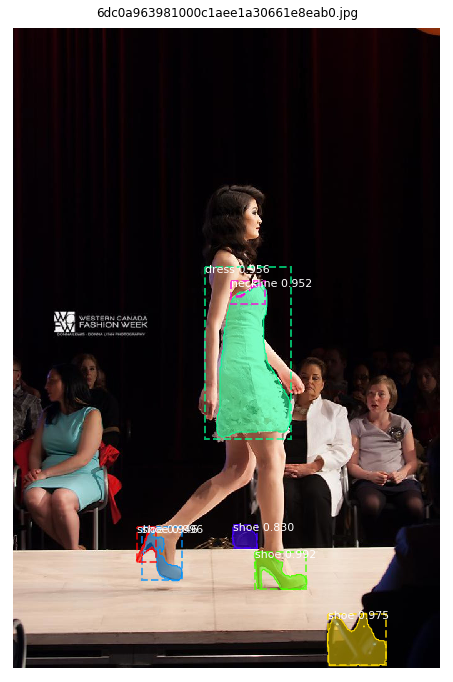

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b66643e09504500db84e3d75535a8273.jpg


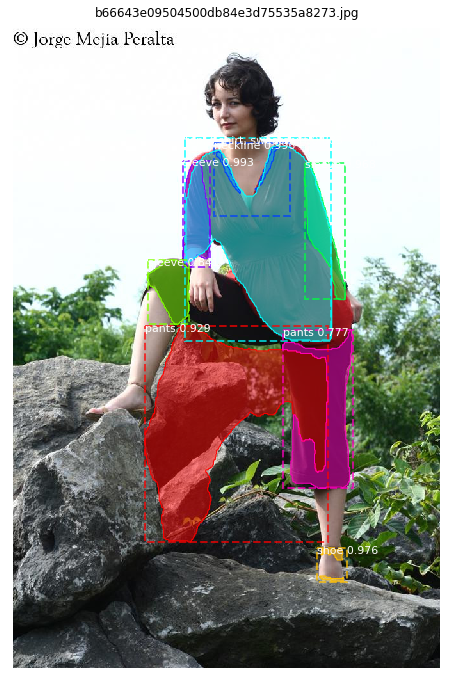

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/620c445190aafb09a9f17acdca5585b3.jpg


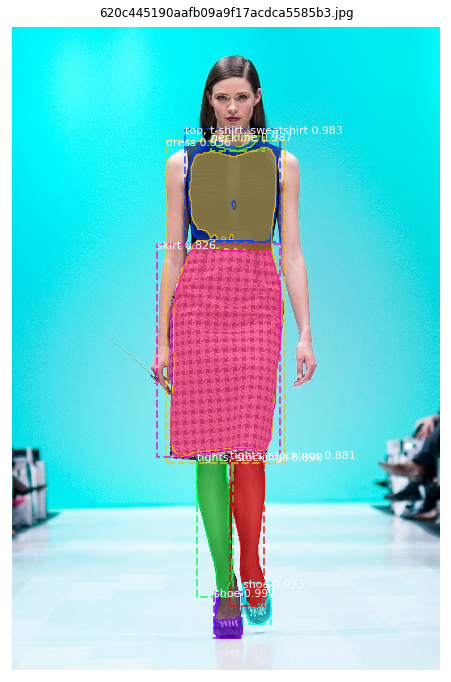

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/f1413790cd71f17dfb71065d96263992.jpg


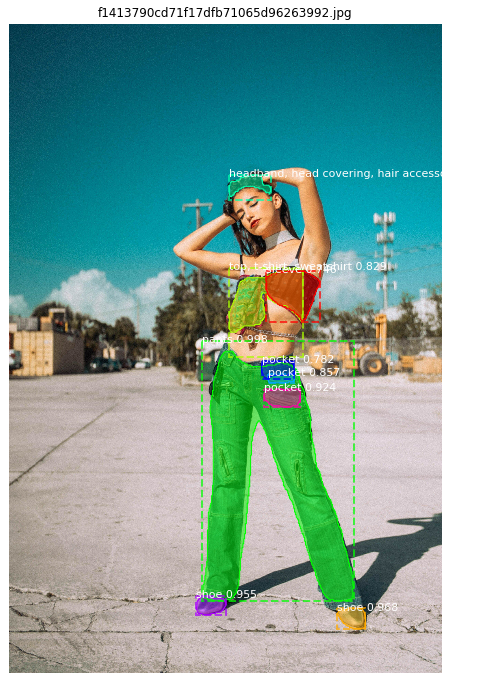

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/9797ab044e643d98dce52db59e6625f7.jpg


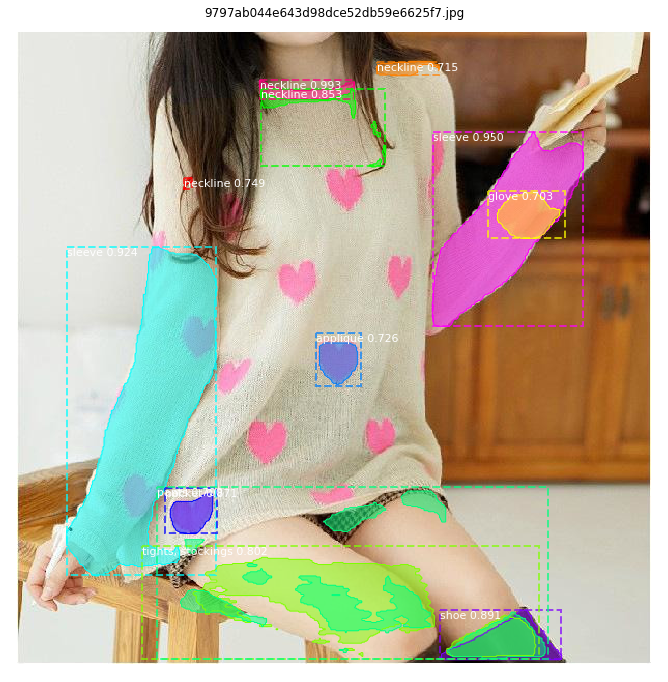

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/995d3b43753f3086a11c7ef12723631b.jpg


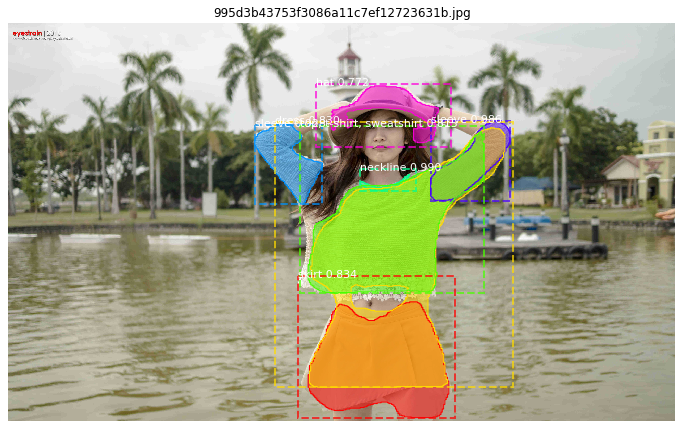

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/fa9d0d5edd31d61640e21fafc6aaa2c2.jpg


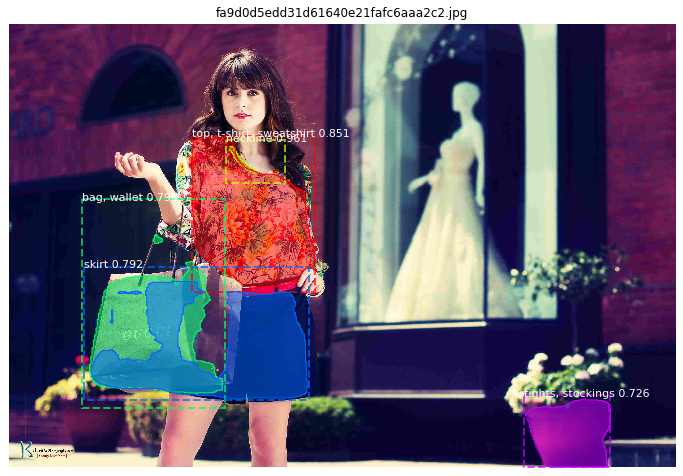

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/7a4e8f189e99149e42573817b6c6e679.jpg


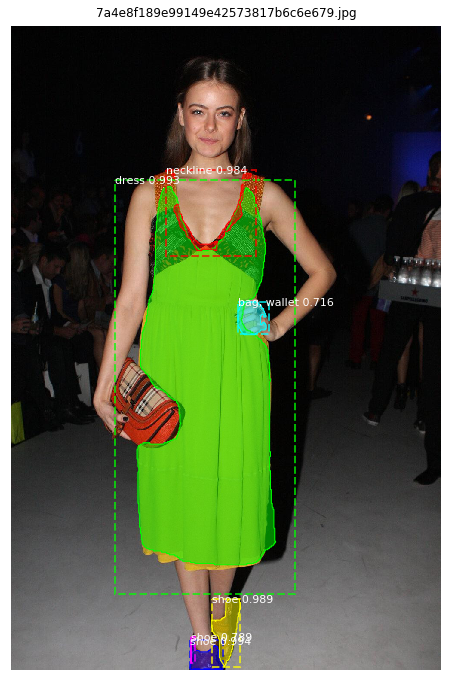

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/b4a06e2e10105c24c9f5cada44b371ad.jpg


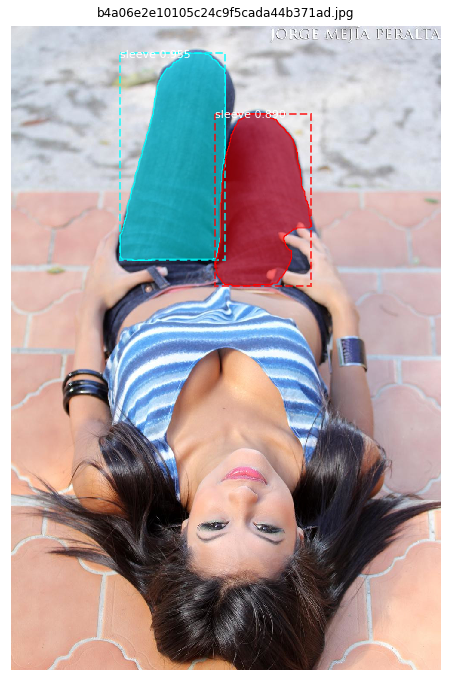

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/test/e32b6a8a9828bd157ca5421804ef9bde.jpg


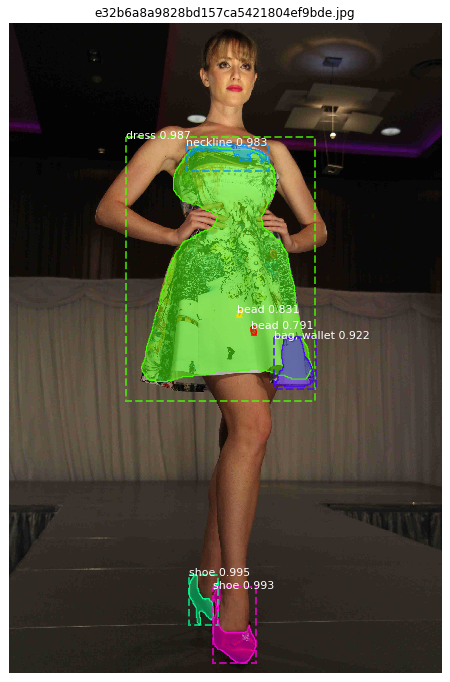

In [33]:
for i in range(10):
    image_id = sample_df.sample()['ImageId'].values[0]
    image_path = str(DATA_DIR/'test'/image_id)
    
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    result = model.detect([resize_image(image_path)])
    r = result[0]
    
    if r['masks'].size > 0:
        masks = np.zeros((img.shape[0], img.shape[1], r['masks'].shape[-1]), dtype=np.uint8)
        for m in range(r['masks'].shape[-1]):
            masks[:, :, m] = cv2.resize(r['masks'][:, :, m].astype('uint8'), 
                                        (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)
        
        y_scale = img.shape[0]/IMAGE_SIZE
        x_scale = img.shape[1]/IMAGE_SIZE
        rois = (r['rois'] * [y_scale, x_scale, y_scale, x_scale]).astype(int)
        
        masks, rois = trim_masks(masks, rois, r['class_ids'])
    else:
        masks, rois = r['masks'], r['rois']
        
    visualize.display_instances(img, rois, masks, r['class_ids'], 
                                ['bg']+label_names, r['scores'],
                                title=image_id, figsize=(12, 12))
    '''
    visualize.save_images(img, image_id ,rois, masks, r['class_ids'], 
                                ['bg']+label_names, r['scores'],
                                title=image_id, figsize=(12, 12))
    '''
    plt.savefig("/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/output/mrcnn_aug_results_copy2/"+image_id)
    plt.close()
    #plt.savefig('ImageId_'+'your_desired_path_toimage.jpg',bbox_inches='tight', pad_inches=-0.5,orientation= 'landscape') 

In [34]:
# Compute VOC-Style mAP @ IoU=0.5
# Running on 10 images. Increase for better accuracy.
image_ids = np.random.choice(valid_dataset.image_ids, len(valid_dataset.image_ids))
print('Validation images:',len(valid_dataset.image_ids))
APs = []
for image_id in image_ids:
    # Load image and ground truth data
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(valid_dataset, inference_config,
                               image_id, use_mini_mask=False)
    molded_images = np.expand_dims(modellib.mold_image(image, inference_config), 0)
    # Run object detection
    results = model.detect([image], verbose=0)
    r = results[0]
    # Compute AP
    AP, precisions, recalls, overlaps =\
        utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                         r["rois"], r["class_ids"], r["scores"], r['masks'])
    APs.append(AP)
    
print("mAP: ", np.mean(APs))

Validation images: 9125
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6980104374c00e80cc94b132a456bb74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/715fbcf10f7167f4dd35c62d81329c29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/724411d39a0c4eda785b83a8423592ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b32f29444d9fbe8cc45048aca174b687.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/883c9b0e3fc43041011d61d4ca465e39.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68901bb3a19efac0cfd8cb9673232ed6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a1adf592bc8c218c6bc2fdb1181ac53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fef5b3885fbe7fce2390281ba0399f02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b187c1d7e6b34559a6370f7ffd58606f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f6e1339e30a5dd79a69c8fd5ea7f1b5.jpg
/home/ubuntu/iMa

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/565d16b5fe5d6cf3ab128fd38931ecec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/deae71d808a910fae8b36eed754e3e5c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d0e8d603423cca5cace34ad531f457a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29595605b13ab26654efc7590084f0bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea6fffbf1d3afbbbeea92a3c1c6deffd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82fa54a0e5b5516042a62993c8d73927.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cb2e58ffd7ce497e895755a85430af4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a3e3a6436a1483a140fdf88bead9fa2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a4149bf461236c9d1c5c340dc22f5a50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52d81d4b859a8144c5d03917a9b4684f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bf2cb4d9ad8b5ca5339128898c5f0ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4ca0c2b7368496150dad5ba3b81b23b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/666080877fd02643fcbe34129f0db2e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abf1b3c0daaf4acf63cd2069de36fd84.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3815526ba87c09986ffc5904314c908.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd508e39a061d510b52ef746d6f735f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7b090d22ecc5e8d087a54d9067d61cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3893f43e4df9cbf40e98c52ce69ae5a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2348ec6e64f2654ad2496770024874be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6cebfe594edd81ba8f95a244d938069f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddf6c60a41416847bb3dafd9f7657cad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78818f4c8063862e082e42c812ff6bfe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abe47ae0322f48f99f8b66c20ed4485f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a3ab749125d2d95069ecb9c60d1acd7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c22559ec6354ad0d756f97b631012f22.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f0893cef2cff2033a0d337366d4cc46.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c12c2df1b291abf6b0bcbb2c12cda17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a028e4caa2704478a87268c4d9395e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/439d02154f541f1325f986989a1e9d08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd4ed652f7ccf1ba93079d9a543f1f6e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22ac5bbd3cd363904c2f17b92c88167d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/274485689aed43b16e306ecefa35bd02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3d28670d9f5b9dee3956d3383aff8a1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8fe026a6c42517cf2e27e99b05dcfb3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bf159e406280a1f84f92a227b42d242.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c916f08b74a5f2901caebcdad2461f1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fbd61b23d5c56b4d0930043e0d11e6f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0cb42f7f7d19f8c915d60d68536ef4fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/97d42e4b6e73bb0d4f009a1a4a84446e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c5708c98c3c51f7e6063f2b6b366cf5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b994ab76f929a137730f072564b50978.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f11cc5c20d9a1d49fac158a0759f7b83.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e71a2f92f810a07907407085ef10468.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/478d7d6d1603f4be001f42816a8ce6eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5ae1dc9c9710ac0c6330609ce4026c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96c40d45cde14aa967e27999daaec436.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9775df0adf65af55be55a44724797c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb0ff67e08add19177c5cb3c62f806ae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d44d4f3d6aea9e54516085da16af2266.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c66dec4e5763f70219ee9fff9c60387.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e207c7756e99e8f1e287ae9f436694fe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/148621319f99af5b9d16aa3a9823e74f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f40c751c18211926d9fe47fc653d91f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5fbd2e1b0874673ac199259b91969ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad36a1fd88527d261c0ec9da45b90dd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45c2392cc003891fe84925d9bbd41ec5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dc7af2da53498b6cbcf2fed7318e9e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ed8095e1972b034dab7a3e79186f91e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a26adb4115083d67708b73a13ca1bc88.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed01e05d1b0f341627595626f0d1fc19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e2e6eb3dec4123fb66d191dd6c50dcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb89733a49fae60d7580e1fff60162ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20bf00b459058d52c69321df066c76c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bcbaa00e04eee58dd0226ba4fb5a7ce5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/faeaefe44fca34e077e219646f1df935.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a6822c06b0b153a2fc3e15e73880d4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ad786ec7a1f4cdd27fd558fa8adbf36.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57f227f98d43699d4dd8767d80cd11ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/741d9b5257c1a5bf42ec0628928b0459.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1942cbfe4b1e1d48a9ef88624a77cc16.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c40292ff0b0ec1d7b0d5526ac439a06d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db9155ed6f41a9d707ec971eb9e9403e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a473fe244ad195c68e34c00e762c0c4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/944bea3e4e77bfe2aa8c1f16bf60c70a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a7e8d810039afcd8c7edb233a0b15a20.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21685d9dcadc17a3fb6ea2386fc313bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2baeab57c3c28c1a475c72a6d42e48e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30021a5835d0aa31794af32abe59cccb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fb488f9c5ab62fc486ac4f2df1215cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a01abb12a8868c7ba0b923e59da6622b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1880f296e5402b65f65872a34a9ca876.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/389dbf85526ccfcaec2d5dab5cb9d96b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94072d00fcaa1c2608cc68797405d2e9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71e99f3e90e52ccbe8f012e4830f5ab0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1cb34880e9f6782e751b7c7609abf207.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d5f267665cdc254268a97626fcd7269.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8f13cab27e009aa7f067ffc24710213.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20a7bcfc6987559e4d8250c5826edd76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb2b4b051885cf00e34acfd9d1700494.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82fa54a0e5b5516042a62993c8d73927.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d08ec323c8ff249f8424ca166fb1e81e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05f15ac466a75c40811e542c07736b65.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9598bd3e5adcaaa56ecfac43f78ba643.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7c64227beb9b2c7acbb20feb9be30b97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21dc84f855c8746a29882822f3b962b0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c77b69cf7ece9d07a4e9664507607a2d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff0a5673ea6b3139e5440728d7be66b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c7a3610c0043ceefdc9fcb7edd06b1c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79599561e12e232552d19f2d9a77e569.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cc7a3dccd44b7d7eb1e7de8612f444a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35831e6fdc467c19f1eef00301833637.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/366a15aff8b4ce28c8efa3742801d878.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a8a275aafeebb9aff930ff2523f8923.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ad64d0830a5cebd0609c6d5875e57bb4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d0b48e5621187a0be3c794226167bb3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0e27e6b9d7e4d4324002697834a06f2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a773c646afe2f4634f5970c9e89c5939.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7aff4f7eed6c19e18b5d16c1cc4dbb78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db79dc55489ed3b94088ec128bc2b1c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54f0b87826d514f9ad949fe8a9b268b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0729a911ebdc44bffc366dec6ccb3ea0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d7b0dd684ede6cc9634a37799b129557.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/daf5d3d1bd854e42843c4e12ca8a215e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/acf725ae0b2f01f9199569018e892059.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d0ea589bc13a68e9ac4ed10efe51e0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cabb870d4f89c39147e05095cc8baf0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/addb0e6cf4a8b7310eba0c2339d51cd7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5c5478532c8c3f3a9ac32602d392398.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93638584bf961dba601b375150d083e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/769d3dfdfd607e45b7f02d2119de0f33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a30a2c8798068740b02cba2ed6459839.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79bb0cda6636cb06eeada29ffff44dfa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/192bfc1f18813f2cb1f771e14ade9fe4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cc98e18c47cdc20f0357bb9e792b4b5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f4d58405bd7a6f193e317c0b6246e562.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a789d0fb9114beb20540fac5a4765fbe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac474256b08a390bbd50ad1961f11ef3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aab359d92c4ad7cbd9bddb3422e4ac62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c9e69c1a8e2c3e1c369d63fa9234919.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a917f432dd6147e01d54128a8837631.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77cbeea011e78171c7483836a3a98e3a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e71238e488c51f2a66fe31c9a146eb4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/31ff2640dcd9f2a38ab21436eb083946.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f88baec5a632339129a78a044c5a2fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/482389519d682310447e917d8887ccb5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f830f4cc82b8479a9448e7c318909460.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7181b015ae4dd014c21aa02e847f5be5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b39330d3c41186da8ee76ff935339b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22a2e52e4bc1c54975aaf988589feea6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/feb5dba1d5c617bace5f8964f81c4ea1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b1bdab48e49b6f11677f47025f5ef53.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1016c14cbd2fb355050771b5cecd93d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6944e12bc29451c28e8c9550eea17e20.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfe0462b55e23f914bf871ed8dfd1f5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a248a3cc2ed5a783cd937aee053b096.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/054fd37fb705611bd9bfc6ebd6407def.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26af5cbe365b72eb38e66bd522bfd2b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b239c447fa462fab4f6eea16a048daeb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/daa04a412464508d9d11de985e14ca5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/442bb169327bd78740ce4ac60c41d3c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da99d7e7364c423565e91b68cfdba9bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/51bdbf469892853702cc428fef655ce2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e449dc7f2058926b4e1630b8bbaebfe2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6062ff4de55a7e6ea467bdef2a0e9b86.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1524769390d55929a333859fcb50af3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7394071c1cc86f650f41df5a888ef4c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b0b2a2d4f784c20da11ec8010a8a73b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8aa6eb64e2edb123a4d103f6d9be369e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db7debe150b74101ebeffb4ce4237a26.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bde998f8bd4a09394bf50000a6cc8cc8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/88db8ed525f0f64f0ad209a8f654d9ea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd06200b001b8ebccfb9dd4b5911a81d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/355f1234ea76866b825639df27c18360.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bcd6d5b63fd53eb31bfaa001b3c0e13.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/400c5b4fc47d60b4c5e8863004e3a474.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8980d8767656b5df9ecfc41267124b28.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f662bb1e09d288c368a87b78e89cf61b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/523a978a2a09742b03e60b89fc4f21f7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b757b31f15a5bb9536ab543a0346e66.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0142a4ba3023f646c7b1efbebd8c4b46.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49eca01de2b1f18852cc2fc25a879b2f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac1300f893b1189561ef56845c56cb97.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1013448580efe27e0571912ab7f624b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03c1085b49b6d7dd63084a96648f7fea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fcc2ffdfc9d7ce3ea74686a938f8f94.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5fcd12a6429195e4ee66b03cb9f26c55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b239942f133c56c0da3094b71d64b0ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6431bf2218195fe63a377675a0d6ef9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b3daec9349eb728c7c94108e0434d59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b63c24d60dfe26d8517aab837e35df8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b73d1d02c02cbb0b5bed0c8897afa56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8b85d917ae5bd228c4e8c3e12e75d90.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7e3642665116b72dd1ba4b8390238b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6c2778bbb1975656841d015a23c1456.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/266411a02b467df731fbdb258d620b1c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65874ca6219d78f1117b4bdfc2377b01.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/637f829e03323ea3390d844b4f7014f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20a7bcfc6987559e4d8250c5826edd76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c767e467efe638fc684c2b4c276843b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01b7031a82842a85255fb49dfcd0d7d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd2dfd29dbbdb9dc157abe1c0f36571c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c6bb0386a49cc3fcf73f8637c55209d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a212a2fdc0328c32a94439a070b04fb8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abe9ab3c38d4404d748243f49f9faddf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60c2ec8558b3e0f9031c4fb70a3296a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86df1b39a6138c0111ee7861f4f99a8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29385df942ad48b5f43e07a7c17f5293.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13621e8904b3cefdfec28275c90124f5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34e866c5792c2ebc9d424e210b821faa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44682046e6b46a0ee3d5d41da84cc38a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cbf05534155a37508711fad253657bc8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68d05f6910154c44c541cf1500a9ef6d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9990e907fab2ad59f7995535cc66be60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/347479781ac42f132da4c3b015edb15b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f00a6a9273455e55b64c4f2e1a0965b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db6d9b191a2b62f794e96ca4fd3e6c36.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4286adb8573d8b5eff1013cd0ebfde36.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6fcf285c5f9cd51a0ad4028c7586bb54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d4d4991b881a06af1dd91afa0a94e77.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/42eb5c1fa9ff6180a5838585cbdb24b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc512d2970af44b1730c900924ab790d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef17787115e9d66232e06e33b8d7f9d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/855b642ef098b30324d5ec4bb29ccdfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe31fb1a96780626756d473ba5a87af4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e2dc85f0aee85b7b0909e478714a779.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddf2170d172b24545c3bafaed30e5b81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da688f1f46dc0e9d9b423854ffd36200.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/238391c0795932389809ddee6b66529c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce5016e5a260452cdd6c12fed6dfad56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5866efb71676722012200c4bf4e2fa6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f7744fbae8d779d80febe9479a2280d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a10ca02bffa945a2fabdebd49921320.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e744522a32908915c865c9af07d4c761.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a91dbf5f5b7b88ed3dde13005632efc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40e360fbd76005eca1d481ec970743e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a807a579438891fd42386ea76de727f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53e745669312bd366983725b38763782.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1267eb1d74be588a679601c14ba2846f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18b42179b9b9b4b3292935793891d58f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fe177da277c0691da46a8f804ef4f345.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bcb6c3e8c190249f4e1eae3632506206.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/751000010269b9e60aad6d693bd04cb3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/356f6ae3966eb947b122286af3ef6c11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/71335f33b798da363c3f8a4e285bc351.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d024b5546c76b59625775f81bd6df69.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b63600053b9c1d5b9e9a80b90fadebf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf1335f3e07408141a0b83f9c915e193.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a96e8efad580f0bd6affd0e7af6a0c4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8840165e5bf6e172639262dbafe1298d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf68d718a86dc87bb67af06c19ee4669.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34715fdae0d3e233dbf864774fd236fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1cc671d80f14801a15b98d3eb520c34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dffa7dd91f1462aa93a916bea72ad0c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/639784923cd0a3657bf684f40dd39b98.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3927e5f3afec80ccb281655a14fbc020.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0831bac15354f64377925fe102b8b432.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a85599c6a4769dfa52ea2a158a250d0b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dedaf0df35fb83b3c3f8b8b66b15cfdb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4a8d2dac335bc4b9f905b88f7b6c7e5c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afb40bc4d5b11fe4d57532d239505a68.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a95045aef0b97a6e1ac7e001ef844271.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d66cc8bb35ca5550ab5f843725f3573d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91d0498a9750c26e9467c23d868fb839.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78ab43a9e3d98dd57519ab7dc2d7be33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c8910b4e461125d87dafe08acb0bf67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4018261122f797dd20ba0647c0a70328.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d552bce26b4982575b4ce423bb3c3636.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2e0f7e407d4d7c70121d165f8e2883f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72d1be850b115513e75f723f7e07a7f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2c9251f7afc0da9abe922714b9d6de1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3ca1327ab7a6b51dc511e23e485fa5f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b1cc671d80f14801a15b98d3eb520c34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/33cb5e49cc0fdc9e0fd4d7c741763b09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8a4c0e82adf16f582c1722202cd6cb0e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/121388e8296762c8f41787ebe833e5c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6815f31fde0085d0b4c54b4ff28f27a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5143ba1ab1ae8eb33393beb653f24ad4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f1267012b12349dcd4b0581cf7872b1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f910f0e7b360f15ea1aace97b2878bad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/551dd133b1f6dbc7df41abcfab662331.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7587ec4dea3d5f3aae20cc96099fe2e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26191ebd95a1e703700e10264e702718.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0d3d6b72efe13d8ca01bfaa5466ff420.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ef04958a4ad88bb4d0a035e108e14b79.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0875bbb74ac70c5a232e35f381af0e60.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3806e81cb2237ae2f2f4434319108f4f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79148f585538ec1a75a5830a7a274b6d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22b35a25fc6651dce053cd910038a3d7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f553a62310ac3d956235a23729b5ce45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1639d96ab0bfc991dfc704f72e46f669.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be65af3de593a0b14f982c3ecfeffdb1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6603d5fa39ea367e2f4f0ee56a122da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93598d51b15fb7ed974803ef4a7fd131.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/14f3dd2621c4b4b2a37a671d1ea7fc2d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaf1eb0b7d382cf8bc102e3e9e0e883f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9b8eef9fb35a7063c51f63d01ee6628.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a90ed2f92e053add876eb5ff7e7c5766.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f770cfa1c6dd5a1aec50993f198f90c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e33716e6b6b98523be48b3c7acba96bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e70a2655fea44ee3802fccf5cf645e80.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e775795c2f89bc5fa28653b6f879957.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f5afb1a1c0656689cc80decf823d154.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee10bba8ed2e4c244f37fe7e98ea330c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40d7f0eaff31df65a9cd05649533fdf6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b3daec9349eb728c7c94108e0434d59.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b2ae881630605acca2e9aec612d29c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/65efc7460bf719e2c06ac22581ad19b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1970c2faad5a68fb349098c6f773eff5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6211965b738d7626ec3ede08887d3fed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92dcc84fa18ad5d6c6c08d293e8b8e08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09f7a5fd6008c475433d4ddc6447fdc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/290992da19f488f776ece7420bd96f5b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07fba8d94c8b1d4c1ff1a5eb079dbd21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/136d7b16e67c393b15617c89d5692c95.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18e3c4469bb9963ba84d36e75c553a87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8a9b7ea1ab34ebb0ef249448a7ee99d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3cafc9ac44341aaad102d0fe5d676bd1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a83563606fffbb76940b4e36f923db62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2b73d112aa4b71b7fd55e29f3348b42.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd248e9f199b4b859859a44eac08af15.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07dcf142fcbe82fc0ea08ba810e17807.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d273caa245ea45f90c28ea2c00c667e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93be29272e240972b791e3ad6afd5982.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e3297ec694593aa232cdfe7809d7684.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4488c5fa3235aad99d7eff98dd1ceff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d75f5b3c76222ab3fd22715b527e8e5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55e113c39c89fa61e92831da4861cc29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63550b1375551bf28d17983d5590c15c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a0fcc29e384f48a13bea3f1780190db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79a9b072672526160c424a4f47a29cab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70708ce83d62ca27602fd8b94e6d86ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68a69dcfc5a85de97f82a971a7b5e71a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0adba506da4e365f57a5d4325ace813e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a26af29c67968b20ffbec95782597402.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a101b451e34234eeb24a579fe8269fff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99849d21424d80f1018443af0d96c917.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dc1262ebac0572e0d1216b08a91859f0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1af51266dbe3f33f6ca566085c520667.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b9fac761d4f84af4ca9a660453bbb9c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf52c0367acdbb6381e22b0820fb49c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d318caafa6b0e5f331f11a02be85ffa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43854062f291b9b21e272d874cafe769.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b803982395d6ffed5f6da8dd71e154f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7f7a1df7ac9c8a5ef260419d53b2b983.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6af7d96d5b9d02064a6b21d2e3f0e312.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9cd52d4aa4023d057d8bd082bc048413.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb330da23ef38fdb1dc8fa1d60d07371.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ca9d45aa8c9b38335ab2f0811ab7397.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/524b8fe8726b8f5054d5f7a300043ccf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1eafaa4c97e510a8c391ab08899b5e5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/15160187fd2f6bbe1fdc3f6d5ae38eaf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c1b8db38e8a9b3afd8ae309381d106b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48060a42151acd44f5ff7707f0c3a8ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dfecfff64dfd5459cf957d31cef4178.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/02abb35004257d0856ceb23a52650ec2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e5f3fb550070e41217ce6674893943ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90203a5c54af7506d6adfdb485a0fc32.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b6b9f2f11d57305cd9e2da73634a222.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c9f628bcb52fcc2b1dbd3a8cd2fd57b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/79753a214c26cc703dd3ef607886efb7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/780d4ec8887a1021fb9a3fd629a25b6d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dde60399597dae5e0adcb960e68a6469.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/123e6c5d35534f70e4e2f54f8059f6a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eebbcbd71a8326a5dfddb84c2f264484.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bfdc13ccae3b1f023a1344b842d83593.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/644fd00db5ed52289bdb32eda44534c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7e34d66aca924e4c33c7302a7d4973d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ac0207297090601b0b14b030cadcc0c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0116a12304c7f94686978f86100076f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f3a1b9635a8beade6cda5bfbf8294ca.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf416f5f3e05c2b88e71babb20f65fa7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a21d2aca3d5580fe2bb5dfcadd842ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e2b12e5b51ef1f3122b449232e3f351c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/857e9ada3543839fdda78dde79174c98.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4c237e9a7abfab80bc0107378cbeec93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fb976f33f3e7777ae4383d7564747570.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d61c343fa773b08d72089d07338c53c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30a8cdc04dcce7978fc895b3a96b03c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f779b9bd3d7a0454a6658c1485302247.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f9be4b5bb4fd49dd1eb71b00a0894434.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4259104c1c8b1c8cb0e3bcee792f1704.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b200512049dd73518e6c306cc44b01ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d300158a9cff1dfe10ba3b6ea82acfad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9f4351f9ede810313f3ff302c3ea6c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32b6153d7eb4bde45c5b3e830b02f4b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a44384debbfdc09ed2c28f0a146dbf6a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0b2854710bdaac507e93d363ae84da49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86fb666bfd6c0ec4eaa52524eaae47e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db4fea42b4f9cf1adc7c76d18291c154.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1bbc10184d2f8c8a94fb3ebe8c5fb814.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0980007fb3d2735f0fe561953b14525e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09634e8a6d748c686fc64386417c1245.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c460d647d77e7bcb3a7cf35fa4012a6f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b76c679b5e870740d8ccc686d0b6590.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67f2687098df78672f91808ce5528e0f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c768d34691ece089fce66b68d181abe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b0ee7ff40e3f01e3bad95217477bd41.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4881652e0503c6bac4d6016b059f22ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bae977f4f8d3268a429a58564c2c85a8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58d462ae96bb77da213b111c4a158476.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/969ab19b692de791d185fe98b2eef836.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13cccf08845272933658c6e2356e235a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4dffec31c018a9a448d25b4f451403b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e49862ab207cb4fc7c7ecef7c38c0ec7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f155520d7792e63ee52e6512d9fea01c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b7190eb33c2e220c083056a2303ec674.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6d38f9f3971e0080fed4d9ebb93ca0cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e00d555ed4a7cf367fd5009b9c4cf3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd57a51e74434eddfea67b6f0cf678c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/782c726ca40b6a9149729ce627a6dc82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dfb91d8b88dba69df8f0b495d2336808.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f70eb6ed4b77d980b8ebcd75904a93f6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/346cb105784aa7e29bed3ccbc04f2582.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e82fe74225ac52d181709b19b4feabb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fe89716205ee4424bafdb5933ad4207.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3138b7290b2b4bdd276434f60b9180ff.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/613a9515b4ba1aae910cdc42af72d318.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/025eea6cc05fd843b617b9ef44dc55fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/530c53cef6df090263c6eb1c06842eb9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ebea7a03d3f7fedea237f017133b3d4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30cbd8159db445a06c31cf634210b136.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b217f9351d9783edf35eb1bde8f4cdf9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23945f1c14fdf9257d6a27e0606507b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8046830555c884be6e84d1a2eae71ae6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92d486a20cd00c0567f15129d014a537.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/271dcdbf67829067e18975b8dc62cce4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/381c39863cba02dff5b5fb3c23d6a88a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9037ae0054c5fb02ac915eef783e2865.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f4cac64c408c18be9047de624e1ab90.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75ba1dd04860caf322fde7db6b0af408.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/134c65d4733f70186ff7393764d24c09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/386efd7331b2caa2ecd5073e058e3070.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd707c21074b65cc38546e4d27809179.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20a7bcfc6987559e4d8250c5826edd76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/836e172a1b6e8d01ff6bf4dab9d0221e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53dec6dfe73faf0a0dee107006abb29d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49500cf1ab0b385ee37c76d90b950213.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1415e7515c61c48340405b811babc587.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6a135a3bfc58d032b7e835adfca19bb8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2abba3cf2bb2d404a26d3ea33c6dd4a0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0695534e5d13d957f76e89c68f2cc309.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd5b258a69e631e881af54a872d0962a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b4ae65682fc9df1cd83dcf76211661f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d765fcc186800086599d7226c0d03f6c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d668db21bbc63871b698172fff07ffa2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2fa2db2f02943e1aded6982b3d4a0e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9efd25f740dca0408898b0fe799aee7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f91a65be37a0e49d78ac4f6bc0cfcb61.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/340097a3a9560ed64e86f9ba332a9b5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90069e7304edf55831ffbd04d7e95ffb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f25442ccfdc149890a0ec6238db1acd6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db5f0ec7e7b2125ef9a64e3d6210c0d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c8e25ffe3c89810d0bf9a6c817bbce46.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9576d0bb06c88cd0d109d85b98fa837e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f0fc6875cfab6fbf3b31fef14e52c62d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e54034cabebb292ac92fd688787dd4fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/286f119884fb100ea9199ed66bd26045.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b80d7cb72ea25b472a790459f9633c8d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c991393bd27bf4b6e9dc98390fbb6e4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f2cbc9976d9a9ed6a1f71cc0e25e1b7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d1c498aae73f240f1da978df49e473d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/82ab9093d6930fc23a23823f2bed7b64.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3747b427bca370f20297761cc54703d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1267eb1d74be588a679601c14ba2846f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9c6c6e203b256025d3faa33163af037a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c9f80ab30ce3258b49462b5129e1606.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4b281ed3822ab302e0c7b30e3e36cc0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20bf00b459058d52c69321df066c76c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bc1e59bc0f5412fb8ddbef8c0c46d08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87904f2e4fa16e40a0b6edc9d2b68ea2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/080ea2fdb5ce4740bb87e5f5a20603fe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23a522752ed34cb38292e154464abcbe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10e1121ef6edf9eb22b371ebe8363465.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10d22e652f3e84c161338dfa158b98ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cd631ce2869412cd08d02525bf528551.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99ab92a3b6c108c56476af0952a951c3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fab6092b4aed3311077f2cd02d73decd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/988e1511fa41388206e885300bfde2b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8550c8861adbc28998b9b90644d3f164.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45429b3e716fbb4cf77488051e0787b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44b50ccecf22c65b0c38eb5bbc764d3d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52d81d4b859a8144c5d03917a9b4684f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2a0b5589af506a3f65295848c8afd4db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/169b05337f5f4ae5d661e6283d21cde2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/691af35d9aa589229bd65e9cca3e83c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/040d123706141da3978c5e769ec32e3b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04e410a9286b4a72491d837f753ed7bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2689c7da5828ea1b8e609a4e3c637ff4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38c5c538fb902dc13f9cd927c1c7a727.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4f03620df4e10bb90589f131e3c965a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f7296513f9fdf8ee14704150d64ea54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed0998d529fd8ba64cc01d8b23cdd372.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/097cee4183dcaa53be5b9ad64fb7103a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58b5787f7cf81b579459d7f799e1317a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66e8ba9584a1377b48f7865afb5e2467.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c859ad44188911c8a1554af40471a5e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f5225522e91a43822721157140e84ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/453616dd49ce863b249b449a98343400.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6551005c5ad2ac23e6e97a300fd73ed.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dbe762dc1f80161fecc8022947dcda0e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4d8176407d6a5de9e2f09983365d329.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a1e0314688c580f2adf6e26dc392f8b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/87caafaf0df8c816961819ec06babf51.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5b2ae881630605acca2e9aec612d29c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75f213fc1067ce628166efbc67733629.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/db0e18a1f607e524c6fff3b09178f213.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18d61323bd8b93ea0809d810d96639ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/063438190968e92e80e5acb591246bcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/924df09a7e33fd9ee0a3452372148f9a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e10fac997bae73bbb6e174984340632.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f6afce2e8ed7f791361d5f859faf6f93.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2c2477171f692d53ac33860c7f0af88.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/237d0a66c3169645d8feb09b330319c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/07dcf142fcbe82fc0ea08ba810e17807.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9db34bf160818fa059a737c9b70ea9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8770034582ef22daf7c899556f7d7a4b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a9a3bdeb55097a2f30a09b7112fa35d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49df08cc4b93b14b2028beb0b45db42c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eece6a2b4574b8497bfa541726dfe5e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92d82d9796a77ab69b7ef5b0a51e2c45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b70cf1342901e0bc6cc72dbf5d43d7ad.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63a9afb84fd203d1e0c376d4a2bb42ae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ba2443615f688fcd21f4a39249129b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c098d14c04ee74b2629eb1a0376a1c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2892d168b59a212f0aba5380c659f5d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4b188fd4292899a2fdf084ad9a933fd4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/169b8a83638dabba45ace247d4d0230c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05f1a6c23235111afe1ade2e268d6ae5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c813f8037630d8f09c6d4092aaf30252.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/657d8f67bc8d3c189e3aaeb8381ecdc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/52c5bcc68346097dfd1a6cdc2b6c6b5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6eb72d543c40ac3a56e281f6525ef63.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ba44450278ee435bf25e37912d008dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c7ef5ec92bc8f44534020e0ac2ca1df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05e2ccb490af40a94b25553b1ebfafb4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a67efab043e28814229781025e80983.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19739521a07a9e66bdfd06b61b14d511.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4367e49f42b2f6ab7dd5db26705f90c7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/77d81b96827b1a74000b19015475530b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3e5283b892d4e06ab6da5b2fb011b99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ea8c357e3e49711024da55a4806ff9e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3330de5f3361a248c93f556d6129cec4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/64abe15d49b0d79551206ad1358dc8d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/755608fac22449e285535b890f435454.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ea5fa472f44fa3dea6b70a454d374ae6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/223f55a9737dd3ecaa6141372bb9e63f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c769f3c01e4af83d978808b7452520ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/29696dd64b94e5ed2f64080190dce6a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/344c72d161fbe4c717d608c4ba4bd43f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96d63c927480c3936138042dc48844c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fe89716205ee4424bafdb5933ad4207.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76465b57573bb78babe3e9beba1fa320.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8bc79ed2b4f8902840461d7a11b5e3aa.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/78e6a7c50eb2b8b22e49e572b4d9786b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/813ff3d97c4fd18c084c7ad5398461a4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e2156e66a0cbc7332d27a6245a946b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e37eaa4a587c85451de57a81ce40ab8e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6239332232ef01c81facbdd7a6d860cd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fdfe5fb7f208382216ccee4470786fd6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9ffdfa5132fd7d84e4063630b80abe48.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8537b711a744a4450f10d8000db37ab6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a2f15f59d9d2bf1252de60e90b25695.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/18b42179b9b9b4b3292935793891d58f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2beece3f79964418b09360c7a1ae951f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e68951643404d51aee666ae8d302a4fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e59c7cc4c4f23c3b002add12e2a69de8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2cec82c71672087d29540350986863a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf080e7a1142c42a14e09ba2f4189e58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/33e0d90b32748cf995277d90cf771e0b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2821e1bee837bdf20117f9cad3747337.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fac6adb5f6910f60d4de85479b9cb2e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3a3a9cde91329c1f83b43a7ad8d9c89d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d748e4939133495170c22db018a20e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/11db03f7a9e6fb15191336291f07e38b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bccc9e15c82e6b0e4081aaafe4ccfbb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8005a44978a52ed20c158aa50541e7f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ceecd4f2d609130e5be37b172465b328.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/150569fe6116e1feb83c1223925c0c27.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25a4b572b5e53aec8f22d6e21533e71f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cfa96b88235dfa75b175044b63143037.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/368047d21ed4ace3e07b78c7c22e3138.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b64d992f35aa1e4f6d1b2c28948be5a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a4162d26dd71f352d3ac1385f031437.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95d6259c1469aa163a6832351e54c861.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85f082f761c61edd65fd351f12ad2f3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46448c223cd8cede700e00d0893ae7ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/349fcc0213e5e442cb8f7ecd9dfcf0e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf09e0ceca52f45a079c0afea570d866.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6c56c932f119a2ebdf5653e3da247fe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93b5b9c1623e5cd9dd6fba90efd8ef80.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c627f3469f421699e1ef5c3b68917058.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/513519886bc7b29b0507ae721de26ac6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8798028cee3a0a066269d17ed3e92420.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3e62f3346e5db15cf99b819ffa0832e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f88baec5a632339129a78a044c5a2fc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c2ef335883d46c41e21586ec7a6fd405.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/34e6e6d426d6e4b1e4d4b4feed601d9d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/641ad32eec586d34e99874d21767326c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b3cc390ab344fa0428eb23890067aef3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/22219967ee34157f57601831e266452e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd62a1df14ba2789ec4d6bc284ea2ec3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b89f5f8242016b8c36df9fbc9b1ba09.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f70aa9694315e87b8e8c8e1febc0819b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a2ecd1f0c882ffc52bec007b14a06ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95a697f14a5605e1751bd9d9e1c00363.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7778ad2a8231b7f939b3049c73e4e495.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cc4e6c0191fb96a9e1c7f388ceeb06f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb12e51dc9421d130775dac0eb305691.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/acced57427696f82216499e8653b212a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8aa6eb64e2edb123a4d103f6d9be369e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a707a1fb670c890e15df345b24b2585.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e7d56adada3fb8e05420b9de9facf55a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f16aaf5521394286095231b65918c158.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3a36a4ef7fd11204daaf4cb06e3c2b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5beec943d4dd9ea38477728460d889b6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99849d21424d80f1018443af0d96c917.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b01f73d551db302855a0d75207082ce7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d0e5787c75fd5262638df3d09fc636e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4f32b6ca77f5ebd48cc1a040bc15f388.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/afac7a0a78c5469097b59629def6d0c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/96eb32bb46d40abeeb1044687218aab1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85cc4b5d931be0daf758f6c4df471dee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/592cfecd87afc6c7a60837bb014fd176.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1ddd134ffafd8ee890134471c5c849fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5d4d987599131a038a687236845bc8dc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4026e8ac32964e225917b324e018a322.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a3950d9598aa09e7d59f9de113ffa6b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc6444d6ee9a9ccd42f14a85c79bbc1b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35831e6fdc467c19f1eef00301833637.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a707a1fb670c890e15df345b24b2585.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a211a2ca599e4b84d8edbafdb0e6a7b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/523d8965e87330e7e9225b05b5131997.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aab8a1a441f42c62c018fa17769a7019.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b61e0c945ecbf196188249b05501689.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b9d18b39316f8bdfaadb05ab6a9dd50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47e9813d4c6d901c9b9b5b94ead905e1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/95d6259c1469aa163a6832351e54c861.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/570740cd48c4e00499c1cec1276eaa3c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/050dd15476cf35449c1f4d2e463a7d72.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99810decd9841f119aefb247e6c3000b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/459b6acebd44a65500bd9a7e0ae4d03a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cf0acd76998f9b71c24d7421d549f125.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2fa2db2f02943e1aded6982b3d4a0e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0eaf07f6558f3ae13b5d241dc3477c28.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac6082d6e65ee9a0ffab48c3d1186b45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0652f833bff881d66142c376ab9d2ab1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8aa18c842b80e42546dc4c8156951cf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17a10e4a8d0c19ab869f7879c6b5c5e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7467618f405d6ed8cad0f90fdb0a7773.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d4b923ef4f43757da2121e22b2463715.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b51fdb36d1132497d1246ec86c75764.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1076d4ccb2a5f43f5337b77690a0718.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/141b73718042b5a4289e5b11a602866c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/05ed7df46dec8673a924e2e0e8d04ef2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6364891f4931d3c8b0961554807e0a50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e280ca1dacd4983266511f8205ee7c54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d78ded25788dc907a95b859815cb7d18.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/673401eaca1c7f65c3770055f38c26b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/830b9fb276faf91f5f73076b4e0c9b11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7bb78893e1c620c207e1e8eaa91a75f8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b5be2e1849ab4058a4dd30279ac6c53b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/970fa83722cdac4c2675ab06c8e0d31a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb5bbe1ad3bf4061a20278ed4a6313ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/919c8334ba2251edbfa27cb23e9c1bd7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8ca2397535a08e0d9ee47dd5c8b1cabc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91ebf66868eacb4e4a967ad315197c49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/06e7d7e3f410e172b220fb7707b7f9c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f86562bb0f1580dae2e8f5789d1216d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2504cc1f6a4e450936fa85d9277e8d83.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/54fe8181605a005b5b5ef931c37fd89c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19808385da9b5da655e70c830da8d7eb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1abc78f5d4774fee9646701a9efd7562.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e710f37d62cb77060bcdbacaa24ed0c9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8875b1eb0dd3c30ebdc41fe7eac78b64.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/61f039b92e010469ecf3444a664322d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3b6b7260cfc7ed04a6d8c4476cdc094.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25f5f9c26c8a2f7941c45e43cc80878a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1a80e64a8698888de314b055ebc76c0b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7b7f717db623f74129fcb3210d592fe9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12840c618df3ebf78b8292c845c7f075.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df7a21409849a9555c4ef3ba30b91776.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/273b8891b1e4b51e178f99611317bbd4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46651105a15184344f254837c83e01da.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ba6aaa0411288b8ae281eef0d18ea92a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8999ab94b27079d0d49e23cb0463479a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/863abe0ec4f69131d14b80e5ab511eaf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/66453e1c5e79dc8b0c2be51e57c3d9be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/780d4ec8887a1021fb9a3fd629a25b6d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d190d8014f105974b5d5dd2356143be5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08d999de233483694d55fd25916c4ed6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f00063729f8a344cf7d8ce9c545d7bea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2ffbb93890a29ba8e0446ce786d913f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2fdc3f0fe13bea12d4abbcaf4ceec48a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fcd44ebc3ac973036340fa7852e93852.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/53a3634bd7846c137412a655f3921b19.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ac6dba9934af0002f172da283d9366c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f11a7d4b3638f7fa50c5583fd8488b3e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c62f1e91476ce4bfd16edecd3198bcfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7fcaed080c427039e43d96188fb89710.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/873fc31b11815fce39ff5b60fde7005b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf68d718a86dc87bb67af06c19ee4669.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94414a29f4e4375925697991d126a358.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0ecf0427eec59439d5e2d7881b23ca8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/997802843a45ed2980ce27859ab333db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89fdb36181c33364f591c0accc586df7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e4c396829ffa386dda19c9a7c8197f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45c2392cc003891fe84925d9bbd41ec5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/540bc289ede5d314293d62541106b1f1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c7ef5ec92bc8f44534020e0ac2ca1df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f05b538bd4f428119d4935b6d424445.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af4e539af76efecd80be1c4031da99ce.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2beece3f79964418b09360c7a1ae951f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17760e0210dba52e3fd86aeb844b80b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b858203a6dc0acfd60be5a63f90a7d44.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/616a640afdfce4d21379c6589953076c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84166660d4fcd557396798796bdd6b1d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf5227bfbc6b5f0b01e8a95896898ed3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/551dd133b1f6dbc7df41abcfab662331.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aee31bc064bfdedd5c32b62a2fe40c70.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3abedf3cd7c576323f25bcc32d399aa1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5c5f9c6bc8b09dfd35b862fbbd79c7e0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f73841f6747238f946202dfc2f1336c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1935ba0adfbafa1e12c1182d9b60e047.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90da98458fd6cb5fbdb65a5f2864a815.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13dac4e86d795400e9e70ab7eb0aae67.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/eb2bbc40d914d047f6a15d0d1db4af9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7be10f5f7e9fd4da21dfbeaaf34e47b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/03759b58195fed589ad929a7bfc02e29.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e06ae45d896c92bdb106b541e35b6383.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaf1eb0b7d382cf8bc102e3e9e0e883f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a2f4476ba788d6a1639592bd69e4e08.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/294b9258ecb387e6792711ebc5a8ad80.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ed5f90539d2ffb83e155f795c68cbbb2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/860773a5017afd01d03059a5935ad311.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/072e226820a710b64435e4cd59705419.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70b1b37865ac7d82965b3032d5793a3f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dda5715a5fccfd21ce52871a0cb83cc7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d6ac0f47e42063c96b6c5a0130cb138.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce3d5cfd54a265d99b978122b814d833.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e03db5c2ca52a09d654059a574315ede.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dde21c517e864def1c5e6a61312519e5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d374088204ff25f79c247b9bd75a1a2a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d63c5a4c64b741ada37e3cf294eb1c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e226433f0ee593c6abb63629e72b535d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c020dcbc5f347ebaa8eb9b867e9dcd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/73d14bd9bec72afe2e787ced175fe907.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a007d88447828dbe6b158b8160a3bfb6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a755faf55da4a6bb3dabac5525d29860.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5ae9c6ffd4dfaa9e9287abafdf2e63b5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32309aa1865ea7b513b9544bbcd1ea80.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5dadae51d9a2d5e11e99ad6f600d98f3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e627cdd00279821ee8392ade480a5087.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6c32eca89cde26045ae5b9cc6ec5ec7d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fc85bdae53e36c9dd325dbe9ed6358c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2687654e887d0c52eb4b3ba35a107276.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/036fec8a622a91aa77a9dfe2a98ee995.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/25ef24297f9c463af1bf6ce5dd8ec063.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6fdedc4fcbaa8ba6ad7e133b0708235d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/10154c3784010967bcfad7a748016db6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7cfc5caa44719094678e3a1c5af8466e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f93a9184b5d5a9e73f8f963a66d5223b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f4e71ed238b701c47fadca6fb4f40545.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3344b0671bb5a158760bd387414fe98a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ab637170c2a6e43b326d2f2357d2d49.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bc5ec41e6738f5629d7fabd9e2c7b78.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4e4b89cfc9a0feafa53b5365a9fee39c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c50095db74c8b2eac5a6ae7b1bf4fe17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/adc2273762fcc931b0e4f03937d9847b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0591284f15a0b5daeb767a7da62ea38f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c9aa6112b57aaaa4dc78e30fd822c877.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac7ce3220654f543449e75c82ea06855.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa78926266b1eac6552723873fa2a3bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae09847cca085012a3e820d70272ca11.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/46d4191c42e8baab8033f2c9c466f234.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49df08cc4b93b14b2028beb0b45db42c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/26ec3cf34ae4128172bb8372df05a812.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e33716e6b6b98523be48b3c7acba96bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/75c3d360736a8e316f2769342abd8c1a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/571c1f149d30e29ddfde3e4efad80668.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/12599c8a7084c8f7b4090684ab48f3a2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6dcd7635a3ed40b4484a482683968a50.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60dfe734e641937b0486b6dd4ea8f76b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b1a7306d10b6616e71b513d5a49ce03.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56311f0d6a2fc142033a72f84982d143.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d12b49ed4191145b8f1dbddea2da8de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cda8e9dd8ab6377e460c92fa2c23c80.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91f10f55419bfdc7fa412a8e4c303f37.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1d5806a1a95c65d01633b0972a8e3b8a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7db982f834b839b01711312fc494f359.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7a3ab06756dc149ab8a7ca80e8fda56d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/704d9028d23fc5b39ddce6c7a03fdfb5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5293a9d16049192b155c9ea5260b0ab8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/abe47ae0322f48f99f8b66c20ed4485f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d907a3df6202ebdbb79a6582d4ece57.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/08af6eb2d9c1b75d5b08e13ee0259bd6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/93becb06e3394c66e6888fb5a09a10b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89bd610848d5746922c011c14f4efee9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9bd3386e271caffeee065a7f214a41d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce6919efd1e7d5d5c98c8cdbe5774432.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4eccc3d6db3ef5654e5549405167b3d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17ee9eaf293e49b192b99fc3de546dd9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fa2c14f41eea4b82fbcb2922511f80e4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b579a940a066db09d194bd22aa173443.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6de83c0a593ff84b89fe358740ddb8c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/72df8fa0b19ef4f7aa5e3e9b9587c02b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e22a263ff8359ae63696f5dd95ccdc4e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e94fe216c735adfdb0fe5d3b5e550b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3dd779ecd5ce4da610cd8359a904acea.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/70114b74c76694094742bfbf09798990.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2d398837aeb536bcbef40499c0cf5055.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/981dc427a442adf3e47818c209e1f7b2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8a860d078da463b28618029d547eca0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b385b1aee1bcb12efe07c5beee416be0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f9e49c454b201bd1566b18057b055ae.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a5fefd1ed24a8e24fd34342a77b95ff3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd88d9fd9fce7f51719e277d559d16bc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/24599d10086f7eefce0be977cfe5af8c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50e8cc22fd0ea3ab9984281b0c8614d5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5605b71a29427a5a27bb400ec62d9af1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0cade8841262f2664738b700aed0c4a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/67af48da36dcb579f80af9c65d24b6ec.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4ef46d6552f33483ec35dbd8b0e8fafc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/38f2f79240f1a4426c3f0bf227e4435b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/241d05835266db694c9b4e12f73a59b0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d68076f10ca82c0f5bcf38dd69ce9c5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/62d7390e0a8a9b96e855644973dadd62.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ab715a0e5281a2db7a5548eea941c70f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b96235ee5ae6a81baf28fefbe518c878.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ff79e28d2a6486c3750fa57001ccdc9b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/093de760b2d2b2c196493fd704b06baf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aaf3fff7199605d67098abe4e26cd2d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c39fa2af8ee3250dc61893e57f004b2b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c81a68ada023e0c48b8a05e95619a784.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/381c39863cba02dff5b5fb3c23d6a88a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3f1ddf9b48210f5ac548bc31e12a9072.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5677c37ca5617c010d5425e3c4f0c46c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fff3ae4585d776922829ceb887789be4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/19c6ebecd4aaa139bf5d5ab839c3ec3f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d2534f0ab6c21af1f25a0573fc7ee445.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4187b4a600cb6d16c0c1ca7d66b84a58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44523ec77a084cd87f814cac976156c1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/369265098290fafd283faf42da50141c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d3939a408acd9c4e5e3ec9fead892438.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5196d9370942b113462e8988922175ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27e9ecf4a20fc6f25b3a7891cd3e0b21.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/21e42c2e16a0850f9c1053d2cbd5b90a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5275962891fee71f29b59a123632729f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/45fc072fc616ed826fb53312b0bcd3b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e33f9c3c791dadab5cd3fe9bb281e6a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e4f03620df4e10bb90589f131e3c965a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f5aa2cb7ef3a69ffeea653b2f35c23b9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4dbe316d1a77772d7e76c64add986da9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a96c26f538b8bc2ac62a7201e7880a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ee8a39d9411e2cd46e726afe1c5a4895.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e675458d1943f39d4821361d52d7de8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/360a5e826ccd4f45ae2c18048894b3be.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3b7eefb20705aa897189cf3517ad7938.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1d172ceacee4aeb02b9ec3686267314.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/92992f074e93ef75b64927fdfc110e0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/20790b35c350ff2cf924f5a200a21db0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a02fef0d0bed8880ebbbd03d16b48c34.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/355c76446809503aa560550f65896ce7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/629c9ffd00d529dffc4c43efe7ed75c5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3d1da004a8f109546fd68898a392f608.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/cb9aeb24a13f24268f49764c3a1e10f4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/261f495630185ca7f2d4b4f6c915d765.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f7bd7c173278a36823d9c62e79e711cc.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bf080e7a1142c42a14e09ba2f4189e58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1b2afe689fcd4b78442e522171a2910b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8b15b40d27e5bb4ecaae48c6ffb1f197.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4cefcdbc0ad5207ce63aab9885828265.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b112eb13808e0706aa0517ba1141a905.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30375da27fffce405b241ae86d56eeb4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0801c72164b17e26a923ca99c765186f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/638f8509119d673e8dcb0fbaba0ddf6d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/01bbb84340ba3a040b3279651434360b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f2eb93b698c37c78985872310f4ecb3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8e7dad3019ddec676b0d10b99f0ce536.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0abfc0041ae9897797519416ab38b636.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7629537133cc78169233295aa7313109.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44c78c986298c11f37a02512fddfe5e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f8a860d078da463b28618029d547eca0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aeac3ca63c4e75395079852027b0ed87.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b12e14cc34fdccfec38cdb8e2a7791d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57fe3c0fa0438eb6a60bea543ec6f4ef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bc6399926a97a88d27e769b0d425ce6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/7564b483633884153e9817c1fd777e81.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/458020fba2d56fb83fa51242923dfdee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dd5b258a69e631e881af54a872d0962a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1c0ace7ca13ecbf0195acc3fb5c2bdd3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5523e6b000939ce46f999061f65354c0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/56e10838da6a7fc145118ce4233d9718.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a2e8c6a67827429bee241abc8ababed1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16348df7d3b0616b58e0987eda48eb5d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a60cafe6375aaf38414a1b4a7a91ab45.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a199ac62d800355e9bc3b5fe50654017.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/04053eed9b6b182ddaff6bc8d256469b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9fd7aedef8ade90896c8d7324b72f993.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/105206ee9a735601217ab1ddf461b362.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3250adf7d6f0b91af05efc41514ff28d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0faacf5944b9e2e6296e5ba6ac1a7bd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/63fbc039f7477255cb0b54b40c8c529d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3219386bfa78891d064223d4e25c3b4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/40e59aca5925068b665126157dd4af1f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/60466fdf3a2d424962243c1afb6aba3a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f74e79fa32af7dfc9f0442571446b494.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/27aff09e81c7fdb3bfc95650fc1927a7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76b9efc4ac56a841ccd30a740c4e1d33.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/58c201fd31ecafb7bcbf5b164fc5fcef.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc1e48b0512be9a33e47279f6056e994.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a713724b93b4dc45782b7b6019c154f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bde88e1aca5c94341231b02771fba2a3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2ceeaffc4851fc795288a74010e97dd2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0eec10b413180b744d744f9b43c9e227.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/502d45a19b1a789a18f3603450b625b7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/949d222a82b8fa20dfa170a2f4439849.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/148621319f99af5b9d16aa3a9823e74f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1df08e396a55a34f6f1d6e76102e1c8b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/47ddc33b3705a8c027e74f38e54fbdeb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9a857ec86b2e65c838e66f6cb759a979.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/68901bb3a19efac0cfd8cb9673232ed6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/44a89520a42f140afd1b189bba9e674f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/164d41c18079e9c87094f8ddaeda0c7a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9f39d1d48242d82a66bcc1f9196a8684.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5cc2457c1665eb1de143dedacc4fdbd0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/271acf9814a5af4fffa547688046abf6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ddac4b28f8b53f74f95714dabd413418.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9db6dc5d3a9dacf0dcf9aa3abe13819e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3371d129ff04717e802fcb323ded817c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/798f3ba4886e6d4c6e861b38336047df.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/855b642ef098b30324d5ec4bb29ccdfb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e1c1e90800c782a6c2ced169dcfa023.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bb6686f125c97a6ecb8ac9b44b66733d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0f0e027ff27c0aefddbc581ab523b8ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6e4f41ea4ccf26be99f4c4388aaef8e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fde7dc7600d9e17c07bb129dcd67d833.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aa03bdfdf4da7b2a3ff35420e0e8a086.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fc15631f01c995aef9da2f6c6502cf0c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/50ce61a048b59b515c63eb72923bd120.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/be6b88d36618b44fffd0e6e5a941599d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e33f9c3c791dadab5cd3fe9bb281e6a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c357f888800706293ca4cc0d4281fb7e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2b8679fc6ae215d8fdbd87772c759f52.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8231e961d875018020c1be9708cece1e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/86fb666bfd6c0ec4eaa52524eaae47e2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/af1e77078fb91ec67897dfeec4bc9614.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/74f896155a5699581888b5b061ae2a58.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f96c9a668ad9ba105666af33e68707b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6862cbfe6325998f71864ab778fd4ba6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6f7490597e23e8da85206ff946536f99.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/90c65d0f6e67b0e908c6ad7a983e7147.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/285cb6d2f4bed69a1b5314b548e334bf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ae0b89d763837b81d07e24e363eb32fb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/da72590b0b1816e5c900cbc8fc86d7e7.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ac7608c8a2475f7bd70f1301de4077d0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/083b0f08ecfc4575ec13d5d0dd68e9ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/560df4adbc3d072b9bbe361f9e90c99d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/99ab96826c95341a8e33b90a58320e17.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/017072599d68c560c3ce924d0b965c74.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/508cf6456e9e3b93e4391653e5773d52.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9dd892cf00eed89f8cf466e29dae6b6a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c4944f4a8126e9c616f53cb62fb28841.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d8e212b9abacfbebf7443d8095fbb25d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9de1c2ecccf482cee64a7297a9282707.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/386ec091a0ad3ad1077f8a9057a5843a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/85c578ab16dfd45d5fa70e2a897af689.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5e7831fae6749dedded4015545d070d4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/09d5162b1bb3823d1f7927eda7093c31.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/663f5a255e3e74c7ea909a182b530c5e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bd5a4cd9e8faf1833b269462bf9b8224.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/36cfef5a4b92ced25794a68fa117b2ba.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/1f2eb93b698c37c78985872310f4ecb3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c808cc523edc5aebf913e9a816739db.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d5a18b197027588b920c4bfa1bb20a06.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6faef5ed20ec18cb7723ea45624af6ee.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3371d129ff04717e802fcb323ded817c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/32b23d6da27ee62e0f122e5257b0b4fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43854062f291b9b21e272d874cafe769.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c6eb72d543c40ac3a56e281f6525ef63.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e7ced316e65bf8d0906e8fdc5d25fcd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd309f3c572fcdb648f6dec67a4224d6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/fd3e2ce0703f9c027862f5a79c788b56.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d9aad7e5897fca96bc9be547bdfa223b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8d883a9a64eb71ebe729cfaaaefcf2b1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c0ecf0427eec59439d5e2d7881b23ca8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/de9f7bca6b0b0b068543a82f59d36485.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/782c726ca40b6a9149729ce627a6dc82.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/43e6199fa4c434f4609003daafab7029.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/699369e05de6ba0776ade617abe7a0c8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/35c6880cb084b9523050b041e6ab60a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f68a5a6eb20c4b6004f6b2697b46e66b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/426b9796a52977b22b425159494b0d7b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/55ea67ade5469c6ae15a3710f8174e18.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/94329dbd65aae2cfa739ee88c588e474.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/dedbdb9bab480a55e127a0d5864ffccf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f39d942dc2a7b3c880b40586018416c4.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/91d0498a9750c26e9467c23d868fb839.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/136a32075ab4cd5afc643364baa6d0e3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/89b14dfcdac3b060fcbb27315cab960a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c540e5882cf23c32cc77639cc4b313f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6ec14cc3464630ed3b49369bcb456f76.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/951eeb0b47215c48190ab93352c2f2fe.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bea5fb9e8a5fc47d1ae08f6f2cadf02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0eebb33a358b5c27338a84a73aa43885.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f3fff012d31399baed361257ff02f5a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8c411ef2773181ab1a69abc577cd9070.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0a45bb7e2cc2503f0aa4b48b710874a9.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc365de0952a5e42a209d1c444f96eeb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/16fe0f3d2328c60b833da8a2470d11c6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4fcac8f5613fea2977c0c60d94c89b54.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6b5fed4b43c52527a514db6449bd9be3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b03d751fcd5f38c168a36c224bb7773d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e11f7eb7ba759ac3c4dc53310c73628b.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/994a726f465f0dcbbb5b9d75eec274a5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c98936659dd0c8014bf631b0bde7c0bb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/f4c8fe7fa3ea69dcd10c856da00ccedf.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/76770f8711de88b413434cf889bc6533.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8467a7aabebf935a59692526f8f45c2e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/feca8677691b9f40e283c8418dc23cc5.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3afbaf92abee634824a9e452e0576bd2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a665691c0bca5da15a313559ef820ca8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d6893dddebd7bc33bc2cd73eb762dcc8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ecd461884c7d815ca300840ac7dff722.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0ccefbbdbda172aa85b8e6600b5d724a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/025bd90e8b019edd16c498385ef1f1c2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0bea5fb9e8a5fc47d1ae08f6f2cadf02.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/094b13110400e38bb5f341dc58e7669e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/bc90c9a81a3c5ecda60a058d775872bd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57929b42c84699cca38aef3c96f28cfd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b11c7205a727078f4d7661453a8e6577.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/583ca44dd8eac4ad99a752bd2f66efeb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8a9ff4ef4855ddab8cab84cffdc3974a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/49eca01de2b1f18852cc2fc25a879b2f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d83cf04bd2559efb4badbba077609f8f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d38af3c5ae3a6e22e41c500e3302e2a6.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84ee62bbcc9ef8e4767a425047bd12fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ec2989b291cae992db76554771024116.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/13cccf08845272933658c6e2356e235a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/262c09c84b0933c4ac7de2b5c230a296.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/30075329e73d0bd701532ded9ce1f84e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/4bdea1365802aea57136d93e5f989307.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/9e8561db78a5fd8c75d02113e90bb793.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a211a2ca599e4b84d8edbafdb0e6a7b3.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/df082af604b6b47062eb50e9d2f80345.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/17e907001fbb30ced3acd39b52741feb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2f83381333850a9af6df9bf554b01377.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e3a71c073c7fa1f7b98840f259f9f37c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/aea96f88f6f260a96fede2a5d21f5919.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/c1693e29b75a39cf698a700b6ce42fc2.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/d01839be4964b634c4c505af8a01d686.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8cf03f7fdf9520f3fc5e5e5b1bdb9676.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/80bfec383cf4590981daca5a9894df4c.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/23acc861ac269ee7450cea98c0c1408e.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a9ca3fb4d7cee78698d5f07e3fdf7d55.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/6471afc02614341adb5b834e3b0321ab.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/48a9bae98dc780ca74fe6d1d769a4c0d.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8641d29e7f749b859866cf0a21ba11de.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/ce23131449011d8877d1066ef81193b8.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/57ec45d24c84722c723f9aab64cafdcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/905debd8389f36da6f147e7f855b7837.jpg
/home/ubuntu/iMaterialist_Fashion_2019_a

/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/84ee62bbcc9ef8e4767a425047bd12fd.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e791cf9510151a79471e5763ebf015ac.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/3c540e5882cf23c32cc77639cc4b313f.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/b6c70f4c119b4b837128c017e09d2bcb.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/a96e8efad580f0bd6affd0e7af6a0c4a.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0729a911ebdc44bffc366dec6ccb3ea0.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/318413c4b78512e45c217bbe84b11552.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/0801133cb09e989dd4e86b8b70035bc1.jpg
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2e56dbb705ae0470265b97a2c8de4d40.jpg
mAP:  0.4278715050930609


In [37]:
image_ids = np.random.choice(valid_dataset.image_ids, 10)
print('Validation images:',len(valid_dataset.image_ids))
APs = []
for image_id in image_ids:
    # Load image and ground truth data
    
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(valid_dataset, inference_config,
                               image_id, use_mini_mask=False)
    molded_images = np.expand_dims(modellib.mold_image(image, inference_config), 0)
    print(gt_class_id)
    
    # Run object detection
    results = model.detect([image], verbose=0)
    r = results[0]
    # Compute AP
    
    AP, precisions, recalls, overlaps =\
        utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                         r["rois"], r["class_ids"], r["scores"], r['masks'])
    APs.append(AP)
    
print("mAP: ", np.mean(APs))

Validation images: 9125
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/33dc0aac34c874722e371fb1a7202780.jpg
[10 32 32 36 36 36 36 36 36 36 36 28]
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e1a5352cca786b771874a22265dfd95c.jpg
[ 2 32 32 34  9 22 24 22 24 19]
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5db05266ab048cc65be390d90a9f9d32.jpg
[24 24 11 34]
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/8307a8ad6fd040d0bb3194db9a23dc64.jpg
[24 24  7 29 17 32 32  5  1 30]
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/e744522a32908915c865c9af07d4c761.jpg
[32 32  5 30 34 11 24 24]
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/5fea8cea9fdba2e459c6233544c185a7.jpg
[ 6 34  2 34  8 24 24]
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/2c39ec5357173199f732eec7438a34a8.jpg
[24 24  7  5 30 32 32 18 18 14 15 16]
/home/ubuntu/iMaterialist_Fashion_2019_at_FGVC6/data/train/609e7ff210f7217f74ebc9f4272fa2a4.jpg
[9]
/